# Image Labeling & Model Finetuning

## 1. Set up 

In [2]:
import os
import shutil
import csv
from datetime import datetime
import matplotlib.pyplot as plt
import seaborn as sns
import random
import torch
from ultralytics.data import utils as data_utils
from pathlib import Path
import cv2
import numpy as np
import pandas as pd
from ultralytics import YOLO
from tqdm import tqdm
import re
import matplotlib.dates as mdates

In [3]:
%matplotlib inline

In [4]:
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:41:10_Pacific_Daylight_Time_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0


## 2. Define Paths to Folders & Files

In [5]:
# Get current working directory
current_dir = os.getcwd()

# Go up one level to the parent directory
parent_dir = os.path.dirname(current_dir)

# Set path for the source folder (you can adjust as needed)
source_folder = os.path.join(parent_dir, "idx_images")
labeling_folder = os.path.join(parent_dir, "img_labeling")

csv_out_path = os.path.join(source_folder, "image_metadata_weather.csv")
csv_train = os.path.join(labeling_folder, "train_for_training.csv")
csv_test = os.path.join(labeling_folder, "test_for_training.csv")
csv_val = os.path.join(labeling_folder, "val_for_training.csv")

csv_train_120 = os.path.join(labeling_folder, "train_80.csv")
csv_test_120 = os.path.join(labeling_folder, "test_20.csv")
csv_val_120 = os.path.join(labeling_folder, "val_20.csv")

print(f"Source images located in: {source_folder}")


Source images located in: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images


In [6]:
image_files = sorted([f for f in os.listdir(source_folder) if f.endswith('.png')])

In [7]:
print(len(image_files), "images found")

27592 images found


## 2. First creating wave lables on images
 
 1. masking objects with Yolo Model
 2. using basic image processing tools

Goal: creating labled images for YOLO model finetuning

In [8]:
#%%capture
#!pip install ultralytics

In [9]:
# Define the path for the weatherdata folder, which is a sibling of idx_images
detected_img_folder = os.path.join(parent_dir, "idx_images_detected")
os.makedirs(detected_img_folder, exist_ok=True)

detected_lables_folder = os.path.join(parent_dir, "idx_labels_detected")
os.makedirs(detected_lables_folder, exist_ok=True)

wavedetection_filename = "image_metadata_wave.csv"
wavedetection_path = os.path.join(detected_img_folder, wavedetection_filename)

print(f"Wave detection CSV path: {wavedetection_path}")
print(f"Detected images saved to: {detected_img_folder}")

Wave detection CSV path: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images_detected\image_metadata_wave.csv
Detected images saved to: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images_detected


In [10]:
# Load source CSV with detected weather data
wave_df = pd.read_csv(csv_out_path) 

In [11]:
# Optional test mode
TEST_MODE = False
TEST_LIMIT = 40  # number of images to process in test mode
if TEST_MODE:
    wave_df = wave_df.head(TEST_LIMIT)


In [12]:
# YOLO model (load once)
yolo_model = YOLO("yolov8n.pt")

#### Base Model

Set canny values,
Blursize(5,5)
no sigma value set

In [44]:
# Wave detection params
horizon_y = 1313             #below this line is the watersurface
x_min, x_max = 900, 7450     #between this parameters is only water no trees buildings, buoys or landline
min_wave_area = 15           #variable - encourage more detailed detection due to the high resolution of the image
max_wave_height = 50         # maximum wave height in px
min_aspect_ratio = 1.2       #defined based on nature of waves

max_aspect_ratio = 10.0    # NEW: reject extremely long boxes
max_wave_width   = 200     # NEW: reject very wide boxes
max_wave_area    = 300     # NEW: reject very large blobs

# Blur & Canny parameters
blur_ksize = (5, 5)
canny_low  = 50
canny_high = 150

# --- RESUME SUPPORT ---
if os.path.exists(wavedetection_path):
    results_df = pd.read_csv(wavedetection_path)
    done_images = set(results_df['new_image_name'])
    results_list = results_df.to_dict('records')
    print(f"Resuming: {len(done_images)} images already in CSV.")
else:
    done_images = set()
    results_list = []

# Resume based on existing YOLO labels
done_labels = {f.replace(".txt", ".png") for f in os.listdir(detected_lables_folder)}

# --- MAIN LOOP ---
for idx, row in tqdm(wave_df.iterrows(), total=len(wave_df), desc="Processing images"):
    img_name = row['new_image_name']

    if img_name in done_images:
        continue  # Already processed

    # Skip if annotated image already exists
    detected_img_path = os.path.join(detected_img_folder, img_name)
    if os.path.exists(detected_img_path):
        print(f"Skipping (already saved): {detected_img_path}")
        continue

    img_path = os.path.join(source_folder, img_name)
    if not os.path.exists(img_path):
        print(f"Image not found: {img_path}")
        continue

    image = cv2.imread(img_path)
    if image is None:
        print(f"Failed to read: {img_path}")
        continue

    # Masking step: Compute median water color from a strip just below the horizon
    masked_image = image.copy()
    water_sample_strip = image[horizon_y+10:horizon_y+100, x_min:x_max]
    median_color = [int(np.median(water_sample_strip[:,:,i])) for i in range(3)]

    # YOLO MASK
    results = yolo_model(img_path)
    for box in results[0].boxes:
        cls = int(box.cls)
        xyxy = box.xyxy.cpu().numpy().astype(int)[0]
        label = yolo_model.model.names[cls]
        if label in ['buoy','boat', 'SUP', 'ship', 'motorboat','rowing shell', 'swimmer', 'sailing boat', 'building', 'flag', 'tree']:
            x1, y1, x2, y2 = xyxy
            cv2.rectangle(masked_image, (x1, y1), (x2, y2), median_color, -1)

    # Wave detection
    gray = cv2.cvtColor(masked_image, cv2.COLOR_BGR2GRAY)
    roi_mask = np.zeros_like(gray)
    roi_mask[horizon_y:, x_min:x_max] = 255
    gray_roi = cv2.bitwise_and(gray, gray, mask=roi_mask)

    # Use configurable blur & Canny thresholds
    blurred = cv2.GaussianBlur(gray_roi, blur_ksize, 0)
    _, binary = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    edges = cv2.Canny(binary, canny_low, canny_high)
    kernel = np.ones((3, 3), np.uint8)
    edges_cleaned = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, np.ones((3, 3), np.uint8))
    contours, _ = cv2.findContours(edges_cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    wave_boxes = []
    wave_heights = []
    wave_centers_x = []
    wave_centers_y = []
    wave_count = 0

    img_result = image.copy()

    for cnt in contours:
        area = cv2.contourArea(cnt)
        x, y, w, h = cv2.boundingRect(cnt)
        aspect_ratio = w / h if h > 0 else 0
        
        if area < min_wave_area:
            continue
        if area > max_wave_area:
            continue
        if h > max_wave_height:
            continue
        if w > max_wave_width:
            continue
        if aspect_ratio < min_aspect_ratio:
            continue
        if aspect_ratio > max_aspect_ratio:
            continue
        
        cx = x + w // 2
        cy = y + h // 2
        wave_heights.append(str(h))
        wave_centers_x.append(str(cx))
        wave_centers_y.append(str(cy))
        wave_count += 1

        # Draw green box on detected wave
        wave_boxes.append((x, y, w, h))
        cv2.rectangle(img_result, (x, y), (x + w, y + h), (0, 255, 0), 2)
        
    # Save annotated image
    detected_img_path = os.path.join(detected_img_folder, img_name)
    cv2.imwrite(detected_img_path, img_result)

    # Save YOLO labels
    label_path = os.path.join(detected_lables_folder, img_name.replace(".png", ".txt"))
    with open(label_path, "w") as f:
        for (x, y, w, h) in wave_boxes:
            x_center = (x + w / 2) / image.shape[1]
            y_center = (y + h / 2) / image.shape[0]
            w_norm = w / image.shape[1]
            h_norm = h / image.shape[0]
            f.write(f"0 {x_center} {y_center} {w_norm} {h_norm}\n")

    # --- Save all columns from original + wave detection ---
    result = dict(row)  # all original columns
    result.update({
        'wave_count': wave_count,
        'wave_heights_px': ",".join(wave_heights),
        'wave_locations_x': ",".join(wave_centers_x),
        'wave_locations_y': ",".join(wave_centers_y)
    })
    results_list.append(result)

    # Save CSV after each image
    pd.DataFrame(results_list).to_csv(wavedetection_path, index=False)

print(f"Final wave detection results saved to: {wavedetection_path}")
print(f"Annotated images saved in: {detected_img_folder}")

Processing images:   0%|          | 0/39 [00:00<?, ?it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00001.png: 160x640 (no detections), 26.0ms
Speed: 1.3ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 1/39 [00:01<00:39,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00002.png: 160x640 (no detections), 27.6ms
Speed: 1.0ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 2/39 [00:01<00:33,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00003.png: 160x640 (no detections), 27.6ms
Speed: 1.0ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 3/39 [00:02<00:31,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00004.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 4/39 [00:03<00:29,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00005.png: 160x640 (no detections), 25.8ms
Speed: 1.3ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 5/39 [00:04<00:26,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00006.png: 160x640 (no detections), 38.2ms
Speed: 2.3ms preprocess, 38.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 6/39 [00:04<00:25,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00007.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 7/39 [00:05<00:23,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00008.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 8/39 [00:06<00:23,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00009.png: 160x640 (no detections), 36.1ms
Speed: 1.0ms preprocess, 36.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 9/39 [00:07<00:22,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00010.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 10/39 [00:07<00:22,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00012.png: 160x640 (no detections), 25.4ms
Speed: 1.0ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 11/39 [00:08<00:22,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00013.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 12/39 [00:09<00:21,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00014.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 13/39 [00:10<00:20,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00015.png: 160x640 1 person, 25.7ms
Speed: 1.0ms preprocess, 25.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 14/39 [00:11<00:19,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00016.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 15/39 [00:11<00:18,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00017.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 16/39 [00:12<00:18,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00018.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 17/39 [00:13<00:17,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00019.png: 160x640 (no detections), 23.3ms
Speed: 1.0ms preprocess, 23.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 18/39 [00:14<00:16,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00020.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 19/39 [00:15<00:15,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00021.png: 160x640 (no detections), 22.3ms
Speed: 1.0ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 20/39 [00:15<00:15,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00022.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 21/39 [00:16<00:14,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00023.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 22/39 [00:17<00:13,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00024.png: 160x640 (no detections), 26.2ms
Speed: 1.0ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 23/39 [00:18<00:12,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00025.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 24/39 [00:19<00:12,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00026.png: 160x640 (no detections), 24.2ms
Speed: 1.0ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 25/39 [00:20<00:11,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00027.png: 160x640 (no detections), 59.9ms
Speed: 1.6ms preprocess, 59.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 26/39 [00:21<00:11,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00028.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 27/39 [00:22<00:11,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00029.png: 160x640 (no detections), 26.9ms
Speed: 1.2ms preprocess, 26.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 28/39 [00:23<00:10,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00030.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 29/39 [00:24<00:09,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00031.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 30/39 [00:25<00:08,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00032.png: 160x640 (no detections), 71.7ms
Speed: 1.8ms preprocess, 71.7ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 31/39 [00:26<00:07,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00033.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 32/39 [00:27<00:06,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00034.png: 160x640 (no detections), 92.7ms
Speed: 1.4ms preprocess, 92.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 33/39 [00:28<00:05,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00035.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 34/39 [00:28<00:04,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00036.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 35/39 [00:29<00:03,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00037.png: 160x640 (no detections), 27.4ms
Speed: 1.5ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 36/39 [00:30<00:02,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00038.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 37/39 [00:32<00:02,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00039.png: 160x640 (no detections), 48.2ms
Speed: 1.8ms preprocess, 48.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 38/39 [00:33<00:01,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00040.png: 160x640 (no detections), 33.3ms
Speed: 1.2ms preprocess, 33.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|██████████| 39/39 [00:34<00:00,  1.13it/s]

Final wave detection results saved to: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images_detected\image_metadata_wave.csv
Annotated images saved in: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images_detected


#### Tuning Image recognition contrast parameters

What changed and why:

CLAHE (local histogram equalization):
Makes both dark and bright waves “pop” relative to local background, not just global brightness. That’s key when you have shadows + whitecaps in the same image.

No hard Otsu threshold before Canny:
Otsu forces the image into black/white and can easily “lose” soft contrast waves. Canny works better directly on the blurred grayscale (or equalized grayscale).

Adaptive Canny thresholds (auto_low, auto_high):
Instead of always 50/150, thresholds are computed from the median intensity of the current water ROI.

On brighter frames, thresholds go up.

On darker frames, thresholds go down → you pick up weaker wave edges.

You can still keep blur_ksize, canny_low, canny_high to experiment or as a fallback.

In [49]:
# Wave detection params
horizon_y = 1313             #below this line is the watersurface
x_min, x_max = 900, 7450     #between this parameters is only water no trees buildings, buoys or landline
min_wave_area = 15           #variable - encourage more detailed detection due to the high resolution of the image
max_wave_height = 50         # maximum wave height in px
min_aspect_ratio = 1.2       #defined based on nature of waves

max_aspect_ratio = 10.0    # NEW: reject extremely long boxes
max_wave_width   = 200     # NEW: reject very wide boxes
max_wave_area    = 300     # NEW: reject very large blobs

# Blur & Canny parameters
blur_ksize = (5, 5)
# blur_ksize = (3, 3)      # more detail, more noise
# blur_ksize = (7, 7)      # smoother, may lose tiny waves but reduce clutter

canny_low  = 50
canny_high = 150

sigma = 0.33                # edge detection parameter
# sigma = 0.25                # tune: smaller = stricter
# sigma = 0.45                # tune: larger = more edges

# --- RESUME SUPPORT ---
if os.path.exists(wavedetection_path):
    results_df = pd.read_csv(wavedetection_path)
    done_images = set(results_df['new_image_name'])
    results_list = results_df.to_dict('records')
    print(f"Resuming: {len(done_images)} images already in CSV.")
else:
    done_images = set()
    results_list = []

# Resume based on existing YOLO labels
done_labels = {f.replace(".txt", ".png") for f in os.listdir(detected_lables_folder)}

# --- MAIN LOOP ---
for idx, row in tqdm(wave_df.iterrows(), total=len(wave_df), desc="Processing images"):
    img_name = row['new_image_name']

    if img_name in done_images:
        continue  # Already processed

    # Skip if annotated image already exists
    detected_img_path = os.path.join(detected_img_folder, img_name)
    if os.path.exists(detected_img_path):
        print(f"Skipping (already saved): {detected_img_path}")
        continue

    img_path = os.path.join(source_folder, img_name)
    if not os.path.exists(img_path):
        print(f"Image not found: {img_path}")
        continue

    image = cv2.imread(img_path)
    if image is None:
        print(f"Failed to read: {img_path}")
        continue

    # Masking step: Compute median water color from a strip just below the horizon
    masked_image = image.copy()
    water_sample_strip = image[horizon_y+10:horizon_y+100, x_min:x_max]
    median_color = [int(np.median(water_sample_strip[:,:,i])) for i in range(3)]

    # YOLO MASK
    results = yolo_model(img_path)
    for box in results[0].boxes:
        cls = int(box.cls)
        xyxy = box.xyxy.cpu().numpy().astype(int)[0]
        label = yolo_model.model.names[cls]
        if label in ['buoy','boat', 'SUP', 'ship', 'motorboat','rowing shell', 'swimmer', 'sailing boat', 'building', 'flag', 'tree']:
            x1, y1, x2, y2 = xyxy
            cv2.rectangle(masked_image, (x1, y1), (x2, y2), median_color, -1)

        # Wave detection
    gray = cv2.cvtColor(masked_image, cv2.COLOR_BGR2GRAY)
    
    # Restrict to water ROI
    roi_mask = np.zeros_like(gray)
    roi_mask[horizon_y:, x_min:x_max] = 255
    gray_roi = cv2.bitwise_and(gray, gray, mask=roi_mask)
    
    # --- 1) Local contrast enhancement (helps dark AND light waves) ---
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    gray_roi_eq = clahe.apply(gray_roi)
    
    # --- 2) Blur to reduce noise ---
    blurred = cv2.GaussianBlur(gray_roi_eq, blur_ksize, 0)
    
    # --- 3) Adaptive Canny thresholds instead of fixed global ones ---
    # Compute median intensity inside water ROI only
    roi_pixels = blurred[roi_mask == 255]
    v = np.median(roi_pixels) if roi_pixels.size > 0 else 128  # fallback
    
    auto_low = int(max(0, (1.0 - sigma) * v))
    auto_high = int(min(255, (1.0 + sigma) * v))
    
    # Use the adaptive thresholds:
    edges = cv2.Canny(blurred, auto_low, auto_high)
    
    # ...or fall back to your fixed ones by uncommenting:
    # edges = cv2.Canny(blurred, canny_low, canny_high)
    
    # Clean and find contours
    kernel = np.ones((3, 3), np.uint8)
    edges_cleaned = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
    contours, _ = cv2.findContours(edges_cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    wave_boxes = []
    wave_heights = []
    wave_centers_x = []
    wave_centers_y = []
    wave_count = 0

    img_result = image.copy()

    for cnt in contours:
        area = cv2.contourArea(cnt)
        x, y, w, h = cv2.boundingRect(cnt)
        aspect_ratio = w / h if h > 0 else 0
        
        if area < min_wave_area:
            continue
        if area > max_wave_area:
            continue
        if h > max_wave_height:
            continue
        if w > max_wave_width:
            continue
        if aspect_ratio < min_aspect_ratio:
            continue
        if aspect_ratio > max_aspect_ratio:
            continue
        
        cx = x + w // 2
        cy = y + h // 2
        wave_heights.append(str(h))
        wave_centers_x.append(str(cx))
        wave_centers_y.append(str(cy))
        wave_count += 1

        # Draw green box on detected wave
        wave_boxes.append((x, y, w, h))
        cv2.rectangle(img_result, (x, y), (x + w, y + h), (0, 255, 0), 2)
        
    # Save annotated image
    detected_img_path = os.path.join(detected_img_folder, img_name)
    cv2.imwrite(detected_img_path, img_result)

    # Save YOLO labels
    label_path = os.path.join(detected_lables_folder, img_name.replace(".png", ".txt"))
    with open(label_path, "w") as f:
        for (x, y, w, h) in wave_boxes:
            x_center = (x + w / 2) / image.shape[1]
            y_center = (y + h / 2) / image.shape[0]
            w_norm = w / image.shape[1]
            h_norm = h / image.shape[0]
            f.write(f"0 {x_center} {y_center} {w_norm} {h_norm}\n")

    # --- Save all columns from original + wave detection ---
    result = dict(row)  # all original columns
    result.update({
        'wave_count': wave_count,
        'wave_heights_px': ",".join(wave_heights),
        'wave_locations_x': ",".join(wave_centers_x),
        'wave_locations_y': ",".join(wave_centers_y)
    })
    results_list.append(result)

    # Save CSV after each image
    pd.DataFrame(results_list).to_csv(wavedetection_path, index=False)

print(f"Final wave detection results saved to: {wavedetection_path}")
print(f"Annotated images saved in: {detected_img_folder}")

Processing images:   0%|          | 0/40 [00:00<?, ?it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00001.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▎         | 1/40 [00:00<00:37,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00002.png: 160x640 (no detections), 24.2ms
Speed: 1.0ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 2/40 [00:01<00:34,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00003.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 3/40 [00:02<00:32,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00004.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 4/40 [00:03<00:32,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00005.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▎        | 5/40 [00:04<00:29,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00006.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 6/40 [00:05<00:27,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00007.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 7/40 [00:05<00:26,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00008.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 8/40 [00:06<00:27,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00009.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▎       | 9/40 [00:07<00:28,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00010.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 10/40 [00:08<00:27,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00011.png: 160x640 1 person, 24.5ms
Speed: 1.9ms preprocess, 24.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 11/40 [00:09<00:26,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00012.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 12/40 [00:10<00:25,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00013.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▎      | 13/40 [00:11<00:24,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00014.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 14/40 [00:12<00:23,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00015.png: 160x640 1 person, 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 15/40 [00:13<00:22,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00016.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 16/40 [00:14<00:21,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00017.png: 160x640 (no detections), 28.0ms
Speed: 1.6ms preprocess, 28.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▎     | 17/40 [00:15<00:21,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00018.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 18/40 [00:16<00:21,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00019.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 19/40 [00:17<00:20,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00020.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 20/40 [00:18<00:18,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00021.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▎    | 21/40 [00:19<00:17,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00022.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 22/40 [00:19<00:16,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00023.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▊    | 23/40 [00:20<00:14,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00024.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 24/40 [00:21<00:13,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00025.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▎   | 25/40 [00:22<00:12,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00026.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 26/40 [00:23<00:13,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00027.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 27/40 [00:24<00:12,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00028.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 28/40 [00:25<00:11,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00029.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▎  | 29/40 [00:26<00:11,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00030.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 30/40 [00:27<00:10,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00031.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 31/40 [00:28<00:08,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00032.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 32/40 [00:29<00:07,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00033.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▎ | 33/40 [00:30<00:07,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00034.png: 160x640 (no detections), 26.9ms
Speed: 1.6ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 34/40 [00:31<00:06,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00035.png: 160x640 (no detections), 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 35/40 [00:33<00:05,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00036.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 36/40 [00:34<00:04,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00037.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▎| 37/40 [00:35<00:03,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00038.png: 160x640 (no detections), 32.5ms
Speed: 1.9ms preprocess, 32.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 38/40 [00:36<00:02,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00039.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 39/40 [00:37<00:01,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00040.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|██████████| 40/40 [00:38<00:00,  1.04it/s]

Final wave detection results saved to: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images_detected\image_metadata_wave.csv
Annotated images saved in: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images_detected


#### Compare parameter tuning results

Canny: Auto-detect  
Sigma: 0.33, 0.25, 0.45  
kbize blur: 3-3, 5-5, 7-7  

#### Prepare data for comparison of wave deteticon settings

In [13]:
# ------------------------------------------------------------------
# 1. Describe your experiment files and what each one means
# ------------------------------------------------------------------
experiments = [
    {
        "path": os.path.join("..", "0_idx_images_detected", "base_image_metadata_wave.csv"),
        "setting": "base_fixed_50-150_blur(5,5)",
        "canny_mode": "fixed",
        "canny_low": 50,
        "canny_high": 150,
        "blur_ksize": "(5,5)",
        "sigma": np.nan,
    },
    {
        "path": os.path.join("..", "33ksize_idx_images_detected", "33ksize_image_metadata_wave.csv"),
        "setting": "auto_sigma0.33_blur(3,3)",
        "canny_mode": "auto",
        "canny_low": np.nan,
        "canny_high": np.nan,
        "blur_ksize": "(3,3)",
        "sigma": 0.33,
    },
    {
        "path": os.path.join("..", "55ksize_idx_images_detected", "55_ksize_image_metadata_wave.csv"),
        "setting": "auto_sigma0.33_blur(5,5)",
        "canny_mode": "auto",
        "canny_low": np.nan,
        "canny_high": np.nan,
        "blur_ksize": "(5,5)",
        "sigma": 0.33,
    },
    {
        "path": os.path.join("..", "77ksize_idx_images_detected", "77ksize_image_metadata_wave.csv"),
        "setting": "auto_sigma0.33_blur(7,7)",
        "canny_mode": "auto",
        "canny_low": np.nan,
        "canny_high": np.nan,
        "blur_ksize": "(7,7)",
        "sigma": 0.33,
    },
    {
        "path": os.path.join("..", "25sigma_idx_images_detected", "25sigma_image_metadata_wave.csv"),
        "setting": "auto_sigma0.25_blur(5,5)",
        "canny_mode": "auto",
        "canny_low": np.nan,
        "canny_high": np.nan,
        "blur_ksize": "(5,5)",
        "sigma": 0.25,
    },
    {
        "path": os.path.join("..", "45sigma_idx_images_detected", "45sigma_image_metadata_wave.csv"),
        "setting": "auto_sigma0.45_blur(5,5)",
        "canny_mode": "auto",
        "canny_low": np.nan,
        "canny_high": np.nan,
        "blur_ksize": "(5,5)",
        "sigma": 0.45,
    },
]

dfs = []

# ------------------------------------------------------------------
# 2. Load all CSVs, normalize column names, and tag with setting info
# ------------------------------------------------------------------
for exp in experiments:
    df = pd.read_csv(exp["path"])
    
    # Make sure we have a common image ID column
    if "new_image_name" in df.columns:
        df = df.rename(columns={"new_image_name": "image_id"})
    elif "image_name" in df.columns:
        df = df.rename(columns={"image_name": "image_id"})
    else:
        raise ValueError(f"No image name column found in {exp['path']}")

    if "wave_count" not in df.columns:
        raise ValueError(f"'wave_count' column not found in {exp['path']}")

    # Add setting metadata
    df["setting"]    = exp["setting"]
    df["canny_mode"] = exp["canny_mode"]
    df["canny_low"]  = exp["canny_low"]
    df["canny_high"] = exp["canny_high"]
    df["blur_ksize"] = exp["blur_ksize"]
    df["sigma"]      = exp["sigma"]

    dfs.append(df)

# Concatenate all experiments into one big DataFrame
all_df = pd.concat(dfs, ignore_index=True)


In [14]:
# convert comma-separated lists to numeric arrays
def to_list_int(s):
    if pd.isna(s) or str(s).strip() == "":
        return []
    return list(map(int, s.split(",")))

all_df["wave_heights_list"] = all_df["wave_heights_px"].apply(to_list_int)
all_df["wave_x_list"] = all_df["wave_locations_x"].apply(to_list_int)
all_df["wave_y_list"] = all_df["wave_locations_y"].apply(to_list_int)

# compute mean wave height per image
all_df["mean_wave_height"] = all_df["wave_heights_list"].apply(
    lambda x: np.mean(x) if len(x) > 0 else 0
)

#### CHART 1 — Compare number of waves per image

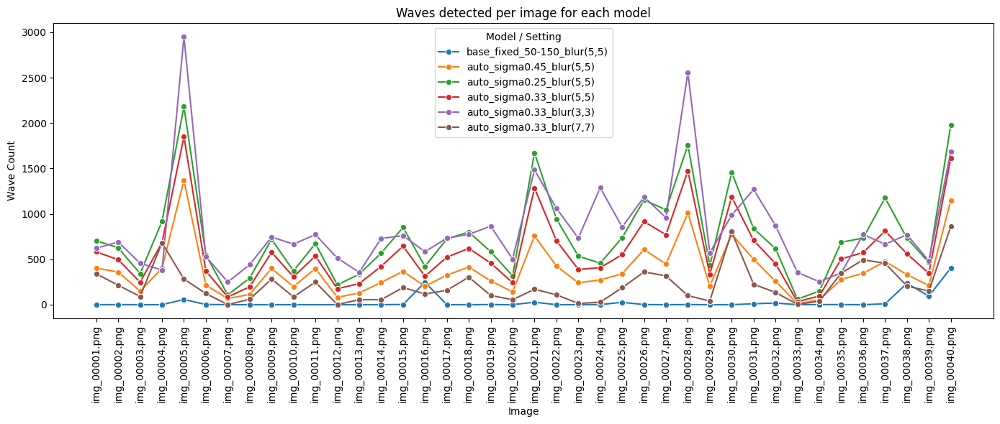

In [15]:
plt.figure(figsize=(14,6))
sns.lineplot(
    data=all_df.sort_values("image_id"),
    x="image_id",
    y="wave_count",
    hue="setting",
    marker="o"
)

plt.xticks(rotation=90)
plt.title("Waves detected per image for each model")
plt.xlabel("Image")
plt.ylabel("Wave Count")
plt.legend(title="Model / Setting")
plt.tight_layout()
plt.savefig('CHART 1 — Compare number of waves per image.jpg', dpi=300)
plt.show()

#### CHART 2 — Compare average wave size (height) per image

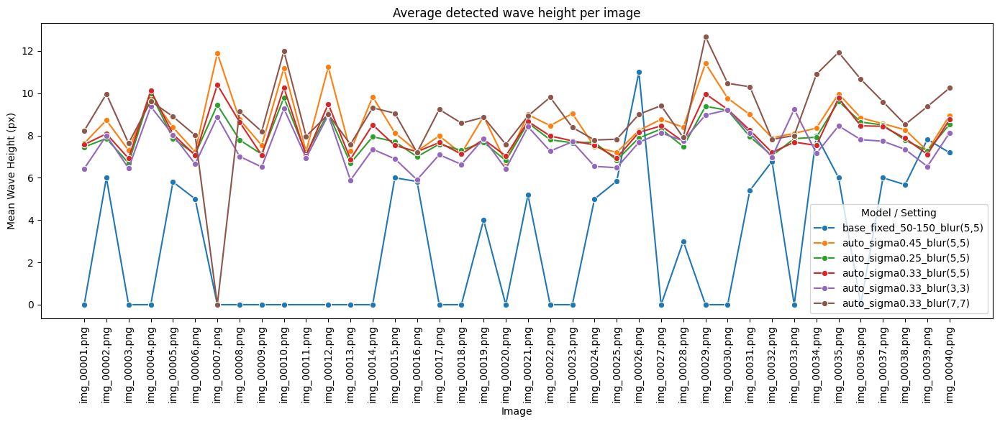

In [16]:
plt.figure(figsize=(14,6))
sns.lineplot(
    data=all_df.sort_values("image_id"),
    x="image_id",
    y="mean_wave_height",
    hue="setting",
    marker="o"
)

plt.xticks(rotation=90)
plt.title("Average detected wave height per image")
plt.xlabel("Image")
plt.ylabel("Mean Wave Height (px)")
plt.legend(title="Model / Setting")
plt.tight_layout()
plt.savefig('CHART 2 — Compare average wave height per image.jpg', dpi=300)
plt.show()

#### CHART 3 — Scatterplot of wave center locations (x,y)

This creates one subplot per model, showing all detected wave centers on the image area the waves were detected.

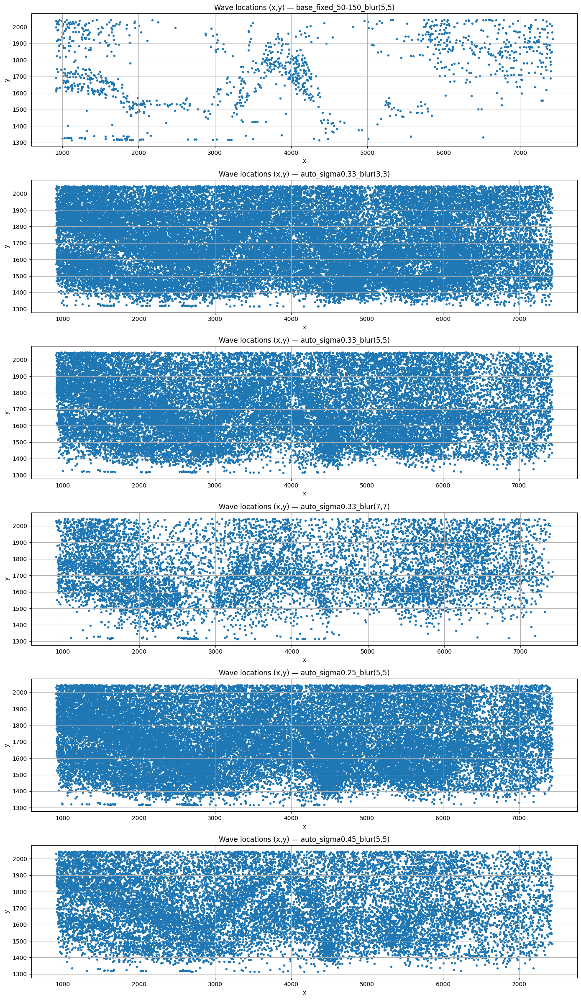

In [17]:
unique_settings = all_df["setting"].unique()
n = len(unique_settings)

plt.figure(figsize=(14, 4*n))

for i, setting in enumerate(unique_settings, 1):
    subset = all_df[all_df["setting"] == setting]

    xs = np.concatenate(subset["wave_x_list"].values)
    ys = np.concatenate(subset["wave_y_list"].values)

    plt.subplot(n, 1, i)
    plt.scatter(xs, ys, s=8)
    plt.title(f"Wave locations (x,y) — {setting}")
    plt.xlabel("x")
    plt.ylabel("y")
    plt.grid(True)

plt.tight_layout()
plt.savefig('CHART 3 — Scatterplot of wave center locations.jpg', dpi=300)
plt.show()


#### CHART 4 — Histogram of wave heights per model

This compares the distribution of wave sizes:

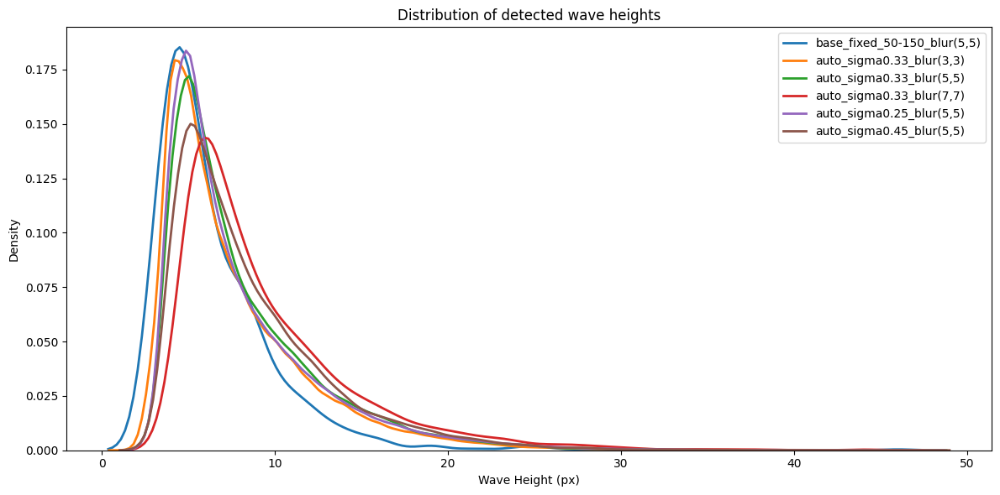

In [18]:
plt.figure(figsize=(12,6))

for setting in all_df["setting"].unique():
    subset = all_df[all_df["setting"] == setting]
    heights = np.concatenate(subset["wave_heights_list"].values)
    sns.kdeplot(heights, label=setting, linewidth=2)

plt.title("Distribution of detected wave heights")
plt.xlabel("Wave Height (px)")
plt.ylabel("Density")
plt.legend()
plt.tight_layout()
plt.savefig('CHART 4 — Histogram of wave heights per model.jpg', dpi=300)
plt.show()

#### CHART 5 — Boxplot of wave counts per image per model

It is wave count per image grouped by model

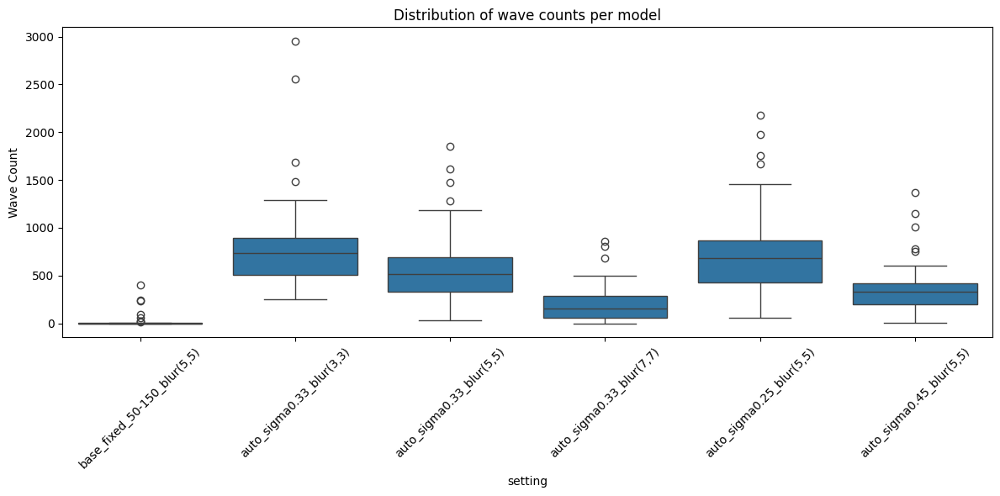

In [19]:
plt.figure(figsize=(12,6))

sns.boxplot(
    data=all_df,
    x="setting",
    y="wave_count"
)

plt.title("Distribution of wave counts per model")
plt.ylabel("Wave Count")
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('CHART 5 — Boxplot of wave counts per image per model.jpg', dpi=300)
plt.show()

#### CHART 6 Boxplot of wave heights

In [20]:
# Expand wave heights into a long-format table
wave_height_df = all_df.explode("wave_heights_list")

# Convert to numeric, drop missing
wave_height_df["wave_heights_list"] = pd.to_numeric(
    wave_height_df["wave_heights_list"], errors="coerce"
)
wave_height_df = wave_height_df.dropna(subset=["wave_heights_list"])

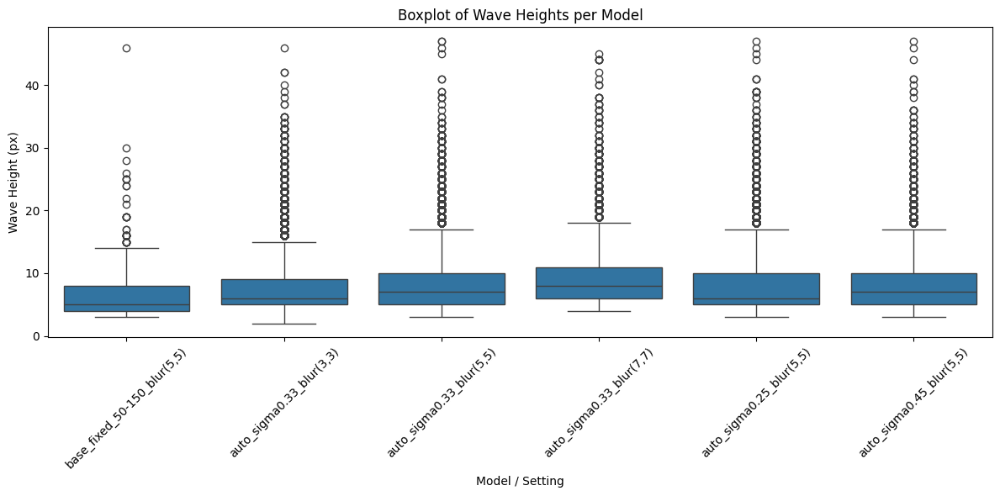

In [21]:
plt.figure(figsize=(12, 6))
sns.boxplot(
    data=wave_height_df,
    x="setting",
    y="wave_heights_list",
    showfliers=True,  # important to visualize outliers!
)
plt.title("Boxplot of Wave Heights per Model")
plt.xlabel("Model / Setting")
plt.ylabel("Wave Height (px)")
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('CHART 6 Boxplot of wave heights.jpg', dpi=300)
plt.show()

#### Generate all above Plots for defined time periode

In [17]:
exp_dir = os.path.join(parent_dir, "experiments")
os.makedirs(exp_dir, exist_ok=True)

In [18]:
# ------------------------------------------------------------------
# USER-DEFINED IMAGE RANGE (inclusive)
# ------------------------------------------------------------------

# 1) Convert to datetime properly (DD/MM/YYYY)
wave_df["date"] = pd.to_datetime(
    wave_df["date"],
    dayfirst=True,
    errors="coerce"
)

# 2) Define period in ISO format (always safe)
period_start = pd.Timestamp("2023-01-01")
period_end   = pd.Timestamp("2023-12-31")

# 3) Filter
wave_df_period = wave_df[
    wave_df["date"].between(period_start, period_end)
].copy()

print("All images in period:", wave_df_period["new_image_name"].tolist())

All images in period: ['img_00229.png', 'img_00230.png', 'img_00231.png', 'img_00232.png', 'img_00233.png', 'img_00234.png', 'img_00235.png', 'img_00236.png', 'img_00237.png', 'img_00238.png', 'img_00239.png', 'img_00240.png', 'img_00241.png', 'img_00242.png', 'img_00243.png', 'img_00244.png', 'img_00245.png', 'img_00246.png', 'img_00247.png', 'img_00248.png', 'img_00249.png', 'img_00250.png', 'img_00251.png', 'img_00252.png', 'img_00253.png', 'img_00254.png', 'img_00255.png', 'img_00256.png', 'img_00257.png', 'img_00258.png', 'img_00259.png', 'img_00260.png', 'img_00261.png', 'img_00262.png', 'img_00263.png', 'img_00264.png', 'img_00265.png', 'img_00266.png', 'img_00267.png', 'img_00268.png', 'img_00269.png', 'img_00270.png', 'img_00271.png', 'img_00272.png', 'img_00273.png', 'img_00274.png', 'img_00275.png', 'img_00276.png', 'img_00277.png', 'img_00278.png', 'img_00279.png', 'img_00280.png', 'img_00281.png', 'img_00282.png', 'img_00283.png', 'img_00284.png', 'img_00285.png', 'img_002

In [19]:
unique_dates = sorted(wave_df_period["date"].dropna().dt.strftime("%Y-%m-%d").unique())
print(unique_dates)

['2023-01-01', '2023-01-02', '2023-01-03', '2023-01-04', '2023-01-05', '2023-01-06', '2023-01-07', '2023-01-08', '2023-01-09', '2023-01-10', '2023-01-11', '2023-01-12', '2023-01-13', '2023-01-14', '2023-01-15', '2023-01-16', '2023-01-17', '2023-01-18', '2023-01-19', '2023-01-20', '2023-01-21', '2023-01-22', '2023-01-23', '2023-01-24', '2023-01-25', '2023-01-26', '2023-01-27', '2023-01-28', '2023-01-29', '2023-01-30', '2023-01-31', '2023-02-01', '2023-02-02', '2023-02-03', '2023-02-04', '2023-02-05', '2023-02-06', '2023-02-07', '2023-02-08', '2023-02-09', '2023-02-10', '2023-02-11', '2023-02-12', '2023-02-13', '2023-02-14', '2023-02-15', '2023-02-16', '2023-02-17', '2023-02-18', '2023-02-19', '2023-02-20', '2023-02-21', '2023-02-22', '2023-02-23', '2023-02-24', '2023-02-25', '2023-02-26', '2023-02-27', '2023-02-28', '2023-03-01', '2023-03-02', '2023-03-03', '2023-03-04', '2023-03-05', '2023-03-06', '2023-03-07', '2023-03-08', '2023-03-09', '2023-03-10', '2023-03-11', '2023-03-12', '2023

In [20]:
# -----------------------------------------------
# FIXED WAVE-DETECTION CONSTANTS
# -----------------------------------------------
horizon_y = 1313
x_min, x_max = 900, 7450

min_wave_area = 15
max_wave_area = 300
max_wave_height = 50
max_wave_width  = 200

min_aspect_ratio = 1.2
max_aspect_ratio = 10.0

canny_low_fixed = 50
canny_high_fixed = 150

In [21]:
# -----------------------------------------------
# EXPERIMENT DEFINITIONS
# -----------------------------------------------
blur_values = [(3,3), (5,5), (7,7)]
sigma_values = [0.25, 0.33, 0.45]

experiments = []

# Baseline fixed-threshold model
experiments.append({
    "name": "baseline_fixed_50-150_blur(5,5)",
    "blur": (5,5),
    "sigma": None,
    "fixed": True
})

# Auto-Canny variants
for b in blur_values:
    for s in sigma_values:
        experiments.append({
            "name": f"auto_sigma{s}_blur({b[0]},{b[1]})",
            "blur": b,
            "sigma": s,
            "fixed": False
        })


In [23]:
# -----------------------------------------------
# MAIN PROCESSING FUNCTION USED FOR EACH EXPERIMENT
# -----------------------------------------------
def run_experiment(exp):

    exp_name = exp["name"]
    blur_ksize = exp["blur"]
    sigma = exp["sigma"]
    use_fixed = exp["fixed"]

    print(f"\n=== Running experiment: {exp_name} ===")

    # Create folders
    base_dir = os.path.join(exp_dir, exp_name)
    os.makedirs(exp_dir, exist_ok=True)

    detected_img_folder = os.path.join(base_dir, "annotated_images")
    detected_lables_folder = os.path.join(base_dir, "labels")
    os.makedirs(detected_img_folder, exist_ok=True)
    os.makedirs(detected_lables_folder, exist_ok=True)

    csv_path_exp = os.path.join(base_dir, f"{exp_name}.csv")

    # Resume logic
    if os.path.exists(csv_path_exp):
        results_df = pd.read_csv(csv_path_exp)
        done_images = set(results_df["new_image_name"])
        results_list = results_df.to_dict("records")
        print(f"Resuming: {len(done_images)} images already processed.")
    else:
        done_images = set()
        results_list = []

    # Load list of completed YOLO label files
    done_labels = {
        f.replace(".txt", ".png") for f in os.listdir(detected_lables_folder)
    }

    # -------------------------------------------
    # MAIN LOOP OVER IMAGES
    # -------------------------------------------
    for idx, row in tqdm(wave_df_period.iterrows(), total=len(wave_df_period)):

        img_name = row["new_image_name"]

        # resume
        if img_name in done_images:
            continue

        # skip if annotated file already exists
        detected_img_path = os.path.join(detected_img_folder, img_name)
        if os.path.exists(detected_img_path):
            continue

        src_path = os.path.join(source_folder, img_name)
        if not os.path.exists(src_path):
            print(f"Image missing: {src_path}")
            continue

        image = cv2.imread(src_path)
        if image is None:
            print(f"Read failed: {src_path}")
            continue

        # ----------- YOLO masking -----------
        masked_image = image.copy()
        water_sample_strip = image[horizon_y+10:horizon_y+100, x_min:x_max]
        median_color = [int(np.median(water_sample_strip[:,:,i])) for i in range(3)]

        results = yolo_model(src_path)
        for box in results[0].boxes:
            cls = int(box.cls)
            label = yolo_model.model.names[cls]
            if label in ['buoy','boat','SUP','ship','motorboat',
                         'rowing shell','swimmer','sailing boat',
                         'building','flag','tree']:
                x1,y1,x2,y2 = box.xyxy.cpu().numpy().astype(int)[0]
                cv2.rectangle(masked_image, (x1,y1), (x2,y2), median_color, -1)

        # ----------- GRAYSCALE & ROI -----------
        gray = cv2.cvtColor(masked_image, cv2.COLOR_BGR2GRAY)
        roi_mask = np.zeros_like(gray)
        roi_mask[horizon_y:, x_min:x_max] = 255
        gray_roi = cv2.bitwise_and(gray, gray, mask=roi_mask)

        # CLAHE
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
        gray_roi_eq = clahe.apply(gray_roi)

        # Gaussian blur
        blurred = cv2.GaussianBlur(gray_roi_eq, blur_ksize, 0)

        # Adaptive Canny
        if use_fixed:
            edges = cv2.Canny(blurred, canny_low_fixed, canny_high_fixed)
        else:
            roi_pixels = blurred[roi_mask==255]
            v = np.median(roi_pixels) if roi_pixels.size>0 else 128
            auto_low  = int(max(0, (1.0 - sigma) * v))
            auto_high = int(min(255, (1.0 + sigma) * v))
            edges = cv2.Canny(blurred, auto_low, auto_high)

        # Morphological cleanup
        kernel = np.ones((3,3), np.uint8)
        edges_cleaned = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
        contours, _ = cv2.findContours(edges_cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        wave_boxes = []
        wave_heights = []
        wave_centers_x = []
        wave_centers_y = []
        wave_count = 0
        img_result = image.copy()

        # ----------- CONTOUR FILTERING -----------
        for cnt in contours:
            area = cv2.contourArea(cnt)
            x, y, w, h = cv2.boundingRect(cnt)
            aspect_ratio = w / h if h > 0 else 0

            # filtering
            if not(min_wave_area <= area <= max_wave_area):
                continue
            if h > max_wave_height or w > max_wave_width:
                continue
            if not(min_aspect_ratio <= aspect_ratio <= max_aspect_ratio):
                continue

            wave_count += 1
            wave_boxes.append((x, y, w, h))
            wave_heights.append(str(h))
            wave_centers_x.append(str(x + w//2))
            wave_centers_y.append(str(y + h//2))

            cv2.rectangle(img_result, (x,y), (x+w,y+h), (0,255,0), 2)

        # ----------- SAVE RESULTS -----------
        cv2.imwrite(detected_img_path, img_result)

        # YOLO label file
        label_path = os.path.join(detected_lables_folder, img_name.replace(".png",".txt"))
        with open(label_path, "w") as f:
            for (x,y,w,h) in wave_boxes:
                xc = (x + w/2) / image.shape[1]
                yc = (y + h/2) / image.shape[0]
                wn = w / image.shape[1]
                hn = h / image.shape[0]
                f.write(f"0 {xc} {yc} {wn} {hn}\n")

        # CSV row
        result = dict(row)
        result.update({
            "wave_count": wave_count,
            "wave_heights_px": ",".join(wave_heights),
            "wave_locations_x": ",".join(wave_centers_x),
            "wave_locations_y": ",".join(wave_centers_y)
        })

        results_list.append(result)
        pd.DataFrame(results_list).to_csv(csv_path_exp, index=False)

    print(f"Finished experiment: {exp_name}")
    print("CSV:", csv_path_exp)
    print("Images:", detected_img_folder)

In [ ]:
# -----------------------------------------------
# RUN ALL EXPERIMENTS
# -----------------------------------------------
for exp in experiments:
    run_experiment(exp)


=== Running experiment: baseline_fixed_50-150_blur(5,5) ===


  0%|          | 0/363 [00:00<?, ?it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00229.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


  0%|          | 1/363 [00:00<04:58,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00230.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 2/363 [00:01<05:17,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00231.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 3/363 [00:02<05:03,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00232.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 4/363 [00:03<05:00,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00233.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  1%|▏         | 5/363 [00:04<05:05,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00234.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 6/363 [00:05<05:25,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00235.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 7/363 [00:06<05:22,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00236.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 8/363 [00:06<05:10,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00237.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 9/363 [00:07<05:22,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00238.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 10/363 [00:08<05:22,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00239.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 11/363 [00:09<05:16,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00240.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 12/363 [00:10<05:10,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00241.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  4%|▎         | 13/363 [00:11<05:15,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00242.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 14/363 [00:12<05:11,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00243.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 15/363 [00:13<05:23,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00244.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 16/363 [00:14<05:34,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00245.png: 160x640 (no detections), 50.1ms
Speed: 3.5ms preprocess, 50.1ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 17/363 [00:15<05:43,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00246.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 18/363 [00:16<05:25,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00247.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  5%|▌         | 19/363 [00:17<05:34,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00248.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 20/363 [00:18<05:48,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00249.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 21/363 [00:19<05:39,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00250.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 22/363 [00:20<05:18,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00251.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  6%|▋         | 23/363 [00:21<05:10,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00252.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 24/363 [00:22<05:15,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00253.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 25/363 [00:23<05:15,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00254.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 26/363 [00:24<05:17,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00255.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 27/363 [00:25<05:28,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00256.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 28/363 [00:25<05:19,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00257.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 29/363 [00:27<05:29,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00258.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 30/363 [00:28<05:31,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00259.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  9%|▊         | 31/363 [00:29<05:56,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00260.png: 160x640 (no detections), 49.4ms
Speed: 4.1ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 32/363 [00:30<06:28,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00261.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 33/363 [00:31<06:07,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00262.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 34/363 [00:32<05:55,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00263.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 35/363 [00:33<05:18,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00264.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 36/363 [00:34<05:19,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00265.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 37/363 [00:35<05:20,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00266.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 38/363 [00:36<05:15,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00267.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 39/363 [00:37<05:08,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00268.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 40/363 [00:38<05:06,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00269.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 11%|█▏        | 41/363 [00:39<05:39,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00270.png: 160x640 (no detections), 49.7ms
Speed: 3.4ms preprocess, 49.7ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 42/363 [00:40<05:34,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00271.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 43/363 [00:41<05:22,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00272.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 44/363 [00:42<05:13,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00273.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 45/363 [00:43<05:07,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00274.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 46/363 [00:44<04:57,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00275.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 47/363 [00:45<05:18,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00276.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 48/363 [00:46<05:42,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00277.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 49/363 [00:47<05:29,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00278.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 50/363 [00:48<05:14,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00279.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 51/363 [00:49<05:14,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00280.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 52/363 [00:50<05:00,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00281.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 53/363 [00:51<04:40,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00282.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 54/363 [00:52<04:41,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00283.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 55/363 [00:52<04:39,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00284.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 56/363 [00:53<04:46,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00285.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 57/363 [00:54<04:48,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00286.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 58/363 [00:55<04:44,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00287.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▋        | 59/363 [00:56<04:35,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00288.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 60/363 [00:57<04:31,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00289.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 61/363 [00:58<04:24,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00290.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 62/363 [00:59<04:34,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00291.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 63/363 [01:00<04:32,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00292.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 64/363 [01:01<04:45,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00293.png: 160x640 (no detections), 50.3ms
Speed: 3.9ms preprocess, 50.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 65/363 [01:02<05:21,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00294.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 66/363 [01:03<05:12,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00295.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 67/363 [01:04<05:11,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00296.png: 160x640 (no detections), 49.5ms
Speed: 6.0ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▊        | 68/363 [01:05<05:24,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00297.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 69/363 [01:06<05:11,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00298.png: 160x640 1 bird, 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 4.7ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 70/363 [01:07<04:42,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00299.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 71/363 [01:08<04:43,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00300.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 72/363 [01:09<04:37,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00301.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 73/363 [01:10<04:27,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00302.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 74/363 [01:11<04:26,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00303.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 75/363 [01:12<04:34,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00304.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 76/363 [01:13<04:35,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00305.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 77/363 [01:14<04:30,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00306.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██▏       | 78/363 [01:15<04:31,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00307.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 79/363 [01:16<04:34,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00308.png: 160x640 (no detections), 50.2ms
Speed: 3.9ms preprocess, 50.2ms inference, 3.3ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 80/363 [01:17<04:54,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00309.png: 160x640 (no detections), 49.2ms
Speed: 3.8ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 81/363 [01:19<05:57,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00310.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 82/363 [01:20<06:06,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00311.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 83/363 [01:21<05:56,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00312.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 84/363 [01:22<05:33,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00313.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 85/363 [01:23<05:06,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00314.png: 160x640 (no detections), 49.7ms
Speed: 3.4ms preprocess, 49.7ms inference, 3.5ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▎       | 86/363 [01:24<04:47,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00315.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 87/363 [01:25<04:42,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00316.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 88/363 [01:26<04:41,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00317.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 89/363 [01:27<04:35,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00318.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 90/363 [01:28<04:31,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00319.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 91/363 [01:29<04:21,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00320.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 92/363 [01:30<04:15,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00321.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 93/363 [01:31<04:13,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00322.png: 160x640 (no detections), 49.6ms
Speed: 3.5ms preprocess, 49.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 94/363 [01:32<04:18,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00323.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 95/363 [01:33<04:36,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00324.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▋       | 96/363 [01:34<04:50,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00325.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 97/363 [01:35<04:53,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00326.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 98/363 [01:36<04:47,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00327.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 99/363 [01:37<04:35,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00328.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 100/363 [01:38<04:26,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00329.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 101/363 [01:39<04:11,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00330.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 102/363 [01:40<04:12,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00331.png: 160x640 (no detections), 49.4ms
Speed: 4.2ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 103/363 [01:41<04:16,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00332.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▊       | 104/363 [01:42<04:15,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00333.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 105/363 [01:43<03:56,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00334.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 106/363 [01:44<03:43,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00335.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 107/363 [01:44<03:45,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00336.png: 160x640 1 person, 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 3.5ms postprocess per image at shape (1, 3, 160, 640)


 30%|██▉       | 108/363 [01:45<03:53,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00337.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 109/363 [01:46<03:47,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00338.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 110/363 [01:47<03:39,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00339.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 111/363 [01:48<03:42,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00340.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 112/363 [01:50<04:28,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00341.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 113/363 [01:51<04:36,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00342.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 31%|███▏      | 114/363 [01:52<04:29,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00343.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 115/363 [01:53<04:06,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00344.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 116/363 [01:54<04:07,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00345.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 117/363 [01:54<03:58,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00346.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 118/363 [01:55<03:59,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00347.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 119/363 [01:56<04:02,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00348.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 120/363 [01:57<03:51,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00349.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 121/363 [01:58<03:41,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00350.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▎      | 122/363 [01:59<03:45,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00351.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 3.9ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 123/363 [02:00<03:47,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00352.png: 160x640 (no detections), 49.6ms
Speed: 3.3ms preprocess, 49.6ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 124/363 [02:01<03:46,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00353.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 125/363 [02:02<03:55,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00354.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 126/363 [02:03<03:55,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00355.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 127/363 [02:04<03:52,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00356.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▌      | 128/363 [02:06<04:18,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00357.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 129/363 [02:07<04:33,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00358.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 130/363 [02:08<04:29,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00359.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 131/363 [02:09<04:10,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00360.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▋      | 132/363 [02:10<04:04,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00361.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 133/363 [02:11<04:30,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00362.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 134/363 [02:12<04:17,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00363.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 135/363 [02:13<04:16,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00364.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 136/363 [02:14<04:00,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00365.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 3.5ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 137/363 [02:15<03:59,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00366.png: 160x640 (no detections), 49.4ms
Speed: 4.5ms preprocess, 49.4ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 138/363 [02:17<04:20,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00367.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 139/363 [02:18<04:06,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00368.png: 160x640 1 bird, 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▊      | 140/363 [02:19<03:50,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00369.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 141/363 [02:20<03:44,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00370.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 142/363 [02:21<04:14,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00371.png: 160x640 (no detections), 49.5ms
Speed: 4.3ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 143/363 [02:23<04:31,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00372.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 144/363 [02:24<04:37,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00373.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 145/363 [02:25<04:57,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00374.png: 160x640 (no detections), 50.3ms
Speed: 5.0ms preprocess, 50.3ms inference, 3.2ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 146/363 [02:28<06:02,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00375.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 147/363 [02:30<06:29,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00376.png: 160x640 (no detections), 49.4ms
Speed: 4.3ms preprocess, 49.4ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 148/363 [02:32<06:43,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00377.png: 160x640 (no detections), 49.7ms
Speed: 4.1ms preprocess, 49.7ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 149/363 [02:33<06:02,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00378.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 41%|████▏     | 150/363 [02:34<05:27,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00379.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 151/363 [02:36<05:10,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00380.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 152/363 [02:37<05:09,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00381.png: 160x640 (no detections), 49.5ms
Speed: 4.2ms preprocess, 49.5ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 153/363 [02:39<05:15,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00382.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 154/363 [02:40<05:12,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00383.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 155/363 [02:41<04:49,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00384.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 156/363 [02:42<04:25,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00385.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 157/363 [02:43<04:08,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00386.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▎     | 158/363 [02:44<03:51,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00387.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 159/363 [02:45<03:37,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00388.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 160/363 [02:46<03:37,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00389.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 161/363 [02:47<03:24,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00390.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 162/363 [02:48<03:21,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00391.png: 160x640 (no detections), 49.6ms
Speed: 3.7ms preprocess, 49.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 163/363 [02:49<03:19,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00392.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 164/363 [02:50<03:11,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00393.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 165/363 [02:51<03:05,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00394.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 166/363 [02:52<03:14,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00395.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 167/363 [02:54<03:36,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00396.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▋     | 168/363 [02:55<03:39,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00397.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 169/363 [02:56<03:29,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00398.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 170/363 [02:57<03:16,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00399.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 171/363 [02:57<03:00,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00400.png: 160x640 (no detections), 49.3ms
Speed: 4.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 172/363 [02:58<02:54,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00401.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 173/363 [02:59<02:50,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00402.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 174/363 [03:00<03:09,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00403.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 175/363 [03:02<03:57,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00404.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 176/363 [03:04<04:27,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00405.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 177/363 [03:06<04:35,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00406.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 178/363 [03:07<04:37,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00407.png: 160x640 (no detections), 49.2ms
Speed: 3.8ms preprocess, 49.2ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 179/363 [03:09<04:31,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00408.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 180/363 [03:10<04:23,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00409.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 181/363 [03:11<04:09,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00410.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 182/363 [03:12<03:48,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00411.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 183/363 [03:13<03:34,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00412.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 184/363 [03:14<03:28,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00413.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 185/363 [03:15<03:22,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00414.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 186/363 [03:16<03:08,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00415.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 187/363 [03:17<03:06,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00416.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 188/363 [03:18<03:00,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00417.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 189/363 [03:19<02:54,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00418.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 190/363 [03:20<02:55,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00419.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 191/363 [03:21<02:58,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00420.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 192/363 [03:23<03:10,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00421.png: 160x640 (no detections), 49.2ms
Speed: 4.0ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 193/363 [03:24<03:16,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00422.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 194/363 [03:25<03:14,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00423.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▎    | 195/363 [03:26<03:29,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00424.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 196/363 [03:27<03:16,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00425.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 197/363 [03:28<03:05,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00426.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 198/363 [03:29<02:53,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00427.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 199/363 [03:30<02:55,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00428.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 200/363 [03:31<02:48,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00429.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 201/363 [03:32<02:44,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00430.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 202/363 [03:33<02:38,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00431.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 203/363 [03:34<02:41,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00432.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 204/363 [03:35<02:37,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00433.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▋    | 205/363 [03:36<02:31,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00434.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 206/363 [03:37<02:33,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00435.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 207/363 [03:38<02:29,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00436.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 208/363 [03:39<02:26,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00437.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 209/363 [03:40<02:24,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00438.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 210/363 [03:41<02:36,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00439.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 211/363 [03:42<02:48,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00440.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 212/363 [03:43<02:42,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00441.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▊    | 213/363 [03:44<02:37,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00442.png: 160x640 (no detections), 49.6ms
Speed: 3.8ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 214/363 [03:46<02:40,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00443.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 215/363 [03:47<02:38,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00444.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 216/363 [03:48<02:33,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00445.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 217/363 [03:49<02:32,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00446.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 218/363 [03:50<02:26,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00447.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 219/363 [03:51<02:23,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00448.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 220/363 [03:51<02:19,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00449.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 221/363 [03:53<02:20,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00450.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 222/363 [03:54<02:22,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00451.png: 160x640 (no detections), 50.2ms
Speed: 3.3ms preprocess, 50.2ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████▏   | 223/363 [03:55<02:27,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00452.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 224/363 [03:56<02:23,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00453.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 225/363 [03:57<02:41,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00454.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 226/363 [03:59<02:47,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00455.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 227/363 [04:00<02:43,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00456.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 228/363 [04:01<02:36,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00457.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 229/363 [04:02<02:29,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00458.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 230/363 [04:03<02:27,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00459.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▎   | 231/363 [04:04<02:23,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00460.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 232/363 [04:05<02:19,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00461.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 233/363 [04:06<02:18,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00462.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 234/363 [04:07<02:13,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00463.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▍   | 235/363 [04:08<02:06,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00464.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 236/363 [04:09<02:01,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00465.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 237/363 [04:10<01:58,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00466.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 238/363 [04:10<01:54,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00467.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 239/363 [04:11<01:52,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00468.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 240/363 [04:12<01:52,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00469.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▋   | 241/363 [04:14<02:03,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00470.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 242/363 [04:15<02:06,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00471.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 243/363 [04:16<02:05,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00472.png: 160x640 (no detections), 49.1ms
Speed: 3.5ms preprocess, 49.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 244/363 [04:17<02:02,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00473.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 245/363 [04:18<01:59,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00474.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 246/363 [04:19<01:56,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00475.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 247/363 [04:20<01:51,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00476.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 248/363 [04:20<01:51,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00477.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▊   | 249/363 [04:21<01:46,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00478.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 250/363 [04:22<01:43,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00479.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 251/363 [04:23<01:43,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00480.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 252/363 [04:24<01:41,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00481.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 253/363 [04:25<01:40,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00482.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 254/363 [04:26<01:40,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00483.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 70%|███████   | 255/363 [04:27<01:36,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00484.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 256/363 [04:28<01:35,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00485.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 257/363 [04:29<01:41,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00486.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 258/363 [04:30<01:48,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00487.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████▏  | 259/363 [04:31<01:49,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00488.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 260/363 [04:32<01:38,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00489.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 261/363 [04:33<01:38,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00490.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 262/363 [04:34<01:38,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00491.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 263/363 [04:35<01:36,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00492.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 264/363 [04:36<01:34,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00493.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 265/363 [04:37<01:35,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00494.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 266/363 [04:38<01:32,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00495.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▎  | 267/363 [04:38<01:30,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00496.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 268/363 [04:39<01:28,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00497.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 269/363 [04:40<01:27,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00498.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 270/363 [04:41<01:27,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00499.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 271/363 [04:42<01:32,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00500.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 272/363 [04:43<01:32,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00501.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 273/363 [04:45<01:32,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00502.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 274/363 [04:46<01:39,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00503.png: 160x640 (no detections), 49.2ms
Speed: 3.8ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 275/363 [04:47<01:48,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00504.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 276/363 [04:49<01:49,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00505.png: 160x640 (no detections), 50.4ms
Speed: 3.8ms preprocess, 50.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▋  | 277/363 [04:50<01:49,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00506.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 278/363 [04:51<01:45,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00507.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 279/363 [04:52<01:37,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00508.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 280/363 [04:53<01:32,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00509.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 281/363 [04:54<01:26,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00510.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 282/363 [04:55<01:29,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00511.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 3.5ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 283/363 [04:56<01:25,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00512.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 284/363 [04:57<01:23,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00513.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▊  | 285/363 [04:58<01:20,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00514.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 286/363 [04:59<01:20,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00515.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 287/363 [05:00<01:19,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00516.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 288/363 [05:02<01:23,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00517.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 289/363 [05:03<01:21,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00518.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 290/363 [05:04<01:17,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00519.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 291/363 [05:05<01:11,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00520.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 292/363 [05:05<01:07,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00521.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 293/363 [05:07<01:11,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00522.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 294/363 [05:08<01:12,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00523.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████▏ | 295/363 [05:09<01:09,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00524.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 296/363 [05:09<01:03,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00525.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 297/363 [05:11<01:05,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00526.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 298/363 [05:11<01:02,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00527.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 299/363 [05:12<01:03,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00528.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 300/363 [05:14<01:03,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00529.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 301/363 [05:15<01:03,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00530.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 302/363 [05:15<01:00,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00531.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 303/363 [05:17<01:03,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00532.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▎ | 304/363 [05:18<01:06,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00533.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 305/363 [05:19<01:00,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00534.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 306/363 [05:20<00:59,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00535.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 307/363 [05:21<00:59,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00536.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 308/363 [05:22<00:56,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00537.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 309/363 [05:23<00:54,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00538.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 310/363 [05:24<00:54,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00539.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 311/363 [05:25<00:52,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00540.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 312/363 [05:26<00:51,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00541.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 313/363 [05:27<00:51,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00542.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 314/363 [05:28<00:51,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00543.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 315/363 [05:29<00:50,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00544.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 316/363 [05:30<00:49,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00545.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 317/363 [05:31<00:48,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00546.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 318/363 [05:32<00:46,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00547.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 319/363 [05:34<00:49,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00548.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 320/363 [05:35<00:48,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00549.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 321/363 [05:36<00:45,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00550.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▊ | 322/363 [05:37<00:42,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00551.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 323/363 [05:37<00:39,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00552.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 324/363 [05:38<00:36,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00553.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 325/363 [05:39<00:36,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00554.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 326/363 [05:40<00:34,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00555.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 327/363 [05:41<00:34,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00556.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 328/363 [05:42<00:32,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00557.png: 160x640 (no detections), 49.7ms
Speed: 3.6ms preprocess, 49.7ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 329/363 [05:43<00:34,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00558.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 330/363 [05:44<00:32,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00559.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 331/363 [05:45<00:30,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00560.png: 160x640 (no detections), 49.6ms
Speed: 3.6ms preprocess, 49.6ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████▏| 332/363 [05:46<00:30,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00561.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 333/363 [05:47<00:27,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00562.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 334/363 [05:48<00:25,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00563.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 335/363 [05:49<00:28,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00564.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 336/363 [05:50<00:31,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00565.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 337/363 [05:51<00:28,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00566.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 338/363 [05:52<00:26,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00567.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 339/363 [05:54<00:26,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00568.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▎| 340/363 [05:55<00:27,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00569.png: 160x640 (no detections), 49.5ms
Speed: 4.6ms preprocess, 49.5ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 341/363 [05:56<00:26,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00570.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 342/363 [05:57<00:23,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00571.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 343/363 [05:58<00:21,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00572.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▍| 344/363 [05:59<00:19,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00573.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 345/363 [06:00<00:17,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00574.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 346/363 [06:01<00:15,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00575.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 347/363 [06:02<00:14,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00576.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 348/363 [06:03<00:13,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00577.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 349/363 [06:04<00:13,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00578.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▋| 350/363 [06:05<00:12,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00579.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 351/363 [06:05<00:11,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00580.png: 160x640 1 airplane, 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 3.5ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 352/363 [06:06<00:10,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00581.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 353/363 [06:08<00:10,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00582.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 354/363 [06:09<00:09,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00583.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 355/363 [06:10<00:08,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00584.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 356/363 [06:11<00:07,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00585.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 357/363 [06:12<00:05,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00586.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▊| 358/363 [06:13<00:04,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00587.png: 160x640 (no detections), 50.2ms
Speed: 3.3ms preprocess, 50.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 359/363 [06:14<00:04,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00588.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 360/363 [06:15<00:03,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00589.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 361/363 [06:16<00:02,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00590.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


100%|█████████▉| 362/363 [06:17<00:00,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00591.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


100%|██████████| 363/363 [06:18<00:00,  1.04s/it]


Finished experiment: baseline_fixed_50-150_blur(5,5)
CSV: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\baseline_fixed_50-150_blur(5,5)\baseline_fixed_50-150_blur(5,5).csv
Images: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\baseline_fixed_50-150_blur(5,5)\annotated_images

=== Running experiment: auto_sigma0.25_blur(3,3) ===


  0%|          | 0/363 [00:00<?, ?it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00229.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 7.0ms postprocess per image at shape (1, 3, 160, 640)


  0%|          | 1/363 [00:00<05:57,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00230.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 2/363 [00:01<05:57,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00231.png: 160x640 (no detections), 50.3ms
Speed: 3.9ms preprocess, 50.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 3/363 [00:03<06:10,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00232.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 4/363 [00:04<06:37,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00233.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


  1%|▏         | 5/363 [00:05<06:28,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00234.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 6/363 [00:06<06:24,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00235.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 7/363 [00:07<06:11,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00236.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 8/363 [00:08<05:52,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00237.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 9/363 [00:09<05:48,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00238.png: 160x640 (no detections), 51.1ms
Speed: 5.1ms preprocess, 51.1ms inference, 5.3ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 10/363 [00:10<06:33,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00239.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 11/363 [00:11<06:15,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00240.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 12/363 [00:12<05:59,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00241.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  4%|▎         | 13/363 [00:13<06:07,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00242.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 14/363 [00:14<05:53,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00243.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 15/363 [00:15<06:00,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00244.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 16/363 [00:16<05:57,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00245.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 17/363 [00:17<05:45,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00246.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 18/363 [00:18<05:42,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00247.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  5%|▌         | 19/363 [00:19<06:22,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00248.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 20/363 [00:21<06:33,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00249.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 21/363 [00:22<06:10,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00250.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 22/363 [00:22<05:42,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00251.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


  6%|▋         | 23/363 [00:23<05:30,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00252.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 24/363 [00:24<05:25,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00253.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 25/363 [00:25<05:22,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00254.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 26/363 [00:26<05:35,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00255.png: 160x640 (no detections), 49.5ms
Speed: 4.6ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 27/363 [00:27<05:35,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00256.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 28/363 [00:28<05:30,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00257.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 29/363 [00:29<05:31,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00258.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 30/363 [00:30<05:32,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00259.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  9%|▊         | 31/363 [00:31<05:39,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00260.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 32/363 [00:33<06:16,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00261.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 33/363 [00:34<06:25,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00262.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 34/363 [00:36<07:08,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00263.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 35/363 [00:37<06:52,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00264.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 36/363 [00:38<06:50,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00265.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 37/363 [00:39<06:48,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00266.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 38/363 [00:40<06:19,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00267.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 39/363 [00:41<05:47,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00268.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 40/363 [00:42<05:30,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00269.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 11%|█▏        | 41/363 [00:43<05:20,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00270.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 42/363 [00:44<05:17,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00271.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 43/363 [00:45<05:06,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00272.png: 160x640 (no detections), 50.5ms
Speed: 4.1ms preprocess, 50.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 44/363 [00:46<05:06,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00273.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 45/363 [00:47<05:06,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00274.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 46/363 [00:48<04:59,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00275.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 47/363 [00:49<05:04,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00276.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 48/363 [00:50<05:13,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00277.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 49/363 [00:51<05:41,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00278.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 50/363 [00:52<05:53,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00279.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 51/363 [00:53<05:36,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00280.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 52/363 [00:54<05:21,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00281.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 53/363 [00:55<05:10,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00282.png: 160x640 (no detections), 49.6ms
Speed: 3.5ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 54/363 [00:56<05:04,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00283.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 55/363 [00:57<04:58,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00284.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 56/363 [00:58<04:59,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00285.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 57/363 [00:59<04:57,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00286.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 58/363 [01:00<04:56,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00287.png: 160x640 (no detections), 49.6ms
Speed: 3.3ms preprocess, 49.6ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▋        | 59/363 [01:01<04:58,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00288.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 60/363 [01:02<05:11,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00289.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 61/363 [01:03<04:51,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00290.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 62/363 [01:04<04:35,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00291.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 63/363 [01:04<04:30,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00292.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 64/363 [01:05<04:28,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00293.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 65/363 [01:06<04:28,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00294.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 66/363 [01:08<05:06,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00295.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 67/363 [01:09<05:45,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00296.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▊        | 68/363 [01:10<05:51,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00297.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 69/363 [01:11<05:33,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00298.png: 160x640 1 bird, 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 70/363 [01:12<05:00,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00299.png: 160x640 (no detections), 49.7ms
Speed: 3.6ms preprocess, 49.7ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 71/363 [01:13<04:56,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00300.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 72/363 [01:14<04:46,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00301.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 73/363 [01:15<04:33,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00302.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 74/363 [01:16<04:32,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00303.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 75/363 [01:17<04:39,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00304.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 76/363 [01:18<04:39,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00305.png: 160x640 (no detections), 49.7ms
Speed: 4.0ms preprocess, 49.7ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 77/363 [01:19<04:44,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00306.png: 160x640 (no detections), 50.3ms
Speed: 3.5ms preprocess, 50.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██▏       | 78/363 [01:20<04:44,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00307.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 79/363 [01:21<04:54,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00308.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 80/363 [01:22<04:45,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00309.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 81/363 [01:23<05:14,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00310.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 82/363 [01:24<05:20,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00311.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 83/363 [01:26<05:09,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00312.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 84/363 [01:27<05:21,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00313.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 85/363 [01:28<05:09,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00314.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▎       | 86/363 [01:29<05:03,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00315.png: 160x640 (no detections), 50.0ms
Speed: 3.6ms preprocess, 50.0ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 87/363 [01:30<05:05,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00316.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 88/363 [01:31<05:13,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00317.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 89/363 [01:32<05:09,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00318.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 90/363 [01:33<04:58,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00319.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 91/363 [01:34<04:47,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00320.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 92/363 [01:35<04:34,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00321.png: 160x640 (no detections), 49.5ms
Speed: 4.3ms preprocess, 49.5ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 93/363 [01:36<04:39,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00322.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 94/363 [01:37<04:42,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00323.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 95/363 [01:39<04:53,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00324.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▋       | 96/363 [01:40<05:09,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00325.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 97/363 [01:41<05:01,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00326.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 98/363 [01:42<04:46,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00327.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 99/363 [01:43<04:37,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00328.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 100/363 [01:44<04:33,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00329.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 101/363 [01:45<04:24,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00330.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 102/363 [01:46<04:24,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00331.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 103/363 [01:47<04:34,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00332.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▊       | 104/363 [01:48<04:36,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00333.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 105/363 [01:49<04:17,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00334.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 106/363 [01:50<04:20,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00335.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 107/363 [01:51<04:29,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00336.png: 160x640 1 person, 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


 30%|██▉       | 108/363 [01:52<04:36,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00337.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 109/363 [01:53<04:25,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00338.png: 160x640 (no detections), 50.5ms
Speed: 3.5ms preprocess, 50.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 110/363 [01:54<04:28,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00339.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 111/363 [01:56<04:47,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00340.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 112/363 [01:57<04:56,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00341.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 113/363 [01:58<04:44,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00342.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 31%|███▏      | 114/363 [01:59<04:37,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00343.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 115/363 [02:00<04:14,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00344.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 116/363 [02:01<04:15,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00345.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 117/363 [02:02<04:12,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00346.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 118/363 [02:03<04:16,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00347.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 119/363 [02:04<04:15,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00348.png: 160x640 (no detections), 50.1ms
Speed: 4.0ms preprocess, 50.1ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 120/363 [02:05<04:06,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00349.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 121/363 [02:06<03:58,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00350.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▎      | 122/363 [02:07<04:05,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00351.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 3.6ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 123/363 [02:08<04:06,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00352.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 124/363 [02:09<04:05,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00353.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 125/363 [02:10<04:12,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00354.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 126/363 [02:12<04:34,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00355.png: 160x640 (no detections), 49.6ms
Speed: 3.9ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 127/363 [02:13<04:33,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00356.png: 160x640 (no detections), 51.1ms
Speed: 4.0ms preprocess, 51.1ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▌      | 128/363 [02:14<04:32,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00357.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 129/363 [02:15<04:21,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00358.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 130/363 [02:16<04:11,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00359.png: 160x640 (no detections), 49.3ms
Speed: 4.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 131/363 [02:17<03:58,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00360.png: 160x640 (no detections), 49.6ms
Speed: 4.2ms preprocess, 49.6ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▋      | 132/363 [02:18<03:47,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00361.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 133/363 [02:19<03:49,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00362.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 134/363 [02:20<03:32,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00363.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 135/363 [02:21<03:43,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00364.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 136/363 [02:22<03:37,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00365.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 137/363 [02:23<03:44,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00366.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 138/363 [02:24<03:43,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00367.png: 160x640 (no detections), 68.5ms
Speed: 4.0ms preprocess, 68.5ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 139/363 [02:25<03:48,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00368.png: 160x640 1 bird, 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▊      | 140/363 [02:26<03:41,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00369.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 141/363 [02:27<04:01,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00370.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 142/363 [02:28<04:18,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00371.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 3.9ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 143/363 [02:29<04:13,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00372.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 144/363 [02:30<04:01,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00373.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 145/363 [02:31<03:54,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00374.png: 160x640 (no detections), 49.1ms
Speed: 4.0ms preprocess, 49.1ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 146/363 [02:32<03:53,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00375.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 147/363 [02:34<03:51,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00376.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 148/363 [02:35<03:48,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00377.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 149/363 [02:36<03:53,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00378.png: 160x640 (no detections), 49.6ms
Speed: 3.6ms preprocess, 49.6ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 41%|████▏     | 150/363 [02:37<04:04,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00379.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 151/363 [02:38<04:22,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00380.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 152/363 [02:40<04:39,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00381.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 153/363 [02:41<04:45,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00382.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 154/363 [02:43<04:41,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00383.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 155/363 [02:44<04:42,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00384.png: 160x640 (no detections), 49.7ms
Speed: 3.3ms preprocess, 49.7ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 156/363 [02:45<04:24,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00385.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 157/363 [02:46<04:10,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00386.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▎     | 158/363 [02:47<04:03,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00387.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 159/363 [02:48<03:48,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00388.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 3.9ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 160/363 [02:49<03:44,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00389.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 161/363 [02:50<03:37,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00390.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 162/363 [02:52<03:35,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00391.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 163/363 [02:53<03:30,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00392.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 164/363 [02:54<03:41,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00393.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 165/363 [02:55<03:49,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00394.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 166/363 [02:56<03:49,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00395.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 167/363 [02:57<03:47,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00396.png: 160x640 (no detections), 49.7ms
Speed: 3.6ms preprocess, 49.7ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▋     | 168/363 [02:59<03:58,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00397.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 169/363 [03:00<04:13,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00398.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 170/363 [03:01<03:53,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00399.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 171/363 [03:02<03:31,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00400.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 172/363 [03:03<03:21,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00401.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 173/363 [03:04<03:13,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00402.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 174/363 [03:05<03:25,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00403.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 175/363 [03:06<03:27,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00404.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 176/363 [03:08<03:35,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00405.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 4.3ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 177/363 [03:09<03:34,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00406.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 178/363 [03:10<03:24,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00407.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 179/363 [03:11<03:13,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00408.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 180/363 [03:12<03:09,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00409.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 181/363 [03:13<03:03,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00410.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 182/363 [03:14<03:16,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00411.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 183/363 [03:15<03:37,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00412.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 184/363 [03:17<03:41,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00413.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 185/363 [03:18<03:36,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00414.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 186/363 [03:19<03:41,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00415.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 187/363 [03:20<03:37,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00416.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 188/363 [03:22<03:29,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00417.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 189/363 [03:23<03:21,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00418.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 190/363 [03:24<03:20,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00419.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 191/363 [03:25<03:13,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00420.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 192/363 [03:26<03:10,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00421.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 193/363 [03:27<03:08,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00422.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 194/363 [03:28<03:00,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00423.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▎    | 195/363 [03:29<03:02,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00424.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 196/363 [03:30<03:07,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00425.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 197/363 [03:32<03:31,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00426.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 198/363 [03:33<03:26,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00427.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 199/363 [03:34<03:15,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00428.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 200/363 [03:35<03:12,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00429.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 201/363 [03:36<03:06,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00430.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 202/363 [03:38<03:02,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00431.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 203/363 [03:39<03:03,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00432.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 204/363 [03:40<03:01,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00433.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▋    | 205/363 [03:41<02:57,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00434.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 206/363 [03:42<02:57,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00435.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 207/363 [03:43<02:53,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00436.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 208/363 [03:45<03:05,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00437.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 209/363 [03:46<03:00,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00438.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 210/363 [03:47<03:13,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00439.png: 160x640 (no detections), 49.4ms
Speed: 4.1ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 211/363 [03:49<03:21,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00440.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 212/363 [03:50<03:16,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00441.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▊    | 213/363 [03:51<03:09,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00442.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 214/363 [03:52<03:08,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00443.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 215/363 [03:54<03:11,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00444.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 216/363 [03:55<03:01,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00445.png: 160x640 (no detections), 50.3ms
Speed: 4.0ms preprocess, 50.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 217/363 [03:56<02:53,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00446.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 218/363 [03:57<02:46,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00447.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 219/363 [03:58<02:44,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00448.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 220/363 [03:59<02:36,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00449.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 221/363 [04:00<02:31,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00450.png: 160x640 (no detections), 50.2ms
Speed: 4.0ms preprocess, 50.2ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 222/363 [04:01<02:33,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00451.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████▏   | 223/363 [04:02<02:37,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00452.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 224/363 [04:04<02:46,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00453.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 225/363 [04:05<02:46,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00454.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 226/363 [04:06<02:36,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00455.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 227/363 [04:07<02:27,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00456.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 228/363 [04:08<02:23,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00457.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 229/363 [04:09<02:18,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00458.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 230/363 [04:10<02:15,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00459.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▎   | 231/363 [04:11<02:16,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00460.png: 160x640 (no detections), 49.8ms
Speed: 3.3ms preprocess, 49.8ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 232/363 [04:12<02:16,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00461.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 233/363 [04:13<02:15,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00462.png: 160x640 (no detections), 50.2ms
Speed: 3.6ms preprocess, 50.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 234/363 [04:14<02:16,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00463.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▍   | 235/363 [04:15<02:10,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00464.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 236/363 [04:16<02:11,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00465.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 237/363 [04:17<02:09,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00466.png: 160x640 (no detections), 50.5ms
Speed: 3.6ms preprocess, 50.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 238/363 [04:18<02:09,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00467.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 239/363 [04:19<02:19,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00468.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 240/363 [04:21<02:18,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00469.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▋   | 241/363 [04:22<02:12,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00470.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 242/363 [04:23<02:07,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00471.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 243/363 [04:24<02:01,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00472.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 244/363 [04:25<02:03,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00473.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 245/363 [04:26<02:05,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00474.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 246/363 [04:27<02:03,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00475.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 247/363 [04:28<02:04,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00476.png: 160x640 (no detections), 50.3ms
Speed: 3.9ms preprocess, 50.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 248/363 [04:29<01:59,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00477.png: 160x640 (no detections), 49.2ms
Speed: 4.2ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▊   | 249/363 [04:30<01:56,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00478.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 250/363 [04:31<01:52,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00479.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 251/363 [04:32<01:54,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00480.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 252/363 [04:33<01:54,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00481.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 253/363 [04:34<02:00,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00482.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 254/363 [04:36<02:15,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00483.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 70%|███████   | 255/363 [04:37<02:13,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00484.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 256/363 [04:38<02:07,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00485.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 257/363 [04:39<01:59,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00486.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 258/363 [04:40<01:54,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00487.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████▏  | 259/363 [04:41<01:52,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00488.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 260/363 [04:42<01:54,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00489.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 261/363 [04:44<02:07,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00490.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 262/363 [04:45<02:11,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00491.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 263/363 [04:46<02:04,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00492.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 264/363 [04:47<01:58,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00493.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 265/363 [04:49<01:54,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00494.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 266/363 [04:50<01:50,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00495.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▎  | 267/363 [04:51<01:56,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00496.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 268/363 [04:52<01:59,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00497.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 269/363 [04:53<01:51,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00498.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 270/363 [04:54<01:45,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00499.png: 160x640 (no detections), 49.6ms
Speed: 3.5ms preprocess, 49.6ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 271/363 [04:56<01:43,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00500.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 272/363 [04:57<01:44,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00501.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 273/363 [04:58<01:38,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00502.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 274/363 [04:59<01:33,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00503.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 275/363 [05:00<01:32,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00504.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 276/363 [05:01<01:30,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00505.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▋  | 277/363 [05:02<01:39,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00506.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 278/363 [05:03<01:37,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00507.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 279/363 [05:05<01:46,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00508.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 280/363 [05:06<01:49,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00509.png: 160x640 (no detections), 49.4ms
Speed: 4.1ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 281/363 [05:08<01:54,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00510.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 282/363 [05:09<01:55,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00511.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 283/363 [05:11<01:53,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00512.png: 160x640 (no detections), 78.6ms
Speed: 3.5ms preprocess, 78.6ms inference, 4.5ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 284/363 [05:12<01:49,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00513.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▊  | 285/363 [05:13<01:43,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00514.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 286/363 [05:15<01:45,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00515.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 287/363 [05:16<01:45,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00516.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 288/363 [05:17<01:43,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00517.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 289/363 [05:19<01:42,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00518.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 290/363 [05:20<01:40,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00519.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 291/363 [05:21<01:35,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00520.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 292/363 [05:23<01:40,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00521.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 293/363 [05:25<01:49,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00522.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 294/363 [05:26<01:45,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00523.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████▏ | 295/363 [05:28<01:35,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00524.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 296/363 [05:28<01:23,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00525.png: 160x640 (no detections), 50.2ms
Speed: 3.9ms preprocess, 50.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 297/363 [05:30<01:20,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00526.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 298/363 [05:31<01:15,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00527.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 299/363 [05:32<01:14,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00528.png: 160x640 (no detections), 49.7ms
Speed: 3.2ms preprocess, 49.7ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 300/363 [05:33<01:12,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00529.png: 160x640 (no detections), 50.6ms
Speed: 3.3ms preprocess, 50.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 301/363 [05:34<01:10,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00530.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 302/363 [05:35<01:07,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00531.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 303/363 [05:36<01:08,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00532.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▎ | 304/363 [05:37<01:09,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00533.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 305/363 [05:39<01:05,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00534.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 3.9ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 306/363 [05:40<01:10,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00535.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 307/363 [05:41<01:07,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00536.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 308/363 [05:42<01:03,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00537.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 309/363 [05:43<01:01,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00538.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 310/363 [05:44<01:00,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00539.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 311/363 [05:46<00:59,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00540.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 312/363 [05:47<00:58,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00541.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 313/363 [05:48<00:57,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00542.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 314/363 [05:49<00:56,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00543.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 315/363 [05:50<00:56,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00544.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 316/363 [05:51<00:55,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00545.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 317/363 [05:52<00:51,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00546.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 318/363 [05:54<00:49,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00547.png: 160x640 (no detections), 49.6ms
Speed: 3.9ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 319/363 [05:55<00:53,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00548.png: 160x640 (no detections), 49.4ms
Speed: 4.1ms preprocess, 49.4ms inference, 3.9ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 320/363 [05:57<00:56,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00549.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 321/363 [05:58<00:58,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00550.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▊ | 322/363 [05:59<00:55,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00551.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 323/363 [06:01<00:53,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00552.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 324/363 [06:02<00:46,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00553.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 325/363 [06:03<00:44,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00554.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 326/363 [06:04<00:40,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00555.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 327/363 [06:05<00:40,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00556.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 328/363 [06:06<00:38,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00557.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 329/363 [06:07<00:37,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00558.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 330/363 [06:08<00:35,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00559.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 331/363 [06:09<00:34,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00560.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████▏| 332/363 [06:10<00:35,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00561.png: 160x640 (no detections), 49.6ms
Speed: 3.5ms preprocess, 49.6ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 333/363 [06:11<00:34,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00562.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 334/363 [06:12<00:32,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00563.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 335/363 [06:14<00:30,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00564.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 336/363 [06:15<00:29,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00565.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 337/363 [06:16<00:27,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00566.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 338/363 [06:17<00:27,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00567.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 339/363 [06:18<00:26,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00568.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▎| 340/363 [06:19<00:25,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00569.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 341/363 [06:20<00:23,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00570.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 342/363 [06:21<00:23,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00571.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 343/363 [06:23<00:23,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00572.png: 160x640 (no detections), 49.6ms
Speed: 3.7ms preprocess, 49.6ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▍| 344/363 [06:24<00:21,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00573.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 345/363 [06:25<00:20,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00574.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 346/363 [06:26<00:18,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00575.png: 160x640 (no detections), 49.2ms
Speed: 4.0ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 347/363 [06:27<00:18,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00576.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 3.3ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 348/363 [06:28<00:18,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00577.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 349/363 [06:30<00:16,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00578.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▋| 350/363 [06:30<00:14,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00579.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 351/363 [06:31<00:11,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00580.png: 160x640 1 airplane, 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 352/363 [06:32<00:10,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00581.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 353/363 [06:33<00:09,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00582.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 354/363 [06:34<00:09,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00583.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 355/363 [06:35<00:08,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00584.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 356/363 [06:36<00:07,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00585.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 357/363 [06:37<00:06,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00586.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▊| 358/363 [06:38<00:05,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00587.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 359/363 [06:40<00:04,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00588.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 360/363 [06:41<00:03,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00589.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 361/363 [06:42<00:02,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00590.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


100%|█████████▉| 362/363 [06:44<00:01,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00591.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


100%|██████████| 363/363 [06:45<00:00,  1.12s/it]


Finished experiment: auto_sigma0.25_blur(3,3)
CSV: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\auto_sigma0.25_blur(3,3)\auto_sigma0.25_blur(3,3).csv
Images: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\auto_sigma0.25_blur(3,3)\annotated_images

=== Running experiment: auto_sigma0.33_blur(3,3) ===


  0%|          | 0/363 [00:00<?, ?it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00229.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 6.8ms postprocess per image at shape (1, 3, 160, 640)


  0%|          | 1/363 [00:01<07:09,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00230.png: 160x640 (no detections), 146.2ms
Speed: 10.5ms preprocess, 146.2ms inference, 4.4ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 2/363 [00:02<09:17,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00231.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 3/363 [00:04<08:23,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00232.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 4/363 [00:05<08:07,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00233.png: 160x640 (no detections), 49.5ms
Speed: 4.1ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  1%|▏         | 5/363 [00:06<07:21,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00234.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 6/363 [00:07<06:51,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00235.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 7/363 [00:08<06:30,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00236.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 8/363 [00:09<06:02,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00237.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 9/363 [00:10<06:44,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00238.png: 160x640 (no detections), 49.4ms
Speed: 9.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 10/363 [00:11<06:52,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00239.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 11/363 [00:13<06:42,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00240.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 12/363 [00:14<07:01,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00241.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  4%|▎         | 13/363 [00:15<07:12,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00242.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 14/363 [00:16<07:09,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00243.png: 160x640 (no detections), 51.6ms
Speed: 3.4ms preprocess, 51.6ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 15/363 [00:18<06:50,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00244.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 16/363 [00:18<06:26,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00245.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 17/363 [00:20<06:23,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00246.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 18/363 [00:20<06:03,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00247.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  5%|▌         | 19/363 [00:22<06:14,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00248.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 20/363 [00:23<06:19,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00249.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 21/363 [00:24<06:36,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00250.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 22/363 [00:25<06:11,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00251.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  6%|▋         | 23/363 [00:26<06:07,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00252.png: 160x640 (no detections), 50.3ms
Speed: 3.3ms preprocess, 50.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 24/363 [00:27<06:06,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00253.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 25/363 [00:28<05:59,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00254.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 26/363 [00:30<06:25,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00255.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 27/363 [00:31<06:51,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00256.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 28/363 [00:32<06:27,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00257.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 29/363 [00:33<06:12,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00258.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 30/363 [00:34<05:54,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00259.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  9%|▊         | 31/363 [00:35<05:46,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00260.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 32/363 [00:36<05:49,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00261.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 33/363 [00:37<05:54,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00262.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 34/363 [00:38<06:14,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00263.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 35/363 [00:39<05:49,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00264.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 36/363 [00:40<05:55,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00265.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 37/363 [00:41<05:54,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00266.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 38/363 [00:43<05:51,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00267.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 39/363 [00:43<05:35,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00268.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 40/363 [00:45<05:33,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00269.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 11%|█▏        | 41/363 [00:46<06:12,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00270.png: 160x640 (no detections), 66.7ms
Speed: 3.9ms preprocess, 66.7ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 42/363 [00:48<06:48,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00271.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 43/363 [00:49<06:45,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00272.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 44/363 [00:50<06:49,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00273.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 45/363 [00:51<06:33,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00274.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 46/363 [00:52<06:14,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00275.png: 160x640 (no detections), 49.3ms
Speed: 4.2ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 47/363 [00:54<06:23,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00276.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 48/363 [00:55<06:25,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00277.png: 160x640 (no detections), 49.2ms
Speed: 3.8ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 49/363 [00:56<06:20,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00278.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 50/363 [00:57<06:16,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00279.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 51/363 [00:58<06:15,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00280.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 52/363 [01:00<06:17,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00281.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 53/363 [01:01<05:51,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00282.png: 160x640 (no detections), 49.4ms
Speed: 4.1ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 54/363 [01:02<06:15,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00283.png: 160x640 (no detections), 50.6ms
Speed: 4.2ms preprocess, 50.6ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 55/363 [01:03<06:14,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00284.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 56/363 [01:04<06:04,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00285.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 57/363 [01:05<06:01,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00286.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 58/363 [01:06<05:42,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00287.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▋        | 59/363 [01:07<05:12,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00288.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 60/363 [01:08<04:52,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00289.png: 160x640 (no detections), 50.9ms
Speed: 3.3ms preprocess, 50.9ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 61/363 [01:09<04:36,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00290.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 62/363 [01:10<04:33,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00291.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 63/363 [01:11<04:30,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00292.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 64/363 [01:12<04:26,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00293.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 65/363 [01:12<04:13,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00294.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 66/363 [01:13<04:16,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00295.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 67/363 [01:14<04:34,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00296.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▊        | 68/363 [01:15<04:58,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00297.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 69/363 [01:16<04:58,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00298.png: 160x640 1 bird, 50.1ms
Speed: 3.7ms preprocess, 50.1ms inference, 3.9ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 70/363 [01:17<04:54,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00299.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 71/363 [01:19<05:16,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00300.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 72/363 [01:20<05:05,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00301.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 73/363 [01:21<04:57,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00302.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 74/363 [01:22<04:53,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00303.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 75/363 [01:23<04:56,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00304.png: 160x640 (no detections), 49.5ms
Speed: 3.1ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 76/363 [01:24<04:55,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00305.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 77/363 [01:25<04:47,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00306.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 21%|██▏       | 78/363 [01:26<04:43,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00307.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 79/363 [01:27<04:43,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00308.png: 160x640 (no detections), 49.1ms
Speed: 3.3ms preprocess, 49.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 80/363 [01:28<04:29,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00309.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 81/363 [01:29<04:32,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00310.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 82/363 [01:30<04:32,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00311.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 83/363 [01:31<04:36,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00312.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 84/363 [01:31<04:32,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00313.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 85/363 [01:32<04:34,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00314.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▎       | 86/363 [01:34<04:55,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00315.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 3.9ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 87/363 [01:35<05:16,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00316.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 88/363 [01:36<05:11,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00317.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 89/363 [01:37<04:55,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00318.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 90/363 [01:38<04:42,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00319.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 91/363 [01:39<04:31,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00320.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 92/363 [01:40<04:34,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00321.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 93/363 [01:41<04:27,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00322.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 94/363 [01:42<04:28,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00323.png: 160x640 (no detections), 49.1ms
Speed: 3.3ms preprocess, 49.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 95/363 [01:43<04:18,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00324.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▋       | 96/363 [01:44<04:13,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00325.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 97/363 [01:45<04:21,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00326.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 98/363 [01:46<04:28,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00327.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 99/363 [01:47<04:27,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00328.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 100/363 [01:48<04:23,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00329.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 101/363 [01:49<04:21,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00330.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 102/363 [01:50<04:44,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00331.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 103/363 [01:51<04:51,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00332.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 3.8ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▊       | 104/363 [01:52<04:46,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00333.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 105/363 [01:53<04:21,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00334.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 106/363 [01:54<04:04,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00335.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 107/363 [01:55<04:06,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00336.png: 160x640 1 person, 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.8ms postprocess per image at shape (1, 3, 160, 640)


 30%|██▉       | 108/363 [01:56<04:16,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00337.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 109/363 [01:57<04:25,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00338.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 110/363 [01:58<04:10,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00339.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 111/363 [01:59<04:07,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00340.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 112/363 [02:00<04:20,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00341.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 113/363 [02:01<04:30,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00342.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 31%|███▏      | 114/363 [02:03<04:26,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00343.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 115/363 [02:03<04:05,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00344.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 116/363 [02:04<04:08,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00345.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 117/363 [02:06<04:32,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00346.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 118/363 [02:07<05:13,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00347.png: 160x640 (no detections), 49.3ms
Speed: 4.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 119/363 [02:09<05:34,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00348.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 3.1ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 120/363 [02:10<05:14,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00349.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 121/363 [02:11<04:43,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00350.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▎      | 122/363 [02:12<04:32,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00351.png: 160x640 (no detections), 49.7ms
Speed: 3.4ms preprocess, 49.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 123/363 [02:13<04:35,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00352.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 124/363 [02:14<04:24,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00353.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 125/363 [02:15<04:08,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00354.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 126/363 [02:16<04:07,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00355.png: 160x640 (no detections), 50.2ms
Speed: 3.3ms preprocess, 50.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 127/363 [02:17<04:02,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00356.png: 160x640 (no detections), 50.4ms
Speed: 3.7ms preprocess, 50.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▌      | 128/363 [02:18<04:08,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00357.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 129/363 [02:19<04:10,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00358.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 130/363 [02:20<04:10,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00359.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 131/363 [02:22<04:19,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00360.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▋      | 132/363 [02:23<04:30,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00361.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 133/363 [02:24<04:30,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00362.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 134/363 [02:25<04:05,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00363.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 135/363 [02:26<04:11,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00364.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 136/363 [02:27<04:03,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00365.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 137/363 [02:28<04:00,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00366.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 138/363 [02:29<03:51,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00367.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 139/363 [02:30<03:58,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00368.png: 160x640 1 bird, 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 3.2ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▊      | 140/363 [02:31<03:51,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00369.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 141/363 [02:32<03:46,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00370.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 142/363 [02:33<03:49,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00371.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 143/363 [02:34<03:44,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00372.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 144/363 [02:35<03:50,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00373.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 145/363 [02:36<03:46,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00374.png: 160x640 (no detections), 50.1ms
Speed: 3.5ms preprocess, 50.1ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 146/363 [02:38<04:01,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00375.png: 160x640 (no detections), 49.6ms
Speed: 3.8ms preprocess, 49.6ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 147/363 [02:39<04:09,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00376.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 148/363 [02:40<04:02,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00377.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 149/363 [02:41<04:00,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00378.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 41%|████▏     | 150/363 [02:42<03:58,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00379.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 151/363 [02:43<03:51,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00380.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 152/363 [02:44<03:45,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00381.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 153/363 [02:45<03:45,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00382.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 154/363 [02:46<03:42,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00383.png: 160x640 (no detections), 50.1ms
Speed: 3.4ms preprocess, 50.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 155/363 [02:48<03:41,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00384.png: 160x640 (no detections), 50.3ms
Speed: 3.2ms preprocess, 50.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 156/363 [02:49<03:36,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00385.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 157/363 [02:49<03:30,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00386.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▎     | 158/363 [02:51<03:34,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00387.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 159/363 [02:52<03:30,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00388.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 160/363 [02:53<03:36,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00389.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 161/363 [02:54<03:49,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00390.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 162/363 [02:55<03:56,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00391.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 163/363 [02:57<03:57,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00392.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 164/363 [02:58<03:45,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00393.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 165/363 [02:59<04:22,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00394.png: 160x640 (no detections), 49.5ms
Speed: 4.2ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 166/363 [03:01<04:59,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00395.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 167/363 [03:03<05:01,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00396.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▋     | 168/363 [03:04<04:50,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00397.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 169/363 [03:06<04:53,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00398.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 170/363 [03:07<04:59,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00399.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 171/363 [03:09<05:06,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00400.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 172/363 [03:11<04:55,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00401.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 173/363 [03:12<04:29,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00402.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 174/363 [03:13<04:25,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00403.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 175/363 [03:14<04:03,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00404.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 176/363 [03:15<03:48,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00405.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 177/363 [03:16<03:34,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00406.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 178/363 [03:17<03:28,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00407.png: 160x640 (no detections), 50.2ms
Speed: 3.3ms preprocess, 50.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 179/363 [03:18<03:32,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00408.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 180/363 [03:20<03:37,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00409.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 181/363 [03:21<03:31,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00410.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.8ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 182/363 [03:22<03:40,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00411.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 183/363 [03:24<04:04,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00412.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 184/363 [03:26<04:21,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00413.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 185/363 [03:27<04:29,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00414.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 186/363 [03:28<04:12,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00415.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 187/363 [03:30<04:22,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00416.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 4.2ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 188/363 [03:32<04:23,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00417.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 189/363 [03:33<04:04,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00418.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 190/363 [03:34<03:57,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00419.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 191/363 [03:35<03:56,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00420.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 192/363 [03:37<03:56,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00421.png: 160x640 (no detections), 49.6ms
Speed: 3.8ms preprocess, 49.6ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 193/363 [03:38<03:55,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00422.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 194/363 [03:39<03:45,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00423.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▎    | 195/363 [03:41<03:53,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00424.png: 160x640 (no detections), 49.3ms
Speed: 4.2ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 196/363 [03:43<04:14,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00425.png: 160x640 (no detections), 49.4ms
Speed: 4.3ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 197/363 [03:44<04:20,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00426.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 198/363 [03:46<04:20,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00427.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 199/363 [03:47<04:10,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00428.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 200/363 [03:49<04:05,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00429.png: 160x640 (no detections), 49.4ms
Speed: 4.1ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 201/363 [03:50<04:04,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00430.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 202/363 [03:52<03:58,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00431.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 203/363 [03:53<03:55,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00432.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 204/363 [03:55<03:54,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00433.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▋    | 205/363 [03:56<03:46,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00434.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 206/363 [03:58<04:02,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00435.png: 160x640 (no detections), 49.5ms
Speed: 4.3ms preprocess, 49.5ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 207/363 [04:00<04:05,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00436.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 208/363 [04:01<04:04,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00437.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 209/363 [04:03<03:54,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00438.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 210/363 [04:04<03:48,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00439.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 211/363 [04:06<03:48,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00440.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 212/363 [04:07<03:33,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00441.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▊    | 213/363 [04:08<03:16,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00442.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 214/363 [04:09<03:05,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00443.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 215/363 [04:10<03:03,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00444.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 216/363 [04:12<03:18,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00445.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 217/363 [04:14<03:50,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00446.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 218/363 [04:15<03:43,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00447.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 219/363 [04:16<03:21,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00448.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 220/363 [04:17<03:04,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00449.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 221/363 [04:19<02:57,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00450.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 222/363 [04:20<02:48,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00451.png: 160x640 (no detections), 50.2ms
Speed: 3.7ms preprocess, 50.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████▏   | 223/363 [04:21<02:40,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00452.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 224/363 [04:22<02:32,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00453.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 225/363 [04:23<02:27,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00454.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 226/363 [04:24<02:30,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00455.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 227/363 [04:25<02:24,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00456.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 228/363 [04:26<02:21,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00457.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 229/363 [04:27<02:18,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00458.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 230/363 [04:28<02:16,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00459.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▎   | 231/363 [04:29<02:22,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00460.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 232/363 [04:30<02:34,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00461.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 233/363 [04:32<02:30,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00462.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 234/363 [04:32<02:20,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00463.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▍   | 235/363 [04:33<02:15,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00464.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 236/363 [04:34<02:11,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00465.png: 160x640 (no detections), 49.2ms
Speed: 3.9ms preprocess, 49.2ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 237/363 [04:36<02:12,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00466.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 238/363 [04:36<02:07,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00467.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 239/363 [04:37<02:03,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00468.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 240/363 [04:38<01:59,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00469.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▋   | 241/363 [04:39<01:57,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00470.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 242/363 [04:40<01:55,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00471.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 243/363 [04:41<01:54,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00472.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 244/363 [04:42<01:55,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00473.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 245/363 [04:43<01:55,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00474.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 246/363 [04:44<01:58,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00475.png: 160x640 (no detections), 49.1ms
Speed: 3.3ms preprocess, 49.1ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 247/363 [04:46<02:07,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00476.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 248/363 [04:47<02:12,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00477.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▊   | 249/363 [04:48<02:04,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00478.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 250/363 [04:49<01:58,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00479.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 251/363 [04:50<01:59,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00480.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 252/363 [04:51<01:55,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00481.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 253/363 [04:52<01:52,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00482.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 254/363 [04:53<01:54,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00483.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 70%|███████   | 255/363 [04:54<01:50,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00484.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 256/363 [04:55<01:55,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00485.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 257/363 [04:56<01:50,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00486.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 258/363 [04:57<01:47,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00487.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████▏  | 259/363 [04:58<01:46,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00488.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 260/363 [04:59<01:40,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00489.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 261/363 [05:00<01:42,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00490.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 262/363 [05:01<01:49,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00491.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 263/363 [05:03<02:00,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00492.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 264/363 [05:04<01:55,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00493.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 265/363 [05:05<01:52,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00494.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 266/363 [05:06<01:47,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00495.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▎  | 267/363 [05:07<01:43,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00496.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 268/363 [05:08<01:49,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00497.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 269/363 [05:09<01:46,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00498.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 270/363 [05:10<01:42,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00499.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 271/363 [05:11<01:38,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00500.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 272/363 [05:12<01:33,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00501.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 273/363 [05:13<01:29,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00502.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 274/363 [05:14<01:26,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00503.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 275/363 [05:15<01:26,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00504.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 276/363 [05:16<01:25,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00505.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.8ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▋  | 277/363 [05:17<01:32,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00506.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 278/363 [05:19<01:37,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00507.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 279/363 [05:20<01:36,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00508.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 280/363 [05:21<01:32,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00509.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 281/363 [05:22<01:26,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00510.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 282/363 [05:23<01:22,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00511.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 283/363 [05:24<01:26,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00512.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 284/363 [05:25<01:25,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00513.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▊  | 285/363 [05:26<01:22,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00514.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 286/363 [05:27<01:23,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00515.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 287/363 [05:28<01:21,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00516.png: 160x640 (no detections), 51.3ms
Speed: 3.8ms preprocess, 51.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 288/363 [05:29<01:22,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00517.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 289/363 [05:30<01:19,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00518.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 290/363 [05:32<01:18,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00519.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 291/363 [05:32<01:12,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00520.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 292/363 [05:34<01:16,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00521.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 293/363 [05:35<01:24,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00522.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 294/363 [05:36<01:23,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00523.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████▏ | 295/363 [05:37<01:18,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00524.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 296/363 [05:38<01:10,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00525.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 297/363 [05:39<01:10,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00526.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 298/363 [05:40<01:08,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00527.png: 160x640 (no detections), 50.3ms
Speed: 3.8ms preprocess, 50.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 299/363 [05:41<01:09,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00528.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 300/363 [05:43<01:08,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00529.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 301/363 [05:44<01:06,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00530.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 302/363 [05:45<01:02,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00531.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 303/363 [05:46<01:02,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00532.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▎ | 304/363 [05:47<01:01,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00533.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 305/363 [05:48<00:57,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00534.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 306/363 [05:49<00:59,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00535.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 307/363 [05:50<01:05,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00536.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 308/363 [05:51<01:04,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00537.png: 160x640 (no detections), 49.7ms
Speed: 3.4ms preprocess, 49.7ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 309/363 [05:52<01:01,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00538.png: 160x640 (no detections), 50.3ms
Speed: 3.5ms preprocess, 50.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 310/363 [05:53<00:58,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00539.png: 160x640 (no detections), 50.0ms
Speed: 3.4ms preprocess, 50.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 311/363 [05:54<00:56,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00540.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 312/363 [05:56<00:55,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00541.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 313/363 [05:57<00:54,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00542.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 314/363 [05:58<00:55,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00543.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 315/363 [05:59<00:53,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00544.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 316/363 [06:00<00:51,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00545.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 317/363 [06:01<00:47,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00546.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 318/363 [06:02<00:45,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00547.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 319/363 [06:03<00:44,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00548.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 3.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 320/363 [06:04<00:44,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00549.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 321/363 [06:05<00:45,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00550.png: 160x640 (no detections), 49.2ms
Speed: 3.8ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▊ | 322/363 [06:06<00:47,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00551.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 323/363 [06:08<00:44,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00552.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 324/363 [06:08<00:40,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00553.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 325/363 [06:09<00:40,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00554.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 326/363 [06:10<00:37,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00555.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 327/363 [06:11<00:37,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00556.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 328/363 [06:12<00:34,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00557.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 329/363 [06:13<00:34,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00558.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 330/363 [06:14<00:32,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00559.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 331/363 [06:16<00:34,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00560.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████▏| 332/363 [06:17<00:36,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00561.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 333/363 [06:18<00:36,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00562.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 334/363 [06:19<00:33,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00563.png: 160x640 (no detections), 49.4ms
Speed: 4.7ms preprocess, 49.4ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 335/363 [06:21<00:35,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00564.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 336/363 [06:23<00:38,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00565.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 337/363 [06:24<00:34,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00566.png: 160x640 (no detections), 50.3ms
Speed: 3.8ms preprocess, 50.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 338/363 [06:25<00:31,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00567.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 339/363 [06:26<00:28,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00568.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▎| 340/363 [06:27<00:26,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00569.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 341/363 [06:28<00:23,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00570.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 342/363 [06:29<00:22,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00571.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 343/363 [06:30<00:21,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00572.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▍| 344/363 [06:31<00:18,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00573.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 345/363 [06:32<00:18,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00574.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 346/363 [06:33<00:16,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00575.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 347/363 [06:34<00:15,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00576.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 348/363 [06:35<00:14,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00577.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 349/363 [06:36<00:13,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00578.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▋| 350/363 [06:36<00:12,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00579.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 351/363 [06:37<00:11,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00580.png: 160x640 1 airplane, 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 3.9ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 352/363 [06:38<00:10,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00581.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 353/363 [06:40<00:10,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00582.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 354/363 [06:41<00:09,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00583.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 355/363 [06:42<00:08,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00584.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 356/363 [06:43<00:07,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00585.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 357/363 [06:44<00:05,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00586.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▊| 358/363 [06:45<00:05,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00587.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 359/363 [06:46<00:04,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00588.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 360/363 [06:47<00:03,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00589.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 361/363 [06:48<00:01,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00590.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


100%|█████████▉| 362/363 [06:49<00:01,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00591.png: 160x640 (no detections), 50.0ms
Speed: 3.3ms preprocess, 50.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


100%|██████████| 363/363 [06:50<00:00,  1.13s/it]


Finished experiment: auto_sigma0.33_blur(3,3)
CSV: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\auto_sigma0.33_blur(3,3)\auto_sigma0.33_blur(3,3).csv
Images: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\auto_sigma0.33_blur(3,3)\annotated_images

=== Running experiment: auto_sigma0.45_blur(3,3) ===


  0%|          | 0/363 [00:00<?, ?it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00229.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 5.8ms postprocess per image at shape (1, 3, 160, 640)


  0%|          | 1/363 [00:00<05:26,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00230.png: 160x640 (no detections), 49.6ms
Speed: 3.3ms preprocess, 49.6ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 2/363 [00:01<05:42,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00231.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 3/363 [00:02<05:47,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00232.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 4/363 [00:04<06:15,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00233.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  1%|▏         | 5/363 [00:05<06:25,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00234.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 6/363 [00:06<06:17,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00235.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 7/363 [00:07<06:03,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00236.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 8/363 [00:07<05:40,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00237.png: 160x640 (no detections), 49.4ms
Speed: 4.1ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 9/363 [00:09<05:55,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00238.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 10/363 [00:10<05:50,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00239.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 11/363 [00:10<05:41,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00240.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 12/363 [00:11<05:31,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00241.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  4%|▎         | 13/363 [00:12<05:35,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00242.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 14/363 [00:13<05:27,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00243.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 15/363 [00:14<05:16,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00244.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 16/363 [00:15<05:11,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00245.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 17/363 [00:16<05:22,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00246.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 18/363 [00:17<05:07,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00247.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  5%|▌         | 19/363 [00:18<05:11,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00248.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 20/363 [00:19<05:54,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00249.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 21/363 [00:20<06:17,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00250.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 22/363 [00:21<05:51,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00251.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


  6%|▋         | 23/363 [00:22<05:32,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00252.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 24/363 [00:23<05:25,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00253.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 25/363 [00:24<05:21,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00254.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 26/363 [00:25<05:14,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00255.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 27/363 [00:26<05:08,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00256.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 28/363 [00:27<05:08,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00257.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 29/363 [00:27<05:10,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00258.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 30/363 [00:28<05:08,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00259.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  9%|▊         | 31/363 [00:29<05:10,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00260.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 32/363 [00:30<05:15,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00261.png: 160x640 (no detections), 49.1ms
Speed: 3.3ms preprocess, 49.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 33/363 [00:31<05:15,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00262.png: 160x640 (no detections), 49.5ms
Speed: 4.3ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 34/363 [00:32<05:24,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00263.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 35/363 [00:33<04:58,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00264.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 36/363 [00:34<05:08,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00265.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 37/363 [00:35<05:37,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00266.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 38/363 [00:37<05:49,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00267.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 39/363 [00:37<05:30,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00268.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 40/363 [00:38<05:16,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00269.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 11%|█▏        | 41/363 [00:39<05:15,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00270.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 42/363 [00:40<05:17,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00271.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 43/363 [00:41<05:12,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00272.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 44/363 [00:42<05:06,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00273.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 45/363 [00:43<04:58,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00274.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 46/363 [00:44<04:47,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00275.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 47/363 [00:45<04:46,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00276.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 48/363 [00:46<05:01,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00277.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 49/363 [00:47<04:59,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00278.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 50/363 [00:48<04:54,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00279.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 51/363 [00:49<04:52,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00280.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 52/363 [00:50<04:48,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00281.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 53/363 [00:51<04:54,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00282.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 54/363 [00:52<05:30,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00283.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 55/363 [00:53<05:36,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00284.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 56/363 [00:54<05:25,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00285.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 57/363 [00:55<05:13,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00286.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 58/363 [00:56<05:11,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00287.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▋        | 59/363 [00:57<04:50,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00288.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 60/363 [00:58<04:33,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00289.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 61/363 [00:58<04:18,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00290.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 62/363 [00:59<04:09,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00291.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 63/363 [01:00<04:09,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00292.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 64/363 [01:01<04:08,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00293.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 65/363 [01:02<04:03,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00294.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 66/363 [01:02<03:59,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00295.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 67/363 [01:03<04:20,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00296.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▊        | 68/363 [01:05<04:48,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00297.png: 160x640 (no detections), 49.5ms
Speed: 4.1ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 69/363 [01:06<04:43,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00298.png: 160x640 1 bird, 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.8ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 70/363 [01:06<04:29,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00299.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 71/363 [01:08<05:03,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00300.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 72/363 [01:09<05:17,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00301.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 73/363 [01:10<05:05,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00302.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 74/363 [01:11<04:53,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00303.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 75/363 [01:12<04:51,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00304.png: 160x640 (no detections), 49.2ms
Speed: 3.8ms preprocess, 49.2ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 76/363 [01:13<04:45,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00305.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 77/363 [01:14<04:44,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00306.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██▏       | 78/363 [01:15<04:38,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00307.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 79/363 [01:16<04:34,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00308.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 80/363 [01:16<04:22,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00309.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 81/363 [01:17<04:21,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00310.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 82/363 [01:18<04:20,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00311.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 83/363 [01:19<04:35,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00312.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 84/363 [01:20<04:31,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00313.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 85/363 [01:21<04:24,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00314.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▎       | 86/363 [01:22<04:26,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00315.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 87/363 [01:24<04:57,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00316.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 88/363 [01:25<05:13,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00317.png: 160x640 (no detections), 49.9ms
Speed: 3.6ms preprocess, 49.9ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 89/363 [01:26<04:59,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00318.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 90/363 [01:27<04:46,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00319.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 91/363 [01:28<04:31,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00320.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 92/363 [01:29<04:28,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00321.png: 160x640 (no detections), 50.2ms
Speed: 3.8ms preprocess, 50.2ms inference, 3.9ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 93/363 [01:30<04:49,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00322.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 94/363 [01:31<05:11,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00323.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 95/363 [01:33<05:25,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00324.png: 160x640 (no detections), 50.3ms
Speed: 4.3ms preprocess, 50.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▋       | 96/363 [01:34<05:18,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00325.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 97/363 [01:35<04:57,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00326.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 98/363 [01:36<04:44,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00327.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 99/363 [01:37<04:40,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00328.png: 160x640 (no detections), 50.3ms
Speed: 3.2ms preprocess, 50.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 100/363 [01:38<04:28,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00329.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 101/363 [01:39<04:23,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00330.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 102/363 [01:40<04:40,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00331.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 103/363 [01:41<04:40,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00332.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▊       | 104/363 [01:42<04:29,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00333.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 105/363 [01:43<04:12,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00334.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 106/363 [01:43<03:53,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00335.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 107/363 [01:44<03:55,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00336.png: 160x640 1 person, 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


 30%|██▉       | 108/363 [01:45<03:58,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00337.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 109/363 [01:46<03:49,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00338.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 110/363 [01:47<03:44,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00339.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 111/363 [01:48<03:44,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00340.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 112/363 [01:49<04:04,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00341.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 113/363 [01:50<04:27,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00342.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 31%|███▏      | 114/363 [01:52<04:36,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00343.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 115/363 [01:53<05:01,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00344.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 116/363 [01:55<05:29,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00345.png: 160x640 (no detections), 49.6ms
Speed: 4.0ms preprocess, 49.6ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 117/363 [01:56<05:23,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00346.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 118/363 [01:57<05:17,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00347.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 119/363 [01:58<05:01,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00348.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 120/363 [01:59<04:40,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00349.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 121/363 [02:00<04:25,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00350.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▎      | 122/363 [02:01<04:19,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00351.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 123/363 [02:02<04:12,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00352.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 124/363 [02:03<04:05,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00353.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 125/363 [02:04<03:54,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00354.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 126/363 [02:05<03:51,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00355.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 127/363 [02:06<03:52,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00356.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▌      | 128/363 [02:07<03:48,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00357.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 129/363 [02:08<03:48,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00358.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 130/363 [02:09<03:42,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00359.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 131/363 [02:10<03:36,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00360.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▋      | 132/363 [02:11<03:49,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00361.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 133/363 [02:12<04:07,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00362.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 134/363 [02:13<03:51,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00363.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 135/363 [02:14<03:50,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00364.png: 160x640 (no detections), 49.6ms
Speed: 3.6ms preprocess, 49.6ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 136/363 [02:15<03:39,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00365.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 137/363 [02:16<03:36,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00366.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 138/363 [02:17<03:29,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00367.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 139/363 [02:18<03:25,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00368.png: 160x640 1 bird, 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 3.5ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▊      | 140/363 [02:19<03:23,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00369.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 141/363 [02:20<03:33,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00370.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 142/363 [02:21<03:39,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00371.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 143/363 [02:22<03:34,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00372.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 144/363 [02:23<03:28,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00373.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 145/363 [02:23<03:26,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00374.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 146/363 [02:24<03:24,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00375.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 147/363 [02:25<03:27,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00376.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 148/363 [02:27<03:37,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00377.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 149/363 [02:28<03:53,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00378.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 41%|████▏     | 150/363 [02:29<03:59,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00379.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 151/363 [02:30<03:54,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00380.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 152/363 [02:31<03:40,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00381.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 153/363 [02:32<03:34,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00382.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 154/363 [02:33<03:31,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00383.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 155/363 [02:34<03:31,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00384.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 156/363 [02:35<03:27,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00385.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 157/363 [02:36<03:20,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00386.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▎     | 158/363 [02:37<03:26,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00387.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 159/363 [02:38<03:20,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00388.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 160/363 [02:39<03:15,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00389.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 161/363 [02:40<03:08,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00390.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 162/363 [02:41<03:12,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00391.png: 160x640 (no detections), 50.3ms
Speed: 3.6ms preprocess, 50.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 163/363 [02:42<03:11,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00392.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 164/363 [02:43<03:31,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00393.png: 160x640 (no detections), 49.3ms
Speed: 4.2ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 165/363 [02:44<03:53,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00394.png: 160x640 (no detections), 49.5ms
Speed: 4.6ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 166/363 [02:46<04:10,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00395.png: 160x640 (no detections), 49.6ms
Speed: 3.9ms preprocess, 49.6ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 167/363 [02:47<04:07,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00396.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▋     | 168/363 [02:48<03:56,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00397.png: 160x640 (no detections), 50.4ms
Speed: 3.4ms preprocess, 50.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 169/363 [02:49<03:53,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00398.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 170/363 [02:50<03:37,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00399.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 171/363 [02:51<03:18,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00400.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 172/363 [02:52<03:07,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00401.png: 160x640 (no detections), 49.6ms
Speed: 4.0ms preprocess, 49.6ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 173/363 [02:53<03:01,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00402.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 174/363 [02:54<03:05,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00403.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 175/363 [02:55<03:05,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00404.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 176/363 [02:56<03:09,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00405.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 177/363 [02:57<03:12,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00406.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 178/363 [02:58<03:06,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00407.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 179/363 [02:59<03:15,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00408.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 180/363 [03:01<03:31,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00409.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 181/363 [03:02<03:21,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00410.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 182/363 [03:03<03:20,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00411.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 183/363 [03:04<03:25,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00412.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 184/363 [03:05<03:29,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00413.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 3.5ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 185/363 [03:06<03:25,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00414.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 186/363 [03:07<03:13,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00415.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 187/363 [03:08<03:16,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00416.png: 160x640 (no detections), 49.1ms
Speed: 3.4ms preprocess, 49.1ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 188/363 [03:09<03:09,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00417.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 189/363 [03:10<03:01,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00418.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 190/363 [03:11<03:00,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00419.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 191/363 [03:12<02:53,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00420.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 192/363 [03:13<02:49,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00421.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 193/363 [03:14<02:51,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00422.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 194/363 [03:16<03:02,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00423.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▎    | 195/363 [03:17<03:10,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00424.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 196/363 [03:18<03:06,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00425.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 197/363 [03:19<03:03,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00426.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 198/363 [03:20<02:55,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00427.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 199/363 [03:21<02:49,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00428.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 200/363 [03:22<02:46,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00429.png: 160x640 (no detections), 50.7ms
Speed: 3.9ms preprocess, 50.7ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 201/363 [03:23<02:50,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00430.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 202/363 [03:24<02:48,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00431.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 203/363 [03:25<02:51,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00432.png: 160x640 (no detections), 49.6ms
Speed: 3.9ms preprocess, 49.6ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 204/363 [03:26<02:47,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00433.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▋    | 205/363 [03:27<02:38,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00434.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 206/363 [03:28<02:50,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00435.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 4.0ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 207/363 [03:29<02:48,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00436.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 208/363 [03:31<02:47,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00437.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 209/363 [03:32<03:03,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00438.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 210/363 [03:33<03:13,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00439.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 211/363 [03:36<03:54,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00440.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 212/363 [03:38<04:22,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00441.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▊    | 213/363 [03:39<04:03,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00442.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 214/363 [03:40<03:43,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00443.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 215/363 [03:41<03:25,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00444.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 216/363 [03:43<03:09,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00445.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 217/363 [03:44<03:08,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00446.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 218/363 [03:45<03:09,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00447.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 219/363 [03:46<02:58,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00448.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 220/363 [03:48<02:59,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00449.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 221/363 [03:49<02:58,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00450.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 222/363 [03:50<02:47,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00451.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████▏   | 223/363 [03:51<02:47,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00452.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 224/363 [03:52<02:37,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00453.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 225/363 [03:53<02:32,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00454.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 226/363 [03:54<02:26,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00455.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 227/363 [03:55<02:19,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00456.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 228/363 [03:56<02:16,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00457.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 229/363 [03:57<02:11,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00458.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 230/363 [03:58<02:09,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00459.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▎   | 231/363 [03:59<02:11,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00460.png: 160x640 (no detections), 62.5ms
Speed: 10.5ms preprocess, 62.5ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 232/363 [04:00<02:26,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00461.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 233/363 [04:01<02:23,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00462.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 234/363 [04:02<02:17,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00463.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▍   | 235/363 [04:04<02:21,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00464.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 236/363 [04:05<02:22,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00465.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 237/363 [04:06<02:15,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00466.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 238/363 [04:07<02:07,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00467.png: 160x640 (no detections), 49.6ms
Speed: 3.8ms preprocess, 49.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 239/363 [04:07<02:02,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00468.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 240/363 [04:08<01:57,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00469.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▋   | 241/363 [04:10<02:06,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00470.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 242/363 [04:11<02:03,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00471.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 243/363 [04:12<02:00,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00472.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 244/363 [04:13<02:01,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00473.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 245/363 [04:14<02:01,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00474.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 246/363 [04:15<01:58,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00475.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 247/363 [04:16<01:55,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00476.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 248/363 [04:16<01:52,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00477.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▊   | 249/363 [04:18<01:52,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00478.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 250/363 [04:19<01:53,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00479.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 251/363 [04:20<02:02,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00480.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 252/363 [04:21<02:02,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00481.png: 160x640 (no detections), 50.3ms
Speed: 3.3ms preprocess, 50.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 253/363 [04:22<01:57,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00482.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 254/363 [04:23<01:54,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00483.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 70%|███████   | 255/363 [04:24<01:49,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00484.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 256/363 [04:25<01:46,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00485.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 257/363 [04:26<01:46,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00486.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 258/363 [04:27<01:44,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00487.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████▏  | 259/363 [04:28<01:47,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00488.png: 160x640 (no detections), 50.6ms
Speed: 3.4ms preprocess, 50.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 260/363 [04:29<01:41,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00489.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 261/363 [04:30<01:43,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00490.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 262/363 [04:31<01:44,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00491.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 263/363 [04:32<01:43,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00492.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 264/363 [04:33<01:42,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00493.png: 160x640 (no detections), 50.3ms
Speed: 3.4ms preprocess, 50.3ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 265/363 [04:34<01:48,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00494.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 266/363 [04:36<01:58,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00495.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▎  | 267/363 [04:37<02:01,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00496.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 268/363 [04:38<01:53,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00497.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 269/363 [04:39<01:45,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00498.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 270/363 [04:40<01:41,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00499.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 271/363 [04:41<01:40,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00500.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 272/363 [04:42<01:37,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00501.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 273/363 [04:43<01:31,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00502.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 274/363 [04:44<01:28,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00503.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 275/363 [04:45<01:28,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00504.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 276/363 [04:46<01:27,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00505.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 2.8ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▋  | 277/363 [04:47<01:28,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00506.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 278/363 [04:48<01:26,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00507.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 279/363 [04:50<01:30,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00508.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 280/363 [04:51<01:31,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00509.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 281/363 [04:52<01:33,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00510.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 3.1ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 282/363 [04:53<01:30,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00511.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 283/363 [04:54<01:25,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00512.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 284/363 [04:55<01:22,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00513.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▊  | 285/363 [04:56<01:19,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00514.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 286/363 [04:57<01:20,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00515.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 287/363 [04:58<01:18,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00516.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 288/363 [04:59<01:16,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00517.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 289/363 [05:00<01:15,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00518.png: 160x640 (no detections), 50.0ms
Speed: 3.8ms preprocess, 50.0ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 290/363 [05:01<01:15,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00519.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 291/363 [05:02<01:09,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00520.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 292/363 [05:03<01:07,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00521.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 293/363 [05:04<01:08,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00522.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 294/363 [05:05<01:09,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00523.png: 160x640 (no detections), 50.1ms
Speed: 3.4ms preprocess, 50.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████▏ | 295/363 [05:06<01:07,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00524.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 296/363 [05:07<01:08,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00525.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 297/363 [05:08<01:15,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00526.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 298/363 [05:10<01:15,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00527.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 299/363 [05:11<01:14,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00528.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 300/363 [05:12<01:12,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00529.png: 160x640 (no detections), 49.5ms
Speed: 6.8ms preprocess, 49.5ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 301/363 [05:13<01:16,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00530.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 302/363 [05:14<01:09,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00531.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 303/363 [05:15<01:06,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00532.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▎ | 304/363 [05:16<01:02,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00533.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 305/363 [05:17<00:56,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00534.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 306/363 [05:18<00:56,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00535.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 307/363 [05:19<00:55,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00536.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 308/363 [05:20<00:55,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00537.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 309/363 [05:21<00:55,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00538.png: 160x640 (no detections), 50.1ms
Speed: 3.2ms preprocess, 50.1ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 310/363 [05:22<00:55,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00539.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 311/363 [05:24<01:00,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00540.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 312/363 [05:25<01:00,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00541.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 313/363 [05:26<00:59,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00542.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 314/363 [05:27<00:56,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00543.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 315/363 [05:28<00:57,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00544.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 316/363 [05:30<00:55,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00545.png: 160x640 (no detections), 49.6ms
Speed: 3.3ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 317/363 [05:30<00:50,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00546.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 318/363 [05:31<00:47,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00547.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 319/363 [05:32<00:45,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00548.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 320/363 [05:33<00:44,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00549.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 321/363 [05:34<00:42,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00550.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▊ | 322/363 [05:35<00:41,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00551.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 323/363 [05:36<00:39,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00552.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 324/363 [05:37<00:39,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00553.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 325/363 [05:39<00:40,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00554.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 326/363 [05:40<00:42,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00555.png: 160x640 (no detections), 49.4ms
Speed: 4.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 327/363 [05:42<00:53,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00556.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 328/363 [05:44<00:50,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00557.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 329/363 [05:45<00:46,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00558.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 330/363 [05:46<00:42,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00559.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 331/363 [05:47<00:38,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00560.png: 160x640 (no detections), 49.9ms
Speed: 3.5ms preprocess, 49.9ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████▏| 332/363 [05:48<00:35,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00561.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 333/363 [05:49<00:30,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00562.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 334/363 [05:49<00:27,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00563.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 335/363 [05:50<00:26,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00564.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 336/363 [05:51<00:25,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00565.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 337/363 [05:52<00:24,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00566.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 338/363 [05:53<00:23,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00567.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 339/363 [05:54<00:23,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00568.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▎| 340/363 [05:56<00:29,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00569.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 341/363 [05:57<00:27,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00570.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 342/363 [05:58<00:24,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00571.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 343/363 [05:59<00:22,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00572.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▍| 344/363 [06:00<00:19,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00573.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 345/363 [06:01<00:18,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00574.png: 160x640 (no detections), 71.0ms
Speed: 11.2ms preprocess, 71.0ms inference, 3.7ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 346/363 [06:02<00:17,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00575.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 347/363 [06:03<00:15,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00576.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 348/363 [06:04<00:14,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00577.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 349/363 [06:05<00:13,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00578.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▋| 350/363 [06:06<00:12,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00579.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 351/363 [06:06<00:10,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00580.png: 160x640 1 airplane, 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 3.5ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 352/363 [06:07<00:09,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00581.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 353/363 [06:08<00:08,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00582.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 354/363 [06:09<00:08,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00583.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 355/363 [06:10<00:07,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00584.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 356/363 [06:12<00:07,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00585.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 357/363 [06:13<00:06,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00586.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▊| 358/363 [06:14<00:05,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00587.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 359/363 [06:16<00:04,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00588.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.8ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 360/363 [06:17<00:03,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00589.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 361/363 [06:18<00:02,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00590.png: 160x640 (no detections), 50.2ms
Speed: 3.4ms preprocess, 50.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


100%|█████████▉| 362/363 [06:19<00:01,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00591.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


100%|██████████| 363/363 [06:20<00:00,  1.05s/it]


Finished experiment: auto_sigma0.45_blur(3,3)
CSV: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\auto_sigma0.45_blur(3,3)\auto_sigma0.45_blur(3,3).csv
Images: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\auto_sigma0.45_blur(3,3)\annotated_images

=== Running experiment: auto_sigma0.25_blur(5,5) ===


  0%|          | 0/363 [00:00<?, ?it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00229.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 6.9ms postprocess per image at shape (1, 3, 160, 640)


  0%|          | 1/363 [00:00<05:06,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00230.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 2/363 [00:01<05:20,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00231.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 3/363 [00:02<05:15,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00232.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 4/363 [00:03<05:14,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00233.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


  1%|▏         | 5/363 [00:04<05:20,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00234.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 6/363 [00:05<05:48,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00235.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 7/363 [00:06<05:58,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00236.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 8/363 [00:07<06:12,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00237.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 9/363 [00:09<06:36,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00238.png: 160x640 (no detections), 49.6ms
Speed: 3.9ms preprocess, 49.6ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 10/363 [00:10<06:26,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00239.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 11/363 [00:11<06:09,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00240.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 12/363 [00:11<05:54,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00241.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  4%|▎         | 13/363 [00:12<05:55,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00242.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 14/363 [00:14<06:45,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00243.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 15/363 [00:15<06:23,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00244.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 16/363 [00:16<06:22,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00245.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 17/363 [00:17<06:04,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00246.png: 160x640 (no detections), 49.6ms
Speed: 3.6ms preprocess, 49.6ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 18/363 [00:18<05:36,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00247.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  5%|▌         | 19/363 [00:19<05:48,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00248.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 20/363 [00:20<06:01,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00249.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 21/363 [00:21<05:46,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00250.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 22/363 [00:22<05:25,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00251.png: 160x640 (no detections), 49.6ms
Speed: 3.5ms preprocess, 49.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  6%|▋         | 23/363 [00:23<06:16,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00252.png: 160x640 (no detections), 49.5ms
Speed: 4.4ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 24/363 [00:25<06:44,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00253.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 25/363 [00:26<06:22,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00254.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 26/363 [00:27<06:04,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00255.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 27/363 [00:28<05:49,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00256.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 28/363 [00:28<05:27,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00257.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 29/363 [00:29<05:22,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00258.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 30/363 [00:30<05:16,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00259.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  9%|▊         | 31/363 [00:31<05:11,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00260.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 32/363 [00:32<05:13,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00261.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 33/363 [00:33<05:09,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00262.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 34/363 [00:34<05:39,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00263.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 35/363 [00:35<05:11,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00264.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 36/363 [00:36<05:16,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00265.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 37/363 [00:37<05:10,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00266.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 38/363 [00:38<05:04,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00267.png: 160x640 (no detections), 49.6ms
Speed: 3.6ms preprocess, 49.6ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 39/363 [00:39<05:25,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00268.png: 160x640 (no detections), 49.5ms
Speed: 4.1ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 40/363 [00:40<05:42,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00269.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 11%|█▏        | 41/363 [00:41<05:33,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00270.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 42/363 [00:42<05:26,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00271.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 43/363 [00:43<05:10,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00272.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 44/363 [00:44<05:02,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00273.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 45/363 [00:45<04:54,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00274.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 46/363 [00:46<04:42,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00275.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 47/363 [00:46<04:42,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00276.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 48/363 [00:48<05:20,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00277.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 49/363 [00:49<05:13,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00278.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 50/363 [00:50<05:27,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00279.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 51/363 [00:51<05:25,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00280.png: 160x640 (no detections), 50.5ms
Speed: 3.5ms preprocess, 50.5ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 52/363 [00:52<05:23,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00281.png: 160x640 (no detections), 50.3ms
Speed: 4.0ms preprocess, 50.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 53/363 [00:53<05:27,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00282.png: 160x640 (no detections), 49.1ms
Speed: 3.5ms preprocess, 49.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 54/363 [00:54<05:40,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00283.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 55/363 [00:56<06:01,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00284.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 56/363 [00:57<06:32,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00285.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 57/363 [00:59<06:44,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00286.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 58/363 [01:00<06:11,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00287.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▋        | 59/363 [01:00<05:35,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00288.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 60/363 [01:01<05:08,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00289.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 61/363 [01:02<04:43,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00290.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 62/363 [01:03<04:26,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00291.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 63/363 [01:04<04:19,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00292.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 64/363 [01:04<04:17,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00293.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 65/363 [01:05<04:09,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00294.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 66/363 [01:06<04:06,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00295.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 67/363 [01:07<04:18,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00296.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▊        | 68/363 [01:08<04:47,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00297.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 69/363 [01:09<05:09,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00298.png: 160x640 1 bird, 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 70/363 [01:10<04:49,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00299.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 71/363 [01:12<05:19,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00300.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 72/363 [01:13<05:27,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00301.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 73/363 [01:14<05:51,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00302.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 74/363 [01:15<05:34,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00303.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 75/363 [01:16<05:33,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00304.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 76/363 [01:17<05:26,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00305.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 77/363 [01:19<05:31,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00306.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██▏       | 78/363 [01:20<05:15,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00307.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 79/363 [01:21<05:07,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00308.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 80/363 [01:22<04:47,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00309.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 81/363 [01:23<04:44,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00310.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 82/363 [01:24<05:00,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00311.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 83/363 [01:25<05:50,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00312.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 84/363 [01:27<06:30,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00313.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 85/363 [01:29<06:39,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00314.png: 160x640 (no detections), 49.3ms
Speed: 4.3ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▎       | 86/363 [01:30<06:28,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00315.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 87/363 [01:31<06:12,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00316.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 88/363 [01:33<06:04,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00317.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 89/363 [01:33<05:27,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00318.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 90/363 [01:34<05:05,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00319.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 91/363 [01:35<04:44,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00320.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 92/363 [01:36<04:46,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00321.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 93/363 [01:37<04:42,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00322.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 94/363 [01:38<04:46,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00323.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 95/363 [01:39<04:38,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00324.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▋       | 96/363 [01:40<04:34,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00325.png: 160x640 (no detections), 49.1ms
Speed: 3.7ms preprocess, 49.1ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 97/363 [01:41<04:30,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00326.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 98/363 [01:43<04:37,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00327.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 99/363 [01:44<04:55,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00328.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 100/363 [01:45<04:54,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00329.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 101/363 [01:46<04:29,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00330.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 102/363 [01:47<04:19,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00331.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 103/363 [01:48<04:17,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00332.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▊       | 104/363 [01:49<04:14,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00333.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 105/363 [01:50<04:14,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00334.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 106/363 [01:50<03:55,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00335.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 107/363 [01:51<03:53,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00336.png: 160x640 1 person, 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 3.0ms postprocess per image at shape (1, 3, 160, 640)


 30%|██▉       | 108/363 [01:52<03:56,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00337.png: 160x640 (no detections), 49.7ms
Speed: 3.4ms preprocess, 49.7ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 109/363 [01:53<03:47,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00338.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 110/363 [01:54<03:43,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00339.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 111/363 [01:55<03:43,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00340.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 112/363 [01:56<03:55,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00341.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 113/363 [01:57<04:01,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00342.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 31%|███▏      | 114/363 [01:58<04:05,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00343.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 115/363 [01:59<04:12,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00344.png: 160x640 (no detections), 49.2ms
Speed: 3.9ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 116/363 [02:00<04:36,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00345.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 117/363 [02:01<04:21,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00346.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 118/363 [02:02<04:19,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00347.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 119/363 [02:03<04:15,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00348.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 120/363 [02:04<04:00,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00349.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 121/363 [02:05<03:48,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00350.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▎      | 122/363 [02:06<03:47,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00351.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 123/363 [02:07<03:49,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00352.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 124/363 [02:08<03:50,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00353.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 125/363 [02:09<03:44,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00354.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 126/363 [02:10<03:51,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00355.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 127/363 [02:11<03:44,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00356.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▌      | 128/363 [02:12<03:45,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00357.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 129/363 [02:13<03:48,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00358.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 130/363 [02:14<03:48,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00359.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 131/363 [02:15<03:54,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00360.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▋      | 132/363 [02:16<04:08,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00361.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 133/363 [02:17<04:03,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00362.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 134/363 [02:18<03:44,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00363.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 135/363 [02:19<03:46,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00364.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 136/363 [02:20<03:39,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00365.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 137/363 [02:21<03:36,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00366.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 138/363 [02:22<03:32,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00367.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 139/363 [02:23<03:24,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00368.png: 160x640 1 bird, 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 3.9ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▊      | 140/363 [02:23<03:22,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00369.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 141/363 [02:24<03:24,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00370.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 142/363 [02:26<03:36,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00371.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 143/363 [02:26<03:32,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00372.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 144/363 [02:27<03:30,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00373.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 145/363 [02:28<03:36,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00374.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 146/363 [02:29<03:35,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00375.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 147/363 [02:31<04:07,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00376.png: 160x640 (no detections), 50.5ms
Speed: 4.0ms preprocess, 50.5ms inference, 3.3ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 148/363 [02:32<04:30,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00377.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 149/363 [02:34<04:17,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00378.png: 160x640 (no detections), 49.2ms
Speed: 4.0ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 41%|████▏     | 150/363 [02:35<04:00,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00379.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 151/363 [02:35<03:47,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00380.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 152/363 [02:36<03:35,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00381.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 153/363 [02:37<03:28,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00382.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 154/363 [02:38<03:22,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00383.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 155/363 [02:39<03:32,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00384.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 156/363 [02:41<03:45,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00385.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 157/363 [02:42<03:34,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00386.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▎     | 158/363 [02:42<03:27,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00387.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 159/363 [02:43<03:16,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00388.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 160/363 [02:44<03:12,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00389.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 161/363 [02:45<03:03,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00390.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 162/363 [02:46<03:05,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00391.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 163/363 [02:47<03:24,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00392.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 164/363 [02:48<03:33,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00393.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 165/363 [02:49<03:23,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00394.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 166/363 [02:50<03:24,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00395.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 167/363 [02:51<03:18,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00396.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▋     | 168/363 [02:52<03:13,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00397.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 169/363 [02:53<03:11,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00398.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 170/363 [02:54<03:07,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00399.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 171/363 [02:55<02:58,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00400.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 172/363 [02:56<02:51,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00401.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 173/363 [02:57<02:52,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00402.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 174/363 [02:58<03:00,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00403.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 175/363 [02:59<03:00,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00404.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 176/363 [03:00<03:01,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00405.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 177/363 [03:01<03:00,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00406.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 178/363 [03:02<02:53,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00407.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 179/363 [03:03<02:55,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00408.png: 160x640 (no detections), 50.2ms
Speed: 3.7ms preprocess, 50.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 180/363 [03:04<03:08,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00409.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 181/363 [03:05<03:12,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00410.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 182/363 [03:06<03:08,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00411.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 183/363 [03:07<03:08,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00412.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 184/363 [03:08<03:04,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00413.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 185/363 [03:09<03:03,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00414.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 186/363 [03:10<02:54,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00415.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 4.1ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 187/363 [03:11<02:54,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00416.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 188/363 [03:12<02:49,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00417.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 189/363 [03:13<02:45,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00418.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 190/363 [03:14<02:51,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00419.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 191/363 [03:15<02:46,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00420.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 192/363 [03:16<02:41,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00421.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 193/363 [03:17<02:39,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00422.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 194/363 [03:17<02:31,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00423.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▎    | 195/363 [03:19<02:40,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00424.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 196/363 [03:20<03:00,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00425.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 197/363 [03:21<03:02,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00426.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 198/363 [03:22<02:52,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00427.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 199/363 [03:23<02:43,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00428.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 200/363 [03:24<02:37,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00429.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 201/363 [03:25<02:37,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00430.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 202/363 [03:26<02:34,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00431.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 203/363 [03:27<02:34,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00432.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 204/363 [03:28<02:32,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00433.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▋    | 205/363 [03:28<02:27,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00434.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 206/363 [03:30<02:45,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00435.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 207/363 [03:31<03:04,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00436.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 208/363 [03:33<03:12,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00437.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 209/363 [03:34<03:09,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00438.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 210/363 [03:35<03:09,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00439.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 211/363 [03:37<03:14,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00440.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 212/363 [03:38<03:03,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00441.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▊    | 213/363 [03:39<02:52,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00442.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 214/363 [03:40<02:47,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00443.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 215/363 [03:41<02:45,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00444.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 216/363 [03:42<02:39,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00445.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 217/363 [03:43<02:34,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00446.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 218/363 [03:44<02:29,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00447.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 219/363 [03:45<02:25,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00448.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 220/363 [03:46<02:19,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00449.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 221/363 [03:47<02:17,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00450.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 222/363 [03:48<02:26,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00451.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████▏   | 223/363 [03:49<02:21,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00452.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 4.0ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 224/363 [03:50<02:16,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00453.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 225/363 [03:51<02:23,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00454.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 226/363 [03:52<02:33,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00455.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 227/363 [03:53<02:27,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00456.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 228/363 [03:54<02:21,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00457.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 229/363 [03:55<02:16,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00458.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 230/363 [03:56<02:12,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00459.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▎   | 231/363 [03:57<02:10,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00460.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 232/363 [03:58<02:09,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00461.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 233/363 [03:59<02:05,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00462.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 234/363 [04:00<02:01,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00463.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▍   | 235/363 [04:01<01:58,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00464.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 236/363 [04:01<01:56,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00465.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 237/363 [04:02<01:55,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00466.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 238/363 [04:03<01:51,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00467.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 239/363 [04:04<01:51,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00468.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 240/363 [04:05<01:50,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00469.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▋   | 241/363 [04:06<01:51,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00470.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 242/363 [04:07<02:03,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00471.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 243/363 [04:08<02:08,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00472.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 244/363 [04:09<02:06,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00473.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 245/363 [04:11<02:05,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00474.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 246/363 [04:12<02:02,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00475.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 247/363 [04:12<01:57,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00476.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 248/363 [04:13<01:51,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00477.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▊   | 249/363 [04:14<01:47,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00478.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 250/363 [04:15<01:45,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00479.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 251/363 [04:16<01:44,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00480.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 252/363 [04:17<01:44,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00481.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 253/363 [04:18<01:44,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00482.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 254/363 [04:19<01:46,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00483.png: 160x640 (no detections), 50.2ms
Speed: 3.7ms preprocess, 50.2ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 70%|███████   | 255/363 [04:20<01:44,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00484.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 256/363 [04:21<01:41,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00485.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 257/363 [04:22<01:41,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00486.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 258/363 [04:23<01:49,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00487.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████▏  | 259/363 [04:24<01:57,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00488.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 260/363 [04:25<01:47,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00489.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 261/363 [04:26<01:47,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00490.png: 160x640 (no detections), 50.3ms
Speed: 3.6ms preprocess, 50.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 262/363 [04:27<01:47,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00491.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 263/363 [04:29<01:47,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00492.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 264/363 [04:30<01:46,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00493.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 265/363 [04:31<01:47,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00494.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 266/363 [04:32<01:44,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00495.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▎  | 267/363 [04:33<01:40,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00496.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 268/363 [04:34<01:37,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00497.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 269/363 [04:35<01:34,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00498.png: 160x640 (no detections), 50.1ms
Speed: 4.0ms preprocess, 50.1ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 270/363 [04:36<01:35,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00499.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 271/363 [04:37<01:34,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00500.png: 160x640 (no detections), 50.0ms
Speed: 3.5ms preprocess, 50.0ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 272/363 [04:38<01:37,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00501.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 273/363 [04:39<01:44,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00502.png: 160x640 (no detections), 49.2ms
Speed: 4.0ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 274/363 [04:41<01:45,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00503.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 275/363 [04:42<01:40,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00504.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 276/363 [04:43<01:34,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00505.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▋  | 277/363 [04:44<01:30,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00506.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 278/363 [04:45<01:29,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00507.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 279/363 [04:46<01:29,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00508.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 280/363 [04:47<01:27,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00509.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 281/363 [04:48<01:23,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00510.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 282/363 [04:49<01:19,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00511.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 283/363 [04:50<01:18,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00512.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 284/363 [04:51<01:18,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00513.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▊  | 285/363 [04:52<01:16,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00514.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 286/363 [04:53<01:18,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00515.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 287/363 [04:54<01:16,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00516.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 288/363 [04:55<01:21,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00517.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 289/363 [04:56<01:25,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00518.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 290/363 [04:57<01:22,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00519.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 291/363 [04:58<01:14,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00520.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 292/363 [04:59<01:11,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00521.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 293/363 [05:00<01:12,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00522.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 294/363 [05:01<01:17,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00523.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████▏ | 295/363 [05:03<01:14,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00524.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 296/363 [05:03<01:07,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00525.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 297/363 [05:04<01:07,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00526.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 298/363 [05:05<01:03,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00527.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 299/363 [05:06<01:02,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00528.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 300/363 [05:07<01:02,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00529.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 301/363 [05:08<01:00,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00530.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 302/363 [05:09<00:58,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00531.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 303/363 [05:10<00:58,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00532.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▎ | 304/363 [05:11<01:03,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00533.png: 160x640 (no detections), 49.6ms
Speed: 3.9ms preprocess, 49.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 305/363 [05:12<01:00,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00534.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 306/363 [05:13<00:59,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00535.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 307/363 [05:14<00:57,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00536.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 308/363 [05:15<00:54,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00537.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 309/363 [05:16<00:53,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00538.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 310/363 [05:17<00:54,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00539.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 311/363 [05:18<00:52,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00540.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 312/363 [05:19<00:51,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00541.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 313/363 [05:21<00:51,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00542.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 314/363 [05:22<00:50,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00543.png: 160x640 (no detections), 50.0ms
Speed: 3.4ms preprocess, 50.0ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 315/363 [05:23<00:53,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00544.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 316/363 [05:24<00:52,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00545.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 317/363 [05:25<00:47,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00546.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 318/363 [05:26<00:44,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00547.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 319/363 [05:27<00:46,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00548.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 320/363 [05:28<00:49,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00549.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 321/363 [05:29<00:47,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00550.png: 160x640 (no detections), 50.2ms
Speed: 3.7ms preprocess, 50.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▊ | 322/363 [05:30<00:44,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00551.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 323/363 [05:31<00:41,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00552.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 324/363 [05:32<00:38,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00553.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 325/363 [05:33<00:38,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00554.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 326/363 [05:34<00:37,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00555.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 327/363 [05:36<00:43,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00556.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 328/363 [05:37<00:42,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00557.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 329/363 [05:38<00:41,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00558.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 330/363 [05:39<00:39,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00559.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 331/363 [05:40<00:35,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00560.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████▏| 332/363 [05:41<00:33,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00561.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 333/363 [05:42<00:29,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00562.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 334/363 [05:43<00:28,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00563.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 335/363 [05:44<00:29,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00564.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 336/363 [05:45<00:28,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00565.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 337/363 [05:46<00:25,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00566.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 338/363 [05:47<00:24,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00567.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 339/363 [05:48<00:24,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00568.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▎| 340/363 [05:50<00:26,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00569.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 3.1ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 341/363 [05:51<00:25,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00570.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 342/363 [05:52<00:23,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00571.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 343/363 [05:53<00:21,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00572.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▍| 344/363 [05:54<00:19,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00573.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 345/363 [05:55<00:18,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00574.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 346/363 [05:56<00:15,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00575.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 347/363 [05:56<00:14,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00576.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 348/363 [05:57<00:13,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00577.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 349/363 [05:58<00:13,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00578.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▋| 350/363 [06:00<00:12,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00579.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 351/363 [06:00<00:11,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00580.png: 160x640 1 airplane, 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.8ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 352/363 [06:01<00:09,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00581.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 353/363 [06:02<00:09,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00582.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 354/363 [06:03<00:08,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00583.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 355/363 [06:04<00:07,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00584.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 356/363 [06:05<00:06,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00585.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 357/363 [06:06<00:05,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00586.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▊| 358/363 [06:07<00:04,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00587.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 359/363 [06:08<00:03,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00588.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 360/363 [06:09<00:03,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00589.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 361/363 [06:10<00:01,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00590.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


100%|█████████▉| 362/363 [06:11<00:01,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00591.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


100%|██████████| 363/363 [06:12<00:00,  1.03s/it]


Finished experiment: auto_sigma0.25_blur(5,5)
CSV: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\auto_sigma0.25_blur(5,5)\auto_sigma0.25_blur(5,5).csv
Images: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\auto_sigma0.25_blur(5,5)\annotated_images

=== Running experiment: auto_sigma0.33_blur(5,5) ===


  0%|          | 0/363 [00:00<?, ?it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00229.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 7.8ms postprocess per image at shape (1, 3, 160, 640)


  0%|          | 1/363 [00:00<05:23,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00230.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 2/363 [00:01<05:54,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00231.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 3/363 [00:02<05:59,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00232.png: 160x640 (no detections), 49.7ms
Speed: 3.7ms preprocess, 49.7ms inference, 3.7ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 4/363 [00:04<06:17,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00233.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  1%|▏         | 5/363 [00:05<06:00,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00234.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 6/363 [00:05<05:43,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00235.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 7/363 [00:06<05:35,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00236.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 8/363 [00:07<05:18,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00237.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 9/363 [00:08<05:20,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00238.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 10/363 [00:09<05:28,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00239.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 11/363 [00:10<05:42,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00240.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 12/363 [00:11<05:35,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00241.png: 160x640 (no detections), 49.6ms
Speed: 3.3ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  4%|▎         | 13/363 [00:12<05:35,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00242.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 14/363 [00:13<05:33,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00243.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 15/363 [00:14<05:21,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00244.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 16/363 [00:15<05:08,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00245.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 17/363 [00:15<05:06,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00246.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 18/363 [00:16<04:52,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00247.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


  5%|▌         | 19/363 [00:17<04:58,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00248.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 20/363 [00:18<05:26,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00249.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 21/363 [00:19<05:51,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00250.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 22/363 [00:20<05:34,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00251.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


  6%|▋         | 23/363 [00:21<05:19,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00252.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 24/363 [00:22<05:15,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00253.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 25/363 [00:23<05:13,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00254.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 26/363 [00:24<05:06,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00255.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 27/363 [00:25<04:57,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00256.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 28/363 [00:26<05:24,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00257.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 29/363 [00:27<06:05,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00258.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 30/363 [00:28<05:51,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00259.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


  9%|▊         | 31/363 [00:29<05:39,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00260.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 32/363 [00:30<05:34,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00261.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 33/363 [00:31<05:23,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00262.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 34/363 [00:32<05:42,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00263.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 35/363 [00:33<05:08,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00264.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 36/363 [00:34<05:23,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00265.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 37/363 [00:35<05:50,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00266.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 38/363 [00:37<05:59,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00267.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 39/363 [00:37<05:43,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00268.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 40/363 [00:38<05:26,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00269.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 11%|█▏        | 41/363 [00:39<05:14,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00270.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 42/363 [00:40<05:11,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00271.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 43/363 [00:41<04:58,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00272.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 44/363 [00:42<04:55,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00273.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 45/363 [00:43<04:50,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00274.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 46/363 [00:44<04:41,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00275.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 47/363 [00:45<04:42,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00276.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 48/363 [00:46<04:45,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00277.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 49/363 [00:46<04:45,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00278.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 50/363 [00:47<04:40,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00279.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 51/363 [00:48<04:40,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00280.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 52/363 [00:49<04:37,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00281.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 53/363 [00:50<04:39,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00282.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 54/363 [00:51<05:09,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00283.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 55/363 [00:52<05:15,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00284.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 56/363 [00:53<05:10,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00285.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 57/363 [00:54<05:04,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00286.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 58/363 [00:55<04:55,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00287.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▋        | 59/363 [00:56<04:39,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00288.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 60/363 [00:57<04:31,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00289.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 61/363 [00:58<04:16,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00290.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 62/363 [00:58<04:09,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00291.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 63/363 [00:59<04:07,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00292.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 64/363 [01:00<04:04,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00293.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 65/363 [01:01<03:52,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00294.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 66/363 [01:01<03:51,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00295.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 67/363 [01:02<04:06,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00296.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▊        | 68/363 [01:04<04:35,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00297.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 69/363 [01:05<04:41,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00298.png: 160x640 1 bird, 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 70/363 [01:05<04:19,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00299.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 71/363 [01:07<04:49,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00300.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 72/363 [01:08<05:12,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00301.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 73/363 [01:09<04:56,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00302.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 74/363 [01:10<05:41,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00303.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 75/363 [01:11<05:29,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00304.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 76/363 [01:12<05:10,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00305.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 77/363 [01:13<04:51,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00306.png: 160x640 (no detections), 49.4ms
Speed: 4.1ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██▏       | 78/363 [01:14<04:44,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00307.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 79/363 [01:15<04:44,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00308.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 80/363 [01:16<04:41,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00309.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 81/363 [01:17<04:37,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00310.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 82/363 [01:18<04:35,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00311.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 83/363 [01:20<06:01,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00312.png: 160x640 (no detections), 49.6ms
Speed: 5.7ms preprocess, 49.6ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 84/363 [01:22<07:04,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00313.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 85/363 [01:23<06:52,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00314.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▎       | 86/363 [01:25<06:24,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00315.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 87/363 [01:26<06:22,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00316.png: 160x640 (no detections), 49.3ms
Speed: 4.2ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 88/363 [01:28<06:55,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00317.png: 160x640 (no detections), 49.4ms
Speed: 4.2ms preprocess, 49.4ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 89/363 [01:29<06:53,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00318.png: 160x640 (no detections), 49.3ms
Speed: 4.2ms preprocess, 49.3ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 90/363 [01:31<06:38,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00319.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 91/363 [01:32<06:02,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00320.png: 160x640 (no detections), 49.9ms
Speed: 3.8ms preprocess, 49.9ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 92/363 [01:33<05:35,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00321.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 93/363 [01:34<05:28,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00322.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 94/363 [01:35<05:37,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00323.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 95/363 [01:36<05:13,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00324.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▋       | 96/363 [01:37<04:52,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00325.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 97/363 [01:38<04:50,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00326.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 98/363 [01:40<05:12,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00327.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 99/363 [01:41<05:02,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00328.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 100/363 [01:42<04:46,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00329.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 101/363 [01:42<04:25,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00330.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 102/363 [01:43<04:22,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00331.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 103/363 [01:45<04:34,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00332.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▊       | 104/363 [01:46<04:30,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00333.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 105/363 [01:46<04:03,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00334.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 106/363 [01:47<03:43,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00335.png: 160x640 (no detections), 49.6ms
Speed: 3.8ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 107/363 [01:48<03:45,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00336.png: 160x640 1 person, 49.8ms
Speed: 3.4ms preprocess, 49.8ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


 30%|██▉       | 108/363 [01:49<03:56,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00337.png: 160x640 (no detections), 49.6ms
Speed: 4.0ms preprocess, 49.6ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 109/363 [01:50<03:50,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00338.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 110/363 [01:51<03:49,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00339.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 111/363 [01:52<03:52,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00340.png: 160x640 (no detections), 49.6ms
Speed: 3.2ms preprocess, 49.6ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 112/363 [01:53<04:01,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00341.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 113/363 [01:54<04:16,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00342.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 31%|███▏      | 114/363 [01:55<04:38,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00343.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 115/363 [01:56<04:24,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00344.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 116/363 [01:57<04:22,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00345.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 117/363 [01:58<04:11,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00346.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 118/363 [01:59<04:08,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00347.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 119/363 [02:00<04:03,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00348.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 120/363 [02:01<03:49,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00349.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 121/363 [02:02<03:38,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00350.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▎      | 122/363 [02:03<03:38,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00351.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 123/363 [02:04<03:39,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00352.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 124/363 [02:05<03:37,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00353.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 125/363 [02:05<03:33,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00354.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 126/363 [02:06<03:34,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00355.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 127/363 [02:07<03:27,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00356.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▌      | 128/363 [02:08<03:27,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00357.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 129/363 [02:09<03:31,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00358.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 130/363 [02:10<03:38,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00359.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 131/363 [02:11<03:50,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00360.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▋      | 132/363 [02:12<04:05,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00361.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 133/363 [02:13<03:56,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00362.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 134/363 [02:14<03:34,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00363.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 135/363 [02:15<03:36,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00364.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 136/363 [02:16<03:30,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00365.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 137/363 [02:17<03:31,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00366.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 138/363 [02:18<03:25,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00367.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 139/363 [02:19<03:20,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00368.png: 160x640 1 bird, 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▊      | 140/363 [02:19<03:17,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00369.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 141/363 [02:20<03:20,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00370.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 142/363 [02:21<03:30,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00371.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 143/363 [02:22<03:31,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00372.png: 160x640 (no detections), 49.6ms
Speed: 3.5ms preprocess, 49.6ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 144/363 [02:23<03:27,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00373.png: 160x640 (no detections), 50.6ms
Speed: 3.7ms preprocess, 50.6ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 145/363 [02:24<03:40,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00374.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 146/363 [02:25<03:33,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00375.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 147/363 [02:27<03:48,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00376.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 148/363 [02:28<04:03,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00377.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 149/363 [02:29<03:54,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00378.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 41%|████▏     | 150/363 [02:30<03:43,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00379.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 151/363 [02:31<03:36,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00380.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 152/363 [02:32<03:31,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00381.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 153/363 [02:33<03:31,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00382.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 154/363 [02:34<03:29,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00383.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 155/363 [02:35<03:28,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00384.png: 160x640 (no detections), 49.2ms
Speed: 3.8ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 156/363 [02:36<03:27,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00385.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 157/363 [02:37<03:25,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00386.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▎     | 158/363 [02:38<03:24,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00387.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 159/363 [02:39<03:33,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00388.png: 160x640 (no detections), 50.3ms
Speed: 3.6ms preprocess, 50.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 160/363 [02:40<03:32,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00389.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 161/363 [02:41<03:24,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00390.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 162/363 [02:42<03:35,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00391.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 163/363 [02:44<03:51,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00392.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 164/363 [02:45<03:46,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00393.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 165/363 [02:46<03:32,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00394.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 166/363 [02:47<03:32,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00395.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 167/363 [02:48<03:25,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00396.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▋     | 168/363 [02:49<03:18,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00397.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 169/363 [02:50<03:14,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00398.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 170/363 [02:50<03:06,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00399.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 171/363 [02:51<02:56,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00400.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 172/363 [02:52<02:51,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00401.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 173/363 [02:53<02:49,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00402.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 174/363 [02:54<02:57,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00403.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 175/363 [02:55<02:59,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00404.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 176/363 [02:56<03:14,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00405.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 177/363 [02:57<03:10,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00406.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 178/363 [02:58<03:15,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00407.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 179/363 [02:59<03:19,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00408.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 180/363 [03:01<03:17,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00409.png: 160x640 (no detections), 49.6ms
Speed: 3.3ms preprocess, 49.6ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 181/363 [03:01<03:04,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00410.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 182/363 [03:02<03:02,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00411.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 183/363 [03:03<03:05,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00412.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 184/363 [03:05<03:07,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00413.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 185/363 [03:06<03:06,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00414.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 186/363 [03:07<02:58,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00415.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 187/363 [03:08<03:02,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00416.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 188/363 [03:09<02:59,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00417.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 189/363 [03:10<02:59,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00418.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 190/363 [03:11<02:57,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00419.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 191/363 [03:12<02:52,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00420.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 192/363 [03:13<02:50,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00421.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 193/363 [03:14<02:50,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00422.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 194/363 [03:15<03:11,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00423.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▎    | 195/363 [03:16<03:21,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00424.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 196/363 [03:18<03:13,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00425.png: 160x640 (no detections), 50.2ms
Speed: 3.7ms preprocess, 50.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 197/363 [03:19<03:10,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00426.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 198/363 [03:20<03:00,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00427.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 199/363 [03:21<02:55,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00428.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 200/363 [03:22<02:52,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00429.png: 160x640 (no detections), 50.1ms
Speed: 4.6ms preprocess, 50.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 201/363 [03:23<02:50,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00430.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 202/363 [03:24<02:45,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00431.png: 160x640 (no detections), 49.5ms
Speed: 4.6ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 203/363 [03:25<02:46,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00432.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 204/363 [03:26<02:42,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00433.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 3.4ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▋    | 205/363 [03:27<02:47,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00434.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 206/363 [03:28<02:52,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00435.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 207/363 [03:29<02:47,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00436.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 208/363 [03:30<02:54,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00437.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 209/363 [03:32<03:20,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00438.png: 160x640 (no detections), 49.6ms
Speed: 3.5ms preprocess, 49.6ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 210/363 [03:34<03:42,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00439.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 211/363 [03:35<03:45,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00440.png: 160x640 (no detections), 49.4ms
Speed: 4.2ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 212/363 [03:37<03:37,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00441.png: 160x640 (no detections), 49.7ms
Speed: 3.7ms preprocess, 49.7ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▊    | 213/363 [03:38<03:22,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00442.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 214/363 [03:39<03:23,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00443.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 215/363 [03:40<03:10,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00444.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 216/363 [03:41<02:56,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00445.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 217/363 [03:43<02:59,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00446.png: 160x640 (no detections), 50.4ms
Speed: 3.8ms preprocess, 50.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 218/363 [03:44<03:00,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00447.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 219/363 [03:45<02:46,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00448.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 220/363 [03:46<02:36,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00449.png: 160x640 (no detections), 49.2ms
Speed: 4.0ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 221/363 [03:47<02:44,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00450.png: 160x640 (no detections), 50.5ms
Speed: 3.4ms preprocess, 50.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 222/363 [03:48<02:45,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00451.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████▏   | 223/363 [03:49<02:38,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00452.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 224/363 [03:50<02:28,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00453.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 225/363 [03:51<02:26,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00454.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 226/363 [03:52<02:21,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00455.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 227/363 [03:53<02:14,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00456.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 228/363 [03:54<02:10,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00457.png: 160x640 (no detections), 72.1ms
Speed: 3.3ms preprocess, 72.1ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 229/363 [03:55<02:19,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00458.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 230/363 [03:56<02:20,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00459.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▎   | 231/363 [03:58<02:22,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00460.png: 160x640 (no detections), 50.3ms
Speed: 4.0ms preprocess, 50.3ms inference, 2.8ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 232/363 [03:59<02:20,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00461.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 233/363 [04:00<02:15,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00462.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 234/363 [04:01<02:31,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00463.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▍   | 235/363 [04:02<02:30,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00464.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 236/363 [04:04<02:30,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00465.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 237/363 [04:05<02:24,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00466.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 238/363 [04:05<02:13,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00467.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 239/363 [04:06<02:05,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00468.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 240/363 [04:07<02:01,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00469.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▋   | 241/363 [04:08<02:03,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00470.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 242/363 [04:09<02:00,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00471.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 243/363 [04:10<01:59,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00472.png: 160x640 (no detections), 50.1ms
Speed: 3.4ms preprocess, 50.1ms inference, 7.5ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 244/363 [04:12<02:07,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00473.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 245/363 [04:13<02:03,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00474.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 246/363 [04:14<02:00,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00475.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 247/363 [04:14<01:56,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00476.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 248/363 [04:15<01:53,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00477.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▊   | 249/363 [04:16<01:50,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00478.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 250/363 [04:17<01:46,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00479.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 251/363 [04:18<01:54,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00480.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 252/363 [04:20<02:03,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00481.png: 160x640 (no detections), 49.5ms
Speed: 4.2ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 253/363 [04:21<01:58,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00482.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 254/363 [04:22<01:54,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00483.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 70%|███████   | 255/363 [04:23<01:47,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00484.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 256/363 [04:23<01:43,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00485.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 257/363 [04:24<01:41,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00486.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 258/363 [04:25<01:38,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00487.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████▏  | 259/363 [04:26<01:38,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00488.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 260/363 [04:27<01:32,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00489.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 261/363 [04:28<01:34,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00490.png: 160x640 (no detections), 49.6ms
Speed: 3.3ms preprocess, 49.6ms inference, 5.8ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 262/363 [04:29<01:43,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00491.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 263/363 [04:30<01:41,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00492.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 264/363 [04:31<01:38,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00493.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 265/363 [04:32<01:38,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00494.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 266/363 [04:33<01:35,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00495.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▎  | 267/363 [04:34<01:39,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00496.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 3.0ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 268/363 [04:36<01:47,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00497.png: 160x640 (no detections), 50.6ms
Speed: 3.4ms preprocess, 50.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 269/363 [04:37<01:42,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00498.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 270/363 [04:38<01:38,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00499.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 3.6ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 271/363 [04:39<01:35,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00500.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 272/363 [04:40<01:31,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00501.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 273/363 [04:41<01:28,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00502.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 274/363 [04:41<01:25,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00503.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 275/363 [04:43<01:26,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00504.png: 160x640 (no detections), 50.3ms
Speed: 3.8ms preprocess, 50.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 276/363 [04:44<01:26,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00505.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▋  | 277/363 [04:44<01:24,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00506.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 278/363 [04:45<01:23,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00507.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 279/363 [04:46<01:22,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00508.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 280/363 [04:48<01:28,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00509.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 281/363 [04:49<01:26,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00510.png: 160x640 (no detections), 50.6ms
Speed: 3.8ms preprocess, 50.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 282/363 [04:50<01:22,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00511.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 283/363 [04:51<01:29,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00512.png: 160x640 (no detections), 50.3ms
Speed: 3.8ms preprocess, 50.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 284/363 [04:52<01:32,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00513.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▊  | 285/363 [04:53<01:29,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00514.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 286/363 [04:54<01:26,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00515.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 287/363 [04:56<01:23,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00516.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 288/363 [04:57<01:22,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00517.png: 160x640 (no detections), 50.2ms
Speed: 3.3ms preprocess, 50.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 289/363 [04:58<01:20,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00518.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 290/363 [04:59<01:19,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00519.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 291/363 [05:00<01:13,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00520.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 292/363 [05:01<01:10,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00521.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 293/363 [05:02<01:16,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00522.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 294/363 [05:03<01:17,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00523.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████▏ | 295/363 [05:04<01:14,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00524.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 296/363 [05:05<01:12,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00525.png: 160x640 (no detections), 50.4ms
Speed: 3.7ms preprocess, 50.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 297/363 [05:07<01:16,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00526.png: 160x640 (no detections), 49.4ms
Speed: 4.1ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 298/363 [05:08<01:18,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00527.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 299/363 [05:09<01:15,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00528.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 300/363 [05:10<01:13,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00529.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 301/363 [05:11<01:10,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00530.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 302/363 [05:12<01:06,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00531.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 303/363 [05:13<01:07,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00532.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▎ | 304/363 [05:14<01:05,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00533.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 305/363 [05:15<00:58,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00534.png: 160x640 (no detections), 49.8ms
Speed: 3.4ms preprocess, 49.8ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 306/363 [05:16<00:57,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00535.png: 160x640 (no detections), 49.1ms
Speed: 4.8ms preprocess, 49.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 307/363 [05:17<01:00,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00536.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 308/363 [05:18<00:59,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00537.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 309/363 [05:20<00:59,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00538.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 310/363 [05:21<00:57,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00539.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 311/363 [05:22<00:58,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00540.png: 160x640 (no detections), 49.6ms
Speed: 4.0ms preprocess, 49.6ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 312/363 [05:23<01:02,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00541.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 313/363 [05:25<01:01,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00542.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 314/363 [05:26<00:59,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00543.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 315/363 [05:27<00:55,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00544.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 316/363 [05:28<00:52,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00545.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 317/363 [05:29<00:47,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00546.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 318/363 [05:30<00:45,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00547.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 319/363 [05:31<00:44,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00548.png: 160x640 (no detections), 49.2ms
Speed: 4.1ms preprocess, 49.2ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 320/363 [05:32<00:45,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00549.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 321/363 [05:33<00:43,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00550.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▊ | 322/363 [05:34<00:42,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00551.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 323/363 [05:35<00:39,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00552.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 324/363 [05:36<00:37,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00553.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 325/363 [05:37<00:42,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00554.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 326/363 [05:39<00:44,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00555.png: 160x640 (no detections), 50.6ms
Speed: 4.1ms preprocess, 50.6ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 327/363 [05:40<00:49,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00556.png: 160x640 (no detections), 50.4ms
Speed: 4.6ms preprocess, 50.4ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 328/363 [05:42<00:48,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00557.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 329/363 [05:43<00:45,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00558.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 330/363 [05:44<00:40,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00559.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 331/363 [05:45<00:35,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00560.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████▏| 332/363 [05:46<00:33,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00561.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 333/363 [05:46<00:29,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00562.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 334/363 [05:47<00:26,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00563.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 335/363 [05:48<00:25,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00564.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 336/363 [05:49<00:25,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00565.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 337/363 [05:50<00:25,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00566.png: 160x640 (no detections), 50.4ms
Speed: 3.9ms preprocess, 50.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 338/363 [05:51<00:25,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00567.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 339/363 [05:53<00:25,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00568.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▎| 340/363 [05:54<00:25,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00569.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 341/363 [05:55<00:25,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00570.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 342/363 [05:56<00:25,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00571.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 343/363 [05:57<00:23,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00572.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▍| 344/363 [05:58<00:20,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00573.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 345/363 [06:00<00:20,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00574.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 346/363 [06:00<00:18,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00575.png: 160x640 (no detections), 49.4ms
Speed: 4.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 347/363 [06:01<00:16,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00576.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 348/363 [06:02<00:15,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00577.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 349/363 [06:03<00:14,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00578.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▋| 350/363 [06:04<00:12,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00579.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 351/363 [06:05<00:10,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00580.png: 160x640 1 airplane, 50.9ms
Speed: 3.3ms preprocess, 50.9ms inference, 3.0ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 352/363 [06:06<00:09,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00581.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 353/363 [06:07<00:09,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00582.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 17.7ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 354/363 [06:08<00:09,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00583.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 355/363 [06:09<00:08,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00584.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 356/363 [06:11<00:07,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00585.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 357/363 [06:12<00:07,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00586.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▊| 358/363 [06:13<00:05,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00587.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 359/363 [06:14<00:04,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00588.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 360/363 [06:15<00:03,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00589.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 361/363 [06:16<00:02,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00590.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


100%|█████████▉| 362/363 [06:17<00:01,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00591.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


100%|██████████| 363/363 [06:18<00:00,  1.04s/it]


Finished experiment: auto_sigma0.33_blur(5,5)
CSV: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\auto_sigma0.33_blur(5,5)\auto_sigma0.33_blur(5,5).csv
Images: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\auto_sigma0.33_blur(5,5)\annotated_images

=== Running experiment: auto_sigma0.45_blur(5,5) ===


  0%|          | 0/363 [00:00<?, ?it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00229.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 10.0ms postprocess per image at shape (1, 3, 160, 640)


  0%|          | 1/363 [00:01<07:13,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00230.png: 160x640 (no detections), 49.4ms
Speed: 4.4ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 2/363 [00:02<06:47,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00231.png: 160x640 (no detections), 50.2ms
Speed: 3.8ms preprocess, 50.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 3/363 [00:03<07:23,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00232.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 4/363 [00:05<07:45,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00233.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  1%|▏         | 5/363 [00:06<07:51,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00234.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 6/363 [00:07<07:20,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00235.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.8ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 7/363 [00:08<07:26,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00236.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 8/363 [00:09<07:07,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00237.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 9/363 [00:10<06:45,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00238.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 10/363 [00:11<06:26,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00239.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 11/363 [00:12<06:09,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00240.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 12/363 [00:13<06:00,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00241.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  4%|▎         | 13/363 [00:14<06:09,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00242.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 14/363 [00:15<05:58,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00243.png: 160x640 (no detections), 89.8ms
Speed: 13.7ms preprocess, 89.8ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 15/363 [00:16<06:07,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00244.png: 160x640 (no detections), 50.2ms
Speed: 3.4ms preprocess, 50.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 16/363 [00:17<05:49,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00245.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 17/363 [00:18<05:37,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00246.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 18/363 [00:19<05:17,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00247.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  5%|▌         | 19/363 [00:20<05:22,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00248.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 20/363 [00:21<05:35,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00249.png: 160x640 (no detections), 50.3ms
Speed: 3.7ms preprocess, 50.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 21/363 [00:22<05:32,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00250.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 22/363 [00:23<05:21,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00251.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


  6%|▋         | 23/363 [00:24<05:45,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00252.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 24/363 [00:25<06:05,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00253.png: 160x640 (no detections), 51.0ms
Speed: 3.5ms preprocess, 51.0ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 25/363 [00:26<05:49,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00254.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 26/363 [00:27<05:32,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00255.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 27/363 [00:28<05:20,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00256.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 28/363 [00:29<05:05,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00257.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 29/363 [00:30<05:03,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00258.png: 160x640 (no detections), 49.6ms
Speed: 3.7ms preprocess, 49.6ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 30/363 [00:31<05:03,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00259.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  9%|▊         | 31/363 [00:32<05:10,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00260.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 32/363 [00:33<05:30,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00261.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 33/363 [00:34<05:21,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00262.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 34/363 [00:35<05:21,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00263.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 35/363 [00:35<04:55,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00264.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 36/363 [00:36<05:01,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00265.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 37/363 [00:37<04:58,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00266.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 38/363 [00:38<05:02,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00267.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 39/363 [00:39<05:12,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00268.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 40/363 [00:41<05:36,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00269.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 11%|█▏        | 41/363 [00:42<05:44,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00270.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 42/363 [00:43<05:34,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00271.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 43/363 [00:44<05:15,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00272.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 44/363 [00:44<05:04,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00273.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 45/363 [00:45<04:58,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00274.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 46/363 [00:46<04:47,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00275.png: 160x640 (no detections), 50.1ms
Speed: 3.5ms preprocess, 50.1ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 47/363 [00:47<05:15,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00276.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 48/363 [00:48<05:12,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00277.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 49/363 [00:49<05:06,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00278.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 50/363 [00:50<05:00,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00279.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 51/363 [00:51<04:57,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00280.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 52/363 [00:52<04:52,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00281.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 53/363 [00:53<04:38,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00282.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 54/363 [00:54<04:37,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00283.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 55/363 [00:55<04:34,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00284.png: 160x640 (no detections), 49.6ms
Speed: 3.8ms preprocess, 49.6ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 56/363 [00:56<05:09,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00285.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 57/363 [00:57<05:34,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00286.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 58/363 [00:58<05:21,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00287.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▋        | 59/363 [00:59<04:56,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00288.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 60/363 [01:00<04:39,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00289.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 61/363 [01:01<04:26,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00290.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 62/363 [01:01<04:16,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00291.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 63/363 [01:02<04:19,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00292.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 64/363 [01:03<04:35,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00293.png: 160x640 (no detections), 50.1ms
Speed: 3.5ms preprocess, 50.1ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 65/363 [01:04<04:21,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00294.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 66/363 [01:05<04:15,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00295.png: 160x640 (no detections), 49.1ms
Speed: 3.4ms preprocess, 49.1ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 67/363 [01:06<04:22,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00296.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▊        | 68/363 [01:07<04:45,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00297.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 69/363 [01:08<04:38,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00298.png: 160x640 1 bird, 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 70/363 [01:09<04:21,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00299.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 71/363 [01:10<04:29,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00300.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 72/363 [01:11<04:35,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00301.png: 160x640 (no detections), 49.6ms
Speed: 4.2ms preprocess, 49.6ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 73/363 [01:12<04:50,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00302.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 74/363 [01:13<05:19,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00303.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 75/363 [01:14<05:21,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00304.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 76/363 [01:15<05:09,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00305.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 77/363 [01:16<04:55,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00306.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██▏       | 78/363 [01:17<04:49,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00307.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 79/363 [01:18<04:46,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00308.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 80/363 [01:19<04:56,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00309.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 22%|██▏       | 81/363 [01:20<04:52,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00310.png: 160x640 (no detections), 49.6ms
Speed: 4.2ms preprocess, 49.6ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 82/363 [01:21<04:46,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00311.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 83/363 [01:22<04:47,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00312.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 84/363 [01:23<04:58,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00313.png: 160x640 (no detections), 49.5ms
Speed: 4.0ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 23%|██▎       | 85/363 [01:25<05:37,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00314.png: 160x640 (no detections), 49.4ms
Speed: 4.2ms preprocess, 49.4ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▎       | 86/363 [01:26<05:38,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00315.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 87/363 [01:28<06:04,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00316.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 24%|██▍       | 88/363 [01:29<06:07,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00317.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 89/363 [01:30<05:36,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00318.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▍       | 90/363 [01:31<05:10,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00319.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 91/363 [01:32<04:51,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00320.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 25%|██▌       | 92/363 [01:33<04:35,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00321.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 93/363 [01:34<04:27,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00322.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 94/363 [01:35<04:27,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00323.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▌       | 95/363 [01:36<04:22,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00324.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 26%|██▋       | 96/363 [01:37<04:21,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00325.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 97/363 [01:38<04:32,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00326.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 98/363 [01:39<04:37,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00327.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 27%|██▋       | 99/363 [01:40<04:30,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00328.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 100/363 [01:41<04:20,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00329.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 101/363 [01:42<04:02,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00330.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 102/363 [01:43<03:59,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00331.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 28%|██▊       | 103/363 [01:44<04:21,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00332.png: 160x640 (no detections), 49.4ms
Speed: 4.1ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▊       | 104/363 [01:45<04:42,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00333.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 105/363 [01:46<04:15,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00334.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 106/363 [01:47<04:17,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00335.png: 160x640 (no detections), 78.4ms
Speed: 3.8ms preprocess, 78.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 29%|██▉       | 107/363 [01:48<04:30,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00336.png: 160x640 1 person, 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 30%|██▉       | 108/363 [01:49<04:29,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00337.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 109/363 [01:50<04:16,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00338.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 30%|███       | 110/363 [01:51<04:06,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00339.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 111/363 [01:52<04:09,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00340.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 112/363 [01:53<04:17,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00341.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 31%|███       | 113/363 [01:54<04:18,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00342.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 31%|███▏      | 114/363 [01:55<04:15,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00343.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 115/363 [01:56<04:16,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00344.png: 160x640 (no detections), 49.4ms
Speed: 4.1ms preprocess, 49.4ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 116/363 [01:57<04:22,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00345.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 32%|███▏      | 117/363 [01:58<04:13,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00346.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 118/363 [01:59<04:23,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00347.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 119/363 [02:01<04:42,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00348.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 120/363 [02:02<04:28,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00349.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 33%|███▎      | 121/363 [02:03<04:14,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00350.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▎      | 122/363 [02:04<04:13,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00351.png: 160x640 (no detections), 50.2ms
Speed: 3.6ms preprocess, 50.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 123/363 [02:05<04:10,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00352.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 124/363 [02:06<04:22,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00353.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 34%|███▍      | 125/363 [02:07<04:10,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00354.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 126/363 [02:08<04:06,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00355.png: 160x640 (no detections), 49.1ms
Speed: 3.2ms preprocess, 49.1ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▍      | 127/363 [02:09<04:01,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00356.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 35%|███▌      | 128/363 [02:10<03:56,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00357.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 129/363 [02:11<03:53,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00358.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 130/363 [02:12<04:00,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00359.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▌      | 131/363 [02:13<04:00,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00360.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 36%|███▋      | 132/363 [02:14<04:04,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00361.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 133/363 [02:15<04:10,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00362.png: 160x640 (no detections), 50.5ms
Speed: 3.9ms preprocess, 50.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 134/363 [02:16<04:06,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00363.png: 160x640 (no detections), 49.7ms
Speed: 4.1ms preprocess, 49.7ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 135/363 [02:18<04:32,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00364.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 37%|███▋      | 136/363 [02:19<04:20,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00365.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 137/363 [02:20<04:05,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00366.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 138/363 [02:21<03:53,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00367.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 38%|███▊      | 139/363 [02:22<03:59,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00368.png: 160x640 1 bird, 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▊      | 140/363 [02:23<03:51,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00369.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 141/363 [02:24<03:48,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00370.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 142/363 [02:25<03:48,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00371.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


 39%|███▉      | 143/363 [02:26<03:43,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00372.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 144/363 [02:27<03:38,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00373.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 40%|███▉      | 145/363 [02:28<03:34,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00374.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 146/363 [02:29<03:31,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00375.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 40%|████      | 147/363 [02:30<03:27,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00376.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 148/363 [02:31<03:27,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00377.png: 160x640 (no detections), 49.7ms
Speed: 3.8ms preprocess, 49.7ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 41%|████      | 149/363 [02:32<03:43,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00378.png: 160x640 (no detections), 49.2ms
Speed: 3.8ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 41%|████▏     | 150/363 [02:33<03:58,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00379.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 151/363 [02:34<03:50,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00380.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 152/363 [02:35<03:39,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00381.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 153/363 [02:36<03:33,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00382.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 42%|████▏     | 154/363 [02:37<03:44,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00383.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 155/363 [02:38<03:38,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00384.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 156/363 [02:39<03:31,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00385.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 43%|████▎     | 157/363 [02:40<03:27,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00386.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▎     | 158/363 [02:41<03:24,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00387.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 159/363 [02:42<03:18,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00388.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 160/363 [02:43<03:14,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00389.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 44%|████▍     | 161/363 [02:44<03:07,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00390.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 162/363 [02:45<03:10,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00391.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▍     | 163/363 [02:46<03:10,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00392.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 164/363 [02:47<03:06,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00393.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 45%|████▌     | 165/363 [02:48<03:24,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00394.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 166/363 [02:49<03:43,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00395.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▌     | 167/363 [02:50<03:35,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00396.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 46%|████▋     | 168/363 [02:51<03:27,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00397.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 169/363 [02:52<03:22,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00398.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 170/363 [02:53<03:18,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00399.png: 160x640 (no detections), 49.4ms
Speed: 4.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 171/363 [02:54<03:24,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00400.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 47%|████▋     | 172/363 [02:55<03:16,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00401.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 173/363 [02:56<03:13,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00402.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 174/363 [02:57<03:16,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00403.png: 160x640 (no detections), 50.2ms
Speed: 3.3ms preprocess, 50.2ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 175/363 [02:58<03:10,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00404.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 48%|████▊     | 176/363 [02:59<03:07,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00405.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 177/363 [03:00<03:03,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00406.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 178/363 [03:01<02:55,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00407.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 49%|████▉     | 179/363 [03:02<02:46,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00408.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 180/363 [03:03<02:44,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00409.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 50%|████▉     | 181/363 [03:04<02:53,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00410.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 182/363 [03:05<03:08,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00411.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 50%|█████     | 183/363 [03:06<03:08,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00412.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 184/363 [03:07<03:07,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00413.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 185/363 [03:08<03:06,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00414.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 51%|█████     | 186/363 [03:09<02:55,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00415.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 187/363 [03:10<02:56,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00416.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 188/363 [03:11<02:51,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00417.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 189/363 [03:12<02:50,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00418.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 52%|█████▏    | 190/363 [03:13<03:02,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00419.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 191/363 [03:14<02:59,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00420.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 192/363 [03:15<02:52,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00421.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 193/363 [03:16<02:53,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00422.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 53%|█████▎    | 194/363 [03:17<02:45,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00423.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▎    | 195/363 [03:18<02:48,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00424.png: 160x640 (no detections), 50.2ms
Speed: 3.3ms preprocess, 50.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 196/363 [03:20<03:04,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00425.png: 160x640 (no detections), 49.2ms
Speed: 3.8ms preprocess, 49.2ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 54%|█████▍    | 197/363 [03:21<03:21,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00426.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 198/363 [03:22<03:10,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00427.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▍    | 199/363 [03:23<02:55,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00428.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 200/363 [03:24<02:49,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00429.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 55%|█████▌    | 201/363 [03:25<02:50,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00430.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 202/363 [03:26<02:48,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00431.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 203/363 [03:27<02:57,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00432.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▌    | 204/363 [03:29<03:03,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00433.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 56%|█████▋    | 205/363 [03:30<03:19,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00434.png: 160x640 (no detections), 50.4ms
Speed: 4.3ms preprocess, 50.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 206/363 [03:32<03:29,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00435.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 207/363 [03:33<03:18,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00436.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 57%|█████▋    | 208/363 [03:34<03:09,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00437.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 209/363 [03:35<03:00,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00438.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 210/363 [03:36<03:04,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00439.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 211/363 [03:38<03:10,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00440.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 58%|█████▊    | 212/363 [03:39<02:58,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00441.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▊    | 213/363 [03:40<02:47,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00442.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 214/363 [03:41<02:43,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00443.png: 160x640 (no detections), 49.1ms
Speed: 3.3ms preprocess, 49.1ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 59%|█████▉    | 215/363 [03:42<02:39,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00444.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 216/363 [03:43<02:44,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00445.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 60%|█████▉    | 217/363 [03:44<02:39,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00446.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 218/363 [03:45<02:32,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00447.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 60%|██████    | 219/363 [03:46<02:27,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00448.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 220/363 [03:47<02:40,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00449.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 221/363 [03:48<02:34,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00450.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████    | 222/363 [03:49<02:33,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00451.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 61%|██████▏   | 223/363 [03:50<02:32,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00452.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 224/363 [03:52<02:51,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00453.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 225/363 [03:53<03:05,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00454.png: 160x640 (no detections), 49.4ms
Speed: 4.2ms preprocess, 49.4ms inference, 4.1ms postprocess per image at shape (1, 3, 160, 640)


 62%|██████▏   | 226/363 [03:55<02:58,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00455.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 227/363 [03:56<02:44,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00456.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 228/363 [03:57<02:35,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00457.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 229/363 [03:58<02:27,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00458.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 63%|██████▎   | 230/363 [03:59<02:25,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00459.png: 160x640 (no detections), 49.4ms
Speed: 4.5ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▎   | 231/363 [04:00<02:23,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00460.png: 160x640 (no detections), 50.4ms
Speed: 4.2ms preprocess, 50.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 232/363 [04:01<02:30,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00461.png: 160x640 (no detections), 49.3ms
Speed: 4.5ms preprocess, 49.3ms inference, 3.3ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 233/363 [04:03<02:45,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00462.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 64%|██████▍   | 234/363 [04:04<02:33,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00463.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▍   | 235/363 [04:05<02:20,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00464.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 236/363 [04:05<02:10,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00465.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 65%|██████▌   | 237/363 [04:06<02:05,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00466.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 238/363 [04:07<02:06,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00467.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 239/363 [04:09<02:11,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00468.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▌   | 240/363 [04:10<02:07,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00469.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 66%|██████▋   | 241/363 [04:10<02:00,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00470.png: 160x640 (no detections), 49.1ms
Speed: 3.7ms preprocess, 49.1ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 242/363 [04:11<01:54,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00471.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 243/363 [04:12<01:52,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00472.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 244/363 [04:13<01:53,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00473.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 67%|██████▋   | 245/363 [04:14<01:51,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00474.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 246/363 [04:15<01:57,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00475.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 247/363 [04:16<01:55,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00476.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 68%|██████▊   | 248/363 [04:17<01:51,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00477.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▊   | 249/363 [04:18<01:54,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00478.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 250/363 [04:19<01:53,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00479.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 251/363 [04:20<01:51,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00480.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 69%|██████▉   | 252/363 [04:21<01:49,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00481.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 253/363 [04:22<01:48,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00482.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 70%|██████▉   | 254/363 [04:23<01:55,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00483.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 70%|███████   | 255/363 [04:25<02:00,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00484.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 256/363 [04:26<01:58,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00485.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 257/363 [04:27<01:58,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00486.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████   | 258/363 [04:28<02:02,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00487.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 71%|███████▏  | 259/363 [04:29<01:56,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00488.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 260/363 [04:30<01:44,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00489.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 261/363 [04:31<01:43,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00490.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 262/363 [04:32<01:43,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00491.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


 72%|███████▏  | 263/363 [04:33<01:41,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00492.png: 160x640 (no detections), 49.2ms
Speed: 3.3ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 264/363 [04:34<01:41,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00493.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 265/363 [04:35<01:42,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00494.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 73%|███████▎  | 266/363 [04:36<01:40,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00495.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▎  | 267/363 [04:37<01:38,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00496.png: 160x640 (no detections), 50.1ms
Speed: 4.0ms preprocess, 50.1ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 268/363 [04:38<01:37,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00497.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 269/363 [04:39<01:38,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00498.png: 160x640 (no detections), 50.8ms
Speed: 3.9ms preprocess, 50.8ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 74%|███████▍  | 270/363 [04:41<01:57,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00499.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 271/363 [04:42<01:52,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00500.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▍  | 272/363 [04:43<01:46,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00501.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 273/363 [04:44<01:37,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00502.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 75%|███████▌  | 274/363 [04:45<01:30,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00503.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 275/363 [04:46<01:28,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00504.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▌  | 276/363 [04:47<01:27,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00505.png: 160x640 (no detections), 49.6ms
Speed: 3.7ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 76%|███████▋  | 277/363 [04:48<01:26,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00506.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 278/363 [04:49<01:26,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00507.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 279/363 [04:50<01:25,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00508.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 280/363 [04:51<01:22,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00509.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 77%|███████▋  | 281/363 [04:52<01:18,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00510.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 282/363 [04:53<01:16,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00511.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 283/363 [04:54<01:17,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00512.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 78%|███████▊  | 284/363 [04:55<01:18,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00513.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▊  | 285/363 [04:57<01:35,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00514.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 286/363 [04:58<01:40,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00515.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 287/363 [04:59<01:31,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00516.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 79%|███████▉  | 288/363 [05:00<01:26,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00517.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 289/363 [05:01<01:21,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00518.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|███████▉  | 290/363 [05:02<01:18,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00519.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 291/363 [05:03<01:13,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00520.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 80%|████████  | 292/363 [05:04<01:10,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00521.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 293/363 [05:05<01:13,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00522.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████  | 294/363 [05:06<01:14,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00523.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 81%|████████▏ | 295/363 [05:07<01:11,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00524.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 296/363 [05:08<01:05,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00525.png: 160x640 (no detections), 49.8ms
Speed: 3.8ms preprocess, 49.8ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 297/363 [05:09<01:07,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00526.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 298/363 [05:10<01:07,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00527.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 82%|████████▏ | 299/363 [05:12<01:14,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00528.png: 160x640 (no detections), 50.3ms
Speed: 4.3ms preprocess, 50.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 300/363 [05:13<01:23,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00529.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 301/363 [05:14<01:17,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00530.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 302/363 [05:16<01:25,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00531.png: 160x640 (no detections), 49.2ms
Speed: 3.8ms preprocess, 49.2ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 83%|████████▎ | 303/363 [05:18<01:24,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00532.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▎ | 304/363 [05:19<01:14,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00533.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 305/363 [05:19<01:07,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00534.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 84%|████████▍ | 306/363 [05:21<01:06,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00535.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 307/363 [05:22<01:05,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00536.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▍ | 308/363 [05:23<01:00,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00537.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 309/363 [05:24<00:59,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00538.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 85%|████████▌ | 310/363 [05:25<00:57,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00539.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 311/363 [05:26<00:54,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00540.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 312/363 [05:27<00:53,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00541.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


 86%|████████▌ | 313/363 [05:29<01:01,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00542.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 314/363 [05:30<01:01,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00543.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 315/363 [05:31<00:56,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00544.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 316/363 [05:32<00:52,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00545.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 87%|████████▋ | 317/363 [05:33<00:50,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00546.png: 160x640 (no detections), 49.3ms
Speed: 4.3ms preprocess, 49.3ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 318/363 [05:34<00:53,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00547.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 319/363 [05:36<00:55,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00548.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 3.0ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 320/363 [05:37<00:54,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00549.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.8ms postprocess per image at shape (1, 3, 160, 640)


 88%|████████▊ | 321/363 [05:38<00:51,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00550.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▊ | 322/363 [05:39<00:47,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00551.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 323/363 [05:40<00:43,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00552.png: 160x640 (no detections), 49.6ms
Speed: 3.7ms preprocess, 49.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 89%|████████▉ | 324/363 [05:41<00:39,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00553.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 325/363 [05:42<00:43,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00554.png: 160x640 (no detections), 49.5ms
Speed: 4.5ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 90%|████████▉ | 326/363 [05:44<00:44,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00555.png: 160x640 (no detections), 50.3ms
Speed: 3.9ms preprocess, 50.3ms inference, 2.8ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 327/363 [05:45<00:47,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00556.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 90%|█████████ | 328/363 [05:46<00:42,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00557.png: 160x640 (no detections), 49.5ms
Speed: 4.9ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 329/363 [05:47<00:40,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00558.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 330/363 [05:48<00:36,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00559.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████ | 331/363 [05:49<00:33,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00560.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 91%|█████████▏| 332/363 [05:50<00:32,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00561.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 333/363 [05:51<00:29,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00562.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 334/363 [05:52<00:26,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00563.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 92%|█████████▏| 335/363 [05:53<00:25,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00564.png: 160x640 (no detections), 49.3ms
Speed: 4.0ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 336/363 [05:54<00:26,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00565.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 337/363 [05:55<00:25,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00566.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 338/363 [05:56<00:25,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00567.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 93%|█████████▎| 339/363 [05:57<00:24,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00568.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▎| 340/363 [05:58<00:23,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00569.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 341/363 [05:59<00:25,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00570.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 342/363 [06:01<00:25,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00571.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 94%|█████████▍| 343/363 [06:02<00:23,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00572.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▍| 344/363 [06:03<00:20,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00573.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 345/363 [06:04<00:18,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00574.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 95%|█████████▌| 346/363 [06:05<00:16,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00575.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 347/363 [06:06<00:15,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00576.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 348/363 [06:06<00:14,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00577.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▌| 349/363 [06:08<00:13,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00578.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 96%|█████████▋| 350/363 [06:08<00:12,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00579.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 351/363 [06:09<00:10,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00580.png: 160x640 1 airplane, 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 352/363 [06:10<00:09,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00581.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 97%|█████████▋| 353/363 [06:11<00:08,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00582.png: 160x640 (no detections), 49.2ms
Speed: 3.7ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 354/363 [06:12<00:08,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00583.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 355/363 [06:13<00:07,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00584.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 356/363 [06:14<00:06,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00585.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 98%|█████████▊| 357/363 [06:15<00:05,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00586.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▊| 358/363 [06:16<00:05,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00587.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 359/363 [06:17<00:04,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00588.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 360/363 [06:18<00:03,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00589.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 99%|█████████▉| 361/363 [06:19<00:02,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00590.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


100%|█████████▉| 362/363 [06:20<00:01,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00591.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


100%|██████████| 363/363 [06:21<00:00,  1.05s/it]


Finished experiment: auto_sigma0.45_blur(5,5)
CSV: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\auto_sigma0.45_blur(5,5)\auto_sigma0.45_blur(5,5).csv
Images: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\experiments\auto_sigma0.45_blur(5,5)\annotated_images

=== Running experiment: auto_sigma0.25_blur(7,7) ===


  0%|          | 0/363 [00:00<?, ?it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00229.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 7.8ms postprocess per image at shape (1, 3, 160, 640)


  0%|          | 1/363 [00:00<05:20,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00230.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 2/363 [00:01<05:26,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00231.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 3/363 [00:02<05:06,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00232.png: 160x640 (no detections), 66.1ms
Speed: 9.9ms preprocess, 66.1ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


  1%|          | 4/363 [00:03<05:58,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00233.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  1%|▏         | 5/363 [00:04<05:52,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00234.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 6/363 [00:05<05:51,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00235.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 7/363 [00:06<05:44,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00236.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 8/363 [00:07<05:27,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00237.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  2%|▏         | 9/363 [00:08<05:27,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00238.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 10/363 [00:09<05:30,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00239.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 11/363 [00:10<05:54,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00240.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  3%|▎         | 12/363 [00:11<06:15,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00241.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  4%|▎         | 13/363 [00:12<06:08,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00242.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 14/363 [00:13<06:01,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00243.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 15/363 [00:14<05:44,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00244.png: 160x640 (no detections), 49.6ms
Speed: 3.6ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  4%|▍         | 16/363 [00:15<05:31,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00245.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 17/363 [00:16<05:25,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00246.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  5%|▍         | 18/363 [00:17<05:05,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00247.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  5%|▌         | 19/363 [00:18<05:08,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00248.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 20/363 [00:19<05:49,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00249.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 21/363 [00:20<05:40,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00250.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  6%|▌         | 22/363 [00:21<05:23,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00251.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


  6%|▋         | 23/363 [00:22<05:33,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00252.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 24/363 [00:23<05:25,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00253.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 25/363 [00:24<05:18,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00254.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 26/363 [00:24<05:10,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00255.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  7%|▋         | 27/363 [00:25<05:10,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00256.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 28/363 [00:27<05:29,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00257.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 29/363 [00:28<05:47,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00258.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  8%|▊         | 30/363 [00:29<05:40,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00259.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  9%|▊         | 31/363 [00:30<05:26,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00260.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 32/363 [00:30<05:20,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00261.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 33/363 [00:31<05:06,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00262.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


  9%|▉         | 34/363 [00:32<05:08,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00263.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 35/363 [00:33<04:44,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00264.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 10%|▉         | 36/363 [00:34<04:51,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00265.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 37/363 [00:35<04:53,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00266.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 10%|█         | 38/363 [00:36<04:55,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00267.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 39/363 [00:37<04:48,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00268.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 11%|█         | 40/363 [00:37<04:43,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00269.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 11%|█▏        | 41/363 [00:38<04:46,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00270.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 42/363 [00:39<04:57,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00271.png: 160x640 (no detections), 49.9ms
Speed: 3.3ms preprocess, 49.9ms inference, 3.4ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 43/363 [00:40<04:51,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00272.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 44/363 [00:41<04:49,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00273.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 12%|█▏        | 45/363 [00:42<05:21,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00274.png: 160x640 (no detections), 49.3ms
Speed: 3.9ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 46/363 [00:44<05:37,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00275.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 47/363 [00:45<05:35,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00276.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 48/363 [00:46<05:31,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00277.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 13%|█▎        | 49/363 [00:47<05:24,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00278.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 50/363 [00:48<05:13,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00279.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 51/363 [00:49<05:08,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00280.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 14%|█▍        | 52/363 [00:49<04:57,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00281.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 53/363 [00:50<04:57,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00282.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▍        | 54/363 [00:51<05:05,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00283.png: 160x640 (no detections), 49.6ms
Speed: 3.6ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 55/363 [00:53<05:05,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00284.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 15%|█▌        | 56/363 [00:54<05:11,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00285.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 57/363 [00:55<05:09,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00286.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▌        | 58/363 [00:55<04:59,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00287.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 16%|█▋        | 59/363 [00:56<04:42,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00288.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 60/363 [00:57<04:31,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00289.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 61/363 [00:58<04:40,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00290.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 62/363 [00:59<04:47,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00291.png: 160x640 (no detections), 49.2ms
Speed: 3.6ms preprocess, 49.2ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 17%|█▋        | 63/363 [01:00<04:45,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00292.png: 160x640 (no detections), 49.3ms
Speed: 4.1ms preprocess, 49.3ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 64/363 [01:01<04:38,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00293.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 65/363 [01:02<04:23,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00294.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 66/363 [01:02<04:12,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00295.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 18%|█▊        | 67/363 [01:03<04:15,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00296.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▊        | 68/363 [01:04<04:34,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00297.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 69/363 [01:05<04:34,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00298.png: 160x640 1 bird, 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


 19%|█▉        | 70/363 [01:06<04:18,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00299.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 71/363 [01:07<04:26,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00300.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


 20%|█▉        | 72/363 [01:08<04:32,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00301.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 73/363 [01:09<04:26,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00302.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


 20%|██        | 74/363 [01:10<04:32,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00303.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 75/363 [01:11<04:42,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00304.png: 160x640 (no detections), 50.1ms
Speed: 3.2ms preprocess, 50.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 76/363 [01:12<04:50,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00305.png: 160x640 (no detections), 49.1ms
Speed: 3.4ms preprocess, 49.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


 21%|██        | 77/363 [01:13<04:48,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00306.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


#### Calculating baseline again for selected periode

In [84]:
# Wave detection params
horizon_y = 1313             #below this line is the watersurface
x_min, x_max = 900, 7450     #between this parameters is only water no trees buildings, buoys or landline
min_wave_area = 15           #variable - encourage more detailed detection due to the high resolution of the image
max_wave_height = 50         # maximum wave height in px
min_aspect_ratio = 1.2       #defined based on nature of waves

max_aspect_ratio = 10.0    # NEW: reject extremely long boxes
max_wave_width   = 200     # NEW: reject very wide boxes
max_wave_area    = 300     # NEW: reject very large blobs

# Blur & Canny parameters
blur_ksize = (5, 5)
canny_low  = 50
canny_high = 150

# --- RESUME SUPPORT ---
if os.path.exists(wavedetection_path):
    results_df = pd.read_csv(wavedetection_path)
    done_images = set(results_df['new_image_name'])
    results_list = results_df.to_dict('records')
    print(f"Resuming: {len(done_images)} images already in CSV.")
else:
    done_images = set()
    results_list = []

# Resume based on existing YOLO labels
done_labels = {f.replace(".txt", ".png") for f in os.listdir(detected_lables_folder)}

# --- MAIN LOOP ---
for idx, row in tqdm(wave_df_period.iterrows(), total=len(wave_df_period), desc="Processing images"):
    img_name = row['new_image_name']

    if img_name in done_images:
        continue  # Already processed

    # Skip if annotated image already exists
    detected_img_path = os.path.join(detected_img_folder, img_name)
    if os.path.exists(detected_img_path):
        print(f"Skipping (already saved): {detected_img_path}")
        continue

    img_path = os.path.join(source_folder, img_name)
    if not os.path.exists(img_path):
        print(f"Image not found: {img_path}")
        continue

    image = cv2.imread(img_path)
    if image is None:
        print(f"Failed to read: {img_path}")
        continue

    # Masking step: Compute median water color from a strip just below the horizon
    masked_image = image.copy()
    water_sample_strip = image[horizon_y+10:horizon_y+100, x_min:x_max]
    median_color = [int(np.median(water_sample_strip[:,:,i])) for i in range(3)]

    # YOLO MASK
    results = yolo_model(img_path)
    for box in results[0].boxes:
        cls = int(box.cls)
        xyxy = box.xyxy.cpu().numpy().astype(int)[0]
        label = yolo_model.model.names[cls]
        if label in ['buoy','boat', 'SUP', 'ship', 'motorboat','rowing shell', 'swimmer', 'sailing boat', 'building', 'flag', 'tree']:
            x1, y1, x2, y2 = xyxy
            cv2.rectangle(masked_image, (x1, y1), (x2, y2), median_color, -1)

    # Wave detection
    gray = cv2.cvtColor(masked_image, cv2.COLOR_BGR2GRAY)
    roi_mask = np.zeros_like(gray)
    roi_mask[horizon_y:, x_min:x_max] = 255
    gray_roi = cv2.bitwise_and(gray, gray, mask=roi_mask)

    # Use configurable blur & Canny thresholds
    blurred = cv2.GaussianBlur(gray_roi, blur_ksize, 0)
    _, binary = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    edges = cv2.Canny(binary, canny_low, canny_high)
    kernel = np.ones((3, 3), np.uint8)
    edges_cleaned = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, np.ones((3, 3), np.uint8))
    contours, _ = cv2.findContours(edges_cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    wave_boxes = []
    wave_heights = []
    wave_centers_x = []
    wave_centers_y = []
    wave_count = 0

    img_result = image.copy()

    for cnt in contours:
        area = cv2.contourArea(cnt)
        x, y, w, h = cv2.boundingRect(cnt)
        aspect_ratio = w / h if h > 0 else 0
        
        if area < min_wave_area:
            continue
        if area > max_wave_area:
            continue
        if h > max_wave_height:
            continue
        if w > max_wave_width:
            continue
        if aspect_ratio < min_aspect_ratio:
            continue
        if aspect_ratio > max_aspect_ratio:
            continue
        
        cx = x + w // 2
        cy = y + h // 2
        wave_heights.append(str(h))
        wave_centers_x.append(str(cx))
        wave_centers_y.append(str(cy))
        wave_count += 1

        # Draw green box on detected wave
        wave_boxes.append((x, y, w, h))
        cv2.rectangle(img_result, (x, y), (x + w, y + h), (0, 255, 0), 2)
        
    # Save annotated image
    detected_img_path = os.path.join(detected_img_folder, img_name)
    cv2.imwrite(detected_img_path, img_result)

    # Save YOLO labels
    label_path = os.path.join(detected_lables_folder, img_name.replace(".png", ".txt"))
    with open(label_path, "w") as f:
        for (x, y, w, h) in wave_boxes:
            x_center = (x + w / 2) / image.shape[1]
            y_center = (y + h / 2) / image.shape[0]
            w_norm = w / image.shape[1]
            h_norm = h / image.shape[0]
            f.write(f"0 {x_center} {y_center} {w_norm} {h_norm}\n")

    # --- Save all columns from original + wave detection ---
    result = dict(row)  # all original columns
    result.update({
        'wave_count': wave_count,
        'wave_heights_px': ",".join(wave_heights),
        'wave_locations_x': ",".join(wave_centers_x),
        'wave_locations_y': ",".join(wave_centers_y)
    })
    results_list.append(result)

    # Save CSV after each image
    pd.DataFrame(results_list).to_csv(wavedetection_path, index=False)

print(f"Final wave detection results saved to: {wavedetection_path}")
print(f"Annotated images saved in: {detected_img_folder}")

Processing images:   0%|          | 0/363 [00:00<?, ?it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00229.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 1/363 [00:00<04:31,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00230.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 2/363 [00:01<04:46,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00231.png: 160x640 (no detections), 49.3ms
Speed: 3.1ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 3/363 [00:02<04:25,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00232.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 4/363 [00:02<04:23,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00233.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 5/363 [00:03<04:33,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00234.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 6/363 [00:04<04:55,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00235.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 7/363 [00:05<05:03,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00236.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 8/363 [00:06<04:50,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00237.png: 160x640 (no detections), 49.2ms
Speed: 3.5ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 9/363 [00:07<04:54,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00238.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 10/363 [00:08<04:50,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00239.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 11/363 [00:08<04:45,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00240.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 12/363 [00:09<04:38,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00241.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 13/363 [00:10<04:43,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00242.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 14/363 [00:11<04:35,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00243.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 15/363 [00:11<04:28,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00244.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 16/363 [00:12<04:36,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00245.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 17/363 [00:13<04:48,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00246.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 18/363 [00:14<04:28,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00247.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 19/363 [00:15<04:29,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00248.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 20/363 [00:16<04:39,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00249.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 21/363 [00:16<04:38,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00250.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 22/363 [00:17<04:25,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00251.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 23/363 [00:18<04:21,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00252.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 24/363 [00:19<04:21,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00253.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 25/363 [00:19<04:22,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00254.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 26/363 [00:20<04:25,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00255.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 27/363 [00:21<04:25,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00256.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 28/363 [00:22<04:32,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00257.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 29/363 [00:23<04:31,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00258.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 30/363 [00:24<04:41,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00259.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 31/363 [00:24<04:44,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00260.png: 160x640 (no detections), 49.6ms
Speed: 3.3ms preprocess, 49.6ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 32/363 [00:25<04:49,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00261.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 33/363 [00:26<04:43,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00262.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 34/363 [00:27<04:51,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00263.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 35/363 [00:28<04:45,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00264.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 36/363 [00:29<05:18,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00265.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 37/363 [00:30<05:20,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00266.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 38/363 [00:31<05:05,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00267.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 39/363 [00:32<05:11,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00268.png: 160x640 (no detections), 49.6ms
Speed: 3.3ms preprocess, 49.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 40/363 [00:33<04:59,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00269.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 41/363 [00:34<04:49,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00270.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 42/363 [00:35<05:05,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00271.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 43/363 [00:36<04:50,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00272.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 44/363 [00:36<04:43,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00273.png: 160x640 (no detections), 49.6ms
Speed: 3.3ms preprocess, 49.6ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 45/363 [00:37<04:37,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00274.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 46/363 [00:38<04:24,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00275.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 47/363 [00:39<04:21,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00276.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 48/363 [00:40<04:20,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00277.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 49/363 [00:40<04:17,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00278.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 50/363 [00:41<04:31,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00279.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 51/363 [00:42<04:30,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00280.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 52/363 [00:43<04:27,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00281.png: 160x640 (no detections), 49.6ms
Speed: 3.7ms preprocess, 49.6ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 53/363 [00:44<04:34,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00282.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 54/363 [00:45<05:04,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00283.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 55/363 [00:47<05:40,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00284.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 56/363 [00:48<05:44,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00285.png: 160x640 (no detections), 50.4ms
Speed: 4.1ms preprocess, 50.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 57/363 [00:49<05:37,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00286.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 58/363 [00:50<05:13,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00287.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 59/363 [00:50<04:45,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00288.png: 160x640 (no detections), 49.6ms
Speed: 3.2ms preprocess, 49.6ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 60/363 [00:51<04:24,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00289.png: 160x640 (no detections), 49.6ms
Speed: 3.5ms preprocess, 49.6ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 61/363 [00:52<04:07,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00290.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 62/363 [00:53<03:51,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00291.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 63/363 [00:53<03:47,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00292.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 64/363 [00:54<03:44,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00293.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 65/363 [00:55<04:01,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00294.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 66/363 [00:56<04:05,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00295.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 67/363 [00:58<05:37,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00296.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 68/363 [01:00<07:27,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00297.png: 160x640 (no detections), 49.5ms
Speed: 4.2ms preprocess, 49.5ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 69/363 [01:02<08:03,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00298.png: 160x640 1 bird, 50.4ms
Speed: 4.5ms preprocess, 50.4ms inference, 5.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 70/363 [01:03<07:35,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00299.png: 160x640 (no detections), 50.5ms
Speed: 4.2ms preprocess, 50.5ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 71/363 [01:05<07:28,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00300.png: 160x640 (no detections), 50.6ms
Speed: 3.5ms preprocess, 50.6ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 72/363 [01:06<06:44,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00301.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 73/363 [01:07<05:55,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00302.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 74/363 [01:08<05:20,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00303.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 75/363 [01:08<04:58,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00304.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 76/363 [01:09<04:39,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00305.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 77/363 [01:10<04:23,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00306.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 78/363 [01:11<04:14,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00307.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 79/363 [01:12<04:06,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00308.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 80/363 [01:12<03:51,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00309.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 81/363 [01:13<03:50,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00310.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 82/363 [01:14<04:01,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00311.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 83/363 [01:15<04:04,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00312.png: 160x640 (no detections), 49.6ms
Speed: 3.9ms preprocess, 49.6ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 84/363 [01:16<04:12,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00313.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 85/363 [01:17<04:42,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00314.png: 160x640 (no detections), 50.2ms
Speed: 4.5ms preprocess, 50.2ms inference, 6.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 86/363 [01:19<05:05,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00315.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 87/363 [01:20<05:09,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00316.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 88/363 [01:21<05:05,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00317.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 89/363 [01:22<05:03,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00318.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 90/363 [01:23<04:55,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00319.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 91/363 [01:24<04:33,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00320.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 92/363 [01:25<04:35,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00321.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 93/363 [01:26<04:30,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00322.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 94/363 [01:27<04:40,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00323.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 95/363 [01:28<04:22,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00324.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 96/363 [01:29<04:08,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00325.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 97/363 [01:29<03:54,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00326.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 98/363 [01:31<04:33,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00327.png: 160x640 (no detections), 50.3ms
Speed: 3.6ms preprocess, 50.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 99/363 [01:32<05:09,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00328.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 100/363 [01:34<05:39,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00329.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 101/363 [01:35<05:09,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00330.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 102/363 [01:36<04:46,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00331.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 103/363 [01:37<04:31,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00332.png: 160x640 (no detections), 50.5ms
Speed: 3.7ms preprocess, 50.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 104/363 [01:38<05:02,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00333.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 105/363 [01:39<04:39,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00334.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 106/363 [01:40<04:07,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00335.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 107/363 [01:41<04:30,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00336.png: 160x640 1 person, 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 108/363 [01:42<04:33,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00337.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 109/363 [01:43<04:05,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00338.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 110/363 [01:43<03:44,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00339.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 111/363 [01:44<03:42,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00340.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 112/363 [01:46<04:25,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00341.png: 160x640 (no detections), 50.6ms
Speed: 4.3ms preprocess, 50.6ms inference, 3.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 113/363 [01:47<05:00,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00342.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 3.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 114/363 [01:49<05:11,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00343.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 115/363 [01:50<04:47,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00344.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 116/363 [01:51<04:36,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00345.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 117/363 [01:52<04:26,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00346.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 118/363 [01:53<04:10,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00347.png: 160x640 (no detections), 49.6ms
Speed: 3.9ms preprocess, 49.6ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 119/363 [01:54<04:13,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00348.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 120/363 [01:54<03:53,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00349.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 121/363 [01:55<03:35,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00350.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 122/363 [01:56<03:33,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00351.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 123/363 [01:57<03:35,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00352.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 124/363 [01:58<03:41,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00353.png: 160x640 (no detections), 49.6ms
Speed: 3.8ms preprocess, 49.6ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 125/363 [01:59<03:32,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00354.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 126/363 [02:00<03:31,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00355.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 3.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 127/363 [02:01<03:41,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00356.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 128/363 [02:02<03:39,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00357.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 129/363 [02:02<03:34,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00358.png: 160x640 (no detections), 49.9ms
Speed: 3.7ms preprocess, 49.9ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 130/363 [02:04<04:30,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00359.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 131/363 [02:06<05:05,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00360.png: 160x640 (no detections), 49.6ms
Speed: 4.0ms preprocess, 49.6ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 132/363 [02:07<04:52,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00361.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 133/363 [02:08<04:26,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00362.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 134/363 [02:09<03:48,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00363.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 135/363 [02:09<03:36,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00364.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 136/363 [02:10<03:16,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00365.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 137/363 [02:11<03:08,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00366.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 138/363 [02:12<03:08,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00367.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 139/363 [02:12<03:01,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00368.png: 160x640 1 bird, 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 140/363 [02:13<02:54,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00369.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 141/363 [02:14<02:53,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00370.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 142/363 [02:15<02:59,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00371.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 143/363 [02:16<02:55,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00372.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 144/363 [02:16<03:01,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00373.png: 160x640 (no detections), 50.4ms
Speed: 3.7ms preprocess, 50.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 145/363 [02:18<03:17,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00374.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 146/363 [02:18<03:09,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00375.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 147/363 [02:19<03:02,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00376.png: 160x640 (no detections), 49.7ms
Speed: 3.9ms preprocess, 49.7ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 148/363 [02:20<03:15,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00377.png: 160x640 (no detections), 50.4ms
Speed: 3.3ms preprocess, 50.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 149/363 [02:21<03:25,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00378.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 150/363 [02:22<03:30,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00379.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 151/363 [02:23<03:21,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00380.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 152/363 [02:24<03:15,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00381.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 153/363 [02:25<03:11,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00382.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 154/363 [02:26<03:10,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00383.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 155/363 [02:27<03:14,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00384.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 156/363 [02:28<03:21,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00385.png: 160x640 (no detections), 50.1ms
Speed: 3.6ms preprocess, 50.1ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 157/363 [02:29<03:11,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00386.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 158/363 [02:30<03:05,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00387.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 159/363 [02:30<03:00,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00388.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 160/363 [02:31<03:00,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00389.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 161/363 [02:32<02:51,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00390.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 162/363 [02:33<02:51,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00391.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 163/363 [02:34<02:48,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00392.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 164/363 [02:35<02:43,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00393.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 165/363 [02:35<02:41,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00394.png: 160x640 (no detections), 49.4ms
Speed: 4.4ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 166/363 [02:37<03:07,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00395.png: 160x640 (no detections), 49.5ms
Speed: 4.2ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 167/363 [02:38<03:24,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00396.png: 160x640 (no detections), 49.6ms
Speed: 3.7ms preprocess, 49.6ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 168/363 [02:39<03:17,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00397.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 169/363 [02:40<03:05,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00398.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 170/363 [02:40<02:55,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00399.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 171/363 [02:41<02:41,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00400.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 172/363 [02:42<02:36,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00401.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 173/363 [02:43<02:33,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00402.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 174/363 [02:44<02:35,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00403.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 175/363 [02:44<02:32,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00404.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 176/363 [02:45<02:31,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00405.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 177/363 [02:46<02:28,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00406.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 178/363 [02:47<02:28,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00407.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 179/363 [02:47<02:22,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00408.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 180/363 [02:48<02:20,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00409.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 181/363 [02:49<02:19,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00410.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 182/363 [02:50<02:38,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00411.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 183/363 [02:51<02:54,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00412.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 184/363 [02:53<03:13,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00413.png: 160x640 (no detections), 49.6ms
Speed: 3.8ms preprocess, 49.6ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 185/363 [02:54<03:26,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00414.png: 160x640 (no detections), 49.5ms
Speed: 4.4ms preprocess, 49.5ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 186/363 [02:55<03:07,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00415.png: 160x640 (no detections), 49.6ms
Speed: 3.6ms preprocess, 49.6ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 187/363 [02:56<03:00,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00416.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 188/363 [02:57<02:50,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00417.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 189/363 [02:57<02:41,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00418.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 190/363 [02:58<02:36,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00419.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 191/363 [02:59<02:27,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00420.png: 160x640 (no detections), 49.2ms
Speed: 3.4ms preprocess, 49.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 192/363 [03:00<02:21,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00421.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 193/363 [03:01<02:19,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00422.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 194/363 [03:01<02:12,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00423.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 195/363 [03:02<02:13,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00424.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 196/363 [03:03<02:13,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00425.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 197/363 [03:04<02:15,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00426.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 198/363 [03:04<02:12,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00427.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 199/363 [03:05<02:13,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00428.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 200/363 [03:06<02:26,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00429.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 201/363 [03:07<02:25,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00430.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 202/363 [03:08<02:32,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00431.png: 160x640 (no detections), 50.6ms
Speed: 3.6ms preprocess, 50.6ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 203/363 [03:10<02:40,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00432.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 204/363 [03:10<02:31,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00433.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 205/363 [03:11<02:23,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00434.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 206/363 [03:12<02:22,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00435.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 207/363 [03:13<02:17,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00436.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 208/363 [03:14<02:14,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00437.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 209/363 [03:15<02:10,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00438.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 210/363 [03:15<02:09,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00439.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 211/363 [03:16<02:13,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00440.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 212/363 [03:17<02:15,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00441.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 213/363 [03:18<02:17,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00442.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 214/363 [03:19<02:21,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00443.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 215/363 [03:20<02:17,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00444.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 216/363 [03:21<02:13,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00445.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 217/363 [03:22<02:11,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00446.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 218/363 [03:23<02:07,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00447.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 219/363 [03:24<02:15,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00448.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 220/363 [03:25<02:22,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00449.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 221/363 [03:26<02:27,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00450.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 222/363 [03:27<02:25,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00451.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 223/363 [03:28<02:18,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00452.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 224/363 [03:29<02:07,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00453.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 225/363 [03:30<02:03,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00454.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 226/363 [03:30<01:58,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00455.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 227/363 [03:31<01:54,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00456.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 228/363 [03:32<01:52,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00457.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 229/363 [03:33<01:49,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00458.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 230/363 [03:33<01:47,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00459.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 231/363 [03:34<01:48,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00460.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 232/363 [03:35<01:48,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00461.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 233/363 [03:36<01:45,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00462.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 234/363 [03:37<01:46,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00463.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 235/363 [03:38<01:42,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00464.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 236/363 [03:38<01:41,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00465.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 237/363 [03:39<01:39,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00466.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 238/363 [03:40<01:43,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00467.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 239/363 [03:41<01:48,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00468.png: 160x640 (no detections), 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 240/363 [03:42<01:46,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00469.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 241/363 [03:43<01:41,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00470.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 242/363 [03:43<01:37,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00471.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 243/363 [03:44<01:35,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00472.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 244/363 [03:45<01:35,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00473.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 245/363 [03:46<01:34,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00474.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 246/363 [03:47<01:36,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00475.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 247/363 [03:47<01:35,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00476.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 248/363 [03:48<01:32,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00477.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 249/363 [03:49<01:30,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00478.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 250/363 [03:50<01:27,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00479.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 251/363 [03:50<01:27,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00480.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 252/363 [03:51<01:26,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00481.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 253/363 [03:52<01:26,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00482.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 254/363 [03:53<01:26,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00483.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 255/363 [03:54<01:22,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00484.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 256/363 [03:54<01:22,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00485.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 257/363 [03:55<01:22,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00486.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 258/363 [03:56<01:28,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00487.png: 160x640 (no detections), 50.3ms
Speed: 3.5ms preprocess, 50.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 259/363 [03:57<01:36,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00488.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 260/363 [03:58<01:30,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00489.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 261/363 [03:59<01:29,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00490.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 262/363 [04:00<01:27,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00491.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 263/363 [04:01<01:25,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00492.png: 160x640 (no detections), 49.6ms
Speed: 3.7ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 264/363 [04:01<01:23,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00493.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 265/363 [04:02<01:26,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00494.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 266/363 [04:03<01:25,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00495.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 267/363 [04:04<01:22,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00496.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 268/363 [04:05<01:21,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00497.png: 160x640 (no detections), 49.5ms
Speed: 3.8ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 269/363 [04:06<01:20,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00498.png: 160x640 (no detections), 49.7ms
Speed: 3.5ms preprocess, 49.7ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 270/363 [04:07<01:23,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00499.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 271/363 [04:08<01:21,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00500.png: 160x640 (no detections), 49.3ms
Speed: 3.7ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 272/363 [04:09<01:19,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00501.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 273/363 [04:09<01:16,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00502.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 3.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 274/363 [04:10<01:22,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00503.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 275/363 [04:11<01:21,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00504.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 276/363 [04:12<01:24,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00505.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 277/363 [04:14<01:28,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00506.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 278/363 [04:15<01:28,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00507.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 279/363 [04:16<01:23,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00508.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 280/363 [04:16<01:18,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00509.png: 160x640 (no detections), 50.2ms
Speed: 3.9ms preprocess, 50.2ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 281/363 [04:17<01:16,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00510.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 282/363 [04:18<01:13,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00511.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 283/363 [04:19<01:11,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00512.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 284/363 [04:20<01:09,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00513.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 285/363 [04:21<01:07,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00514.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 286/363 [04:22<01:08,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00515.png: 160x640 (no detections), 49.6ms
Speed: 3.6ms preprocess, 49.6ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 287/363 [04:22<01:06,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00516.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 288/363 [04:23<01:05,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00517.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 289/363 [04:24<01:05,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00518.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 290/363 [04:25<01:04,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00519.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 291/363 [04:26<01:00,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00520.png: 160x640 (no detections), 49.4ms
Speed: 3.9ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 292/363 [04:27<00:59,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00521.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 293/363 [04:28<01:04,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00522.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 294/363 [04:29<01:12,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00523.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 295/363 [04:30<01:11,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00524.png: 160x640 (no detections), 49.5ms
Speed: 3.7ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 296/363 [04:31<01:03,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00525.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 297/363 [04:32<01:02,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00526.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 298/363 [04:33<00:58,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00527.png: 160x640 (no detections), 49.6ms
Speed: 3.3ms preprocess, 49.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 299/363 [04:34<00:57,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00528.png: 160x640 (no detections), 49.3ms
Speed: 3.2ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 300/363 [04:34<00:57,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00529.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 301/363 [04:35<00:55,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00530.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 302/363 [04:36<00:53,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00531.png: 160x640 (no detections), 49.3ms
Speed: 3.5ms preprocess, 49.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 303/363 [04:37<00:54,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00532.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 304/363 [04:38<00:53,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00533.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 305/363 [04:39<00:48,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00534.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 306/363 [04:40<00:48,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00535.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 307/363 [04:40<00:47,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00536.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 308/363 [04:41<00:45,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00537.png: 160x640 (no detections), 49.6ms
Speed: 3.6ms preprocess, 49.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 309/363 [04:42<00:45,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00538.png: 160x640 (no detections), 49.3ms
Speed: 3.6ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 310/363 [04:43<00:45,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00539.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 311/363 [04:44<00:48,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00540.png: 160x640 (no detections), 49.4ms
Speed: 3.8ms preprocess, 49.4ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 312/363 [04:46<00:57,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00541.png: 160x640 (no detections), 49.4ms
Speed: 4.0ms preprocess, 49.4ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 313/363 [04:47<00:57,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00542.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 314/363 [04:48<00:55,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00543.png: 160x640 (no detections), 49.8ms
Speed: 3.3ms preprocess, 49.8ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 315/363 [04:49<00:50,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00544.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 316/363 [04:50<00:46,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00545.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 317/363 [04:50<00:41,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00546.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 318/363 [04:51<00:40,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00547.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 319/363 [04:52<00:38,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00548.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 320/363 [04:53<00:36,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00549.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 321/363 [04:54<00:34,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00550.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 322/363 [04:55<00:36,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00551.png: 160x640 (no detections), 49.4ms
Speed: 3.4ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 323/363 [04:56<00:37,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00552.png: 160x640 (no detections), 49.6ms
Speed: 3.4ms preprocess, 49.6ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 324/363 [04:57<00:36,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00553.png: 160x640 (no detections), 49.6ms
Speed: 3.3ms preprocess, 49.6ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 325/363 [04:58<00:37,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00554.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 326/363 [04:59<00:35,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00555.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 327/363 [05:00<00:35,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00556.png: 160x640 (no detections), 50.4ms
Speed: 3.9ms preprocess, 50.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 328/363 [05:01<00:36,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00557.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 329/363 [05:02<00:36,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00558.png: 160x640 (no detections), 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 330/363 [05:03<00:31,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00559.png: 160x640 (no detections), 49.6ms
Speed: 3.6ms preprocess, 49.6ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 331/363 [05:03<00:28,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00560.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 332/363 [05:04<00:27,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00561.png: 160x640 (no detections), 49.2ms
Speed: 3.2ms preprocess, 49.2ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 333/363 [05:05<00:23,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00562.png: 160x640 (no detections), 49.5ms
Speed: 3.5ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 334/363 [05:06<00:21,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00563.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 335/363 [05:06<00:21,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00564.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 336/363 [05:07<00:21,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00565.png: 160x640 (no detections), 49.5ms
Speed: 3.2ms preprocess, 49.5ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 337/363 [05:08<00:20,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00566.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 338/363 [05:09<00:19,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00567.png: 160x640 (no detections), 49.6ms
Speed: 3.9ms preprocess, 49.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 339/363 [05:10<00:19,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00568.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 340/363 [05:11<00:19,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00569.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 341/363 [05:11<00:17,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00570.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 342/363 [05:12<00:17,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00571.png: 160x640 (no detections), 49.5ms
Speed: 3.9ms preprocess, 49.5ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 343/363 [05:13<00:18,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00572.png: 160x640 (no detections), 49.7ms
Speed: 3.4ms preprocess, 49.7ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 344/363 [05:14<00:16,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00573.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 345/363 [05:15<00:14,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00574.png: 160x640 (no detections), 49.4ms
Speed: 3.7ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 346/363 [05:15<00:13,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00575.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 347/363 [05:17<00:14,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00576.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 348/363 [05:18<00:15,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00577.png: 160x640 (no detections), 49.5ms
Speed: 3.6ms preprocess, 49.5ms inference, 2.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 349/363 [05:19<00:14,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00578.png: 160x640 (no detections), 49.3ms
Speed: 3.3ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 350/363 [05:20<00:12,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00579.png: 160x640 (no detections), 49.6ms
Speed: 3.2ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 351/363 [05:20<00:09,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00580.png: 160x640 1 airplane, 49.3ms
Speed: 3.4ms preprocess, 49.3ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 352/363 [05:21<00:08,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00581.png: 160x640 (no detections), 49.3ms
Speed: 3.8ms preprocess, 49.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 353/363 [05:22<00:07,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00582.png: 160x640 (no detections), 49.6ms
Speed: 3.3ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 354/363 [05:22<00:07,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00583.png: 160x640 (no detections), 49.4ms
Speed: 3.5ms preprocess, 49.4ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 355/363 [05:23<00:06,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00584.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 356/363 [05:24<00:05,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00585.png: 160x640 (no detections), 49.4ms
Speed: 3.2ms preprocess, 49.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 357/363 [05:25<00:04,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00586.png: 160x640 (no detections), 49.4ms
Speed: 3.1ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 358/363 [05:26<00:04,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00587.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 359/363 [05:27<00:03,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00588.png: 160x640 (no detections), 49.4ms
Speed: 3.6ms preprocess, 49.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 360/363 [05:27<00:02,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00589.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 361/363 [05:28<00:01,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00590.png: 160x640 (no detections), 49.5ms
Speed: 3.3ms preprocess, 49.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 362/363 [05:29<00:00,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00591.png: 160x640 (no detections), 49.5ms
Speed: 3.4ms preprocess, 49.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|██████████| 363/363 [05:30<00:00,  1.10it/s]

Final wave detection results saved to: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images_detected\image_metadata_wave.csv
Annotated images saved in: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images_detected


In [23]:
# ============================================================
# 1) LOAD ALL EXPERIMENT CSVs
# ============================================================
all_dfs = []

for exp_name in os.listdir(exp_dir):
    base_dir = os.path.join(exp_dir, exp_name)
    if not os.path.isdir(base_dir):
        continue

    csv_path_exp = os.path.join(base_dir, f"{exp_name}.csv")
    if not os.path.exists(csv_path_exp):
        continue

    df = pd.read_csv(csv_path_exp)

    # normalize image id column
    if "new_image_name" in df.columns:
        df = df.rename(columns={"new_image_name": "image_id"})
    elif "image_name" in df.columns:
        df = df.rename(columns={"image_name": "image_id"})

    # tag with experiment name
    df["setting"] = exp_name

    all_dfs.append(df)

all_df = pd.concat(all_dfs, ignore_index=True)

print("Loaded rows total:", len(all_df))
print("Experiments loaded:", all_df["setting"].nunique())

Loaded rows total: 3630
Experiments loaded: 10


In [24]:
unique_dates = sorted(all_df["date"].dropna().unique())
print(unique_dates)

['2023-01-01', '2023-01-02', '2023-01-03', '2023-01-04', '2023-01-05', '2023-01-06', '2023-01-07', '2023-01-08', '2023-01-09', '2023-01-10', '2023-01-11', '2023-01-12', '2023-01-13', '2023-01-14', '2023-01-15', '2023-01-16', '2023-01-17', '2023-01-18', '2023-01-19', '2023-01-20', '2023-01-21', '2023-01-22', '2023-01-23', '2023-01-24', '2023-01-25', '2023-01-26', '2023-01-27', '2023-01-28', '2023-01-29', '2023-01-30', '2023-01-31', '2023-02-01', '2023-02-02', '2023-02-03', '2023-02-04', '2023-02-05', '2023-02-06', '2023-02-07', '2023-02-08', '2023-02-09', '2023-02-10', '2023-02-11', '2023-02-12', '2023-02-13', '2023-02-14', '2023-02-15', '2023-02-16', '2023-02-17', '2023-02-18', '2023-02-19', '2023-02-20', '2023-02-21', '2023-02-22', '2023-02-23', '2023-02-24', '2023-02-25', '2023-02-26', '2023-02-27', '2023-02-28', '2023-03-01', '2023-03-02', '2023-03-03', '2023-03-04', '2023-03-05', '2023-03-06', '2023-03-07', '2023-03-08', '2023-03-09', '2023-03-10', '2023-03-11', '2023-03-12', '2023

In [25]:
# ============================================================
# 2) PARSE DATES + FILTER PERIOD
# ============================================================
# Replace "date" with your actual column name if different
all_df["date"] = pd.to_datetime(all_df["date"], format="%Y-%m-%d", errors="coerce")

period_start = "2023-01-01"
period_end   = "2023-12-31"

all_df_period = all_df[
    all_df["date"].between(period_start, period_end)
].copy()

print("Rows after period filter:", len(all_df_period))

Rows after period filter: 3630


In [26]:
# ============================================================
# 3) CONVERT CSV LIST STRINGS -> LISTS
# ============================================================
def to_list_int(s):
    if pd.isna(s) or str(s).strip() == "":
        return []
    return list(map(int, str(s).split(",")))

all_df_period["wave_heights_list"] = all_df_period["wave_heights_px"].apply(to_list_int)
all_df_period["wave_x_list"]       = all_df_period["wave_locations_x"].apply(to_list_int)
all_df_period["wave_y_list"]       = all_df_period["wave_locations_y"].apply(to_list_int)

all_df_period["mean_wave_height"] = all_df_period["wave_heights_list"].apply(
    lambda x: np.mean(x) if len(x) else 0
)

unique_settings = all_df_period["setting"].unique()


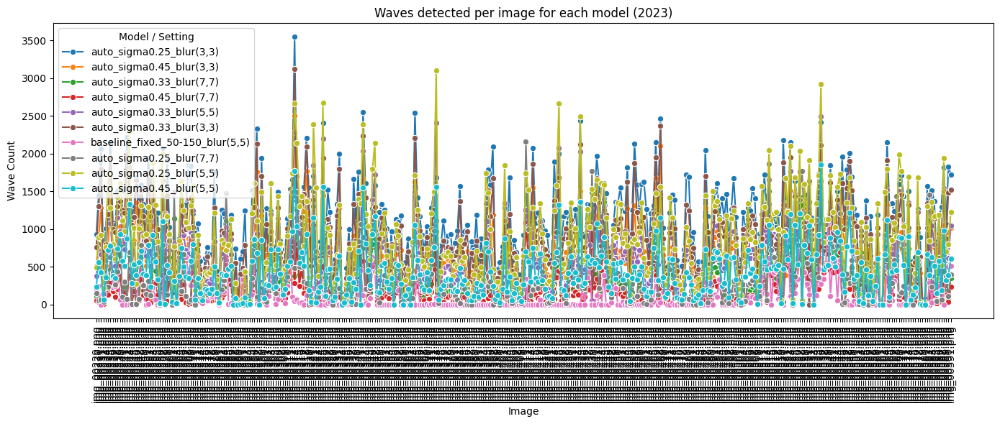

In [27]:
# -------------------- CHART 1 --------------------
plt.figure(figsize=(14,6))
sns.lineplot(
    data=all_df_period.sort_values("image_id"),
    x="image_id",
    y="wave_count",
    hue="setting",
    marker="o"
)
plt.xticks(rotation=90)
plt.title("Waves detected per image for each model (2023)")
plt.xlabel("Image")
plt.ylabel("Wave Count")
plt.legend(title="Model / Setting")
plt.tight_layout()
plt.savefig("CHART_1_wave_counts_2023.jpg", dpi=300)
plt.show()

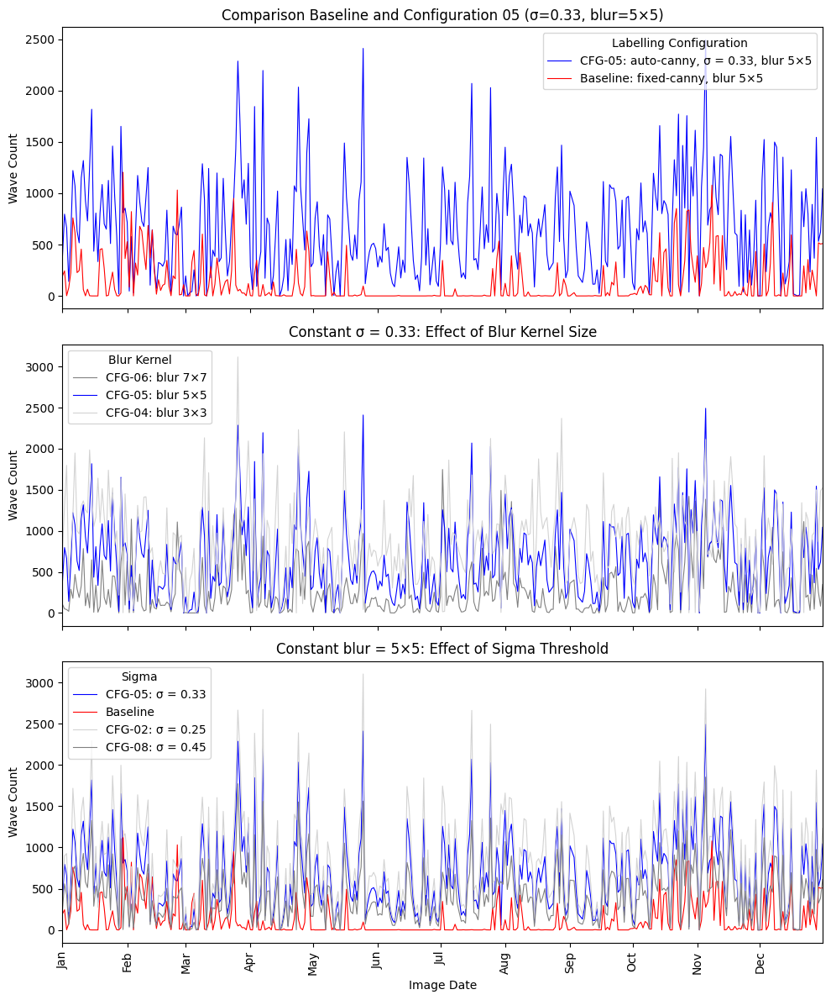

In [29]:
# -------------------- CHART 1 --------------------

# ------------------------------
# 0) Pick the column that holds model names
# ------------------------------
model_col = "setting" if "setting" in all_df_period.columns else "Model / Setting"

# ------------------------------
# 1) Parse sigma and blur safely
# ------------------------------
def parse_sigma(name):
    name = str(name)
    m = re.search(r"sigma([0-9.]+)", name)
    return m.group(1) if m else "fixed"

def parse_blur(name):
    name = str(name)
    m = re.search(r"blur\((\d+,\d+)\)", name)
    return f"({m.group(1)})" if m else "(5,5)"

all_df_period["sigma"] = all_df_period[model_col].apply(parse_sigma)
all_df_period["blur"]  = all_df_period[model_col].apply(parse_blur)

all_df_period["date"] = pd.to_datetime(
    all_df_period["date"],
    format="%Y-%m-%d",        
    errors="coerce"
)

df_sorted = all_df_period.sort_values("date")

# ------------------------------
# 2) Define key model names
# ------------------------------
baseline_model = "baseline_fixed_50-150_blur(5,5)"
selected_model = "auto_sigma0.33_blur(5,5)"

# nice names for those two models
model_nice_names = {
    baseline_model: "Baseline: fixed-canny, blur 5×5",
    selected_model: "CFG-05: auto-canny, σ = 0.33, blur 5×5",
}

# nice names for blur values
blur_nice_names = {
    "(3,3)": "CFG-04: blur 3×3",
    "(5,5)": "CFG-05: blur 5×5",
    "(7,7)": "CFG-06: blur 7×7",
}

# nice names for sigma values
sigma_nice_names = {
    "fixed": "Baseline",
    "0.25": "CFG-02: σ = 0.25",
    "0.33": "CFG-05: σ = 0.33",
    "0.45": "CFG-08: σ = 0.45",
}

# ------------------------------
# 3) Create 3 stacked plots
# ------------------------------
fig, axes = plt.subplots(3, 1, figsize=(10, 12), sharex=True)

# ======================================================
# Plot 1: Baseline (red) vs Selected (blue)
# ======================================================
ax = axes[0]
subset = df_sorted[df_sorted[model_col].isin([baseline_model, selected_model])]
palette = {baseline_model: "red", selected_model: "blue"}

sns.lineplot(
    data=subset,
    x="date",
    y="wave_count",
    hue=model_col,
    linewidth=0.8, 
    #alpha=0.9,
    #marker="o",
    #marker=False,
    palette=palette,
    ax=ax,
    markers=False
)
ax.set_title("Comparison Baseline and Configuration 05 (σ=0.33, blur=5×5)")
ax.set_ylabel("Wave Count")

# replace legend labels with nicer names
handles, labels = ax.get_legend_handles_labels()
new_labels = [model_nice_names.get(l, l) for l in labels]
ax.legend(handles, new_labels, title="Labelling Configuration")

# ======================================================
# Plot 2: SAME SIGMA (0.33), different blur kernels
# Colors: (5,5) = blue, others shades of grey
# ======================================================
ax = axes[1]
target_sigma = "0.33"
same_sigma_df = df_sorted[df_sorted["sigma"] == target_sigma]

unique_blurs = sorted(same_sigma_df["blur"].unique())

# assign colors manually
color_map_blur = {}
for blur in unique_blurs:
    if blur == "(5,5)":
        color_map_blur[blur] = "blue"
    else:
        # assign 2 green shades for the other blurs
        # dark green and light green
        if len(color_map_blur) == 0:  # first grey
            color_map_blur[blur] = "lightgrey"  # dark grey
        else:
            color_map_blur[blur] = "grey"  # light grey

sns.lineplot(
    data=same_sigma_df,
    x="date",
    y="wave_count",
    hue="blur",
    linewidth=0.8, 
    #alpha=0.9,
    #marker="o",
    palette=color_map_blur,
    ax=ax,
    #markers=False
)
ax.set_title("Constant σ = 0.33: Effect of Blur Kernel Size")
ax.set_ylabel("Wave Count")

handles, labels = ax.get_legend_handles_labels()
new_labels = [blur_nice_names.get(l, l) for l in labels]
ax.legend(handles, new_labels, title="Blur Kernel")

# ======================================================
# Plot 3: SAME BLUR (5×5), different sigmas
# Colors:
#   fixed  → red
#   0.33   → blue
#   others → grey and light grey
# ======================================================
ax = axes[2]
target_blur = "(5,5)"
same_blur_df = df_sorted[df_sorted["blur"] == target_blur]

unique_sigmas = sorted(same_blur_df["sigma"].unique())

color_map_sigma = {}
for sigma in unique_sigmas:
    if sigma == "fixed":
        color_map_sigma[sigma] = "red"
    elif sigma == "0.33":
        color_map_sigma[sigma] = "blue"
    else:
        # assign 2 green shades for the other blurs
        # dark green and light green
        if len(color_map_sigma) == 0:  # first green
            color_map_sigma[sigma] = "lightgrey"  # light grey
        else:
            color_map_sigma[sigma] = "grey"  # dark green

sns.lineplot(
    data=same_blur_df,
    x="date",
    y="wave_count",
    hue="sigma",
    linewidth=0.8, 
    #alpha=0.9,
    #marker="o",
    #marker=False,
    palette=color_map_sigma,
    ax=ax,

)
ax.set_title("Constant blur = 5×5: Effect of Sigma Threshold")
ax.set_xlabel("Image Date")
ax.set_ylabel("Wave Count")

handles, labels = ax.get_legend_handles_labels()
new_labels = [sigma_nice_names.get(l, l) for l in labels]
ax.legend(handles, new_labels, title="Sigma")

# After creating all three subplots:
for ax in axes:
    ax.set_xlim(df_sorted["date"].min(), df_sorted["date"].max())
    ax.xaxis.set_major_formatter(mdates.DateFormatter("%b"))

plt.xticks(rotation=90)
plt.tight_layout()
plt.savefig("CHART_1_wave_counts_grouped_3plots_2023_NEW.jpg", dpi=300)
plt.show()



In [30]:
# -------------------- CHART 5 --------------------
boxplot_nice_names = {
    "auto_sigma0.25_blur(3,3)": "CFG-01 (σ=0.25, 3×3)",
    "auto_sigma0.25_blur(5,5)": "CFG-02 (σ=0.25, 5×5)",
    "auto_sigma0.25_blur(7,7)": "CFG-03 (σ=0.25, 7×7)",
    "auto_sigma0.33_blur(3,3)": "CFG-04 (σ=0.33, 3×3)",
    "auto_sigma0.33_blur(5,5)": "CFG-05 (σ=0.33, 5×5)",
    "auto_sigma0.33_blur(7,7)": "CFG-06 (σ=0.33, 7×7)",
    "auto_sigma0.45_blur(3,3)": "CFG-07 (σ=0.45, 3×3)",
    "auto_sigma0.45_blur(5,5)": "CFG-08 (σ=0.45, 5×5)",
    "auto_sigma0.45_blur(7,7)": "CFG-09 (σ=0.45, 7×7)",
    "baseline_fixed_50-150_blur(5,5)": "Baseline (fixed-canny, 5×5)"
}

C:\Users\A\AppData\Local\Temp\ipykernel_19948\373872163.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([boxplot_nice_names.get(t.get_text(), t.get_text())


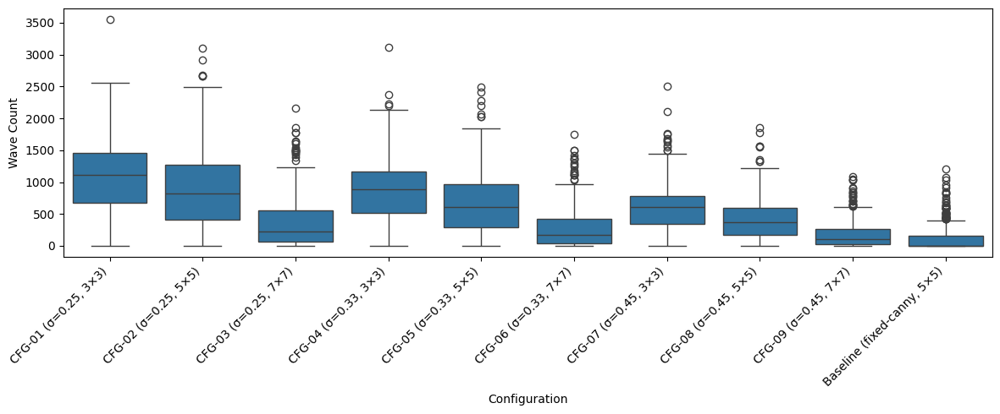

In [31]:
# -------------------- CHART 5 --------------------
plt.figure(figsize=(12,5))
ax = sns.boxplot(data=all_df_period, x="setting", y="wave_count")

# apply readable labels
ax.set_xticklabels([boxplot_nice_names.get(t.get_text(), t.get_text())
                    for t in ax.get_xticklabels()],
                   rotation=45, ha="right")

#plt.title("Distribution of Wave Counts per Labelling Configuration")
plt.ylabel("Wave Count")
plt.xlabel("Configuration")
plt.tight_layout()
plt.savefig('CHART_5_Boxplot_wave_counts_per_model_NEW.jpg', dpi=300)
plt.show()

In [146]:
# -------------------- CHART 6 --------------------
# Expand wave heights into a long-format table
wave_height_df = all_df_period.explode("wave_heights_list")

# Convert to numeric, drop missing
wave_height_df["wave_heights_list"] = pd.to_numeric(
    wave_height_df["wave_heights_list"], errors="coerce"
)
wave_height_df = wave_height_df.dropna(subset=["wave_heights_list"])

C:\Users\A\AppData\Local\Temp\ipykernel_21720\624391405.py:11: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([boxplot_nice_names.get(t.get_text(), t.get_text())


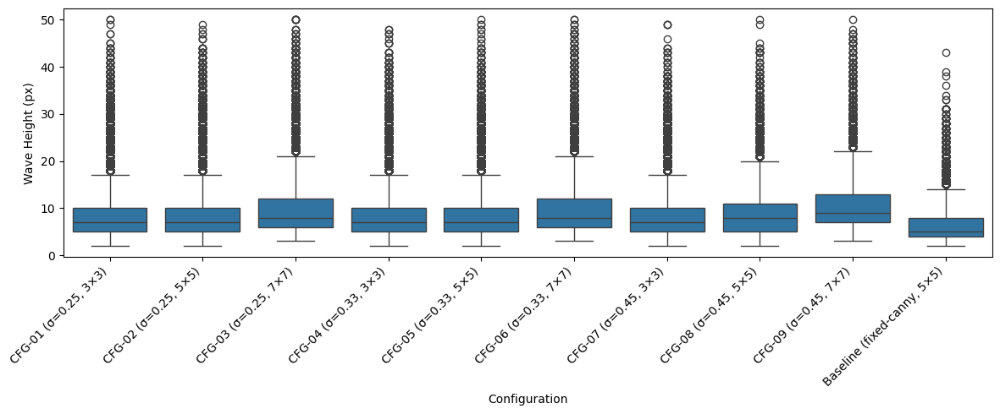

In [149]:
# -------------------- CHART 6 --------------------
plt.figure(figsize=(12, 5))
ax=sns.boxplot(
    data=wave_height_df,
    x="setting",
    y="wave_heights_list",
    showfliers=True,  # important to visualize outliers!
)

# apply readable labels
ax.set_xticklabels([boxplot_nice_names.get(t.get_text(), t.get_text())
                    for t in ax.get_xticklabels()],
                   rotation=45, ha="right")

#plt.title("Boxplot of Wave Heights per Model")
plt.xlabel("Configuration")
plt.ylabel("Wave Height (px)")
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('CHART_6_wave_height_boxplot_2023_NEW.jpg', dpi=300)
plt.show()

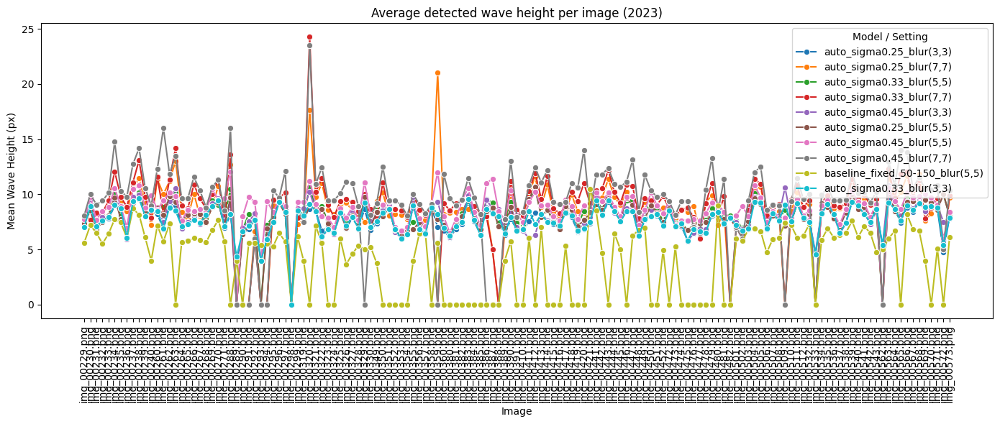

In [90]:
# -------------------- CHART 2 --------------------
plt.figure(figsize=(14,6))
sns.lineplot(
    data=all_df_period.sort_values("image_id"),
    x="image_id",
    y="mean_wave_height",
    hue="setting",
    marker="o"
)
plt.xticks(rotation=90)
plt.title("Average detected wave height per image (2023)")
plt.xlabel("Image")
plt.ylabel("Mean Wave Height (px)")
plt.legend(title="Model / Setting")
plt.tight_layout()
plt.savefig("CHART_2_mean_wave_height_2023.jpg", dpi=300)
plt.show()

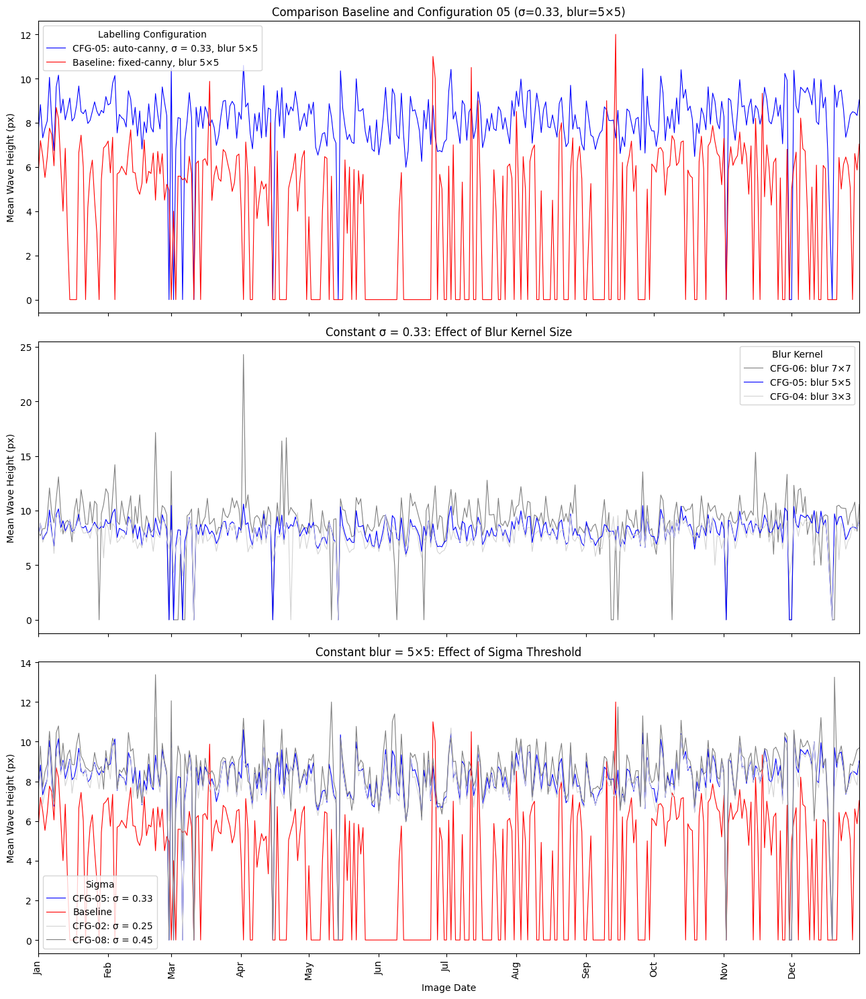

In [142]:
# -------------------- CHART 2 --------------------

import re
import matplotlib.pyplot as plt
import seaborn as sns

# ------------------------------
# 0) Pick the column that holds model names
# ------------------------------
model_col = "setting" if "setting" in all_df_period.columns else "Model / Setting"

# ------------------------------
# 1) Parse sigma and blur safely (re-run safe)
# ------------------------------
def parse_sigma(name):
    name = str(name)
    m = re.search(r"sigma([0-9.]+)", name)
    return m.group(1) if m else "fixed"

def parse_blur(name):
    name = str(name)
    m = re.search(r"blur\((\d+,\d+)\)", name)
    return f"({m.group(1)})" if m else "(5,5)"

all_df_period["sigma"] = all_df_period[model_col].apply(parse_sigma)
all_df_period["blur"]  = all_df_period[model_col].apply(parse_blur)

all_df_period["date"] = pd.to_datetime(
    all_df_period["date"],
    format="%Y-%m-%d",        
    errors="coerce"
)

df_sorted = all_df_period.sort_values("date")

# ------------------------------
# 2) Define key model names
# ------------------------------
baseline_model = "baseline_fixed_50-150_blur(5,5)"
selected_model = "auto_sigma0.33_blur(5,5)"

# nice names for those two models
model_nice_names = {
    baseline_model: "Baseline: fixed-canny, blur 5×5",
    selected_model: "CFG-05: auto-canny, σ = 0.33, blur 5×5",
}

# nice names for blur values
blur_nice_names = {
    "(3,3)": "CFG-04: blur 3×3",
    "(5,5)": "CFG-05: blur 5×5",
    "(7,7)": "CFG-06: blur 7×7",
}

# nice names for sigma values
sigma_nice_names = {
    "fixed": "Baseline",
    "0.25": "CFG-02: σ = 0.25",
    "0.33": "CFG-05: σ = 0.33",
    "0.45": "CFG-08: σ = 0.45",
}


# ------------------------------
# 3) Create 3 stacked plots for CHART 2 (Mean Wave Height)
# ------------------------------
fig, axes = plt.subplots(3, 1, figsize=(13, 15), sharex=True)

# ======================================================
# Plot 1: Baseline (red) vs Selected (blue)
# ======================================================
ax = axes[0]
subset = df_sorted[df_sorted[model_col].isin([baseline_model, selected_model])]
palette = {baseline_model: "red", selected_model: "blue"}

sns.lineplot(
    data=subset,
    x="date",
    y="mean_wave_height",
    hue=model_col,
    linewidth=0.8, 
    #marker="o",
    palette=palette,
    ax=ax
)
ax.set_title("Comparison Baseline and Configuration 05 (σ=0.33, blur=5×5)")
ax.set_ylabel("Mean Wave Height (px)")

# replace legend labels with nicer names
handles, labels = ax.get_legend_handles_labels()
new_labels = [model_nice_names.get(l, l) for l in labels]
ax.legend(handles, new_labels, title="Labelling Configuration")

# ======================================================
# Plot 2: SAME SIGMA (0.33), different blur kernels
# Colors: (5,5)=blue, others grey/lightgrey
# ======================================================
ax = axes[1]
target_sigma = "0.33"
same_sigma_df = df_sorted[df_sorted["sigma"] == target_sigma]

unique_blurs = sorted(same_sigma_df["blur"].unique())

color_map_blur = {}
for blur in unique_blurs:
    if blur == "(5,5)":
        color_map_blur[blur] = "blue"
    else:
        if blur > "(5,5)":
            color_map_blur[blur] = "grey"
        else: 
            color_map_blur[blur] = "lightgrey"
        # two grey shades for other blurs
        #if "lightgrey" not in color_map_sigma.values():
            #color_map_sigma[sigma] = "grey"
        #else:
            #color_map_blur[blur] = "grey"

sns.lineplot(
    data=same_sigma_df,
    x="date",
    y="mean_wave_height",
    hue="blur",
    linewidth=0.8, 
    #marker="o",
    palette=color_map_blur,
    ax=ax
)
ax.set_title("Constant σ = 0.33: Effect of Blur Kernel Size")
ax.set_ylabel("Mean Wave Height (px)")

handles, labels = ax.get_legend_handles_labels()
new_labels = [blur_nice_names.get(l, l) for l in labels]
ax.legend(handles, new_labels, title="Blur Kernel")

# ======================================================
# Plot 3: SAME BLUR (5×5), different sigmas
# Colors: fixed=red, 0.33=blue, others grey/lightgrey
# ======================================================
ax = axes[2]
target_blur = "(5,5)"
same_blur_df = df_sorted[df_sorted["blur"] == target_blur]

unique_sigmas = sorted(same_blur_df["sigma"].unique())

color_map_sigma = {}
for sigma in unique_sigmas:
    if sigma == "fixed":
        color_map_sigma[sigma] = "red"
    elif sigma == "0.33":
        color_map_sigma[sigma] = "blue"
    else:
        if sigma > "0.33":
            color_map_sigma[sigma] = "grey"
        else:
            color_map_sigma[sigma] = "lightgrey"

sns.lineplot(
    data=same_blur_df,
    x="date",
    y="mean_wave_height",
    hue="sigma",
    linewidth=0.8, 
    #marker="o",
    palette=color_map_sigma,
    ax=ax
)

ax.set_title("Constant blur = 5×5: Effect of Sigma Threshold")
ax.set_xlabel("Image Date")
ax.set_ylabel("Mean Wave Height (px)")

handles, labels = ax.get_legend_handles_labels()
new_labels = [sigma_nice_names.get(l, l) for l in labels]
ax.legend(handles, new_labels, title="Sigma")

# After creating all three subplots:
for ax in axes:
    ax.set_xlim(df_sorted["date"].min(), df_sorted["date"].max())
    ax.xaxis.set_major_formatter(mdates.DateFormatter("%b"))

# Final layout + save
plt.xticks(rotation=90)
plt.tight_layout()
plt.savefig("CHART_2_mean_wave_height_grouped_3plots_2023_NEW.jpg", dpi=300)
plt.show()


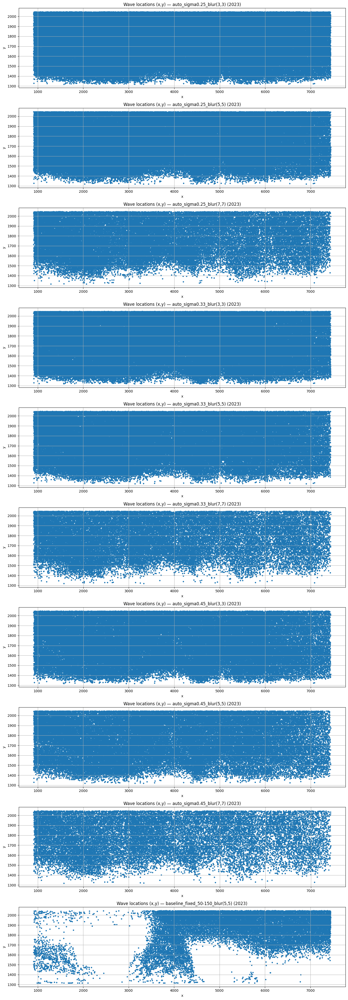

In [91]:
# -------------------- CHART 3 --------------------
n = len(unique_settings)
plt.figure(figsize=(14, 4*n))

for i, setting in enumerate(unique_settings, 1):
    subset = all_df_period[all_df_period["setting"] == setting]
    xs = np.concatenate(subset["wave_x_list"].values) if len(subset) else []
    ys = np.concatenate(subset["wave_y_list"].values) if len(subset) else []

    plt.subplot(n, 1, i)
    plt.scatter(xs, ys, s=8)
    plt.title(f"Wave locations (x,y) — {setting} (2023)")
    plt.xlabel("x")
    plt.ylabel("y")
    plt.grid(True)

plt.tight_layout()
plt.savefig("CHART_3_wave_centers_2023.jpg", dpi=300)
plt.show()


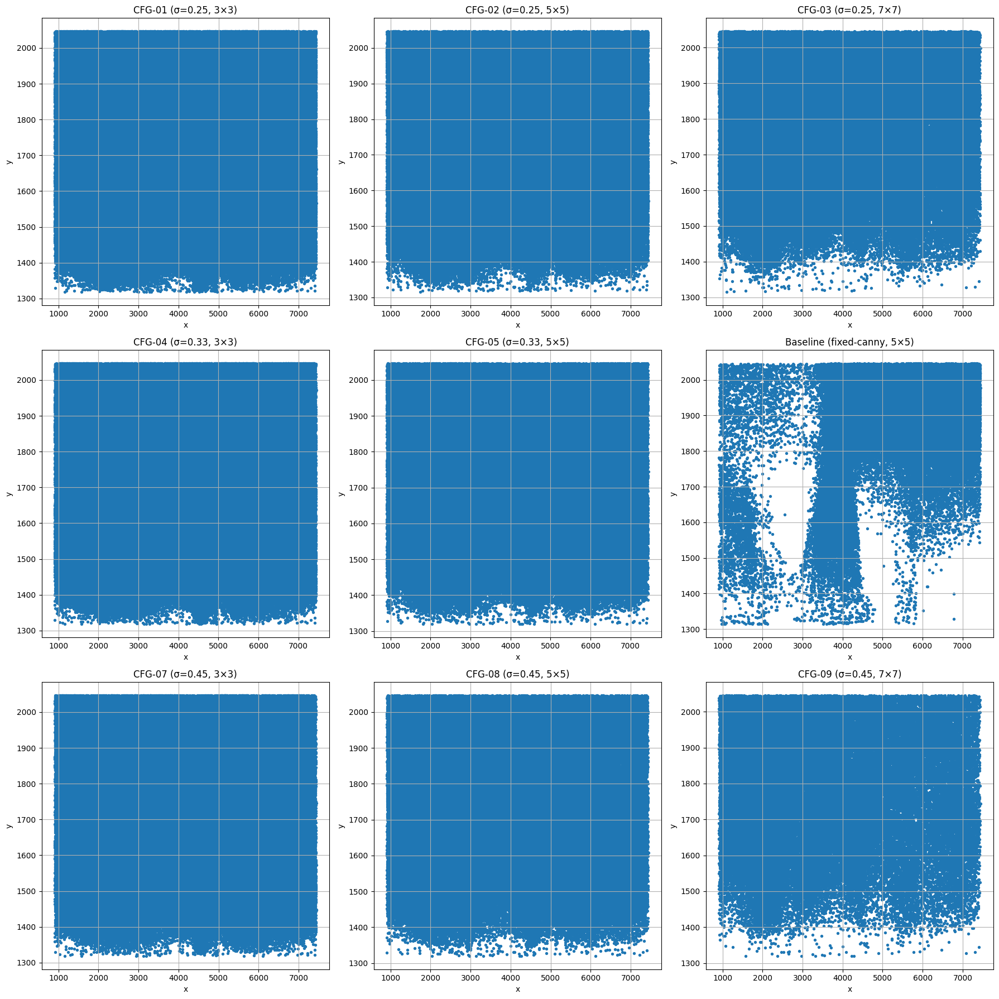

In [151]:
# -------------------- CHART 3 --------------------

import matplotlib.pyplot as plt
import numpy as np

# Define the order for the 3x3 matrix
models_025 = [
    "auto_sigma0.25_blur(3,3)",
    "auto_sigma0.25_blur(5,5)",
    "auto_sigma0.25_blur(7,7)"
]

models_033 = [
    "auto_sigma0.33_blur(3,3)",
    "auto_sigma0.33_blur(5,5)",
    "auto_sigma0.33_blur(7,7)"
]

models_045 = [
    "auto_sigma0.45_blur(3,3)",
    "auto_sigma0.45_blur(5,5)",
    "auto_sigma0.45_blur(7,7)"
]

baseline_model = "baseline_fixed_50-150_blur(5,5)"

# Insert baseline in place of the last sigma=0.33 blur model
models_033[2] = baseline_model

# Combine into the 3 rows of the 3x3 grid
grid_models = [models_025, models_033, models_045]

# --- Plotting ---
fig, axes = plt.subplots(3, 3, figsize=(18, 18))

for row in range(3):
    for col in range(3):
        ax = axes[row, col]
        model_name = grid_models[row][col]

        subset = all_df_period[all_df_period["setting"] == model_name]

        xs = np.concatenate(subset["wave_x_list"].values) if len(subset) else []
        ys = np.concatenate(subset["wave_y_list"].values) if len(subset) else []

        ax.scatter(xs, ys, s=8)

        # ---- USE NICE NAME HERE ----
        nice_title = boxplot_nice_names.get(model_name, model_name)
        ax.set_title(nice_title)

        ax.set_xlabel("x")
        ax.set_ylabel("y")
        ax.grid(True)

plt.tight_layout()
plt.savefig("CHART_3_wave_centers_3x3_grid_2023_NEW.jpg", dpi=300)
plt.show()

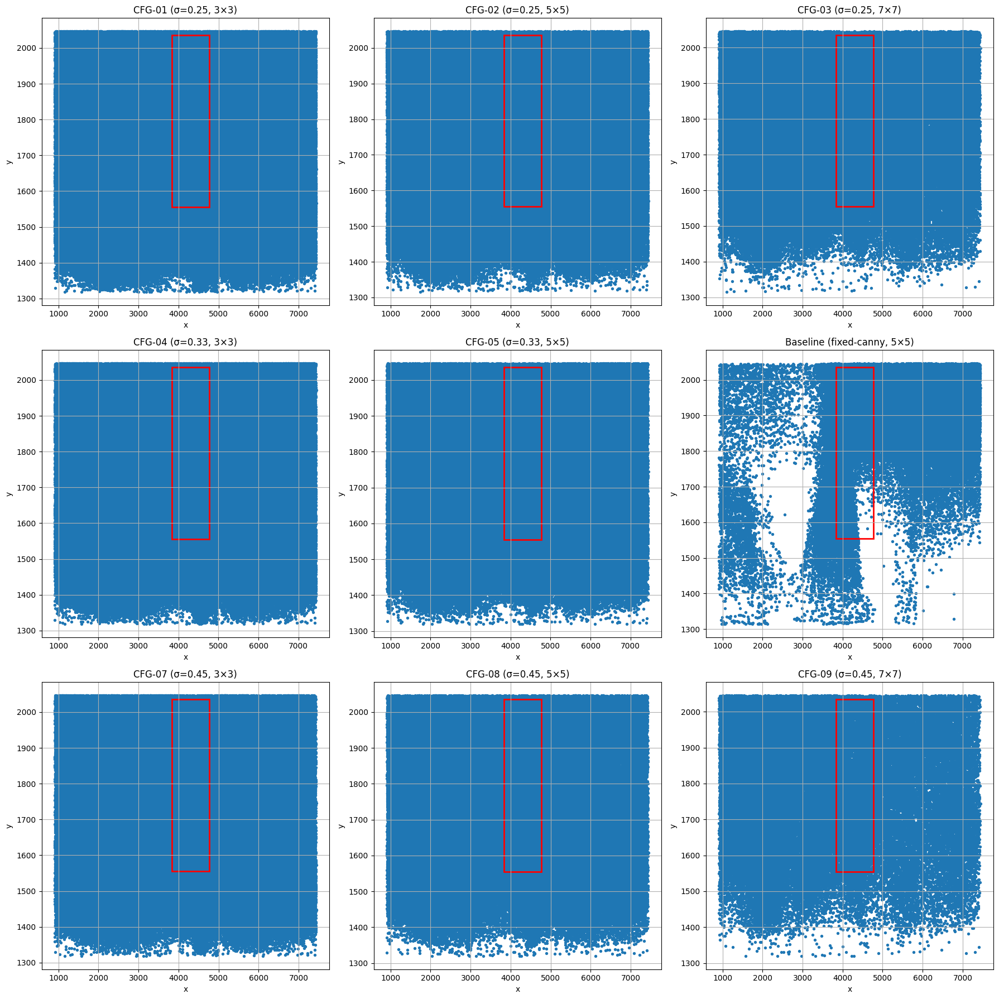

In [153]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as patches

# Define pixel-area rectangle
rect_x0, rect_x1 = 3837, 4767
rect_y0, rect_y1 = 1555, 2035
rect_width  = rect_x1 - rect_x0
rect_height = rect_y1 - rect_y0

# Define the order for the 3x3 matrix
models_025 = [
    "auto_sigma0.25_blur(3,3)",
    "auto_sigma0.25_blur(5,5)",
    "auto_sigma0.25_blur(7,7)"
]

models_033 = [
    "auto_sigma0.33_blur(3,3)",
    "auto_sigma0.33_blur(5,5)",
    "auto_sigma0.33_blur(7,7)"
]

models_045 = [
    "auto_sigma0.45_blur(3,3)",
    "auto_sigma0.45_blur(5,5)",
    "auto_sigma0.45_blur(7,7)"
]

baseline_model = "baseline_fixed_50-150_blur(5,5)"

# Replace last of sigma 0.33 group with baseline model
models_033[2] = baseline_model

# Combine into 3 rows of 3 columns
grid_models = [models_025, models_033, models_045]

# --- Plotting ---
fig, axes = plt.subplots(3, 3, figsize=(18, 18))

for row in range(3):
    for col in range(3):
        ax = axes[row, col]
        model_name = grid_models[row][col]

        subset = all_df_period[all_df_period["setting"] == model_name]

        xs = np.concatenate(subset["wave_x_list"].values) if len(subset) else []
        ys = np.concatenate(subset["wave_y_list"].values) if len(subset) else []

        # scatter plot of wave centers
        ax.scatter(xs, ys, s=8)

        # --- use nice config name for the title ---
        nice_title = boxplot_nice_names.get(model_name, model_name)
        ax.set_title(nice_title)

        ax.set_xlabel("x")
        ax.set_ylabel("y")
        ax.grid(True)

        # --- Add red rectangle overlay ---
        rect = patches.Rectangle(
            (rect_x0, rect_y0),     # lower-left corner
            rect_width,
            rect_height,
            linewidth=2,
            edgecolor='red',
            facecolor='none'
        )
        ax.add_patch(rect)

plt.tight_layout()
plt.savefig("CHART_3_wave_centers_3x3_grid_with_rectangle_2023_NEW.jpg", dpi=300)
plt.show()

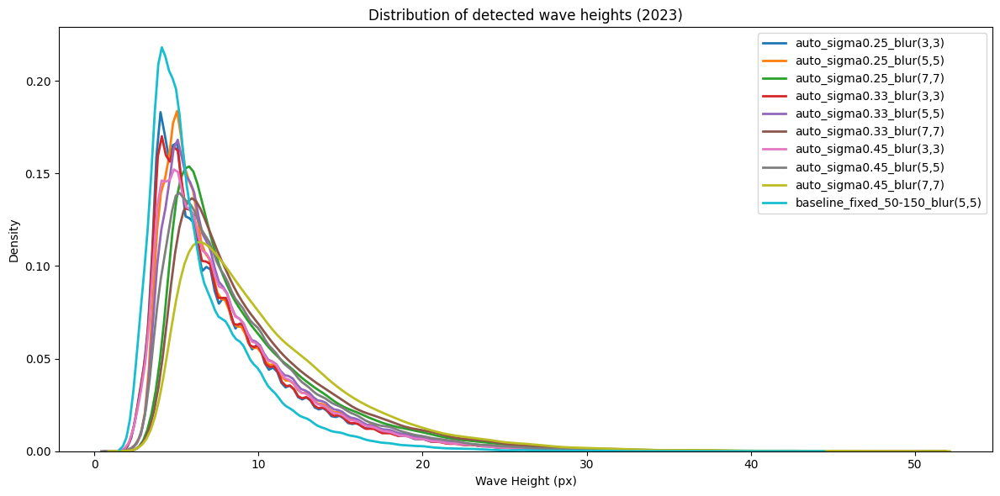

In [92]:
# -------------------- CHART 4 --------------------
plt.figure(figsize=(12,6))
for setting in unique_settings:
    subset = all_df_period[all_df_period["setting"] == setting]
    heights = np.concatenate(subset["wave_heights_list"].values) if len(subset) else []
    if len(heights):
        sns.kdeplot(heights, label=setting, linewidth=2)

plt.title("Distribution of detected wave heights (2023)")
plt.xlabel("Wave Height (px)")
plt.ylabel("Density")
plt.legend()
plt.tight_layout()
plt.savefig("CHART_4_wave_height_kde_2023.jpg", dpi=300)
plt.show()


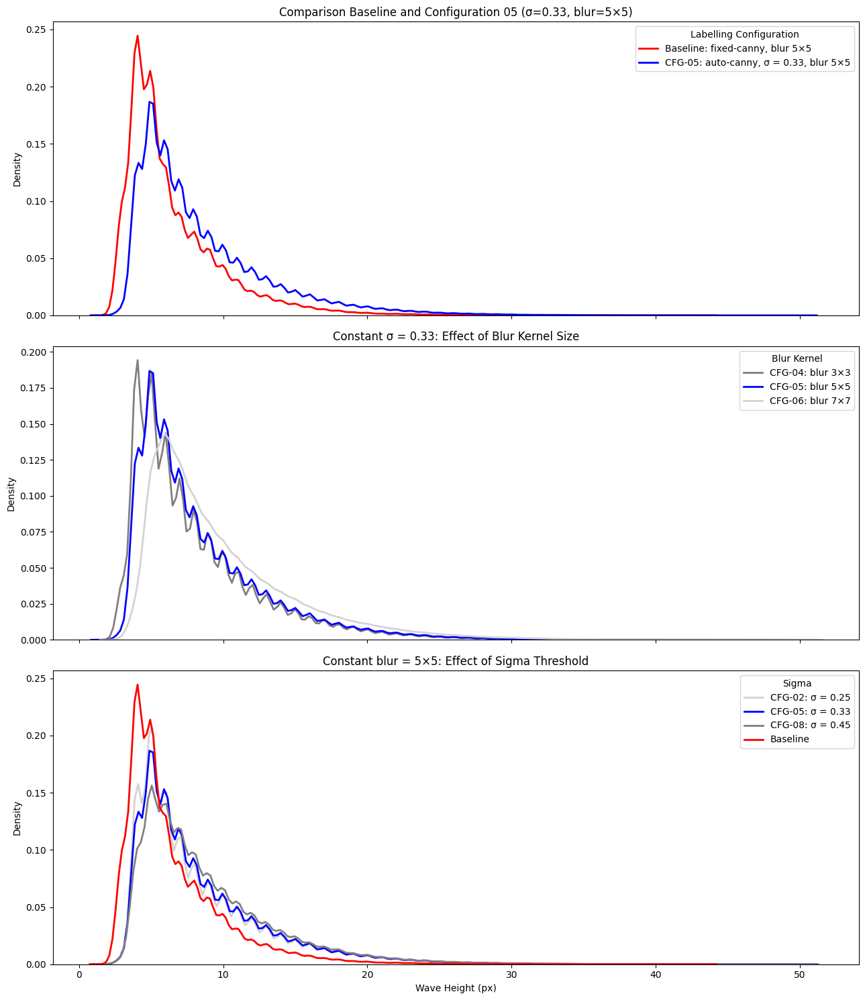

In [159]:
# -------------------- CHART 4 --------------------

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re

# ------------------------------
# 0) Choose model name column
# ------------------------------
model_col = "setting" if "setting" in all_df_period.columns else "Model / Setting"

# ------------------------------
# 1) Parse sigma + blur
# ------------------------------
def parse_sigma(name):
    name = str(name)
    m = re.search(r"sigma([0-9.]+)", name)
    return m.group(1) if m else "fixed"

def parse_blur(name):
    name = str(name)
    m = re.search(r"blur\((\d+,\d+)\)", name)
    return f"({m.group(1)})" if m else "(5,5)"

all_df_period["sigma"] = all_df_period[model_col].apply(parse_sigma)
all_df_period["blur"]  = all_df_period[model_col].apply(parse_blur)

# ------------------------------
# 2) Define key models
# ------------------------------
baseline_model = "baseline_fixed_50-150_blur(5,5)"
selected_model = "auto_sigma0.33_blur(5,5)"

# nice names for those two models
model_nice_names = {
    baseline_model: "Baseline: fixed-canny, blur 5×5",
    selected_model: "CFG-05: auto-canny, σ = 0.33, blur 5×5",
}

# nice names for blur values  (keys are just the blur strings!)
blur_nice_names = {
    "(3,3)": "CFG-04: blur 3×3",
    "(5,5)": "CFG-05: blur 5×5",
    "(7,7)": "CFG-06: blur 7×7",
}

# nice names for sigma values (keys are just the sigma strings!)
sigma_nice_names = {
    "fixed": "Baseline",
    "0.25": "CFG-02: σ = 0.25",
    "0.33": "CFG-05: σ = 0.33",
    "0.45": "CFG-08: σ = 0.45",
}

# ------------------------------
# 3) Prepare figure with 3 stacked KDE plots
# ------------------------------
fig, axes = plt.subplots(3, 1, figsize=(13, 15), sharex=True)

# ============================================================
# Plot 1: Baseline (red) vs Selected (blue)
# ============================================================
ax = axes[0]
palette = {baseline_model: "red", selected_model: "blue"}

for model in [baseline_model, selected_model]:
    subset = all_df_period[all_df_period[model_col] == model]
    heights = np.concatenate(subset["wave_heights_list"].values) if len(subset) else []
    if len(heights):
        sns.kdeplot(
            heights,
            label=model,                      # label = raw setting name
            linewidth=2,
            color=palette[model],
            ax=ax
        )

ax.set_ylabel("Density")
ax.set_title("Comparison Baseline and Configuration 05 (σ=0.33, blur=5×5)")

# replace legend labels with nicer names
handles, labels = ax.get_legend_handles_labels()
new_labels = [model_nice_names.get(l, l) for l in labels]
ax.legend(handles, new_labels, title="Labelling Configuration")

# ============================================================
# Plot 2: SAME SIGMA = 0.33, different blur kernels
# ============================================================
ax = axes[1]
target_sigma = "0.33"
same_sigma_df = all_df_period[all_df_period["sigma"] == target_sigma]
unique_blurs = sorted(same_sigma_df["blur"].unique())

# Assign colors
color_map_blur = {}
for blur in unique_blurs:
    if blur == "(5,5)":
        color_map_blur[blur] = "blue"
    else:
        if "grey" not in color_map_blur.values():
            color_map_blur[blur] = "grey"
        else:
            color_map_blur[blur] = "lightgrey"

for blur in unique_blurs:
    subset = same_sigma_df[same_sigma_df["blur"] == blur]
    heights = np.concatenate(subset["wave_heights_list"].values) if len(subset) else []
    if len(heights):
        sns.kdeplot(
            heights,
            label=blur,                      # <<< label is just "(3,3)", "(5,5)", ...
            linewidth=2,
            color=color_map_blur[blur],
            ax=ax
        )

ax.set_ylabel("Density")
ax.set_title("Constant σ = 0.33: Effect of Blur Kernel Size")

handles, labels = ax.get_legend_handles_labels()
new_labels = [blur_nice_names.get(l, l) for l in labels]
ax.legend(handles, new_labels, title="Blur Kernel")

# ============================================================
# Plot 3: SAME BLUR = (5,5), different sigmas
# ============================================================
ax = axes[2]
target_blur = "(5,5)"
same_blur_df = all_df_period[all_df_period["blur"] == target_blur]
unique_sigmas = sorted(same_blur_df["sigma"].unique())

color_map_sigma = {}
for sigma in unique_sigmas:
    if sigma == "fixed":
        color_map_sigma[sigma] = "red"
    elif sigma == "0.33":
        color_map_sigma[sigma] = "blue"
    else:
        if "grey" not in color_map_sigma.values() and "lightgrey" not in color_map_sigma.values():
            color_map_sigma[sigma] = "lightgrey"
        else:
            color_map_sigma[sigma] = "grey"

for sigma in unique_sigmas:
    subset = same_blur_df[same_blur_df["sigma"] == sigma]
    heights = np.concatenate(subset["wave_heights_list"].values) if len(subset) else []
    if len(heights):
        sns.kdeplot(
            heights,
            label=sigma,                     # <<< label is just "0.25", "0.33", "0.45" or "fixed"
            linewidth=2,
            color=color_map_sigma[sigma],
            ax=ax
        )

ax.set_xlabel("Wave Height (px)")
ax.set_ylabel("Density")
ax.set_title("Constant blur = 5×5: Effect of Sigma Threshold")

handles, labels = ax.get_legend_handles_labels()
new_labels = [sigma_nice_names.get(l, l) for l in labels]
ax.legend(handles, new_labels, title="Sigma")

plt.tight_layout()
plt.savefig("CHART_4_wave_height_kde_grouped_3plots_NEW.jpg", dpi=300)
plt.show()

### Selected parameters, final model for wave detection

Canny-autodetect  
Sigma = 0.33  
ksize blur = (5,5)  

Run the wve detection to all images, saving csv and detected lables - but not saving the annotated images due to saving storage place. 


In [82]:
# Wave detection params
horizon_y = 1313             # below this line is the watersurface
x_min, x_max = 900, 7450     # between this parameters is only water no trees buildings, buoys or landline
min_wave_area = 15           # variable - encourage more detailed detection due to the high resolution of the image
max_wave_height = 50         # maximum wave height in px
min_aspect_ratio = 1.2       # defined based on nature of waves

max_aspect_ratio = 10.0      # reject extremely long boxes
max_wave_width   = 200       # reject very wide boxes
max_wave_area    = 300       # reject very large blobs

# Blur & Canny parameters
blur_ksize = (5, 5)
canny_low  = 50
canny_high = 150

sigma = 0.33                 # edge detection parameter

# --- RESUME SUPPORT ---
if os.path.exists(wavedetection_path):
    results_df = pd.read_csv(wavedetection_path)
    done_images = set(results_df['new_image_name'])
    results_list = results_df.to_dict('records')
    print(f"Resuming: {len(done_images)} images already in CSV.")
else:
    done_images = set()
    results_list = []

# Resume based on existing YOLO labels
done_labels = {f.replace(".txt", ".png") for f in os.listdir(detected_lables_folder)}

# --- MAIN LOOP ---
for idx, row in tqdm(wave_df.iterrows(), total=len(wave_df), desc="Processing images"):
    img_name = row['new_image_name']

    # Skip if already processed (in CSV or with existing label)
    if img_name in done_images or img_name in done_labels:
        continue

    img_path = os.path.join(source_folder, img_name)
    if not os.path.exists(img_path):
        print(f"Image not found: {img_path}")
        continue

    image = cv2.imread(img_path)
    if image is None:
        print(f"Failed to read: {img_path}")
        continue

    # Masking step: Compute median water color from a strip just below the horizon
    masked_image = image.copy()
    water_sample_strip = image[horizon_y+10:horizon_y+100, x_min:x_max]
    median_color = [int(np.median(water_sample_strip[:,:,i])) for i in range(3)]

    # YOLO MASK
    results = yolo_model(img_path)
    for box in results[0].boxes:
        cls = int(box.cls)
        xyxy = box.xyxy.cpu().numpy().astype(int)[0]
        label = yolo_model.model.names[cls]
        if label in ['buoy','boat','SUP','ship','motorboat','rowing shell',
                     'swimmer','sailing boat','building','flag','tree']:
            x1, y1, x2, y2 = xyxy
            cv2.rectangle(masked_image, (x1, y1), (x2, y2), median_color, -1)

    # --- Wave detection ---
    gray = cv2.cvtColor(masked_image, cv2.COLOR_BGR2GRAY)
    
    # Restrict to water ROI
    roi_mask = np.zeros_like(gray)
    roi_mask[horizon_y:, x_min:x_max] = 255
    gray_roi = cv2.bitwise_and(gray, gray, mask=roi_mask)
    
    # 1) Local contrast enhancement (helps dark AND light waves)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    gray_roi_eq = clahe.apply(gray_roi)
    
    # 2) Blur to reduce noise
    blurred = cv2.GaussianBlur(gray_roi_eq, blur_ksize, 0)
    
    # 3) Adaptive Canny thresholds instead of fixed global ones
    roi_pixels = blurred[roi_mask == 255]
    v = np.median(roi_pixels) if roi_pixels.size > 0 else 128  # fallback
    
    auto_low = int(max(0, (1.0 - sigma) * v))
    auto_high = int(min(255, (1.0 + sigma) * v))
    
    # Use the adaptive thresholds:
    edges = cv2.Canny(blurred, auto_low, auto_high)
    # Or fixed thresholds:
    # edges = cv2.Canny(blurred, canny_low, canny_high)
    
    # Clean and find contours
    kernel = np.ones((3, 3), np.uint8)
    edges_cleaned = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
    contours, _ = cv2.findContours(edges_cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    wave_boxes = []
    wave_heights = []
    wave_centers_x = []
    wave_centers_y = []
    wave_count = 0

    for cnt in contours:
        area = cv2.contourArea(cnt)
        x, y, w, h = cv2.boundingRect(cnt)
        aspect_ratio = w / h if h > 0 else 0
        
        if area < min_wave_area:
            continue
        if area > max_wave_area:
            continue
        if h > max_wave_height:
            continue
        if w > max_wave_width:
            continue
        if aspect_ratio < min_aspect_ratio:
            continue
        if aspect_ratio > max_aspect_ratio:
            continue
        
        cx = x + w // 2
        cy = y + h // 2
        wave_heights.append(str(h))
        wave_centers_x.append(str(cx))
        wave_centers_y.append(str(cy))
        wave_count += 1

        # Just store boxes for labels; no drawing needed
        wave_boxes.append((x, y, w, h))
        
    # --- Save YOLO labels only ---
    label_path = os.path.join(detected_lables_folder, img_name.replace(".png", ".txt"))
    with open(label_path, "w") as f:
        for (x, y, w, h) in wave_boxes:
            x_center = (x + w / 2) / image.shape[1]
            y_center = (y + h / 2) / image.shape[0]
            w_norm = w / image.shape[1]
            h_norm = h / image.shape[0]
            f.write(f"0 {x_center} {y_center} {w_norm} {h_norm}\n")

    # --- Save all columns from original + wave detection to CSV ---
    result = dict(row)  # all original columns
    result.update({
        'wave_count': wave_count,
        'wave_heights_px': ",".join(wave_heights),
        'wave_locations_x': ",".join(wave_centers_x),
        'wave_locations_y': ",".join(wave_centers_y)
    })
    results_list.append(result)

    pd.DataFrame(results_list).to_csv(wavedetection_path, index=False)

print(f"Final wave detection results saved to: {wavedetection_path}")
print(f"YOLO labels saved in: {detected_lables_folder}")

Processing images:   0%|          | 0/27592 [00:00<?, ?it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00001.png: 160x640 (no detections), 39.9ms
Speed: 1.5ms preprocess, 39.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 1/27592 [00:00<4:30:58,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00002.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 2/27592 [00:01<3:58:59,  1.92it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00003.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 3/27592 [00:01<3:44:08,  2.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00004.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 4/27592 [00:01<3:39:46,  2.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00005.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 5/27592 [00:02<3:35:24,  2.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00006.png: 160x640 (no detections), 18.6ms
Speed: 1.0ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 6/27592 [00:02<3:29:04,  2.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00007.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 7/27592 [00:03<3:25:19,  2.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00008.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 8/27592 [00:03<3:28:26,  2.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00009.png: 160x640 (no detections), 24.4ms
Speed: 1.7ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 9/27592 [00:04<3:35:10,  2.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00010.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 10/27592 [00:04<3:34:37,  2.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00011.png: 160x640 1 person, 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 11/27592 [00:05<3:34:04,  2.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00012.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 12/27592 [00:05<3:33:23,  2.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00013.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 13/27592 [00:06<3:30:42,  2.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00014.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 14/27592 [00:06<3:31:06,  2.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00015.png: 160x640 1 person, 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 15/27592 [00:07<3:43:07,  2.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00016.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 16/27592 [00:07<3:36:43,  2.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00017.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 17/27592 [00:07<3:35:37,  2.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00018.png: 160x640 (no detections), 24.9ms
Speed: 1.5ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 18/27592 [00:08<3:40:46,  2.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00019.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 19/27592 [00:08<3:37:49,  2.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00020.png: 160x640 (no detections), 25.0ms
Speed: 1.7ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 20/27592 [00:09<3:35:08,  2.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00021.png: 160x640 (no detections), 26.6ms
Speed: 1.4ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 21/27592 [00:09<3:41:11,  2.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00022.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 22/27592 [00:10<3:40:09,  2.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00023.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 23/27592 [00:10<3:39:17,  2.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00024.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 24/27592 [00:11<3:39:27,  2.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00025.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 25/27592 [00:11<3:38:05,  2.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00026.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 26/27592 [00:12<3:42:45,  2.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00027.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 27/27592 [00:12<3:41:44,  2.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00028.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 28/27592 [00:13<3:40:49,  2.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00029.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 29/27592 [00:13<3:44:59,  2.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00030.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 30/27592 [00:14<3:57:15,  1.94it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00031.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 31/27592 [00:14<3:58:36,  1.93it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00032.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 32/27592 [00:15<3:54:26,  1.96it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00033.png: 160x640 (no detections), 23.3ms
Speed: 1.0ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 33/27592 [00:15<3:48:16,  2.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00034.png: 160x640 (no detections), 23.3ms
Speed: 1.0ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 34/27592 [00:16<3:42:49,  2.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00035.png: 160x640 (no detections), 22.4ms
Speed: 1.0ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 35/27592 [00:16<3:44:20,  2.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00036.png: 160x640 (no detections), 22.9ms
Speed: 1.0ms preprocess, 22.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 36/27592 [00:17<3:39:12,  2.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00037.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 37/27592 [00:17<3:39:32,  2.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00038.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 38/27592 [00:18<3:32:00,  2.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00039.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 39/27592 [00:18<3:29:05,  2.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00040.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 40/27592 [00:19<3:30:30,  2.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00041.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 41/27592 [00:19<3:30:59,  2.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00042.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 42/27592 [00:20<3:33:51,  2.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00043.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 43/27592 [00:20<3:34:51,  2.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00044.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 44/27592 [00:20<3:36:58,  2.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00045.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 45/27592 [00:21<3:34:17,  2.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00046.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 46/27592 [00:21<3:35:30,  2.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00047.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 47/27592 [00:22<3:42:43,  2.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00048.png: 160x640 (no detections), 33.0ms
Speed: 1.5ms preprocess, 33.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 48/27592 [00:23<3:59:40,  1.92it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00049.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 49/27592 [00:23<4:03:48,  1.88it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00050.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 50/27592 [00:24<4:02:25,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00051.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 51/27592 [00:24<4:07:35,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00052.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 52/27592 [00:25<4:06:03,  1.87it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00053.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 53/27592 [00:25<4:03:55,  1.88it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00054.png: 160x640 (no detections), 27.4ms
Speed: 1.2ms preprocess, 27.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 54/27592 [00:26<4:16:14,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00055.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 55/27592 [00:26<4:17:25,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00056.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 56/27592 [00:27<4:22:02,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00057.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 57/27592 [00:28<4:22:14,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00058.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 58/27592 [00:28<4:23:54,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00059.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 59/27592 [00:29<4:16:13,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00060.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 60/27592 [00:29<4:24:14,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00061.png: 160x640 (no detections), 30.4ms
Speed: 1.7ms preprocess, 30.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 61/27592 [00:30<4:35:44,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00062.png: 160x640 (no detections), 27.8ms
Speed: 1.7ms preprocess, 27.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 62/27592 [00:31<4:54:39,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00063.png: 160x640 (no detections), 39.6ms
Speed: 1.3ms preprocess, 39.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 63/27592 [00:31<5:12:52,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00064.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 64/27592 [00:32<5:01:30,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00065.png: 160x640 (no detections), 25.8ms
Speed: 1.1ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 65/27592 [00:33<4:59:24,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00066.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 66/27592 [00:33<4:45:39,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00067.png: 160x640 (no detections), 24.8ms
Speed: 1.6ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 67/27592 [00:34<4:40:27,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00068.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 68/27592 [00:34<4:33:41,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00069.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 69/27592 [00:35<4:20:55,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00070.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 70/27592 [00:35<4:19:22,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00071.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 71/27592 [00:36<4:16:56,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00072.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 72/27592 [00:37<4:12:50,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00073.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 73/27592 [00:37<4:13:46,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00074.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 74/27592 [00:38<4:11:49,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00075.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 75/27592 [00:38<4:08:13,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00076.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 76/27592 [00:39<4:10:36,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00077.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 77/27592 [00:39<4:08:45,  1.84it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00078.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 78/27592 [00:40<4:07:31,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00079.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 79/27592 [00:40<4:07:57,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00080.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 80/27592 [00:41<4:05:35,  1.87it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00081.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 81/27592 [00:41<4:06:54,  1.86it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00082.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 82/27592 [00:42<4:05:51,  1.86it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00083.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 83/27592 [00:43<4:14:37,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00084.png: 160x640 (no detections), 25.7ms
Speed: 1.2ms preprocess, 25.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 84/27592 [00:43<4:17:48,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00085.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 85/27592 [00:44<4:17:41,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00086.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 86/27592 [00:44<4:12:29,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00087.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 87/27592 [00:45<4:15:37,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00088.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 88/27592 [00:45<4:26:18,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00089.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 89/27592 [00:46<4:38:23,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00090.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 90/27592 [00:47<4:42:23,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00091.png: 160x640 (no detections), 28.0ms
Speed: 1.3ms preprocess, 28.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 91/27592 [00:47<4:45:11,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00092.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 92/27592 [00:48<4:44:20,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00093.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 93/27592 [00:49<4:43:19,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00094.png: 160x640 (no detections), 39.8ms
Speed: 1.9ms preprocess, 39.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 94/27592 [00:49<4:50:37,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00095.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 95/27592 [00:50<4:36:38,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00096.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 96/27592 [00:50<4:32:52,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00097.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 97/27592 [00:51<4:28:29,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00098.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 98/27592 [00:51<4:23:39,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00099.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 99/27592 [00:52<4:13:33,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00100.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 100/27592 [00:52<4:08:39,  1.84it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00101.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 101/27592 [00:53<4:07:20,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00102.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 102/27592 [00:54<4:03:58,  1.88it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00103.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 103/27592 [00:54<4:00:10,  1.91it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00104.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 104/27592 [00:55<4:00:53,  1.90it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00105.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 105/27592 [00:55<4:02:12,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00106.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 106/27592 [00:56<3:58:14,  1.92it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00107.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 107/27592 [00:56<3:59:07,  1.92it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00108.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 108/27592 [00:57<3:58:39,  1.92it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00109.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 109/27592 [00:57<3:57:59,  1.92it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00110.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 110/27592 [00:58<3:58:05,  1.92it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00111.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 111/27592 [00:58<3:54:20,  1.95it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00112.png: 160x640 (no detections), 20.8ms
Speed: 1.5ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 112/27592 [00:59<3:57:20,  1.93it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00113.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 113/27592 [00:59<4:03:53,  1.88it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00114.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 114/27592 [01:00<4:03:08,  1.88it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00115.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 115/27592 [01:00<4:02:25,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00116.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 116/27592 [01:01<4:10:30,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00117.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 117/27592 [01:02<4:29:51,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00118.png: 160x640 (no detections), 24.8ms
Speed: 1.5ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 118/27592 [01:02<4:48:22,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00119.png: 160x640 (no detections), 24.8ms
Speed: 1.3ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 119/27592 [01:03<4:50:01,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00120.png: 160x640 (no detections), 25.6ms
Speed: 1.3ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 120/27592 [01:04<4:51:17,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00121.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 121/27592 [01:04<4:42:42,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00122.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 122/27592 [01:05<4:52:50,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00123.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 123/27592 [01:05<4:47:57,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00124.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 124/27592 [01:06<4:42:12,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00125.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 125/27592 [01:07<4:27:56,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00126.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 126/27592 [01:07<4:27:21,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00127.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 127/27592 [01:08<4:24:14,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00128.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 128/27592 [01:08<4:20:00,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00129.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 129/27592 [01:09<4:16:35,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00130.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 130/27592 [01:09<4:20:25,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00131.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 131/27592 [01:10<4:19:55,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00132.png: 160x640 (no detections), 27.9ms
Speed: 1.1ms preprocess, 27.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 132/27592 [01:11<4:27:13,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00133.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 133/27592 [01:11<4:29:23,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00134.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 134/27592 [01:12<4:24:00,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00135.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 135/27592 [01:12<4:21:53,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00136.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 136/27592 [01:13<4:26:14,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00137.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   0%|          | 137/27592 [01:13<4:24:45,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00138.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 138/27592 [01:14<4:21:46,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00139.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 139/27592 [01:15<4:24:00,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00140.png: 160x640 (no detections), 24.6ms
Speed: 1.3ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 140/27592 [01:15<4:26:39,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00141.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 141/27592 [01:16<4:19:29,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00142.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 142/27592 [01:16<4:22:41,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00143.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 143/27592 [01:17<4:17:12,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00144.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 144/27592 [01:18<4:30:58,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00145.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 145/27592 [01:18<4:51:40,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00146.png: 160x640 (no detections), 25.1ms
Speed: 1.3ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 146/27592 [01:19<5:03:06,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00147.png: 160x640 (no detections), 26.6ms
Speed: 1.5ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 147/27592 [01:20<4:52:27,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00148.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 148/27592 [01:20<4:40:47,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00149.png: 160x640 (no detections), 31.0ms
Speed: 1.6ms preprocess, 31.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 149/27592 [01:21<4:39:59,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00150.png: 160x640 (no detections), 26.7ms
Speed: 1.6ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 150/27592 [01:21<4:37:49,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00151.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 151/27592 [01:22<4:24:34,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00152.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 152/27592 [01:22<4:21:01,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00153.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 153/27592 [01:23<4:12:49,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00154.png: 160x640 (no detections), 28.5ms
Speed: 1.3ms preprocess, 28.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 154/27592 [01:23<4:11:58,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00155.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 155/27592 [01:24<4:10:11,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00156.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 156/27592 [01:25<4:07:33,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00157.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 157/27592 [01:25<4:07:40,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00158.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 158/27592 [01:26<4:08:08,  1.84it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00159.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 159/27592 [01:26<4:08:19,  1.84it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00160.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 160/27592 [01:27<4:02:37,  1.88it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00161.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 161/27592 [01:27<3:59:52,  1.91it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00162.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 162/27592 [01:28<4:01:23,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00163.png: 160x640 (no detections), 18.6ms
Speed: 1.0ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 163/27592 [01:28<4:06:42,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00164.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 164/27592 [01:29<4:04:32,  1.87it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00165.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 165/27592 [01:29<4:02:20,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00166.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 166/27592 [01:30<4:02:15,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00167.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 167/27592 [01:30<4:03:33,  1.88it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00168.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 168/27592 [01:31<4:06:24,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00169.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 169/27592 [01:31<4:07:30,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00170.png: 160x640 (no detections), 24.3ms
Speed: 1.3ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 170/27592 [01:32<4:10:43,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00171.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 171/27592 [01:33<4:12:10,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00172.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 172/27592 [01:33<4:17:16,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00173.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 173/27592 [01:34<4:26:19,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00174.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 174/27592 [01:34<4:35:08,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00175.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 175/27592 [01:35<4:46:20,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00176.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 176/27592 [01:36<4:41:49,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00177.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 177/27592 [01:36<4:36:54,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00178.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 178/27592 [01:37<4:33:43,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00179.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 179/27592 [01:37<4:29:34,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00180.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 180/27592 [01:38<4:26:43,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00181.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 181/27592 [01:39<4:17:24,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00182.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 182/27592 [01:39<4:15:24,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00183.png: 160x640 (no detections), 32.7ms
Speed: 1.1ms preprocess, 32.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 183/27592 [01:40<4:18:08,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00184.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 184/27592 [01:40<4:14:48,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00185.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 185/27592 [01:41<4:09:30,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00186.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 186/27592 [01:41<4:09:50,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00187.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 187/27592 [01:42<4:09:00,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00188.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 188/27592 [01:42<4:10:36,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00189.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 189/27592 [01:43<4:14:33,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00190.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 190/27592 [01:44<4:09:40,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00191.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 191/27592 [01:44<4:13:25,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00192.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 192/27592 [01:45<4:17:10,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00193.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 193/27592 [01:45<4:17:54,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00194.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 194/27592 [01:46<4:11:11,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00195.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 195/27592 [01:46<4:17:16,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00196.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 196/27592 [01:47<4:18:37,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00197.png: 160x640 (no detections), 26.7ms
Speed: 1.1ms preprocess, 26.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 197/27592 [01:48<4:22:33,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00198.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 198/27592 [01:48<4:25:15,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00199.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 199/27592 [01:49<4:24:35,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00200.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 200/27592 [01:49<4:32:07,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00201.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 201/27592 [01:50<4:39:03,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00202.png: 160x640 (no detections), 25.1ms
Speed: 1.5ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 202/27592 [01:51<4:45:17,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00203.png: 160x640 (no detections), 25.0ms
Speed: 1.5ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 203/27592 [01:51<4:53:15,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00204.png: 160x640 (no detections), 30.6ms
Speed: 1.1ms preprocess, 30.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 204/27592 [01:52<4:43:58,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00205.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 205/27592 [01:53<4:42:53,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00206.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 206/27592 [01:53<4:28:05,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00207.png: 160x640 (no detections), 29.1ms
Speed: 1.2ms preprocess, 29.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 207/27592 [01:54<4:31:51,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00208.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 208/27592 [01:54<4:29:14,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00209.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 209/27592 [01:55<4:19:26,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00210.png: 160x640 (no detections), 18.6ms
Speed: 1.2ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 210/27592 [01:55<4:18:06,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00211.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 211/27592 [01:56<4:08:02,  1.84it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00212.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 212/27592 [01:56<4:08:55,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00213.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 213/27592 [01:57<4:12:33,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00214.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 214/27592 [01:57<4:11:34,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00215.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 215/27592 [01:58<4:12:47,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00216.png: 160x640 (no detections), 24.6ms
Speed: 1.3ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 216/27592 [01:59<4:09:26,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00217.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 217/27592 [01:59<4:05:55,  1.86it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00218.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 218/27592 [02:00<4:12:26,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00219.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 219/27592 [02:00<4:11:04,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00220.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 220/27592 [02:01<4:14:11,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00221.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 221/27592 [02:01<4:16:13,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00222.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 222/27592 [02:02<4:17:33,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00223.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 223/27592 [02:02<4:16:41,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00224.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 224/27592 [02:03<4:15:43,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00225.png: 160x640 (no detections), 29.1ms
Speed: 1.4ms preprocess, 29.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 225/27592 [02:04<4:21:33,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00226.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 226/27592 [02:04<4:23:26,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00227.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 227/27592 [02:05<4:24:17,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00228.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 228/27592 [02:05<4:34:20,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00229.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 229/27592 [02:06<4:41:31,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00230.png: 160x640 (no detections), 25.2ms
Speed: 1.4ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 230/27592 [02:07<4:56:14,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00231.png: 160x640 (no detections), 25.0ms
Speed: 1.3ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 231/27592 [02:07<4:46:19,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00232.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 232/27592 [02:08<4:37:23,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00233.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 233/27592 [02:09<4:36:03,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00234.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 234/27592 [02:09<4:28:25,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00235.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 235/27592 [02:10<4:24:30,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00236.png: 160x640 (no detections), 25.2ms
Speed: 1.4ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 236/27592 [02:10<4:18:33,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00237.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 237/27592 [02:11<4:15:18,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00238.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 238/27592 [02:11<4:17:11,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00239.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 239/27592 [02:12<4:15:41,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00240.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 240/27592 [02:12<4:12:23,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00241.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 241/27592 [02:13<4:14:29,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00242.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 242/27592 [02:14<4:14:12,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00243.png: 160x640 (no detections), 35.7ms
Speed: 1.3ms preprocess, 35.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 243/27592 [02:14<4:19:29,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00244.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 244/27592 [02:15<4:17:58,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00245.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 245/27592 [02:15<4:21:42,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00246.png: 160x640 (no detections), 24.5ms
Speed: 1.0ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 246/27592 [02:16<4:18:10,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00247.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 247/27592 [02:16<4:20:42,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00248.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 248/27592 [02:17<4:23:18,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00249.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 249/27592 [02:18<4:23:17,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00250.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 250/27592 [02:18<4:24:14,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00251.png: 160x640 (no detections), 31.0ms
Speed: 1.4ms preprocess, 31.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 251/27592 [02:19<4:35:48,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00252.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 252/27592 [02:19<4:31:35,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00253.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 253/27592 [02:20<4:27:57,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00254.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 254/27592 [02:21<4:23:41,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00255.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 255/27592 [02:21<4:25:49,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00256.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 256/27592 [02:22<4:31:21,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00257.png: 160x640 (no detections), 34.0ms
Speed: 1.5ms preprocess, 34.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 257/27592 [02:23<4:51:40,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00258.png: 160x640 (no detections), 27.7ms
Speed: 1.5ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 258/27592 [02:23<4:58:09,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00259.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 259/27592 [02:24<4:50:37,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00260.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 260/27592 [02:24<4:50:11,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00261.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 261/27592 [02:25<4:43:40,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00262.png: 160x640 (no detections), 26.4ms
Speed: 1.0ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 262/27592 [02:26<4:45:07,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00263.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 263/27592 [02:26<4:29:03,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00264.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 264/27592 [02:27<4:25:26,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00265.png: 160x640 (no detections), 26.9ms
Speed: 1.2ms preprocess, 26.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 265/27592 [02:27<4:34:12,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00266.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 266/27592 [02:28<4:28:08,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00267.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 267/27592 [02:28<4:20:41,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00268.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 268/27592 [02:29<4:15:35,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00269.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 269/27592 [02:30<4:14:22,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00270.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 270/27592 [02:30<4:19:37,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00271.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 271/27592 [02:31<4:13:34,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00272.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 272/27592 [02:31<4:09:29,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00273.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 273/27592 [02:32<4:07:03,  1.84it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00274.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 274/27592 [02:32<4:00:42,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00275.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 275/27592 [02:33<4:01:23,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00276.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 276/27592 [02:33<4:01:09,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00277.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 277/27592 [02:34<4:01:16,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00278.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 278/27592 [02:34<4:01:10,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00279.png: 160x640 (no detections), 22.7ms
Speed: 1.0ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 279/27592 [02:35<4:03:49,  1.87it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00280.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 280/27592 [02:35<4:01:49,  1.88it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00281.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 281/27592 [02:36<3:57:57,  1.91it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00282.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 282/27592 [02:36<3:59:06,  1.90it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00283.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 283/27592 [02:37<4:06:42,  1.84it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00284.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 284/27592 [02:38<4:28:26,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00285.png: 160x640 (no detections), 27.1ms
Speed: 1.4ms preprocess, 27.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 285/27592 [02:38<4:44:55,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00286.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 286/27592 [02:39<4:50:02,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00287.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 287/27592 [02:40<4:36:50,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00288.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 288/27592 [02:40<4:34:30,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00289.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 289/27592 [02:41<4:21:38,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00290.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 290/27592 [02:41<4:13:06,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00291.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 291/27592 [02:42<4:06:51,  1.84it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00292.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 292/27592 [02:42<4:02:04,  1.88it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00293.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 293/27592 [02:43<3:57:24,  1.92it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00294.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 294/27592 [02:43<3:55:02,  1.94it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00295.png: 160x640 (no detections), 17.9ms
Speed: 1.0ms preprocess, 17.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 295/27592 [02:44<3:57:55,  1.91it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00296.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 296/27592 [02:44<4:03:34,  1.87it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00297.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 297/27592 [02:45<4:04:16,  1.86it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00298.png: 160x640 1 bird, 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 298/27592 [02:45<3:56:13,  1.93it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00299.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 299/27592 [02:46<4:01:09,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00300.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 300/27592 [02:46<4:00:17,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00301.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 301/27592 [02:47<3:59:52,  1.90it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00302.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 302/27592 [02:48<4:00:02,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00303.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 303/27592 [02:48<4:07:08,  1.84it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00304.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 304/27592 [02:49<4:06:11,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00305.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 305/27592 [02:49<4:04:30,  1.86it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00306.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 306/27592 [02:50<4:06:32,  1.84it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00307.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 307/27592 [02:50<4:08:47,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00308.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 308/27592 [02:51<4:04:42,  1.86it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00309.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 309/27592 [02:51<4:04:41,  1.86it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00310.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 310/27592 [02:52<4:05:53,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00311.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 311/27592 [02:52<4:10:42,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00312.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 312/27592 [02:53<4:19:41,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00313.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 313/27592 [02:54<4:37:57,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00314.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 314/27592 [02:55<4:53:53,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00315.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 315/27592 [02:55<4:56:57,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00316.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 316/27592 [02:56<4:48:47,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00317.png: 160x640 (no detections), 23.2ms
Speed: 1.0ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 317/27592 [02:56<4:40:25,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00318.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 318/27592 [02:57<4:33:10,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00319.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 319/27592 [02:57<4:21:38,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00320.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 320/27592 [02:58<4:14:09,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00321.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 321/27592 [02:59<4:15:34,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00322.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 322/27592 [02:59<4:14:01,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00323.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 323/27592 [03:00<4:10:11,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00324.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 324/27592 [03:00<4:07:57,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00325.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 325/27592 [03:01<4:13:09,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00326.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 326/27592 [03:01<4:09:36,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00327.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 327/27592 [03:02<4:10:08,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00328.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 328/27592 [03:02<4:09:49,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00329.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 329/27592 [03:03<4:05:07,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00330.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 330/27592 [03:03<4:04:33,  1.86it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00331.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 331/27592 [03:04<4:06:43,  1.84it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00332.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 332/27592 [03:05<4:08:47,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00333.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 333/27592 [03:05<4:03:29,  1.87it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00334.png: 160x640 (no detections), 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 334/27592 [03:06<3:58:29,  1.90it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00335.png: 160x640 (no detections), 18.2ms
Speed: 1.0ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 335/27592 [03:06<3:58:53,  1.90it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00336.png: 160x640 1 person, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 336/27592 [03:07<4:02:44,  1.87it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00337.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 337/27592 [03:07<4:00:15,  1.89it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00338.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 338/27592 [03:08<4:02:52,  1.87it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00339.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 339/27592 [03:08<4:03:18,  1.87it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00340.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 340/27592 [03:09<4:10:17,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00341.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 341/27592 [03:10<4:35:28,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00342.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 342/27592 [03:10<4:51:07,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00343.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 343/27592 [03:11<4:48:08,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00344.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|          | 344/27592 [03:12<4:50:48,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00345.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 345/27592 [03:12<4:42:12,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00346.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 346/27592 [03:13<4:43:59,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00347.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 347/27592 [03:13<4:43:16,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00348.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 348/27592 [03:14<4:31:44,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00349.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 349/27592 [03:14<4:23:03,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00350.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 350/27592 [03:15<4:19:56,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00351.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 351/27592 [03:16<4:20:12,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00352.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 352/27592 [03:16<4:17:34,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00353.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 353/27592 [03:17<4:12:48,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00354.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 354/27592 [03:17<4:11:41,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00355.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 355/27592 [03:18<4:07:57,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00356.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 356/27592 [03:18<4:09:50,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00357.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 357/27592 [03:19<4:12:14,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00358.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 358/27592 [03:19<4:11:39,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00359.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 359/27592 [03:20<4:07:09,  1.84it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00360.png: 160x640 (no detections), 26.3ms
Speed: 1.3ms preprocess, 26.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 360/27592 [03:20<4:08:39,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00361.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 361/27592 [03:21<4:08:50,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00362.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 362/27592 [03:22<4:04:00,  1.86it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00363.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 363/27592 [03:22<4:09:42,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00364.png: 160x640 (no detections), 18.5ms
Speed: 1.0ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 364/27592 [03:23<4:11:55,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00365.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 365/27592 [03:23<4:14:01,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00366.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 366/27592 [03:24<4:12:11,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00367.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 367/27592 [03:24<4:09:32,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00368.png: 160x640 1 bird, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 368/27592 [03:25<4:09:56,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00369.png: 160x640 (no detections), 40.8ms
Speed: 1.4ms preprocess, 40.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 369/27592 [03:26<4:59:28,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00370.png: 160x640 (no detections), 483.8ms
Speed: 24.8ms preprocess, 483.8ms inference, 4.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 370/27592 [03:28<7:38:56,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00371.png: 160x640 (no detections), 30.1ms
Speed: 1.1ms preprocess, 30.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 371/27592 [03:28<7:07:58,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00372.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 372/27592 [03:29<6:33:21,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00373.png: 160x640 (no detections), 29.9ms
Speed: 1.4ms preprocess, 29.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 373/27592 [03:30<6:11:02,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00374.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 374/27592 [03:30<5:44:21,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00375.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 375/27592 [03:31<5:18:27,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00376.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 376/27592 [03:32<4:55:22,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00377.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 377/27592 [03:32<4:43:39,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00378.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 378/27592 [03:33<4:32:57,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00379.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 379/27592 [03:33<4:24:22,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00380.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 380/27592 [03:34<4:19:03,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00381.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 381/27592 [03:34<4:15:58,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00382.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 382/27592 [03:35<4:14:05,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00383.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 383/27592 [03:35<4:14:10,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00384.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 384/27592 [03:36<4:12:39,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00385.png: 160x640 (no detections), 20.6ms
Speed: 1.8ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 385/27592 [03:36<4:10:15,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00386.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 386/27592 [03:37<4:09:59,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00387.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 387/27592 [03:38<4:06:48,  1.84it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00388.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 388/27592 [03:38<4:12:17,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00389.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 389/27592 [03:39<4:14:15,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00390.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 390/27592 [03:39<4:17:53,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00391.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 391/27592 [03:40<4:18:24,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00392.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 392/27592 [03:40<4:18:38,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00393.png: 160x640 (no detections), 26.1ms
Speed: 1.3ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 393/27592 [03:41<4:34:00,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00394.png: 160x640 (no detections), 37.2ms
Speed: 1.6ms preprocess, 37.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 394/27592 [03:42<5:17:27,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00395.png: 160x640 (no detections), 27.4ms
Speed: 1.4ms preprocess, 27.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 395/27592 [03:43<5:29:40,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00396.png: 160x640 (no detections), 34.3ms
Speed: 1.4ms preprocess, 34.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 396/27592 [03:44<5:37:33,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00397.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 397/27592 [03:44<5:21:40,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00398.png: 160x640 (no detections), 36.3ms
Speed: 1.5ms preprocess, 36.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 398/27592 [03:45<5:09:12,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00399.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 399/27592 [03:45<4:52:40,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00400.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 400/27592 [03:46<4:38:26,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00401.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 401/27592 [03:47<4:27:43,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00402.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 402/27592 [03:47<4:25:54,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00403.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 403/27592 [03:48<4:19:13,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00404.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 404/27592 [03:48<4:16:51,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00405.png: 160x640 (no detections), 28.5ms
Speed: 1.5ms preprocess, 28.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 405/27592 [03:49<4:26:21,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00406.png: 160x640 (no detections), 31.5ms
Speed: 1.3ms preprocess, 31.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 406/27592 [03:49<4:34:11,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00407.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 407/27592 [03:50<4:24:33,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00408.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 408/27592 [03:51<4:30:32,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00409.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 409/27592 [03:51<4:29:40,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00410.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 410/27592 [03:52<4:27:28,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00411.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 411/27592 [03:52<4:30:57,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00412.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 412/27592 [03:53<4:29:56,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00413.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   1%|▏         | 413/27592 [03:54<4:24:05,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00414.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 414/27592 [03:54<4:20:32,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00415.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 415/27592 [03:55<4:28:06,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00416.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 416/27592 [03:55<4:25:32,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00417.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 417/27592 [03:56<4:22:27,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00418.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 418/27592 [03:57<4:30:03,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00419.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 419/27592 [03:57<4:37:24,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00420.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 420/27592 [03:58<4:45:42,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00421.png: 160x640 (no detections), 25.3ms
Speed: 1.5ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 421/27592 [03:59<4:59:24,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00422.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 422/27592 [03:59<5:07:05,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00423.png: 160x640 (no detections), 31.6ms
Speed: 1.2ms preprocess, 31.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 423/27592 [04:00<5:12:47,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00424.png: 160x640 (no detections), 30.9ms
Speed: 1.5ms preprocess, 30.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 424/27592 [04:01<5:15:24,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00425.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 425/27592 [04:01<5:07:51,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00426.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 426/27592 [04:02<4:54:44,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00427.png: 160x640 (no detections), 67.3ms
Speed: 1.6ms preprocess, 67.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 427/27592 [04:03<5:03:36,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00428.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 428/27592 [04:03<4:54:29,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00429.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 429/27592 [04:04<4:49:56,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00430.png: 160x640 (no detections), 26.9ms
Speed: 1.5ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 430/27592 [04:05<5:14:16,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00431.png: 160x640 (no detections), 51.6ms
Speed: 5.1ms preprocess, 51.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 431/27592 [04:06<5:38:14,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00432.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 432/27592 [04:06<5:18:49,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00433.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 433/27592 [04:07<5:01:50,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00434.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 434/27592 [04:07<5:02:17,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00435.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 435/27592 [04:08<5:07:35,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00436.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 436/27592 [04:09<5:01:20,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00437.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 437/27592 [04:09<4:52:05,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00438.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 438/27592 [04:10<4:40:56,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00439.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 439/27592 [04:11<4:34:19,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00440.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 440/27592 [04:11<4:32:33,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00441.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 441/27592 [04:12<4:26:43,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00442.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 442/27592 [04:12<4:27:01,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00443.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 443/27592 [04:13<4:28:32,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00444.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 444/27592 [04:14<4:46:46,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00445.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 445/27592 [04:14<5:03:29,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00446.png: 160x640 (no detections), 27.2ms
Speed: 1.4ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 446/27592 [04:15<5:11:21,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00447.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 447/27592 [04:16<4:57:41,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00448.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 448/27592 [04:16<4:52:43,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00449.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 449/27592 [04:17<4:42:45,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00450.png: 160x640 (no detections), 30.8ms
Speed: 1.5ms preprocess, 30.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 450/27592 [04:17<4:43:51,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00451.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 451/27592 [04:18<4:36:42,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00452.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 452/27592 [04:19<4:27:53,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00453.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 453/27592 [04:19<4:25:05,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00454.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 454/27592 [04:20<4:21:48,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00455.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 455/27592 [04:20<4:16:30,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00456.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 456/27592 [04:21<4:15:47,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00457.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 457/27592 [04:21<4:14:41,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00458.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 458/27592 [04:22<4:19:00,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00459.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 459/27592 [04:23<4:24:11,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00460.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 460/27592 [04:23<4:24:08,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00461.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 461/27592 [04:24<4:21:27,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00462.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 462/27592 [04:24<4:20:18,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00463.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 463/27592 [04:25<4:15:48,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00464.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 464/27592 [04:25<4:13:00,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00465.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 465/27592 [04:26<4:14:10,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00466.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 466/27592 [04:27<4:13:50,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00467.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 467/27592 [04:27<4:10:13,  1.81it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00468.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 468/27592 [04:28<4:10:38,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00469.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 469/27592 [04:28<4:08:07,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00470.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 470/27592 [04:29<4:06:25,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00471.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 471/27592 [04:29<4:18:20,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00472.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 472/27592 [04:30<4:44:48,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00473.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 473/27592 [04:31<4:59:50,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00474.png: 160x640 (no detections), 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 474/27592 [04:31<4:55:19,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00475.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 475/27592 [04:32<4:48:22,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00476.png: 160x640 (no detections), 25.0ms
Speed: 1.4ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 476/27592 [04:33<4:42:05,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00477.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 477/27592 [04:33<4:29:55,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00478.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 478/27592 [04:34<4:22:20,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00479.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 479/27592 [04:34<4:18:30,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00480.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 480/27592 [04:35<4:16:34,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00481.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 481/27592 [04:35<4:14:16,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00482.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 482/27592 [04:36<4:11:47,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00483.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 483/27592 [04:36<4:07:46,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00484.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 484/27592 [04:37<4:07:30,  1.83it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00485.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 485/27592 [04:38<4:04:20,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00486.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 486/27592 [04:38<4:04:47,  1.85it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00487.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 487/27592 [04:39<4:08:33,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00488.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 488/27592 [04:39<4:07:50,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00489.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 489/27592 [04:40<4:08:14,  1.82it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00490.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 490/27592 [04:40<4:12:55,  1.79it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00491.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 491/27592 [04:41<4:15:13,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00492.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 492/27592 [04:41<4:14:33,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00493.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 493/27592 [04:42<4:15:29,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00494.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 494/27592 [04:43<4:15:10,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00495.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 495/27592 [04:43<4:14:30,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00496.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 496/27592 [04:44<4:16:54,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00497.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 497/27592 [04:44<4:14:35,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00498.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 498/27592 [04:45<4:15:55,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00499.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 499/27592 [04:46<4:37:50,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00500.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 500/27592 [04:46<4:51:08,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00501.png: 160x640 (no detections), 25.8ms
Speed: 1.4ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 501/27592 [04:47<5:01:27,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00502.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 502/27592 [04:48<4:49:27,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00503.png: 160x640 (no detections), 30.1ms
Speed: 1.5ms preprocess, 30.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 503/27592 [04:48<4:52:10,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00504.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 504/27592 [04:49<4:43:54,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00505.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 505/27592 [04:49<4:36:32,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00506.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 506/27592 [04:50<4:30:30,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00507.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 507/27592 [04:51<4:27:40,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00508.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 508/27592 [04:51<4:26:07,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00509.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 509/27592 [04:52<4:20:57,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00510.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 510/27592 [04:52<4:18:31,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00511.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 511/27592 [04:53<4:20:56,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00512.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 512/27592 [04:53<4:22:05,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00513.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 513/27592 [04:54<4:22:11,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00514.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 514/27592 [04:55<4:28:25,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00515.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 515/27592 [04:55<4:27:12,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00516.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 516/27592 [04:56<4:27:09,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00517.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 517/27592 [04:56<4:24:28,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00518.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 518/27592 [04:57<4:24:59,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00519.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 519/27592 [04:58<4:18:45,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00520.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 520/27592 [04:58<4:18:59,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00521.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 521/27592 [04:59<4:24:27,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00522.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 522/27592 [04:59<4:32:20,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00523.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 523/27592 [05:00<4:32:43,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00524.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 524/27592 [05:01<4:23:02,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00525.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 525/27592 [05:01<4:35:04,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00526.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 526/27592 [05:02<4:56:13,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00527.png: 160x640 (no detections), 28.6ms
Speed: 1.4ms preprocess, 28.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 527/27592 [05:03<5:14:54,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00528.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 528/27592 [05:03<5:17:20,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00529.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 529/27592 [05:04<5:14:44,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00530.png: 160x640 (no detections), 24.6ms
Speed: 1.6ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 530/27592 [05:05<5:08:55,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00531.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 531/27592 [05:05<5:02:57,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00532.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 532/27592 [05:06<4:49:18,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00533.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 533/27592 [05:07<4:33:41,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00534.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 534/27592 [05:07<4:31:20,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00535.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 535/27592 [05:08<4:29:53,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00536.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 536/27592 [05:09<4:55:21,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00537.png: 160x640 (no detections), 367.8ms
Speed: 6.0ms preprocess, 367.8ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 537/27592 [05:10<6:13:08,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00538.png: 160x640 (no detections), 166.6ms
Speed: 3.4ms preprocess, 166.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 538/27592 [05:11<6:45:47,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00539.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 539/27592 [05:11<6:12:38,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00540.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 540/27592 [05:12<5:42:12,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00541.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 541/27592 [05:13<5:21:45,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00542.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 542/27592 [05:13<5:09:29,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00543.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 543/27592 [05:14<5:04:13,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00544.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 544/27592 [05:15<4:56:58,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00545.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 545/27592 [05:15<4:44:53,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00546.png: 160x640 (no detections), 57.2ms
Speed: 1.3ms preprocess, 57.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 546/27592 [05:16<5:33:37,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00547.png: 160x640 (no detections), 33.8ms
Speed: 1.6ms preprocess, 33.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 547/27592 [05:17<5:44:39,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00548.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 548/27592 [05:18<5:42:42,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00549.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 549/27592 [05:18<5:41:15,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00550.png: 160x640 (no detections), 26.5ms
Speed: 1.6ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 550/27592 [05:19<5:48:54,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00551.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 551/27592 [05:20<5:33:21,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00552.png: 160x640 (no detections), 38.4ms
Speed: 1.3ms preprocess, 38.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 552/27592 [05:21<5:28:22,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00553.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 553/27592 [05:21<5:19:21,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00554.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 554/27592 [05:22<4:57:54,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00555.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 555/27592 [05:22<4:46:07,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00556.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 556/27592 [05:23<4:36:51,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00557.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 557/27592 [05:24<4:32:19,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00558.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 558/27592 [05:24<4:25:43,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00559.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 559/27592 [05:25<4:22:46,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00560.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 560/27592 [05:25<4:22:59,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00561.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 561/27592 [05:26<4:18:27,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00562.png: 160x640 (no detections), 29.8ms
Speed: 1.3ms preprocess, 29.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 562/27592 [05:26<4:14:46,  1.77it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00563.png: 160x640 (no detections), 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 563/27592 [05:27<4:25:24,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00564.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 564/27592 [05:28<4:34:49,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00565.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 565/27592 [05:28<5:01:24,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00566.png: 160x640 (no detections), 26.7ms
Speed: 1.3ms preprocess, 26.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 566/27592 [05:29<5:08:13,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00567.png: 160x640 (no detections), 22.5ms
Speed: 1.6ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 567/27592 [05:30<5:01:49,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00568.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 568/27592 [05:30<4:56:48,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00569.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 569/27592 [05:31<4:49:31,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00570.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 570/27592 [05:32<4:43:00,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00571.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 571/27592 [05:32<4:42:23,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00572.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 572/27592 [05:33<4:41:29,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00573.png: 160x640 (no detections), 32.9ms
Speed: 1.4ms preprocess, 32.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 573/27592 [05:34<5:10:16,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00574.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 574/27592 [05:34<5:08:19,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00575.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 575/27592 [05:35<5:07:25,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00576.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 576/27592 [05:36<4:58:43,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00577.png: 160x640 (no detections), 25.2ms
Speed: 1.7ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 577/27592 [05:36<5:01:35,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00578.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 578/27592 [05:37<4:46:11,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00579.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 579/27592 [05:37<4:29:25,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00580.png: 160x640 1 airplane, 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 580/27592 [05:38<4:18:51,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00581.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 581/27592 [05:39<4:21:23,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00582.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 582/27592 [05:39<4:29:04,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00583.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 583/27592 [05:40<4:27:48,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00584.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 584/27592 [05:40<4:27:07,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00585.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 585/27592 [05:41<4:22:04,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00586.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 586/27592 [05:42<4:25:27,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00587.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 587/27592 [05:42<4:24:11,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00588.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 588/27592 [05:43<4:25:37,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00589.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 589/27592 [05:43<4:22:28,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00590.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 590/27592 [05:44<4:20:12,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00591.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 591/27592 [05:44<4:20:13,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00592.png: 160x640 (no detections), 23.1ms
Speed: 1.6ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 592/27592 [05:45<4:27:21,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00593.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 593/27592 [05:46<4:21:09,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00594.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 594/27592 [05:46<4:26:30,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00595.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 595/27592 [05:47<4:20:41,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00596.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 596/27592 [05:47<4:17:00,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00597.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 597/27592 [05:48<4:18:10,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00598.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 598/27592 [05:49<4:20:57,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00599.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 599/27592 [05:49<4:33:52,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00600.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 600/27592 [05:50<4:50:23,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00601.png: 160x640 (no detections), 25.2ms
Speed: 1.4ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 601/27592 [05:51<5:20:14,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00602.png: 160x640 (no detections), 27.0ms
Speed: 1.2ms preprocess, 27.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 602/27592 [05:51<5:12:39,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00603.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 603/27592 [05:52<4:57:20,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00604.png: 160x640 (no detections), 25.7ms
Speed: 1.5ms preprocess, 25.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 604/27592 [05:53<5:09:21,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00605.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 605/27592 [05:53<4:55:45,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00606.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 606/27592 [05:54<4:42:44,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00607.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 607/27592 [05:55<4:39:28,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00608.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 608/27592 [05:55<4:38:47,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00609.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 609/27592 [05:56<4:30:57,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00610.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 610/27592 [05:56<4:30:58,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00611.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 611/27592 [05:57<4:30:22,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00612.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 612/27592 [05:58<4:24:57,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00613.png: 640x160 (no detections), 33.1ms
Speed: 1.2ms preprocess, 33.1ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 160)


Processing images:   2%|▏         | 613/27592 [05:58<4:34:53,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00614.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 614/27592 [05:59<4:28:43,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00615.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 615/27592 [05:59<4:25:31,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00616.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 616/27592 [06:00<4:22:24,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00617.png: 160x640 (no detections), 19.6ms
Speed: 1.3ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 617/27592 [06:00<4:20:46,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00618.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 618/27592 [06:01<4:22:29,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00619.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 619/27592 [06:02<4:23:53,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00620.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 620/27592 [06:02<4:17:53,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00621.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 621/27592 [06:03<4:20:39,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00622.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 622/27592 [06:03<4:25:53,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00623.png: 160x640 (no detections), 22.4ms
Speed: 1.0ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 623/27592 [06:04<4:21:24,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00624.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 624/27592 [06:05<4:21:55,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00625.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 625/27592 [06:05<4:32:01,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00626.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 626/27592 [06:06<4:44:36,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00627.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 627/27592 [06:07<4:57:49,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00628.png: 160x640 (no detections), 26.2ms
Speed: 1.5ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 628/27592 [06:07<5:04:17,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00629.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 629/27592 [06:08<4:55:20,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00630.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 630/27592 [06:09<4:51:40,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00631.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 631/27592 [06:09<4:39:25,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00632.png: 160x640 (no detections), 390.6ms
Speed: 5.9ms preprocess, 390.6ms inference, 2.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 632/27592 [06:10<5:54:36,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00633.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 633/27592 [06:11<5:32:57,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00634.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 634/27592 [06:12<5:10:01,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00635.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 635/27592 [06:12<4:52:00,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00636.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 636/27592 [06:13<4:45:47,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00637.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 637/27592 [06:13<4:43:51,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00638.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 638/27592 [06:14<4:32:58,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00639.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 639/27592 [06:14<4:24:52,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00640.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 640/27592 [06:15<4:18:20,  1.74it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00641.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 641/27592 [06:15<4:14:35,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00642.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 642/27592 [06:16<4:15:24,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00643.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 643/27592 [06:17<4:12:19,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00644.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 644/27592 [06:17<4:12:12,  1.78it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00645.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 645/27592 [06:18<4:17:22,  1.75it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00646.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 646/27592 [06:18<4:20:10,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00647.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 647/27592 [06:19<4:20:01,  1.73it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00648.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 648/27592 [06:20<4:20:50,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00649.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 649/27592 [06:20<4:15:01,  1.76it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00650.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 650/27592 [06:21<4:09:56,  1.80it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00651.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 651/27592 [06:21<4:26:11,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00652.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 652/27592 [06:22<4:44:42,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00653.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 653/27592 [06:23<5:01:14,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00654.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 654/27592 [06:23<5:04:09,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00655.png: 160x640 1 person, 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 655/27592 [06:24<4:49:24,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00656.png: 160x640 (no detections), 25.3ms
Speed: 1.6ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 656/27592 [06:25<4:48:49,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00657.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 657/27592 [06:25<4:34:57,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00658.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 658/27592 [06:26<4:29:36,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00659.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 659/27592 [06:26<4:25:20,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00660.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 660/27592 [06:27<4:23:00,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00661.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 661/27592 [06:27<4:21:31,  1.72it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00662.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 662/27592 [06:28<4:21:59,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00663.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 663/27592 [06:29<4:21:43,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00664.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 664/27592 [06:29<4:31:20,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00665.png: 160x640 (no detections), 29.4ms
Speed: 1.4ms preprocess, 29.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 665/27592 [06:30<4:53:59,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00666.png: 160x640 (no detections), 28.3ms
Speed: 1.3ms preprocess, 28.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 666/27592 [06:31<4:58:03,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00667.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 667/27592 [06:31<4:52:24,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00668.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 668/27592 [06:32<4:39:28,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00669.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 669/27592 [06:32<4:28:17,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00670.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 670/27592 [06:33<4:27:25,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00671.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 671/27592 [06:34<4:25:01,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00672.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 672/27592 [06:34<4:27:44,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00673.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 673/27592 [06:35<4:30:15,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00674.png: 160x640 (no detections), 22.7ms
Speed: 1.0ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 674/27592 [06:36<4:38:27,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00675.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 675/27592 [06:36<4:37:07,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00676.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 676/27592 [06:37<4:34:59,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00677.png: 160x640 (no detections), 27.5ms
Speed: 1.2ms preprocess, 27.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 677/27592 [06:37<4:52:47,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00678.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 678/27592 [06:38<5:08:16,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00679.png: 160x640 (no detections), 24.9ms
Speed: 1.5ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 679/27592 [06:39<5:19:18,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00680.png: 160x640 (no detections), 22.3ms
Speed: 1.0ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 680/27592 [06:40<5:25:09,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00681.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 681/27592 [06:40<5:15:57,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00682.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 682/27592 [06:41<5:09:14,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00683.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 683/27592 [06:42<4:59:04,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00684.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 684/27592 [06:42<4:53:58,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00685.png: 160x640 (no detections), 46.1ms
Speed: 1.6ms preprocess, 46.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 685/27592 [06:43<4:53:42,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00686.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 686/27592 [06:44<4:48:26,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00687.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 687/27592 [06:44<4:41:58,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00688.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 688/27592 [06:45<4:57:05,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00689.png: 160x640 (no detections), 25.1ms
Speed: 1.3ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   2%|▏         | 689/27592 [06:46<5:15:46,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00690.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 690/27592 [06:46<5:17:21,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00691.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 691/27592 [06:47<5:12:04,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00692.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 692/27592 [06:48<5:14:36,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00693.png: 160x640 1 person, 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 693/27592 [06:49<5:13:21,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00694.png: 160x640 (no detections), 28.6ms
Speed: 1.6ms preprocess, 28.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 694/27592 [06:49<5:19:05,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00695.png: 160x640 1 person, 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 695/27592 [06:50<5:23:17,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00696.png: 160x640 1 person, 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 696/27592 [06:51<5:28:09,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00697.png: 160x640 (no detections), 58.6ms
Speed: 52.7ms preprocess, 58.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 697/27592 [06:52<5:51:59,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00698.png: 160x640 (no detections), 27.2ms
Speed: 1.5ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 698/27592 [06:53<6:13:38,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00699.png: 160x640 (no detections), 25.3ms
Speed: 2.0ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 699/27592 [06:53<5:59:43,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00700.png: 160x640 (no detections), 26.4ms
Speed: 3.5ms preprocess, 26.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 700/27592 [06:54<6:08:59,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00701.png: 160x640 (no detections), 26.6ms
Speed: 1.6ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 701/27592 [06:55<6:10:21,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00702.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 702/27592 [06:56<5:51:12,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00703.png: 160x640 (no detections), 27.5ms
Speed: 1.1ms preprocess, 27.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 703/27592 [06:56<5:34:28,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00704.png: 160x640 (no detections), 28.4ms
Speed: 1.6ms preprocess, 28.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 704/27592 [06:57<5:25:52,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00705.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 705/27592 [06:58<5:09:07,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00706.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 706/27592 [06:58<5:00:32,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00707.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 707/27592 [06:59<4:51:30,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00708.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 708/27592 [07:00<4:44:15,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00709.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 709/27592 [07:00<4:45:58,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00710.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 710/27592 [07:01<4:37:42,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00711.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 711/27592 [07:01<4:33:04,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00712.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 712/27592 [07:02<4:27:23,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00713.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 713/27592 [07:02<4:24:27,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00714.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 714/27592 [07:03<4:22:13,  1.71it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00715.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 715/27592 [07:04<4:25:59,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00716.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 716/27592 [07:04<4:27:36,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00717.png: 160x640 (no detections), 18.5ms
Speed: 1.0ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 717/27592 [07:05<4:28:55,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00718.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 718/27592 [07:05<4:30:20,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00719.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 719/27592 [07:06<4:28:40,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00720.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 720/27592 [07:07<4:26:37,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00721.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 721/27592 [07:07<4:29:34,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00722.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 722/27592 [07:08<4:27:50,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00723.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 723/27592 [07:09<4:31:33,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00724.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 724/27592 [07:09<4:44:52,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00725.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 725/27592 [07:10<5:04:10,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00726.png: 160x640 (no detections), 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 726/27592 [07:11<5:21:06,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00727.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 727/27592 [07:11<5:16:58,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00728.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 728/27592 [07:12<5:11:50,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00729.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 729/27592 [07:13<5:07:04,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00730.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 730/27592 [07:13<4:55:16,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00731.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 731/27592 [07:14<4:59:30,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00732.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 732/27592 [07:15<4:53:57,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00733.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 733/27592 [07:15<4:43:33,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00734.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 734/27592 [07:16<4:40:51,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00735.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 735/27592 [07:17<4:36:32,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00736.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 736/27592 [07:17<4:30:40,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00737.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 737/27592 [07:18<4:32:48,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00738.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 738/27592 [07:18<4:32:06,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00739.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 739/27592 [07:19<4:33:35,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00740.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 740/27592 [07:20<4:36:10,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00741.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 741/27592 [07:20<4:37:06,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00742.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 742/27592 [07:21<4:41:03,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00743.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 743/27592 [07:21<4:32:52,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00744.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 744/27592 [07:22<4:35:11,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00745.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 745/27592 [07:23<4:29:01,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00746.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 746/27592 [07:23<4:23:15,  1.70it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00747.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 747/27592 [07:24<4:25:28,  1.69it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00748.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 748/27592 [07:24<4:30:25,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00749.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 749/27592 [07:25<4:37:29,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00750.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 750/27592 [07:26<4:55:37,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00751.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 751/27592 [07:27<5:14:44,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00752.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 752/27592 [07:27<5:14:37,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00753.png: 160x640 (no detections), 22.3ms
Speed: 1.0ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 753/27592 [07:28<5:02:21,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00754.png: 160x640 (no detections), 29.4ms
Speed: 1.6ms preprocess, 29.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 754/27592 [07:29<5:07:13,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00755.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 755/27592 [07:29<5:15:56,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00756.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 756/27592 [07:30<5:11:03,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00757.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 757/27592 [07:31<5:04:48,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00758.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 758/27592 [07:31<5:02:02,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00759.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 759/27592 [07:32<4:53:41,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00760.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 760/27592 [07:33<4:44:52,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00761.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 761/27592 [07:33<4:46:45,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00762.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 762/27592 [07:34<4:39:44,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00763.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 763/27592 [07:34<4:39:56,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00764.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 764/27592 [07:35<4:39:02,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00765.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 765/27592 [07:36<4:41:43,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00766.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 766/27592 [07:36<4:36:50,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00767.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 767/27592 [07:37<4:34:55,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00768.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 768/27592 [07:38<4:35:27,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00769.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 769/27592 [07:38<4:32:36,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00770.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 770/27592 [07:39<4:34:29,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00771.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 771/27592 [07:39<4:36:59,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00772.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 772/27592 [07:40<4:36:29,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00773.png: 160x640 (no detections), 25.4ms
Speed: 1.4ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 773/27592 [07:41<4:43:29,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00774.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 774/27592 [07:41<4:53:58,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00775.png: 160x640 (no detections), 29.1ms
Speed: 1.6ms preprocess, 29.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 775/27592 [07:42<5:22:04,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00776.png: 160x640 (no detections), 27.5ms
Speed: 1.5ms preprocess, 27.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 776/27592 [07:43<5:48:19,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00777.png: 160x640 (no detections), 32.5ms
Speed: 1.1ms preprocess, 32.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 777/27592 [07:44<5:48:59,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00778.png: 160x640 (no detections), 27.2ms
Speed: 1.1ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 778/27592 [07:45<5:42:22,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00779.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 779/27592 [07:45<5:25:47,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00780.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 780/27592 [07:46<5:10:56,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00781.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 781/27592 [07:47<5:00:33,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00782.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 782/27592 [07:47<4:52:58,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00783.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 783/27592 [07:48<4:50:22,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00784.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 784/27592 [07:48<4:45:44,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00785.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 785/27592 [07:49<4:42:48,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00786.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 786/27592 [07:50<4:43:48,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00787.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 787/27592 [07:50<4:46:13,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00788.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 788/27592 [07:51<4:41:19,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00789.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 789/27592 [07:52<4:39:37,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00790.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 790/27592 [07:52<4:37:36,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00791.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 791/27592 [07:53<4:33:37,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00792.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 792/27592 [07:53<4:31:47,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00793.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 793/27592 [07:54<4:33:34,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00794.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 794/27592 [07:55<4:37:44,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00795.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 795/27592 [07:55<4:37:33,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00796.png: 160x640 (no detections), 21.9ms
Speed: 1.6ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 796/27592 [07:56<4:35:40,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00797.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 797/27592 [07:56<4:39:30,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00798.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 798/27592 [07:57<4:48:26,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00799.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 799/27592 [07:58<4:59:43,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00800.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 800/27592 [07:59<5:21:16,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00801.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 801/27592 [07:59<5:18:48,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00802.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 802/27592 [08:00<5:07:16,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00803.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 803/27592 [08:01<5:01:50,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00804.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 804/27592 [08:01<4:54:54,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00805.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 805/27592 [08:02<4:47:19,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00806.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 806/27592 [08:03<4:42:04,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00807.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 807/27592 [08:03<4:35:44,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00808.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 808/27592 [08:04<4:33:41,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00809.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 809/27592 [08:04<4:31:44,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00810.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 810/27592 [08:05<4:30:12,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00811.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 811/27592 [08:06<4:25:27,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00812.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 812/27592 [08:06<4:30:54,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00813.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 813/27592 [08:07<4:31:14,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00814.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 814/27592 [08:07<4:33:02,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00815.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 815/27592 [08:08<4:33:48,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00816.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 816/27592 [08:09<4:32:17,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00817.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 817/27592 [08:09<4:33:34,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00818.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 818/27592 [08:10<4:32:18,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00819.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 819/27592 [08:10<4:30:42,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00820.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 820/27592 [08:11<4:31:26,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00821.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 821/27592 [08:12<4:29:10,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00822.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 822/27592 [08:12<4:25:27,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00823.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 823/27592 [08:13<4:25:41,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00824.png: 160x640 (no detections), 24.3ms
Speed: 1.0ms preprocess, 24.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 824/27592 [08:14<4:47:33,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00825.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 825/27592 [08:14<5:10:27,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00826.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 826/27592 [08:15<5:21:11,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00827.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 827/27592 [08:16<5:08:39,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00828.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 828/27592 [08:16<5:04:01,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00829.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 829/27592 [08:17<5:02:30,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00830.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 830/27592 [08:18<4:51:06,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00831.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 831/27592 [08:18<4:48:15,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00832.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 832/27592 [08:19<4:44:00,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00833.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 833/27592 [08:20<4:43:12,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00834.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 834/27592 [08:20<4:39:43,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00835.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 835/27592 [08:21<4:35:36,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00836.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 836/27592 [08:21<4:41:19,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00837.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 837/27592 [08:22<4:38:55,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00838.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 838/27592 [08:23<4:37:29,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00839.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 839/27592 [08:23<4:33:22,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00840.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 840/27592 [08:24<4:30:23,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00841.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 841/27592 [08:24<4:35:10,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00842.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 842/27592 [08:25<4:39:49,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00843.png: 160x640 (no detections), 18.7ms
Speed: 1.0ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 843/27592 [08:26<4:31:10,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00844.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 844/27592 [08:26<4:32:08,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00845.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 845/27592 [08:27<4:31:06,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00846.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 846/27592 [08:28<4:34:27,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00847.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 847/27592 [08:28<4:37:08,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00848.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 848/27592 [08:29<4:30:49,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00849.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 849/27592 [08:30<4:51:59,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00850.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 850/27592 [08:30<5:15:46,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00851.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 851/27592 [08:31<5:26:01,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00852.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 852/27592 [08:32<5:16:17,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00853.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 853/27592 [08:32<5:11:40,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00854.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 854/27592 [08:33<4:57:27,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00855.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 855/27592 [08:34<4:51:25,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00856.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 856/27592 [08:34<4:45:34,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00857.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 857/27592 [08:35<4:39:53,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00858.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 858/27592 [08:35<4:32:08,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00859.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 859/27592 [08:36<4:30:12,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00860.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 860/27592 [08:37<4:34:38,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00861.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 861/27592 [08:37<4:27:58,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00862.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 862/27592 [08:38<4:34:20,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00863.png: 160x640 (no detections), 18.7ms
Speed: 1.2ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 863/27592 [08:39<4:31:16,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00864.png: 160x640 (no detections), 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 864/27592 [08:39<4:35:18,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00865.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 865/27592 [08:40<4:39:03,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00866.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 866/27592 [08:40<4:37:10,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00867.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 867/27592 [08:41<4:38:45,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00868.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 868/27592 [08:42<4:40:36,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00869.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 869/27592 [08:42<4:38:43,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00870.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 870/27592 [08:43<4:33:53,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00871.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 871/27592 [08:44<4:31:57,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00872.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 872/27592 [08:44<4:34:45,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00873.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 873/27592 [08:45<4:33:39,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00874.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 874/27592 [08:46<4:55:06,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00875.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 875/27592 [08:46<5:16:40,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00876.png: 160x640 (no detections), 27.6ms
Speed: 1.2ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 876/27592 [08:47<5:24:53,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00877.png: 160x640 (no detections), 37.3ms
Speed: 1.7ms preprocess, 37.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 877/27592 [08:48<5:43:03,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00878.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 878/27592 [08:49<5:32:49,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00879.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 879/27592 [08:49<5:18:14,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00880.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 880/27592 [08:50<5:07:28,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00881.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 881/27592 [08:51<4:52:26,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00882.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 882/27592 [08:51<4:47:36,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00883.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 883/27592 [08:52<4:45:55,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00884.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 884/27592 [08:52<4:45:25,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00885.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 885/27592 [08:53<4:45:30,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00886.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 886/27592 [08:54<4:43:33,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00887.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 887/27592 [08:54<4:44:56,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00888.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 888/27592 [08:55<4:40:38,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00889.png: 160x640 (no detections), 24.6ms
Speed: 1.0ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 889/27592 [08:56<4:37:22,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00890.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 890/27592 [08:56<4:39:09,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00891.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 891/27592 [08:57<4:35:26,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00892.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 892/27592 [08:57<4:33:14,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00893.png: 160x640 (no detections), 20.2ms
Speed: 1.5ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 893/27592 [08:58<4:31:55,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00894.png: 160x640 (no detections), 52.7ms
Speed: 36.0ms preprocess, 52.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 894/27592 [08:59<4:43:32,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00895.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 895/27592 [08:59<4:35:12,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00896.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 896/27592 [09:00<4:31:44,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00897.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 897/27592 [09:00<4:29:04,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00898.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 898/27592 [09:01<4:36:59,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00899.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 899/27592 [09:02<4:53:31,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00900.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 900/27592 [09:03<5:12:44,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00901.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 901/27592 [09:03<5:15:11,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00902.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 902/27592 [09:04<5:08:09,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00903.png: 160x640 1 airplane, 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 903/27592 [09:05<5:01:43,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00904.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 904/27592 [09:05<4:51:31,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00905.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 905/27592 [09:06<4:47:13,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00906.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 906/27592 [09:07<4:45:09,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00907.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 907/27592 [09:07<4:37:48,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00908.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 908/27592 [09:08<4:35:39,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00909.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 909/27592 [09:08<4:35:07,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00910.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 910/27592 [09:09<4:39:31,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00911.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 911/27592 [09:10<4:41:03,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00912.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 912/27592 [09:10<4:36:26,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00913.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 913/27592 [09:11<4:36:35,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00914.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 914/27592 [09:12<4:39:51,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00915.png: 160x640 (no detections), 19.6ms
Speed: 1.6ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 915/27592 [09:12<4:40:12,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00916.png: 160x640 (no detections), 23.6ms
Speed: 1.0ms preprocess, 23.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 916/27592 [09:13<4:44:13,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00917.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 917/27592 [09:13<4:41:25,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00918.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 918/27592 [09:14<4:38:49,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00919.png: 160x640 (no detections), 27.1ms
Speed: 1.3ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 919/27592 [09:15<4:48:20,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00920.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 920/27592 [09:15<4:48:15,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00921.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 921/27592 [09:16<4:46:11,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00922.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 922/27592 [09:17<4:44:12,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00923.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 923/27592 [09:17<5:00:45,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00924.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 924/27592 [09:18<5:19:28,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00925.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 925/27592 [09:19<5:40:37,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00926.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 926/27592 [09:20<5:31:34,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00927.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 927/27592 [09:21<5:40:25,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00928.png: 160x640 (no detections), 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 928/27592 [09:21<5:31:08,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00929.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 929/27592 [09:22<5:15:04,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00930.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 930/27592 [09:23<5:08:01,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00931.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 931/27592 [09:23<5:04:58,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00932.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 932/27592 [09:24<4:57:14,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00933.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 933/27592 [09:25<4:52:41,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00934.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 934/27592 [09:25<4:50:02,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00935.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 935/27592 [09:26<4:44:00,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00936.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 936/27592 [09:26<4:38:40,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00937.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 937/27592 [09:27<4:35:55,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00938.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 938/27592 [09:28<4:32:04,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00939.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 939/27592 [09:28<4:28:27,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00940.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 940/27592 [09:29<4:30:01,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00941.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 941/27592 [09:29<4:36:48,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00942.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 942/27592 [09:30<4:38:19,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00943.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 943/27592 [09:31<4:38:46,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00944.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 944/27592 [09:31<4:35:52,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00945.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 945/27592 [09:32<4:35:55,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00946.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 946/27592 [09:33<4:40:14,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00947.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 947/27592 [09:33<4:56:00,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00948.png: 160x640 (no detections), 26.9ms
Speed: 1.3ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 948/27592 [09:34<5:19:32,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00949.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 949/27592 [09:35<5:27:27,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00950.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 950/27592 [09:36<5:23:33,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00951.png: 160x640 (no detections), 28.3ms
Speed: 1.1ms preprocess, 28.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 951/27592 [09:36<5:15:59,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00952.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 952/27592 [09:37<4:59:57,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00953.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 953/27592 [09:38<4:48:42,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00954.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 954/27592 [09:38<4:39:11,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00955.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 955/27592 [09:39<4:32:21,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00956.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 956/27592 [09:39<4:30:35,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00957.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 957/27592 [09:40<4:42:03,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00958.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 958/27592 [09:41<4:44:24,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00959.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 959/27592 [09:41<4:48:05,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00960.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 960/27592 [09:42<4:47:07,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00961.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 961/27592 [09:43<4:46:58,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00962.png: 160x640 (no detections), 24.2ms
Speed: 1.0ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 962/27592 [09:43<4:48:09,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00963.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 963/27592 [09:44<4:46:21,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00964.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 964/27592 [09:45<4:51:46,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00965.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   3%|▎         | 965/27592 [09:45<4:53:56,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00966.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 966/27592 [09:46<4:42:36,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00967.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 967/27592 [09:46<4:45:13,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00968.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 968/27592 [09:47<4:47:00,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00969.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 969/27592 [09:48<4:50:45,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00970.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 970/27592 [09:48<4:49:06,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00971.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 971/27592 [09:49<4:50:48,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00972.png: 160x640 (no detections), 33.9ms
Speed: 1.2ms preprocess, 33.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 972/27592 [09:50<5:05:36,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00973.png: 160x640 (no detections), 26.0ms
Speed: 1.5ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 973/27592 [09:51<5:26:25,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00974.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 974/27592 [09:51<5:25:42,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00975.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 975/27592 [09:52<5:10:21,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00976.png: 160x640 (no detections), 26.0ms
Speed: 1.6ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 976/27592 [09:53<5:10:23,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00977.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 977/27592 [09:53<4:58:52,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00978.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 978/27592 [09:54<4:50:27,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00979.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 979/27592 [09:55<4:42:17,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00980.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 980/27592 [09:55<4:42:22,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00981.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 981/27592 [09:56<4:45:31,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00982.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 982/27592 [09:57<4:44:14,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00983.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 983/27592 [09:57<4:45:35,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00984.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 984/27592 [09:58<4:47:51,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00985.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 985/27592 [09:59<4:52:48,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00986.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 986/27592 [09:59<4:52:39,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00987.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 987/27592 [10:00<4:47:08,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00988.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 988/27592 [10:00<4:48:56,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00989.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 989/27592 [10:01<4:47:46,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00990.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 990/27592 [10:02<4:44:50,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00991.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 991/27592 [10:02<4:41:35,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00992.png: 160x640 (no detections), 18.9ms
Speed: 1.0ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 992/27592 [10:03<4:39:53,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00993.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 993/27592 [10:04<4:36:35,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00994.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 994/27592 [10:04<4:48:27,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00995.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 995/27592 [10:05<4:49:50,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00996.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 996/27592 [10:06<5:09:18,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00997.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 997/27592 [10:07<5:25:06,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00998.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 998/27592 [10:07<5:25:27,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_00999.png: 160x640 1 person, 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 999/27592 [10:08<5:15:04,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01000.png: 160x640 (no detections), 28.7ms
Speed: 1.5ms preprocess, 28.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1000/27592 [10:09<5:09:12,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01001.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1001/27592 [10:09<5:07:39,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01002.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1002/27592 [10:10<5:03:08,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01003.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1003/27592 [10:11<4:53:54,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01004.png: 160x640 (no detections), 18.5ms
Speed: 1.0ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1004/27592 [10:11<4:49:28,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01005.png: 160x640 (no detections), 23.2ms
Speed: 1.0ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1005/27592 [10:12<4:43:52,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01006.png: 160x640 (no detections), 23.0ms
Speed: 1.6ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1006/27592 [10:12<4:37:08,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01007.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1007/27592 [10:13<4:38:28,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01008.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1008/27592 [10:14<4:41:06,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01009.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1009/27592 [10:14<4:45:29,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01010.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1010/27592 [10:15<4:47:14,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01011.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1011/27592 [10:16<4:46:30,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01012.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1012/27592 [10:16<4:46:59,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01013.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1013/27592 [10:17<4:43:44,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01014.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1014/27592 [10:18<4:47:50,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01015.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1015/27592 [10:18<4:50:33,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01016.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1016/27592 [10:19<4:52:31,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01017.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1017/27592 [10:20<4:56:56,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01018.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1018/27592 [10:20<4:56:47,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01019.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1019/27592 [10:21<4:51:41,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01020.png: 160x640 (no detections), 24.2ms
Speed: 1.6ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1020/27592 [10:22<5:15:05,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01021.png: 160x640 (no detections), 44.7ms
Speed: 1.3ms preprocess, 44.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1021/27592 [10:23<5:44:33,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01022.png: 160x640 (no detections), 26.1ms
Speed: 1.1ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1022/27592 [10:24<6:00:43,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01023.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1023/27592 [10:24<5:50:31,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01024.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1024/27592 [10:25<5:35:03,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01025.png: 160x640 (no detections), 34.8ms
Speed: 1.2ms preprocess, 34.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1025/27592 [10:26<5:24:00,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01026.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1026/27592 [10:26<5:11:18,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01027.png: 160x640 (no detections), 34.9ms
Speed: 1.2ms preprocess, 34.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1027/27592 [10:27<5:18:56,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01028.png: 160x640 (no detections), 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1028/27592 [10:28<5:14:45,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01029.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1029/27592 [10:28<5:08:01,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01030.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1030/27592 [10:29<5:05:51,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01031.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1031/27592 [10:30<5:06:42,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01032.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1032/27592 [10:30<4:59:34,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01033.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1033/27592 [10:31<4:50:35,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01034.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▎         | 1034/27592 [10:32<4:43:44,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01035.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1035/27592 [10:32<4:40:01,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01036.png: 160x640 (no detections), 23.5ms
Speed: 1.4ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1036/27592 [10:33<4:43:06,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01037.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1037/27592 [10:34<4:46:31,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01038.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1038/27592 [10:34<4:44:45,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01039.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1039/27592 [10:35<4:43:44,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01040.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1040/27592 [10:36<4:41:34,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01041.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1041/27592 [10:36<4:36:35,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01042.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1042/27592 [10:37<4:46:22,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01043.png: 160x640 (no detections), 26.9ms
Speed: 1.3ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1043/27592 [10:38<5:15:34,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01044.png: 160x640 (no detections), 28.6ms
Speed: 1.2ms preprocess, 28.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1044/27592 [10:39<5:35:57,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01045.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1045/27592 [10:39<5:43:22,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01046.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1046/27592 [10:40<5:30:52,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01047.png: 160x640 (no detections), 26.3ms
Speed: 1.1ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1047/27592 [10:41<5:24:35,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01048.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1048/27592 [10:41<5:08:19,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01049.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1049/27592 [10:42<4:59:01,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01050.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1050/27592 [10:43<4:52:35,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01051.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1051/27592 [10:43<4:47:59,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01052.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1052/27592 [10:44<4:48:51,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01053.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1053/27592 [10:45<4:47:37,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01054.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1054/27592 [10:45<4:42:42,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01055.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1055/27592 [10:46<4:42:21,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01056.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1056/27592 [10:46<4:42:28,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01057.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1057/27592 [10:47<4:43:50,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01058.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1058/27592 [10:48<4:56:37,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01059.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1059/27592 [10:48<4:53:24,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01060.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1060/27592 [10:49<4:50:36,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01061.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1061/27592 [10:50<4:46:31,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01062.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1062/27592 [10:50<4:45:05,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01063.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1063/27592 [10:51<4:41:17,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01064.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1064/27592 [10:52<4:42:42,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01065.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1065/27592 [10:52<4:42:10,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01066.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1066/27592 [10:53<4:38:10,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01067.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1067/27592 [10:54<4:57:15,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01068.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1068/27592 [10:54<5:16:50,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01069.png: 160x640 (no detections), 23.8ms
Speed: 1.7ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1069/27592 [10:55<5:35:17,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01070.png: 160x640 (no detections), 27.1ms
Speed: 1.3ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1070/27592 [10:56<5:24:25,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01071.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1071/27592 [10:57<5:14:56,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01072.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1072/27592 [10:57<5:04:54,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01073.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1073/27592 [10:58<4:56:02,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01074.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1074/27592 [10:59<4:49:47,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01075.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1075/27592 [10:59<4:44:41,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01076.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1076/27592 [11:00<4:43:33,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01077.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1077/27592 [11:00<4:43:26,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01078.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1078/27592 [11:01<4:40:19,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01079.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1079/27592 [11:02<4:41:59,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01080.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1080/27592 [11:02<4:51:24,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01081.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1081/27592 [11:03<4:45:20,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01082.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1082/27592 [11:04<4:43:01,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01083.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1083/27592 [11:04<4:45:43,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01084.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1084/27592 [11:05<4:45:28,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01085.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1085/27592 [11:06<4:43:50,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01086.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1086/27592 [11:06<4:42:04,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01087.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1087/27592 [11:07<4:44:14,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01088.png: 160x640 (no detections), 20.3ms
Speed: 1.5ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1088/27592 [11:07<4:38:54,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01089.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1089/27592 [11:08<4:36:33,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01090.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1090/27592 [11:09<4:36:01,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01091.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1091/27592 [11:09<4:50:04,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01092.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1092/27592 [11:10<5:08:14,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01093.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1093/27592 [11:11<5:12:52,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01094.png: 160x640 (no detections), 25.1ms
Speed: 1.5ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1094/27592 [11:12<5:14:03,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01095.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1095/27592 [11:12<5:11:41,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01096.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1096/27592 [11:13<5:00:54,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01097.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1097/27592 [11:14<4:53:31,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01098.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1098/27592 [11:14<4:50:48,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01099.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1099/27592 [11:15<4:51:49,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01100.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1100/27592 [11:16<4:48:55,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01101.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1101/27592 [11:16<4:46:19,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01102.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1102/27592 [11:17<4:41:18,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01103.png: 160x640 (no detections), 20.0ms
Speed: 1.4ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1103/27592 [11:17<4:40:50,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01104.png: 160x640 (no detections), 22.6ms
Speed: 1.0ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1104/27592 [11:18<4:39:18,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01105.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1105/27592 [11:19<4:38:34,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01106.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1106/27592 [11:19<4:37:19,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01107.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1107/27592 [11:20<4:37:07,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01108.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1108/27592 [11:21<5:06:10,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01109.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1109/27592 [11:21<4:54:57,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01110.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1110/27592 [11:22<4:48:51,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01111.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1111/27592 [11:23<4:43:54,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01112.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1112/27592 [11:23<4:41:20,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01113.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1113/27592 [11:24<4:40:17,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01114.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1114/27592 [11:25<4:40:32,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01115.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1115/27592 [11:25<4:51:28,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01116.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1116/27592 [11:26<5:13:54,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01117.png: 160x640 (no detections), 25.5ms
Speed: 1.5ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1117/27592 [11:27<5:32:19,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01118.png: 160x640 (no detections), 25.5ms
Speed: 1.4ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1118/27592 [11:28<5:27:15,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01119.png: 160x640 1 airplane, 28.8ms
Speed: 1.1ms preprocess, 28.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1119/27592 [11:28<5:25:19,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01120.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1120/27592 [11:29<5:14:40,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01121.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1121/27592 [11:30<5:03:09,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01122.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1122/27592 [11:30<4:58:02,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01123.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1123/27592 [11:31<4:51:18,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01124.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1124/27592 [11:32<4:46:38,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01125.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1125/27592 [11:32<4:46:15,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01126.png: 160x640 (no detections), 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1126/27592 [11:33<4:46:33,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01127.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1127/27592 [11:33<4:41:45,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01128.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1128/27592 [11:34<4:42:10,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01129.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1129/27592 [11:35<4:39:41,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01130.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1130/27592 [11:35<4:37:46,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01131.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1131/27592 [11:36<4:37:45,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01132.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1132/27592 [11:37<4:35:00,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01133.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1133/27592 [11:37<4:33:59,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01134.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1134/27592 [11:38<4:34:24,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01135.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1135/27592 [11:38<4:32:30,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01136.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1136/27592 [11:39<4:32:57,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01137.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1137/27592 [11:40<4:42:12,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01138.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1138/27592 [11:40<4:42:32,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01139.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1139/27592 [11:41<4:42:25,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01140.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1140/27592 [11:42<5:09:27,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01141.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1141/27592 [11:43<5:30:38,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01142.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1142/27592 [11:44<5:32:36,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01143.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1143/27592 [11:44<5:22:52,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01144.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1144/27592 [11:45<5:19:29,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01145.png: 160x640 (no detections), 29.9ms
Speed: 1.5ms preprocess, 29.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1145/27592 [11:46<5:16:21,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01146.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1146/27592 [11:46<5:07:50,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01147.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1147/27592 [11:47<4:58:26,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01148.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1148/27592 [11:48<4:53:39,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01149.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1149/27592 [11:48<4:52:31,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01150.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1150/27592 [11:49<4:51:22,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01151.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1151/27592 [11:49<4:48:06,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01152.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1152/27592 [11:50<4:45:02,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01153.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1153/27592 [11:51<4:44:45,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01154.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1154/27592 [11:51<4:46:07,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01155.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1155/27592 [11:52<4:56:40,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01156.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1156/27592 [11:53<4:49:29,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01157.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1157/27592 [11:53<4:46:05,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01158.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1158/27592 [11:54<4:44:23,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01159.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1159/27592 [11:55<4:39:33,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01160.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1160/27592 [11:55<4:38:01,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01161.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1161/27592 [11:56<4:37:31,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01162.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1162/27592 [11:56<4:34:32,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01163.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1163/27592 [11:57<4:39:00,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01164.png: 160x640 (no detections), 24.6ms
Speed: 1.3ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1164/27592 [11:58<5:03:53,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01165.png: 160x640 (no detections), 24.4ms
Speed: 1.4ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1165/27592 [11:59<5:23:08,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01166.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1166/27592 [12:00<5:24:56,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01167.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1167/27592 [12:00<5:23:17,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01168.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1168/27592 [12:01<5:17:10,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01169.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1169/27592 [12:02<5:07:38,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01170.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1170/27592 [12:02<5:00:18,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01171.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1171/27592 [12:03<4:53:35,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01172.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1172/27592 [12:04<4:56:50,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01173.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1173/27592 [12:04<4:53:10,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01174.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1174/27592 [12:05<4:46:04,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01175.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1175/27592 [12:05<4:41:32,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01176.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1176/27592 [12:06<4:39:05,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01177.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1177/27592 [12:07<4:40:58,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01178.png: 160x640 (no detections), 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1178/27592 [12:07<4:40:56,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01179.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1179/27592 [12:08<4:39:10,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01180.png: 160x640 (no detections), 23.9ms
Speed: 1.7ms preprocess, 23.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1180/27592 [12:09<4:37:42,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01181.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1181/27592 [12:09<4:39:04,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01182.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1182/27592 [12:10<4:38:58,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01183.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1183/27592 [12:11<4:40:20,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01184.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1184/27592 [12:11<4:38:09,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01185.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1185/27592 [12:12<4:38:01,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01186.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1186/27592 [12:12<4:37:35,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01187.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1187/27592 [12:13<4:41:12,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01188.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1188/27592 [12:14<5:14:17,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01189.png: 160x640 (no detections), 28.7ms
Speed: 1.4ms preprocess, 28.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1189/27592 [12:15<5:49:15,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01190.png: 160x640 (no detections), 28.4ms
Speed: 1.5ms preprocess, 28.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1190/27592 [12:16<5:51:36,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01191.png: 160x640 (no detections), 22.1ms
Speed: 1.8ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1191/27592 [12:16<5:45:30,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01192.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1192/27592 [12:17<5:31:20,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01193.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1193/27592 [12:18<5:19:34,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01194.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1194/27592 [12:18<5:04:53,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01195.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1195/27592 [12:19<4:59:51,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01196.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1196/27592 [12:20<4:51:50,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01197.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1197/27592 [12:20<4:47:46,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01198.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1198/27592 [12:21<4:46:32,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01199.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1199/27592 [12:22<4:44:34,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01200.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1200/27592 [12:22<4:42:07,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01201.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1201/27592 [12:23<4:40:30,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01202.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1202/27592 [12:24<4:40:20,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01203.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1203/27592 [12:24<4:39:10,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01204.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1204/27592 [12:25<4:39:47,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01205.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1205/27592 [12:25<4:39:23,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01206.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1206/27592 [12:26<4:36:42,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01207.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1207/27592 [12:27<4:32:47,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01208.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1208/27592 [12:27<4:31:42,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01209.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1209/27592 [12:28<4:32:00,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01210.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1210/27592 [12:29<4:38:50,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01211.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1211/27592 [12:29<4:50:15,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01212.png: 160x640 (no detections), 24.9ms
Speed: 1.5ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1212/27592 [12:30<5:14:56,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01213.png: 160x640 1 airplane, 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1213/27592 [12:31<5:33:20,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01214.png: 160x640 (no detections), 28.1ms
Speed: 1.4ms preprocess, 28.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1214/27592 [12:32<5:27:44,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01215.png: 160x640 (no detections), 26.9ms
Speed: 1.1ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1215/27592 [12:32<5:28:57,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01216.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1216/27592 [12:33<5:14:48,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01217.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1217/27592 [12:34<5:04:10,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01218.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1218/27592 [12:34<4:56:20,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01219.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1219/27592 [12:35<4:51:17,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01220.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1220/27592 [12:36<4:47:45,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01221.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1221/27592 [12:36<4:44:48,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01222.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1222/27592 [12:37<4:43:20,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01223.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1223/27592 [12:38<4:42:36,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01224.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1224/27592 [12:38<4:44:41,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01225.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1225/27592 [12:39<4:43:48,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01226.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1226/27592 [12:39<4:44:28,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01227.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1227/27592 [12:40<4:43:53,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01228.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1228/27592 [12:41<4:46:06,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01229.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1229/27592 [12:41<4:45:54,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01230.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1230/27592 [12:42<4:45:40,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01231.png: 160x640 (no detections), 22.7ms
Speed: 1.0ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1231/27592 [12:43<4:44:09,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01232.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1232/27592 [12:43<4:50:06,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01233.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1233/27592 [12:44<4:53:04,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01234.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1234/27592 [12:45<4:48:17,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01235.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1235/27592 [12:45<5:00:18,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01236.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1236/27592 [12:46<5:18:40,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01237.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1237/27592 [12:47<5:26:53,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01238.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1238/27592 [12:48<5:16:39,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01239.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1239/27592 [12:48<5:08:41,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01240.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1240/27592 [12:49<4:58:57,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01241.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   4%|▍         | 1241/27592 [12:50<4:52:23,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01242.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1242/27592 [12:50<4:44:58,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01243.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1243/27592 [12:51<4:37:34,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01244.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1244/27592 [12:51<4:33:15,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01245.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1245/27592 [12:52<4:29:37,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01246.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1246/27592 [12:53<4:30:15,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01247.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1247/27592 [12:53<4:33:22,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01248.png: 160x640 (no detections), 19.0ms
Speed: 1.3ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1248/27592 [12:54<4:32:15,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01249.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1249/27592 [12:55<4:29:24,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01250.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1250/27592 [12:55<4:26:40,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01251.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1251/27592 [12:56<4:24:54,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01252.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1252/27592 [12:56<4:24:58,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01253.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1253/27592 [12:57<4:24:05,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01254.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1254/27592 [12:58<4:23:27,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01255.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1255/27592 [12:58<4:21:38,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01256.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1256/27592 [12:59<4:21:27,  1.68it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01257.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1257/27592 [12:59<4:22:15,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01258.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1258/27592 [13:00<4:23:27,  1.67it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01259.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1259/27592 [13:01<4:25:56,  1.65it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01260.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1260/27592 [13:01<4:38:20,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01261.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1261/27592 [13:02<4:59:50,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01262.png: 160x640 (no detections), 25.8ms
Speed: 1.2ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1262/27592 [13:03<5:22:46,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01263.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1263/27592 [13:04<5:13:29,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01264.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1264/27592 [13:04<5:02:28,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01265.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1265/27592 [13:05<4:56:16,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01266.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1266/27592 [13:05<4:47:19,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01267.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1267/27592 [13:06<4:40:57,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01268.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1268/27592 [13:07<4:38:13,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01269.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1269/27592 [13:07<4:33:07,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01270.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1270/27592 [13:08<4:32:09,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01271.png: 160x640 (no detections), 22.6ms
Speed: 1.7ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1271/27592 [13:09<4:33:17,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01272.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1272/27592 [13:09<4:38:24,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01273.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1273/27592 [13:10<4:34:43,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01274.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1274/27592 [13:10<4:32:00,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01275.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1275/27592 [13:11<4:31:31,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01276.png: 160x640 (no detections), 21.7ms
Speed: 1.6ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1276/27592 [13:12<4:30:09,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01277.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1277/27592 [13:12<4:29:43,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01278.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1278/27592 [13:13<4:29:09,  1.63it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01279.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1279/27592 [13:13<4:26:54,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01280.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1280/27592 [13:14<4:26:55,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01281.png: 160x640 (no detections), 18.5ms
Speed: 1.0ms preprocess, 18.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1281/27592 [13:15<4:28:01,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01282.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1282/27592 [13:15<4:36:28,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01283.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1283/27592 [13:16<4:36:10,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01284.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1284/27592 [13:17<4:34:16,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01285.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1285/27592 [13:17<4:49:53,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01286.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1286/27592 [13:18<5:05:46,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01287.png: 160x640 (no detections), 25.5ms
Speed: 1.5ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1287/27592 [13:19<5:42:40,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01288.png: 160x640 (no detections), 27.1ms
Speed: 1.4ms preprocess, 27.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1288/27592 [13:20<5:31:28,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01289.png: 160x640 (no detections), 31.0ms
Speed: 1.9ms preprocess, 31.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1289/27592 [13:21<5:29:31,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01290.png: 160x640 (no detections), 25.4ms
Speed: 1.7ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1290/27592 [13:21<5:16:38,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01291.png: 160x640 (no detections), 29.2ms
Speed: 1.5ms preprocess, 29.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1291/27592 [13:22<5:07:56,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01292.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1292/27592 [13:22<4:57:44,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01293.png: 160x640 (no detections), 20.1ms
Speed: 0.9ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1293/27592 [13:23<4:48:59,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01294.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1294/27592 [13:24<4:41:20,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01295.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1295/27592 [13:24<4:35:53,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01296.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1296/27592 [13:25<4:32:30,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01297.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1297/27592 [13:25<4:31:49,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01298.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1298/27592 [13:26<4:30:13,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01299.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1299/27592 [13:27<4:27:25,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01300.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1300/27592 [13:27<4:26:56,  1.64it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01301.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1301/27592 [13:28<4:24:37,  1.66it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01302.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1302/27592 [13:29<4:33:06,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01303.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1303/27592 [13:29<4:33:06,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01304.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1304/27592 [13:30<4:33:50,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01305.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1305/27592 [13:30<4:32:04,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01306.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1306/27592 [13:31<4:33:35,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01307.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1307/27592 [13:32<4:33:01,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01308.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1308/27592 [13:32<4:32:59,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01309.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1309/27592 [13:33<4:31:16,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01310.png: 160x640 (no detections), 24.2ms
Speed: 1.6ms preprocess, 24.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1310/27592 [13:34<4:57:41,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01311.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1311/27592 [13:35<5:17:52,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01312.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1312/27592 [13:35<5:26:07,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01313.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1313/27592 [13:36<5:13:39,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01314.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1314/27592 [13:37<5:08:16,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01315.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1315/27592 [13:37<4:58:45,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01316.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1316/27592 [13:38<4:50:49,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01317.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1317/27592 [13:39<4:47:51,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01318.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1318/27592 [13:39<4:44:15,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01319.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1319/27592 [13:40<4:43:14,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01320.png: 160x640 1 airplane, 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1320/27592 [13:41<4:44:13,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01321.png: 160x640 (no detections), 44.7ms
Speed: 8.4ms preprocess, 44.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1321/27592 [13:41<4:54:26,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01322.png: 160x640 (no detections), 22.4ms
Speed: 1.0ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1322/27592 [13:42<4:52:52,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01323.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1323/27592 [13:43<4:47:26,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01324.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1324/27592 [13:43<4:44:01,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01325.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1325/27592 [13:44<4:44:00,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01326.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1326/27592 [13:44<4:44:42,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01327.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1327/27592 [13:45<4:43:03,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01328.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1328/27592 [13:46<4:42:31,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01329.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1329/27592 [13:46<4:42:28,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01330.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1330/27592 [13:47<4:42:03,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01331.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1331/27592 [13:48<4:42:56,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01332.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1332/27592 [13:48<4:43:58,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01333.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1333/27592 [13:49<4:45:19,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01334.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1334/27592 [13:50<5:02:17,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01335.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1335/27592 [13:51<5:26:16,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01336.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1336/27592 [13:51<5:28:43,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01337.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1337/27592 [13:52<5:22:11,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01338.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1338/27592 [13:53<5:11:36,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01339.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1339/27592 [13:53<5:02:57,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01340.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1340/27592 [13:54<4:50:07,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01341.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1341/27592 [13:55<4:44:31,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01342.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1342/27592 [13:55<4:39:22,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01343.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1343/27592 [13:56<4:35:26,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01344.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1344/27592 [13:56<4:35:02,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01345.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1345/27592 [13:57<4:34:57,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01346.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1346/27592 [13:58<4:35:59,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01347.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1347/27592 [13:58<4:35:03,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01348.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1348/27592 [13:59<4:34:37,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01349.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1349/27592 [14:00<4:34:15,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01350.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1350/27592 [14:00<4:31:52,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01351.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1351/27592 [14:01<4:32:54,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01352.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1352/27592 [14:01<4:33:50,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01353.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1353/27592 [14:02<4:33:42,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01354.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1354/27592 [14:03<4:35:51,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01355.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1355/27592 [14:03<4:39:14,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01356.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1356/27592 [14:04<4:44:18,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01357.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1357/27592 [14:05<4:40:52,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01358.png: 160x640 (no detections), 22.6ms
Speed: 1.0ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1358/27592 [14:05<4:53:31,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01359.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1359/27592 [14:06<5:09:22,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01360.png: 160x640 (no detections), 24.9ms
Speed: 1.5ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1360/27592 [14:07<5:24:23,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01361.png: 160x640 (no detections), 28.7ms
Speed: 1.3ms preprocess, 28.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1361/27592 [14:08<5:24:15,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01362.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1362/27592 [14:09<5:21:42,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01363.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1363/27592 [14:09<5:10:46,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01364.png: 160x640 (no detections), 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1364/27592 [14:10<4:58:51,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01365.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1365/27592 [14:10<4:48:50,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01366.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1366/27592 [14:11<4:42:21,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01367.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1367/27592 [14:12<4:40:49,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01368.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1368/27592 [14:12<4:39:46,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01369.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1369/27592 [14:13<4:36:34,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01370.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1370/27592 [14:14<4:35:21,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01371.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1371/27592 [14:14<4:34:14,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01372.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1372/27592 [14:15<4:33:47,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01373.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1373/27592 [14:15<4:38:58,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01374.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1374/27592 [14:16<4:39:19,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01375.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1375/27592 [14:17<4:37:38,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01376.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1376/27592 [14:17<4:39:12,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01377.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1377/27592 [14:18<4:38:32,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01378.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1378/27592 [14:19<4:35:07,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01379.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▍         | 1379/27592 [14:19<4:34:22,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01380.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1380/27592 [14:20<4:49:11,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01381.png: 160x640 (no detections), 121.9ms
Speed: 2.3ms preprocess, 121.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1381/27592 [14:21<5:21:57,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01382.png: 160x640 (no detections), 46.9ms
Speed: 1.7ms preprocess, 46.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1382/27592 [14:22<6:13:58,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01383.png: 160x640 (no detections), 26.4ms
Speed: 1.6ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1383/27592 [14:23<6:22:49,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01384.png: 160x640 (no detections), 26.5ms
Speed: 1.1ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1384/27592 [14:24<6:13:32,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01385.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1385/27592 [14:24<5:54:05,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01386.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1386/27592 [14:25<5:44:26,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01387.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1387/27592 [14:26<5:47:23,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01388.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1388/27592 [14:27<5:56:09,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01389.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1389/27592 [14:28<5:40:04,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01390.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1390/27592 [14:28<5:22:03,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01391.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1391/27592 [14:29<5:08:22,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01392.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1392/27592 [14:29<4:58:45,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01393.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1393/27592 [14:30<4:51:19,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01394.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1394/27592 [14:31<4:45:47,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01395.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1395/27592 [14:31<4:42:31,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01396.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1396/27592 [14:32<4:41:15,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01397.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1397/27592 [14:33<4:39:10,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01398.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1398/27592 [14:33<4:37:15,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01399.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1399/27592 [14:34<4:35:22,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01400.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1400/27592 [14:34<4:34:32,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01401.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1401/27592 [14:35<4:33:31,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01402.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1402/27592 [14:36<4:30:24,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01403.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1403/27592 [14:36<4:30:47,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01404.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1404/27592 [14:37<4:30:54,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01405.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1405/27592 [14:38<4:47:58,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01406.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1406/27592 [14:39<5:11:21,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01407.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1407/27592 [14:39<5:19:15,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01408.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1408/27592 [14:40<5:08:44,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01409.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1409/27592 [14:41<5:04:58,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01410.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1410/27592 [14:41<4:57:09,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01411.png: 160x640 (no detections), 23.3ms
Speed: 1.6ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1411/27592 [14:42<4:52:12,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01412.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1412/27592 [14:43<4:51:15,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01413.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1413/27592 [14:43<4:55:56,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01414.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1414/27592 [14:44<4:49:56,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01415.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1415/27592 [14:45<4:46:29,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01416.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1416/27592 [14:45<4:42:36,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01417.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1417/27592 [14:46<4:38:58,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01418.png: 160x640 (no detections), 24.2ms
Speed: 1.0ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1418/27592 [14:46<4:37:46,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01419.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1419/27592 [14:47<4:35:42,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01420.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1420/27592 [14:48<4:34:42,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01421.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1421/27592 [14:48<4:35:08,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01422.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1422/27592 [14:49<4:38:23,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01423.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1423/27592 [14:50<4:36:30,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01424.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1424/27592 [14:50<4:35:43,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01425.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1425/27592 [14:51<4:37:34,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01426.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1426/27592 [14:51<4:38:08,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01427.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1427/27592 [14:52<4:39:45,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01428.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1428/27592 [14:53<4:40:32,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01429.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1429/27592 [14:54<4:59:02,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01430.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1430/27592 [14:54<5:19:38,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01431.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1431/27592 [14:55<5:36:15,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01432.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1432/27592 [14:56<5:21:04,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01433.png: 160x640 (no detections), 23.2ms
Speed: 1.0ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1433/27592 [14:57<5:13:41,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01434.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1434/27592 [14:57<5:09:14,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01435.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1435/27592 [14:58<5:01:55,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01436.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1436/27592 [14:59<4:54:19,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01437.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1437/27592 [14:59<4:49:23,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01438.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1438/27592 [15:00<4:44:46,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01439.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1439/27592 [15:00<4:40:05,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01440.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1440/27592 [15:01<4:39:24,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01441.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1441/27592 [15:02<4:38:16,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01442.png: 160x640 1 boat, 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1442/27592 [15:02<4:38:20,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01443.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1443/27592 [15:03<4:40:30,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01444.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1444/27592 [15:04<4:51:34,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01445.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1445/27592 [15:04<4:50:21,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01446.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1446/27592 [15:05<4:50:45,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01447.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1447/27592 [15:06<4:48:52,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01448.png: 160x640 (no detections), 23.4ms
Speed: 1.0ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1448/27592 [15:06<4:49:03,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01449.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1449/27592 [15:07<4:51:13,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01450.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1450/27592 [15:08<4:48:55,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01451.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1451/27592 [15:08<4:46:36,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01452.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1452/27592 [15:09<4:44:42,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01453.png: 160x640 (no detections), 25.3ms
Speed: 1.4ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1453/27592 [15:10<5:02:01,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01454.png: 160x640 (no detections), 26.3ms
Speed: 1.4ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1454/27592 [15:11<5:28:54,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01455.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1455/27592 [15:12<5:32:40,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01456.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1456/27592 [15:12<5:29:15,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01457.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1457/27592 [15:13<5:19:58,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01458.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1458/27592 [15:14<5:09:11,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01459.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1459/27592 [15:14<5:01:58,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01460.png: 160x640 (no detections), 20.0ms
Speed: 0.9ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1460/27592 [15:15<4:54:09,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01461.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1461/27592 [15:16<5:06:06,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01462.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1462/27592 [15:16<5:00:29,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01463.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1463/27592 [15:17<4:52:58,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01464.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1464/27592 [15:18<4:47:16,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01465.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1465/27592 [15:18<4:42:05,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01466.png: 160x640 (no detections), 23.8ms
Speed: 1.0ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1466/27592 [15:19<4:46:32,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01467.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1467/27592 [15:19<4:42:03,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01468.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1468/27592 [15:20<4:42:40,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01469.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1469/27592 [15:21<4:38:44,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01470.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1470/27592 [15:21<4:37:08,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01471.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1471/27592 [15:22<4:39:30,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01472.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1472/27592 [15:23<4:44:37,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01473.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1473/27592 [15:23<4:43:55,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01474.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1474/27592 [15:24<4:57:01,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01475.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1475/27592 [15:25<4:55:18,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01476.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1476/27592 [15:26<5:13:19,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01477.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1477/27592 [15:26<5:32:01,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01478.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1478/27592 [15:27<5:39:45,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01479.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1479/27592 [15:28<5:24:52,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01480.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1480/27592 [15:29<5:18:18,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01481.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1481/27592 [15:29<5:11:22,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01482.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1482/27592 [15:30<5:04:47,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01483.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1483/27592 [15:31<4:59:58,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01484.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1484/27592 [15:31<4:57:46,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01485.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1485/27592 [15:32<5:00:08,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01486.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1486/27592 [15:33<4:58:15,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01487.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1487/27592 [15:33<4:54:24,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01488.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1488/27592 [15:34<4:52:03,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01489.png: 160x640 (no detections), 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1489/27592 [15:35<4:51:30,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01490.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1490/27592 [15:35<4:54:23,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01491.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1491/27592 [15:36<4:56:04,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01492.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1492/27592 [15:37<4:56:04,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01493.png: 160x640 (no detections), 22.9ms
Speed: 1.0ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1493/27592 [15:37<4:56:58,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01494.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1494/27592 [15:38<4:58:22,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01495.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1495/27592 [15:39<4:58:27,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01496.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1496/27592 [15:40<5:02:15,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01497.png: 160x640 1 surfboard, 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1497/27592 [15:40<5:10:17,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01498.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1498/27592 [15:41<5:04:33,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01499.png: 160x640 (no detections), 25.3ms
Speed: 1.4ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1499/27592 [15:42<5:31:32,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01500.png: 160x640 (no detections), 25.9ms
Speed: 1.3ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1500/27592 [15:43<5:44:52,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01501.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1501/27592 [15:44<5:46:19,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01502.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1502/27592 [15:44<5:34:12,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01503.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1503/27592 [15:45<5:25:57,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01504.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1504/27592 [15:46<5:11:30,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01505.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1505/27592 [15:46<5:02:42,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01506.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1506/27592 [15:47<4:58:54,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01507.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1507/27592 [15:48<4:59:39,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01508.png: 160x640 (no detections), 22.8ms
Speed: 1.0ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1508/27592 [15:48<5:00:58,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01509.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1509/27592 [15:49<4:53:57,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01510.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1510/27592 [15:50<4:48:29,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01511.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1511/27592 [15:50<4:43:44,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01512.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1512/27592 [15:51<4:38:46,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01513.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1513/27592 [15:51<4:38:46,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01514.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1514/27592 [15:52<4:38:30,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01515.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1515/27592 [15:53<4:35:57,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01516.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1516/27592 [15:53<4:35:47,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01517.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   5%|▌         | 1517/27592 [15:54<4:33:58,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01518.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1518/27592 [15:55<4:34:35,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01519.png: 160x640 (no detections), 26.2ms
Speed: 1.1ms preprocess, 26.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1519/27592 [15:55<4:34:42,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01520.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1520/27592 [15:56<4:35:04,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01521.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1521/27592 [15:57<4:34:19,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01522.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1522/27592 [15:57<4:39:28,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01523.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1523/27592 [15:58<5:00:08,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01524.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1524/27592 [15:59<5:23:31,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01525.png: 160x640 (no detections), 24.4ms
Speed: 1.4ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1525/27592 [16:00<5:16:45,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01526.png: 160x640 (no detections), 26.9ms
Speed: 1.0ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1526/27592 [16:00<5:17:31,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01527.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1527/27592 [16:01<5:08:16,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01528.png: 160x640 (no detections), 26.2ms
Speed: 1.5ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1528/27592 [16:02<5:04:56,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01529.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1529/27592 [16:02<4:59:52,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01530.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1530/27592 [16:03<4:52:09,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01531.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1531/27592 [16:04<4:47:04,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01532.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1532/27592 [16:04<4:43:10,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01533.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1533/27592 [16:05<4:41:34,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01534.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1534/27592 [16:05<4:37:45,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01535.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1535/27592 [16:06<4:35:29,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01536.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1536/27592 [16:07<4:35:24,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01537.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1537/27592 [16:07<4:33:45,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01538.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1538/27592 [16:08<4:33:34,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01539.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1539/27592 [16:09<4:34:50,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01540.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1540/27592 [16:09<4:43:26,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01541.png: 160x640 (no detections), 269.7ms
Speed: 5.6ms preprocess, 269.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1541/27592 [16:11<6:00:11,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01542.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1542/27592 [16:11<5:39:42,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01543.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1543/27592 [16:12<5:23:24,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01544.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1544/27592 [16:12<5:09:17,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01545.png: 160x640 (no detections), 115.0ms
Speed: 1.2ms preprocess, 115.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1545/27592 [16:13<5:23:03,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01546.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1546/27592 [16:14<5:39:06,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01547.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1547/27592 [16:15<5:44:13,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01548.png: 160x640 (no detections), 27.7ms
Speed: 1.8ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1548/27592 [16:16<5:33:48,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01549.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1549/27592 [16:16<5:26:10,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01550.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1550/27592 [16:17<5:11:51,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01551.png: 160x640 (no detections), 29.5ms
Speed: 1.2ms preprocess, 29.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1551/27592 [16:18<5:05:32,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01552.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1552/27592 [16:18<4:55:03,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01553.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1553/27592 [16:19<4:50:13,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01554.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1554/27592 [16:20<4:44:11,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01555.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1555/27592 [16:20<4:41:16,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01556.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1556/27592 [16:21<4:36:22,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01557.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1557/27592 [16:21<4:36:08,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01558.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1558/27592 [16:22<4:40:44,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01559.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1559/27592 [16:23<4:40:57,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01560.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1560/27592 [16:23<4:37:14,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01561.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1561/27592 [16:24<4:33:19,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01562.png: 160x640 (no detections), 20.8ms
Speed: 1.5ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1562/27592 [16:25<4:31:04,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01563.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1563/27592 [16:25<4:28:50,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01564.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1564/27592 [16:26<4:27:32,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01565.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1565/27592 [16:27<4:30:53,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01566.png: 160x640 (no detections), 26.4ms
Speed: 1.4ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1566/27592 [16:27<4:35:34,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01567.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1567/27592 [16:28<4:33:34,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01568.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1568/27592 [16:28<4:28:56,  1.61it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01569.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1569/27592 [16:29<4:28:26,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01570.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1570/27592 [16:30<4:42:34,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01571.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1571/27592 [16:31<5:09:32,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01572.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1572/27592 [16:31<5:16:54,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01573.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1573/27592 [16:32<5:06:30,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01574.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1574/27592 [16:33<5:03:58,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01575.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1575/27592 [16:33<4:53:20,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01576.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1576/27592 [16:34<4:44:45,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01577.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1577/27592 [16:35<4:37:42,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01578.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1578/27592 [16:35<4:34:27,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01579.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1579/27592 [16:36<4:31:59,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01580.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1580/27592 [16:36<4:31:54,  1.59it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01581.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1581/27592 [16:37<4:35:58,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01582.png: 160x640 1 bird, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1582/27592 [16:38<4:37:22,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01583.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1583/27592 [16:38<4:38:14,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01584.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1584/27592 [16:39<4:40:19,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01585.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1585/27592 [16:40<4:39:40,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01586.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1586/27592 [16:40<4:38:06,  1.56it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01587.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1587/27592 [16:41<4:36:09,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01588.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1588/27592 [16:42<4:34:18,  1.58it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01589.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1589/27592 [16:42<4:30:24,  1.60it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01590.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1590/27592 [16:43<4:28:13,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01591.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1591/27592 [16:43<4:27:53,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01592.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1592/27592 [16:44<4:27:57,  1.62it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01593.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1593/27592 [16:45<4:35:09,  1.57it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01594.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1594/27592 [16:45<4:56:37,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01595.png: 160x640 (no detections), 37.2ms
Speed: 1.2ms preprocess, 37.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1595/27592 [16:46<5:36:06,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01596.png: 160x640 (no detections), 27.9ms
Speed: 1.3ms preprocess, 27.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1596/27592 [16:47<6:12:47,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01597.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1597/27592 [16:48<5:56:49,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01598.png: 160x640 (no detections), 34.5ms
Speed: 1.1ms preprocess, 34.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1598/27592 [16:49<5:49:25,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01599.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1599/27592 [16:50<5:35:57,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01600.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1600/27592 [16:50<5:24:21,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01601.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1601/27592 [16:51<5:12:52,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01602.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1602/27592 [16:52<5:10:17,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01603.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1603/27592 [16:52<5:07:40,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01604.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1604/27592 [16:53<5:06:01,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01605.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1605/27592 [16:54<4:58:49,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01606.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1606/27592 [16:54<4:55:33,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01607.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1607/27592 [16:55<4:54:12,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01608.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1608/27592 [16:56<4:51:40,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01609.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1609/27592 [16:57<5:12:27,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01610.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1610/27592 [16:57<5:12:16,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01611.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1611/27592 [16:58<5:06:59,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01612.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1612/27592 [16:59<4:57:09,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01613.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1613/27592 [16:59<4:51:08,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01614.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1614/27592 [17:00<4:45:55,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01615.png: 160x640 (no detections), 30.9ms
Speed: 1.1ms preprocess, 30.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1615/27592 [17:01<5:12:59,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01616.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1616/27592 [17:02<5:42:09,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01617.png: 160x640 (no detections), 27.5ms
Speed: 1.6ms preprocess, 27.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1617/27592 [17:03<6:01:47,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01618.png: 160x640 (no detections), 24.9ms
Speed: 1.4ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1618/27592 [17:04<6:06:11,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01619.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1619/27592 [17:04<5:45:24,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01620.png: 160x640 (no detections), 24.4ms
Speed: 1.0ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1620/27592 [17:05<5:35:23,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01621.png: 160x640 (no detections), 26.5ms
Speed: 1.1ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1621/27592 [17:06<5:37:31,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01622.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1622/27592 [17:06<5:27:27,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01623.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1623/27592 [17:07<5:15:11,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01624.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1624/27592 [17:08<5:07:55,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01625.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1625/27592 [17:09<5:08:12,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01626.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1626/27592 [17:09<5:14:46,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01627.png: 160x640 (no detections), 26.5ms
Speed: 2.0ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1627/27592 [17:10<5:19:35,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01628.png: 160x640 (no detections), 24.8ms
Speed: 1.4ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1628/27592 [17:11<5:16:03,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01629.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1629/27592 [17:11<5:11:16,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01630.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1630/27592 [17:12<5:07:08,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01631.png: 160x640 (no detections), 51.7ms
Speed: 4.9ms preprocess, 51.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1631/27592 [17:13<5:32:04,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01632.png: 160x640 (no detections), 25.5ms
Speed: 1.2ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1632/27592 [17:14<5:47:29,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01633.png: 160x640 (no detections), 27.6ms
Speed: 1.2ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1633/27592 [17:15<5:54:07,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01634.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1634/27592 [17:15<5:41:06,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01635.png: 160x640 (no detections), 26.1ms
Speed: 1.4ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1635/27592 [17:16<6:06:13,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01636.png: 160x640 (no detections), 27.5ms
Speed: 1.4ms preprocess, 27.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1636/27592 [17:18<6:34:34,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01637.png: 160x640 (no detections), 46.7ms
Speed: 1.8ms preprocess, 46.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1637/27592 [17:19<7:01:53,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01638.png: 160x640 (no detections), 36.7ms
Speed: 2.0ms preprocess, 36.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1638/27592 [17:20<7:07:35,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01639.png: 160x640 (no detections), 28.0ms
Speed: 1.4ms preprocess, 28.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1639/27592 [17:21<6:45:35,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01640.png: 160x640 (no detections), 32.4ms
Speed: 1.6ms preprocess, 32.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1640/27592 [17:21<6:33:56,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01641.png: 160x640 (no detections), 28.6ms
Speed: 1.1ms preprocess, 28.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1641/27592 [17:22<6:11:15,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01642.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1642/27592 [17:23<5:50:20,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01643.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1643/27592 [17:23<5:37:59,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01644.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1644/27592 [17:24<5:27:50,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01645.png: 160x640 (no detections), 26.9ms
Speed: 1.1ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1645/27592 [17:25<5:31:15,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01646.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1646/27592 [17:26<5:23:15,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01647.png: 160x640 (no detections), 25.3ms
Speed: 2.0ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1647/27592 [17:26<5:19:44,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01648.png: 160x640 (no detections), 27.9ms
Speed: 1.1ms preprocess, 27.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1648/27592 [17:27<5:23:02,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01649.png: 160x640 (no detections), 28.5ms
Speed: 1.1ms preprocess, 28.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1649/27592 [17:28<5:16:09,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01650.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1650/27592 [17:29<5:24:29,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01651.png: 160x640 (no detections), 32.6ms
Speed: 1.2ms preprocess, 32.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1651/27592 [17:30<5:38:16,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01652.png: 160x640 (no detections), 28.3ms
Speed: 1.3ms preprocess, 28.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1652/27592 [17:30<5:43:57,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01653.png: 160x640 (no detections), 26.0ms
Speed: 1.7ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1653/27592 [17:31<5:43:04,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01654.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1654/27592 [17:32<5:32:22,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01655.png: 160x640 (no detections), 26.4ms
Speed: 1.1ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1655/27592 [17:33<5:25:12,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01656.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1656/27592 [17:33<5:31:45,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01657.png: 160x640 (no detections), 26.5ms
Speed: 1.5ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1657/27592 [17:34<5:52:40,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01658.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1658/27592 [17:35<6:05:51,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01659.png: 160x640 (no detections), 27.1ms
Speed: 1.2ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1659/27592 [17:36<5:57:18,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01660.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1660/27592 [17:37<6:04:32,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01661.png: 160x640 (no detections), 28.4ms
Speed: 1.1ms preprocess, 28.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1661/27592 [17:38<5:59:50,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01662.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1662/27592 [17:39<5:57:59,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01663.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1663/27592 [17:39<5:57:50,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01664.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1664/27592 [17:40<5:53:43,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01665.png: 160x640 (no detections), 26.9ms
Speed: 1.4ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1665/27592 [17:41<5:52:56,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01666.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1666/27592 [17:42<6:01:23,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01667.png: 160x640 (no detections), 26.1ms
Speed: 1.1ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1667/27592 [17:43<5:57:26,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01668.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1668/27592 [17:43<5:56:49,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01669.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1669/27592 [17:44<5:49:16,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01670.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1670/27592 [17:45<5:45:40,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01671.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1671/27592 [17:46<5:42:38,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01672.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1672/27592 [17:47<5:42:38,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01673.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1673/27592 [17:47<5:41:23,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01674.png: 160x640 (no detections), 25.3ms
Speed: 1.3ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1674/27592 [17:48<5:42:28,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01675.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1675/27592 [17:49<5:41:10,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01676.png: 160x640 (no detections), 37.4ms
Speed: 1.5ms preprocess, 37.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1676/27592 [17:50<6:14:27,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01677.png: 160x640 (no detections), 34.3ms
Speed: 1.7ms preprocess, 34.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1677/27592 [17:51<6:40:15,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01678.png: 160x640 (no detections), 31.1ms
Speed: 1.6ms preprocess, 31.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1678/27592 [17:52<6:42:56,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01679.png: 160x640 (no detections), 41.9ms
Speed: 1.2ms preprocess, 41.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1679/27592 [17:53<6:38:45,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01680.png: 160x640 (no detections), 31.8ms
Speed: 1.3ms preprocess, 31.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1680/27592 [17:54<6:27:27,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01681.png: 160x640 (no detections), 28.9ms
Speed: 1.2ms preprocess, 28.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1681/27592 [17:55<6:11:40,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01682.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1682/27592 [17:55<6:02:14,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01683.png: 160x640 (no detections), 28.5ms
Speed: 1.2ms preprocess, 28.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1683/27592 [17:56<5:54:58,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01684.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1684/27592 [17:57<5:51:54,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01685.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1685/27592 [17:58<5:48:08,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01686.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1686/27592 [17:58<5:46:34,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01687.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1687/27592 [17:59<5:45:32,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01688.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1688/27592 [18:00<5:58:52,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01689.png: 160x640 (no detections), 38.8ms
Speed: 1.3ms preprocess, 38.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1689/27592 [18:01<6:13:04,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01690.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1690/27592 [18:02<6:14:51,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01691.png: 160x640 (no detections), 33.3ms
Speed: 1.4ms preprocess, 33.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1691/27592 [18:03<6:41:55,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01692.png: 160x640 (no detections), 36.1ms
Speed: 1.8ms preprocess, 36.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1692/27592 [18:04<7:03:19,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01693.png: 160x640 (no detections), 28.0ms
Speed: 1.3ms preprocess, 28.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1693/27592 [18:05<7:04:19,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01694.png: 160x640 (no detections), 47.2ms
Speed: 1.9ms preprocess, 47.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1694/27592 [18:06<7:37:06,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01695.png: 160x640 (no detections), 49.3ms
Speed: 1.8ms preprocess, 49.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1695/27592 [18:08<8:08:20,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01696.png: 160x640 (no detections), 43.3ms
Speed: 1.7ms preprocess, 43.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1696/27592 [18:09<7:57:39,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01697.png: 160x640 (no detections), 55.7ms
Speed: 1.6ms preprocess, 55.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1697/27592 [18:10<8:02:27,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01698.png: 160x640 (no detections), 50.0ms
Speed: 1.8ms preprocess, 50.0ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1698/27592 [18:11<8:30:11,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01699.png: 160x640 (no detections), 62.3ms
Speed: 1.8ms preprocess, 62.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1699/27592 [18:13<8:47:11,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01700.png: 160x640 (no detections), 48.6ms
Speed: 1.4ms preprocess, 48.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1700/27592 [18:14<8:57:31,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01701.png: 160x640 (no detections), 57.4ms
Speed: 1.8ms preprocess, 57.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1701/27592 [18:15<9:05:34,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01702.png: 160x640 (no detections), 51.6ms
Speed: 1.4ms preprocess, 51.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1702/27592 [18:16<9:05:36,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01703.png: 160x640 (no detections), 52.5ms
Speed: 2.1ms preprocess, 52.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1703/27592 [18:18<9:10:48,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01704.png: 160x640 (no detections), 55.6ms
Speed: 1.8ms preprocess, 55.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1704/27592 [18:19<9:09:02,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01705.png: 160x640 (no detections), 51.0ms
Speed: 2.0ms preprocess, 51.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1705/27592 [18:20<9:05:01,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01706.png: 160x640 (no detections), 51.6ms
Speed: 1.8ms preprocess, 51.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1706/27592 [18:21<9:04:13,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01707.png: 160x640 (no detections), 70.9ms
Speed: 2.1ms preprocess, 70.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1707/27592 [18:23<9:17:02,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01708.png: 160x640 (no detections), 71.3ms
Speed: 1.9ms preprocess, 71.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1708/27592 [18:24<9:32:03,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01709.png: 160x640 (no detections), 81.8ms
Speed: 2.0ms preprocess, 81.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1709/27592 [18:26<9:38:13,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01710.png: 160x640 (no detections), 51.3ms
Speed: 2.0ms preprocess, 51.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1710/27592 [18:27<9:39:31,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01711.png: 160x640 (no detections), 62.7ms
Speed: 3.0ms preprocess, 62.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1711/27592 [18:28<9:45:07,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01712.png: 160x640 (no detections), 51.5ms
Speed: 1.5ms preprocess, 51.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1712/27592 [18:30<9:30:51,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01713.png: 160x640 (no detections), 28.9ms
Speed: 1.2ms preprocess, 28.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1713/27592 [18:31<8:59:25,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01714.png: 160x640 (no detections), 30.8ms
Speed: 1.2ms preprocess, 30.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1714/27592 [18:32<8:31:58,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01715.png: 160x640 (no detections), 42.4ms
Speed: 1.7ms preprocess, 42.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1715/27592 [18:33<8:07:13,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01716.png: 160x640 (no detections), 34.5ms
Speed: 1.2ms preprocess, 34.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1716/27592 [18:34<7:42:47,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01717.png: 160x640 (no detections), 28.1ms
Speed: 1.6ms preprocess, 28.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1717/27592 [18:35<7:19:36,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01718.png: 160x640 (no detections), 28.4ms
Speed: 1.1ms preprocess, 28.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1718/27592 [18:35<7:08:47,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01719.png: 160x640 (no detections), 47.6ms
Speed: 1.6ms preprocess, 47.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1719/27592 [18:37<7:20:02,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01720.png: 160x640 (no detections), 40.8ms
Speed: 1.4ms preprocess, 40.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1720/27592 [18:38<7:15:15,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01721.png: 160x640 (no detections), 56.9ms
Speed: 1.8ms preprocess, 56.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1721/27592 [18:39<7:40:20,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01722.png: 160x640 (no detections), 69.3ms
Speed: 1.7ms preprocess, 69.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1722/27592 [18:40<7:46:25,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01723.png: 160x640 (no detections), 39.6ms
Speed: 1.6ms preprocess, 39.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1723/27592 [18:41<7:34:26,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01724.png: 160x640 (no detections), 54.9ms
Speed: 1.6ms preprocess, 54.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▌         | 1724/27592 [18:42<7:24:24,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01725.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1725/27592 [18:43<7:10:42,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01726.png: 160x640 (no detections), 43.5ms
Speed: 1.3ms preprocess, 43.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1726/27592 [18:44<7:22:22,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01727.png: 160x640 (no detections), 38.5ms
Speed: 1.7ms preprocess, 38.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1727/27592 [18:45<6:56:53,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01728.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1728/27592 [18:45<6:23:59,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01729.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1729/27592 [18:46<6:02:47,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01730.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1730/27592 [18:47<6:02:51,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01731.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1731/27592 [18:48<6:01:04,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01732.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1732/27592 [18:49<6:06:32,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01733.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1733/27592 [18:49<6:03:10,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01734.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1734/27592 [18:50<6:02:16,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01735.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1735/27592 [18:51<6:02:14,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01736.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1736/27592 [18:52<5:58:02,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01737.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1737/27592 [18:53<5:42:40,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01738.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1738/27592 [18:53<5:44:33,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01739.png: 160x640 (no detections), 35.0ms
Speed: 1.3ms preprocess, 35.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1739/27592 [18:54<5:55:47,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01740.png: 160x640 (no detections), 27.9ms
Speed: 1.4ms preprocess, 27.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1740/27592 [18:55<6:02:02,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01741.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1741/27592 [18:56<5:43:29,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01742.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1742/27592 [18:57<5:31:11,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01743.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1743/27592 [18:57<5:18:44,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01744.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1744/27592 [18:58<5:25:35,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01745.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1745/27592 [18:59<5:29:46,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01746.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1746/27592 [19:00<5:35:19,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01747.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1747/27592 [19:00<5:32:56,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01748.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1748/27592 [19:01<5:41:36,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01749.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1749/27592 [19:02<5:37:49,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01750.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1750/27592 [19:03<5:34:45,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01751.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1751/27592 [19:04<5:40:37,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01752.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1752/27592 [19:04<5:40:09,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01753.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1753/27592 [19:05<5:25:52,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01754.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1754/27592 [19:06<5:12:52,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01755.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1755/27592 [19:06<5:02:29,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01756.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1756/27592 [19:07<4:55:00,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01757.png: 160x640 (no detections), 22.3ms
Speed: 1.6ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1757/27592 [19:08<4:51:53,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01758.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1758/27592 [19:08<4:51:34,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01759.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1759/27592 [19:09<4:49:42,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01760.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1760/27592 [19:10<5:16:02,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01761.png: 160x640 (no detections), 25.2ms
Speed: 1.4ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1761/27592 [19:11<5:44:54,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01762.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1762/27592 [19:12<5:39:51,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01763.png: 160x640 (no detections), 29.7ms
Speed: 1.6ms preprocess, 29.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1763/27592 [19:12<5:36:36,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01764.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1764/27592 [19:13<5:30:04,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01765.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1765/27592 [19:14<5:21:59,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01766.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1766/27592 [19:15<5:18:35,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01767.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1767/27592 [19:15<5:14:47,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01768.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1768/27592 [19:16<5:08:49,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01769.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1769/27592 [19:17<5:29:31,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01770.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1770/27592 [19:18<5:32:47,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01771.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1771/27592 [19:18<5:28:21,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01772.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1772/27592 [19:19<5:23:58,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01773.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1773/27592 [19:20<5:20:45,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01774.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1774/27592 [19:21<5:15:14,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01775.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1775/27592 [19:21<5:12:37,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01776.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1776/27592 [19:22<5:07:15,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01777.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1777/27592 [19:23<5:02:57,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01778.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1778/27592 [19:23<5:02:05,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01779.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1779/27592 [19:24<5:04:47,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01780.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1780/27592 [19:25<5:04:35,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01781.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1781/27592 [19:26<5:24:42,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01782.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1782/27592 [19:27<5:46:16,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01783.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1783/27592 [19:27<5:56:59,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01784.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1784/27592 [19:28<5:45:16,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01785.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1785/27592 [19:29<5:44:36,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01786.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1786/27592 [19:30<5:35:30,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01787.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1787/27592 [19:30<5:26:43,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01788.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1788/27592 [19:31<5:17:46,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01789.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1789/27592 [19:32<5:11:40,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01790.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1790/27592 [19:32<5:09:44,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01791.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1791/27592 [19:33<5:07:18,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01792.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1792/27592 [19:34<5:04:27,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01793.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   6%|▋         | 1793/27592 [19:35<5:03:29,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01794.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1794/27592 [19:35<5:03:08,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01795.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1795/27592 [19:36<5:04:12,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01796.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1796/27592 [19:37<5:04:25,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01797.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1797/27592 [19:37<5:02:51,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01798.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1798/27592 [19:38<5:00:57,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01799.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1799/27592 [19:39<4:58:45,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01800.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1800/27592 [19:39<4:59:07,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01801.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1801/27592 [19:40<5:00:26,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01802.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1802/27592 [19:41<5:01:39,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01803.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1803/27592 [19:42<5:22:13,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01804.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1804/27592 [19:43<5:46:43,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01805.png: 160x640 (no detections), 28.5ms
Speed: 1.1ms preprocess, 28.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1805/27592 [19:44<5:49:35,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01806.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1806/27592 [19:44<5:46:29,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01807.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1807/27592 [19:45<5:36:50,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01808.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1808/27592 [19:46<5:26:22,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01809.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1809/27592 [19:46<5:18:33,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01810.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1810/27592 [19:47<5:17:01,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01811.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1811/27592 [19:48<5:13:42,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01812.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1812/27592 [19:49<5:08:42,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01813.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1813/27592 [19:49<5:05:55,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01814.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1814/27592 [19:50<5:00:21,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01815.png: 160x640 (no detections), 22.3ms
Speed: 1.0ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1815/27592 [19:51<4:58:03,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01816.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1816/27592 [19:51<5:00:42,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01817.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1817/27592 [19:52<5:00:43,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01818.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1818/27592 [19:53<4:53:35,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01819.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1819/27592 [19:53<4:48:49,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01820.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1820/27592 [19:54<4:46:16,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01821.png: 160x640 (no detections), 25.7ms
Speed: 1.2ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1821/27592 [19:55<4:46:51,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01822.png: 160x640 1 bird, 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1822/27592 [19:55<4:44:01,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01823.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1823/27592 [19:56<4:41:21,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01824.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1824/27592 [19:57<4:40:49,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01825.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1825/27592 [19:57<4:46:39,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01826.png: 160x640 (no detections), 27.0ms
Speed: 1.3ms preprocess, 27.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1826/27592 [19:58<5:18:31,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01827.png: 160x640 (no detections), 25.5ms
Speed: 1.5ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1827/27592 [19:59<5:50:38,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01828.png: 160x640 (no detections), 25.4ms
Speed: 1.4ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1828/27592 [20:00<5:36:30,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01829.png: 160x640 (no detections), 27.6ms
Speed: 1.1ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1829/27592 [20:01<5:28:41,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01830.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1830/27592 [20:01<5:14:53,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01831.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1831/27592 [20:02<5:02:56,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01832.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1832/27592 [20:03<4:56:07,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01833.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1833/27592 [20:03<4:52:36,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01834.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1834/27592 [20:04<4:53:00,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01835.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1835/27592 [20:05<4:53:27,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01836.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1836/27592 [20:05<4:52:11,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01837.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1837/27592 [20:06<4:47:57,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01838.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1838/27592 [20:07<4:46:19,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01839.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1839/27592 [20:07<4:48:10,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01840.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1840/27592 [20:08<4:47:23,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01841.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1841/27592 [20:09<4:45:01,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01842.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1842/27592 [20:09<4:44:55,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01843.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1843/27592 [20:10<4:41:16,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01844.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1844/27592 [20:11<4:41:32,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01845.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1845/27592 [20:11<4:41:42,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01846.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1846/27592 [20:12<4:42:00,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01847.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1847/27592 [20:13<4:41:45,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01848.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1848/27592 [20:13<4:47:42,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01849.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1849/27592 [20:14<5:08:33,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01850.png: 160x640 (no detections), 32.1ms
Speed: 2.2ms preprocess, 32.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1850/27592 [20:15<5:34:53,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01851.png: 160x640 (no detections), 27.5ms
Speed: 1.4ms preprocess, 27.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1851/27592 [20:16<5:27:34,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01852.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1852/27592 [20:16<5:20:37,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01853.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1853/27592 [20:17<5:09:59,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01854.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1854/27592 [20:18<4:55:31,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01855.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1855/27592 [20:18<4:50:39,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01856.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1856/27592 [20:19<4:50:08,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01857.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1857/27592 [20:20<4:51:31,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01858.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1858/27592 [20:20<4:51:29,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01859.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1859/27592 [20:21<4:56:44,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01860.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1860/27592 [20:22<4:55:15,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01861.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1861/27592 [20:22<4:53:34,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01862.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1862/27592 [20:23<4:51:29,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01863.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1863/27592 [20:24<4:49:56,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01864.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1864/27592 [20:24<4:51:05,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01865.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1865/27592 [20:25<4:47:27,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01866.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1866/27592 [20:26<4:45:08,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01867.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1867/27592 [20:26<4:40:23,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01868.png: 160x640 (no detections), 19.6ms
Speed: 0.9ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1868/27592 [20:27<4:43:49,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01869.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1869/27592 [20:28<4:41:05,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01870.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1870/27592 [20:28<4:40:22,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01871.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1871/27592 [20:29<4:41:07,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01872.png: 160x640 (no detections), 32.7ms
Speed: 1.5ms preprocess, 32.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1872/27592 [20:30<5:01:41,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01873.png: 160x640 (no detections), 24.4ms
Speed: 1.4ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1873/27592 [20:31<5:23:51,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01874.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1874/27592 [20:31<5:24:05,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01875.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1875/27592 [20:32<5:16:32,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01876.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1876/27592 [20:33<5:16:17,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01877.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1877/27592 [20:34<5:08:06,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01878.png: 160x640 (no detections), 18.5ms
Speed: 1.0ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1878/27592 [20:34<5:00:47,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01879.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1879/27592 [20:35<4:53:58,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01880.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1880/27592 [20:36<4:49:35,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01881.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1881/27592 [20:36<4:44:45,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01882.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1882/27592 [20:37<4:40:34,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01883.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1883/27592 [20:37<4:38:18,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01884.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1884/27592 [20:38<4:37:11,  1.55it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01885.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1885/27592 [20:39<4:38:31,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01886.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1886/27592 [20:39<4:39:44,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01887.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1887/27592 [20:40<4:40:20,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01888.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1888/27592 [20:41<4:40:57,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01889.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1889/27592 [20:41<4:41:21,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01890.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1890/27592 [20:42<4:44:31,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01891.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1891/27592 [20:43<4:43:39,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01892.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1892/27592 [20:43<4:43:44,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01893.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1893/27592 [20:44<4:41:31,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01894.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1894/27592 [20:45<4:38:48,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01895.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1895/27592 [20:45<4:53:26,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01896.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1896/27592 [20:46<5:18:00,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01897.png: 160x640 (no detections), 27.4ms
Speed: 1.5ms preprocess, 27.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1897/27592 [20:47<5:35:00,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01898.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1898/27592 [20:48<5:32:03,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01899.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1899/27592 [20:49<5:33:26,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01900.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1900/27592 [20:49<5:28:45,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01901.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1901/27592 [20:50<5:22:22,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01902.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1902/27592 [20:51<5:19:44,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01903.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1903/27592 [20:52<5:20:21,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01904.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1904/27592 [20:52<5:16:36,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01905.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1905/27592 [20:53<5:11:22,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01906.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1906/27592 [20:54<5:09:52,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01907.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1907/27592 [20:55<5:09:12,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01908.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1908/27592 [20:55<5:10:24,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01909.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1909/27592 [20:56<5:06:01,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01910.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1910/27592 [20:57<5:05:48,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01911.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1911/27592 [20:57<5:05:36,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01912.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1912/27592 [20:58<5:05:09,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01913.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1913/27592 [20:59<5:04:41,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01914.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1914/27592 [21:00<5:05:48,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01915.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1915/27592 [21:00<5:05:21,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01916.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1916/27592 [21:01<5:03:36,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01917.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1917/27592 [21:02<5:29:18,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01918.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1918/27592 [21:03<5:51:45,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01919.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1919/27592 [21:04<5:51:24,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01920.png: 160x640 (no detections), 24.4ms
Speed: 1.0ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1920/27592 [21:04<5:47:00,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01921.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1921/27592 [21:05<5:34:51,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01922.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1922/27592 [21:06<5:22:48,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01923.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1923/27592 [21:06<5:05:55,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01924.png: 160x640 (no detections), 18.8ms
Speed: 1.0ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1924/27592 [21:07<4:56:01,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01925.png: 160x640 (no detections), 21.0ms
Speed: 1.5ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1925/27592 [21:08<4:51:03,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01926.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1926/27592 [21:08<4:46:57,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01927.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1927/27592 [21:09<4:42:17,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01928.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1928/27592 [21:10<4:41:00,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01929.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1929/27592 [21:10<4:41:20,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01930.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1930/27592 [21:11<4:40:30,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01931.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1931/27592 [21:12<4:39:31,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01932.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1932/27592 [21:12<4:39:03,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01933.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1933/27592 [21:13<4:39:08,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01934.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1934/27592 [21:14<4:38:44,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01935.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1935/27592 [21:14<4:36:52,  1.54it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01936.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1936/27592 [21:15<4:39:56,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01937.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1937/27592 [21:16<4:41:23,  1.52it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01938.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1938/27592 [21:16<4:40:12,  1.53it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01939.png: 160x640 (no detections), 23.8ms
Speed: 1.0ms preprocess, 23.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1939/27592 [21:17<4:42:19,  1.51it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01940.png: 160x640 (no detections), 29.2ms
Speed: 1.4ms preprocess, 29.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1940/27592 [21:18<5:18:28,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01941.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1941/27592 [21:19<5:37:47,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01942.png: 160x640 (no detections), 25.7ms
Speed: 1.5ms preprocess, 25.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1942/27592 [21:20<5:39:06,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01943.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1943/27592 [21:20<5:26:40,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01944.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1944/27592 [21:21<5:20:23,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01945.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1945/27592 [21:22<5:11:58,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01946.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1946/27592 [21:22<5:09:37,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01947.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1947/27592 [21:23<5:08:26,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01948.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1948/27592 [21:24<5:02:10,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01949.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1949/27592 [21:24<4:59:31,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01950.png: 160x640 (no detections), 19.3ms
Speed: 1.2ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1950/27592 [21:25<4:58:50,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01951.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1951/27592 [21:26<4:58:37,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01952.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1952/27592 [21:26<4:59:08,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01953.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1953/27592 [21:27<4:56:41,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01954.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1954/27592 [21:28<4:52:52,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01955.png: 160x640 (no detections), 30.2ms
Speed: 1.1ms preprocess, 30.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1955/27592 [21:29<5:05:43,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01956.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1956/27592 [21:29<5:05:46,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01957.png: 160x640 (no detections), 24.9ms
Speed: 1.4ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1957/27592 [21:30<5:01:45,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01958.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1958/27592 [21:31<4:56:14,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01959.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1959/27592 [21:31<4:51:53,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01960.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1960/27592 [21:32<4:49:41,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01961.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1961/27592 [21:33<4:51:11,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01962.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1962/27592 [21:34<5:11:35,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01963.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1963/27592 [21:34<5:31:36,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01964.png: 160x640 (no detections), 25.8ms
Speed: 1.7ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1964/27592 [21:35<5:44:46,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01965.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1965/27592 [21:36<5:31:48,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01966.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1966/27592 [21:37<5:25:11,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01967.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1967/27592 [21:37<5:18:34,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01968.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1968/27592 [21:38<5:09:55,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01969.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1969/27592 [21:39<5:01:54,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01970.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1970/27592 [21:39<4:58:51,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01971.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1971/27592 [21:40<4:57:21,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01972.png: 160x640 (no detections), 27.4ms
Speed: 1.2ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1972/27592 [21:41<5:02:51,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01973.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1973/27592 [21:42<4:56:28,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01974.png: 160x640 (no detections), 18.0ms
Speed: 1.0ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1974/27592 [21:42<4:51:26,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01975.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1975/27592 [21:43<4:48:59,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01976.png: 160x640 (no detections), 47.7ms
Speed: 1.2ms preprocess, 47.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1976/27592 [21:44<4:57:49,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01977.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1977/27592 [21:44<5:05:22,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01978.png: 160x640 (no detections), 113.6ms
Speed: 1.5ms preprocess, 113.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1978/27592 [21:46<6:31:15,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01979.png: 160x640 (no detections), 42.8ms
Speed: 1.4ms preprocess, 42.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1979/27592 [21:47<6:45:57,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01980.png: 160x640 (no detections), 35.2ms
Speed: 1.7ms preprocess, 35.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1980/27592 [21:48<6:45:52,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01981.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1981/27592 [21:48<6:18:10,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01982.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1982/27592 [21:49<5:58:28,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01983.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1983/27592 [21:50<6:09:03,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01984.png: 160x640 (no detections), 27.1ms
Speed: 1.4ms preprocess, 27.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1984/27592 [21:51<6:21:22,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01985.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1985/27592 [21:52<6:07:19,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01986.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1986/27592 [21:53<6:06:14,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01987.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1987/27592 [21:53<5:53:09,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01988.png: 160x640 (no detections), 31.4ms
Speed: 1.3ms preprocess, 31.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1988/27592 [21:54<5:49:43,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01989.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1989/27592 [21:55<5:37:15,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01990.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1990/27592 [21:56<5:30:36,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01991.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1991/27592 [21:56<5:22:14,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01992.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1992/27592 [21:57<5:26:29,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01993.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1993/27592 [21:58<5:22:02,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01994.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1994/27592 [21:59<5:16:18,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01995.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1995/27592 [21:59<5:13:40,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01996.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1996/27592 [22:00<5:21:07,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01997.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1997/27592 [22:01<5:19:25,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01998.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1998/27592 [22:02<5:16:55,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_01999.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 1999/27592 [22:02<5:23:52,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02000.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2000/27592 [22:03<5:21:06,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02001.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2001/27592 [22:04<5:14:32,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02002.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2002/27592 [22:05<5:11:26,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02003.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2003/27592 [22:06<5:37:59,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02004.png: 160x640 (no detections), 25.8ms
Speed: 1.6ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2004/27592 [22:07<6:07:38,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02005.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2005/27592 [22:08<6:16:37,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02006.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2006/27592 [22:08<6:03:49,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02007.png: 160x640 (no detections), 26.5ms
Speed: 1.5ms preprocess, 26.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2007/27592 [22:09<5:57:55,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02008.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2008/27592 [22:10<5:44:39,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02009.png: 160x640 (no detections), 30.7ms
Speed: 1.3ms preprocess, 30.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2009/27592 [22:11<5:44:17,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02010.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2010/27592 [22:11<5:32:08,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02011.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2011/27592 [22:12<5:22:52,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02012.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2012/27592 [22:13<5:12:39,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02013.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2013/27592 [22:13<5:06:49,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02014.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2014/27592 [22:14<5:01:25,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02015.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2015/27592 [22:15<4:59:26,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02016.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2016/27592 [22:16<5:01:03,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02017.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2017/27592 [22:16<5:01:17,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02018.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2018/27592 [22:17<5:01:43,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02019.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2019/27592 [22:18<4:58:39,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02020.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2020/27592 [22:18<4:59:15,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02021.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2021/27592 [22:19<5:02:26,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02022.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2022/27592 [22:20<5:02:27,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02023.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2023/27592 [22:20<5:02:41,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02024.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2024/27592 [22:21<5:05:26,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02025.png: 160x640 (no detections), 26.4ms
Speed: 1.3ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2025/27592 [22:22<5:37:06,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02026.png: 160x640 (no detections), 29.6ms
Speed: 1.5ms preprocess, 29.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2026/27592 [22:23<6:01:33,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02027.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2027/27592 [22:24<5:55:53,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02028.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2028/27592 [22:25<5:46:08,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02029.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2029/27592 [22:25<5:28:55,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02030.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2030/27592 [22:26<5:14:03,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02031.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2031/27592 [22:27<5:09:14,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02032.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2032/27592 [22:27<5:00:04,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02033.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2033/27592 [22:28<4:55:01,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02034.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2034/27592 [22:29<4:49:55,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02035.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2035/27592 [22:29<4:46:15,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02036.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2036/27592 [22:30<4:45:14,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02037.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2037/27592 [22:31<4:47:34,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02038.png: 160x640 (no detections), 18.4ms
Speed: 1.0ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2038/27592 [22:31<4:47:35,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02039.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2039/27592 [22:32<4:48:31,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02040.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2040/27592 [22:33<4:47:19,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02041.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2041/27592 [22:33<4:46:10,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02042.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2042/27592 [22:34<4:47:15,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02043.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2043/27592 [22:35<4:44:43,  1.50it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02044.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2044/27592 [22:35<4:48:49,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02045.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2045/27592 [22:36<4:50:00,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02046.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2046/27592 [22:37<4:51:40,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02047.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2047/27592 [22:38<5:11:33,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02048.png: 160x640 (no detections), 25.6ms
Speed: 1.4ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2048/27592 [22:39<5:33:24,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02049.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2049/27592 [22:39<5:48:09,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02050.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2050/27592 [22:40<5:35:27,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02051.png: 160x640 (no detections), 27.9ms
Speed: 1.6ms preprocess, 27.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2051/27592 [22:41<5:29:25,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02052.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2052/27592 [22:42<5:17:32,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02053.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2053/27592 [22:42<5:08:30,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02054.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2054/27592 [22:43<5:07:21,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02055.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2055/27592 [22:44<5:00:37,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02056.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2056/27592 [22:44<4:56:49,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02057.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2057/27592 [22:45<4:53:20,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02058.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2058/27592 [22:46<4:51:41,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02059.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2059/27592 [22:46<4:49:44,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02060.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2060/27592 [22:47<4:49:45,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02061.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2061/27592 [22:48<4:48:39,  1.47it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02062.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2062/27592 [22:48<4:46:11,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02063.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2063/27592 [22:49<4:47:04,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02064.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2064/27592 [22:50<4:46:22,  1.49it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02065.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2065/27592 [22:50<4:47:01,  1.48it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02066.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2066/27592 [22:51<4:52:39,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02067.png: 160x640 (no detections), 28.0ms
Speed: 1.4ms preprocess, 28.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2067/27592 [22:52<5:08:32,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02068.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2068/27592 [22:53<5:06:26,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02069.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   7%|▋         | 2069/27592 [22:54<5:22:25,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02070.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2070/27592 [22:54<5:47:45,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02071.png: 160x640 (no detections), 26.7ms
Speed: 1.1ms preprocess, 26.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2071/27592 [22:55<6:04:50,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02072.png: 160x640 (no detections), 26.4ms
Speed: 1.1ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2072/27592 [22:56<5:56:45,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02073.png: 160x640 (no detections), 25.9ms
Speed: 1.1ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2073/27592 [22:57<5:50:50,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02074.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2074/27592 [22:58<5:38:43,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02075.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2075/27592 [22:58<5:28:09,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02076.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2076/27592 [22:59<5:18:15,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02077.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2077/27592 [23:00<5:19:58,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02078.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2078/27592 [23:01<5:21:37,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02079.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2079/27592 [23:01<5:21:57,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02080.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2080/27592 [23:02<5:22:09,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02081.png: 160x640 (no detections), 35.0ms
Speed: 1.1ms preprocess, 35.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2081/27592 [23:03<5:29:01,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02082.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2082/27592 [23:04<5:24:10,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02083.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2083/27592 [23:04<5:19:00,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02084.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2084/27592 [23:05<5:14:17,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02085.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2085/27592 [23:06<5:14:27,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02086.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2086/27592 [23:07<5:12:07,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02087.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2087/27592 [23:07<5:09:16,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02088.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2088/27592 [23:08<5:05:03,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02089.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2089/27592 [23:09<5:03:14,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02090.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2090/27592 [23:10<5:23:21,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02091.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2091/27592 [23:11<5:53:00,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02092.png: 160x640 (no detections), 27.7ms
Speed: 1.4ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2092/27592 [23:12<6:09:41,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02093.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2093/27592 [23:12<5:53:14,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02094.png: 160x640 (no detections), 28.6ms
Speed: 1.1ms preprocess, 28.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2094/27592 [23:13<5:49:15,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02095.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2095/27592 [23:14<5:40:47,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02096.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2096/27592 [23:15<5:54:03,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02097.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2097/27592 [23:15<5:39:39,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02098.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2098/27592 [23:16<5:24:02,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02099.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2099/27592 [23:17<5:15:06,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02100.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2100/27592 [23:18<5:39:27,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02101.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2101/27592 [23:19<5:28:59,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02102.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2102/27592 [23:19<5:20:50,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02103.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2103/27592 [23:20<5:10:52,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02104.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2104/27592 [23:21<5:03:59,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02105.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2105/27592 [23:21<4:59:41,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02106.png: 160x640 (no detections), 26.1ms
Speed: 1.5ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2106/27592 [23:22<5:16:19,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02107.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2107/27592 [23:23<5:11:12,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02108.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2108/27592 [23:23<5:04:22,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02109.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2109/27592 [23:24<5:02:30,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02110.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2110/27592 [23:25<5:05:05,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02111.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2111/27592 [23:26<5:26:44,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02112.png: 160x640 (no detections), 23.1ms
Speed: 1.6ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2112/27592 [23:27<5:49:18,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02113.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2113/27592 [23:28<5:51:24,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02114.png: 160x640 (no detections), 23.6ms
Speed: 1.0ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2114/27592 [23:28<5:43:12,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02115.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2115/27592 [23:29<5:35:16,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02116.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2116/27592 [23:30<5:23:50,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02117.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2117/27592 [23:31<5:18:16,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02118.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2118/27592 [23:31<5:15:14,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02119.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2119/27592 [23:32<5:12:18,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02120.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2120/27592 [23:33<5:10:17,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02121.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2121/27592 [23:33<5:09:12,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02122.png: 160x640 (no detections), 18.5ms
Speed: 1.2ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2122/27592 [23:34<5:02:36,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02123.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2123/27592 [23:35<4:59:36,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02124.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2124/27592 [23:35<4:59:33,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02125.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2125/27592 [23:36<5:00:20,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02126.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2126/27592 [23:37<5:01:18,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02127.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2127/27592 [23:38<5:09:23,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02128.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2128/27592 [23:38<5:05:16,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02129.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2129/27592 [23:39<5:09:02,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02130.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2130/27592 [23:40<5:10:54,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02131.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2131/27592 [23:41<5:10:06,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02132.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2132/27592 [23:41<5:18:01,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02133.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2133/27592 [23:42<5:34:33,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02134.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2134/27592 [23:43<5:58:39,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02135.png: 160x640 (no detections), 21.9ms
Speed: 1.5ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2135/27592 [23:44<5:50:16,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02136.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2136/27592 [23:45<5:43:54,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02137.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2137/27592 [23:45<5:29:03,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02138.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2138/27592 [23:46<5:23:54,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02139.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2139/27592 [23:47<5:21:54,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02140.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2140/27592 [23:48<5:18:51,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02141.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2141/27592 [23:48<5:24:18,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02142.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2142/27592 [23:49<5:13:19,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02143.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2143/27592 [23:50<5:12:02,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02144.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2144/27592 [23:51<5:09:53,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02145.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2145/27592 [23:51<5:05:30,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02146.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2146/27592 [23:52<5:03:36,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02147.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2147/27592 [23:53<5:04:03,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02148.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2148/27592 [23:53<5:02:07,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02149.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2149/27592 [23:54<5:01:52,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02150.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2150/27592 [23:55<5:01:50,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02151.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2151/27592 [23:56<5:07:03,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02152.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2152/27592 [23:56<5:05:32,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02153.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2153/27592 [23:57<5:05:11,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02154.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2154/27592 [23:58<5:30:08,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02155.png: 160x640 (no detections), 26.8ms
Speed: 1.4ms preprocess, 26.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2155/27592 [23:59<5:57:31,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02156.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2156/27592 [24:00<5:52:55,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02157.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2157/27592 [24:01<5:49:32,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02158.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2158/27592 [24:01<5:39:43,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02159.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2159/27592 [24:02<5:48:27,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02160.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2160/27592 [24:03<5:40:50,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02161.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2161/27592 [24:04<5:34:35,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02162.png: 160x640 (no detections), 42.6ms
Speed: 1.1ms preprocess, 42.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2162/27592 [24:05<5:37:20,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02163.png: 160x640 (no detections), 31.0ms
Speed: 2.0ms preprocess, 31.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2163/27592 [24:05<5:33:52,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02164.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2164/27592 [24:06<5:22:05,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02165.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2165/27592 [24:07<5:22:42,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02166.png: 160x640 (no detections), 35.7ms
Speed: 1.4ms preprocess, 35.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2166/27592 [24:08<5:35:41,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02167.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2167/27592 [24:08<5:29:05,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02168.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2168/27592 [24:09<5:28:25,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02169.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2169/27592 [24:10<5:26:34,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02170.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2170/27592 [24:11<5:20:31,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02171.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2171/27592 [24:11<5:14:21,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02172.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2172/27592 [24:12<5:10:50,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02173.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2173/27592 [24:13<5:07:48,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02174.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2174/27592 [24:14<5:22:00,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02175.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2175/27592 [24:15<5:49:40,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02176.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2176/27592 [24:16<6:10:20,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02177.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2177/27592 [24:16<5:58:20,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02178.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2178/27592 [24:17<5:47:58,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02179.png: 160x640 (no detections), 24.6ms
Speed: 1.6ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2179/27592 [24:18<5:39:55,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02180.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2180/27592 [24:19<5:27:10,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02181.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2181/27592 [24:19<5:22:16,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02182.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2182/27592 [24:20<5:14:29,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02183.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2183/27592 [24:21<5:07:49,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02184.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2184/27592 [24:21<5:05:56,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02185.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2185/27592 [24:22<5:02:57,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02186.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2186/27592 [24:23<5:03:13,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02187.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2187/27592 [24:24<5:01:55,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02188.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2188/27592 [24:24<4:59:44,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02189.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2189/27592 [24:25<5:01:03,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02190.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2190/27592 [24:26<5:04:38,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02191.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2191/27592 [24:26<5:02:02,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02192.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2192/27592 [24:27<5:01:50,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02193.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2193/27592 [24:28<4:58:40,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02194.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2194/27592 [24:28<4:54:45,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02195.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2195/27592 [24:29<4:55:35,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02196.png: 160x640 (no detections), 25.9ms
Speed: 1.3ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2196/27592 [24:30<5:25:54,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02197.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2197/27592 [24:31<5:47:10,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02198.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2198/27592 [24:32<5:54:21,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02199.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2199/27592 [24:33<5:50:21,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02200.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2200/27592 [24:33<5:37:51,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02201.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2201/27592 [24:34<5:24:57,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02202.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2202/27592 [24:35<5:14:28,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02203.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2203/27592 [24:36<5:09:19,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02204.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2204/27592 [24:36<5:09:49,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02205.png: 160x640 (no detections), 31.4ms
Speed: 1.6ms preprocess, 31.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2205/27592 [24:37<5:42:47,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02206.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2206/27592 [24:38<5:31:32,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02207.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2207/27592 [24:39<5:23:33,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02208.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2208/27592 [24:39<5:18:35,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02209.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2209/27592 [24:40<5:14:07,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02210.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2210/27592 [24:41<5:13:50,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02211.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2211/27592 [24:42<5:13:34,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02212.png: 160x640 (no detections), 27.0ms
Speed: 1.4ms preprocess, 27.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2212/27592 [24:43<5:42:40,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02213.png: 160x640 (no detections), 28.5ms
Speed: 1.3ms preprocess, 28.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2213/27592 [24:43<5:48:33,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02214.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2214/27592 [24:44<5:38:05,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02215.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2215/27592 [24:45<5:30:17,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02216.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2216/27592 [24:46<5:52:24,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02217.png: 160x640 (no detections), 33.3ms
Speed: 1.3ms preprocess, 33.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2217/27592 [24:47<7:22:54,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02218.png: 160x640 (no detections), 30.7ms
Speed: 1.7ms preprocess, 30.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2218/27592 [24:49<7:28:36,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02219.png: 160x640 (no detections), 24.9ms
Speed: 1.0ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2219/27592 [24:49<6:59:50,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02220.png: 160x640 (no detections), 29.9ms
Speed: 1.2ms preprocess, 29.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2220/27592 [24:50<6:36:28,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02221.png: 160x640 (no detections), 23.4ms
Speed: 1.7ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2221/27592 [24:51<6:10:18,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02222.png: 160x640 (no detections), 81.2ms
Speed: 1.3ms preprocess, 81.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2222/27592 [24:52<6:14:05,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02223.png: 160x640 (no detections), 29.1ms
Speed: 2.1ms preprocess, 29.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2223/27592 [24:53<6:12:19,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02224.png: 160x640 (no detections), 83.0ms
Speed: 3.2ms preprocess, 83.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2224/27592 [24:54<6:22:59,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02225.png: 160x640 (no detections), 31.2ms
Speed: 1.2ms preprocess, 31.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2225/27592 [24:54<6:17:54,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02226.png: 160x640 (no detections), 26.9ms
Speed: 1.2ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2226/27592 [24:55<6:12:21,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02227.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2227/27592 [24:56<6:03:54,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02228.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2228/27592 [24:57<5:45:20,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02229.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2229/27592 [24:58<5:29:44,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02230.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2230/27592 [24:58<5:21:29,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02231.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2231/27592 [24:59<5:20:55,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02232.png: 160x640 (no detections), 22.6ms
Speed: 1.7ms preprocess, 22.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2232/27592 [25:00<5:16:01,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02233.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2233/27592 [25:00<5:12:07,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02234.png: 160x640 (no detections), 24.8ms
Speed: 1.6ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2234/27592 [25:01<5:30:22,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02235.png: 160x640 (no detections), 25.5ms
Speed: 1.4ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2235/27592 [25:02<5:53:11,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02236.png: 160x640 (no detections), 30.1ms
Speed: 1.6ms preprocess, 30.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2236/27592 [25:03<6:05:18,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02237.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2237/27592 [25:04<5:58:23,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02238.png: 160x640 (no detections), 28.0ms
Speed: 1.1ms preprocess, 28.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2238/27592 [25:05<5:51:10,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02239.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2239/27592 [25:06<5:37:37,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02240.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2240/27592 [25:06<5:27:33,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02241.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2241/27592 [25:07<5:21:12,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02242.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2242/27592 [25:08<5:18:55,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02243.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2243/27592 [25:08<5:15:32,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02244.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2244/27592 [25:09<5:12:43,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02245.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2245/27592 [25:10<5:14:19,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02246.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2246/27592 [25:11<5:15:02,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02247.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2247/27592 [25:11<5:10:55,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02248.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2248/27592 [25:12<5:08:25,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02249.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2249/27592 [25:13<5:08:55,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02250.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2250/27592 [25:14<5:06:45,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02251.png: 160x640 (no detections), 22.6ms
Speed: 1.0ms preprocess, 22.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2251/27592 [25:14<5:06:00,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02252.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2252/27592 [25:15<5:08:21,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02253.png: 160x640 (no detections), 21.5ms
Speed: 1.6ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2253/27592 [25:16<5:07:53,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02254.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2254/27592 [25:17<5:07:26,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02255.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2255/27592 [25:17<5:16:54,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02256.png: 160x640 (no detections), 26.4ms
Speed: 1.3ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2256/27592 [25:18<5:47:36,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02257.png: 160x640 (no detections), 27.7ms
Speed: 1.6ms preprocess, 27.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2257/27592 [25:19<6:05:53,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02258.png: 160x640 (no detections), 28.3ms
Speed: 1.6ms preprocess, 28.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2258/27592 [25:20<6:06:15,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02259.png: 160x640 (no detections), 48.4ms
Speed: 1.1ms preprocess, 48.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2259/27592 [25:21<6:10:19,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02260.png: 160x640 (no detections), 24.5ms
Speed: 1.6ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2260/27592 [25:22<5:58:50,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02261.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2261/27592 [25:23<5:46:02,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02262.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2262/27592 [25:23<5:36:55,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02263.png: 160x640 (no detections), 37.6ms
Speed: 1.8ms preprocess, 37.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2263/27592 [25:24<5:56:35,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02264.png: 160x640 (no detections), 26.5ms
Speed: 1.4ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2264/27592 [25:25<5:59:46,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02265.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2265/27592 [25:26<5:58:46,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02266.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2266/27592 [25:27<5:59:14,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02267.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2267/27592 [25:28<6:02:04,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02268.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2268/27592 [25:29<6:10:03,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02269.png: 160x640 (no detections), 40.5ms
Speed: 1.6ms preprocess, 40.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2269/27592 [25:30<6:21:49,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02270.png: 160x640 (no detections), 25.4ms
Speed: 1.2ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2270/27592 [25:31<6:24:17,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02271.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2271/27592 [25:31<6:12:33,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02272.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2272/27592 [25:32<6:05:46,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02273.png: 160x640 (no detections), 25.4ms
Speed: 1.3ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2273/27592 [25:33<6:01:49,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02274.png: 160x640 (no detections), 39.2ms
Speed: 1.4ms preprocess, 39.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2274/27592 [25:34<6:31:43,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02275.png: 160x640 (no detections), 34.7ms
Speed: 1.5ms preprocess, 34.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2275/27592 [25:35<6:58:01,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02276.png: 160x640 (no detections), 38.2ms
Speed: 1.6ms preprocess, 38.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2276/27592 [25:36<6:54:26,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02277.png: 160x640 (no detections), 41.3ms
Speed: 1.2ms preprocess, 41.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2277/27592 [25:37<6:55:42,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02278.png: 160x640 (no detections), 34.1ms
Speed: 1.6ms preprocess, 34.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2278/27592 [25:38<6:41:00,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02279.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2279/27592 [25:39<6:23:30,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02280.png: 160x640 (no detections), 28.9ms
Speed: 1.2ms preprocess, 28.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2280/27592 [25:40<6:13:53,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02281.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2281/27592 [25:41<6:04:35,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02282.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2282/27592 [25:41<5:59:14,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02283.png: 160x640 (no detections), 24.5ms
Speed: 1.6ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2283/27592 [25:42<5:55:43,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02284.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2284/27592 [25:43<5:54:50,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02285.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2285/27592 [25:44<5:52:17,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02286.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2286/27592 [25:45<5:55:29,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02287.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2287/27592 [25:46<5:53:58,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02288.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2288/27592 [25:46<5:56:04,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02289.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 3.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2289/27592 [25:47<5:57:53,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02290.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2290/27592 [25:48<5:55:28,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02291.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2291/27592 [25:49<5:54:49,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02292.png: 160x640 (no detections), 141.7ms
Speed: 1.1ms preprocess, 141.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2292/27592 [25:50<6:43:30,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02293.png: 160x640 (no detections), 37.8ms
Speed: 1.8ms preprocess, 37.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2293/27592 [25:51<7:08:34,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02294.png: 160x640 (no detections), 32.4ms
Speed: 1.4ms preprocess, 32.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2294/27592 [25:52<7:03:00,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02295.png: 160x640 (no detections), 32.7ms
Speed: 1.3ms preprocess, 32.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2295/27592 [25:53<6:55:42,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02296.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2296/27592 [25:54<6:39:37,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02297.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2297/27592 [25:55<6:26:43,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02298.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2298/27592 [25:56<6:17:48,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02299.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2299/27592 [25:57<6:11:16,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02300.png: 160x640 (no detections), 27.9ms
Speed: 1.2ms preprocess, 27.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2300/27592 [25:57<6:09:53,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02301.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2301/27592 [25:58<6:05:21,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02302.png: 160x640 (no detections), 25.4ms
Speed: 1.2ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2302/27592 [25:59<6:05:22,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02303.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2303/27592 [26:00<5:57:33,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02304.png: 160x640 1 kite, 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2304/27592 [26:01<5:54:38,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02305.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2305/27592 [26:02<5:49:35,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02306.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2306/27592 [26:02<5:48:46,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02307.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2307/27592 [26:03<5:48:38,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02308.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2308/27592 [26:04<5:49:14,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02309.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2309/27592 [26:05<5:49:21,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02310.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2310/27592 [26:06<6:07:30,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02311.png: 160x640 (no detections), 34.4ms
Speed: 1.3ms preprocess, 34.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2311/27592 [26:07<6:39:51,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02312.png: 160x640 (no detections), 31.0ms
Speed: 1.2ms preprocess, 31.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2312/27592 [26:08<6:43:42,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02313.png: 160x640 (no detections), 31.0ms
Speed: 1.1ms preprocess, 31.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2313/27592 [26:09<6:38:25,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02314.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2314/27592 [26:10<7:32:58,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02315.png: 160x640 (no detections), 27.6ms
Speed: 1.2ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2315/27592 [26:11<7:12:49,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02316.png: 160x640 (no detections), 28.8ms
Speed: 1.2ms preprocess, 28.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2316/27592 [26:12<6:53:06,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02317.png: 160x640 (no detections), 31.7ms
Speed: 1.0ms preprocess, 31.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2317/27592 [26:13<6:29:30,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02318.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2318/27592 [26:14<6:13:37,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02319.png: 160x640 (no detections), 25.1ms
Speed: 1.5ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2319/27592 [26:15<6:07:59,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02320.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2320/27592 [26:15<6:00:31,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02321.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2321/27592 [26:16<5:45:27,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02322.png: 160x640 (no detections), 28.2ms
Speed: 1.6ms preprocess, 28.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2322/27592 [26:17<5:48:56,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02323.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2323/27592 [26:18<5:32:35,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02324.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2324/27592 [26:18<5:20:43,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02325.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2325/27592 [26:19<5:10:05,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02326.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2326/27592 [26:20<5:14:58,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02327.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2327/27592 [26:20<5:10:57,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02328.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2328/27592 [26:21<5:08:27,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02329.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2329/27592 [26:22<5:27:43,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02330.png: 160x640 (no detections), 35.2ms
Speed: 1.4ms preprocess, 35.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2330/27592 [26:23<5:59:17,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02331.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2331/27592 [26:24<5:54:25,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02332.png: 160x640 (no detections), 38.7ms
Speed: 1.5ms preprocess, 38.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2332/27592 [26:25<5:51:26,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02333.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2333/27592 [26:25<5:35:27,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02334.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2334/27592 [26:26<5:19:46,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02335.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2335/27592 [26:27<5:10:19,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02336.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2336/27592 [26:28<5:06:18,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02337.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2337/27592 [26:28<5:04:13,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02338.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2338/27592 [26:29<5:00:45,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02339.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2339/27592 [26:30<5:04:40,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02340.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2340/27592 [26:30<5:04:17,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02341.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2341/27592 [26:31<4:59:04,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02342.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2342/27592 [26:32<4:57:03,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02343.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2343/27592 [26:33<5:08:38,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02344.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2344/27592 [26:33<5:03:16,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02345.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   8%|▊         | 2345/27592 [26:34<5:00:54,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02346.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2346/27592 [26:35<4:55:15,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02347.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2347/27592 [26:35<4:52:23,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02348.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2348/27592 [26:36<4:53:17,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02349.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2349/27592 [26:37<4:50:11,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02350.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2350/27592 [26:38<5:08:58,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02351.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2351/27592 [26:39<5:40:14,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02352.png: 160x640 (no detections), 30.9ms
Speed: 1.2ms preprocess, 30.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2352/27592 [26:39<5:58:56,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02353.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2353/27592 [26:40<5:49:50,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02354.png: 160x640 (no detections), 26.6ms
Speed: 1.6ms preprocess, 26.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2354/27592 [26:41<5:44:03,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02355.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2355/27592 [26:42<5:28:17,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02356.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2356/27592 [26:42<5:16:21,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02357.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2357/27592 [26:43<5:11:26,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02358.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2358/27592 [26:44<5:04:49,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02359.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2359/27592 [26:45<5:01:32,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02360.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2360/27592 [26:45<5:01:14,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02361.png: 160x640 (no detections), 22.6ms
Speed: 1.0ms preprocess, 22.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2361/27592 [26:46<4:58:58,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02362.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2362/27592 [26:47<4:56:22,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02363.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2363/27592 [26:47<4:58:19,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02364.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2364/27592 [26:48<4:58:45,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02365.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2365/27592 [26:49<5:01:42,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02366.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2366/27592 [26:50<5:05:58,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02367.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2367/27592 [26:50<5:06:24,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02368.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2368/27592 [26:51<5:08:44,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02369.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2369/27592 [26:52<5:12:51,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02370.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2370/27592 [26:53<5:10:07,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02371.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2371/27592 [26:53<5:24:03,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02372.png: 160x640 (no detections), 27.3ms
Speed: 1.2ms preprocess, 27.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2372/27592 [26:54<6:10:54,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02373.png: 160x640 (no detections), 27.2ms
Speed: 1.6ms preprocess, 27.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2373/27592 [26:56<6:35:19,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02374.png: 160x640 (no detections), 29.3ms
Speed: 1.4ms preprocess, 29.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2374/27592 [26:56<6:16:22,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02375.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2375/27592 [26:57<6:03:01,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02376.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2376/27592 [26:58<5:47:10,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02377.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2377/27592 [26:59<5:28:37,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02378.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2378/27592 [26:59<5:18:19,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02379.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2379/27592 [27:00<5:08:21,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02380.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2380/27592 [27:01<4:59:24,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02381.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2381/27592 [27:01<4:58:24,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02382.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2382/27592 [27:02<4:56:13,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02383.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2383/27592 [27:03<4:56:23,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02384.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2384/27592 [27:03<4:57:34,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02385.png: 160x640 (no detections), 18.9ms
Speed: 1.0ms preprocess, 18.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2385/27592 [27:04<4:54:27,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02386.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2386/27592 [27:05<4:51:51,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02387.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2387/27592 [27:05<4:51:26,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02388.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2388/27592 [27:06<4:50:49,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02389.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2389/27592 [27:07<4:46:51,  1.46it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02390.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2390/27592 [27:08<4:50:10,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02391.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2391/27592 [27:08<4:53:42,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02392.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2392/27592 [27:09<4:57:37,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02393.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2393/27592 [27:10<5:13:18,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02394.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2394/27592 [27:11<5:38:30,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02395.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2395/27592 [27:12<5:39:32,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02396.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2396/27592 [27:12<5:36:15,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02397.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2397/27592 [27:13<5:24:43,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02398.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2398/27592 [27:14<5:12:20,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02399.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2399/27592 [27:14<5:04:01,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02400.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2400/27592 [27:15<4:58:54,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02401.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2401/27592 [27:16<5:02:02,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02402.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2402/27592 [27:17<5:05:13,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02403.png: 160x640 (no detections), 24.3ms
Speed: 1.0ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2403/27592 [27:17<5:03:31,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02404.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2404/27592 [27:18<5:05:35,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02405.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2405/27592 [27:19<5:15:59,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02406.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2406/27592 [27:20<5:08:42,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02407.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2407/27592 [27:20<5:03:16,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02408.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2408/27592 [27:21<4:57:02,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02409.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2409/27592 [27:22<4:53:22,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02410.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2410/27592 [27:22<4:57:59,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02411.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2411/27592 [27:23<4:59:15,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02412.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2412/27592 [27:24<5:06:38,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02413.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2413/27592 [27:25<5:08:59,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02414.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▊         | 2414/27592 [27:25<5:14:00,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02415.png: 160x640 (no detections), 30.5ms
Speed: 1.5ms preprocess, 30.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2415/27592 [27:26<5:41:36,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02416.png: 160x640 (no detections), 31.0ms
Speed: 1.3ms preprocess, 31.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2416/27592 [27:27<5:56:28,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02417.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2417/27592 [27:28<5:49:39,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02418.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2418/27592 [27:29<5:36:28,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02419.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2419/27592 [27:30<5:34:20,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02420.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2420/27592 [27:30<5:27:06,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02421.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2421/27592 [27:31<5:18:16,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02422.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2422/27592 [27:32<5:10:31,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02423.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2423/27592 [27:32<5:06:31,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02424.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2424/27592 [27:33<5:01:46,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02425.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2425/27592 [27:34<5:03:32,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02426.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2426/27592 [27:35<5:02:55,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02427.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2427/27592 [27:35<4:59:42,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02428.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2428/27592 [27:36<4:59:40,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02429.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2429/27592 [27:37<4:57:55,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02430.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2430/27592 [27:37<4:55:48,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02431.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2431/27592 [27:38<4:57:07,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02432.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2432/27592 [27:39<4:55:53,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02433.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2433/27592 [27:40<4:57:12,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02434.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2434/27592 [27:40<4:59:59,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02435.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2435/27592 [27:41<4:57:34,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02436.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2436/27592 [27:42<5:17:47,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02437.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2437/27592 [27:43<5:59:12,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02438.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2438/27592 [27:44<6:01:42,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02439.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2439/27592 [27:45<5:49:49,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02440.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2440/27592 [27:45<5:35:33,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02441.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2441/27592 [27:46<5:24:18,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02442.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2442/27592 [27:47<5:13:56,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02443.png: 160x640 1 airplane, 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2443/27592 [27:47<5:12:03,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02444.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2444/27592 [27:48<5:12:02,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02445.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2445/27592 [27:49<5:09:47,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02446.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2446/27592 [27:50<5:06:58,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02447.png: 160x640 (no detections), 26.9ms
Speed: 1.1ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2447/27592 [27:50<5:13:07,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02448.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2448/27592 [27:51<5:05:11,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02449.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2449/27592 [27:52<5:02:53,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02450.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2450/27592 [27:52<5:02:04,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02451.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2451/27592 [27:53<5:13:07,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02452.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2452/27592 [27:54<5:08:21,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02453.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2453/27592 [27:55<5:05:29,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02454.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2454/27592 [27:55<5:03:16,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02455.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2455/27592 [27:56<5:00:56,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02456.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2456/27592 [27:57<5:01:16,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02457.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2457/27592 [27:58<5:21:14,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02458.png: 160x640 (no detections), 25.5ms
Speed: 1.4ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2458/27592 [27:59<5:47:14,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02459.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2459/27592 [28:00<5:55:31,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02460.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2460/27592 [28:00<5:46:30,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02461.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2461/27592 [28:01<5:38:22,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02462.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2462/27592 [28:02<5:26:30,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02463.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2463/27592 [28:03<5:20:11,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02464.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2464/27592 [28:03<5:24:31,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02465.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2465/27592 [28:04<5:21:36,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02466.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2466/27592 [28:05<5:14:38,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02467.png: 160x640 (no detections), 25.4ms
Speed: 1.6ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2467/27592 [28:06<5:14:36,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02468.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2468/27592 [28:06<5:13:55,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02469.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2469/27592 [28:07<5:08:57,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02470.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2470/27592 [28:08<5:07:53,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02471.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2471/27592 [28:09<5:12:37,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02472.png: 160x640 (no detections), 48.1ms
Speed: 1.0ms preprocess, 48.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2472/27592 [28:09<5:38:23,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02473.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2473/27592 [28:10<5:32:43,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02474.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2474/27592 [28:11<5:27:59,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02475.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2475/27592 [28:12<5:21:42,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02476.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2476/27592 [28:13<5:22:58,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02477.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2477/27592 [28:13<5:23:54,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02478.png: 160x640 (no detections), 25.2ms
Speed: 1.4ms preprocess, 25.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2478/27592 [28:14<5:39:36,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02479.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2479/27592 [28:15<6:00:47,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02480.png: 160x640 (no detections), 29.1ms
Speed: 1.2ms preprocess, 29.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2480/27592 [28:16<5:50:42,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02481.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2481/27592 [28:17<5:39:05,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02482.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2482/27592 [28:17<5:22:29,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02483.png: 160x640 (no detections), 27.1ms
Speed: 1.6ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2483/27592 [28:18<5:40:23,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02484.png: 160x640 (no detections), 26.8ms
Speed: 1.2ms preprocess, 26.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2484/27592 [28:19<5:43:13,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02485.png: 160x640 (no detections), 27.8ms
Speed: 1.2ms preprocess, 27.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2485/27592 [28:20<5:54:20,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02486.png: 160x640 (no detections), 27.0ms
Speed: 1.3ms preprocess, 27.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2486/27592 [28:21<5:41:51,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02487.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2487/27592 [28:22<5:34:36,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02488.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2488/27592 [28:22<5:28:54,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02489.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2489/27592 [28:23<5:26:28,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02490.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2490/27592 [28:24<5:27:16,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02491.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2491/27592 [28:25<5:25:55,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02492.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2492/27592 [28:25<5:24:26,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02493.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2493/27592 [28:26<5:23:00,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02494.png: 160x640 (no detections), 29.4ms
Speed: 1.1ms preprocess, 29.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2494/27592 [28:27<5:23:58,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02495.png: 160x640 (no detections), 23.6ms
Speed: 2.0ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2495/27592 [28:28<5:22:38,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02496.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2496/27592 [28:29<5:28:38,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02497.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2497/27592 [28:29<5:36:13,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02498.png: 160x640 (no detections), 31.7ms
Speed: 1.5ms preprocess, 31.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2498/27592 [28:30<6:11:36,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02499.png: 160x640 (no detections), 31.4ms
Speed: 1.6ms preprocess, 31.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2499/27592 [28:32<6:44:00,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02500.png: 160x640 (no detections), 28.1ms
Speed: 1.6ms preprocess, 28.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2500/27592 [28:33<6:39:50,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02501.png: 160x640 (no detections), 29.9ms
Speed: 1.0ms preprocess, 29.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2501/27592 [28:33<6:34:56,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02502.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2502/27592 [28:34<6:10:33,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02503.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2503/27592 [28:35<5:54:20,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02504.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2504/27592 [28:36<5:47:30,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02505.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2505/27592 [28:37<5:39:20,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02506.png: 160x640 (no detections), 23.4ms
Speed: 1.0ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2506/27592 [28:37<5:23:58,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02507.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2507/27592 [28:38<5:15:29,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02508.png: 160x640 (no detections), 23.4ms
Speed: 1.0ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2508/27592 [28:39<5:09:46,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02509.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2509/27592 [28:39<5:02:26,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02510.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2510/27592 [28:40<4:58:24,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02511.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2511/27592 [28:41<4:53:53,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02512.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2512/27592 [28:41<4:50:49,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02513.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2513/27592 [28:42<4:48:33,  1.45it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02514.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2514/27592 [28:43<4:50:34,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02515.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2515/27592 [28:43<4:49:58,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02516.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2516/27592 [28:44<4:51:59,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02517.png: 160x640 1 bird, 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2517/27592 [28:45<5:02:52,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02518.png: 160x640 1 kite, 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2518/27592 [28:46<5:21:29,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02519.png: 160x640 1 bird, 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2519/27592 [28:47<5:41:55,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02520.png: 160x640 (no detections), 26.4ms
Speed: 1.5ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2520/27592 [28:48<5:49:55,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02521.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2521/27592 [28:48<5:39:12,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02522.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2522/27592 [28:49<5:28:18,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02523.png: 160x640 1 bird, 1 kite, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2523/27592 [28:50<5:17:15,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02524.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2524/27592 [28:50<5:05:47,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02525.png: 160x640 1 kite, 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2525/27592 [28:51<4:59:45,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02526.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2526/27592 [28:52<4:57:52,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02527.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2527/27592 [28:53<4:53:52,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02528.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2528/27592 [28:53<4:56:37,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02529.png: 160x640 1 bird, 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2529/27592 [28:54<4:57:39,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02530.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2530/27592 [28:55<4:59:22,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02531.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2531/27592 [28:55<4:57:43,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02532.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2532/27592 [28:56<4:55:53,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02533.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2533/27592 [28:57<4:54:04,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02534.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2534/27592 [28:57<4:51:34,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02535.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2535/27592 [28:58<4:56:18,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02536.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2536/27592 [28:59<4:56:55,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02537.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2537/27592 [29:00<4:55:49,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02538.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2538/27592 [29:00<4:54:35,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02539.png: 160x640 2 birds, 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2539/27592 [29:01<4:51:46,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02540.png: 160x640 (no detections), 24.9ms
Speed: 1.0ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2540/27592 [29:02<5:10:35,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02541.png: 160x640 (no detections), 24.4ms
Speed: 1.4ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2541/27592 [29:03<5:39:43,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02542.png: 160x640 1 bird, 25.8ms
Speed: 1.6ms preprocess, 25.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2542/27592 [29:04<5:44:07,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02543.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2543/27592 [29:04<5:41:36,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02544.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2544/27592 [29:05<5:31:20,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02545.png: 160x640 1 bird, 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2545/27592 [29:06<5:23:42,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02546.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2546/27592 [29:07<5:16:53,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02547.png: 160x640 (no detections), 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2547/27592 [29:07<5:11:33,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02548.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2548/27592 [29:08<5:11:17,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02549.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2549/27592 [29:09<5:14:30,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02550.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2550/27592 [29:10<5:09:15,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02551.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2551/27592 [29:10<5:03:59,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02552.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2552/27592 [29:11<4:57:50,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02553.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2553/27592 [29:12<4:51:25,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02554.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2554/27592 [29:12<4:51:28,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02555.png: 160x640 (no detections), 21.9ms
Speed: 1.6ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2555/27592 [29:13<4:51:37,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02556.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2556/27592 [29:14<4:51:07,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02557.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2557/27592 [29:14<4:52:31,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02558.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2558/27592 [29:15<4:51:00,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02559.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2559/27592 [29:16<4:51:22,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02560.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2560/27592 [29:17<4:50:48,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02561.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2561/27592 [29:17<4:50:30,  1.44it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02562.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2562/27592 [29:18<5:07:14,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02563.png: 160x640 (no detections), 27.8ms
Speed: 1.3ms preprocess, 27.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2563/27592 [29:19<5:30:44,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02564.png: 160x640 (no detections), 38.3ms
Speed: 1.6ms preprocess, 38.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2564/27592 [29:20<5:39:02,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02565.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2565/27592 [29:21<5:34:15,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02566.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2566/27592 [29:21<5:22:22,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02567.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2567/27592 [29:22<5:14:00,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02568.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2568/27592 [29:23<5:07:21,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02569.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2569/27592 [29:23<5:01:22,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02570.png: 160x640 (no detections), 22.4ms
Speed: 1.0ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2570/27592 [29:24<4:58:49,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02571.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2571/27592 [29:25<4:55:22,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02572.png: 160x640 (no detections), 20.5ms
Speed: 0.9ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2572/27592 [29:26<4:53:54,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02573.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2573/27592 [29:26<4:53:28,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02574.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2574/27592 [29:27<4:53:43,  1.42it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02575.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2575/27592 [29:28<4:51:00,  1.43it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02576.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2576/27592 [29:28<4:56:05,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02577.png: 160x640 (no detections), 22.2ms
Speed: 1.8ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2577/27592 [29:29<5:00:05,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02578.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2578/27592 [29:30<4:59:19,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02579.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2579/27592 [29:31<5:03:49,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02580.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2580/27592 [29:31<5:00:50,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02581.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2581/27592 [29:32<4:56:45,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02582.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2582/27592 [29:33<4:58:57,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02583.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2583/27592 [29:33<5:09:54,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02584.png: 160x640 (no detections), 31.7ms
Speed: 1.5ms preprocess, 31.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2584/27592 [29:34<5:34:06,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02585.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2585/27592 [29:35<5:58:53,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02586.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2586/27592 [29:36<5:49:15,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02587.png: 160x640 (no detections), 24.7ms
Speed: 1.4ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2587/27592 [29:37<5:41:13,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02588.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2588/27592 [29:38<5:29:30,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02589.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2589/27592 [29:38<5:23:15,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02590.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2590/27592 [29:39<5:20:15,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02591.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2591/27592 [29:40<5:16:08,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02592.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2592/27592 [29:41<5:12:28,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02593.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2593/27592 [29:41<5:09:04,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02594.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2594/27592 [29:42<5:05:17,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02595.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2595/27592 [29:43<5:04:57,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02596.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2596/27592 [29:44<5:02:30,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02597.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2597/27592 [29:44<5:02:01,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02598.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2598/27592 [29:45<5:01:53,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02599.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2599/27592 [29:46<4:59:55,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02600.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2600/27592 [29:46<4:58:42,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02601.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2601/27592 [29:47<4:58:34,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02602.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2602/27592 [29:48<4:57:38,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02603.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2603/27592 [29:49<4:57:06,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02604.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2604/27592 [29:49<5:02:26,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02605.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2605/27592 [29:50<5:31:31,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02606.png: 160x640 (no detections), 26.2ms
Speed: 1.6ms preprocess, 26.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2606/27592 [29:51<5:49:47,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02607.png: 160x640 (no detections), 26.0ms
Speed: 1.3ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2607/27592 [29:52<5:43:44,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02608.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2608/27592 [29:53<5:38:03,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02609.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2609/27592 [29:53<5:24:45,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02610.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2610/27592 [29:54<5:21:00,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02611.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2611/27592 [29:55<5:11:40,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02612.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2612/27592 [29:56<5:04:49,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02613.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2613/27592 [29:56<5:02:38,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02614.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2614/27592 [29:57<4:58:25,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02615.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2615/27592 [29:58<4:55:57,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02616.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2616/27592 [29:58<4:54:52,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02617.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2617/27592 [29:59<4:55:00,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02618.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2618/27592 [30:00<4:56:21,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02619.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2619/27592 [30:01<5:04:00,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02620.png: 160x640 (no detections), 25.9ms
Speed: 1.1ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2620/27592 [30:01<5:13:37,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02621.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:   9%|▉         | 2621/27592 [30:02<5:11:49,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02622.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2622/27592 [30:03<5:12:26,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02623.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2623/27592 [30:04<5:13:30,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02624.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2624/27592 [30:04<5:11:51,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02625.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2625/27592 [30:05<5:06:11,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02626.png: 160x640 (no detections), 24.3ms
Speed: 1.3ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2626/27592 [30:06<5:24:21,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02627.png: 160x640 (no detections), 28.6ms
Speed: 1.3ms preprocess, 28.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2627/27592 [30:07<5:44:58,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02628.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2628/27592 [30:08<5:39:43,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02629.png: 160x640 (no detections), 25.3ms
Speed: 1.8ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2629/27592 [30:09<5:36:20,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02630.png: 160x640 (no detections), 28.0ms
Speed: 1.4ms preprocess, 28.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2630/27592 [30:09<5:30:07,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02631.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2631/27592 [30:10<5:20:18,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02632.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2632/27592 [30:11<5:10:31,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02633.png: 160x640 (no detections), 23.8ms
Speed: 1.0ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2633/27592 [30:11<5:05:06,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02634.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2634/27592 [30:12<5:05:05,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02635.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2635/27592 [30:13<5:04:00,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02636.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2636/27592 [30:14<5:00:31,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02637.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2637/27592 [30:14<5:01:11,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02638.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2638/27592 [30:15<4:59:21,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02639.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2639/27592 [30:16<5:03:50,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02640.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2640/27592 [30:17<5:09:15,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02641.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2641/27592 [30:17<5:08:51,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02642.png: 160x640 1 kite, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2642/27592 [30:18<5:08:57,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02643.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2643/27592 [30:19<5:03:41,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02644.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2644/27592 [30:19<5:00:34,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02645.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2645/27592 [30:20<5:01:15,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02646.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2646/27592 [30:21<4:56:12,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02647.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2647/27592 [30:22<5:14:22,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02648.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2648/27592 [30:23<5:46:01,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02649.png: 160x640 (no detections), 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2649/27592 [30:24<5:55:51,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02650.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2650/27592 [30:25<6:03:50,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02651.png: 160x640 (no detections), 25.3ms
Speed: 1.3ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2651/27592 [30:25<5:52:37,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02652.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2652/27592 [30:26<5:30:56,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02653.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2653/27592 [30:27<5:23:32,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02654.png: 160x640 (no detections), 32.0ms
Speed: 1.1ms preprocess, 32.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2654/27592 [30:28<5:26:58,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02655.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2655/27592 [30:28<5:19:44,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02656.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2656/27592 [30:29<5:27:35,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02657.png: 160x640 (no detections), 25.7ms
Speed: 1.2ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2657/27592 [30:30<5:25:08,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02658.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2658/27592 [30:31<5:15:43,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02659.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2659/27592 [30:31<5:11:34,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02660.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2660/27592 [30:32<5:07:21,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02661.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2661/27592 [30:33<5:07:06,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02662.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2662/27592 [30:34<5:07:37,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02663.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2663/27592 [30:34<5:02:18,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02664.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2664/27592 [30:35<4:57:52,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02665.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2665/27592 [30:36<4:56:56,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02666.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2666/27592 [30:36<4:54:11,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02667.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2667/27592 [30:37<4:53:35,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02668.png: 160x640 (no detections), 26.0ms
Speed: 1.4ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2668/27592 [30:38<5:17:30,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02669.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2669/27592 [30:39<5:44:40,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02670.png: 160x640 (no detections), 24.6ms
Speed: 1.3ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2670/27592 [30:40<5:54:39,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02671.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2671/27592 [30:41<5:56:07,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02672.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2672/27592 [30:41<5:52:30,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02673.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2673/27592 [30:42<5:39:50,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02674.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2674/27592 [30:43<5:28:57,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02675.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2675/27592 [30:44<5:23:41,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02676.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2676/27592 [30:44<5:14:59,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02677.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2677/27592 [30:45<5:23:23,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02678.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2678/27592 [30:46<5:22:17,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02679.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2679/27592 [30:47<5:14:09,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02680.png: 160x640 (no detections), 27.1ms
Speed: 1.5ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2680/27592 [30:48<5:20:13,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02681.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2681/27592 [30:48<5:13:36,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02682.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2682/27592 [30:49<5:12:39,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02683.png: 160x640 (no detections), 27.7ms
Speed: 1.3ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2683/27592 [30:50<5:32:54,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02684.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2684/27592 [30:51<5:33:07,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02685.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2685/27592 [30:52<5:30:25,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02686.png: 160x640 (no detections), 19.8ms
Speed: 1.3ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2686/27592 [30:52<5:40:08,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02687.png: 160x640 (no detections), 23.0ms
Speed: 1.7ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2687/27592 [30:53<5:33:55,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02688.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2688/27592 [30:54<5:54:32,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02689.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2689/27592 [30:55<6:03:28,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02690.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2690/27592 [30:56<6:00:17,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02691.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2691/27592 [30:57<6:03:36,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02692.png: 160x640 (no detections), 26.2ms
Speed: 1.5ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2692/27592 [30:58<5:55:41,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02693.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2693/27592 [30:58<5:42:24,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02694.png: 160x640 (no detections), 18.8ms
Speed: 1.0ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2694/27592 [30:59<5:32:21,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02695.png: 160x640 (no detections), 28.2ms
Speed: 1.1ms preprocess, 28.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2695/27592 [31:00<5:57:20,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02696.png: 160x640 (no detections), 26.2ms
Speed: 1.7ms preprocess, 26.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2696/27592 [31:01<6:12:02,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02697.png: 160x640 (no detections), 25.9ms
Speed: 1.1ms preprocess, 25.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2697/27592 [31:02<6:10:59,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02698.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2698/27592 [31:03<6:03:06,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02699.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2699/27592 [31:04<6:02:46,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02700.png: 160x640 (no detections), 26.5ms
Speed: 1.2ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2700/27592 [31:05<6:00:56,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02701.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2701/27592 [31:05<5:53:02,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02702.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2702/27592 [31:06<5:51:07,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02703.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2703/27592 [31:07<5:50:40,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02704.png: 160x640 (no detections), 27.2ms
Speed: 1.5ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2704/27592 [31:08<5:52:41,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02705.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2705/27592 [31:09<5:48:45,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02706.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2706/27592 [31:10<6:10:13,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02707.png: 160x640 (no detections), 33.2ms
Speed: 1.8ms preprocess, 33.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2707/27592 [31:11<6:47:16,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02708.png: 160x640 (no detections), 30.7ms
Speed: 1.5ms preprocess, 30.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2708/27592 [31:12<6:57:27,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02709.png: 160x640 (no detections), 31.1ms
Speed: 1.1ms preprocess, 31.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2709/27592 [31:13<6:55:10,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02710.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2710/27592 [31:14<6:44:27,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02711.png: 160x640 (no detections), 27.6ms
Speed: 1.4ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2711/27592 [31:15<6:31:48,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02712.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2712/27592 [31:16<6:12:26,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02713.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2713/27592 [31:16<5:56:45,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02714.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2714/27592 [31:17<5:44:11,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02715.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2715/27592 [31:18<5:40:08,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02716.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2716/27592 [31:19<5:29:21,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02717.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2717/27592 [31:19<5:26:23,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02718.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2718/27592 [31:20<5:47:06,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02719.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2719/27592 [31:21<5:36:38,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02720.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2720/27592 [31:22<5:26:40,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02721.png: 160x640 1 person, 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2721/27592 [31:23<5:18:19,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02722.png: 160x640 1 person, 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2722/27592 [31:23<5:16:19,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02723.png: 160x640 1 person, 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2723/27592 [31:24<5:22:02,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02724.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2724/27592 [31:25<5:15:37,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02725.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2725/27592 [31:26<5:33:19,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02726.png: 160x640 1 bird, 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2726/27592 [31:27<5:55:57,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02727.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2727/27592 [31:28<6:00:22,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02728.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2728/27592 [31:28<5:55:21,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02729.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2729/27592 [31:29<5:56:26,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02730.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2730/27592 [31:30<5:44:49,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02731.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2731/27592 [31:31<5:32:17,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02732.png: 160x640 1 bird, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2732/27592 [31:32<5:28:49,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02733.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2733/27592 [31:32<5:38:46,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02734.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2734/27592 [31:33<5:30:14,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02735.png: 160x640 (no detections), 22.7ms
Speed: 1.0ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2735/27592 [31:34<5:21:45,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02736.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2736/27592 [31:35<5:12:05,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02737.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2737/27592 [31:35<5:14:02,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02738.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2738/27592 [31:36<5:10:10,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02739.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2739/27592 [31:37<5:06:00,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02740.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2740/27592 [31:38<5:07:29,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02741.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2741/27592 [31:38<5:13:33,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02742.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2742/27592 [31:39<5:21:03,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02743.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2743/27592 [31:40<5:26:28,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02744.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2744/27592 [31:41<5:29:09,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02745.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2745/27592 [31:42<5:47:54,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02746.png: 160x640 (no detections), 28.7ms
Speed: 1.5ms preprocess, 28.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2746/27592 [31:43<6:11:42,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02747.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2747/27592 [31:44<6:10:43,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02748.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2748/27592 [31:45<6:08:25,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02749.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2749/27592 [31:45<5:58:01,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02750.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2750/27592 [31:46<5:51:12,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02751.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2751/27592 [31:47<5:41:46,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02752.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2752/27592 [31:48<5:36:55,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02753.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2753/27592 [31:49<5:31:16,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02754.png: 160x640 (no detections), 49.1ms
Speed: 1.7ms preprocess, 49.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2754/27592 [31:50<6:06:46,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02755.png: 160x640 (no detections), 25.0ms
Speed: 1.3ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2755/27592 [31:50<6:00:32,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02756.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2756/27592 [31:51<5:48:53,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02757.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2757/27592 [31:52<5:38:53,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02758.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2758/27592 [31:53<5:30:57,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02759.png: 160x640 (no detections), 26.5ms
Speed: 1.5ms preprocess, 26.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|▉         | 2759/27592 [31:54<5:34:41,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02760.png: 160x640 1 bird, 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2760/27592 [31:54<5:25:11,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02761.png: 160x640 1 bird, 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2761/27592 [31:55<5:25:40,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02762.png: 160x640 2 birds, 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2762/27592 [31:56<5:20:39,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02763.png: 160x640 1 bird, 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2763/27592 [31:57<5:17:29,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02764.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2764/27592 [31:57<5:24:35,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02765.png: 160x640 (no detections), 24.6ms
Speed: 1.3ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2765/27592 [31:58<5:45:49,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02766.png: 160x640 (no detections), 29.8ms
Speed: 1.3ms preprocess, 29.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2766/27592 [31:59<5:57:46,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02767.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2767/27592 [32:00<5:48:26,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02768.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2768/27592 [32:01<5:54:58,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02769.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2769/27592 [32:02<5:38:41,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02770.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2770/27592 [32:02<5:33:43,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02771.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2771/27592 [32:03<5:24:05,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02772.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2772/27592 [32:04<5:18:38,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02773.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2773/27592 [32:05<5:14:31,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02774.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2774/27592 [32:05<5:13:43,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02775.png: 160x640 (no detections), 22.1ms
Speed: 1.6ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2775/27592 [32:06<5:10:48,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02776.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2776/27592 [32:07<5:10:19,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02777.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2777/27592 [32:08<5:11:11,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02778.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2778/27592 [32:08<5:07:35,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02779.png: 160x640 (no detections), 46.9ms
Speed: 19.2ms preprocess, 46.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2779/27592 [32:09<5:21:43,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02780.png: 160x640 (no detections), 23.7ms
Speed: 1.7ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2780/27592 [32:10<5:20:48,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02781.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2781/27592 [32:11<5:10:33,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02782.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2782/27592 [32:11<5:10:16,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02783.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2783/27592 [32:12<5:11:38,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02784.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2784/27592 [32:13<5:07:34,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02785.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2785/27592 [32:14<5:33:49,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02786.png: 160x640 (no detections), 25.4ms
Speed: 1.4ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2786/27592 [32:15<5:58:56,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02787.png: 160x640 (no detections), 26.7ms
Speed: 1.5ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2787/27592 [32:16<6:03:43,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02788.png: 160x640 (no detections), 28.5ms
Speed: 1.0ms preprocess, 28.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2788/27592 [32:17<6:24:09,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02789.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2789/27592 [32:18<6:08:59,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02790.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2790/27592 [32:18<5:50:28,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02791.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2791/27592 [32:19<5:38:51,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02792.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2792/27592 [32:20<5:28:53,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02793.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2793/27592 [32:21<5:19:28,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02794.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2794/27592 [32:21<5:12:06,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02795.png: 160x640 4 birds, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2795/27592 [32:22<5:05:42,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02796.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2796/27592 [32:23<5:02:27,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02797.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2797/27592 [32:23<5:01:17,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02798.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2798/27592 [32:24<5:03:49,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02799.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2799/27592 [32:25<5:06:11,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02800.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2800/27592 [32:26<5:11:30,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02801.png: 160x640 (no detections), 26.2ms
Speed: 1.3ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2801/27592 [32:27<5:18:28,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02802.png: 160x640 (no detections), 29.6ms
Speed: 1.2ms preprocess, 29.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2802/27592 [32:28<5:41:24,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02803.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2803/27592 [32:28<5:47:43,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02804.png: 160x640 (no detections), 27.7ms
Speed: 1.2ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2804/27592 [32:29<5:57:32,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02805.png: 160x640 (no detections), 27.8ms
Speed: 2.3ms preprocess, 27.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2805/27592 [32:30<6:32:34,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02806.png: 160x640 (no detections), 29.5ms
Speed: 1.2ms preprocess, 29.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2806/27592 [32:32<6:55:25,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02807.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2807/27592 [32:32<6:36:52,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02808.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2808/27592 [32:33<6:21:27,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02809.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2809/27592 [32:34<6:06:10,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02810.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2810/27592 [32:35<5:50:26,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02811.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2811/27592 [32:36<5:40:07,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02812.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2812/27592 [32:36<5:32:53,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02813.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2813/27592 [32:37<5:30:53,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02814.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2814/27592 [32:38<5:40:19,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02815.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2815/27592 [32:39<5:37:58,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02816.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2816/27592 [32:40<5:33:09,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02817.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2817/27592 [32:40<5:31:38,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02818.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2818/27592 [32:41<5:25:39,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02819.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2819/27592 [32:42<5:22:48,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02820.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2820/27592 [32:43<5:22:23,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02821.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2821/27592 [32:44<5:29:28,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02822.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2822/27592 [32:44<5:35:14,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02823.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2823/27592 [32:45<5:53:47,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02824.png: 160x640 (no detections), 26.1ms
Speed: 1.5ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2824/27592 [32:46<6:21:31,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02825.png: 160x640 (no detections), 29.6ms
Speed: 1.5ms preprocess, 29.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2825/27592 [32:47<6:32:59,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02826.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2826/27592 [32:48<6:24:10,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02827.png: 160x640 (no detections), 28.5ms
Speed: 1.2ms preprocess, 28.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2827/27592 [32:49<6:22:25,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02828.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2828/27592 [32:50<6:24:41,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02829.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2829/27592 [32:51<6:14:23,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02830.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2830/27592 [32:52<6:03:45,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02831.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2831/27592 [32:53<5:55:58,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02832.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2832/27592 [32:54<5:52:22,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02833.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2833/27592 [32:55<6:02:48,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02834.png: 160x640 1 bird, 27.1ms
Speed: 1.4ms preprocess, 27.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2834/27592 [32:55<6:02:33,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02835.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2835/27592 [32:56<5:54:24,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02836.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2836/27592 [32:57<5:49:37,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02837.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2837/27592 [32:58<5:45:50,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02838.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2838/27592 [32:59<5:39:09,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02839.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2839/27592 [32:59<5:34:38,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02840.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2840/27592 [33:00<5:31:08,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02841.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2841/27592 [33:01<5:25:04,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02842.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2842/27592 [33:02<5:47:57,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02843.png: 160x640 (no detections), 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2843/27592 [33:03<6:14:36,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02844.png: 160x640 1 boat, 28.1ms
Speed: 1.1ms preprocess, 28.1ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2844/27592 [33:04<6:11:38,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02845.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2845/27592 [33:05<6:07:47,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02846.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2846/27592 [33:06<5:54:00,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02847.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2847/27592 [33:06<5:40:43,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02848.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2848/27592 [33:07<5:33:35,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02849.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2849/27592 [33:08<5:26:05,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02850.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2850/27592 [33:09<5:18:42,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02851.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2851/27592 [33:09<5:18:11,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02852.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2852/27592 [33:10<5:16:34,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02853.png: 160x640 (no detections), 25.3ms
Speed: 1.3ms preprocess, 25.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2853/27592 [33:11<5:18:30,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02854.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2854/27592 [33:12<5:19:01,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02855.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2855/27592 [33:12<5:15:06,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02856.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2856/27592 [33:13<5:14:26,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02857.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2857/27592 [33:14<5:13:05,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02858.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2858/27592 [33:15<5:08:12,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02859.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2859/27592 [33:15<5:11:55,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02860.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2860/27592 [33:16<5:09:27,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02861.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2861/27592 [33:17<5:16:52,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02862.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2862/27592 [33:18<5:34:28,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02863.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2863/27592 [33:19<5:55:30,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02864.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2864/27592 [33:20<6:01:46,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02865.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2865/27592 [33:21<6:06:25,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02866.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2866/27592 [33:21<5:54:41,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02867.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2867/27592 [33:22<5:37:03,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02868.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2868/27592 [33:23<5:27:43,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02869.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2869/27592 [33:24<5:19:59,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02870.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2870/27592 [33:24<5:15:51,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02871.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2871/27592 [33:25<5:13:52,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02872.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2872/27592 [33:26<5:08:59,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02873.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2873/27592 [33:27<5:04:21,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02874.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2874/27592 [33:27<5:04:54,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02875.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2875/27592 [33:28<5:03:40,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02876.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2876/27592 [33:29<5:02:02,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02877.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2877/27592 [33:29<5:01:37,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02878.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2878/27592 [33:30<4:58:39,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02879.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2879/27592 [33:31<4:58:39,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02880.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2880/27592 [33:32<5:01:19,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02881.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2881/27592 [33:32<5:02:45,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02882.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2882/27592 [33:33<5:01:31,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02883.png: 160x640 (no detections), 28.4ms
Speed: 1.3ms preprocess, 28.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2883/27592 [33:34<5:34:44,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02884.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2884/27592 [33:35<5:55:40,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02885.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2885/27592 [33:36<5:48:13,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02886.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2886/27592 [33:37<5:47:10,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02887.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2887/27592 [33:37<5:33:35,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02888.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2888/27592 [33:38<5:20:22,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02889.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2889/27592 [33:39<5:15:13,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02890.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2890/27592 [33:40<5:07:52,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02891.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2891/27592 [33:40<5:04:54,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02892.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2892/27592 [33:41<5:06:34,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02893.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2893/27592 [33:42<5:06:45,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02894.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2894/27592 [33:43<5:04:16,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02895.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2895/27592 [33:43<5:03:18,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02896.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2896/27592 [33:44<5:00:59,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02897.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  10%|█         | 2897/27592 [33:45<5:00:52,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02898.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2898/27592 [33:46<5:06:41,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02899.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2899/27592 [33:46<5:00:11,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02900.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2900/27592 [33:47<4:58:56,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02901.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2901/27592 [33:48<4:59:27,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02902.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2902/27592 [33:48<4:56:38,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02903.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2903/27592 [33:49<4:54:44,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02904.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2904/27592 [33:50<5:19:04,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02905.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2905/27592 [33:51<5:47:26,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02906.png: 160x640 (no detections), 27.3ms
Speed: 1.6ms preprocess, 27.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2906/27592 [33:52<5:47:13,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02907.png: 160x640 (no detections), 30.0ms
Speed: 1.9ms preprocess, 30.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2907/27592 [33:53<5:59:51,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02908.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2908/27592 [33:54<5:59:12,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02909.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2909/27592 [33:55<5:58:22,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02910.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2910/27592 [33:55<5:58:35,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02911.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2911/27592 [33:56<5:45:14,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02912.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2912/27592 [33:57<5:34:16,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02913.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2913/27592 [33:58<5:26:44,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02914.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2914/27592 [33:58<5:18:15,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02915.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2915/27592 [33:59<5:17:49,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02916.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2916/27592 [34:00<5:15:59,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02917.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2917/27592 [34:01<5:11:18,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02918.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2918/27592 [34:01<5:09:34,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02919.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2919/27592 [34:02<5:06:34,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02920.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2920/27592 [34:03<5:11:51,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02921.png: 160x640 (no detections), 27.0ms
Speed: 1.6ms preprocess, 27.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2921/27592 [34:04<5:14:30,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02922.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2922/27592 [34:04<5:16:55,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02923.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2923/27592 [34:05<5:21:14,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02924.png: 160x640 (no detections), 23.6ms
Speed: 1.7ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2924/27592 [34:06<6:12:30,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02925.png: 160x640 (no detections), 25.8ms
Speed: 1.5ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2925/27592 [34:08<6:40:28,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02926.png: 160x640 (no detections), 29.4ms
Speed: 1.3ms preprocess, 29.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2926/27592 [34:09<7:38:07,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02927.png: 160x640 (no detections), 42.1ms
Speed: 1.7ms preprocess, 42.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2927/27592 [34:10<8:01:16,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02928.png: 160x640 3 birds, 33.1ms
Speed: 1.4ms preprocess, 33.1ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2928/27592 [34:11<7:55:55,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02929.png: 160x640 2 birds, 37.3ms
Speed: 1.3ms preprocess, 37.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2929/27592 [34:13<7:43:44,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02930.png: 160x640 1 bird, 36.0ms
Speed: 1.5ms preprocess, 36.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2930/27592 [34:14<8:15:37,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02931.png: 160x640 1 bird, 40.0ms
Speed: 1.7ms preprocess, 40.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2931/27592 [34:15<8:16:37,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02932.png: 160x640 (no detections), 25.9ms
Speed: 1.1ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2932/27592 [34:16<7:40:14,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02933.png: 160x640 2 birds, 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2933/27592 [34:17<7:00:48,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02934.png: 160x640 2 birds, 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2934/27592 [34:18<6:33:53,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02935.png: 160x640 2 birds, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2935/27592 [34:18<6:07:19,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02936.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2936/27592 [34:19<5:50:31,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02937.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2937/27592 [34:20<5:44:42,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02938.png: 160x640 (no detections), 22.9ms
Speed: 1.0ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2938/27592 [34:21<5:39:52,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02939.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2939/27592 [34:22<5:57:24,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02940.png: 160x640 (no detections), 24.9ms
Speed: 1.5ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2940/27592 [34:23<6:24:54,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02941.png: 160x640 2 birds, 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2941/27592 [34:24<6:28:15,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02942.png: 160x640 (no detections), 31.4ms
Speed: 1.0ms preprocess, 31.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2942/27592 [34:25<6:38:52,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02943.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2943/27592 [34:26<6:17:22,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02944.png: 160x640 1 bird, 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2944/27592 [34:26<5:53:15,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02945.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2945/27592 [34:27<5:37:25,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02946.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2946/27592 [34:28<5:29:01,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02947.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2947/27592 [34:29<5:22:24,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02948.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2948/27592 [34:29<5:17:58,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02949.png: 160x640 2 birds, 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2949/27592 [34:30<5:18:38,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02950.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2950/27592 [34:31<5:22:31,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02951.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2951/27592 [34:32<5:21:44,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02952.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2952/27592 [34:32<5:23:47,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02953.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2953/27592 [34:33<5:27:53,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02954.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2954/27592 [34:34<5:26:31,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02955.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2955/27592 [34:35<5:25:00,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02956.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2956/27592 [34:36<5:22:53,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02957.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2957/27592 [34:36<5:22:14,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02958.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2958/27592 [34:37<5:20:15,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02959.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2959/27592 [34:38<5:53:50,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02960.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2960/27592 [34:39<6:11:38,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02961.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2961/27592 [34:40<6:08:25,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02962.png: 160x640 (no detections), 25.1ms
Speed: 1.6ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2962/27592 [34:41<6:02:08,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02963.png: 160x640 (no detections), 31.1ms
Speed: 1.2ms preprocess, 31.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2963/27592 [34:42<5:55:27,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02964.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2964/27592 [34:43<5:48:33,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02965.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2965/27592 [34:43<5:44:03,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02966.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2966/27592 [34:44<5:40:21,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02967.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2967/27592 [34:45<5:36:12,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02968.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2968/27592 [34:46<5:30:45,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02969.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2969/27592 [34:47<5:24:36,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02970.png: 160x640 3 birds, 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2970/27592 [34:47<5:19:00,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02971.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2971/27592 [34:48<5:10:47,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02972.png: 160x640 3 birds, 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2972/27592 [34:49<5:09:52,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02973.png: 160x640 4 birds, 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2973/27592 [34:49<5:06:12,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02974.png: 160x640 3 birds, 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2974/27592 [34:50<5:05:06,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02975.png: 160x640 5 birds, 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2975/27592 [34:51<5:05:52,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02976.png: 160x640 (no detections), 22.7ms
Speed: 1.0ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2976/27592 [34:52<5:05:10,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02977.png: 160x640 5 birds, 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2977/27592 [34:52<5:03:31,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02978.png: 160x640 5 birds, 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2978/27592 [34:53<5:07:08,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02979.png: 160x640 3 birds, 26.9ms
Speed: 1.5ms preprocess, 26.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2979/27592 [34:54<5:29:35,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02980.png: 160x640 4 birds, 29.7ms
Speed: 1.7ms preprocess, 29.7ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2980/27592 [34:55<6:05:05,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02981.png: 160x640 4 birds, 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2981/27592 [34:56<5:57:53,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02982.png: 160x640 5 birds, 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2982/27592 [34:57<5:48:18,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02983.png: 160x640 4 birds, 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2983/27592 [34:58<5:34:33,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02984.png: 160x640 5 birds, 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2984/27592 [34:58<5:23:35,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02985.png: 160x640 5 birds, 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2985/27592 [34:59<5:17:28,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02986.png: 160x640 5 birds, 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2986/27592 [35:00<5:11:57,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02987.png: 160x640 5 birds, 22.9ms
Speed: 1.0ms preprocess, 22.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2987/27592 [35:01<5:10:06,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02988.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2988/27592 [35:01<5:08:37,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02989.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2989/27592 [35:02<5:06:38,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02990.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2990/27592 [35:03<5:02:37,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02991.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2991/27592 [35:03<5:03:33,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02992.png: 160x640 (no detections), 18.3ms
Speed: 1.3ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2992/27592 [35:04<5:00:09,  1.37it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02993.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2993/27592 [35:05<4:58:06,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02994.png: 160x640 (no detections), 18.6ms
Speed: 1.0ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2994/27592 [35:06<4:57:49,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02995.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2995/27592 [35:06<4:57:08,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02996.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2996/27592 [35:07<4:54:44,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02997.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2997/27592 [35:08<4:56:04,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02998.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2998/27592 [35:09<4:55:38,  1.39it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_02999.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 2999/27592 [35:09<5:00:32,  1.36it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03000.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3000/27592 [35:10<5:26:59,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03001.png: 160x640 (no detections), 25.5ms
Speed: 1.4ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3001/27592 [35:11<5:58:27,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03002.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3002/27592 [35:12<5:51:16,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03003.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3003/27592 [35:13<5:44:47,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03004.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3004/27592 [35:14<5:30:02,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03005.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3005/27592 [35:14<5:28:40,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03006.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3006/27592 [35:15<5:17:54,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03007.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3007/27592 [35:16<5:12:56,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03008.png: 160x640 (no detections), 24.7ms
Speed: 1.0ms preprocess, 24.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3008/27592 [35:17<5:11:50,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03009.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3009/27592 [35:17<5:04:17,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03010.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3010/27592 [35:18<4:57:26,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03011.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3011/27592 [35:19<4:56:15,  1.38it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03012.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3012/27592 [35:19<4:53:13,  1.40it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03013.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3013/27592 [35:20<4:50:02,  1.41it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03014.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3014/27592 [35:21<5:05:26,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03015.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3015/27592 [35:22<5:12:09,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03016.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3016/27592 [35:22<5:06:52,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03017.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3017/27592 [35:23<5:28:33,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03018.png: 160x640 (no detections), 27.9ms
Speed: 1.1ms preprocess, 27.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3018/27592 [35:24<5:33:31,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03019.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3019/27592 [35:25<5:32:06,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03020.png: 160x640 (no detections), 26.7ms
Speed: 1.6ms preprocess, 26.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3020/27592 [35:26<5:48:14,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03021.png: 160x640 (no detections), 25.8ms
Speed: 2.8ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3021/27592 [35:27<6:18:22,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03022.png: 160x640 (no detections), 26.9ms
Speed: 1.3ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3022/27592 [35:28<6:15:25,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03023.png: 160x640 (no detections), 29.1ms
Speed: 1.1ms preprocess, 29.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3023/27592 [35:29<6:22:24,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03024.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3024/27592 [35:30<6:13:11,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03025.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3025/27592 [35:31<5:56:04,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03026.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3026/27592 [35:31<5:46:39,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03027.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3027/27592 [35:32<5:38:01,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03028.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3028/27592 [35:33<5:34:59,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03029.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3029/27592 [35:34<5:34:37,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03030.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3030/27592 [35:35<5:33:50,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03031.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3031/27592 [35:35<5:31:17,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03032.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3032/27592 [35:36<5:33:13,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03033.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3033/27592 [35:37<5:29:36,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03034.png: 160x640 (no detections), 26.2ms
Speed: 1.3ms preprocess, 26.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3034/27592 [35:38<5:33:44,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03035.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3035/27592 [35:39<5:29:02,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03036.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3036/27592 [35:39<5:27:08,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03037.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3037/27592 [35:40<5:23:51,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03038.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3038/27592 [35:41<5:26:35,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03039.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3039/27592 [35:42<5:52:23,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03040.png: 160x640 (no detections), 28.5ms
Speed: 1.4ms preprocess, 28.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3040/27592 [35:43<6:19:31,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03041.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3041/27592 [35:44<6:25:33,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03042.png: 160x640 (no detections), 32.7ms
Speed: 1.2ms preprocess, 32.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3042/27592 [35:45<6:29:47,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03043.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3043/27592 [35:46<6:11:19,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03044.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3044/27592 [35:47<5:58:33,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03045.png: 160x640 (no detections), 29.5ms
Speed: 1.2ms preprocess, 29.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3045/27592 [35:48<6:15:36,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03046.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3046/27592 [35:49<6:09:24,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03047.png: 160x640 (no detections), 28.1ms
Speed: 1.1ms preprocess, 28.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3047/27592 [35:49<6:02:48,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03048.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3048/27592 [35:50<5:53:08,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03049.png: 160x640 (no detections), 28.1ms
Speed: 1.5ms preprocess, 28.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3049/27592 [35:51<5:54:23,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03050.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3050/27592 [35:52<5:55:07,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03051.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3051/27592 [35:53<5:51:39,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03052.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3052/27592 [35:54<5:46:36,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03053.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3053/27592 [35:54<5:37:49,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03054.png: 160x640 (no detections), 27.5ms
Speed: 1.1ms preprocess, 27.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3054/27592 [35:55<5:48:51,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03055.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3055/27592 [35:56<5:43:42,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03056.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3056/27592 [35:57<5:39:21,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03057.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3057/27592 [35:58<5:59:21,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03058.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3058/27592 [35:59<6:24:11,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03059.png: 160x640 (no detections), 29.5ms
Speed: 1.3ms preprocess, 29.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3059/27592 [36:00<6:30:56,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03060.png: 160x640 (no detections), 27.7ms
Speed: 1.2ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3060/27592 [36:01<6:17:49,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03061.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3061/27592 [36:02<5:59:13,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03062.png: 160x640 (no detections), 30.5ms
Speed: 1.5ms preprocess, 30.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3062/27592 [36:02<5:58:56,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03063.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3063/27592 [36:03<5:50:00,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03064.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3064/27592 [36:04<5:46:47,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03065.png: 160x640 (no detections), 32.1ms
Speed: 1.5ms preprocess, 32.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3065/27592 [36:05<6:11:27,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03066.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3066/27592 [36:06<6:02:14,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03067.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3067/27592 [36:07<5:51:22,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03068.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3068/27592 [36:08<5:44:56,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03069.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3069/27592 [36:08<5:45:28,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03070.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3070/27592 [36:09<5:41:13,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03071.png: 160x640 (no detections), 364.7ms
Speed: 5.3ms preprocess, 364.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3071/27592 [36:11<6:52:54,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03072.png: 160x640 (no detections), 27.0ms
Speed: 1.2ms preprocess, 27.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3072/27592 [36:11<6:27:09,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03073.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3073/27592 [36:12<6:10:16,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03074.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3074/27592 [36:13<5:50:29,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03075.png: 160x640 (no detections), 23.5ms
Speed: 1.0ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3075/27592 [36:14<6:07:01,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03076.png: 160x640 3 birds, 27.2ms
Speed: 1.5ms preprocess, 27.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3076/27592 [36:15<6:24:06,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03077.png: 160x640 (no detections), 33.0ms
Speed: 1.6ms preprocess, 33.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3077/27592 [36:16<6:32:57,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03078.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3078/27592 [36:17<6:18:04,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03079.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3079/27592 [36:18<5:59:18,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03080.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3080/27592 [36:18<5:46:25,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03081.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3081/27592 [36:19<5:37:11,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03082.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3082/27592 [36:20<5:32:28,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03083.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3083/27592 [36:21<5:29:11,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03084.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3084/27592 [36:22<5:29:41,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03085.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3085/27592 [36:22<5:26:52,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03086.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3086/27592 [36:23<5:23:56,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03087.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3087/27592 [36:24<5:19:22,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03088.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3088/27592 [36:25<5:23:18,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03089.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3089/27592 [36:25<5:20:31,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03090.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3090/27592 [36:26<5:16:48,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03091.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3091/27592 [36:27<5:12:36,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03092.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3092/27592 [36:28<5:07:20,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03093.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3093/27592 [36:28<5:02:43,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03094.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3094/27592 [36:29<5:03:13,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03095.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3095/27592 [36:30<5:34:20,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03096.png: 160x640 (no detections), 27.4ms
Speed: 1.4ms preprocess, 27.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3096/27592 [36:31<6:03:06,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03097.png: 160x640 (no detections), 26.7ms
Speed: 1.3ms preprocess, 26.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3097/27592 [36:32<6:05:40,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03098.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3098/27592 [36:33<5:54:23,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03099.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3099/27592 [36:34<5:39:27,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03100.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3100/27592 [36:34<5:25:10,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03101.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3101/27592 [36:35<5:23:23,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03102.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3102/27592 [36:36<5:14:11,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03103.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3103/27592 [36:37<5:06:29,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03104.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█         | 3104/27592 [36:37<5:05:08,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03105.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3105/27592 [36:38<5:04:30,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03106.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3106/27592 [36:39<5:05:09,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03107.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3107/27592 [36:40<5:07:19,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03108.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3108/27592 [36:40<5:05:40,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03109.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3109/27592 [36:41<5:01:59,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03110.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3110/27592 [36:42<5:04:34,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03111.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3111/27592 [36:43<5:09:08,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03112.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3112/27592 [36:43<5:04:32,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03113.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3113/27592 [36:44<5:06:53,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03114.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3114/27592 [36:45<5:05:05,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03115.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3115/27592 [36:46<5:24:51,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03116.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3116/27592 [36:47<5:50:12,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03117.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3117/27592 [36:48<5:58:19,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03118.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3118/27592 [36:48<5:50:35,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03119.png: 160x640 (no detections), 22.4ms
Speed: 1.0ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3119/27592 [36:49<5:38:05,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03120.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3120/27592 [36:50<5:30:04,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03121.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3121/27592 [36:51<5:22:56,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03122.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3122/27592 [36:52<5:19:30,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03123.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3123/27592 [36:52<5:21:16,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03124.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3124/27592 [36:53<5:17:38,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03125.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3125/27592 [36:54<5:17:29,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03126.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3126/27592 [36:55<5:15:05,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03127.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3127/27592 [36:55<5:14:53,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03128.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3128/27592 [36:56<5:12:35,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03129.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3129/27592 [36:57<5:13:24,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03130.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3130/27592 [36:58<5:15:55,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03131.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3131/27592 [36:58<5:11:04,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03132.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3132/27592 [36:59<5:09:48,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03133.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3133/27592 [37:00<5:06:51,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03134.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3134/27592 [37:01<5:10:57,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03135.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3135/27592 [37:02<5:34:06,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03136.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3136/27592 [37:03<6:06:25,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03137.png: 160x640 (no detections), 24.9ms
Speed: 1.0ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3137/27592 [37:04<6:15:12,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03138.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3138/27592 [37:05<6:06:29,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03139.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3139/27592 [37:05<5:59:28,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03140.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3140/27592 [37:06<5:54:31,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03141.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3141/27592 [37:07<5:55:13,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03142.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3142/27592 [37:08<5:52:14,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03143.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3143/27592 [37:09<5:43:37,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03144.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3144/27592 [37:10<5:38:48,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03145.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3145/27592 [37:10<5:35:13,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03146.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3146/27592 [37:11<5:33:28,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03147.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3147/27592 [37:12<5:31:26,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03148.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3148/27592 [37:13<5:35:23,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03149.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3149/27592 [37:14<5:34:39,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03150.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3150/27592 [37:14<5:32:25,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03151.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3151/27592 [37:15<5:30:00,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03152.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3152/27592 [37:16<5:27:05,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03153.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3153/27592 [37:17<5:24:14,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03154.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3154/27592 [37:18<5:51:22,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03155.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3155/27592 [37:19<6:19:55,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03156.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3156/27592 [37:20<6:22:31,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03157.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3157/27592 [37:21<6:22:17,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03158.png: 160x640 (no detections), 31.4ms
Speed: 12.9ms preprocess, 31.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3158/27592 [37:22<6:51:51,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03159.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3159/27592 [37:23<6:32:12,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03160.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3160/27592 [37:24<6:19:42,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03161.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3161/27592 [37:25<6:07:12,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03162.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3162/27592 [37:25<5:58:20,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03163.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3163/27592 [37:26<5:48:27,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03164.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3164/27592 [37:27<5:42:53,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03165.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3165/27592 [37:28<5:39:57,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03166.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3166/27592 [37:29<5:36:02,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03167.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3167/27592 [37:29<5:30:34,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03168.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3168/27592 [37:30<5:22:39,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03169.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3169/27592 [37:31<5:20:13,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03170.png: 160x640 (no detections), 19.3ms
Speed: 1.4ms preprocess, 19.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3170/27592 [37:32<5:14:12,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03171.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3171/27592 [37:32<5:17:20,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03172.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3172/27592 [37:33<5:24:11,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03173.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  11%|█▏        | 3173/27592 [37:34<5:59:04,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03174.png: 160x640 (no detections), 26.6ms
Speed: 1.4ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3174/27592 [37:35<6:13:53,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03175.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3175/27592 [37:36<6:09:51,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03176.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3176/27592 [37:37<6:02:23,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03177.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3177/27592 [37:38<5:53:40,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03178.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3178/27592 [37:39<5:43:24,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03179.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3179/27592 [37:39<5:34:22,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03180.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3180/27592 [37:40<5:29:05,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03181.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3181/27592 [37:41<5:25:26,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03182.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3182/27592 [37:42<5:17:55,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03183.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3183/27592 [37:43<5:24:36,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03184.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3184/27592 [37:43<5:20:47,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03185.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3185/27592 [37:44<5:13:01,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03186.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3186/27592 [37:45<5:09:20,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03187.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3187/27592 [37:46<5:04:36,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03188.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3188/27592 [37:46<5:03:47,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03189.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3189/27592 [37:47<5:03:29,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03190.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3190/27592 [37:48<5:02:13,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03191.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3191/27592 [37:49<5:03:17,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03192.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3192/27592 [37:49<5:07:08,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03193.png: 160x640 (no detections), 24.3ms
Speed: 1.3ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3193/27592 [37:50<5:44:04,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03194.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3194/27592 [37:51<6:01:14,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03195.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3195/27592 [37:52<6:03:00,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03196.png: 160x640 (no detections), 25.9ms
Speed: 1.2ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3196/27592 [37:53<5:58:18,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03197.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3197/27592 [37:54<5:44:59,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03198.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3198/27592 [37:55<5:35:58,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03199.png: 160x640 (no detections), 22.7ms
Speed: 1.0ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3199/27592 [37:55<5:28:44,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03200.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3200/27592 [37:56<5:20:44,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03201.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3201/27592 [37:57<5:13:37,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03202.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3202/27592 [37:58<5:12:16,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03203.png: 160x640 (no detections), 20.1ms
Speed: 1.3ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3203/27592 [37:58<5:10:09,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03204.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3204/27592 [37:59<5:04:14,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03205.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3205/27592 [38:00<5:03:41,  1.34it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03206.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3206/27592 [38:01<5:01:59,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03207.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3207/27592 [38:01<5:00:49,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03208.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3208/27592 [38:02<5:01:41,  1.35it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03209.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3209/27592 [38:03<5:06:41,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03210.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3210/27592 [38:04<5:07:21,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03211.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3211/27592 [38:04<5:07:17,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03212.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3212/27592 [38:05<5:05:07,  1.33it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03213.png: 160x640 (no detections), 27.7ms
Speed: 1.3ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3213/27592 [38:06<5:34:17,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03214.png: 160x640 (no detections), 26.9ms
Speed: 1.4ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3214/27592 [38:07<6:02:57,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03215.png: 160x640 (no detections), 28.6ms
Speed: 1.2ms preprocess, 28.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3215/27592 [38:08<6:01:58,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03216.png: 160x640 (no detections), 34.5ms
Speed: 1.7ms preprocess, 34.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3216/27592 [38:09<6:33:54,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03217.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3217/27592 [38:10<6:11:17,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03218.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3218/27592 [38:11<5:52:59,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03219.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3219/27592 [38:12<5:38:06,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03220.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3220/27592 [38:12<5:30:24,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03221.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3221/27592 [38:13<5:26:28,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03222.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3222/27592 [38:14<5:23:09,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03223.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3223/27592 [38:15<5:21:24,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03224.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3224/27592 [38:15<5:25:52,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03225.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3225/27592 [38:16<5:26:53,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03226.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3226/27592 [38:17<5:28:25,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03227.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3227/27592 [38:18<5:26:50,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03228.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3228/27592 [38:19<5:30:07,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03229.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3229/27592 [38:20<5:30:11,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03230.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3230/27592 [38:20<5:31:21,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03231.png: 160x640 (no detections), 23.2ms
Speed: 3.0ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3231/27592 [38:21<5:30:27,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03232.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3232/27592 [38:22<5:58:36,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03233.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3233/27592 [38:23<6:31:05,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03234.png: 160x640 (no detections), 27.9ms
Speed: 1.4ms preprocess, 27.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3234/27592 [38:24<6:25:33,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03235.png: 160x640 (no detections), 26.5ms
Speed: 1.2ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3235/27592 [38:25<6:19:23,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03236.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3236/27592 [38:26<6:04:46,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03237.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3237/27592 [38:27<5:53:19,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03238.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3238/27592 [38:28<5:44:06,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03239.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3239/27592 [38:28<5:35:22,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03240.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3240/27592 [38:29<5:29:19,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03241.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3241/27592 [38:30<5:22:40,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03242.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3242/27592 [38:31<5:21:41,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03243.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3243/27592 [38:31<5:24:04,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03244.png: 160x640 (no detections), 43.8ms
Speed: 1.2ms preprocess, 43.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3244/27592 [38:32<5:36:12,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03245.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3245/27592 [38:33<5:37:03,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03246.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3246/27592 [38:34<5:34:48,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03247.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3247/27592 [38:35<5:30:02,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03248.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3248/27592 [38:36<5:27:24,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03249.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3249/27592 [38:36<5:23:39,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03250.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3250/27592 [38:37<5:20:57,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03251.png: 160x640 (no detections), 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3251/27592 [38:38<5:51:41,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03252.png: 160x640 (no detections), 24.6ms
Speed: 1.6ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3252/27592 [38:39<6:17:31,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03253.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3253/27592 [38:40<6:11:27,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03254.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3254/27592 [38:41<6:05:22,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03255.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3255/27592 [38:42<5:54:09,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03256.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3256/27592 [38:43<5:42:34,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03257.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3257/27592 [38:43<5:36:46,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03258.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3258/27592 [38:44<5:32:22,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03259.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3259/27592 [38:45<5:28:32,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03260.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3260/27592 [38:46<5:30:43,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03261.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3261/27592 [38:47<5:40:39,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03262.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3262/27592 [38:48<5:40:38,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03263.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3263/27592 [38:48<5:36:35,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03264.png: 160x640 (no detections), 22.3ms
Speed: 1.0ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3264/27592 [38:49<5:37:35,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03265.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3265/27592 [38:50<5:42:36,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03266.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3266/27592 [38:51<5:45:18,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03267.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3267/27592 [38:52<5:38:19,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03268.png: 160x640 (no detections), 18.5ms
Speed: 1.2ms preprocess, 18.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3268/27592 [38:53<5:34:39,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03269.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3269/27592 [38:53<5:43:23,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03270.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3270/27592 [38:55<6:16:45,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03271.png: 160x640 (no detections), 32.1ms
Speed: 1.4ms preprocess, 32.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3271/27592 [38:56<6:33:10,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03272.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3272/27592 [38:57<6:26:44,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03273.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3273/27592 [38:57<6:13:57,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03274.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3274/27592 [38:58<6:02:04,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03275.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3275/27592 [38:59<5:52:55,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03276.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3276/27592 [39:00<5:46:01,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03277.png: 160x640 (no detections), 18.9ms
Speed: 1.0ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3277/27592 [39:01<5:40:44,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03278.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3278/27592 [39:01<5:36:58,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03279.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3279/27592 [39:02<5:34:16,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03280.png: 160x640 (no detections), 20.5ms
Speed: 1.5ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3280/27592 [39:03<5:45:51,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03281.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3281/27592 [39:04<5:42:27,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03282.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3282/27592 [39:05<5:39:51,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03283.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3283/27592 [39:06<5:34:17,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03284.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3284/27592 [39:06<5:29:44,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03285.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3285/27592 [39:07<5:22:19,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03286.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3286/27592 [39:08<5:15:18,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03287.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3287/27592 [39:09<5:35:35,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03288.png: 160x640 (no detections), 31.8ms
Speed: 1.2ms preprocess, 31.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3288/27592 [39:10<6:25:30,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03289.png: 160x640 (no detections), 32.0ms
Speed: 1.5ms preprocess, 32.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3289/27592 [39:11<6:57:45,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03290.png: 160x640 (no detections), 32.3ms
Speed: 1.2ms preprocess, 32.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3290/27592 [39:12<6:47:47,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03291.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3291/27592 [39:13<6:37:54,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03292.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3292/27592 [39:14<6:28:28,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03293.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3293/27592 [39:15<6:09:00,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03294.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3294/27592 [39:16<6:02:15,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03295.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 3.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3295/27592 [39:17<5:55:37,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03296.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3296/27592 [39:17<5:51:09,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03297.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3297/27592 [39:18<5:50:18,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03298.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3298/27592 [39:19<5:49:17,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03299.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3299/27592 [39:20<5:48:00,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03300.png: 160x640 (no detections), 26.4ms
Speed: 1.3ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3300/27592 [39:21<5:46:29,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03301.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3301/27592 [39:22<5:45:39,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03302.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3302/27592 [39:23<6:02:11,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03303.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3303/27592 [39:24<6:06:35,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03304.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3304/27592 [39:25<6:03:50,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03305.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3305/27592 [39:26<6:37:24,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03306.png: 160x640 (no detections), 97.7ms
Speed: 6.3ms preprocess, 97.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3306/27592 [39:27<7:38:28,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03307.png: 160x640 (no detections), 30.2ms
Speed: 1.9ms preprocess, 30.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3307/27592 [39:28<7:52:25,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03308.png: 160x640 (no detections), 30.4ms
Speed: 1.2ms preprocess, 30.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3308/27592 [39:29<7:30:42,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03309.png: 160x640 (no detections), 24.8ms
Speed: 1.4ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3309/27592 [39:30<6:54:01,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03310.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3310/27592 [39:31<6:19:43,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03311.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3311/27592 [39:32<5:58:44,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03312.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3312/27592 [39:32<5:42:48,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03313.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3313/27592 [39:33<5:44:20,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03314.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3314/27592 [39:34<5:38:55,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03315.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3315/27592 [39:35<5:27:53,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03316.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3316/27592 [39:36<5:20:59,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03317.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3317/27592 [39:36<5:13:50,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03318.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3318/27592 [39:37<5:08:32,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03319.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3319/27592 [39:38<5:07:15,  1.32it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03320.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3320/27592 [39:39<5:12:24,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03321.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3321/27592 [39:39<5:16:59,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03322.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3322/27592 [39:40<5:16:49,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03323.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3323/27592 [39:41<5:13:10,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03324.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3324/27592 [39:42<5:59:08,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03325.png: 160x640 (no detections), 25.5ms
Speed: 1.2ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3325/27592 [39:43<6:29:36,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03326.png: 160x640 (no detections), 43.7ms
Speed: 1.4ms preprocess, 43.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3326/27592 [39:44<6:25:28,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03327.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3327/27592 [39:45<6:13:51,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03328.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3328/27592 [39:46<5:55:04,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03329.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3329/27592 [39:47<5:42:37,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03330.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3330/27592 [39:47<5:33:08,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03331.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3331/27592 [39:48<5:29:10,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03332.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3332/27592 [39:49<5:24:52,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03333.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3333/27592 [39:50<5:21:05,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03334.png: 160x640 (no detections), 19.4ms
Speed: 1.4ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3334/27592 [39:51<5:16:51,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03335.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3335/27592 [39:51<5:16:39,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03336.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3336/27592 [39:52<5:14:18,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03337.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3337/27592 [39:53<5:13:43,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03338.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3338/27592 [39:54<5:16:39,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03339.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3339/27592 [39:54<5:19:08,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03340.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3340/27592 [39:55<5:20:41,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03341.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3341/27592 [39:56<5:24:33,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03342.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3342/27592 [39:57<5:23:35,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03343.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3343/27592 [39:58<5:48:30,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03344.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3344/27592 [39:59<6:30:07,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03345.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3345/27592 [40:00<6:23:05,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03346.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3346/27592 [40:01<6:15:23,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03347.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3347/27592 [40:02<5:57:13,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03348.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3348/27592 [40:02<5:45:20,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03349.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3349/27592 [40:03<5:34:20,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03350.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3350/27592 [40:04<5:34:31,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03351.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3351/27592 [40:05<5:28:43,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03352.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3352/27592 [40:06<5:28:30,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03353.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3353/27592 [40:06<5:24:41,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03354.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3354/27592 [40:07<5:22:43,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03355.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3355/27592 [40:08<5:18:19,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03356.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3356/27592 [40:09<5:17:09,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03357.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3357/27592 [40:10<5:19:31,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03358.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3358/27592 [40:10<5:21:54,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03359.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3359/27592 [40:11<5:23:26,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03360.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3360/27592 [40:12<5:22:09,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03361.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3361/27592 [40:13<5:28:10,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03362.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3362/27592 [40:14<5:47:15,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03363.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3363/27592 [40:15<6:13:32,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03364.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3364/27592 [40:16<6:14:33,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03365.png: 160x640 (no detections), 27.7ms
Speed: 1.1ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3365/27592 [40:17<6:16:42,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03366.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3366/27592 [40:18<6:02:26,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03367.png: 160x640 (no detections), 27.7ms
Speed: 23.6ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3367/27592 [40:18<6:09:11,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03368.png: 160x640 (no detections), 21.9ms
Speed: 1.5ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3368/27592 [40:19<5:54:37,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03369.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3369/27592 [40:20<5:49:49,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03370.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3370/27592 [40:21<5:44:37,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03371.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3371/27592 [40:22<5:39:42,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03372.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3372/27592 [40:23<5:32:05,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03373.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3373/27592 [40:23<5:28:58,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03374.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3374/27592 [40:24<5:27:24,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03375.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3375/27592 [40:25<5:31:20,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03376.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3376/27592 [40:26<5:31:59,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03377.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3377/27592 [40:27<5:29:22,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03378.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3378/27592 [40:27<5:28:06,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03379.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3379/27592 [40:28<5:25:48,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03380.png: 160x640 (no detections), 35.3ms
Speed: 1.4ms preprocess, 35.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3380/27592 [40:29<5:43:28,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03381.png: 160x640 (no detections), 30.1ms
Speed: 1.9ms preprocess, 30.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3381/27592 [40:30<6:26:16,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03382.png: 160x640 (no detections), 26.2ms
Speed: 1.3ms preprocess, 26.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3382/27592 [40:31<6:43:28,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03383.png: 160x640 (no detections), 43.9ms
Speed: 1.6ms preprocess, 43.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3383/27592 [40:32<6:43:09,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03384.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3384/27592 [40:33<6:30:15,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03385.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3385/27592 [40:34<6:18:54,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03386.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3386/27592 [40:35<6:07:08,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03387.png: 160x640 (no detections), 25.4ms
Speed: 1.2ms preprocess, 25.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3387/27592 [40:36<6:15:57,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03388.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3388/27592 [40:37<6:02:38,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03389.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3389/27592 [40:38<5:53:13,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03390.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3390/27592 [40:38<5:38:38,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03391.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3391/27592 [40:39<5:33:01,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03392.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3392/27592 [40:40<5:22:37,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03393.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3393/27592 [40:41<5:17:18,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03394.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3394/27592 [40:42<5:15:41,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03395.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3395/27592 [40:42<5:11:57,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03396.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3396/27592 [40:43<5:08:22,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03397.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3397/27592 [40:44<5:08:09,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03398.png: 160x640 (no detections), 23.7ms
Speed: 1.0ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3398/27592 [40:45<5:08:41,  1.31it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03399.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3399/27592 [40:45<5:09:57,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03400.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3400/27592 [40:46<5:44:24,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03401.png: 160x640 (no detections), 24.5ms
Speed: 1.6ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3401/27592 [40:47<6:17:08,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03402.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3402/27592 [40:48<6:05:46,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03403.png: 160x640 (no detections), 25.3ms
Speed: 1.6ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3403/27592 [40:49<5:58:50,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03404.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3404/27592 [40:50<5:47:12,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03405.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3405/27592 [40:51<5:39:24,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03406.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3406/27592 [40:52<5:32:46,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03407.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3407/27592 [40:52<5:33:18,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03408.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3408/27592 [40:53<5:24:28,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03409.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3409/27592 [40:54<5:23:28,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03410.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3410/27592 [40:55<5:24:05,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03411.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3411/27592 [40:56<5:23:31,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03412.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3412/27592 [40:56<5:22:21,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03413.png: 160x640 (no detections), 39.7ms
Speed: 1.5ms preprocess, 39.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3413/27592 [40:57<5:38:06,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03414.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3414/27592 [40:58<5:34:43,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03415.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3415/27592 [40:59<5:29:59,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03416.png: 160x640 (no detections), 31.4ms
Speed: 1.4ms preprocess, 31.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3416/27592 [41:00<5:35:12,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03417.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3417/27592 [41:01<5:28:34,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03418.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3418/27592 [41:02<5:48:59,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03419.png: 160x640 (no detections), 28.5ms
Speed: 1.6ms preprocess, 28.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3419/27592 [41:03<6:18:45,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03420.png: 160x640 (no detections), 26.8ms
Speed: 1.3ms preprocess, 26.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3420/27592 [41:04<6:32:57,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03421.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3421/27592 [41:05<6:15:57,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03422.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3422/27592 [41:05<6:00:35,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03423.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3423/27592 [41:06<5:43:51,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03424.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3424/27592 [41:07<5:39:19,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03425.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3425/27592 [41:08<5:36:52,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03426.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3426/27592 [41:09<5:33:04,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03427.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3427/27592 [41:09<5:38:57,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03428.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3428/27592 [41:10<5:37:53,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03429.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3429/27592 [41:11<5:36:41,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03430.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3430/27592 [41:12<5:35:15,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03431.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3431/27592 [41:13<5:35:42,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03432.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3432/27592 [41:14<5:34:47,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03433.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3433/27592 [41:14<5:38:59,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03434.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3434/27592 [41:15<5:35:43,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03435.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3435/27592 [41:16<5:33:56,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03436.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3436/27592 [41:17<5:30:13,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03437.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3437/27592 [41:18<5:52:34,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03438.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3438/27592 [41:19<6:30:38,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03439.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3439/27592 [41:20<6:24:53,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03440.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3440/27592 [41:21<6:18:25,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03441.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3441/27592 [41:22<6:06:44,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03442.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3442/27592 [41:23<5:58:02,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03443.png: 160x640 (no detections), 27.0ms
Speed: 1.4ms preprocess, 27.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3443/27592 [41:24<6:11:35,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03444.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3444/27592 [41:24<6:02:52,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03445.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3445/27592 [41:25<5:55:48,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03446.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3446/27592 [41:26<5:52:52,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03447.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3447/27592 [41:27<5:55:39,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03448.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▏        | 3448/27592 [41:28<6:13:54,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03449.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  12%|█▎        | 3449/27592 [41:29<6:05:18,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03450.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3450/27592 [41:30<5:57:31,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03451.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3451/27592 [41:31<5:52:41,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03452.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3452/27592 [41:31<5:56:53,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03453.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3453/27592 [41:32<5:57:13,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03454.png: 160x640 (no detections), 26.7ms
Speed: 1.1ms preprocess, 26.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3454/27592 [41:33<6:03:59,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03455.png: 160x640 (no detections), 25.9ms
Speed: 1.3ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3455/27592 [41:34<6:34:14,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03456.png: 160x640 (no detections), 25.9ms
Speed: 1.5ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3456/27592 [41:36<6:55:58,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03457.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3457/27592 [41:37<6:41:42,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03458.png: 160x640 (no detections), 31.6ms
Speed: 1.2ms preprocess, 31.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3458/27592 [41:38<6:38:12,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03459.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3459/27592 [41:38<6:22:51,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03460.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3460/27592 [41:39<6:09:36,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03461.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3461/27592 [41:40<6:00:13,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03462.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3462/27592 [41:41<5:50:12,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03463.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3463/27592 [41:42<5:44:16,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03464.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3464/27592 [41:43<5:40:13,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03465.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3465/27592 [41:43<5:39:39,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03466.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3466/27592 [41:44<5:41:15,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03467.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3467/27592 [41:45<5:48:28,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03468.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3468/27592 [41:46<5:43:56,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03469.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3469/27592 [41:47<6:01:24,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03470.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3470/27592 [41:48<5:58:54,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03471.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3471/27592 [41:49<5:54:36,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03472.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3472/27592 [41:50<6:14:15,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03473.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3473/27592 [41:51<6:42:03,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03474.png: 160x640 (no detections), 27.1ms
Speed: 1.4ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3474/27592 [41:52<6:43:09,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03475.png: 160x640 (no detections), 29.1ms
Speed: 1.1ms preprocess, 29.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3475/27592 [41:53<6:34:15,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03476.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3476/27592 [41:54<6:18:05,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03477.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3477/27592 [41:55<6:13:44,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03478.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3478/27592 [41:55<6:02:32,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03479.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3479/27592 [41:56<5:55:00,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03480.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3480/27592 [41:57<5:50:51,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03481.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3481/27592 [41:58<5:47:14,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03482.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3482/27592 [41:59<5:42:02,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03483.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3483/27592 [42:00<5:37:40,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03484.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3484/27592 [42:00<5:32:42,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03485.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3485/27592 [42:01<5:35:10,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03486.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3486/27592 [42:02<5:31:10,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03487.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3487/27592 [42:03<5:30:13,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03488.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3488/27592 [42:04<5:27:17,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03489.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3489/27592 [42:04<5:26:50,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03490.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3490/27592 [42:05<5:33:23,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03491.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3491/27592 [42:06<6:07:13,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03492.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3492/27592 [42:07<6:21:33,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03493.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3493/27592 [42:09<6:34:21,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03494.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3494/27592 [42:09<6:14:54,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03495.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3495/27592 [42:10<5:54:17,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03496.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3496/27592 [42:11<5:43:45,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03497.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3497/27592 [42:12<5:36:49,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03498.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3498/27592 [42:13<5:37:43,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03499.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3499/27592 [42:13<5:31:07,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03500.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3500/27592 [42:14<5:30:44,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03501.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3501/27592 [42:15<5:31:03,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03502.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3502/27592 [42:16<5:31:10,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03503.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3503/27592 [42:17<5:32:24,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03504.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3504/27592 [42:17<5:27:34,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03505.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3505/27592 [42:18<5:22:17,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03506.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3506/27592 [42:19<5:22:35,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03507.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3507/27592 [42:20<5:20:39,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03508.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3508/27592 [42:21<5:17:24,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03509.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3509/27592 [42:21<5:22:24,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03510.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3510/27592 [42:22<5:50:19,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03511.png: 160x640 (no detections), 26.1ms
Speed: 1.2ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3511/27592 [42:24<6:13:05,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03512.png: 160x640 (no detections), 28.6ms
Speed: 1.1ms preprocess, 28.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3512/27592 [42:25<6:23:42,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03513.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3513/27592 [42:25<6:06:11,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03514.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3514/27592 [42:26<5:48:11,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03515.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3515/27592 [42:27<5:35:59,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03516.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3516/27592 [42:28<5:31:58,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03517.png: 160x640 (no detections), 26.6ms
Speed: 1.9ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3517/27592 [42:29<5:31:47,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03518.png: 160x640 (no detections), 24.7ms
Speed: 1.6ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3518/27592 [42:29<5:32:00,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03519.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3519/27592 [42:30<5:27:11,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03520.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3520/27592 [42:31<5:21:21,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03521.png: 160x640 (no detections), 25.8ms
Speed: 1.3ms preprocess, 25.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3521/27592 [42:32<5:22:45,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03522.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3522/27592 [42:33<5:22:15,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03523.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3523/27592 [42:33<5:17:53,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03524.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3524/27592 [42:34<5:36:34,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03525.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3525/27592 [42:35<5:31:56,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03526.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3526/27592 [42:36<5:26:02,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03527.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3527/27592 [42:37<5:59:28,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03528.png: 160x640 (no detections), 30.2ms
Speed: 1.5ms preprocess, 30.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3528/27592 [42:38<6:25:35,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03529.png: 160x640 (no detections), 28.5ms
Speed: 1.1ms preprocess, 28.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3529/27592 [42:39<6:50:19,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03530.png: 160x640 (no detections), 27.9ms
Speed: 1.6ms preprocess, 27.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3530/27592 [42:40<6:32:48,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03531.png: 160x640 (no detections), 30.4ms
Speed: 1.2ms preprocess, 30.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3531/27592 [42:41<6:21:14,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03532.png: 160x640 (no detections), 24.2ms
Speed: 1.6ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3532/27592 [42:42<6:04:18,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03533.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3533/27592 [42:43<5:47:46,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03534.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3534/27592 [42:43<5:34:04,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03535.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3535/27592 [42:44<5:26:34,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03536.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3536/27592 [42:45<5:26:00,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03537.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3537/27592 [42:46<5:24:24,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03538.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3538/27592 [42:46<5:22:21,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03539.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3539/27592 [42:47<5:16:12,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03540.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3540/27592 [42:48<5:12:03,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03541.png: 160x640 (no detections), 20.9ms
Speed: 1.5ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3541/27592 [42:49<5:14:19,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03542.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3542/27592 [42:50<5:12:41,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03543.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3543/27592 [42:50<5:13:30,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03544.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3544/27592 [42:51<5:12:49,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03545.png: 160x640 (no detections), 19.5ms
Speed: 1.4ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3545/27592 [42:52<5:10:54,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03546.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3546/27592 [42:53<5:11:34,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03547.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3547/27592 [42:53<5:18:54,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03548.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3548/27592 [42:55<5:55:41,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03549.png: 160x640 (no detections), 29.0ms
Speed: 1.4ms preprocess, 29.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3549/27592 [42:56<6:12:04,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03550.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3550/27592 [42:56<6:00:08,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03551.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3551/27592 [42:57<5:51:53,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03552.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3552/27592 [42:58<5:41:09,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03553.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3553/27592 [42:59<5:33:39,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03554.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3554/27592 [43:00<5:29:15,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03555.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3555/27592 [43:00<5:24:34,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03556.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3556/27592 [43:01<5:19:31,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03557.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3557/27592 [43:02<5:17:53,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03558.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3558/27592 [43:03<5:14:32,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03559.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3559/27592 [43:04<5:15:22,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03560.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3560/27592 [43:04<5:18:08,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03561.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3561/27592 [43:05<5:16:10,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03562.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3562/27592 [43:06<5:13:02,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03563.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3563/27592 [43:07<5:09:38,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03564.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3564/27592 [43:07<5:08:43,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03565.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3565/27592 [43:08<5:07:12,  1.30it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03566.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3566/27592 [43:09<5:09:53,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03567.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3567/27592 [43:10<5:42:23,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03568.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3568/27592 [43:11<6:10:37,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03569.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3569/27592 [43:12<6:01:29,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03570.png: 160x640 (no detections), 27.9ms
Speed: 1.2ms preprocess, 27.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3570/27592 [43:13<5:58:07,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03571.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3571/27592 [43:14<5:44:22,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03572.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3572/27592 [43:14<5:36:37,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03573.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3573/27592 [43:15<5:30:56,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03574.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3574/27592 [43:16<5:24:04,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03575.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3575/27592 [43:17<5:20:27,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03576.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3576/27592 [43:17<5:17:07,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03577.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3577/27592 [43:18<5:14:37,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03578.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3578/27592 [43:19<5:12:06,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03579.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3579/27592 [43:20<5:14:11,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03580.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3580/27592 [43:21<5:14:37,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03581.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3581/27592 [43:21<5:13:27,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03582.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3582/27592 [43:22<5:11:21,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03583.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3583/27592 [43:23<5:09:42,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03584.png: 160x640 (no detections), 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3584/27592 [43:24<5:29:50,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03585.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3585/27592 [43:25<5:30:07,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03586.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3586/27592 [43:26<5:37:22,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03587.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3587/27592 [43:27<6:02:47,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03588.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3588/27592 [43:28<6:14:06,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03589.png: 160x640 (no detections), 26.8ms
Speed: 1.4ms preprocess, 26.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3589/27592 [43:29<6:16:37,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03590.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3590/27592 [43:29<6:01:02,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03591.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3591/27592 [43:30<5:52:38,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03592.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3592/27592 [43:31<5:47:10,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03593.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3593/27592 [43:32<5:40:20,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03594.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3594/27592 [43:33<5:35:14,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03595.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3595/27592 [43:34<5:33:33,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03596.png: 160x640 (no detections), 26.4ms
Speed: 1.1ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3596/27592 [43:34<5:36:50,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03597.png: 160x640 (no detections), 22.6ms
Speed: 1.0ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3597/27592 [43:35<5:35:27,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03598.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3598/27592 [43:36<5:34:58,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03599.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3599/27592 [43:37<5:31:56,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03600.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3600/27592 [43:38<5:38:35,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03601.png: 160x640 (no detections), 25.8ms
Speed: 1.3ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3601/27592 [43:39<5:42:25,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03602.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3602/27592 [43:39<5:39:57,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03603.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3603/27592 [43:40<5:34:20,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03604.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3604/27592 [43:41<5:30:37,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03605.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3605/27592 [43:42<6:01:20,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03606.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3606/27592 [43:43<6:24:17,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03607.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3607/27592 [43:44<6:15:05,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03608.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3608/27592 [43:45<6:08:01,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03609.png: 160x640 (no detections), 26.8ms
Speed: 1.5ms preprocess, 26.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3609/27592 [43:46<5:55:02,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03610.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3610/27592 [43:47<5:45:10,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03611.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3611/27592 [43:47<5:34:12,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03612.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3612/27592 [43:48<5:24:08,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03613.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3613/27592 [43:49<5:16:38,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03614.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3614/27592 [43:50<5:13:47,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03615.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3615/27592 [43:50<5:12:33,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03616.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3616/27592 [43:51<5:13:38,  1.27it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03617.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3617/27592 [43:52<5:11:37,  1.28it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03618.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3618/27592 [43:53<5:10:51,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03619.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3619/27592 [43:54<5:09:21,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03620.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3620/27592 [43:54<5:08:57,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03621.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3621/27592 [43:55<5:09:19,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03622.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3622/27592 [43:56<5:09:29,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03623.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3623/27592 [43:57<5:09:41,  1.29it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03624.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3624/27592 [43:57<5:18:15,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03625.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3625/27592 [43:59<5:52:42,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03626.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3626/27592 [44:00<6:06:15,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03627.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3627/27592 [44:00<5:54:52,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03628.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3628/27592 [44:01<5:47:05,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03629.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3629/27592 [44:02<5:48:13,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03630.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3630/27592 [44:03<5:44:04,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03631.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3631/27592 [44:04<5:37:26,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03632.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3632/27592 [44:05<5:30:42,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03633.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3633/27592 [44:05<5:38:38,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03634.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3634/27592 [44:06<5:41:06,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03635.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3635/27592 [44:07<5:40:41,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03636.png: 160x640 (no detections), 25.9ms
Speed: 1.2ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3636/27592 [44:08<5:55:19,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03637.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3637/27592 [44:09<5:47:29,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03638.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3638/27592 [44:10<5:40:36,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03639.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3639/27592 [44:11<5:34:23,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03640.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3640/27592 [44:11<5:30:14,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03641.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3641/27592 [44:12<5:23:55,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03642.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3642/27592 [44:13<5:19:35,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03643.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3643/27592 [44:14<5:44:46,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03644.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3644/27592 [44:15<6:12:05,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03645.png: 160x640 (no detections), 25.6ms
Speed: 1.5ms preprocess, 25.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3645/27592 [44:16<6:09:08,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03646.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3646/27592 [44:17<6:04:46,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03647.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3647/27592 [44:18<5:49:58,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03648.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3648/27592 [44:18<5:38:59,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03649.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3649/27592 [44:19<5:32:18,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03650.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3650/27592 [44:20<5:27:24,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03651.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3651/27592 [44:21<5:24:18,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03652.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3652/27592 [44:22<5:23:29,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03653.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3653/27592 [44:22<5:25:15,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03654.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3654/27592 [44:23<5:21:21,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03655.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3655/27592 [44:24<5:20:47,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03656.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3656/27592 [44:25<5:23:22,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03657.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3657/27592 [44:26<5:26:47,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03658.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3658/27592 [44:26<5:29:17,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03659.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3659/27592 [44:27<5:31:03,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03660.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3660/27592 [44:28<5:29:17,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03661.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3661/27592 [44:29<5:31:04,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03662.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3662/27592 [44:30<5:55:28,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03663.png: 160x640 (no detections), 26.6ms
Speed: 1.4ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3663/27592 [44:31<6:36:35,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03664.png: 160x640 (no detections), 29.3ms
Speed: 1.3ms preprocess, 29.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3664/27592 [44:32<6:32:46,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03665.png: 160x640 (no detections), 26.3ms
Speed: 1.3ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3665/27592 [44:33<6:23:16,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03666.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3666/27592 [44:34<6:24:16,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03667.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3667/27592 [44:35<6:06:16,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03668.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3668/27592 [44:36<5:55:31,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03669.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3669/27592 [44:37<5:46:18,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03670.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3670/27592 [44:37<5:45:28,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03671.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3671/27592 [44:38<5:48:09,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03672.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3672/27592 [44:39<5:45:49,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03673.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3673/27592 [44:40<5:39:03,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03674.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3674/27592 [44:41<5:41:17,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03675.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3675/27592 [44:42<5:38:05,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03676.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3676/27592 [44:43<5:42:00,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03677.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3677/27592 [44:43<5:34:07,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03678.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3678/27592 [44:44<5:50:18,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03679.png: 160x640 (no detections), 35.3ms
Speed: 1.6ms preprocess, 35.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3679/27592 [44:45<6:13:55,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03680.png: 160x640 (no detections), 51.0ms
Speed: 1.3ms preprocess, 51.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3680/27592 [44:47<6:53:57,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03681.png: 160x640 (no detections), 55.1ms
Speed: 1.7ms preprocess, 55.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3681/27592 [44:48<7:40:19,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03682.png: 160x640 (no detections), 28.3ms
Speed: 1.6ms preprocess, 28.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3682/27592 [44:50<8:13:37,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03683.png: 160x640 (no detections), 33.1ms
Speed: 1.5ms preprocess, 33.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3683/27592 [44:51<8:26:52,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03684.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3684/27592 [44:52<8:19:37,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03685.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3685/27592 [44:53<8:14:06,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03686.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3686/27592 [44:54<8:02:04,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03687.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3687/27592 [44:56<7:56:41,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03688.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3688/27592 [44:57<7:48:12,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03689.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3689/27592 [44:58<7:35:45,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03690.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3690/27592 [44:59<7:18:27,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03691.png: 160x640 (no detections), 27.4ms
Speed: 1.5ms preprocess, 27.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3691/27592 [45:00<7:10:46,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03692.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3692/27592 [45:01<7:00:43,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03693.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3693/27592 [45:02<7:10:31,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03694.png: 160x640 (no detections), 38.6ms
Speed: 1.5ms preprocess, 38.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3694/27592 [45:03<7:29:48,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03695.png: 160x640 (no detections), 33.9ms
Speed: 1.6ms preprocess, 33.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3695/27592 [45:04<7:32:55,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03696.png: 160x640 (no detections), 36.5ms
Speed: 1.6ms preprocess, 36.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3696/27592 [45:06<7:38:35,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03697.png: 160x640 (no detections), 26.6ms
Speed: 1.2ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3697/27592 [45:07<7:31:16,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03698.png: 160x640 (no detections), 33.2ms
Speed: 1.8ms preprocess, 33.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3698/27592 [45:08<7:38:31,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03699.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3699/27592 [45:09<7:33:05,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03700.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3700/27592 [45:10<7:16:22,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03701.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3701/27592 [45:11<7:09:59,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03702.png: 160x640 (no detections), 24.8ms
Speed: 1.5ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3702/27592 [45:12<7:01:01,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03703.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3703/27592 [45:13<7:06:20,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03704.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3704/27592 [45:14<7:12:37,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03705.png: 160x640 (no detections), 26.6ms
Speed: 1.5ms preprocess, 26.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3705/27592 [45:15<7:13:29,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03706.png: 160x640 (no detections), 25.8ms
Speed: 1.2ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3706/27592 [45:16<6:52:44,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03707.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3707/27592 [45:17<6:26:18,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03708.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3708/27592 [45:18<6:34:04,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03709.png: 160x640 (no detections), 25.4ms
Speed: 1.4ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3709/27592 [45:19<6:46:52,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03710.png: 160x640 (no detections), 25.1ms
Speed: 1.3ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3710/27592 [45:20<6:33:05,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03711.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3711/27592 [45:21<6:19:57,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03712.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3712/27592 [45:22<6:20:02,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03713.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3713/27592 [45:23<6:06:15,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03714.png: 160x640 (no detections), 34.4ms
Speed: 1.3ms preprocess, 34.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3714/27592 [45:24<6:15:31,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03715.png: 160x640 (no detections), 28.1ms
Speed: 1.1ms preprocess, 28.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3715/27592 [45:25<6:49:38,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03716.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3716/27592 [45:26<6:27:05,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03717.png: 160x640 (no detections), 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3717/27592 [45:27<6:12:47,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03718.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3718/27592 [45:28<6:03:41,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03719.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3719/27592 [45:28<5:55:00,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03720.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3720/27592 [45:29<5:53:47,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03721.png: 160x640 (no detections), 21.4ms
Speed: 1.6ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3721/27592 [45:30<5:49:11,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03722.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3722/27592 [45:31<5:40:28,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03723.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3723/27592 [45:32<5:35:00,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03724.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  13%|█▎        | 3724/27592 [45:33<5:43:40,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03725.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3725/27592 [45:34<5:48:00,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03726.png: 160x640 (no detections), 27.4ms
Speed: 1.6ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3726/27592 [45:35<6:21:54,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03727.png: 160x640 (no detections), 25.6ms
Speed: 1.4ms preprocess, 25.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3727/27592 [45:36<6:33:03,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03728.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3728/27592 [45:37<6:24:38,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03729.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3729/27592 [45:38<6:13:25,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03730.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3730/27592 [45:38<5:53:34,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03731.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3731/27592 [45:39<5:41:28,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03732.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3732/27592 [45:40<5:32:49,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03733.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3733/27592 [45:41<5:28:00,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03734.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3734/27592 [45:41<5:25:12,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03735.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3735/27592 [45:42<5:23:24,  1.23it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03736.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3736/27592 [45:43<5:19:15,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03737.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3737/27592 [45:44<5:18:22,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03738.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3738/27592 [45:45<5:16:22,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03739.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3739/27592 [45:45<5:15:19,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03740.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3740/27592 [45:46<5:15:45,  1.26it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03741.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3741/27592 [45:47<5:19:01,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03742.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3742/27592 [45:48<5:19:28,  1.24it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03743.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3743/27592 [45:49<5:18:42,  1.25it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03744.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3744/27592 [45:50<5:27:37,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03745.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3745/27592 [45:51<6:08:06,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03746.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3746/27592 [45:52<6:18:10,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03747.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3747/27592 [45:53<6:18:24,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03748.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3748/27592 [45:53<6:04:38,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03749.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3749/27592 [45:54<5:49:57,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03750.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3750/27592 [45:55<5:53:56,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03751.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3751/27592 [45:56<5:47:18,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03752.png: 160x640 (no detections), 31.3ms
Speed: 1.4ms preprocess, 31.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3752/27592 [45:57<5:46:26,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03753.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3753/27592 [45:58<5:42:34,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03754.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3754/27592 [45:59<5:38:23,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03755.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3755/27592 [45:59<5:38:12,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03756.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3756/27592 [46:00<5:37:42,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03757.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3757/27592 [46:01<5:34:10,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03758.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3758/27592 [46:02<5:31:29,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03759.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3759/27592 [46:03<5:32:17,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03760.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3760/27592 [46:04<5:30:52,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03761.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3761/27592 [46:04<5:30:46,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03762.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3762/27592 [46:05<5:27:25,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03763.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3763/27592 [46:06<5:58:07,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03764.png: 160x640 (no detections), 32.5ms
Speed: 1.5ms preprocess, 32.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3764/27592 [46:08<6:42:25,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03765.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3765/27592 [46:08<6:28:36,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03766.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3766/27592 [46:10<6:47:14,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03767.png: 160x640 (no detections), 170.4ms
Speed: 3.7ms preprocess, 170.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3767/27592 [46:11<7:13:01,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03768.png: 160x640 (no detections), 26.0ms
Speed: 1.4ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3768/27592 [46:12<6:46:06,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03769.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3769/27592 [46:12<6:18:57,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03770.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3770/27592 [46:13<6:02:13,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03771.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3771/27592 [46:14<5:47:47,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03772.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3772/27592 [46:15<5:36:01,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03773.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3773/27592 [46:16<5:32:14,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03774.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3774/27592 [46:17<5:54:57,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03775.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3775/27592 [46:18<5:50:29,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03776.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3776/27592 [46:18<5:42:50,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03777.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3777/27592 [46:19<5:34:28,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03778.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3778/27592 [46:20<5:30:35,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03779.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3779/27592 [46:21<5:28:02,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03780.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3780/27592 [46:22<5:42:46,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03781.png: 160x640 (no detections), 28.6ms
Speed: 1.1ms preprocess, 28.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3781/27592 [46:23<6:09:44,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03782.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3782/27592 [46:24<6:11:57,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03783.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3783/27592 [46:25<6:08:54,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03784.png: 160x640 (no detections), 46.4ms
Speed: 1.2ms preprocess, 46.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3784/27592 [46:26<6:10:39,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03785.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3785/27592 [46:27<6:00:47,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03786.png: 160x640 (no detections), 20.3ms
Speed: 1.5ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3786/27592 [46:27<5:48:51,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03787.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3787/27592 [46:28<5:41:20,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03788.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3788/27592 [46:29<5:34:22,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03789.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3789/27592 [46:30<5:30:40,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03790.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3790/27592 [46:31<5:29:34,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03791.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3791/27592 [46:31<5:27:31,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03792.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3792/27592 [46:32<5:24:49,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03793.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▎        | 3793/27592 [46:33<5:26:08,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03794.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3794/27592 [46:34<5:26:10,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03795.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3795/27592 [46:35<5:30:02,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03796.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3796/27592 [46:36<5:29:20,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03797.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3797/27592 [46:36<5:33:02,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03798.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3798/27592 [46:37<5:35:06,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03799.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3799/27592 [46:39<6:25:39,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03800.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3800/27592 [46:40<6:37:23,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03801.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3801/27592 [46:41<6:30:42,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03802.png: 160x640 (no detections), 32.5ms
Speed: 1.2ms preprocess, 32.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3802/27592 [46:42<6:47:32,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03803.png: 160x640 (no detections), 26.2ms
Speed: 1.1ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3803/27592 [46:43<6:39:17,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03804.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3804/27592 [46:44<6:24:53,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03805.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3805/27592 [46:44<6:10:36,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03806.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3806/27592 [46:45<6:02:38,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03807.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3807/27592 [46:46<6:02:30,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03808.png: 160x640 (no detections), 28.5ms
Speed: 1.5ms preprocess, 28.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3808/27592 [46:47<6:30:52,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03809.png: 160x640 (no detections), 35.9ms
Speed: 1.2ms preprocess, 35.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3809/27592 [46:48<6:33:16,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03810.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3810/27592 [46:49<6:17:00,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03811.png: 160x640 (no detections), 26.2ms
Speed: 1.2ms preprocess, 26.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3811/27592 [46:50<6:10:02,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03812.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3812/27592 [46:51<6:00:37,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03813.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3813/27592 [46:52<5:56:25,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03814.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3814/27592 [46:53<5:50:56,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03815.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3815/27592 [46:54<6:21:19,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03816.png: 160x640 (no detections), 31.2ms
Speed: 1.6ms preprocess, 31.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3816/27592 [46:55<7:14:35,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03817.png: 160x640 (no detections), 28.7ms
Speed: 1.7ms preprocess, 28.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3817/27592 [46:56<7:36:08,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03818.png: 160x640 (no detections), 33.8ms
Speed: 1.8ms preprocess, 33.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3818/27592 [46:58<7:24:53,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03819.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3819/27592 [46:58<6:59:25,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03820.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3820/27592 [46:59<6:34:25,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03821.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3821/27592 [47:00<6:16:25,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03822.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3822/27592 [47:01<6:04:16,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03823.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3823/27592 [47:02<5:55:43,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03824.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3824/27592 [47:03<6:06:42,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03825.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3825/27592 [47:04<6:03:19,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03826.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3826/27592 [47:05<6:01:23,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03827.png: 160x640 1 boat, 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3827/27592 [47:05<5:57:23,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03828.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3828/27592 [47:06<5:51:48,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03829.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3829/27592 [47:07<5:50:33,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03830.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3830/27592 [47:08<5:46:10,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03831.png: 160x640 (no detections), 25.3ms
Speed: 1.8ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3831/27592 [47:09<5:51:23,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03832.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3832/27592 [47:10<6:08:18,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03833.png: 160x640 (no detections), 29.6ms
Speed: 1.5ms preprocess, 29.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3833/27592 [47:11<6:38:23,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03834.png: 160x640 (no detections), 25.7ms
Speed: 1.6ms preprocess, 25.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3834/27592 [47:12<6:29:10,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03835.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3835/27592 [47:13<6:43:07,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03836.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3836/27592 [47:14<6:23:57,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03837.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3837/27592 [47:15<6:08:11,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03838.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3838/27592 [47:16<5:57:45,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03839.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3839/27592 [47:17<6:03:25,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03840.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3840/27592 [47:18<5:55:46,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03841.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3841/27592 [47:18<5:50:44,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03842.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3842/27592 [47:19<5:51:07,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03843.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3843/27592 [47:20<5:51:22,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03844.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3844/27592 [47:21<5:49:47,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03845.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3845/27592 [47:22<5:47:24,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03846.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3846/27592 [47:23<5:44:47,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03847.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3847/27592 [47:24<5:44:09,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03848.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3848/27592 [47:25<5:55:49,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03849.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3849/27592 [47:26<6:58:30,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03850.png: 160x640 (no detections), 27.7ms
Speed: 1.5ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3850/27592 [47:27<7:14:21,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03851.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3851/27592 [47:28<6:56:24,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03852.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3852/27592 [47:29<6:42:06,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03853.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3853/27592 [47:30<6:20:34,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03854.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3854/27592 [47:31<6:12:37,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03855.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3855/27592 [47:32<6:01:12,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03856.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3856/27592 [47:33<5:54:59,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03857.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3857/27592 [47:33<5:47:44,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03858.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3858/27592 [47:34<5:49:08,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03859.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3859/27592 [47:35<5:46:14,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03860.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3860/27592 [47:36<5:47:09,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03861.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3861/27592 [47:37<5:41:53,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03862.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3862/27592 [47:38<5:39:44,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03863.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3863/27592 [47:39<5:37:15,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03864.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3864/27592 [47:39<5:38:04,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03865.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3865/27592 [47:40<5:56:04,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03866.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3866/27592 [47:41<5:57:47,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03867.png: 160x640 (no detections), 25.0ms
Speed: 1.4ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3867/27592 [47:43<6:31:33,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03868.png: 160x640 (no detections), 26.5ms
Speed: 1.4ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3868/27592 [47:44<6:55:42,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03869.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3869/27592 [47:45<6:45:38,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03870.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3870/27592 [47:46<6:28:28,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03871.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3871/27592 [47:46<6:17:15,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03872.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3872/27592 [47:47<6:06:10,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03873.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3873/27592 [47:48<5:54:27,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03874.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3874/27592 [47:49<5:47:57,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03875.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3875/27592 [47:50<5:42:40,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03876.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3876/27592 [47:51<5:39:34,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03877.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3877/27592 [47:52<5:40:30,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03878.png: 160x640 (no detections), 50.5ms
Speed: 1.4ms preprocess, 50.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3878/27592 [47:53<6:00:31,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03879.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3879/27592 [47:53<5:54:14,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03880.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3880/27592 [47:54<5:47:05,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03881.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3881/27592 [47:55<5:42:06,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03882.png: 160x640 (no detections), 21.3ms
Speed: 1.7ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3882/27592 [47:56<5:39:50,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03883.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3883/27592 [47:57<5:38:58,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03884.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3884/27592 [47:58<5:57:19,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03885.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3885/27592 [47:59<6:24:35,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03886.png: 160x640 (no detections), 28.5ms
Speed: 1.6ms preprocess, 28.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3886/27592 [48:00<6:41:01,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03887.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3887/27592 [48:01<6:40:37,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03888.png: 160x640 (no detections), 26.9ms
Speed: 1.1ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3888/27592 [48:02<6:32:33,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03889.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3889/27592 [48:03<6:17:31,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03890.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3890/27592 [48:04<6:04:40,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03891.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3891/27592 [48:05<5:59:14,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03892.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3892/27592 [48:05<5:50:41,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03893.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3893/27592 [48:06<5:46:32,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03894.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3894/27592 [48:07<5:40:39,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03895.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3895/27592 [48:08<5:38:44,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03896.png: 160x640 (no detections), 25.9ms
Speed: 1.5ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3896/27592 [48:09<5:41:04,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03897.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3897/27592 [48:10<5:45:53,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03898.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3898/27592 [48:11<5:53:39,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03899.png: 160x640 (no detections), 26.0ms
Speed: 1.6ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3899/27592 [48:12<6:05:18,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03900.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3900/27592 [48:13<6:10:09,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03901.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3901/27592 [48:14<6:40:27,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03902.png: 160x640 (no detections), 32.4ms
Speed: 1.2ms preprocess, 32.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3902/27592 [48:15<7:28:23,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03903.png: 160x640 (no detections), 36.7ms
Speed: 1.6ms preprocess, 36.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3903/27592 [48:16<7:39:42,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03904.png: 160x640 (no detections), 31.1ms
Speed: 1.5ms preprocess, 31.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3904/27592 [48:18<7:35:12,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03905.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3905/27592 [48:19<7:19:15,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03906.png: 160x640 (no detections), 26.4ms
Speed: 1.1ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3906/27592 [48:20<7:05:35,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03907.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3907/27592 [48:21<6:59:40,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03908.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3908/27592 [48:22<6:52:04,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03909.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3909/27592 [48:23<6:47:30,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03910.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3910/27592 [48:24<6:42:12,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03911.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3911/27592 [48:25<6:38:50,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03912.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3912/27592 [48:26<6:35:14,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03913.png: 160x640 (no detections), 25.0ms
Speed: 1.6ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3913/27592 [48:27<6:34:17,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03914.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3914/27592 [48:28<6:34:26,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03915.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3915/27592 [48:29<6:32:08,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03916.png: 160x640 (no detections), 26.9ms
Speed: 1.2ms preprocess, 26.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3916/27592 [48:30<6:48:16,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03917.png: 160x640 (no detections), 32.2ms
Speed: 1.4ms preprocess, 32.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3917/27592 [48:31<7:26:10,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03918.png: 160x640 (no detections), 34.2ms
Speed: 1.6ms preprocess, 34.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3918/27592 [48:32<7:34:35,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03919.png: 160x640 (no detections), 31.4ms
Speed: 1.6ms preprocess, 31.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3919/27592 [48:33<7:25:48,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03920.png: 160x640 (no detections), 34.4ms
Speed: 1.7ms preprocess, 34.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3920/27592 [48:34<7:13:46,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03921.png: 160x640 (no detections), 27.2ms
Speed: 1.2ms preprocess, 27.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3921/27592 [48:35<6:58:29,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03922.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3922/27592 [48:36<6:48:48,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03923.png: 160x640 (no detections), 26.0ms
Speed: 1.5ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3923/27592 [48:37<6:42:54,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03924.png: 160x640 (no detections), 29.4ms
Speed: 1.3ms preprocess, 29.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3924/27592 [48:38<6:36:03,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03925.png: 160x640 (no detections), 26.3ms
Speed: 1.1ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3925/27592 [48:39<6:32:25,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03926.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3926/27592 [48:40<6:28:39,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03927.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3927/27592 [48:41<6:29:12,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03928.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3928/27592 [48:42<6:27:47,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03929.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3929/27592 [48:43<6:27:28,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03930.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3930/27592 [48:44<6:26:36,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03931.png: 160x640 (no detections), 23.0ms
Speed: 1.0ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3931/27592 [48:45<6:30:52,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03932.png: 160x640 (no detections), 35.3ms
Speed: 1.5ms preprocess, 35.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3932/27592 [48:47<7:13:22,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03933.png: 160x640 (no detections), 36.6ms
Speed: 1.8ms preprocess, 36.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3933/27592 [48:48<8:06:34,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03934.png: 160x640 (no detections), 34.8ms
Speed: 1.2ms preprocess, 34.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3934/27592 [48:50<8:34:23,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03935.png: 160x640 (no detections), 31.6ms
Speed: 1.6ms preprocess, 31.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3935/27592 [48:51<8:20:30,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03936.png: 160x640 (no detections), 27.1ms
Speed: 1.5ms preprocess, 27.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3936/27592 [48:52<8:05:50,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03937.png: 160x640 (no detections), 28.7ms
Speed: 1.2ms preprocess, 28.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3937/27592 [48:53<8:01:32,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03938.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3938/27592 [48:54<7:44:09,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03939.png: 160x640 (no detections), 24.8ms
Speed: 1.9ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3939/27592 [48:55<7:35:58,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03940.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3940/27592 [48:56<7:31:46,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03941.png: 160x640 (no detections), 25.2ms
Speed: 1.8ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3941/27592 [48:57<7:26:58,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03942.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3942/27592 [48:59<7:20:56,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03943.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3943/27592 [49:00<7:08:06,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03944.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3944/27592 [49:01<6:59:42,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03945.png: 160x640 (no detections), 26.1ms
Speed: 1.5ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3945/27592 [49:02<7:11:06,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03946.png: 160x640 (no detections), 35.6ms
Speed: 1.6ms preprocess, 35.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3946/27592 [49:03<7:34:41,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03947.png: 160x640 (no detections), 31.7ms
Speed: 1.6ms preprocess, 31.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3947/27592 [49:04<7:39:44,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03948.png: 160x640 (no detections), 31.4ms
Speed: 1.5ms preprocess, 31.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3948/27592 [49:05<7:41:49,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03949.png: 160x640 (no detections), 34.6ms
Speed: 1.5ms preprocess, 34.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3949/27592 [49:07<7:44:17,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03950.png: 160x640 (no detections), 33.5ms
Speed: 1.5ms preprocess, 33.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3950/27592 [49:08<7:51:05,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03951.png: 160x640 (no detections), 45.1ms
Speed: 1.7ms preprocess, 45.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3951/27592 [49:09<8:07:58,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03952.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3952/27592 [49:10<7:46:51,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03953.png: 160x640 (no detections), 24.7ms
Speed: 1.4ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3953/27592 [49:11<7:33:13,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03954.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3954/27592 [49:12<7:25:13,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03955.png: 160x640 (no detections), 22.8ms
Speed: 1.8ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3955/27592 [49:14<7:27:52,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03956.png: 160x640 (no detections), 32.8ms
Speed: 1.6ms preprocess, 32.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3956/27592 [49:15<7:38:37,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03957.png: 160x640 (no detections), 25.3ms
Speed: 1.3ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3957/27592 [49:16<7:31:17,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03958.png: 160x640 (no detections), 27.1ms
Speed: 1.2ms preprocess, 27.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3958/27592 [49:17<7:15:47,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03959.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3959/27592 [49:18<7:46:26,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03960.png: 160x640 (no detections), 40.7ms
Speed: 1.4ms preprocess, 40.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3960/27592 [49:20<8:13:01,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03961.png: 160x640 (no detections), 34.2ms
Speed: 1.4ms preprocess, 34.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3961/27592 [49:21<8:31:01,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03962.png: 160x640 (no detections), 27.0ms
Speed: 1.6ms preprocess, 27.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3962/27592 [49:22<7:50:23,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03963.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3963/27592 [49:23<7:07:13,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03964.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3964/27592 [49:24<6:40:14,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03965.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3965/27592 [49:25<6:37:25,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03966.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3966/27592 [49:26<6:29:08,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03967.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3967/27592 [49:27<6:51:29,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03968.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3968/27592 [49:28<6:38:17,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03969.png: 160x640 (no detections), 24.9ms
Speed: 1.3ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3969/27592 [49:29<6:29:09,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03970.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3970/27592 [49:30<6:23:02,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03971.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3971/27592 [49:30<6:06:35,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03972.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3972/27592 [49:31<5:56:21,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03973.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3973/27592 [49:32<5:47:59,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03974.png: 160x640 (no detections), 23.7ms
Speed: 1.0ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3974/27592 [49:33<5:42:45,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03975.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3975/27592 [49:34<6:08:41,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03976.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3976/27592 [49:35<6:45:31,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03977.png: 160x640 (no detections), 28.7ms
Speed: 1.4ms preprocess, 28.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3977/27592 [49:36<6:58:48,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03978.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3978/27592 [49:37<6:39:18,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03979.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3979/27592 [49:38<6:22:45,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03980.png: 160x640 (no detections), 21.0ms
Speed: 1.5ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3980/27592 [49:39<6:04:44,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03981.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3981/27592 [49:40<5:54:26,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03982.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3982/27592 [49:41<5:45:24,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03983.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3983/27592 [49:42<5:47:13,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03984.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3984/27592 [49:42<5:42:49,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03985.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3985/27592 [49:43<5:38:54,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03986.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3986/27592 [49:44<5:34:19,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03987.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3987/27592 [49:45<5:31:30,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03988.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3988/27592 [49:46<5:26:08,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03989.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3989/27592 [49:47<5:27:07,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03990.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3990/27592 [49:47<5:25:42,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03991.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3991/27592 [49:48<5:49:55,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03992.png: 160x640 (no detections), 26.5ms
Speed: 1.3ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3992/27592 [49:49<6:06:52,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03993.png: 160x640 (no detections), 29.5ms
Speed: 1.7ms preprocess, 29.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3993/27592 [49:51<6:36:58,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03994.png: 160x640 (no detections), 26.1ms
Speed: 1.5ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3994/27592 [49:52<6:46:51,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03995.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3995/27592 [49:53<7:01:21,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03996.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3996/27592 [49:54<6:41:15,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03997.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3997/27592 [49:55<6:37:13,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03998.png: 160x640 (no detections), 21.6ms
Speed: 1.7ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3998/27592 [49:56<6:19:43,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_03999.png: 160x640 (no detections), 20.5ms
Speed: 1.5ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 3999/27592 [49:56<6:06:13,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04000.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  14%|█▍        | 4000/27592 [49:57<5:55:56,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04001.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4001/27592 [49:58<5:50:26,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04002.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4002/27592 [49:59<5:47:44,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04003.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4003/27592 [50:00<5:44:44,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04004.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4004/27592 [50:01<5:50:52,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04005.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4005/27592 [50:02<5:59:03,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04006.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4006/27592 [50:03<6:17:15,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04007.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4007/27592 [50:04<6:34:52,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04008.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4008/27592 [50:05<6:19:40,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04009.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4009/27592 [50:06<6:44:27,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04010.png: 160x640 (no detections), 26.0ms
Speed: 1.8ms preprocess, 26.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4010/27592 [50:07<7:07:57,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04011.png: 160x640 (no detections), 26.3ms
Speed: 1.5ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4011/27592 [50:08<7:02:10,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04012.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4012/27592 [50:09<6:51:16,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04013.png: 160x640 (no detections), 25.3ms
Speed: 1.3ms preprocess, 25.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4013/27592 [50:10<6:42:31,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04014.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4014/27592 [50:11<6:26:25,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04015.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4015/27592 [50:12<6:21:13,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04016.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4016/27592 [50:13<6:22:09,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04017.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4017/27592 [50:14<6:15:44,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04018.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4018/27592 [50:15<6:01:39,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04019.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4019/27592 [50:16<5:53:43,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04020.png: 160x640 (no detections), 19.4ms
Speed: 1.6ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4020/27592 [50:17<5:50:43,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04021.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4021/27592 [50:17<5:52:57,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04022.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4022/27592 [50:18<5:57:54,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04023.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4023/27592 [50:19<5:55:12,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04024.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4024/27592 [50:20<5:48:09,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04025.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4025/27592 [50:21<5:45:48,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04026.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4026/27592 [50:22<6:41:58,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04027.png: 160x640 (no detections), 32.1ms
Speed: 1.6ms preprocess, 32.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4027/27592 [50:24<7:07:21,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04028.png: 160x640 (no detections), 42.5ms
Speed: 1.3ms preprocess, 42.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4028/27592 [50:25<7:10:29,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04029.png: 160x640 (no detections), 27.4ms
Speed: 1.4ms preprocess, 27.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4029/27592 [50:26<6:53:47,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04030.png: 160x640 (no detections), 26.4ms
Speed: 1.1ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4030/27592 [50:27<6:38:24,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04031.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4031/27592 [50:28<6:35:27,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04032.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4032/27592 [50:29<6:36:15,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04033.png: 160x640 (no detections), 22.7ms
Speed: 1.8ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4033/27592 [50:30<6:44:51,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04034.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4034/27592 [50:31<6:37:00,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04035.png: 160x640 (no detections), 55.3ms
Speed: 2.9ms preprocess, 55.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4035/27592 [50:32<6:51:40,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04036.png: 160x640 (no detections), 28.1ms
Speed: 2.5ms preprocess, 28.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4036/27592 [50:33<6:44:09,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04037.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4037/27592 [50:34<6:38:55,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04038.png: 160x640 (no detections), 207.7ms
Speed: 18.8ms preprocess, 207.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4038/27592 [50:35<7:13:46,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04039.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4039/27592 [50:36<6:48:23,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04040.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4040/27592 [50:37<6:39:10,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04041.png: 160x640 (no detections), 26.2ms
Speed: 1.2ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4041/27592 [50:38<7:29:50,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04042.png: 160x640 (no detections), 77.3ms
Speed: 2.0ms preprocess, 77.3ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4042/27592 [50:40<8:23:52,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04043.png: 160x640 (no detections), 40.5ms
Speed: 1.8ms preprocess, 40.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4043/27592 [50:41<8:17:12,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04044.png: 160x640 1 person, 32.5ms
Speed: 1.3ms preprocess, 32.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4044/27592 [50:42<8:04:13,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04045.png: 160x640 (no detections), 29.8ms
Speed: 1.2ms preprocess, 29.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4045/27592 [50:43<7:45:02,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04046.png: 160x640 (no detections), 30.0ms
Speed: 1.5ms preprocess, 30.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4046/27592 [50:44<7:29:35,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04047.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4047/27592 [50:45<7:08:30,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04048.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4048/27592 [50:46<6:51:09,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04049.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4049/27592 [50:47<6:38:25,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04050.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4050/27592 [50:48<6:34:54,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04051.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4051/27592 [50:49<6:32:19,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04052.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4052/27592 [50:50<6:30:29,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04053.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4053/27592 [50:51<6:34:00,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04054.png: 160x640 (no detections), 27.2ms
Speed: 1.3ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4054/27592 [50:52<6:32:59,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04055.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4055/27592 [50:53<6:32:44,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04056.png: 160x640 (no detections), 33.7ms
Speed: 1.4ms preprocess, 33.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4056/27592 [50:55<7:31:04,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04057.png: 160x640 (no detections), 38.7ms
Speed: 1.6ms preprocess, 38.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4057/27592 [50:56<7:49:42,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04058.png: 160x640 (no detections), 33.0ms
Speed: 1.4ms preprocess, 33.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4058/27592 [50:57<7:37:38,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04059.png: 160x640 (no detections), 26.4ms
Speed: 1.2ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4059/27592 [50:58<7:17:03,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04060.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4060/27592 [50:59<7:03:56,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04061.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4061/27592 [51:00<6:48:23,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04062.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4062/27592 [51:01<6:38:58,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04063.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4063/27592 [51:02<6:32:14,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04064.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4064/27592 [51:03<6:31:55,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04065.png: 160x640 (no detections), 25.5ms
Speed: 1.2ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4065/27592 [51:04<6:26:25,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04066.png: 160x640 (no detections), 27.8ms
Speed: 1.3ms preprocess, 27.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4066/27592 [51:05<6:21:59,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04067.png: 160x640 (no detections), 26.3ms
Speed: 1.1ms preprocess, 26.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4067/27592 [51:06<6:18:30,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04068.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4068/27592 [51:07<6:17:05,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04069.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4069/27592 [51:08<6:13:48,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04070.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4070/27592 [51:09<6:17:02,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04071.png: 160x640 (no detections), 34.9ms
Speed: 1.6ms preprocess, 34.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4071/27592 [51:10<6:46:19,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04072.png: 160x640 (no detections), 34.5ms
Speed: 1.8ms preprocess, 34.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4072/27592 [51:11<7:24:09,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04073.png: 160x640 (no detections), 34.7ms
Speed: 1.7ms preprocess, 34.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4073/27592 [51:13<7:29:40,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04074.png: 160x640 (no detections), 33.3ms
Speed: 1.1ms preprocess, 33.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4074/27592 [51:14<7:25:33,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04075.png: 160x640 (no detections), 25.8ms
Speed: 1.2ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4075/27592 [51:15<7:09:34,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04076.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4076/27592 [51:16<7:00:43,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04077.png: 160x640 (no detections), 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4077/27592 [51:17<6:54:49,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04078.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4078/27592 [51:18<6:48:48,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04079.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4079/27592 [51:19<6:46:20,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04080.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4080/27592 [51:20<6:47:29,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04081.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4081/27592 [51:21<6:45:21,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04082.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4082/27592 [51:22<6:40:01,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04083.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4083/27592 [51:23<6:39:59,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04084.png: 160x640 (no detections), 26.5ms
Speed: 1.1ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4084/27592 [51:24<6:35:57,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04085.png: 160x640 (no detections), 25.6ms
Speed: 1.7ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4085/27592 [51:25<6:39:35,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04086.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4086/27592 [51:26<7:13:27,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04087.png: 160x640 (no detections), 32.0ms
Speed: 1.5ms preprocess, 32.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4087/27592 [51:28<7:46:32,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04088.png: 160x640 (no detections), 59.7ms
Speed: 1.9ms preprocess, 59.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4088/27592 [51:29<8:00:53,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04089.png: 160x640 (no detections), 51.0ms
Speed: 1.7ms preprocess, 51.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4089/27592 [51:30<7:48:38,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04090.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4090/27592 [51:31<7:27:34,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04091.png: 160x640 (no detections), 26.5ms
Speed: 1.1ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4091/27592 [51:32<7:09:07,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04092.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4092/27592 [51:33<6:56:42,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04093.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4093/27592 [51:34<6:47:18,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04094.png: 160x640 (no detections), 26.1ms
Speed: 1.2ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4094/27592 [51:35<6:43:13,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04095.png: 160x640 (no detections), 26.4ms
Speed: 1.2ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4095/27592 [51:36<6:40:46,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04096.png: 160x640 (no detections), 26.2ms
Speed: 1.1ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4096/27592 [51:37<6:36:11,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04097.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4097/27592 [51:38<6:31:10,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04098.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4098/27592 [51:39<6:27:24,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04099.png: 160x640 (no detections), 30.7ms
Speed: 1.5ms preprocess, 30.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4099/27592 [51:40<6:33:08,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04100.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4100/27592 [51:41<6:28:06,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04101.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4101/27592 [51:42<6:44:10,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04102.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4102/27592 [51:43<7:01:26,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04103.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4103/27592 [51:44<6:46:01,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04104.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4104/27592 [51:45<6:32:34,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04105.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4105/27592 [51:46<6:13:00,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04106.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4106/27592 [51:47<6:01:26,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04107.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4107/27592 [51:48<5:51:17,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04108.png: 160x640 1 person, 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4108/27592 [51:48<5:45:24,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04109.png: 160x640 1 person, 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4109/27592 [51:49<5:41:56,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04110.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4110/27592 [51:50<5:44:54,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04111.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4111/27592 [51:51<5:42:07,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04112.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4112/27592 [51:52<5:41:15,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04113.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4113/27592 [51:53<5:39:18,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04114.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4114/27592 [51:54<5:41:04,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04115.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4115/27592 [51:54<5:37:50,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04116.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4116/27592 [51:55<5:39:47,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04117.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4117/27592 [51:56<5:39:58,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04118.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4118/27592 [51:57<5:39:58,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04119.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4119/27592 [51:58<6:21:17,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04120.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4120/27592 [51:59<6:43:19,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04121.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4121/27592 [52:00<6:35:54,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04122.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4122/27592 [52:01<6:24:45,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04123.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4123/27592 [52:02<6:03:52,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04124.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4124/27592 [52:03<5:50:36,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04125.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4125/27592 [52:04<5:41:06,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04126.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4126/27592 [52:05<5:36:16,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04127.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4127/27592 [52:05<5:29:20,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04128.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4128/27592 [52:06<5:27:41,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04129.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4129/27592 [52:07<5:24:15,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04130.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4130/27592 [52:08<5:24:11,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04131.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4131/27592 [52:09<5:21:50,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04132.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4132/27592 [52:10<5:25:23,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04133.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4133/27592 [52:10<5:27:21,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04134.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4134/27592 [52:11<5:28:25,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04135.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4135/27592 [52:12<5:26:23,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04136.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4136/27592 [52:13<5:24:28,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04137.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4137/27592 [52:14<5:56:07,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04138.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▍        | 4138/27592 [52:15<6:24:49,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04139.png: 160x640 (no detections), 24.8ms
Speed: 1.5ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4139/27592 [52:16<6:16:35,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04140.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4140/27592 [52:17<6:13:54,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04141.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4141/27592 [52:18<5:58:53,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04142.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4142/27592 [52:19<5:51:03,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04143.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4143/27592 [52:20<5:52:14,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04144.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4144/27592 [52:20<5:48:21,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04145.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4145/27592 [52:21<5:47:22,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04146.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4146/27592 [52:22<5:48:37,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04147.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4147/27592 [52:23<5:40:03,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04148.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4148/27592 [52:24<5:34:42,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04149.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4149/27592 [52:25<5:31:35,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04150.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4150/27592 [52:26<5:32:50,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04151.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4151/27592 [52:26<5:32:47,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04152.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4152/27592 [52:27<5:32:47,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04153.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4153/27592 [52:28<5:27:15,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04154.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4154/27592 [52:29<5:25:18,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04155.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4155/27592 [52:30<5:47:57,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04156.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4156/27592 [52:31<6:15:16,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04157.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4157/27592 [52:32<6:12:00,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04158.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4158/27592 [52:33<6:11:15,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04159.png: 160x640 (no detections), 18.0ms
Speed: 1.0ms preprocess, 18.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4159/27592 [52:34<5:57:52,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04160.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4160/27592 [52:35<5:53:10,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04161.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4161/27592 [52:36<5:48:15,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04162.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4162/27592 [52:36<5:43:50,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04163.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4163/27592 [52:37<5:41:44,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04164.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4164/27592 [52:38<5:41:43,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04165.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4165/27592 [52:39<5:38:44,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04166.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4166/27592 [52:40<5:40:14,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04167.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4167/27592 [52:41<5:40:53,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04168.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4168/27592 [52:42<5:38:54,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04169.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4169/27592 [52:42<5:39:03,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04170.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4170/27592 [52:43<5:40:10,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04171.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4171/27592 [52:44<5:35:47,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04172.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4172/27592 [52:45<5:33:27,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04173.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4173/27592 [52:46<5:53:27,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04174.png: 160x640 (no detections), 24.6ms
Speed: 1.5ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4174/27592 [52:47<6:20:16,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04175.png: 160x640 (no detections), 25.1ms
Speed: 1.3ms preprocess, 25.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4175/27592 [52:48<6:16:21,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04176.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4176/27592 [52:49<6:07:53,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04177.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4177/27592 [52:50<5:56:11,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04178.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4178/27592 [52:51<5:47:03,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04179.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4179/27592 [52:52<5:42:40,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04180.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4180/27592 [52:52<5:40:46,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04181.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4181/27592 [52:53<5:43:39,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04182.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4182/27592 [52:54<5:42:24,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04183.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4183/27592 [52:55<5:38:01,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04184.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4184/27592 [52:56<5:37:07,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04185.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4185/27592 [52:57<5:33:26,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04186.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4186/27592 [52:58<5:34:55,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04187.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4187/27592 [52:58<5:37:05,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04188.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4188/27592 [52:59<5:41:39,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04189.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4189/27592 [53:00<5:42:27,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04190.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4190/27592 [53:01<5:44:51,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04191.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4191/27592 [53:02<6:18:44,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04192.png: 160x640 1 boat, 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4192/27592 [53:04<6:46:10,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04193.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4193/27592 [53:05<6:42:56,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04194.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4194/27592 [53:05<6:33:16,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04195.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4195/27592 [53:06<6:20:37,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04196.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4196/27592 [53:07<6:10:22,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04197.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4197/27592 [53:08<6:05:27,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04198.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4198/27592 [53:09<5:59:45,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04199.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4199/27592 [53:10<5:59:07,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04200.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4200/27592 [53:11<5:56:15,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04201.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4201/27592 [53:12<5:54:06,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04202.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4202/27592 [53:13<5:49:34,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04203.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4203/27592 [53:14<5:50:55,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04204.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4204/27592 [53:14<5:48:08,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04205.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4205/27592 [53:15<5:45:02,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04206.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4206/27592 [53:16<5:44:09,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04207.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4207/27592 [53:17<5:45:30,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04208.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4208/27592 [53:18<6:29:18,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04209.png: 160x640 (no detections), 28.9ms
Speed: 1.7ms preprocess, 28.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4209/27592 [53:20<6:54:26,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04210.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4210/27592 [53:21<6:46:11,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04211.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4211/27592 [53:21<6:34:38,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04212.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4212/27592 [53:22<6:16:57,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04213.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4213/27592 [53:23<6:07:36,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04214.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4214/27592 [53:24<5:58:02,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04215.png: 160x640 (no detections), 20.6ms
Speed: 1.5ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4215/27592 [53:25<5:57:19,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04216.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4216/27592 [53:26<5:52:13,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04217.png: 160x640 (no detections), 24.6ms
Speed: 1.5ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4217/27592 [53:27<6:04:17,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04218.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4218/27592 [53:28<5:50:53,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04219.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4219/27592 [53:29<6:00:29,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04220.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4220/27592 [53:30<5:54:52,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04221.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4221/27592 [53:31<6:05:19,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04222.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4222/27592 [53:31<6:02:19,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04223.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4223/27592 [53:32<5:51:54,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04224.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4224/27592 [53:33<5:46:56,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04225.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4225/27592 [53:34<6:19:26,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04226.png: 160x640 (no detections), 24.2ms
Speed: 1.7ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4226/27592 [53:35<6:34:00,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04227.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4227/27592 [53:36<6:19:45,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04228.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4228/27592 [53:37<6:09:07,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04229.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4229/27592 [53:38<5:57:59,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04230.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4230/27592 [53:39<5:48:27,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04231.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4231/27592 [53:40<5:39:28,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04232.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4232/27592 [53:41<5:35:40,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04233.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4233/27592 [53:41<5:31:13,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04234.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4234/27592 [53:42<5:26:38,  1.19it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04235.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4235/27592 [53:43<5:24:23,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04236.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4236/27592 [53:44<5:23:19,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04237.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4237/27592 [53:45<5:21:34,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04238.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4238/27592 [53:46<5:23:52,  1.20it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04239.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4239/27592 [53:46<5:20:58,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04240.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4240/27592 [53:47<5:20:20,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04241.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4241/27592 [53:48<5:19:32,  1.22it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04242.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4242/27592 [53:49<5:21:46,  1.21it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04243.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4243/27592 [53:50<5:44:02,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04244.png: 160x640 (no detections), 26.2ms
Speed: 1.5ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4244/27592 [53:51<6:28:06,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04245.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4245/27592 [53:52<6:30:38,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04246.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4246/27592 [53:53<6:23:22,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04247.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4247/27592 [53:54<6:18:58,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04248.png: 160x640 (no detections), 18.2ms
Speed: 1.0ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4248/27592 [53:55<6:08:40,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04249.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4249/27592 [53:56<5:58:18,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04250.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4250/27592 [53:57<5:55:09,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04251.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4251/27592 [53:58<5:54:28,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04252.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4252/27592 [53:58<5:50:48,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04253.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4253/27592 [53:59<5:49:29,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04254.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4254/27592 [54:00<5:50:51,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04255.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4255/27592 [54:01<6:03:45,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04256.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4256/27592 [54:02<5:57:56,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04257.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4257/27592 [54:03<5:49:30,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04258.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4258/27592 [54:04<5:41:13,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04259.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4259/27592 [54:05<5:39:20,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04260.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4260/27592 [54:06<5:51:22,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04261.png: 160x640 (no detections), 25.5ms
Speed: 1.4ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4261/27592 [54:07<6:30:46,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04262.png: 160x640 (no detections), 27.5ms
Speed: 1.2ms preprocess, 27.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4262/27592 [54:08<6:48:31,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04263.png: 160x640 (no detections), 31.5ms
Speed: 1.4ms preprocess, 31.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4263/27592 [54:09<6:44:50,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04264.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4264/27592 [54:10<6:28:36,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04265.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4265/27592 [54:11<6:16:47,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04266.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4266/27592 [54:12<6:08:23,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04267.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4267/27592 [54:13<6:04:21,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04268.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4268/27592 [54:14<5:57:08,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04269.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4269/27592 [54:14<5:51:51,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04270.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4270/27592 [54:15<5:50:43,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04271.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4271/27592 [54:16<5:45:35,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04272.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4272/27592 [54:17<5:46:25,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04273.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4273/27592 [54:18<5:42:58,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04274.png: 160x640 (no detections), 18.9ms
Speed: 1.0ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4274/27592 [54:19<5:41:29,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04275.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4275/27592 [54:20<5:42:30,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04276.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  15%|█▌        | 4276/27592 [54:21<5:44:26,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04277.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4277/27592 [54:22<5:52:45,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04278.png: 160x640 (no detections), 27.9ms
Speed: 1.5ms preprocess, 27.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4278/27592 [54:23<6:27:58,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04279.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4279/27592 [54:24<6:30:15,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04280.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4280/27592 [54:25<6:28:18,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04281.png: 160x640 (no detections), 26.4ms
Speed: 1.2ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4281/27592 [54:26<6:23:18,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04282.png: 160x640 (no detections), 20.6ms
Speed: 1.5ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4282/27592 [54:27<6:18:19,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04283.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4283/27592 [54:28<6:07:12,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04284.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4284/27592 [54:28<5:55:24,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04285.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4285/27592 [54:29<5:47:17,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04286.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4286/27592 [54:30<5:42:43,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04287.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4287/27592 [54:31<5:40:05,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04288.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4288/27592 [54:32<5:37:25,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04289.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4289/27592 [54:33<5:33:52,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04290.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4290/27592 [54:33<5:33:32,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04291.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4291/27592 [54:34<5:33:50,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04292.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4292/27592 [54:35<5:34:18,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04293.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4293/27592 [54:36<5:33:36,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04294.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4294/27592 [54:37<5:31:21,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04295.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4295/27592 [54:38<5:52:32,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04296.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4296/27592 [54:39<6:27:36,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04297.png: 160x640 1 person, 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4297/27592 [54:40<6:23:08,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04298.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4298/27592 [54:41<6:25:10,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04299.png: 160x640 (no detections), 21.4ms
Speed: 1.5ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4299/27592 [54:42<6:12:58,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04300.png: 160x640 (no detections), 18.5ms
Speed: 1.2ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4300/27592 [54:43<6:03:49,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04301.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4301/27592 [54:44<5:55:52,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04302.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4302/27592 [54:45<5:51:30,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04303.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4303/27592 [54:46<5:51:07,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04304.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4304/27592 [54:46<5:49:14,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04305.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4305/27592 [54:47<5:47:32,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04306.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4306/27592 [54:48<5:47:08,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04307.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4307/27592 [54:49<5:54:54,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04308.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4308/27592 [54:50<5:53:30,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04309.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4309/27592 [54:51<5:56:10,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04310.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4310/27592 [54:52<5:54:22,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04311.png: 160x640 (no detections), 24.8ms
Speed: 1.0ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4311/27592 [54:53<5:52:21,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04312.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4312/27592 [54:54<6:10:01,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04313.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4313/27592 [54:55<6:51:54,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04314.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4314/27592 [54:56<6:54:19,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04315.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4315/27592 [54:57<6:54:42,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04316.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4316/27592 [54:58<6:40:58,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04317.png: 160x640 (no detections), 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4317/27592 [54:59<6:29:27,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04318.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4318/27592 [55:00<6:19:03,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04319.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4319/27592 [55:01<6:16:19,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04320.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4320/27592 [55:02<6:08:23,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04321.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4321/27592 [55:03<6:03:17,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04322.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4322/27592 [55:04<6:00:40,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04323.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4323/27592 [55:05<6:00:31,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04324.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4324/27592 [55:06<5:58:30,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04325.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4325/27592 [55:07<5:57:57,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04326.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4326/27592 [55:07<5:56:52,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04327.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4327/27592 [55:08<6:02:20,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04328.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4328/27592 [55:09<6:06:32,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04329.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4329/27592 [55:11<6:56:35,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04330.png: 160x640 (no detections), 27.9ms
Speed: 1.4ms preprocess, 27.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4330/27592 [55:12<7:06:56,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04331.png: 160x640 (no detections), 24.8ms
Speed: 1.0ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4331/27592 [55:13<7:00:50,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04332.png: 160x640 (no detections), 25.4ms
Speed: 1.6ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4332/27592 [55:14<6:45:09,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04333.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4333/27592 [55:15<6:28:49,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04334.png: 160x640 (no detections), 26.7ms
Speed: 1.2ms preprocess, 26.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4334/27592 [55:16<6:30:21,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04335.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4335/27592 [55:17<6:17:51,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04336.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4336/27592 [55:18<6:03:37,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04337.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4337/27592 [55:18<5:54:53,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04338.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4338/27592 [55:19<5:54:16,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04339.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4339/27592 [55:20<5:52:55,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04340.png: 160x640 (no detections), 21.8ms
Speed: 1.6ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4340/27592 [55:21<5:52:24,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04341.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4341/27592 [55:22<5:57:34,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04342.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4342/27592 [55:23<5:49:48,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04343.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4343/27592 [55:24<5:46:13,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04344.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4344/27592 [55:25<5:43:10,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04345.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4345/27592 [55:26<5:54:41,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04346.png: 160x640 (no detections), 25.2ms
Speed: 1.4ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4346/27592 [55:27<6:40:29,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04347.png: 160x640 (no detections), 25.7ms
Speed: 1.5ms preprocess, 25.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4347/27592 [55:28<7:10:54,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04348.png: 160x640 (no detections), 28.4ms
Speed: 1.2ms preprocess, 28.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4348/27592 [55:30<7:38:11,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04349.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4349/27592 [55:31<7:13:57,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04350.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4350/27592 [55:32<6:50:03,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04351.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4351/27592 [55:33<6:38:15,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04352.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4352/27592 [55:33<6:26:15,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04353.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4353/27592 [55:34<6:17:04,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04354.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4354/27592 [55:35<6:05:29,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04355.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4355/27592 [55:36<5:58:54,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04356.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4356/27592 [55:37<5:51:07,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04357.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4357/27592 [55:38<5:50:16,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04358.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4358/27592 [55:39<5:47:47,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04359.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4359/27592 [55:40<5:50:41,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04360.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4360/27592 [55:41<6:25:54,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04361.png: 160x640 (no detections), 33.4ms
Speed: 1.3ms preprocess, 33.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4361/27592 [55:42<6:57:57,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04362.png: 160x640 (no detections), 30.5ms
Speed: 1.5ms preprocess, 30.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4362/27592 [55:44<7:31:33,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04363.png: 160x640 (no detections), 40.4ms
Speed: 1.6ms preprocess, 40.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4363/27592 [55:45<8:01:18,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04364.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4364/27592 [55:46<7:32:36,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04365.png: 160x640 (no detections), 26.0ms
Speed: 1.3ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4365/27592 [55:47<7:06:27,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04366.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4366/27592 [55:48<6:42:23,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04367.png: 160x640 (no detections), 25.0ms
Speed: 1.0ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4367/27592 [55:49<6:29:08,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04368.png: 160x640 (no detections), 24.6ms
Speed: 1.5ms preprocess, 24.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4368/27592 [55:50<6:22:39,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04369.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4369/27592 [55:51<6:11:14,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04370.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4370/27592 [55:51<5:59:59,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04371.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4371/27592 [55:52<5:52:36,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04372.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4372/27592 [55:53<5:43:18,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04373.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4373/27592 [55:54<5:47:35,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04374.png: 160x640 (no detections), 30.4ms
Speed: 1.1ms preprocess, 30.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4374/27592 [55:55<5:49:53,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04375.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4375/27592 [55:56<5:51:39,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04376.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4376/27592 [55:57<6:10:57,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04377.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4377/27592 [55:58<6:43:22,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04378.png: 160x640 (no detections), 28.4ms
Speed: 1.3ms preprocess, 28.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4378/27592 [55:59<7:07:43,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04379.png: 160x640 (no detections), 26.0ms
Speed: 1.4ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4379/27592 [56:00<6:52:05,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04380.png: 160x640 (no detections), 24.7ms
Speed: 1.4ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4380/27592 [56:01<6:35:36,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04381.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4381/27592 [56:02<6:20:09,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04382.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4382/27592 [56:03<6:05:21,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04383.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4383/27592 [56:04<5:58:40,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04384.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4384/27592 [56:05<5:53:17,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04385.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4385/27592 [56:06<5:52:33,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04386.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4386/27592 [56:07<5:54:14,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04387.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4387/27592 [56:08<5:50:01,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04388.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4388/27592 [56:08<5:49:25,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04389.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4389/27592 [56:10<6:21:14,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04390.png: 160x640 (no detections), 62.6ms
Speed: 3.4ms preprocess, 62.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4390/27592 [56:11<6:38:37,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04391.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4391/27592 [56:12<6:25:28,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04392.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4392/27592 [56:13<6:10:10,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04393.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4393/27592 [56:14<6:10:06,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04394.png: 160x640 (no detections), 25.6ms
Speed: 1.3ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4394/27592 [56:15<6:42:44,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04395.png: 160x640 (no detections), 43.9ms
Speed: 3.3ms preprocess, 43.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4395/27592 [56:16<7:00:21,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04396.png: 160x640 (no detections), 26.9ms
Speed: 1.3ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4396/27592 [56:17<6:44:40,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04397.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4397/27592 [56:18<6:29:54,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04398.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4398/27592 [56:19<6:15:35,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04399.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4399/27592 [56:20<6:00:04,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04400.png: 160x640 1 person, 17.9ms
Speed: 1.2ms preprocess, 17.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4400/27592 [56:20<5:50:01,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04401.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4401/27592 [56:21<5:44:33,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04402.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4402/27592 [56:22<5:43:43,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04403.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4403/27592 [56:23<5:45:56,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04404.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4404/27592 [56:24<5:46:56,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04405.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4405/27592 [56:25<5:48:39,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04406.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4406/27592 [56:26<5:40:44,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04407.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4407/27592 [56:27<5:58:18,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04408.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4408/27592 [56:28<5:50:45,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04409.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4409/27592 [56:28<5:47:54,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04410.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4410/27592 [56:29<5:43:39,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04411.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4411/27592 [56:31<6:16:04,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04412.png: 160x640 (no detections), 24.6ms
Speed: 1.4ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4412/27592 [56:32<6:39:27,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04413.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4413/27592 [56:33<6:36:51,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04414.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4414/27592 [56:34<6:24:44,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04415.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4415/27592 [56:35<6:14:11,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04416.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4416/27592 [56:35<6:03:52,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04417.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4417/27592 [56:36<5:57:24,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04418.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4418/27592 [56:37<5:51:55,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04419.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4419/27592 [56:38<5:50:00,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04420.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4420/27592 [56:39<5:46:12,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04421.png: 160x640 (no detections), 19.4ms
Speed: 1.4ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4421/27592 [56:40<5:42:32,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04422.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4422/27592 [56:41<5:39:20,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04423.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4423/27592 [56:42<5:36:54,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04424.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4424/27592 [56:42<5:35:50,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04425.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4425/27592 [56:43<5:42:23,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04426.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4426/27592 [56:44<5:44:02,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04427.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4427/27592 [56:45<5:45:28,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04428.png: 160x640 (no detections), 26.0ms
Speed: 1.4ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4428/27592 [56:46<6:35:38,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04429.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4429/27592 [56:48<6:53:09,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04430.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4430/27592 [56:49<6:50:04,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04431.png: 160x640 (no detections), 30.1ms
Speed: 1.4ms preprocess, 30.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4431/27592 [56:50<6:38:17,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04432.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4432/27592 [56:51<6:27:05,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04433.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4433/27592 [56:51<6:10:09,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04434.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4434/27592 [56:52<6:00:10,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04435.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4435/27592 [56:53<5:53:29,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04436.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4436/27592 [56:54<5:47:30,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04437.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4437/27592 [56:55<5:47:55,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04438.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4438/27592 [56:56<5:41:39,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04439.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4439/27592 [56:57<5:35:13,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04440.png: 160x640 (no detections), 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4440/27592 [56:57<5:30:08,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04441.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4441/27592 [56:58<5:30:28,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04442.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4442/27592 [56:59<5:29:46,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04443.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4443/27592 [57:00<5:27:22,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04444.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4444/27592 [57:01<5:26:28,  1.18it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04445.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4445/27592 [57:02<5:46:42,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04446.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4446/27592 [57:03<6:22:07,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04447.png: 160x640 (no detections), 25.5ms
Speed: 1.6ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4447/27592 [57:04<6:29:29,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04448.png: 160x640 (no detections), 31.0ms
Speed: 1.1ms preprocess, 31.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4448/27592 [57:05<6:29:34,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04449.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4449/27592 [57:06<6:13:51,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04450.png: 160x640 (no detections), 24.6ms
Speed: 1.5ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4450/27592 [57:07<7:12:58,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04451.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4451/27592 [57:09<7:03:48,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04452.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4452/27592 [57:09<6:44:00,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04453.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4453/27592 [57:10<6:27:08,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04454.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4454/27592 [57:11<6:12:14,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04455.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4455/27592 [57:12<6:01:33,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04456.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4456/27592 [57:13<5:56:03,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04457.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4457/27592 [57:14<5:48:26,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04458.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4458/27592 [57:15<5:50:09,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04459.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4459/27592 [57:16<5:46:41,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04460.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4460/27592 [57:17<5:44:14,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04461.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4461/27592 [57:17<5:40:15,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04462.png: 160x640 (no detections), 26.4ms
Speed: 1.4ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4462/27592 [57:19<6:11:35,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04463.png: 160x640 (no detections), 38.2ms
Speed: 1.5ms preprocess, 38.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4463/27592 [57:20<6:44:47,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04464.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4464/27592 [57:21<6:35:52,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04465.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4465/27592 [57:22<6:29:04,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04466.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4466/27592 [57:23<6:21:35,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04467.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4467/27592 [57:24<6:06:36,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04468.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4468/27592 [57:24<5:58:01,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04469.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4469/27592 [57:25<5:51:12,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04470.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4470/27592 [57:26<5:46:07,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04471.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4471/27592 [57:27<5:39:02,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04472.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4472/27592 [57:28<5:35:08,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04473.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4473/27592 [57:29<5:43:12,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04474.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4474/27592 [57:30<5:36:57,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04475.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4475/27592 [57:31<5:48:29,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04476.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4476/27592 [57:31<5:44:15,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04477.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4477/27592 [57:32<5:41:53,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04478.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4478/27592 [57:33<5:36:45,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04479.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4479/27592 [57:34<6:06:32,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04480.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4480/27592 [57:36<6:42:55,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04481.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4481/27592 [57:37<6:33:02,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04482.png: 160x640 (no detections), 26.2ms
Speed: 1.6ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4482/27592 [57:37<6:21:43,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04483.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▌        | 4483/27592 [57:38<6:05:39,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04484.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4484/27592 [57:39<5:53:59,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04485.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4485/27592 [57:40<5:51:51,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04486.png: 160x640 (no detections), 32.5ms
Speed: 1.2ms preprocess, 32.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4486/27592 [57:41<6:17:11,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04487.png: 160x640 (no detections), 26.0ms
Speed: 1.2ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4487/27592 [57:42<6:15:34,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04488.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4488/27592 [57:43<6:05:19,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04489.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4489/27592 [57:44<5:57:33,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04490.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4490/27592 [57:45<5:55:35,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04491.png: 160x640 (no detections), 25.7ms
Speed: 1.3ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4491/27592 [57:46<6:17:58,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04492.png: 160x640 (no detections), 26.6ms
Speed: 1.3ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4492/27592 [57:47<6:33:36,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04493.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4493/27592 [57:48<6:20:51,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04494.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4494/27592 [57:49<6:12:21,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04495.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4495/27592 [57:50<6:27:28,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04496.png: 160x640 (no detections), 28.6ms
Speed: 1.3ms preprocess, 28.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4496/27592 [57:51<7:08:11,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04497.png: 160x640 (no detections), 31.7ms
Speed: 1.3ms preprocess, 31.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4497/27592 [57:52<7:08:15,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04498.png: 160x640 (no detections), 33.2ms
Speed: 1.2ms preprocess, 33.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4498/27592 [57:53<6:54:05,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04499.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4499/27592 [57:54<6:34:13,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04500.png: 160x640 (no detections), 28.8ms
Speed: 1.9ms preprocess, 28.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4500/27592 [57:55<6:20:58,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04501.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4501/27592 [57:56<6:11:14,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04502.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4502/27592 [57:57<6:00:51,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04503.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4503/27592 [57:58<5:53:57,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04504.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4504/27592 [57:59<5:48:26,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04505.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4505/27592 [58:00<5:45:25,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04506.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4506/27592 [58:01<5:42:55,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04507.png: 160x640 (no detections), 19.6ms
Speed: 1.3ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4507/27592 [58:01<5:44:20,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04508.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4508/27592 [58:02<5:57:47,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04509.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4509/27592 [58:03<5:57:19,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04510.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4510/27592 [58:04<5:54:56,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04511.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4511/27592 [58:05<5:48:37,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04512.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4512/27592 [58:06<6:15:25,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04513.png: 160x640 (no detections), 31.5ms
Speed: 1.2ms preprocess, 31.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4513/27592 [58:08<6:44:32,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04514.png: 160x640 (no detections), 35.7ms
Speed: 1.9ms preprocess, 35.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4514/27592 [58:09<6:40:47,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04515.png: 160x640 (no detections), 29.8ms
Speed: 1.4ms preprocess, 29.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4515/27592 [58:10<6:33:32,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04516.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4516/27592 [58:10<6:22:34,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04517.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4517/27592 [58:11<6:10:35,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04518.png: 160x640 (no detections), 25.6ms
Speed: 1.4ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4518/27592 [58:12<6:09:39,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04519.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4519/27592 [58:13<5:59:27,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04520.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4520/27592 [58:14<5:51:55,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04521.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4521/27592 [58:15<5:51:20,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04522.png: 160x640 (no detections), 26.7ms
Speed: 1.4ms preprocess, 26.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4522/27592 [58:16<6:06:02,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04523.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4523/27592 [58:17<5:59:52,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04524.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4524/27592 [58:18<5:52:11,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04525.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4525/27592 [58:19<5:47:57,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04526.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4526/27592 [58:20<5:45:14,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04527.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4527/27592 [58:20<5:47:05,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04528.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4528/27592 [58:21<5:44:24,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04529.png: 160x640 (no detections), 25.4ms
Speed: 1.3ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4529/27592 [58:22<6:16:09,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04530.png: 160x640 (no detections), 26.6ms
Speed: 1.5ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4530/27592 [58:24<6:49:38,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04531.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4531/27592 [58:25<6:41:20,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04532.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4532/27592 [58:26<6:25:49,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04533.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4533/27592 [58:27<6:11:59,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04534.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4534/27592 [58:27<6:01:11,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04535.png: 160x640 (no detections), 22.3ms
Speed: 1.8ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4535/27592 [58:28<5:58:19,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04536.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4536/27592 [58:29<5:51:46,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04537.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4537/27592 [58:30<5:48:59,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04538.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4538/27592 [58:31<5:45:37,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04539.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4539/27592 [58:32<5:46:05,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04540.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4540/27592 [58:33<5:45:11,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04541.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4541/27592 [58:34<5:43:06,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04542.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4542/27592 [58:35<5:41:09,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04543.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4543/27592 [58:35<5:41:44,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04544.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4544/27592 [58:36<5:40:36,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04545.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4545/27592 [58:37<5:40:03,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04546.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4546/27592 [58:38<6:04:17,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04547.png: 160x640 (no detections), 27.8ms
Speed: 1.3ms preprocess, 27.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4547/27592 [58:40<6:35:16,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04548.png: 160x640 (no detections), 26.6ms
Speed: 2.1ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4548/27592 [58:40<6:30:29,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04549.png: 160x640 (no detections), 25.5ms
Speed: 1.2ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4549/27592 [58:41<6:23:05,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04550.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4550/27592 [58:42<6:09:57,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04551.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4551/27592 [58:43<6:03:32,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04552.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  16%|█▋        | 4552/27592 [58:44<5:55:44,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04553.png: 160x640 (no detections), 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4553/27592 [58:45<5:53:52,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04554.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4554/27592 [58:46<5:48:35,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04555.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4555/27592 [58:47<5:46:41,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04556.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4556/27592 [58:48<6:08:07,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04557.png: 160x640 (no detections), 25.0ms
Speed: 1.3ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4557/27592 [58:49<6:20:45,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04558.png: 160x640 (no detections), 25.4ms
Speed: 1.2ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4558/27592 [58:50<6:23:54,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04559.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4559/27592 [58:51<6:24:53,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04560.png: 160x640 (no detections), 29.6ms
Speed: 1.1ms preprocess, 29.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4560/27592 [58:52<6:26:20,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04561.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4561/27592 [58:53<6:29:19,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04562.png: 160x640 (no detections), 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4562/27592 [58:54<7:13:15,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04563.png: 160x640 (no detections), 35.3ms
Speed: 1.9ms preprocess, 35.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4563/27592 [58:56<7:52:58,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04564.png: 160x640 (no detections), 25.4ms
Speed: 1.2ms preprocess, 25.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4564/27592 [58:57<7:39:59,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04565.png: 160x640 (no detections), 25.8ms
Speed: 1.2ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4565/27592 [58:58<7:31:22,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04566.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4566/27592 [58:59<7:11:37,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04567.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4567/27592 [59:00<7:00:30,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04568.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4568/27592 [59:01<7:04:22,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04569.png: 160x640 (no detections), 26.9ms
Speed: 1.2ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4569/27592 [59:02<6:58:01,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04570.png: 160x640 (no detections), 35.0ms
Speed: 1.1ms preprocess, 35.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4570/27592 [59:03<6:49:27,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04571.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4571/27592 [59:04<6:47:13,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04572.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4572/27592 [59:05<6:40:05,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04573.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4573/27592 [59:06<6:33:57,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04574.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4574/27592 [59:07<6:29:14,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04575.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4575/27592 [59:08<6:25:54,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04576.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4576/27592 [59:09<6:22:17,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04577.png: 160x640 (no detections), 44.7ms
Speed: 1.6ms preprocess, 44.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4577/27592 [59:11<6:58:44,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04578.png: 160x640 (no detections), 36.5ms
Speed: 1.4ms preprocess, 36.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4578/27592 [59:12<7:33:05,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04579.png: 160x640 (no detections), 26.1ms
Speed: 1.1ms preprocess, 26.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4579/27592 [59:13<7:27:24,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04580.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4580/27592 [59:14<7:06:29,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04581.png: 160x640 (no detections), 61.8ms
Speed: 53.4ms preprocess, 61.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4581/27592 [59:15<7:11:18,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04582.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4582/27592 [59:16<6:52:11,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04583.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4583/27592 [59:17<6:40:14,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04584.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4584/27592 [59:18<6:35:09,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04585.png: 160x640 (no detections), 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4585/27592 [59:19<6:30:09,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04586.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4586/27592 [59:20<6:29:44,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04587.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4587/27592 [59:21<6:25:36,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04588.png: 160x640 (no detections), 25.4ms
Speed: 1.3ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4588/27592 [59:22<6:28:21,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04589.png: 160x640 (no detections), 27.7ms
Speed: 1.1ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4589/27592 [59:23<6:30:49,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04590.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4590/27592 [59:24<6:29:20,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04591.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4591/27592 [59:25<6:27:52,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04592.png: 160x640 (no detections), 32.6ms
Speed: 1.4ms preprocess, 32.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4592/27592 [59:27<6:57:41,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04593.png: 160x640 (no detections), 36.7ms
Speed: 1.5ms preprocess, 36.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4593/27592 [59:28<7:49:58,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04594.png: 160x640 (no detections), 30.2ms
Speed: 1.5ms preprocess, 30.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4594/27592 [59:29<7:37:56,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04595.png: 160x640 (no detections), 28.9ms
Speed: 1.2ms preprocess, 28.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4595/27592 [59:30<7:15:28,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04596.png: 160x640 (no detections), 37.3ms
Speed: 1.5ms preprocess, 37.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4596/27592 [59:32<7:39:20,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04597.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4597/27592 [59:33<7:17:50,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04598.png: 160x640 (no detections), 34.0ms
Speed: 1.6ms preprocess, 34.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4598/27592 [59:34<7:01:37,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04599.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4599/27592 [59:35<6:55:15,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04600.png: 160x640 (no detections), 51.9ms
Speed: 1.6ms preprocess, 51.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4600/27592 [59:36<6:53:42,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04601.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4601/27592 [59:37<6:31:17,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04602.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4602/27592 [59:37<6:11:40,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04603.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4603/27592 [59:38<6:03:32,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04604.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4604/27592 [59:39<5:53:34,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04605.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4605/27592 [59:40<5:44:23,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04606.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4606/27592 [59:41<5:36:45,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04607.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4607/27592 [59:42<5:49:21,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04608.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4608/27592 [59:43<6:12:58,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04609.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4609/27592 [59:44<6:22:00,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04610.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4610/27592 [59:45<6:14:57,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04611.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4611/27592 [59:46<6:03:26,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04612.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4612/27592 [59:47<5:52:30,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04613.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4613/27592 [59:48<5:47:09,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04614.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4614/27592 [59:48<5:40:12,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04615.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4615/27592 [59:49<5:40:30,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04616.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4616/27592 [59:50<5:38:30,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04617.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4617/27592 [59:51<5:38:54,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04618.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4618/27592 [59:52<5:40:55,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04619.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4619/27592 [59:53<5:43:03,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04620.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4620/27592 [59:54<5:45:16,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04621.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4621/27592 [59:55<5:42:40,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04622.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4622/27592 [59:56<5:36:34,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04623.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4623/27592 [59:56<5:35:09,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04624.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4624/27592 [59:57<5:31:23,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04625.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4625/27592 [59:58<6:01:31,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04626.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4626/27592 [1:00:00<6:24:52,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04627.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4627/27592 [1:00:00<6:20:45,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04628.png: 160x640 (no detections), 23.0ms
Speed: 1.0ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4628/27592 [1:00:01<6:16:58,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04629.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4629/27592 [1:00:02<6:05:37,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04630.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4630/27592 [1:00:03<5:54:23,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04631.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4631/27592 [1:00:04<5:49:31,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04632.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4632/27592 [1:00:05<5:44:09,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04633.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4633/27592 [1:00:06<5:55:41,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04634.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4634/27592 [1:00:07<6:06:47,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04635.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4635/27592 [1:00:08<5:57:29,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04636.png: 160x640 (no detections), 20.8ms
Speed: 1.5ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4636/27592 [1:00:09<5:49:17,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04637.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4637/27592 [1:00:10<5:42:01,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04638.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4638/27592 [1:00:10<5:36:19,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04639.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4639/27592 [1:00:11<5:35:29,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04640.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4640/27592 [1:00:12<5:35:51,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04641.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4641/27592 [1:00:13<5:35:46,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04642.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4642/27592 [1:00:14<6:07:33,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04643.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4643/27592 [1:00:15<6:45:06,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04644.png: 160x640 (no detections), 25.3ms
Speed: 1.5ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4644/27592 [1:00:16<6:36:10,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04645.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4645/27592 [1:00:17<6:25:07,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04646.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4646/27592 [1:00:18<6:04:48,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04647.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4647/27592 [1:00:19<5:54:39,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04648.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4648/27592 [1:00:20<5:45:14,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04649.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4649/27592 [1:00:21<5:40:42,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04650.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4650/27592 [1:00:22<5:36:00,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04651.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4651/27592 [1:00:23<5:35:41,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04652.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4652/27592 [1:00:23<5:36:44,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04653.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4653/27592 [1:00:24<5:38:34,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04654.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4654/27592 [1:00:25<5:47:33,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04655.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4655/27592 [1:00:26<5:47:00,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04656.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4656/27592 [1:00:27<5:53:54,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04657.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4657/27592 [1:00:28<5:57:51,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04658.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4658/27592 [1:00:29<5:53:09,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04659.png: 160x640 (no detections), 28.7ms
Speed: 1.3ms preprocess, 28.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4659/27592 [1:00:30<6:24:32,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04660.png: 160x640 (no detections), 38.1ms
Speed: 1.3ms preprocess, 38.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4660/27592 [1:00:32<6:57:21,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04661.png: 160x640 (no detections), 29.5ms
Speed: 1.4ms preprocess, 29.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4661/27592 [1:00:33<6:49:05,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04662.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4662/27592 [1:00:34<6:38:18,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04663.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4663/27592 [1:00:34<6:31:28,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04664.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4664/27592 [1:00:35<6:20:23,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04665.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4665/27592 [1:00:36<6:18:25,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04666.png: 160x640 (no detections), 26.7ms
Speed: 1.4ms preprocess, 26.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4666/27592 [1:00:37<6:31:29,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04667.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4667/27592 [1:00:38<6:18:24,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04668.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4668/27592 [1:00:39<6:09:12,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04669.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4669/27592 [1:00:40<6:00:51,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04670.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4670/27592 [1:00:41<5:53:01,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04671.png: 160x640 (no detections), 19.8ms
Speed: 1.3ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4671/27592 [1:00:42<5:53:57,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04672.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4672/27592 [1:00:43<5:51:15,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04673.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4673/27592 [1:00:44<5:50:00,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04674.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4674/27592 [1:00:45<5:46:58,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04675.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4675/27592 [1:00:46<5:53:00,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04676.png: 160x640 (no detections), 27.6ms
Speed: 1.3ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4676/27592 [1:00:47<6:30:45,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04677.png: 160x640 (no detections), 29.2ms
Speed: 1.4ms preprocess, 29.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4677/27592 [1:00:48<6:46:10,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04678.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4678/27592 [1:00:49<6:43:06,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04679.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4679/27592 [1:00:50<6:23:43,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04680.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4680/27592 [1:00:51<6:09:01,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04681.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4681/27592 [1:00:52<5:59:47,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04682.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4682/27592 [1:00:53<5:50:01,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04683.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4683/27592 [1:00:54<5:45:29,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04684.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4684/27592 [1:00:54<5:47:15,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04685.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4685/27592 [1:00:55<5:46:54,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04686.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4686/27592 [1:00:56<5:44:22,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04687.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4687/27592 [1:00:57<5:40:35,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04688.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4688/27592 [1:00:58<5:36:10,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04689.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4689/27592 [1:00:59<5:33:05,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04690.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4690/27592 [1:01:00<5:30:46,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04691.png: 160x640 (no detections), 21.4ms
Speed: 1.6ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4691/27592 [1:01:01<5:29:35,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04692.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4692/27592 [1:01:01<5:26:59,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04693.png: 160x640 (no detections), 28.4ms
Speed: 1.3ms preprocess, 28.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4693/27592 [1:01:03<6:03:58,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04694.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4694/27592 [1:01:04<6:27:53,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04695.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4695/27592 [1:01:05<6:27:28,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04696.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4696/27592 [1:01:06<6:11:35,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04697.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4697/27592 [1:01:06<5:55:06,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04698.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4698/27592 [1:01:07<5:44:42,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04699.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4699/27592 [1:01:08<5:39:35,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04700.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4700/27592 [1:01:09<5:32:40,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04701.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4701/27592 [1:01:10<5:30:21,  1.15it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04702.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4702/27592 [1:01:11<5:27:14,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04703.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4703/27592 [1:01:11<5:27:23,  1.17it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04704.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4704/27592 [1:01:12<5:27:29,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04705.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4705/27592 [1:01:13<5:29:08,  1.16it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04706.png: 160x640 (no detections), 38.6ms
Speed: 1.1ms preprocess, 38.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4706/27592 [1:01:14<5:35:04,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04707.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4707/27592 [1:01:15<5:40:02,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04708.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4708/27592 [1:01:16<5:39:36,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04709.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4709/27592 [1:01:17<5:38:48,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04710.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4710/27592 [1:01:18<5:46:41,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04711.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4711/27592 [1:01:19<6:27:08,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04712.png: 160x640 1 boat, 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4712/27592 [1:01:20<6:31:17,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04713.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4713/27592 [1:01:21<6:25:36,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04714.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4714/27592 [1:01:22<6:10:33,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04715.png: 160x640 (no detections), 19.1ms
Speed: 1.2ms preprocess, 19.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4715/27592 [1:01:23<6:00:00,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04716.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4716/27592 [1:01:24<5:51:34,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04717.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4717/27592 [1:01:25<5:51:31,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04718.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4718/27592 [1:01:26<5:46:59,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04719.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4719/27592 [1:01:26<5:44:37,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04720.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4720/27592 [1:01:27<5:40:23,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04721.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4721/27592 [1:01:28<5:35:42,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04722.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4722/27592 [1:01:29<5:36:05,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04723.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4723/27592 [1:01:30<5:36:57,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04724.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4724/27592 [1:01:31<5:37:28,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04725.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4725/27592 [1:01:32<6:09:05,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04726.png: 160x640 (no detections), 22.6ms
Speed: 1.6ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4726/27592 [1:01:33<6:16:52,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04727.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4727/27592 [1:01:34<6:34:54,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04728.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4728/27592 [1:01:35<7:08:07,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04729.png: 160x640 (no detections), 22.9ms
Speed: 1.7ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4729/27592 [1:01:36<6:53:42,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04730.png: 160x640 (no detections), 23.7ms
Speed: 1.0ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4730/27592 [1:01:37<6:40:49,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04731.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4731/27592 [1:01:38<6:21:22,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04732.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4732/27592 [1:01:39<6:13:59,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04733.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4733/27592 [1:01:40<6:17:26,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04734.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4734/27592 [1:01:41<6:23:43,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04735.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4735/27592 [1:01:42<6:13:13,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04736.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4736/27592 [1:01:43<6:03:15,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04737.png: 160x640 1 surfboard, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4737/27592 [1:01:44<5:57:41,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04738.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4738/27592 [1:01:45<5:51:42,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04739.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4739/27592 [1:01:46<5:44:52,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04740.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4740/27592 [1:01:47<5:43:14,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04741.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4741/27592 [1:01:48<5:41:05,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04742.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4742/27592 [1:01:48<5:40:51,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04743.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4743/27592 [1:01:49<5:43:02,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04744.png: 160x640 (no detections), 24.3ms
Speed: 1.6ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4744/27592 [1:01:51<6:11:22,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04745.png: 160x640 (no detections), 26.0ms
Speed: 1.3ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4745/27592 [1:01:52<6:30:16,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04746.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4746/27592 [1:01:53<6:25:08,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04747.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4747/27592 [1:01:54<6:16:24,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04748.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4748/27592 [1:01:54<6:05:57,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04749.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4749/27592 [1:01:55<5:54:33,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04750.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4750/27592 [1:01:56<5:44:35,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04751.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4751/27592 [1:01:57<5:41:44,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04752.png: 160x640 (no detections), 20.1ms
Speed: 1.4ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4752/27592 [1:01:58<5:41:38,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04753.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4753/27592 [1:01:59<5:38:33,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04754.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4754/27592 [1:02:00<5:34:26,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04755.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4755/27592 [1:02:01<5:32:58,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04756.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4756/27592 [1:02:01<5:34:06,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04757.png: 160x640 1 airplane, 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4757/27592 [1:02:02<5:46:34,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04758.png: 160x640 1 airplane, 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4758/27592 [1:02:03<5:46:41,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04759.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4759/27592 [1:02:04<5:54:07,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04760.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4760/27592 [1:02:05<5:47:15,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04761.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4761/27592 [1:02:06<6:18:39,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04762.png: 160x640 (no detections), 25.8ms
Speed: 1.1ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4762/27592 [1:02:08<6:42:17,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04763.png: 160x640 (no detections), 25.4ms
Speed: 1.4ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4763/27592 [1:02:09<6:34:19,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04764.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4764/27592 [1:02:09<6:21:12,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04765.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4765/27592 [1:02:10<6:05:33,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04766.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4766/27592 [1:02:11<5:54:27,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04767.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4767/27592 [1:02:12<5:46:56,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04768.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4768/27592 [1:02:13<5:41:39,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04769.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4769/27592 [1:02:14<5:38:15,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04770.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4770/27592 [1:02:15<5:39:13,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04771.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4771/27592 [1:02:16<5:38:15,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04772.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4772/27592 [1:02:16<5:35:39,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04773.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4773/27592 [1:02:17<5:34:13,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04774.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4774/27592 [1:02:18<5:33:52,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04775.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4775/27592 [1:02:19<5:36:40,  1.13it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04776.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4776/27592 [1:02:20<5:41:54,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04777.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4777/27592 [1:02:21<5:44:07,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04778.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4778/27592 [1:02:22<6:05:29,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04779.png: 160x640 (no detections), 25.6ms
Speed: 1.6ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4779/27592 [1:02:23<6:45:20,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04780.png: 160x640 (no detections), 25.3ms
Speed: 1.5ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4780/27592 [1:02:24<6:45:41,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04781.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4781/27592 [1:02:25<6:41:45,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04782.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4782/27592 [1:02:26<6:26:17,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04783.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4783/27592 [1:02:27<6:14:47,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04784.png: 160x640 (no detections), 24.2ms
Speed: 1.0ms preprocess, 24.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4784/27592 [1:02:28<6:02:33,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04785.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4785/27592 [1:02:29<5:50:23,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04786.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4786/27592 [1:02:30<5:42:13,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04787.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4787/27592 [1:02:31<6:00:39,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04788.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4788/27592 [1:02:32<5:55:19,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04789.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4789/27592 [1:02:33<5:47:42,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04790.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4790/27592 [1:02:34<5:46:46,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04791.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4791/27592 [1:02:35<5:50:31,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04792.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4792/27592 [1:02:35<5:52:04,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04793.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4793/27592 [1:02:36<5:46:46,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04794.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4794/27592 [1:02:37<5:41:50,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04795.png: 160x640 (no detections), 18.7ms
Speed: 1.3ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4795/27592 [1:02:38<6:03:34,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04796.png: 160x640 (no detections), 30.9ms
Speed: 1.1ms preprocess, 30.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4796/27592 [1:02:40<6:39:42,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04797.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4797/27592 [1:02:41<6:27:21,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04798.png: 160x640 (no detections), 26.1ms
Speed: 1.1ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4798/27592 [1:02:42<6:23:17,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04799.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4799/27592 [1:02:42<6:10:08,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04800.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4800/27592 [1:02:43<5:58:22,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04801.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4801/27592 [1:02:44<6:18:02,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04802.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4802/27592 [1:02:45<6:18:04,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04803.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4803/27592 [1:02:46<6:16:56,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04804.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4804/27592 [1:02:47<6:15:35,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04805.png: 160x640 (no detections), 26.8ms
Speed: 1.5ms preprocess, 26.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4805/27592 [1:02:48<6:14:43,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04806.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4806/27592 [1:02:49<6:26:06,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04807.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4807/27592 [1:02:50<6:19:44,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04808.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4808/27592 [1:02:51<6:13:55,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04809.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4809/27592 [1:02:52<6:03:58,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04810.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4810/27592 [1:02:53<5:58:54,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04811.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4811/27592 [1:02:54<6:20:21,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04812.png: 160x640 (no detections), 36.3ms
Speed: 1.3ms preprocess, 36.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4812/27592 [1:02:56<7:10:47,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04813.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4813/27592 [1:02:57<7:00:25,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04814.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4814/27592 [1:02:58<6:48:30,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04815.png: 160x640 (no detections), 24.8ms
Speed: 1.5ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4815/27592 [1:02:59<6:34:19,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04816.png: 160x640 (no detections), 22.6ms
Speed: 1.0ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4816/27592 [1:03:00<6:31:03,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04817.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4817/27592 [1:03:01<6:40:05,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04818.png: 160x640 (no detections), 27.3ms
Speed: 1.2ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4818/27592 [1:03:02<6:46:13,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04819.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4819/27592 [1:03:03<6:41:30,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04820.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4820/27592 [1:03:04<6:33:16,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04821.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4821/27592 [1:03:05<6:30:09,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04822.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4822/27592 [1:03:06<6:31:54,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04823.png: 160x640 (no detections), 26.5ms
Speed: 1.2ms preprocess, 26.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4823/27592 [1:03:07<6:44:08,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04824.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4824/27592 [1:03:08<6:29:36,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04825.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4825/27592 [1:03:09<6:20:58,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04826.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4826/27592 [1:03:10<6:49:57,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04827.png: 160x640 (no detections), 26.1ms
Speed: 1.4ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4827/27592 [1:03:12<7:21:55,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04828.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  17%|█▋        | 4828/27592 [1:03:13<7:09:05,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04829.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4829/27592 [1:03:14<6:54:56,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04830.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4830/27592 [1:03:15<6:41:04,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04831.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4831/27592 [1:03:16<6:30:10,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04832.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4832/27592 [1:03:17<6:20:23,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04833.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4833/27592 [1:03:18<6:10:57,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04834.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4834/27592 [1:03:18<6:00:34,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04835.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4835/27592 [1:03:19<5:58:21,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04836.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4836/27592 [1:03:20<5:48:42,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04837.png: 160x640 (no detections), 19.8ms
Speed: 1.3ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4837/27592 [1:03:21<5:45:10,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04838.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4838/27592 [1:03:22<5:41:41,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04839.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4839/27592 [1:03:23<5:40:13,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04840.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4840/27592 [1:03:24<5:37:41,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04841.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4841/27592 [1:03:25<5:43:38,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04842.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4842/27592 [1:03:26<5:39:33,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04843.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4843/27592 [1:03:27<6:14:01,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04844.png: 160x640 (no detections), 26.8ms
Speed: 1.5ms preprocess, 26.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4844/27592 [1:03:28<6:37:28,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04845.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4845/27592 [1:03:29<6:34:05,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04846.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4846/27592 [1:03:30<6:18:30,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04847.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4847/27592 [1:03:31<6:10:12,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04848.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4848/27592 [1:03:32<6:04:29,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04849.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4849/27592 [1:03:33<6:34:53,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04850.png: 160x640 (no detections), 25.3ms
Speed: 1.6ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4850/27592 [1:03:34<6:37:36,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04851.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4851/27592 [1:03:35<6:23:39,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04852.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4852/27592 [1:03:36<6:13:44,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04853.png: 160x640 (no detections), 29.9ms
Speed: 1.1ms preprocess, 29.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4853/27592 [1:03:37<6:12:46,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04854.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4854/27592 [1:03:38<6:08:00,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04855.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4855/27592 [1:03:39<5:57:29,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04856.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4856/27592 [1:03:40<5:54:09,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04857.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4857/27592 [1:03:40<5:48:09,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04858.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4858/27592 [1:03:41<5:47:17,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04859.png: 160x640 (no detections), 27.3ms
Speed: 1.4ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4859/27592 [1:03:43<6:17:31,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04860.png: 160x640 (no detections), 28.4ms
Speed: 1.4ms preprocess, 28.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4860/27592 [1:03:44<6:43:26,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04861.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4861/27592 [1:03:45<6:31:58,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04862.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4862/27592 [1:03:46<6:20:05,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04863.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4863/27592 [1:03:47<6:07:46,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04864.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4864/27592 [1:03:47<5:57:34,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04865.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4865/27592 [1:03:48<5:47:50,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04866.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4866/27592 [1:03:49<5:42:31,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04867.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4867/27592 [1:03:50<5:37:23,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04868.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4868/27592 [1:03:51<5:33:27,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04869.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4869/27592 [1:03:52<5:32:11,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04870.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4870/27592 [1:03:53<5:33:16,  1.14it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04871.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4871/27592 [1:03:54<5:38:09,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04872.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4872/27592 [1:03:54<5:39:31,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04873.png: 160x640 (no detections), 51.9ms
Speed: 38.9ms preprocess, 51.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4873/27592 [1:03:55<5:52:19,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04874.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4874/27592 [1:03:56<5:49:02,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04875.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4875/27592 [1:03:57<5:44:13,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04876.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4876/27592 [1:03:58<6:09:24,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04877.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4877/27592 [1:04:00<6:40:14,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04878.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4878/27592 [1:04:01<6:31:14,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04879.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4879/27592 [1:04:02<6:30:49,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04880.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4880/27592 [1:04:03<6:15:59,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04881.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4881/27592 [1:04:03<6:05:00,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04882.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4882/27592 [1:04:04<5:57:52,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04883.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4883/27592 [1:04:05<5:50:31,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04884.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4884/27592 [1:04:06<5:45:31,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04885.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4885/27592 [1:04:07<5:40:52,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04886.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4886/27592 [1:04:08<6:02:38,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04887.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4887/27592 [1:04:09<5:55:11,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04888.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4888/27592 [1:04:10<5:53:58,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04889.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4889/27592 [1:04:11<5:47:55,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04890.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4890/27592 [1:04:12<5:45:29,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04891.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4891/27592 [1:04:13<5:44:16,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04892.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4892/27592 [1:04:13<5:43:45,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04893.png: 160x640 (no detections), 23.5ms
Speed: 1.7ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4893/27592 [1:04:15<6:28:31,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04894.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4894/27592 [1:04:16<6:48:37,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04895.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4895/27592 [1:04:17<6:46:37,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04896.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4896/27592 [1:04:18<6:31:32,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04897.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4897/27592 [1:04:19<6:19:27,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04898.png: 160x640 (no detections), 28.8ms
Speed: 1.3ms preprocess, 28.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4898/27592 [1:04:20<6:20:21,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04899.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4899/27592 [1:04:21<6:20:53,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04900.png: 160x640 (no detections), 28.0ms
Speed: 1.1ms preprocess, 28.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4900/27592 [1:04:22<6:23:03,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04901.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4901/27592 [1:04:23<6:12:47,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04902.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4902/27592 [1:04:24<6:04:37,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04903.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4903/27592 [1:04:25<6:01:46,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04904.png: 160x640 (no detections), 24.8ms
Speed: 1.4ms preprocess, 24.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4904/27592 [1:04:26<6:01:29,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04905.png: 160x640 (no detections), 21.1ms
Speed: 1.5ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4905/27592 [1:04:27<6:01:45,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04906.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4906/27592 [1:04:28<6:00:03,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04907.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4907/27592 [1:04:29<5:58:04,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04908.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4908/27592 [1:04:29<5:53:07,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04909.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4909/27592 [1:04:31<6:28:27,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04910.png: 160x640 (no detections), 25.6ms
Speed: 1.5ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4910/27592 [1:04:32<6:50:28,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04911.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4911/27592 [1:04:33<6:46:17,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04912.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4912/27592 [1:04:34<6:27:48,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04913.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4913/27592 [1:04:35<6:22:00,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04914.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4914/27592 [1:04:36<6:21:45,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04915.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4915/27592 [1:04:37<6:14:28,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04916.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4916/27592 [1:04:38<6:05:30,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04917.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4917/27592 [1:04:39<6:01:03,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04918.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4918/27592 [1:04:40<5:58:06,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04919.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4919/27592 [1:04:40<5:53:37,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04920.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4920/27592 [1:04:41<5:46:55,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04921.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4921/27592 [1:04:42<5:46:48,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04922.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4922/27592 [1:04:43<5:46:01,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04923.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4923/27592 [1:04:44<5:49:01,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04924.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4924/27592 [1:04:45<5:52:27,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04925.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4925/27592 [1:04:46<6:19:04,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04926.png: 160x640 (no detections), 28.7ms
Speed: 1.2ms preprocess, 28.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4926/27592 [1:04:48<7:01:32,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04927.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4927/27592 [1:04:49<6:58:04,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04928.png: 160x640 (no detections), 26.2ms
Speed: 1.1ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4928/27592 [1:04:50<6:48:20,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04929.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4929/27592 [1:04:51<6:49:13,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04930.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4930/27592 [1:04:52<6:34:21,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04931.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4931/27592 [1:04:53<6:23:17,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04932.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4932/27592 [1:04:54<6:12:55,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04933.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4933/27592 [1:04:55<6:05:45,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04934.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4934/27592 [1:04:55<5:59:25,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04935.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4935/27592 [1:04:56<5:53:54,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04936.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4936/27592 [1:04:57<5:53:56,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04937.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4937/27592 [1:04:58<5:52:45,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04938.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4938/27592 [1:04:59<5:53:15,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04939.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4939/27592 [1:05:00<5:53:41,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04940.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4940/27592 [1:05:01<5:57:52,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04941.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4941/27592 [1:05:02<6:30:13,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04942.png: 160x640 (no detections), 26.9ms
Speed: 1.7ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4942/27592 [1:05:04<7:13:33,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04943.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4943/27592 [1:05:05<7:11:25,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04944.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4944/27592 [1:05:06<6:53:10,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04945.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4945/27592 [1:05:07<6:41:29,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04946.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4946/27592 [1:05:08<6:27:54,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04947.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4947/27592 [1:05:09<6:20:30,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04948.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4948/27592 [1:05:10<6:13:30,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04949.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4949/27592 [1:05:11<6:10:10,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04950.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4950/27592 [1:05:12<6:06:54,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04951.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4951/27592 [1:05:13<6:09:35,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04952.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4952/27592 [1:05:14<6:05:36,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04953.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4953/27592 [1:05:15<6:04:14,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04954.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4954/27592 [1:05:15<6:03:49,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04955.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4955/27592 [1:05:16<6:02:59,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04956.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4956/27592 [1:05:17<6:00:35,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04957.png: 160x640 (no detections), 30.7ms
Speed: 1.1ms preprocess, 30.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4957/27592 [1:05:19<6:35:38,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04958.png: 160x640 (no detections), 28.4ms
Speed: 1.5ms preprocess, 28.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4958/27592 [1:05:20<6:52:32,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04959.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4959/27592 [1:05:21<6:57:32,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04960.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4960/27592 [1:05:22<6:37:33,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04961.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4961/27592 [1:05:23<6:21:37,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04962.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4962/27592 [1:05:24<6:06:59,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04963.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4963/27592 [1:05:25<5:58:32,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04964.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4964/27592 [1:05:26<5:53:54,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04965.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4965/27592 [1:05:26<5:49:45,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04966.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4966/27592 [1:05:27<5:52:19,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04967.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4967/27592 [1:05:28<5:48:51,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04968.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4968/27592 [1:05:29<5:48:52,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04969.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4969/27592 [1:05:30<5:47:45,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04970.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4970/27592 [1:05:31<5:43:52,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04971.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4971/27592 [1:05:32<5:40:29,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04972.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4972/27592 [1:05:33<5:37:59,  1.12it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04973.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4973/27592 [1:05:34<6:00:42,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04974.png: 160x640 (no detections), 39.9ms
Speed: 1.7ms preprocess, 39.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4974/27592 [1:05:35<7:02:46,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04975.png: 160x640 (no detections), 26.8ms
Speed: 1.3ms preprocess, 26.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4975/27592 [1:05:37<7:10:23,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04976.png: 160x640 (no detections), 33.5ms
Speed: 1.5ms preprocess, 33.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4976/27592 [1:05:38<7:03:38,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04977.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4977/27592 [1:05:39<6:42:16,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04978.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4978/27592 [1:05:40<6:26:06,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04979.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4979/27592 [1:05:40<6:12:46,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04980.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4980/27592 [1:05:41<6:13:26,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04981.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4981/27592 [1:05:42<6:21:59,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04982.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4982/27592 [1:05:43<6:18:18,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04983.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4983/27592 [1:05:44<6:07:01,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04984.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4984/27592 [1:05:45<5:59:16,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04985.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4985/27592 [1:05:46<5:53:25,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04986.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4986/27592 [1:05:47<5:50:01,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04987.png: 160x640 (no detections), 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4987/27592 [1:05:48<5:46:06,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04988.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4988/27592 [1:05:49<5:46:49,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04989.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4989/27592 [1:05:50<6:01:35,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04990.png: 160x640 (no detections), 24.0ms
Speed: 1.7ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4990/27592 [1:05:51<6:41:07,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04991.png: 160x640 (no detections), 30.4ms
Speed: 1.2ms preprocess, 30.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4991/27592 [1:05:52<6:43:46,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04992.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4992/27592 [1:05:53<6:34:54,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04993.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4993/27592 [1:05:54<6:20:58,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04994.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4994/27592 [1:05:55<6:12:31,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04995.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4995/27592 [1:05:56<6:07:02,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04996.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4996/27592 [1:05:57<6:00:21,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04997.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4997/27592 [1:05:58<5:57:14,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04998.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4998/27592 [1:05:59<5:53:19,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_04999.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 4999/27592 [1:06:00<5:53:52,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05000.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5000/27592 [1:06:01<5:48:22,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05001.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5001/27592 [1:06:02<5:44:57,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05002.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5002/27592 [1:06:03<5:49:54,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05003.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5003/27592 [1:06:04<5:57:14,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05004.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5004/27592 [1:06:05<5:56:00,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05005.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5005/27592 [1:06:05<5:59:20,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05006.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5006/27592 [1:06:07<6:38:13,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05007.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5007/27592 [1:06:08<7:05:07,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05008.png: 160x640 (no detections), 24.0ms
Speed: 1.0ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5008/27592 [1:06:09<7:03:18,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05009.png: 160x640 (no detections), 347.1ms
Speed: 5.3ms preprocess, 347.1ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5009/27592 [1:06:11<8:05:05,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05010.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5010/27592 [1:06:12<7:26:20,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05011.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5011/27592 [1:06:13<7:00:01,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05012.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5012/27592 [1:06:14<6:41:36,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05013.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5013/27592 [1:06:15<6:25:42,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05014.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5014/27592 [1:06:16<6:19:47,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05015.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5015/27592 [1:06:17<6:33:29,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05016.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5016/27592 [1:06:18<6:25:17,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05017.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5017/27592 [1:06:19<6:18:26,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05018.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5018/27592 [1:06:20<6:13:54,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05019.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5019/27592 [1:06:21<6:07:55,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05020.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5020/27592 [1:06:22<6:05:32,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05021.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5021/27592 [1:06:23<7:07:23,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05022.png: 160x640 (no detections), 26.2ms
Speed: 1.3ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5022/27592 [1:06:24<7:17:22,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05023.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5023/27592 [1:06:26<7:26:05,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05024.png: 160x640 (no detections), 45.0ms
Speed: 1.5ms preprocess, 45.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5024/27592 [1:06:27<7:22:10,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05025.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5025/27592 [1:06:28<7:01:59,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05026.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5026/27592 [1:06:29<6:45:51,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05027.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5027/27592 [1:06:30<6:34:57,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05028.png: 160x640 (no detections), 18.6ms
Speed: 1.0ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5028/27592 [1:06:31<6:24:54,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05029.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5029/27592 [1:06:32<6:19:41,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05030.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5030/27592 [1:06:33<6:17:48,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05031.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5031/27592 [1:06:34<6:17:06,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05032.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5032/27592 [1:06:35<6:12:43,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05033.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5033/27592 [1:06:36<6:14:19,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05034.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5034/27592 [1:06:37<6:16:51,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05035.png: 160x640 (no detections), 85.3ms
Speed: 65.7ms preprocess, 85.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5035/27592 [1:06:38<6:47:49,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05036.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5036/27592 [1:06:39<7:22:05,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05037.png: 160x640 (no detections), 26.5ms
Speed: 1.7ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5037/27592 [1:06:40<7:23:44,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05038.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5038/27592 [1:06:42<7:14:22,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05039.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5039/27592 [1:06:43<7:00:06,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05040.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5040/27592 [1:06:44<6:46:55,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05041.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5041/27592 [1:06:45<6:41:00,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05042.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5042/27592 [1:06:46<6:35:24,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05043.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5043/27592 [1:06:47<6:32:44,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05044.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5044/27592 [1:06:48<6:29:53,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05045.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5045/27592 [1:06:49<6:27:12,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05046.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5046/27592 [1:06:50<6:20:03,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05047.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5047/27592 [1:06:51<6:17:37,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05048.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5048/27592 [1:06:52<6:10:50,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05049.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5049/27592 [1:06:53<6:05:09,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05050.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5050/27592 [1:06:53<6:03:03,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05051.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5051/27592 [1:06:55<6:52:06,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05052.png: 160x640 (no detections), 24.1ms
Speed: 1.6ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5052/27592 [1:06:56<7:08:12,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05053.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5053/27592 [1:06:57<7:06:34,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05054.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5054/27592 [1:06:58<6:47:09,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05055.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5055/27592 [1:06:59<6:42:23,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05056.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5056/27592 [1:07:00<6:29:01,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05057.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5057/27592 [1:07:01<6:17:22,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05058.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5058/27592 [1:07:02<6:10:24,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05059.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5059/27592 [1:07:03<6:03:54,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05060.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5060/27592 [1:07:04<6:03:18,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05061.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5061/27592 [1:07:05<5:57:56,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05062.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5062/27592 [1:07:06<5:55:13,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05063.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5063/27592 [1:07:07<5:55:59,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05064.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5064/27592 [1:07:08<5:52:36,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05065.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5065/27592 [1:07:09<5:47:43,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05066.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5066/27592 [1:07:09<5:46:54,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05067.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5067/27592 [1:07:11<6:22:47,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05068.png: 160x640 (no detections), 24.9ms
Speed: 1.4ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5068/27592 [1:07:12<6:47:25,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05069.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5069/27592 [1:07:13<6:38:32,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05070.png: 160x640 (no detections), 26.1ms
Speed: 1.3ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5070/27592 [1:07:14<6:29:49,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05071.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5071/27592 [1:07:15<6:15:33,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05072.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5072/27592 [1:07:16<6:03:26,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05073.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5073/27592 [1:07:17<5:56:34,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05074.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5074/27592 [1:07:18<5:49:28,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05075.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5075/27592 [1:07:18<5:44:14,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05076.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5076/27592 [1:07:19<5:41:30,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05077.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5077/27592 [1:07:20<5:41:48,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05078.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5078/27592 [1:07:21<5:38:10,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05079.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5079/27592 [1:07:22<5:39:45,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05080.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5080/27592 [1:07:23<5:38:10,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05081.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5081/27592 [1:07:24<5:38:21,  1.11it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05082.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5082/27592 [1:07:25<5:40:48,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05083.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5083/27592 [1:07:26<5:52:05,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05084.png: 160x640 (no detections), 22.7ms
Speed: 1.6ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5084/27592 [1:07:27<6:31:21,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05085.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5085/27592 [1:07:28<6:41:11,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05086.png: 160x640 (no detections), 29.3ms
Speed: 1.2ms preprocess, 29.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5086/27592 [1:07:29<6:39:14,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05087.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5087/27592 [1:07:30<6:25:15,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05088.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5088/27592 [1:07:31<6:14:31,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05089.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5089/27592 [1:07:32<6:06:56,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05090.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5090/27592 [1:07:33<6:00:13,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05091.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5091/27592 [1:07:34<5:58:21,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05092.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5092/27592 [1:07:35<6:05:42,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05093.png: 160x640 (no detections), 26.4ms
Speed: 1.1ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5093/27592 [1:07:36<6:20:31,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05094.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5094/27592 [1:07:37<6:11:49,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05095.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5095/27592 [1:07:38<6:05:20,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05096.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5096/27592 [1:07:39<5:56:54,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05097.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5097/27592 [1:07:40<5:59:28,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05098.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5098/27592 [1:07:41<5:53:36,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05099.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5099/27592 [1:07:42<5:52:29,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05100.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5100/27592 [1:07:43<6:24:37,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05101.png: 160x640 (no detections), 26.6ms
Speed: 1.3ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5101/27592 [1:07:44<7:06:51,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05102.png: 160x640 (no detections), 30.1ms
Speed: 1.1ms preprocess, 30.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5102/27592 [1:07:45<6:59:46,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05103.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5103/27592 [1:07:46<6:41:05,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05104.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  18%|█▊        | 5104/27592 [1:07:47<6:28:17,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05105.png: 160x640 (no detections), 18.4ms
Speed: 1.0ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5105/27592 [1:07:48<6:15:11,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05106.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5106/27592 [1:07:49<6:23:30,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05107.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5107/27592 [1:07:50<6:21:45,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05108.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5108/27592 [1:07:51<6:15:19,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05109.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5109/27592 [1:07:52<6:08:43,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05110.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5110/27592 [1:07:53<6:01:18,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05111.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5111/27592 [1:07:54<5:54:15,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05112.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5112/27592 [1:07:55<5:49:21,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05113.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5113/27592 [1:07:56<5:50:36,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05114.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5114/27592 [1:07:57<5:56:16,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05115.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5115/27592 [1:07:58<6:22:58,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05116.png: 160x640 (no detections), 25.0ms
Speed: 1.4ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5116/27592 [1:07:59<7:03:07,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05117.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5117/27592 [1:08:00<6:53:44,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05118.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5118/27592 [1:08:01<6:44:25,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05119.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5119/27592 [1:08:02<6:26:52,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05120.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5120/27592 [1:08:03<6:18:18,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05121.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5121/27592 [1:08:04<6:05:36,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05122.png: 160x640 (no detections), 18.7ms
Speed: 1.2ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5122/27592 [1:08:05<5:56:21,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05123.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5123/27592 [1:08:06<5:49:48,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05124.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5124/27592 [1:08:07<5:49:21,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05125.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5125/27592 [1:08:08<5:45:17,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05126.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5126/27592 [1:08:09<5:42:41,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05127.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5127/27592 [1:08:10<5:40:07,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05128.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5128/27592 [1:08:11<5:41:03,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05129.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5129/27592 [1:08:11<5:39:05,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05130.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5130/27592 [1:08:12<5:40:43,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05131.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5131/27592 [1:08:13<5:39:46,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05132.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5132/27592 [1:08:14<6:05:27,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05133.png: 160x640 (no detections), 29.4ms
Speed: 1.8ms preprocess, 29.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5133/27592 [1:08:16<6:35:52,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05134.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5134/27592 [1:08:17<6:33:37,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05135.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5135/27592 [1:08:18<6:21:35,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05136.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5136/27592 [1:08:19<6:09:59,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05137.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5137/27592 [1:08:19<6:03:57,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05138.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5138/27592 [1:08:20<6:01:06,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05139.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5139/27592 [1:08:21<6:01:44,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05140.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5140/27592 [1:08:22<6:04:38,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05141.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5141/27592 [1:08:23<6:04:25,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05142.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5142/27592 [1:08:24<5:59:56,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05143.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5143/27592 [1:08:25<6:26:36,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05144.png: 160x640 (no detections), 21.9ms
Speed: 1.7ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5144/27592 [1:08:26<6:21:39,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05145.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5145/27592 [1:08:27<6:18:16,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05146.png: 160x640 1 boat, 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5146/27592 [1:08:29<6:22:01,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05147.png: 160x640 1 boat, 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5147/27592 [1:08:29<6:13:26,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05148.png: 160x640 1 boat, 26.2ms
Speed: 1.1ms preprocess, 26.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5148/27592 [1:08:31<6:38:11,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05149.png: 160x640 1 boat, 32.1ms
Speed: 1.4ms preprocess, 32.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5149/27592 [1:08:32<7:04:52,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05150.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5150/27592 [1:08:33<7:03:13,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05151.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5151/27592 [1:08:34<6:45:51,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05152.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5152/27592 [1:08:35<6:32:39,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05153.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5153/27592 [1:08:36<6:21:34,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05154.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5154/27592 [1:08:37<6:15:40,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05155.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5155/27592 [1:08:38<6:41:58,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05156.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5156/27592 [1:08:39<6:33:23,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05157.png: 160x640 (no detections), 28.5ms
Speed: 1.5ms preprocess, 28.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5157/27592 [1:08:40<6:46:00,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05158.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5158/27592 [1:08:41<6:33:27,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05159.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5159/27592 [1:08:42<6:21:29,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05160.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5160/27592 [1:08:43<6:11:22,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05161.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5161/27592 [1:08:44<6:08:49,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05162.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5162/27592 [1:08:45<6:04:02,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05163.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5163/27592 [1:08:47<6:53:40,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05164.png: 160x640 (no detections), 24.8ms
Speed: 1.4ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5164/27592 [1:08:48<7:26:11,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05165.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5165/27592 [1:08:49<7:17:09,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05166.png: 160x640 (no detections), 26.2ms
Speed: 1.4ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5166/27592 [1:08:50<6:51:54,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05167.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5167/27592 [1:08:51<6:35:20,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05168.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5168/27592 [1:08:52<6:35:37,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05169.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5169/27592 [1:08:53<6:30:00,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05170.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5170/27592 [1:08:54<6:15:11,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05171.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5171/27592 [1:08:55<6:06:56,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05172.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5172/27592 [1:08:56<6:01:41,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05173.png: 160x640 (no detections), 21.6ms
Speed: 1.6ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▊        | 5173/27592 [1:08:57<5:55:19,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05174.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5174/27592 [1:08:58<5:49:21,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05175.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5175/27592 [1:08:59<5:46:19,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05176.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5176/27592 [1:08:59<5:42:54,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05177.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5177/27592 [1:09:00<5:39:59,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05178.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5178/27592 [1:09:01<5:39:36,  1.10it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05179.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5179/27592 [1:09:02<6:11:11,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05180.png: 160x640 (no detections), 25.2ms
Speed: 1.4ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5180/27592 [1:09:04<7:33:42,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05181.png: 160x640 (no detections), 26.8ms
Speed: 1.1ms preprocess, 26.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5181/27592 [1:09:05<7:15:24,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05182.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5182/27592 [1:09:06<6:54:54,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05183.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5183/27592 [1:09:07<6:34:44,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05184.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5184/27592 [1:09:08<6:20:37,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05185.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5185/27592 [1:09:09<6:11:47,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05186.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5186/27592 [1:09:10<6:01:52,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05187.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5187/27592 [1:09:11<5:59:29,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05188.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5188/27592 [1:09:12<5:52:59,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05189.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5189/27592 [1:09:13<5:51:30,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05190.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5190/27592 [1:09:14<5:50:19,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05191.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5191/27592 [1:09:15<5:47:34,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05192.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5192/27592 [1:09:15<5:50:50,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05193.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5193/27592 [1:09:16<5:49:50,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05194.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5194/27592 [1:09:17<5:49:03,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05195.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5195/27592 [1:09:19<6:25:38,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05196.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5196/27592 [1:09:20<6:46:29,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05197.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5197/27592 [1:09:21<6:46:58,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05198.png: 160x640 (no detections), 25.9ms
Speed: 1.2ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5198/27592 [1:09:22<6:32:31,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05199.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5199/27592 [1:09:23<6:16:18,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05200.png: 160x640 (no detections), 25.4ms
Speed: 1.3ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5200/27592 [1:09:24<6:05:34,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05201.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5201/27592 [1:09:25<5:58:28,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05202.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5202/27592 [1:09:26<5:53:42,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05203.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5203/27592 [1:09:26<5:50:29,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05204.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5204/27592 [1:09:27<5:48:46,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05205.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5205/27592 [1:09:28<5:44:54,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05206.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5206/27592 [1:09:29<5:41:59,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05207.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5207/27592 [1:09:30<5:44:12,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05208.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5208/27592 [1:09:31<5:41:15,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05209.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5209/27592 [1:09:32<5:43:41,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05210.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5210/27592 [1:09:33<5:47:29,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05211.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5211/27592 [1:09:34<6:07:27,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05212.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5212/27592 [1:09:35<6:48:07,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05213.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5213/27592 [1:09:36<6:43:45,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05214.png: 160x640 (no detections), 29.7ms
Speed: 1.3ms preprocess, 29.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5214/27592 [1:09:37<6:42:27,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05215.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5215/27592 [1:09:38<6:32:38,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05216.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5216/27592 [1:09:39<6:26:47,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05217.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5217/27592 [1:09:40<6:22:05,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05218.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5218/27592 [1:09:41<6:15:31,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05219.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5219/27592 [1:09:42<6:13:17,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05220.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5220/27592 [1:09:43<6:10:57,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05221.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5221/27592 [1:09:44<6:06:37,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05222.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5222/27592 [1:09:45<6:04:34,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05223.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5223/27592 [1:09:46<6:18:49,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05224.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5224/27592 [1:09:47<6:19:01,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05225.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5225/27592 [1:09:48<6:21:24,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05226.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5226/27592 [1:09:49<6:21:01,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05227.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5227/27592 [1:09:51<7:00:09,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05228.png: 160x640 (no detections), 25.1ms
Speed: 1.3ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5228/27592 [1:09:52<7:07:19,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05229.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5229/27592 [1:09:53<7:01:15,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05230.png: 160x640 (no detections), 19.0ms
Speed: 1.4ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5230/27592 [1:09:54<6:40:30,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05231.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5231/27592 [1:09:55<6:27:15,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05232.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5232/27592 [1:09:56<6:15:08,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05233.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5233/27592 [1:09:57<6:09:50,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05234.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5234/27592 [1:09:58<6:05:13,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05235.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5235/27592 [1:09:59<6:01:30,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05236.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5236/27592 [1:10:00<5:56:08,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05237.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5237/27592 [1:10:01<5:54:33,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05238.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5238/27592 [1:10:02<5:52:04,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05239.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5239/27592 [1:10:03<5:52:46,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05240.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5240/27592 [1:10:04<5:53:22,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05241.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5241/27592 [1:10:04<5:54:22,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05242.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5242/27592 [1:10:05<5:53:58,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05243.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5243/27592 [1:10:07<6:36:12,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05244.png: 160x640 (no detections), 25.0ms
Speed: 1.3ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5244/27592 [1:10:08<6:56:32,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05245.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5245/27592 [1:10:09<6:55:35,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05246.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5246/27592 [1:10:10<6:35:41,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05247.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5247/27592 [1:10:11<6:22:57,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05248.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5248/27592 [1:10:12<6:12:04,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05249.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5249/27592 [1:10:13<6:07:20,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05250.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5250/27592 [1:10:14<6:02:27,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05251.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5251/27592 [1:10:15<6:01:37,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05252.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5252/27592 [1:10:16<5:58:05,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05253.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5253/27592 [1:10:17<5:54:49,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05254.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5254/27592 [1:10:18<5:53:35,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05255.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5255/27592 [1:10:19<5:53:57,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05256.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5256/27592 [1:10:20<5:51:16,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05257.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5257/27592 [1:10:20<5:53:57,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05258.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5258/27592 [1:10:21<5:51:33,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05259.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5259/27592 [1:10:23<6:18:19,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05260.png: 160x640 (no detections), 25.4ms
Speed: 1.2ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5260/27592 [1:10:24<6:53:10,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05261.png: 160x640 (no detections), 28.4ms
Speed: 1.4ms preprocess, 28.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5261/27592 [1:10:25<6:58:11,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05262.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5262/27592 [1:10:26<6:41:46,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05263.png: 160x640 (no detections), 21.1ms
Speed: 1.5ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5263/27592 [1:10:27<6:35:12,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05264.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5264/27592 [1:10:28<6:28:01,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05265.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5265/27592 [1:10:29<6:31:03,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05266.png: 160x640 (no detections), 38.8ms
Speed: 1.4ms preprocess, 38.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5266/27592 [1:10:30<6:53:08,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05267.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5267/27592 [1:10:31<6:47:05,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05268.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5268/27592 [1:10:32<6:37:03,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05269.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5269/27592 [1:10:33<6:23:57,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05270.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5270/27592 [1:10:34<6:12:03,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05271.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5271/27592 [1:10:35<6:06:57,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05272.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5272/27592 [1:10:36<6:02:13,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05273.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5273/27592 [1:10:37<5:59:35,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05274.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5274/27592 [1:10:38<6:35:51,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05275.png: 160x640 (no detections), 26.4ms
Speed: 1.3ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5275/27592 [1:10:40<7:14:49,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05276.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5276/27592 [1:10:41<7:35:24,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05277.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5277/27592 [1:10:42<7:14:14,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05278.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5278/27592 [1:10:43<7:14:50,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05279.png: 160x640 (no detections), 28.8ms
Speed: 1.1ms preprocess, 28.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5279/27592 [1:10:45<7:12:28,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05280.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5280/27592 [1:10:46<6:54:57,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05281.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5281/27592 [1:10:47<6:36:26,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05282.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5282/27592 [1:10:47<6:20:44,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05283.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5283/27592 [1:10:48<6:09:27,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05284.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5284/27592 [1:10:49<6:02:10,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05285.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5285/27592 [1:10:50<5:56:40,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05286.png: 160x640 (no detections), 25.6ms
Speed: 1.3ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5286/27592 [1:10:51<6:07:53,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05287.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5287/27592 [1:10:52<6:05:23,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05288.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5288/27592 [1:10:53<6:16:42,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05289.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5289/27592 [1:10:55<6:56:10,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05290.png: 160x640 (no detections), 27.1ms
Speed: 1.5ms preprocess, 27.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5290/27592 [1:10:56<7:15:34,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05291.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5291/27592 [1:10:57<7:02:05,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05292.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5292/27592 [1:10:58<6:48:22,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05293.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5293/27592 [1:10:59<6:34:48,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05294.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5294/27592 [1:11:00<6:25:38,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05295.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5295/27592 [1:11:01<6:14:13,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05296.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5296/27592 [1:11:02<6:11:06,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05297.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5297/27592 [1:11:03<6:09:05,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05298.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5298/27592 [1:11:04<6:03:54,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05299.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5299/27592 [1:11:05<5:57:24,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05300.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5300/27592 [1:11:06<5:54:56,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05301.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5301/27592 [1:11:07<5:49:17,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05302.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5302/27592 [1:11:08<5:48:06,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05303.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5303/27592 [1:11:09<5:46:24,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05304.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5304/27592 [1:11:09<5:40:53,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05305.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5305/27592 [1:11:11<6:14:06,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05306.png: 160x640 (no detections), 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5306/27592 [1:11:12<6:48:18,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05307.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5307/27592 [1:11:13<6:50:41,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05308.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5308/27592 [1:11:14<6:36:36,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05309.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5309/27592 [1:11:15<6:38:15,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05310.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5310/27592 [1:11:16<6:39:48,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05311.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5311/27592 [1:11:17<6:34:05,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05312.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5312/27592 [1:11:18<6:53:43,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05313.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5313/27592 [1:11:19<6:37:20,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05314.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5314/27592 [1:11:20<6:29:07,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05315.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5315/27592 [1:11:21<6:16:46,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05316.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5316/27592 [1:11:22<6:09:16,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05317.png: 160x640 (no detections), 25.8ms
Speed: 1.2ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5317/27592 [1:11:23<6:23:28,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05318.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5318/27592 [1:11:24<6:22:19,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05319.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5319/27592 [1:11:25<6:11:07,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05320.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5320/27592 [1:11:27<6:38:03,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05321.png: 160x640 (no detections), 27.6ms
Speed: 1.3ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5321/27592 [1:11:28<7:07:44,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05322.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5322/27592 [1:11:29<7:01:01,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05323.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5323/27592 [1:11:30<6:41:23,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05324.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5324/27592 [1:11:31<6:23:29,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05325.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5325/27592 [1:11:32<6:09:00,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05326.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5326/27592 [1:11:33<6:00:26,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05327.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5327/27592 [1:11:34<5:52:26,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05328.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5328/27592 [1:11:35<5:52:51,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05329.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5329/27592 [1:11:36<5:49:07,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05330.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5330/27592 [1:11:36<5:53:36,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05331.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5331/27592 [1:11:37<5:55:33,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05332.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5332/27592 [1:11:38<5:52:54,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05333.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5333/27592 [1:11:39<5:52:17,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05334.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5334/27592 [1:11:40<5:48:16,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05335.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5335/27592 [1:11:41<5:44:29,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05336.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5336/27592 [1:11:42<6:20:25,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05337.png: 160x640 (no detections), 25.3ms
Speed: 1.5ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5337/27592 [1:11:44<6:40:03,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05338.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5338/27592 [1:11:45<6:36:34,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05339.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5339/27592 [1:11:46<6:25:26,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05340.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5340/27592 [1:11:47<6:12:10,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05341.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5341/27592 [1:11:47<5:59:47,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05342.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5342/27592 [1:11:48<5:58:10,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05343.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5343/27592 [1:11:49<5:53:23,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05344.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5344/27592 [1:11:50<5:49:48,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05345.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5345/27592 [1:11:51<5:44:18,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05346.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5346/27592 [1:11:52<5:41:26,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05347.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5347/27592 [1:11:53<5:40:59,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05348.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5348/27592 [1:11:54<5:44:23,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05349.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5349/27592 [1:11:55<5:43:44,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05350.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5350/27592 [1:11:56<5:44:51,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05351.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5351/27592 [1:11:57<5:44:39,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05352.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5352/27592 [1:11:58<5:45:36,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05353.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5353/27592 [1:11:59<6:19:37,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05354.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5354/27592 [1:12:00<6:28:48,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05355.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5355/27592 [1:12:01<6:27:34,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05356.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5356/27592 [1:12:02<6:15:55,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05357.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5357/27592 [1:12:03<6:08:59,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05358.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5358/27592 [1:12:04<5:59:30,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05359.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5359/27592 [1:12:05<5:55:48,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05360.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5360/27592 [1:12:06<5:53:31,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05361.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5361/27592 [1:12:07<5:52:14,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05362.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5362/27592 [1:12:08<5:49:54,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05363.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5363/27592 [1:12:09<5:49:26,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05364.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5364/27592 [1:12:09<5:43:40,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05365.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5365/27592 [1:12:10<5:44:46,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05366.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5366/27592 [1:12:11<5:41:47,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05367.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5367/27592 [1:12:12<5:42:59,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05368.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5368/27592 [1:12:13<5:40:56,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05369.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5369/27592 [1:12:14<5:59:21,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05370.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5370/27592 [1:12:15<6:37:51,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05371.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5371/27592 [1:12:17<6:33:27,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05372.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5372/27592 [1:12:17<6:21:38,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05373.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5373/27592 [1:12:18<6:07:39,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05374.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5374/27592 [1:12:19<5:56:52,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05375.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5375/27592 [1:12:20<5:50:54,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05376.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5376/27592 [1:12:21<5:47:23,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05377.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5377/27592 [1:12:22<5:47:13,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05378.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5378/27592 [1:12:23<5:48:15,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05379.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5379/27592 [1:12:24<5:50:31,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05380.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  19%|█▉        | 5380/27592 [1:12:25<5:48:37,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05381.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5381/27592 [1:12:26<5:45:41,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05382.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5382/27592 [1:12:27<5:42:58,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05383.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5383/27592 [1:12:28<5:41:58,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05384.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5384/27592 [1:12:29<5:38:58,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05385.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5385/27592 [1:12:29<5:40:41,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05386.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5386/27592 [1:12:31<6:07:25,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05387.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5387/27592 [1:12:32<6:35:13,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05388.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5388/27592 [1:12:33<6:28:46,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05389.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5389/27592 [1:12:34<6:17:29,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05390.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5390/27592 [1:12:35<6:08:19,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05391.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5391/27592 [1:12:36<6:00:23,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05392.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5392/27592 [1:12:37<5:57:47,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05393.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5393/27592 [1:12:38<5:51:27,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05394.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5394/27592 [1:12:38<5:50:13,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05395.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5395/27592 [1:12:39<5:51:19,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05396.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5396/27592 [1:12:40<5:52:06,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05397.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5397/27592 [1:12:41<5:51:04,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05398.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5398/27592 [1:12:42<5:49:13,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05399.png: 160x640 (no detections), 22.7ms
Speed: 1.0ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5399/27592 [1:12:43<5:46:09,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05400.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5400/27592 [1:12:44<5:47:43,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05401.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5401/27592 [1:12:45<5:47:12,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05402.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5402/27592 [1:12:46<6:12:31,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05403.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5403/27592 [1:12:48<6:47:35,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05404.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5404/27592 [1:12:49<6:43:59,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05405.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5405/27592 [1:12:50<6:34:46,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05406.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5406/27592 [1:12:51<6:22:51,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05407.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5407/27592 [1:12:52<6:12:39,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05408.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5408/27592 [1:12:52<6:01:40,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05409.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5409/27592 [1:12:53<5:52:03,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05410.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5410/27592 [1:12:54<5:48:44,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05411.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5411/27592 [1:12:55<5:45:35,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05412.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5412/27592 [1:12:56<5:44:06,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05413.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5413/27592 [1:12:57<5:46:53,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05414.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5414/27592 [1:12:58<5:46:07,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05415.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5415/27592 [1:12:59<5:46:10,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05416.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5416/27592 [1:13:00<5:44:15,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05417.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5417/27592 [1:13:01<5:42:56,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05418.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5418/27592 [1:13:02<5:48:59,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05419.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5419/27592 [1:13:03<6:50:20,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05420.png: 160x640 (no detections), 25.7ms
Speed: 1.4ms preprocess, 25.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5420/27592 [1:13:04<6:56:38,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05421.png: 160x640 (no detections), 25.7ms
Speed: 1.1ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5421/27592 [1:13:05<6:48:36,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05422.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5422/27592 [1:13:06<6:31:32,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05423.png: 160x640 (no detections), 28.5ms
Speed: 1.4ms preprocess, 28.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5423/27592 [1:13:07<6:27:15,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05424.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5424/27592 [1:13:08<6:18:48,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05425.png: 160x640 (no detections), 24.1ms
Speed: 1.9ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5425/27592 [1:13:09<6:16:24,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05426.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5426/27592 [1:13:10<6:12:06,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05427.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5427/27592 [1:13:11<6:04:29,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05428.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5428/27592 [1:13:12<5:57:39,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05429.png: 160x640 (no detections), 18.9ms
Speed: 1.0ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5429/27592 [1:13:13<5:54:41,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05430.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5430/27592 [1:13:14<5:49:53,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05431.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5431/27592 [1:13:15<5:47:00,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05432.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5432/27592 [1:13:16<5:46:27,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05433.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5433/27592 [1:13:17<5:46:06,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05434.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5434/27592 [1:13:18<5:57:36,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05435.png: 160x640 (no detections), 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5435/27592 [1:13:20<7:18:35,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05436.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5436/27592 [1:13:21<7:05:40,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05437.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5437/27592 [1:13:22<6:52:02,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05438.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5438/27592 [1:13:23<6:32:47,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05439.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5439/27592 [1:13:24<6:20:28,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05440.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5440/27592 [1:13:25<6:07:20,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05441.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5441/27592 [1:13:25<5:59:44,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05442.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5442/27592 [1:13:26<5:52:35,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05443.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5443/27592 [1:13:28<6:10:24,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05444.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5444/27592 [1:13:28<6:01:05,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05445.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5445/27592 [1:13:29<5:57:24,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05446.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5446/27592 [1:13:30<6:10:11,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05447.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5447/27592 [1:13:32<6:26:00,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05448.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5448/27592 [1:13:33<6:19:38,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05449.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5449/27592 [1:13:34<6:12:58,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05450.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5450/27592 [1:13:35<6:49:13,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05451.png: 160x640 (no detections), 29.0ms
Speed: 1.5ms preprocess, 29.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5451/27592 [1:13:36<7:12:58,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05452.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5452/27592 [1:13:37<7:02:03,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05453.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5453/27592 [1:13:38<6:42:14,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05454.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5454/27592 [1:13:39<6:28:21,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05455.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5455/27592 [1:13:40<6:19:49,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05456.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5456/27592 [1:13:41<6:08:04,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05457.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5457/27592 [1:13:42<6:01:31,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05458.png: 160x640 1 person, 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5458/27592 [1:13:43<5:57:55,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05459.png: 160x640 1 person, 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5459/27592 [1:13:44<6:03:54,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05460.png: 160x640 1 person, 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5460/27592 [1:13:45<6:01:39,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05461.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5461/27592 [1:13:46<5:58:11,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05462.png: 160x640 (no detections), 23.8ms
Speed: 1.0ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5462/27592 [1:13:47<5:56:54,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05463.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5463/27592 [1:13:48<6:00:34,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05464.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5464/27592 [1:13:49<6:00:50,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05465.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5465/27592 [1:13:50<6:16:27,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05466.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5466/27592 [1:13:51<6:54:44,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05467.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5467/27592 [1:13:53<6:55:40,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05468.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5468/27592 [1:13:54<6:50:58,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05469.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5469/27592 [1:13:55<6:38:19,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05470.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5470/27592 [1:13:56<6:29:55,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05471.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5471/27592 [1:13:57<6:21:48,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05472.png: 160x640 (no detections), 24.7ms
Speed: 1.4ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5472/27592 [1:13:58<6:28:44,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05473.png: 160x640 (no detections), 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5473/27592 [1:13:59<6:26:11,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05474.png: 160x640 (no detections), 26.0ms
Speed: 1.1ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5474/27592 [1:14:00<6:25:46,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05475.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5475/27592 [1:14:01<6:19:22,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05476.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5476/27592 [1:14:02<6:12:43,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05477.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5477/27592 [1:14:03<6:51:21,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05478.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5478/27592 [1:14:04<6:52:54,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05479.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5479/27592 [1:14:05<6:39:10,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05480.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5480/27592 [1:14:07<7:02:30,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05481.png: 160x640 (no detections), 27.3ms
Speed: 1.3ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5481/27592 [1:14:08<7:33:40,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05482.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5482/27592 [1:14:09<7:44:17,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05483.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5483/27592 [1:14:10<7:23:26,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05484.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5484/27592 [1:14:11<7:03:28,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05485.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5485/27592 [1:14:12<6:59:43,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05486.png: 160x640 (no detections), 26.7ms
Speed: 1.1ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5486/27592 [1:14:14<6:55:02,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05487.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5487/27592 [1:14:15<6:52:57,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05488.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5488/27592 [1:14:16<6:52:12,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05489.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5489/27592 [1:14:17<6:50:26,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05490.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5490/27592 [1:14:18<6:45:56,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05491.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5491/27592 [1:14:19<6:49:56,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05492.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5492/27592 [1:14:20<6:50:19,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05493.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5493/27592 [1:14:21<6:48:38,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05494.png: 160x640 (no detections), 34.9ms
Speed: 1.3ms preprocess, 34.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5494/27592 [1:14:23<7:48:19,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05495.png: 160x640 (no detections), 30.3ms
Speed: 1.7ms preprocess, 30.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5495/27592 [1:14:24<8:11:15,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05496.png: 160x640 (no detections), 32.9ms
Speed: 1.2ms preprocess, 32.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5496/27592 [1:14:26<7:59:54,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05497.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5497/27592 [1:14:27<7:36:25,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05498.png: 160x640 (no detections), 30.2ms
Speed: 1.5ms preprocess, 30.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5498/27592 [1:14:28<7:27:50,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05499.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5499/27592 [1:14:29<7:13:51,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05500.png: 160x640 (no detections), 29.4ms
Speed: 1.6ms preprocess, 29.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5500/27592 [1:14:30<7:10:36,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05501.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5501/27592 [1:14:31<7:02:18,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05502.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5502/27592 [1:14:32<6:59:01,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05503.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5503/27592 [1:14:33<6:53:59,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05504.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5504/27592 [1:14:35<6:58:19,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05505.png: 160x640 (no detections), 91.7ms
Speed: 51.3ms preprocess, 91.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5505/27592 [1:14:36<7:11:19,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05506.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5506/27592 [1:14:37<7:06:01,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05507.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5507/27592 [1:14:38<7:34:04,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05508.png: 160x640 (no detections), 38.3ms
Speed: 1.5ms preprocess, 38.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5508/27592 [1:14:40<8:07:30,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05509.png: 160x640 (no detections), 35.3ms
Speed: 1.4ms preprocess, 35.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5509/27592 [1:14:41<8:07:58,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05510.png: 160x640 (no detections), 25.5ms
Speed: 1.2ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5510/27592 [1:14:42<7:49:34,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05511.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5511/27592 [1:14:44<7:34:01,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05512.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5512/27592 [1:14:45<7:21:20,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05513.png: 160x640 (no detections), 35.0ms
Speed: 1.4ms preprocess, 35.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5513/27592 [1:14:46<7:29:42,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05514.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5514/27592 [1:14:47<7:19:14,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05515.png: 160x640 (no detections), 49.0ms
Speed: 1.5ms preprocess, 49.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5515/27592 [1:14:48<7:22:08,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05516.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5516/27592 [1:14:49<6:56:37,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05517.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5517/27592 [1:14:50<6:38:25,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05518.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|█▉        | 5518/27592 [1:14:51<6:21:02,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05519.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5519/27592 [1:14:52<6:09:50,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05520.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5520/27592 [1:14:53<5:59:49,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05521.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5521/27592 [1:14:54<6:19:25,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05522.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5522/27592 [1:14:56<6:49:07,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05523.png: 160x640 (no detections), 24.6ms
Speed: 1.4ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5523/27592 [1:14:57<6:42:48,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05524.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5524/27592 [1:14:58<6:30:39,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05525.png: 160x640 (no detections), 27.1ms
Speed: 1.2ms preprocess, 27.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5525/27592 [1:14:59<6:19:49,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05526.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5526/27592 [1:14:59<6:06:53,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05527.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5527/27592 [1:15:00<5:59:48,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05528.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5528/27592 [1:15:01<5:53:18,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05529.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5529/27592 [1:15:02<5:48:27,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05530.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5530/27592 [1:15:03<5:44:18,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05531.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5531/27592 [1:15:04<5:45:13,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05532.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5532/27592 [1:15:05<5:44:29,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05533.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5533/27592 [1:15:06<5:42:49,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05534.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5534/27592 [1:15:07<5:39:53,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05535.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5535/27592 [1:15:08<5:38:37,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05536.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5536/27592 [1:15:09<5:38:16,  1.09it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05537.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5537/27592 [1:15:10<5:40:37,  1.08it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05538.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5538/27592 [1:15:11<6:18:21,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05539.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5539/27592 [1:15:12<6:33:51,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05540.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5540/27592 [1:15:13<6:31:40,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05541.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5541/27592 [1:15:14<6:20:55,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05542.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5542/27592 [1:15:15<6:13:30,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05543.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5543/27592 [1:15:16<6:03:10,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05544.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5544/27592 [1:15:17<5:56:34,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05545.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5545/27592 [1:15:18<5:50:28,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05546.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5546/27592 [1:15:19<5:49:28,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05547.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5547/27592 [1:15:20<5:54:44,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05548.png: 160x640 (no detections), 25.1ms
Speed: 1.9ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5548/27592 [1:15:21<6:15:19,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05549.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5549/27592 [1:15:22<6:05:33,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05550.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5550/27592 [1:15:23<5:58:55,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05551.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5551/27592 [1:15:24<5:54:22,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05552.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5552/27592 [1:15:25<5:58:11,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05553.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5553/27592 [1:15:26<5:55:46,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05554.png: 160x640 (no detections), 23.5ms
Speed: 1.4ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5554/27592 [1:15:27<6:29:59,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05555.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5555/27592 [1:15:28<6:52:21,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05556.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5556/27592 [1:15:29<6:51:05,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05557.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5557/27592 [1:15:30<6:41:13,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05558.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5558/27592 [1:15:31<6:31:24,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05559.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5559/27592 [1:15:32<6:21:27,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05560.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5560/27592 [1:15:33<6:12:12,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05561.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5561/27592 [1:15:34<6:08:30,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05562.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5562/27592 [1:15:35<6:06:23,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05563.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5563/27592 [1:15:36<6:02:49,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05564.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5564/27592 [1:15:37<6:02:12,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05565.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5565/27592 [1:15:38<6:00:46,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05566.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5566/27592 [1:15:39<6:01:07,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05567.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5567/27592 [1:15:40<6:04:00,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05568.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5568/27592 [1:15:41<6:03:50,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05569.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5569/27592 [1:15:42<6:31:04,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05570.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5570/27592 [1:15:44<7:01:17,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05571.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5571/27592 [1:15:45<7:05:44,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05572.png: 160x640 (no detections), 27.1ms
Speed: 1.4ms preprocess, 27.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5572/27592 [1:15:46<6:59:11,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05573.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5573/27592 [1:15:47<6:46:59,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05574.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5574/27592 [1:15:48<6:32:52,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05575.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5575/27592 [1:15:49<6:23:33,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05576.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5576/27592 [1:15:50<6:16:47,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05577.png: 160x640 (no detections), 23.4ms
Speed: 1.0ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5577/27592 [1:15:51<6:13:47,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05578.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5578/27592 [1:15:52<6:07:53,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05579.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5579/27592 [1:15:53<6:05:24,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05580.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5580/27592 [1:15:54<5:58:06,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05581.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5581/27592 [1:15:55<5:59:05,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05582.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5582/27592 [1:15:56<5:58:11,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05583.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5583/27592 [1:15:57<5:58:02,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05584.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5584/27592 [1:15:58<5:57:11,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05585.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5585/27592 [1:15:59<6:40:29,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05586.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5586/27592 [1:16:00<6:52:02,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05587.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5587/27592 [1:16:01<6:50:40,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05588.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5588/27592 [1:16:02<6:35:00,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05589.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5589/27592 [1:16:03<6:29:10,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05590.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5590/27592 [1:16:04<6:17:34,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05591.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5591/27592 [1:16:05<6:16:16,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05592.png: 160x640 (no detections), 26.9ms
Speed: 1.5ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5592/27592 [1:16:07<6:25:49,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05593.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5593/27592 [1:16:08<6:18:46,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05594.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5594/27592 [1:16:08<6:10:07,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05595.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5595/27592 [1:16:10<6:41:58,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05596.png: 160x640 (no detections), 29.8ms
Speed: 1.5ms preprocess, 29.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5596/27592 [1:16:11<7:04:13,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05597.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5597/27592 [1:16:12<6:45:01,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05598.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5598/27592 [1:16:13<6:25:35,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05599.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5599/27592 [1:16:14<6:25:12,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05600.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5600/27592 [1:16:15<6:54:00,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05601.png: 160x640 (no detections), 25.9ms
Speed: 1.5ms preprocess, 25.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5601/27592 [1:16:16<6:50:57,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05602.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5602/27592 [1:16:17<6:41:39,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05603.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5603/27592 [1:16:18<6:24:17,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05604.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5604/27592 [1:16:19<6:11:00,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05605.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5605/27592 [1:16:20<6:02:07,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05606.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5606/27592 [1:16:21<6:00:03,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05607.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5607/27592 [1:16:22<5:54:09,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05608.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5608/27592 [1:16:23<5:52:43,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05609.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5609/27592 [1:16:24<5:47:11,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05610.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5610/27592 [1:16:25<5:46:26,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05611.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5611/27592 [1:16:26<5:45:12,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05612.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5612/27592 [1:16:27<5:47:19,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05613.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5613/27592 [1:16:28<5:45:30,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05614.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5614/27592 [1:16:29<5:45:25,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05615.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5615/27592 [1:16:30<5:45:38,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05616.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5616/27592 [1:16:31<6:29:51,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05617.png: 160x640 (no detections), 26.1ms
Speed: 1.4ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5617/27592 [1:16:32<6:48:42,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05618.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5618/27592 [1:16:33<6:40:09,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05619.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5619/27592 [1:16:34<6:19:11,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05620.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5620/27592 [1:16:35<6:10:42,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05621.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5621/27592 [1:16:36<6:04:30,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05622.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5622/27592 [1:16:37<6:01:09,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05623.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5623/27592 [1:16:38<5:53:11,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05624.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5624/27592 [1:16:39<5:51:21,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05625.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5625/27592 [1:16:40<5:46:54,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05626.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5626/27592 [1:16:41<5:46:41,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05627.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5627/27592 [1:16:42<5:45:48,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05628.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5628/27592 [1:16:43<5:45:37,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05629.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5629/27592 [1:16:44<5:42:43,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05630.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5630/27592 [1:16:45<5:42:01,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05631.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5631/27592 [1:16:45<5:40:53,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05632.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5632/27592 [1:16:47<6:14:14,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05633.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5633/27592 [1:16:48<6:45:41,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05634.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5634/27592 [1:16:49<6:37:08,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05635.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5635/27592 [1:16:50<6:26:39,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05636.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5636/27592 [1:16:51<6:16:27,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05637.png: 160x640 (no detections), 29.5ms
Speed: 2.0ms preprocess, 29.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5637/27592 [1:16:52<6:15:49,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05638.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5638/27592 [1:16:53<6:09:19,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05639.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5639/27592 [1:16:54<6:09:08,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05640.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5640/27592 [1:16:55<6:13:26,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05641.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5641/27592 [1:16:56<6:16:06,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05642.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5642/27592 [1:16:57<6:17:43,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05643.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5643/27592 [1:16:58<6:17:18,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05644.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5644/27592 [1:16:59<6:17:36,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05645.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5645/27592 [1:17:00<6:08:50,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05646.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5646/27592 [1:17:01<6:07:32,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05647.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5647/27592 [1:17:02<6:39:31,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05648.png: 160x640 (no detections), 26.4ms
Speed: 1.2ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5648/27592 [1:17:04<7:17:35,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05649.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5649/27592 [1:17:05<7:03:32,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05650.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5650/27592 [1:17:06<6:44:36,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05651.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5651/27592 [1:17:07<6:27:57,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05652.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5652/27592 [1:17:08<6:16:12,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05653.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5653/27592 [1:17:09<6:08:08,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05654.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5654/27592 [1:17:10<6:05:18,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05655.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5655/27592 [1:17:11<6:00:46,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05656.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  20%|██        | 5656/27592 [1:17:12<6:00:55,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05657.png: 160x640 (no detections), 18.3ms
Speed: 1.0ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5657/27592 [1:17:13<5:57:36,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05658.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5658/27592 [1:17:14<5:57:56,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05659.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5659/27592 [1:17:15<5:56:58,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05660.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5660/27592 [1:17:16<5:57:56,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05661.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5661/27592 [1:17:17<5:56:07,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05662.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5662/27592 [1:17:18<5:56:14,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05663.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5663/27592 [1:17:19<6:42:05,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05664.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5664/27592 [1:17:20<7:00:42,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05665.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5665/27592 [1:17:22<7:29:20,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05666.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5666/27592 [1:17:23<7:09:21,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05667.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5667/27592 [1:17:24<6:47:09,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05668.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5668/27592 [1:17:25<6:31:54,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05669.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5669/27592 [1:17:26<6:19:12,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05670.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5670/27592 [1:17:27<6:09:59,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05671.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5671/27592 [1:17:28<6:04:53,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05672.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5672/27592 [1:17:29<6:03:54,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05673.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5673/27592 [1:17:29<6:03:09,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05674.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5674/27592 [1:17:30<6:02:02,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05675.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5675/27592 [1:17:31<6:01:23,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05676.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5676/27592 [1:17:32<6:00:59,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05677.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5677/27592 [1:17:33<5:58:46,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05678.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5678/27592 [1:17:35<6:39:19,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05679.png: 160x640 (no detections), 26.2ms
Speed: 1.4ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5679/27592 [1:17:36<7:02:09,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05680.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5680/27592 [1:17:37<6:58:56,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05681.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5681/27592 [1:17:38<6:43:42,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05682.png: 160x640 (no detections), 18.9ms
Speed: 1.0ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5682/27592 [1:17:39<6:32:12,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05683.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5683/27592 [1:17:40<6:23:26,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05684.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5684/27592 [1:17:41<6:15:26,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05685.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5685/27592 [1:17:42<6:12:35,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05686.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5686/27592 [1:17:43<6:09:53,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05687.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5687/27592 [1:17:44<6:06:57,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05688.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5688/27592 [1:17:45<6:05:42,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05689.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5689/27592 [1:17:46<6:05:19,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05690.png: 160x640 (no detections), 20.2ms
Speed: 1.5ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5690/27592 [1:17:47<6:03:47,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05691.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5691/27592 [1:17:48<6:02:50,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05692.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5692/27592 [1:17:49<6:01:01,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05693.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5693/27592 [1:17:50<6:25:56,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05694.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5694/27592 [1:17:52<6:59:08,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05695.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5695/27592 [1:17:53<6:56:52,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05696.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5696/27592 [1:17:54<6:38:28,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05697.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5697/27592 [1:17:55<6:26:26,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05698.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5698/27592 [1:17:56<6:12:29,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05699.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5699/27592 [1:17:57<6:04:09,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05700.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5700/27592 [1:17:58<5:56:18,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05701.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5701/27592 [1:17:59<5:51:40,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05702.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5702/27592 [1:17:59<5:47:16,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05703.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5703/27592 [1:18:00<5:46:02,  1.05it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05704.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5704/27592 [1:18:01<5:43:37,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05705.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5705/27592 [1:18:02<5:45:44,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05706.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5706/27592 [1:18:03<5:42:20,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05707.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5707/27592 [1:18:04<5:43:58,  1.06it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05708.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5708/27592 [1:18:05<5:41:17,  1.07it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05709.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5709/27592 [1:18:06<6:04:01,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05710.png: 160x640 (no detections), 27.7ms
Speed: 1.0ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5710/27592 [1:18:08<6:40:39,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05711.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5711/27592 [1:18:09<6:33:16,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05712.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5712/27592 [1:18:10<6:22:26,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05713.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5713/27592 [1:18:10<6:12:51,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05714.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5714/27592 [1:18:11<6:04:04,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05715.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5715/27592 [1:18:12<6:02:42,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05716.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5716/27592 [1:18:13<6:02:33,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05717.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5717/27592 [1:18:14<6:01:22,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05718.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5718/27592 [1:18:15<5:58:09,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05719.png: 160x640 (no detections), 25.1ms
Speed: 1.0ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5719/27592 [1:18:16<5:59:40,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05720.png: 160x640 (no detections), 22.8ms
Speed: 1.0ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5720/27592 [1:18:17<5:56:56,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05721.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5721/27592 [1:18:18<5:55:16,  1.03it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05722.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5722/27592 [1:18:19<5:51:42,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05723.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5723/27592 [1:18:20<5:50:59,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05724.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5724/27592 [1:18:21<5:51:04,  1.04it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05725.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5725/27592 [1:18:22<6:14:53,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05726.png: 160x640 (no detections), 26.0ms
Speed: 1.1ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5726/27592 [1:18:24<6:52:21,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05727.png: 160x640 (no detections), 27.6ms
Speed: 1.8ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5727/27592 [1:18:25<7:09:05,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05728.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5728/27592 [1:18:26<6:52:32,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05729.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5729/27592 [1:18:27<7:00:59,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05730.png: 160x640 (no detections), 22.2ms
Speed: 1.7ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5730/27592 [1:18:28<6:46:09,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05731.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5731/27592 [1:18:29<6:30:15,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05732.png: 160x640 (no detections), 25.9ms
Speed: 1.0ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5732/27592 [1:18:33<11:10:57,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05733.png: 160x640 (no detections), 4154.8ms
Speed: 34.7ms preprocess, 4154.8ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5733/27592 [1:18:41<23:19:52,  3.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05734.png: 160x640 (no detections), 758.4ms
Speed: 337.9ms preprocess, 758.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5734/27592 [1:18:46<24:17:50,  4.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05735.png: 160x640 (no detections), 172.2ms
Speed: 10.9ms preprocess, 172.2ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5735/27592 [1:18:49<23:05:38,  3.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05736.png: 160x640 (no detections), 84.4ms
Speed: 4.3ms preprocess, 84.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5736/27592 [1:18:52<21:29:09,  3.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05737.png: 160x640 (no detections), 64.5ms
Speed: 5.2ms preprocess, 64.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5737/27592 [1:18:55<19:54:06,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05738.png: 160x640 (no detections), 144.7ms
Speed: 2.5ms preprocess, 144.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5738/27592 [1:18:58<19:57:26,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05739.png: 160x640 (no detections), 87.1ms
Speed: 8.3ms preprocess, 87.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5739/27592 [1:19:01<19:34:13,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05740.png: 160x640 (no detections), 68.5ms
Speed: 2.0ms preprocess, 68.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5740/27592 [1:19:04<18:28:15,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05741.png: 160x640 (no detections), 61.5ms
Speed: 2.3ms preprocess, 61.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5741/27592 [1:19:06<17:32:45,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05742.png: 160x640 (no detections), 58.6ms
Speed: 2.2ms preprocess, 58.6ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5742/27592 [1:19:09<17:21:18,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05743.png: 160x640 (no detections), 62.6ms
Speed: 2.1ms preprocess, 62.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5743/27592 [1:19:12<17:02:32,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05744.png: 160x640 (no detections), 68.6ms
Speed: 2.0ms preprocess, 68.6ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5744/27592 [1:19:15<17:14:23,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05745.png: 160x640 (no detections), 149.5ms
Speed: 2.8ms preprocess, 149.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5745/27592 [1:19:18<17:28:01,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05746.png: 160x640 (no detections), 74.3ms
Speed: 2.0ms preprocess, 74.3ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5746/27592 [1:19:20<16:56:31,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05747.png: 160x640 (no detections), 77.2ms
Speed: 2.0ms preprocess, 77.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5747/27592 [1:19:23<16:30:28,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05748.png: 160x640 (no detections), 76.3ms
Speed: 1.9ms preprocess, 76.3ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5748/27592 [1:19:26<16:41:29,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05749.png: 160x640 (no detections), 71.2ms
Speed: 2.0ms preprocess, 71.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5749/27592 [1:19:28<16:08:16,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05750.png: 160x640 (no detections), 61.3ms
Speed: 2.3ms preprocess, 61.3ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5750/27592 [1:19:30<15:50:21,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05751.png: 160x640 (no detections), 67.6ms
Speed: 3.4ms preprocess, 67.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5751/27592 [1:19:33<15:29:55,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05752.png: 160x640 (no detections), 61.3ms
Speed: 2.0ms preprocess, 61.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5752/27592 [1:19:35<15:10:56,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05753.png: 160x640 (no detections), 59.5ms
Speed: 2.0ms preprocess, 59.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5753/27592 [1:19:38<15:05:40,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05754.png: 160x640 (no detections), 63.1ms
Speed: 1.9ms preprocess, 63.1ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5754/27592 [1:19:40<15:16:53,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05755.png: 160x640 (no detections), 68.1ms
Speed: 2.0ms preprocess, 68.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5755/27592 [1:19:44<17:01:40,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05756.png: 160x640 (no detections), 332.8ms
Speed: 38.7ms preprocess, 332.8ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5756/27592 [1:19:48<18:54:44,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05757.png: 160x640 (no detections), 93.0ms
Speed: 5.2ms preprocess, 93.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5757/27592 [1:19:51<19:07:55,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05758.png: 160x640 (no detections), 124.8ms
Speed: 3.2ms preprocess, 124.8ms inference, 2.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5758/27592 [1:19:54<18:33:29,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05759.png: 160x640 (no detections), 58.6ms
Speed: 2.2ms preprocess, 58.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5759/27592 [1:19:56<17:09:07,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05760.png: 160x640 (no detections), 67.0ms
Speed: 2.1ms preprocess, 67.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5760/27592 [1:19:59<16:31:17,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05761.png: 160x640 (no detections), 64.0ms
Speed: 2.0ms preprocess, 64.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5761/27592 [1:20:01<16:04:58,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05762.png: 160x640 (no detections), 58.6ms
Speed: 1.9ms preprocess, 58.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5762/27592 [1:20:03<15:47:37,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05763.png: 160x640 1 boat, 55.0ms
Speed: 2.0ms preprocess, 55.0ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5763/27592 [1:20:06<15:10:02,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05764.png: 160x640 (no detections), 129.3ms
Speed: 52.2ms preprocess, 129.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5764/27592 [1:20:08<15:13:56,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05765.png: 160x640 (no detections), 78.3ms
Speed: 2.0ms preprocess, 78.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5765/27592 [1:20:11<15:14:53,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05766.png: 160x640 1 person, 51.5ms
Speed: 2.3ms preprocess, 51.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5766/27592 [1:20:13<15:15:43,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05767.png: 160x640 1 person, 73.0ms
Speed: 1.9ms preprocess, 73.0ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5767/27592 [1:20:16<15:26:15,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05768.png: 160x640 (no detections), 60.3ms
Speed: 5.8ms preprocess, 60.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5768/27592 [1:20:18<15:25:34,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05769.png: 160x640 (no detections), 55.8ms
Speed: 1.9ms preprocess, 55.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5769/27592 [1:20:21<15:06:39,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05770.png: 160x640 (no detections), 50.3ms
Speed: 1.9ms preprocess, 50.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5770/27592 [1:20:23<14:38:59,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05771.png: 160x640 (no detections), 52.2ms
Speed: 1.9ms preprocess, 52.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5771/27592 [1:20:25<14:34:06,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05772.png: 160x640 (no detections), 59.4ms
Speed: 1.8ms preprocess, 59.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5772/27592 [1:20:28<14:26:28,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05773.png: 160x640 (no detections), 56.1ms
Speed: 1.9ms preprocess, 56.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5773/27592 [1:20:30<14:38:57,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05774.png: 160x640 (no detections), 60.4ms
Speed: 2.0ms preprocess, 60.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5774/27592 [1:20:33<14:56:56,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05775.png: 160x640 (no detections), 57.5ms
Speed: 2.2ms preprocess, 57.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5775/27592 [1:20:35<15:08:04,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05776.png: 160x640 (no detections), 47.8ms
Speed: 1.9ms preprocess, 47.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5776/27592 [1:20:37<13:54:39,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05777.png: 160x640 (no detections), 36.7ms
Speed: 2.1ms preprocess, 36.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5777/27592 [1:20:39<12:38:13,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05778.png: 160x640 (no detections), 105.3ms
Speed: 1.8ms preprocess, 105.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5778/27592 [1:20:41<12:39:19,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05779.png: 160x640 (no detections), 79.9ms
Speed: 2.0ms preprocess, 79.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5779/27592 [1:20:43<12:40:47,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05780.png: 160x640 (no detections), 77.6ms
Speed: 1.7ms preprocess, 77.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5780/27592 [1:20:45<12:05:29,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05781.png: 160x640 (no detections), 77.6ms
Speed: 1.9ms preprocess, 77.6ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5781/27592 [1:20:47<13:04:59,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05782.png: 160x640 (no detections), 68.2ms
Speed: 4.2ms preprocess, 68.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5782/27592 [1:20:50<13:10:55,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05783.png: 160x640 (no detections), 83.7ms
Speed: 1.9ms preprocess, 83.7ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5783/27592 [1:20:52<13:13:18,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05784.png: 160x640 (no detections), 32.9ms
Speed: 1.5ms preprocess, 32.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5784/27592 [1:20:53<11:57:56,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05785.png: 160x640 (no detections), 49.5ms
Speed: 1.7ms preprocess, 49.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5785/27592 [1:20:55<11:40:27,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05786.png: 160x640 (no detections), 40.4ms
Speed: 1.4ms preprocess, 40.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5786/27592 [1:20:57<11:25:27,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05787.png: 160x640 (no detections), 38.2ms
Speed: 1.3ms preprocess, 38.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5787/27592 [1:20:58<10:44:23,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05788.png: 160x640 (no detections), 45.3ms
Speed: 1.6ms preprocess, 45.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5788/27592 [1:21:00<10:11:26,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05789.png: 160x640 (no detections), 31.4ms
Speed: 1.3ms preprocess, 31.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5789/27592 [1:21:01<9:14:55,  1.53s/it] 


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05790.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5790/27592 [1:21:02<8:33:40,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05791.png: 160x640 (no detections), 26.9ms
Speed: 1.3ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5791/27592 [1:21:04<8:37:09,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05792.png: 160x640 (no detections), 39.3ms
Speed: 1.6ms preprocess, 39.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5792/27592 [1:21:05<8:29:50,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05793.png: 160x640 (no detections), 24.8ms
Speed: 1.6ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5793/27592 [1:21:06<7:55:30,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05794.png: 160x640 (no detections), 21.6ms
Speed: 1.7ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5794/27592 [1:21:07<7:25:45,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05795.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5795/27592 [1:21:08<7:08:57,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05796.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5796/27592 [1:21:09<7:18:45,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05797.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5797/27592 [1:21:11<7:02:28,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05798.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5798/27592 [1:21:12<6:46:42,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05799.png: 160x640 (no detections), 24.8ms
Speed: 1.7ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5799/27592 [1:21:13<6:46:38,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05800.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5800/27592 [1:21:14<6:34:56,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05801.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5801/27592 [1:21:15<6:24:51,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05802.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5802/27592 [1:21:16<6:16:38,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05803.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5803/27592 [1:21:17<7:03:01,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05804.png: 160x640 (no detections), 34.9ms
Speed: 1.2ms preprocess, 34.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5804/27592 [1:21:19<7:57:33,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05805.png: 160x640 (no detections), 49.2ms
Speed: 2.0ms preprocess, 49.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5805/27592 [1:21:21<8:47:09,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05806.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5806/27592 [1:21:22<8:12:31,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05807.png: 160x640 (no detections), 27.5ms
Speed: 1.1ms preprocess, 27.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5807/27592 [1:21:23<7:36:04,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05808.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5808/27592 [1:21:24<7:08:00,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05809.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5809/27592 [1:21:25<7:39:04,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05810.png: 160x640 (no detections), 34.4ms
Speed: 1.7ms preprocess, 34.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5810/27592 [1:21:26<7:24:21,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05811.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5811/27592 [1:21:27<7:06:44,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05812.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5812/27592 [1:21:28<6:44:13,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05813.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5813/27592 [1:21:29<6:28:33,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05814.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5814/27592 [1:21:30<6:17:49,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05815.png: 160x640 (no detections), 19.0ms
Speed: 1.2ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5815/27592 [1:21:31<6:15:35,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05816.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5816/27592 [1:21:32<6:06:51,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05817.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5817/27592 [1:21:33<6:09:09,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05818.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5818/27592 [1:21:34<6:32:13,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05819.png: 160x640 (no detections), 28.5ms
Speed: 1.2ms preprocess, 28.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5819/27592 [1:21:36<7:10:44,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05820.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5820/27592 [1:21:37<7:03:07,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05821.png: 160x640 (no detections), 30.8ms
Speed: 1.3ms preprocess, 30.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5821/27592 [1:21:38<6:48:01,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05822.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5822/27592 [1:21:39<6:29:37,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05823.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5823/27592 [1:21:40<6:43:50,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05824.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5824/27592 [1:21:41<6:59:14,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05825.png: 160x640 (no detections), 38.2ms
Speed: 1.5ms preprocess, 38.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5825/27592 [1:21:43<7:15:35,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05826.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5826/27592 [1:21:44<7:01:25,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05827.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5827/27592 [1:21:45<6:47:56,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05828.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5828/27592 [1:21:46<6:58:36,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05829.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5829/27592 [1:21:47<6:49:47,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05830.png: 160x640 (no detections), 27.7ms
Speed: 1.3ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5830/27592 [1:21:48<6:54:02,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05831.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5831/27592 [1:21:49<6:45:37,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05832.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5832/27592 [1:21:51<7:17:19,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05833.png: 160x640 (no detections), 32.6ms
Speed: 1.2ms preprocess, 32.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5833/27592 [1:21:52<7:48:30,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05834.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5834/27592 [1:21:53<7:30:46,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05835.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5835/27592 [1:21:55<7:17:52,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05836.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5836/27592 [1:21:56<7:08:56,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05837.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5837/27592 [1:21:57<6:55:13,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05838.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5838/27592 [1:21:58<6:44:45,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05839.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5839/27592 [1:21:59<6:35:02,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05840.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5840/27592 [1:22:00<6:28:09,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05841.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5841/27592 [1:22:01<6:29:40,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05842.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5842/27592 [1:22:02<6:27:10,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05843.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5843/27592 [1:22:03<6:21:06,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05844.png: 160x640 (no detections), 21.1ms
Speed: 1.6ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5844/27592 [1:22:04<6:22:13,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05845.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5845/27592 [1:22:05<6:28:44,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05846.png: 160x640 (no detections), 29.4ms
Speed: 2.1ms preprocess, 29.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5846/27592 [1:22:07<7:14:08,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05847.png: 160x640 (no detections), 52.1ms
Speed: 1.6ms preprocess, 52.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5847/27592 [1:22:08<7:44:14,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05848.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5848/27592 [1:22:10<7:55:17,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05849.png: 160x640 (no detections), 26.3ms
Speed: 2.4ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5849/27592 [1:22:11<7:57:11,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05850.png: 160x640 (no detections), 25.6ms
Speed: 1.7ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5850/27592 [1:22:12<8:01:44,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05851.png: 160x640 (no detections), 27.4ms
Speed: 1.5ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5851/27592 [1:22:13<7:54:32,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05852.png: 160x640 (no detections), 29.2ms
Speed: 1.2ms preprocess, 29.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5852/27592 [1:22:15<7:38:50,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05853.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5853/27592 [1:22:16<7:41:51,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05854.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5854/27592 [1:22:17<7:26:11,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05855.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5855/27592 [1:22:18<7:23:13,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05856.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5856/27592 [1:22:19<7:16:53,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05857.png: 160x640 (no detections), 21.6ms
Speed: 1.7ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5857/27592 [1:22:21<7:17:21,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05858.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5858/27592 [1:22:22<7:46:32,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05859.png: 160x640 (no detections), 45.5ms
Speed: 1.9ms preprocess, 45.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5859/27592 [1:22:24<8:37:02,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05860.png: 160x640 (no detections), 44.2ms
Speed: 1.3ms preprocess, 44.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5860/27592 [1:22:25<8:21:48,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05861.png: 160x640 (no detections), 26.4ms
Speed: 1.1ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5861/27592 [1:22:26<8:05:08,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05862.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5862/27592 [1:22:27<7:27:07,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05863.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██        | 5863/27592 [1:22:29<7:29:40,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05864.png: 160x640 (no detections), 26.0ms
Speed: 1.4ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5864/27592 [1:22:30<7:42:16,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05865.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5865/27592 [1:22:31<7:13:25,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05866.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5866/27592 [1:22:32<6:58:43,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05867.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5867/27592 [1:22:33<7:13:21,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05868.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5868/27592 [1:22:35<7:14:52,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05869.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5869/27592 [1:22:36<7:00:33,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05870.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5870/27592 [1:22:37<6:44:28,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05871.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5871/27592 [1:22:38<6:42:21,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05872.png: 160x640 (no detections), 35.5ms
Speed: 1.1ms preprocess, 35.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5872/27592 [1:22:39<7:22:39,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05873.png: 160x640 (no detections), 40.6ms
Speed: 1.2ms preprocess, 40.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5873/27592 [1:22:41<7:37:13,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05874.png: 160x640 (no detections), 31.4ms
Speed: 1.1ms preprocess, 31.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5874/27592 [1:22:42<7:30:32,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05875.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5875/27592 [1:22:43<7:13:19,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05876.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5876/27592 [1:22:44<7:10:23,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05877.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5877/27592 [1:22:45<7:15:15,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05878.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5878/27592 [1:22:46<7:13:12,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05879.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5879/27592 [1:22:48<7:08:09,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05880.png: 160x640 (no detections), 27.0ms
Speed: 1.2ms preprocess, 27.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5880/27592 [1:22:49<7:01:11,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05881.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5881/27592 [1:22:50<7:00:16,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05882.png: 160x640 (no detections), 42.1ms
Speed: 1.9ms preprocess, 42.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5882/27592 [1:22:52<7:47:05,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05883.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5883/27592 [1:22:53<7:24:58,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05884.png: 160x640 (no detections), 30.3ms
Speed: 1.4ms preprocess, 30.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5884/27592 [1:22:54<7:14:50,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05885.png: 160x640 (no detections), 25.4ms
Speed: 1.4ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5885/27592 [1:22:55<7:47:41,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05886.png: 160x640 (no detections), 37.1ms
Speed: 1.8ms preprocess, 37.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5886/27592 [1:22:56<7:43:18,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05887.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5887/27592 [1:22:58<7:42:08,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05888.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5888/27592 [1:22:59<7:53:38,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05889.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5889/27592 [1:23:00<7:29:43,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05890.png: 160x640 (no detections), 26.1ms
Speed: 1.6ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5890/27592 [1:23:02<7:41:23,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05891.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5891/27592 [1:23:03<7:19:57,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05892.png: 160x640 (no detections), 20.0ms
Speed: 1.5ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5892/27592 [1:23:04<7:02:55,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05893.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5893/27592 [1:23:05<6:48:36,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05894.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5894/27592 [1:23:06<6:33:51,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05895.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5895/27592 [1:23:07<6:23:01,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05896.png: 160x640 (no detections), 25.0ms
Speed: 1.6ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5896/27592 [1:23:08<6:53:03,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05897.png: 160x640 (no detections), 27.5ms
Speed: 1.7ms preprocess, 27.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5897/27592 [1:23:09<6:47:19,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05898.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5898/27592 [1:23:10<7:01:45,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05899.png: 160x640 (no detections), 31.3ms
Speed: 1.1ms preprocess, 31.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5899/27592 [1:23:12<7:34:35,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05900.png: 160x640 (no detections), 44.7ms
Speed: 2.1ms preprocess, 44.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5900/27592 [1:23:13<7:26:59,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05901.png: 160x640 (no detections), 26.3ms
Speed: 1.3ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5901/27592 [1:23:14<7:10:31,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05902.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5902/27592 [1:23:15<6:52:38,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05903.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5903/27592 [1:23:16<6:33:36,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05904.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5904/27592 [1:23:17<6:22:58,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05905.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5905/27592 [1:23:18<6:14:27,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05906.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5906/27592 [1:23:19<6:11:47,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05907.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5907/27592 [1:23:20<6:26:49,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05908.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5908/27592 [1:23:21<6:34:01,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05909.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5909/27592 [1:23:22<6:18:20,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05910.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5910/27592 [1:23:23<6:07:02,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05911.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5911/27592 [1:23:24<6:00:07,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05912.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5912/27592 [1:23:25<5:58:43,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05913.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5913/27592 [1:23:27<6:49:55,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05914.png: 160x640 (no detections), 36.4ms
Speed: 1.6ms preprocess, 36.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5914/27592 [1:23:28<7:32:06,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05915.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5915/27592 [1:23:29<7:14:16,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05916.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5916/27592 [1:23:30<6:59:15,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05917.png: 160x640 (no detections), 23.9ms
Speed: 1.6ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5917/27592 [1:23:32<7:07:35,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05918.png: 160x640 (no detections), 30.9ms
Speed: 1.2ms preprocess, 30.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5918/27592 [1:23:33<6:53:10,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05919.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5919/27592 [1:23:34<6:37:16,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05920.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5920/27592 [1:23:35<6:23:41,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05921.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5921/27592 [1:23:36<6:30:52,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05922.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5922/27592 [1:23:37<6:30:01,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05923.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5923/27592 [1:23:38<6:18:42,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05924.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5924/27592 [1:23:39<6:10:20,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05925.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5925/27592 [1:23:40<6:03:56,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05926.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5926/27592 [1:23:41<5:58:47,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05927.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5927/27592 [1:23:42<6:38:18,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05928.png: 160x640 (no detections), 32.0ms
Speed: 1.7ms preprocess, 32.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5928/27592 [1:23:44<7:15:55,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05929.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5929/27592 [1:23:45<7:10:50,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05930.png: 160x640 (no detections), 22.0ms
Speed: 1.8ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5930/27592 [1:23:46<6:57:46,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05931.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5931/27592 [1:23:47<6:49:43,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05932.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  21%|██▏       | 5932/27592 [1:23:48<6:54:14,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05933.png: 160x640 (no detections), 28.3ms
Speed: 1.3ms preprocess, 28.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5933/27592 [1:23:49<6:59:42,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05934.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5934/27592 [1:23:50<6:38:45,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05935.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5935/27592 [1:23:51<6:27:46,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05936.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5936/27592 [1:23:52<6:26:54,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05937.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5937/27592 [1:23:53<6:31:00,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05938.png: 160x640 (no detections), 27.1ms
Speed: 1.7ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5938/27592 [1:23:54<6:28:38,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05939.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5939/27592 [1:23:56<6:45:03,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05940.png: 160x640 (no detections), 33.8ms
Speed: 1.7ms preprocess, 33.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5940/27592 [1:23:57<7:39:54,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05941.png: 160x640 (no detections), 31.0ms
Speed: 1.5ms preprocess, 31.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5941/27592 [1:23:59<7:55:39,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05942.png: 160x640 (no detections), 34.4ms
Speed: 1.2ms preprocess, 34.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5942/27592 [1:24:00<8:11:55,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05943.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5943/27592 [1:24:01<7:53:22,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05944.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5944/27592 [1:24:02<7:20:14,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05945.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5945/27592 [1:24:03<7:00:45,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05946.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5946/27592 [1:24:05<6:48:36,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05947.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5947/27592 [1:24:06<7:02:43,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05948.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5948/27592 [1:24:07<7:21:26,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05949.png: 160x640 (no detections), 33.8ms
Speed: 1.1ms preprocess, 33.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5949/27592 [1:24:08<7:12:15,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05950.png: 160x640 (no detections), 24.7ms
Speed: 1.4ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5950/27592 [1:24:09<6:54:06,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05951.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5951/27592 [1:24:10<6:58:29,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05952.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5952/27592 [1:24:12<6:58:38,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05953.png: 160x640 (no detections), 28.3ms
Speed: 1.6ms preprocess, 28.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5953/27592 [1:24:13<6:55:37,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05954.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5954/27592 [1:24:14<6:41:32,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05955.png: 160x640 (no detections), 29.1ms
Speed: 1.1ms preprocess, 29.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5955/27592 [1:24:15<7:32:41,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05956.png: 160x640 (no detections), 31.5ms
Speed: 1.7ms preprocess, 31.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5956/27592 [1:24:17<7:45:00,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05957.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5957/27592 [1:24:18<7:22:48,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05958.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5958/27592 [1:24:19<7:16:07,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05959.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5959/27592 [1:24:20<7:08:11,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05960.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5960/27592 [1:24:21<7:16:59,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05961.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5961/27592 [1:24:23<7:10:01,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05962.png: 160x640 (no detections), 25.6ms
Speed: 1.8ms preprocess, 25.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5962/27592 [1:24:24<7:02:02,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05963.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5963/27592 [1:24:25<7:23:25,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05964.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5964/27592 [1:24:26<7:11:23,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05965.png: 160x640 (no detections), 30.2ms
Speed: 1.4ms preprocess, 30.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5965/27592 [1:24:28<7:35:55,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05966.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5966/27592 [1:24:29<7:14:57,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05967.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5967/27592 [1:24:30<6:54:45,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05968.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5968/27592 [1:24:31<7:42:33,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05969.png: 160x640 (no detections), 34.0ms
Speed: 1.5ms preprocess, 34.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5969/27592 [1:24:33<8:09:34,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05970.png: 160x640 (no detections), 35.9ms
Speed: 1.5ms preprocess, 35.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5970/27592 [1:24:34<8:23:48,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05971.png: 160x640 (no detections), 72.9ms
Speed: 19.0ms preprocess, 72.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5971/27592 [1:24:36<8:38:16,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05972.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5972/27592 [1:24:37<8:09:15,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05973.png: 160x640 1 boat, 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5973/27592 [1:24:38<7:50:00,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05974.png: 160x640 (no detections), 41.8ms
Speed: 1.3ms preprocess, 41.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5974/27592 [1:24:40<8:19:26,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05975.png: 160x640 (no detections), 26.5ms
Speed: 1.6ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5975/27592 [1:24:41<7:58:57,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05976.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5976/27592 [1:24:42<7:41:34,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05977.png: 160x640 (no detections), 30.4ms
Speed: 1.5ms preprocess, 30.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5977/27592 [1:24:43<7:51:25,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05978.png: 160x640 (no detections), 39.7ms
Speed: 1.6ms preprocess, 39.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5978/27592 [1:24:45<7:42:57,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05979.png: 160x640 (no detections), 44.4ms
Speed: 1.3ms preprocess, 44.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5979/27592 [1:24:47<8:49:12,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05980.png: 160x640 (no detections), 40.3ms
Speed: 1.3ms preprocess, 40.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5980/27592 [1:24:48<9:20:44,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05981.png: 160x640 (no detections), 33.3ms
Speed: 1.4ms preprocess, 33.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5981/27592 [1:24:50<9:07:11,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05982.png: 160x640 (no detections), 34.6ms
Speed: 1.3ms preprocess, 34.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5982/27592 [1:24:52<9:36:09,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05983.png: 160x640 (no detections), 29.7ms
Speed: 1.6ms preprocess, 29.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5983/27592 [1:24:53<9:36:20,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05984.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5984/27592 [1:24:54<8:58:15,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05985.png: 160x640 (no detections), 24.9ms
Speed: 1.5ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5985/27592 [1:24:56<8:58:12,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05986.png: 160x640 (no detections), 32.0ms
Speed: 1.6ms preprocess, 32.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5986/27592 [1:24:57<8:54:19,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05987.png: 160x640 (no detections), 26.4ms
Speed: 1.4ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5987/27592 [1:24:59<8:31:01,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05988.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5988/27592 [1:25:00<7:50:53,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05989.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5989/27592 [1:25:01<7:52:29,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05990.png: 160x640 (no detections), 40.8ms
Speed: 1.7ms preprocess, 40.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5990/27592 [1:25:03<8:12:45,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05991.png: 160x640 (no detections), 32.6ms
Speed: 1.7ms preprocess, 32.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5991/27592 [1:25:04<8:32:10,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05992.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5992/27592 [1:25:05<8:27:42,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05993.png: 160x640 (no detections), 27.5ms
Speed: 1.6ms preprocess, 27.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5993/27592 [1:25:07<7:53:44,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05994.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5994/27592 [1:25:08<7:20:21,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05995.png: 160x640 (no detections), 28.4ms
Speed: 1.1ms preprocess, 28.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5995/27592 [1:25:09<6:57:41,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05996.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5996/27592 [1:25:10<7:08:30,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05997.png: 160x640 (no detections), 39.2ms
Speed: 1.3ms preprocess, 39.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5997/27592 [1:25:11<7:27:09,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05998.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5998/27592 [1:25:12<7:05:17,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_05999.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 5999/27592 [1:25:13<7:10:18,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06000.png: 160x640 (no detections), 29.0ms
Speed: 1.7ms preprocess, 29.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6000/27592 [1:25:15<7:03:19,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06001.png: 160x640 (no detections), 25.7ms
Speed: 1.1ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6001/27592 [1:25:16<6:58:22,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06002.png: 160x640 (no detections), 25.9ms
Speed: 1.3ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6002/27592 [1:25:17<7:25:50,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06003.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6003/27592 [1:25:18<7:25:14,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06004.png: 160x640 (no detections), 35.6ms
Speed: 1.4ms preprocess, 35.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6004/27592 [1:25:20<8:01:41,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06005.png: 160x640 (no detections), 30.1ms
Speed: 1.7ms preprocess, 30.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6005/27592 [1:25:21<7:46:00,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06006.png: 160x640 (no detections), 25.5ms
Speed: 1.8ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6006/27592 [1:25:22<7:22:28,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06007.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6007/27592 [1:25:23<6:54:58,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06008.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6008/27592 [1:25:24<6:34:20,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06009.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6009/27592 [1:25:25<6:27:06,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06010.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6010/27592 [1:25:27<6:55:19,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06011.png: 160x640 (no detections), 33.5ms
Speed: 1.8ms preprocess, 33.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6011/27592 [1:25:28<7:29:02,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06012.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6012/27592 [1:25:29<7:01:18,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06013.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6013/27592 [1:25:30<6:43:11,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06014.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6014/27592 [1:25:31<6:27:06,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06015.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6015/27592 [1:25:32<6:21:37,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06016.png: 160x640 (no detections), 27.1ms
Speed: 1.4ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6016/27592 [1:25:33<6:56:38,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06017.png: 160x640 (no detections), 25.9ms
Speed: 1.3ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6017/27592 [1:25:35<7:15:03,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06018.png: 160x640 (no detections), 24.4ms
Speed: 1.6ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6018/27592 [1:25:36<7:38:57,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06019.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6019/27592 [1:25:37<7:39:16,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06020.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6020/27592 [1:25:38<7:08:27,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06021.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6021/27592 [1:25:39<6:45:09,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06022.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6022/27592 [1:25:40<6:28:16,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06023.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6023/27592 [1:25:41<6:12:09,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06024.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6024/27592 [1:25:42<6:24:59,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06025.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6025/27592 [1:25:43<6:15:11,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06026.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6026/27592 [1:25:45<6:25:16,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06027.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6027/27592 [1:25:46<6:27:12,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06028.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6028/27592 [1:25:47<6:14:15,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06029.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6029/27592 [1:25:48<6:09:03,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06030.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6030/27592 [1:25:49<6:11:40,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06031.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6031/27592 [1:25:50<6:35:14,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06032.png: 160x640 (no detections), 26.7ms
Speed: 1.3ms preprocess, 26.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6032/27592 [1:25:51<7:16:18,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06033.png: 160x640 (no detections), 38.8ms
Speed: 1.7ms preprocess, 38.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6033/27592 [1:25:53<7:56:22,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06034.png: 160x640 (no detections), 36.5ms
Speed: 1.5ms preprocess, 36.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6034/27592 [1:25:54<7:42:45,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06035.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6035/27592 [1:25:55<7:16:48,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06036.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6036/27592 [1:25:56<7:14:04,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06037.png: 160x640 (no detections), 22.1ms
Speed: 1.6ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6037/27592 [1:25:58<7:13:09,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06038.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6038/27592 [1:25:59<6:56:58,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06039.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6039/27592 [1:26:00<7:12:11,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06040.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6040/27592 [1:26:01<7:03:13,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06041.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6041/27592 [1:26:02<6:42:02,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06042.png: 160x640 (no detections), 23.2ms
Speed: 1.7ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6042/27592 [1:26:03<6:44:35,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06043.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6043/27592 [1:26:04<6:40:21,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06044.png: 160x640 (no detections), 32.5ms
Speed: 1.2ms preprocess, 32.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6044/27592 [1:26:06<7:06:06,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06045.png: 160x640 (no detections), 38.9ms
Speed: 1.4ms preprocess, 38.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6045/27592 [1:26:07<7:30:08,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06046.png: 160x640 (no detections), 44.8ms
Speed: 1.8ms preprocess, 44.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6046/27592 [1:26:09<9:01:07,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06047.png: 160x640 (no detections), 673.4ms
Speed: 8.1ms preprocess, 673.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6047/27592 [1:26:12<10:41:44,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06048.png: 160x640 (no detections), 33.8ms
Speed: 1.7ms preprocess, 33.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6048/27592 [1:26:13<9:42:24,  1.62s/it] 


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06049.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6049/27592 [1:26:14<8:37:56,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06050.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6050/27592 [1:26:15<7:49:35,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06051.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6051/27592 [1:26:16<7:14:08,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06052.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6052/27592 [1:26:17<7:36:40,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06053.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6053/27592 [1:26:18<7:14:30,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06054.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6054/27592 [1:26:19<6:54:42,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06055.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6055/27592 [1:26:20<6:34:27,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06056.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6056/27592 [1:26:21<6:20:15,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06057.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6057/27592 [1:26:23<6:39:00,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06058.png: 160x640 (no detections), 24.6ms
Speed: 1.6ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6058/27592 [1:26:24<7:18:26,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06059.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6059/27592 [1:26:25<7:10:05,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06060.png: 160x640 (no detections), 29.6ms
Speed: 1.1ms preprocess, 29.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6060/27592 [1:26:26<6:53:09,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06061.png: 160x640 (no detections), 24.3ms
Speed: 1.0ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6061/27592 [1:26:27<6:35:07,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06062.png: 160x640 (no detections), 24.2ms
Speed: 1.6ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6062/27592 [1:26:28<6:25:39,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06063.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6063/27592 [1:26:29<6:14:13,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06064.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6064/27592 [1:26:30<6:18:26,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06065.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6065/27592 [1:26:31<6:13:09,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06066.png: 160x640 1 person, 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6066/27592 [1:26:32<6:10:20,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06067.png: 160x640 (no detections), 25.0ms
Speed: 1.0ms preprocess, 25.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6067/27592 [1:26:33<6:06:14,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06068.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6068/27592 [1:26:34<6:04:37,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06069.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6069/27592 [1:26:35<6:01:45,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06070.png: 160x640 1 person, 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6070/27592 [1:26:36<5:59:24,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06071.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6071/27592 [1:26:37<6:08:45,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06072.png: 160x640 (no detections), 21.7ms
Speed: 3.6ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6072/27592 [1:26:39<6:33:05,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06073.png: 160x640 (no detections), 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6073/27592 [1:26:40<7:23:01,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06074.png: 160x640 (no detections), 27.6ms
Speed: 1.2ms preprocess, 27.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6074/27592 [1:26:41<7:16:12,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06075.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6075/27592 [1:26:42<6:58:09,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06076.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6076/27592 [1:26:43<6:39:14,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06077.png: 160x640 1 boat, 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6077/27592 [1:26:44<6:26:29,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06078.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6078/27592 [1:26:45<6:27:24,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06079.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6079/27592 [1:26:46<6:19:51,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06080.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6080/27592 [1:26:48<6:38:30,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06081.png: 160x640 (no detections), 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6081/27592 [1:26:49<6:27:55,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06082.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6082/27592 [1:26:50<6:29:26,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06083.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6083/27592 [1:26:51<6:33:22,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06084.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6084/27592 [1:26:52<6:33:00,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06085.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6085/27592 [1:26:53<6:35:01,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06086.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6086/27592 [1:26:54<6:58:58,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06087.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6087/27592 [1:26:56<7:41:38,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06088.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6088/27592 [1:26:57<7:30:23,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06089.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6089/27592 [1:26:58<7:14:26,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06090.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6090/27592 [1:26:59<7:01:30,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06091.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6091/27592 [1:27:01<7:14:42,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06092.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6092/27592 [1:27:02<7:08:07,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06093.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6093/27592 [1:27:03<6:58:08,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06094.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6094/27592 [1:27:04<6:56:25,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06095.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6095/27592 [1:27:05<6:52:28,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06096.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6096/27592 [1:27:06<6:48:11,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06097.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6097/27592 [1:27:07<6:43:19,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06098.png: 160x640 (no detections), 28.0ms
Speed: 1.3ms preprocess, 28.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6098/27592 [1:27:09<6:47:43,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06099.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6099/27592 [1:27:10<6:42:51,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06100.png: 160x640 (no detections), 29.1ms
Speed: 1.6ms preprocess, 29.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6100/27592 [1:27:11<7:28:45,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06101.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6101/27592 [1:27:13<7:40:06,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06102.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6102/27592 [1:27:14<7:27:12,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06103.png: 160x640 (no detections), 27.2ms
Speed: 1.4ms preprocess, 27.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6103/27592 [1:27:15<7:09:20,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06104.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6104/27592 [1:27:16<6:56:16,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06105.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6105/27592 [1:27:17<6:41:57,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06106.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6106/27592 [1:27:18<6:44:50,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06107.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6107/27592 [1:27:19<6:35:35,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06108.png: 160x640 (no detections), 18.8ms
Speed: 1.0ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6108/27592 [1:27:20<6:43:10,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06109.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6109/27592 [1:27:21<6:28:38,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06110.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6110/27592 [1:27:22<6:27:36,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06111.png: 160x640 (no detections), 25.8ms
Speed: 1.1ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6111/27592 [1:27:24<6:39:44,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06112.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6112/27592 [1:27:25<6:35:28,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06113.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6113/27592 [1:27:26<6:32:21,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06114.png: 160x640 (no detections), 36.5ms
Speed: 1.5ms preprocess, 36.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6114/27592 [1:27:27<7:17:01,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06115.png: 160x640 (no detections), 28.9ms
Speed: 1.4ms preprocess, 28.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6115/27592 [1:27:29<7:42:40,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06116.png: 160x640 (no detections), 45.6ms
Speed: 1.4ms preprocess, 45.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6116/27592 [1:27:30<7:48:55,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06117.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6117/27592 [1:27:31<7:18:44,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06118.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6118/27592 [1:27:32<6:52:07,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06119.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6119/27592 [1:27:33<6:31:46,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06120.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6120/27592 [1:27:34<6:20:00,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06121.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6121/27592 [1:27:35<6:13:20,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06122.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6122/27592 [1:27:36<6:10:03,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06123.png: 160x640 (no detections), 29.1ms
Speed: 1.5ms preprocess, 29.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6123/27592 [1:27:37<6:07:02,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06124.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6124/27592 [1:27:38<6:01:10,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06125.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6125/27592 [1:27:39<5:55:00,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06126.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6126/27592 [1:27:40<5:53:28,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06127.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6127/27592 [1:27:41<5:51:26,  1.02it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06128.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6128/27592 [1:27:42<6:06:18,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06129.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6129/27592 [1:27:43<6:42:21,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06130.png: 160x640 (no detections), 26.0ms
Speed: 1.1ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6130/27592 [1:27:45<6:46:52,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06131.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6131/27592 [1:27:46<6:38:17,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06132.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6132/27592 [1:27:47<6:27:52,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06133.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6133/27592 [1:27:48<6:22:30,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06134.png: 160x640 (no detections), 131.1ms
Speed: 1.4ms preprocess, 131.1ms inference, 10.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6134/27592 [1:27:49<6:53:20,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06135.png: 160x640 (no detections), 30.1ms
Speed: 1.3ms preprocess, 30.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6135/27592 [1:27:50<7:11:17,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06136.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6136/27592 [1:27:51<7:01:04,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06137.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6137/27592 [1:27:52<6:42:59,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06138.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6138/27592 [1:27:54<6:33:19,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06139.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6139/27592 [1:27:55<6:32:29,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06140.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6140/27592 [1:27:56<6:30:22,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06141.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6141/27592 [1:27:57<6:24:09,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06142.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6142/27592 [1:27:58<6:21:21,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06143.png: 160x640 (no detections), 26.8ms
Speed: 1.3ms preprocess, 26.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6143/27592 [1:27:59<7:04:28,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06144.png: 160x640 (no detections), 25.8ms
Speed: 1.6ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6144/27592 [1:28:01<7:19:38,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06145.png: 160x640 (no detections), 33.5ms
Speed: 1.6ms preprocess, 33.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6145/27592 [1:28:02<7:16:56,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06146.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6146/27592 [1:28:03<7:25:12,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06147.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6147/27592 [1:28:04<7:16:18,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06148.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6148/27592 [1:28:05<7:03:48,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06149.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6149/27592 [1:28:06<6:51:53,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06150.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6150/27592 [1:28:08<6:51:11,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06151.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6151/27592 [1:28:09<6:37:49,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06152.png: 160x640 (no detections), 29.4ms
Speed: 1.1ms preprocess, 29.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6152/27592 [1:28:10<6:45:52,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06153.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6153/27592 [1:28:11<7:08:20,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06154.png: 160x640 (no detections), 28.8ms
Speed: 1.3ms preprocess, 28.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6154/27592 [1:28:12<7:14:08,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06155.png: 160x640 (no detections), 24.4ms
Speed: 4.0ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6155/27592 [1:28:14<7:13:46,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06156.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6156/27592 [1:28:15<7:58:16,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06157.png: 160x640 (no detections), 33.8ms
Speed: 1.6ms preprocess, 33.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6157/27592 [1:28:17<8:31:09,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06158.png: 160x640 (no detections), 36.6ms
Speed: 1.4ms preprocess, 36.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6158/27592 [1:28:18<8:19:05,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06159.png: 160x640 (no detections), 24.9ms
Speed: 2.2ms preprocess, 24.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6159/27592 [1:28:19<7:56:55,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06160.png: 160x640 1 person, 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6160/27592 [1:28:21<7:43:08,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06161.png: 160x640 (no detections), 29.8ms
Speed: 1.1ms preprocess, 29.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6161/27592 [1:28:22<7:31:20,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06162.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6162/27592 [1:28:23<7:22:58,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06163.png: 160x640 1 person, 24.8ms
Speed: 1.3ms preprocess, 24.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6163/27592 [1:28:24<7:14:31,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06164.png: 160x640 (no detections), 74.1ms
Speed: 39.0ms preprocess, 74.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6164/27592 [1:28:25<7:26:56,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06165.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6165/27592 [1:28:27<7:20:31,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06166.png: 160x640 (no detections), 29.5ms
Speed: 1.1ms preprocess, 29.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6166/27592 [1:28:28<7:16:14,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06167.png: 160x640 (no detections), 24.9ms
Speed: 1.4ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6167/27592 [1:28:29<7:09:36,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06168.png: 160x640 (no detections), 25.8ms
Speed: 1.1ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6168/27592 [1:28:30<7:20:20,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06169.png: 160x640 (no detections), 29.3ms
Speed: 1.2ms preprocess, 29.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6169/27592 [1:28:32<8:13:34,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06170.png: 160x640 (no detections), 34.7ms
Speed: 1.2ms preprocess, 34.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6170/27592 [1:28:33<8:05:36,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06171.png: 160x640 (no detections), 34.3ms
Speed: 1.5ms preprocess, 34.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6171/27592 [1:28:35<7:54:23,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06172.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6172/27592 [1:28:36<7:37:17,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06173.png: 160x640 (no detections), 27.2ms
Speed: 1.2ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6173/27592 [1:28:37<7:28:17,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06174.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6174/27592 [1:28:38<7:30:14,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06175.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6175/27592 [1:28:39<7:22:44,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06176.png: 160x640 (no detections), 24.2ms
Speed: 1.7ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6176/27592 [1:28:41<7:13:19,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06177.png: 160x640 (no detections), 25.7ms
Speed: 1.4ms preprocess, 25.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6177/27592 [1:28:42<7:33:26,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06178.png: 160x640 (no detections), 26.4ms
Speed: 1.2ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6178/27592 [1:28:43<7:30:34,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06179.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6179/27592 [1:28:44<7:22:21,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06180.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6180/27592 [1:28:46<7:15:58,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06181.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6181/27592 [1:28:47<7:56:22,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06182.png: 160x640 1 boat, 40.4ms
Speed: 1.3ms preprocess, 40.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6182/27592 [1:28:49<8:30:34,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06183.png: 160x640 (no detections), 37.4ms
Speed: 1.3ms preprocess, 37.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6183/27592 [1:28:50<8:18:53,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06184.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6184/27592 [1:28:51<8:13:13,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06185.png: 160x640 (no detections), 31.2ms
Speed: 1.4ms preprocess, 31.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6185/27592 [1:28:53<8:01:58,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06186.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6186/27592 [1:28:54<7:43:55,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06187.png: 160x640 (no detections), 26.8ms
Speed: 1.2ms preprocess, 26.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6187/27592 [1:28:55<7:42:28,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06188.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6188/27592 [1:28:56<7:35:44,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06189.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6189/27592 [1:28:58<7:31:00,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06190.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6190/27592 [1:28:59<7:27:50,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06191.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6191/27592 [1:29:00<7:25:21,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06192.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6192/27592 [1:29:01<7:25:53,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06193.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6193/27592 [1:29:03<7:59:40,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06194.png: 160x640 (no detections), 35.4ms
Speed: 1.5ms preprocess, 35.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6194/27592 [1:29:05<8:44:51,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06195.png: 160x640 (no detections), 27.3ms
Speed: 1.5ms preprocess, 27.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6195/27592 [1:29:06<8:28:54,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06196.png: 160x640 (no detections), 28.0ms
Speed: 1.4ms preprocess, 28.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6196/27592 [1:29:07<8:09:56,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06197.png: 160x640 (no detections), 30.6ms
Speed: 1.1ms preprocess, 30.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6197/27592 [1:29:09<7:53:42,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06198.png: 160x640 (no detections), 26.2ms
Speed: 1.3ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6198/27592 [1:29:10<7:46:05,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06199.png: 160x640 (no detections), 28.0ms
Speed: 1.1ms preprocess, 28.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6199/27592 [1:29:11<7:46:01,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06200.png: 160x640 (no detections), 26.5ms
Speed: 1.2ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6200/27592 [1:29:12<7:43:12,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06201.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6201/27592 [1:29:14<7:31:02,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06202.png: 160x640 (no detections), 26.3ms
Speed: 1.1ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6202/27592 [1:29:15<7:41:38,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06203.png: 160x640 (no detections), 35.2ms
Speed: 2.3ms preprocess, 35.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6203/27592 [1:29:17<9:05:07,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06204.png: 160x640 (no detections), 33.4ms
Speed: 1.2ms preprocess, 33.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6204/27592 [1:29:19<9:23:00,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06205.png: 160x640 (no detections), 47.5ms
Speed: 1.7ms preprocess, 47.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6205/27592 [1:29:21<10:12:47,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06206.png: 160x640 (no detections), 27.4ms
Speed: 1.4ms preprocess, 27.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6206/27592 [1:29:22<9:49:54,  1.66s/it] 


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06207.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6207/27592 [1:29:23<8:48:16,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06208.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  22%|██▏       | 6208/27592 [1:29:24<8:04:06,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06209.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6209/27592 [1:29:25<7:29:32,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06210.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6210/27592 [1:29:26<7:00:45,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06211.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6211/27592 [1:29:27<6:43:52,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06212.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6212/27592 [1:29:28<6:29:04,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06213.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6213/27592 [1:29:30<6:57:58,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06214.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6214/27592 [1:29:31<6:50:59,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06215.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6215/27592 [1:29:32<6:42:09,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06216.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6216/27592 [1:29:33<6:27:19,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06217.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6217/27592 [1:29:34<6:19:48,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06218.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6218/27592 [1:29:35<6:58:30,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06219.png: 160x640 (no detections), 29.9ms
Speed: 1.5ms preprocess, 29.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6219/27592 [1:29:37<6:58:35,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06220.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6220/27592 [1:29:38<6:48:29,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06221.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6221/27592 [1:29:39<6:32:29,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06222.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6222/27592 [1:29:40<6:19:33,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06223.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6223/27592 [1:29:41<6:10:26,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06224.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6224/27592 [1:29:42<6:13:48,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06225.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6225/27592 [1:29:43<6:13:47,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06226.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6226/27592 [1:29:44<6:05:22,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06227.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6227/27592 [1:29:45<5:59:47,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06228.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6228/27592 [1:29:46<5:54:46,  1.00it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06229.png: 160x640 (no detections), 44.3ms
Speed: 2.1ms preprocess, 44.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6229/27592 [1:29:47<6:10:53,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06230.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6230/27592 [1:29:48<6:07:56,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06231.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6231/27592 [1:29:49<6:01:56,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06232.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6232/27592 [1:29:50<6:01:17,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06233.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6233/27592 [1:29:51<6:33:21,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06234.png: 160x640 (no detections), 28.6ms
Speed: 1.6ms preprocess, 28.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6234/27592 [1:29:52<6:52:13,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06235.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6235/27592 [1:29:54<6:44:24,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06236.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6236/27592 [1:29:55<6:33:53,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06237.png: 160x640 (no detections), 31.7ms
Speed: 2.0ms preprocess, 31.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6237/27592 [1:29:56<6:43:42,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06238.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6238/27592 [1:29:57<6:39:30,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06239.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6239/27592 [1:29:58<6:25:20,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06240.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6240/27592 [1:29:59<6:16:14,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06241.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6241/27592 [1:30:00<6:09:58,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06242.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6242/27592 [1:30:01<6:10:45,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06243.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6243/27592 [1:30:02<6:07:10,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06244.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6244/27592 [1:30:03<6:09:33,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06245.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6245/27592 [1:30:04<6:06:18,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06246.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6246/27592 [1:30:05<6:02:43,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06247.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6247/27592 [1:30:06<6:29:11,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06248.png: 160x640 (no detections), 90.9ms
Speed: 2.1ms preprocess, 90.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6248/27592 [1:30:08<7:51:22,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06249.png: 160x640 (no detections), 35.7ms
Speed: 1.4ms preprocess, 35.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6249/27592 [1:30:09<7:53:20,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06250.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6250/27592 [1:30:11<7:27:56,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06251.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6251/27592 [1:30:12<7:14:50,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06252.png: 160x640 (no detections), 23.8ms
Speed: 1.0ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6252/27592 [1:30:13<6:54:34,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06253.png: 160x640 (no detections), 18.4ms
Speed: 1.0ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6253/27592 [1:30:14<6:37:37,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06254.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6254/27592 [1:30:15<6:29:37,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06255.png: 160x640 (no detections), 24.3ms
Speed: 1.3ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6255/27592 [1:30:16<6:33:43,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06256.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6256/27592 [1:30:17<6:33:19,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06257.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6257/27592 [1:30:18<6:29:03,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06258.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6258/27592 [1:30:19<6:26:12,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06259.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6259/27592 [1:30:20<6:17:50,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06260.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6260/27592 [1:30:21<6:21:19,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06261.png: 160x640 1 person, 28.3ms
Speed: 1.1ms preprocess, 28.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6261/27592 [1:30:22<6:40:45,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06262.png: 160x640 (no detections), 25.3ms
Speed: 1.4ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6262/27592 [1:30:24<7:19:32,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06263.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6263/27592 [1:30:25<7:10:15,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06264.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6264/27592 [1:30:26<6:55:24,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06265.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6265/27592 [1:30:27<6:48:40,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06266.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6266/27592 [1:30:28<6:39:37,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06267.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6267/27592 [1:30:29<6:37:07,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06268.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6268/27592 [1:30:31<6:47:13,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06269.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6269/27592 [1:30:32<6:34:33,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06270.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6270/27592 [1:30:33<6:25:54,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06271.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6271/27592 [1:30:34<6:28:17,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06272.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6272/27592 [1:30:35<6:39:18,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06273.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6273/27592 [1:30:36<6:27:49,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06274.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6274/27592 [1:30:37<6:20:55,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06275.png: 160x640 (no detections), 20.6ms
Speed: 1.5ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6275/27592 [1:30:38<6:25:35,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06276.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6276/27592 [1:30:40<7:12:52,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06277.png: 160x640 (no detections), 26.5ms
Speed: 1.1ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6277/27592 [1:30:41<7:10:24,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06278.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6278/27592 [1:30:42<7:14:25,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06279.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6279/27592 [1:30:43<6:56:07,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06280.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6280/27592 [1:30:44<6:41:16,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06281.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6281/27592 [1:30:45<6:31:55,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06282.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6282/27592 [1:30:46<6:25:42,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06283.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6283/27592 [1:30:47<6:19:50,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06284.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6284/27592 [1:30:48<6:16:21,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06285.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6285/27592 [1:30:49<6:17:06,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06286.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6286/27592 [1:30:51<6:17:26,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06287.png: 160x640 1 boat, 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6287/27592 [1:30:52<6:14:26,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06288.png: 160x640 (no detections), 28.6ms
Speed: 1.2ms preprocess, 28.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6288/27592 [1:30:53<6:15:48,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06289.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6289/27592 [1:30:54<6:33:52,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06290.png: 160x640 (no detections), 26.2ms
Speed: 1.4ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6290/27592 [1:30:55<7:13:57,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06291.png: 160x640 (no detections), 25.5ms
Speed: 1.3ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6291/27592 [1:30:57<7:13:16,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06292.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6292/27592 [1:30:58<7:05:08,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06293.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6293/27592 [1:30:59<6:49:47,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06294.png: 160x640 (no detections), 26.3ms
Speed: 1.1ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6294/27592 [1:31:00<6:49:30,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06295.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6295/27592 [1:31:01<6:42:12,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06296.png: 160x640 (no detections), 30.2ms
Speed: 1.6ms preprocess, 30.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6296/27592 [1:31:02<6:46:01,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06297.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6297/27592 [1:31:03<6:31:41,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06298.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6298/27592 [1:31:04<6:22:16,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06299.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6299/27592 [1:31:05<6:19:51,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06300.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6300/27592 [1:31:06<6:20:43,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06301.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6301/27592 [1:31:07<6:13:41,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06302.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6302/27592 [1:31:08<6:15:47,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06303.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6303/27592 [1:31:09<6:13:37,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06304.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6304/27592 [1:31:11<6:53:32,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06305.png: 160x640 (no detections), 25.2ms
Speed: 1.6ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6305/27592 [1:31:12<7:25:58,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06306.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6306/27592 [1:31:14<7:15:21,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06307.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6307/27592 [1:31:15<6:55:35,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06308.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6308/27592 [1:31:16<6:47:00,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06309.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6309/27592 [1:31:17<6:38:40,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06310.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6310/27592 [1:31:18<6:29:51,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06311.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6311/27592 [1:31:19<6:44:46,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06312.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6312/27592 [1:31:20<6:31:16,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06313.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6313/27592 [1:31:21<6:16:34,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06314.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6314/27592 [1:31:22<6:09:44,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06315.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6315/27592 [1:31:23<6:06:26,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06316.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6316/27592 [1:31:24<6:05:42,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06317.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6317/27592 [1:31:25<6:02:24,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06318.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6318/27592 [1:31:26<6:15:05,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06319.png: 160x640 (no detections), 26.8ms
Speed: 1.4ms preprocess, 26.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6319/27592 [1:31:28<7:08:21,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06320.png: 160x640 (no detections), 32.5ms
Speed: 1.7ms preprocess, 32.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6320/27592 [1:31:29<7:23:02,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06321.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6321/27592 [1:31:30<7:21:26,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06322.png: 160x640 (no detections), 24.0ms
Speed: 2.3ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6322/27592 [1:31:32<7:25:37,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06323.png: 160x640 (no detections), 24.9ms
Speed: 1.4ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6323/27592 [1:31:33<7:06:52,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06324.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6324/27592 [1:31:34<6:45:21,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06325.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6325/27592 [1:31:35<6:33:43,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06326.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6326/27592 [1:31:36<6:24:12,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06327.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6327/27592 [1:31:37<6:15:38,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06328.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6328/27592 [1:31:38<6:11:17,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06329.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6329/27592 [1:31:39<6:11:55,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06330.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6330/27592 [1:31:40<6:07:39,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06331.png: 160x640 (no detections), 25.1ms
Speed: 1.9ms preprocess, 25.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6331/27592 [1:31:41<6:19:14,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06332.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6332/27592 [1:31:42<7:01:39,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06333.png: 160x640 (no detections), 32.1ms
Speed: 1.6ms preprocess, 32.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6333/27592 [1:31:44<7:29:25,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06334.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6334/27592 [1:31:45<7:15:12,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06335.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6335/27592 [1:31:46<7:10:01,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06336.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6336/27592 [1:31:47<6:49:55,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06337.png: 160x640 (no detections), 22.9ms
Speed: 1.9ms preprocess, 22.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6337/27592 [1:31:48<6:38:40,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06338.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6338/27592 [1:31:49<6:35:26,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06339.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6339/27592 [1:31:50<6:27:49,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06340.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6340/27592 [1:31:51<6:21:16,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06341.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6341/27592 [1:31:52<6:13:05,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06342.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6342/27592 [1:31:53<6:09:36,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06343.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6343/27592 [1:31:54<6:06:05,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06344.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6344/27592 [1:31:55<6:00:04,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06345.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6345/27592 [1:31:56<5:55:30,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06346.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6346/27592 [1:31:57<5:51:04,  1.01it/s]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06347.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6347/27592 [1:31:59<6:17:39,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06348.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6348/27592 [1:32:00<7:09:26,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06349.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6349/27592 [1:32:01<7:03:35,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06350.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6350/27592 [1:32:02<6:51:11,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06351.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6351/27592 [1:32:04<6:45:37,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06352.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6352/27592 [1:32:05<7:07:35,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06353.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6353/27592 [1:32:06<6:55:00,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06354.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6354/27592 [1:32:07<6:41:14,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06355.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6355/27592 [1:32:08<6:33:49,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06356.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6356/27592 [1:32:09<6:25:26,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06357.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6357/27592 [1:32:10<6:25:32,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06358.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6358/27592 [1:32:11<6:25:30,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06359.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6359/27592 [1:32:12<6:22:16,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06360.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6360/27592 [1:32:13<6:15:58,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06361.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6361/27592 [1:32:15<6:40:25,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06362.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6362/27592 [1:32:16<7:16:55,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06363.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6363/27592 [1:32:17<7:09:25,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06364.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6364/27592 [1:32:18<6:50:09,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06365.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6365/27592 [1:32:19<6:35:24,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06366.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6366/27592 [1:32:20<6:26:00,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06367.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6367/27592 [1:32:21<6:25:53,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06368.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6368/27592 [1:32:22<6:13:56,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06369.png: 160x640 (no detections), 25.8ms
Speed: 1.5ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6369/27592 [1:32:24<6:18:33,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06370.png: 160x640 (no detections), 25.5ms
Speed: 1.6ms preprocess, 25.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6370/27592 [1:32:25<6:47:14,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06371.png: 160x640 (no detections), 28.1ms
Speed: 1.7ms preprocess, 28.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6371/27592 [1:32:26<6:47:32,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06372.png: 160x640 (no detections), 28.1ms
Speed: 1.5ms preprocess, 28.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6372/27592 [1:32:27<6:40:03,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06373.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6373/27592 [1:32:29<7:09:59,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06374.png: 160x640 (no detections), 30.0ms
Speed: 1.2ms preprocess, 30.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6374/27592 [1:32:30<7:17:07,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06375.png: 160x640 (no detections), 25.6ms
Speed: 1.6ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6375/27592 [1:32:31<7:44:37,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06376.png: 160x640 (no detections), 27.6ms
Speed: 1.6ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6376/27592 [1:32:33<7:39:08,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06377.png: 160x640 (no detections), 30.4ms
Speed: 1.8ms preprocess, 30.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6377/27592 [1:32:34<7:28:10,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06378.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6378/27592 [1:32:35<7:08:14,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06379.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6379/27592 [1:32:36<6:52:08,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06380.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6380/27592 [1:32:37<6:44:06,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06381.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6381/27592 [1:32:38<6:34:06,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06382.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6382/27592 [1:32:39<6:25:40,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06383.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6383/27592 [1:32:40<6:19:22,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06384.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6384/27592 [1:32:41<6:16:34,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06385.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6385/27592 [1:32:42<6:23:50,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06386.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6386/27592 [1:32:43<6:20:25,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06387.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6387/27592 [1:32:44<6:15:20,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06388.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6388/27592 [1:32:45<6:10:22,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06389.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6389/27592 [1:32:47<6:43:08,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06390.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6390/27592 [1:32:48<7:10:40,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06391.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6391/27592 [1:32:49<7:05:20,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06392.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6392/27592 [1:32:50<6:50:33,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06393.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6393/27592 [1:32:51<6:39:44,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06394.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6394/27592 [1:32:52<6:32:01,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06395.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6395/27592 [1:32:54<6:28:55,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06396.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6396/27592 [1:32:55<6:21:34,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06397.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6397/27592 [1:32:56<6:17:11,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06398.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6398/27592 [1:32:57<6:15:25,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06399.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6399/27592 [1:32:58<6:14:58,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06400.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6400/27592 [1:32:59<6:13:40,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06401.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6401/27592 [1:33:00<6:14:14,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06402.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6402/27592 [1:33:01<6:28:11,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06403.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6403/27592 [1:33:02<6:41:48,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06404.png: 160x640 (no detections), 28.7ms
Speed: 1.5ms preprocess, 28.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6404/27592 [1:33:04<7:28:17,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06405.png: 160x640 (no detections), 25.5ms
Speed: 1.4ms preprocess, 25.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6405/27592 [1:33:05<7:17:49,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06406.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6406/27592 [1:33:06<7:04:16,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06407.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6407/27592 [1:33:07<6:51:51,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06408.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6408/27592 [1:33:08<6:38:21,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06409.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6409/27592 [1:33:09<6:29:58,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06410.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6410/27592 [1:33:10<6:21:37,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06411.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6411/27592 [1:33:11<6:12:38,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06412.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6412/27592 [1:33:12<6:14:22,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06413.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6413/27592 [1:33:14<6:16:32,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06414.png: 160x640 (no detections), 20.0ms
Speed: 1.5ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6414/27592 [1:33:15<6:12:36,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06415.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6415/27592 [1:33:16<6:17:38,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06416.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6416/27592 [1:33:17<6:11:08,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06417.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6417/27592 [1:33:18<6:05:48,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06418.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6418/27592 [1:33:19<6:36:41,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06419.png: 160x640 1 airplane, 32.9ms
Speed: 1.2ms preprocess, 32.9ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6419/27592 [1:33:20<7:03:01,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06420.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6420/27592 [1:33:21<6:55:31,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06421.png: 160x640 1 airplane, 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6421/27592 [1:33:23<6:47:34,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06422.png: 160x640 (no detections), 27.5ms
Speed: 1.4ms preprocess, 27.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6422/27592 [1:33:24<6:41:40,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06423.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6423/27592 [1:33:25<6:52:07,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06424.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6424/27592 [1:33:26<6:42:44,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06425.png: 160x640 1 airplane, 25.9ms
Speed: 1.3ms preprocess, 25.9ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6425/27592 [1:33:27<6:41:33,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06426.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6426/27592 [1:33:28<6:36:50,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06427.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6427/27592 [1:33:29<6:31:49,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06428.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6428/27592 [1:33:30<6:26:52,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06429.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6429/27592 [1:33:31<6:18:43,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06430.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6430/27592 [1:33:33<6:55:17,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06431.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6431/27592 [1:33:34<6:52:21,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06432.png: 160x640 (no detections), 26.4ms
Speed: 1.5ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6432/27592 [1:33:35<7:29:36,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06433.png: 160x640 (no detections), 25.7ms
Speed: 1.2ms preprocess, 25.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6433/27592 [1:33:37<7:25:46,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06434.png: 160x640 (no detections), 26.8ms
Speed: 1.2ms preprocess, 26.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6434/27592 [1:33:38<7:15:11,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06435.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6435/27592 [1:33:39<6:59:28,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06436.png: 160x640 (no detections), 29.1ms
Speed: 1.6ms preprocess, 29.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6436/27592 [1:33:40<6:52:04,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06437.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6437/27592 [1:33:41<6:37:00,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06438.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6438/27592 [1:33:42<6:35:08,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06439.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6439/27592 [1:33:43<6:35:18,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06440.png: 160x640 (no detections), 19.0ms
Speed: 1.2ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6440/27592 [1:33:44<6:26:44,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06441.png: 160x640 (no detections), 21.0ms
Speed: 1.5ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6441/27592 [1:33:45<6:18:00,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06442.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6442/27592 [1:33:46<6:16:48,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06443.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6443/27592 [1:33:47<6:13:48,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06444.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6444/27592 [1:33:49<6:10:52,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06445.png: 160x640 (no detections), 20.9ms
Speed: 1.5ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6445/27592 [1:33:50<6:08:23,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06446.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6446/27592 [1:33:51<6:36:59,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06447.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6447/27592 [1:33:52<7:06:35,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06448.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6448/27592 [1:33:53<7:00:36,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06449.png: 160x640 (no detections), 26.2ms
Speed: 1.2ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6449/27592 [1:33:54<6:44:01,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06450.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6450/27592 [1:33:55<6:30:08,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06451.png: 160x640 (no detections), 30.8ms
Speed: 1.5ms preprocess, 30.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6451/27592 [1:33:57<6:22:24,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06452.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6452/27592 [1:33:58<6:14:28,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06453.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6453/27592 [1:33:59<6:07:51,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06454.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6454/27592 [1:34:00<6:01:14,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06455.png: 160x640 (no detections), 19.1ms
Speed: 1.2ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6455/27592 [1:34:01<6:06:15,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06456.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6456/27592 [1:34:02<6:08:43,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06457.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6457/27592 [1:34:03<6:09:07,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06458.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6458/27592 [1:34:04<6:13:15,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06459.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6459/27592 [1:34:05<6:06:37,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06460.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6460/27592 [1:34:06<6:01:41,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06461.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6461/27592 [1:34:07<6:37:58,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06462.png: 160x640 (no detections), 39.5ms
Speed: 2.0ms preprocess, 39.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6462/27592 [1:34:09<7:52:37,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06463.png: 160x640 (no detections), 44.5ms
Speed: 1.6ms preprocess, 44.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6463/27592 [1:34:11<8:41:56,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06464.png: 160x640 (no detections), 32.2ms
Speed: 1.6ms preprocess, 32.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6464/27592 [1:34:13<9:08:21,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06465.png: 160x640 (no detections), 30.7ms
Speed: 1.6ms preprocess, 30.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6465/27592 [1:34:14<9:12:29,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06466.png: 160x640 (no detections), 34.0ms
Speed: 1.2ms preprocess, 34.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6466/27592 [1:34:15<8:50:00,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06467.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6467/27592 [1:34:17<8:01:54,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06468.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6468/27592 [1:34:18<7:26:24,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06469.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6469/27592 [1:34:19<7:01:27,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06470.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6470/27592 [1:34:20<6:43:49,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06471.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6471/27592 [1:34:21<6:35:53,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06472.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6472/27592 [1:34:22<6:36:50,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06473.png: 160x640 (no detections), 26.1ms
Speed: 1.1ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6473/27592 [1:34:23<7:06:16,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06474.png: 160x640 (no detections), 25.7ms
Speed: 1.2ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6474/27592 [1:34:25<7:12:48,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06475.png: 160x640 (no detections), 26.7ms
Speed: 1.2ms preprocess, 26.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6475/27592 [1:34:26<7:01:35,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06476.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6476/27592 [1:34:27<6:42:54,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06477.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6477/27592 [1:34:28<6:34:13,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06478.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6478/27592 [1:34:29<6:23:26,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06479.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6479/27592 [1:34:30<6:17:35,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06480.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6480/27592 [1:34:31<6:11:04,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06481.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6481/27592 [1:34:32<6:05:58,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06482.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6482/27592 [1:34:33<6:10:01,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06483.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6483/27592 [1:34:34<6:16:45,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06484.png: 160x640 (no detections), 21.4ms
Speed: 1.7ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  23%|██▎       | 6484/27592 [1:34:35<6:14:05,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06485.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6485/27592 [1:34:36<6:12:12,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06486.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6486/27592 [1:34:37<6:11:42,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06487.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6487/27592 [1:34:38<6:22:52,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06488.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6488/27592 [1:34:40<7:09:49,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06489.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6489/27592 [1:34:41<7:01:10,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06490.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6490/27592 [1:34:42<7:01:06,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06491.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6491/27592 [1:34:43<6:48:14,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06492.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6492/27592 [1:34:44<6:37:24,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06493.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6493/27592 [1:34:45<6:39:40,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06494.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6494/27592 [1:34:46<6:29:05,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06495.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6495/27592 [1:34:48<6:22:57,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06496.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6496/27592 [1:34:49<6:21:47,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06497.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6497/27592 [1:34:50<6:22:15,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06498.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6498/27592 [1:34:51<6:16:07,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06499.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6499/27592 [1:34:52<6:16:45,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06500.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6500/27592 [1:34:53<6:17:32,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06501.png: 160x640 1 person, 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6501/27592 [1:34:54<6:28:22,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06502.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6502/27592 [1:34:56<7:12:31,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06503.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6503/27592 [1:34:57<7:18:50,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06504.png: 160x640 (no detections), 24.6ms
Speed: 1.3ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6504/27592 [1:34:58<7:09:23,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06505.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6505/27592 [1:34:59<6:56:24,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06506.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6506/27592 [1:35:00<6:47:06,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06507.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6507/27592 [1:35:01<6:35:53,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06508.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6508/27592 [1:35:02<6:30:41,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06509.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6509/27592 [1:35:03<6:27:17,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06510.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6510/27592 [1:35:05<6:26:14,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06511.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6511/27592 [1:35:06<6:23:39,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06512.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6512/27592 [1:35:07<6:48:10,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06513.png: 160x640 (no detections), 27.6ms
Speed: 1.5ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6513/27592 [1:35:08<7:04:28,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06514.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6514/27592 [1:35:09<6:54:27,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06515.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6515/27592 [1:35:11<7:07:40,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06516.png: 160x640 (no detections), 26.2ms
Speed: 1.4ms preprocess, 26.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6516/27592 [1:35:12<7:45:01,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06517.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6517/27592 [1:35:13<7:35:17,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06518.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6518/27592 [1:35:15<7:21:58,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06519.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6519/27592 [1:35:16<7:05:59,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06520.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6520/27592 [1:35:17<6:53:00,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06521.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6521/27592 [1:35:18<6:40:28,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06522.png: 160x640 (no detections), 23.0ms
Speed: 1.0ms preprocess, 23.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6522/27592 [1:35:19<6:32:56,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06523.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6523/27592 [1:35:20<6:31:16,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06524.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6524/27592 [1:35:21<6:26:49,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06525.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6525/27592 [1:35:22<6:16:34,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06526.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6526/27592 [1:35:23<6:07:58,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06527.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6527/27592 [1:35:24<6:22:17,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06528.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6528/27592 [1:35:25<6:16:21,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06529.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6529/27592 [1:35:27<6:33:13,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06530.png: 160x640 (no detections), 28.6ms
Speed: 1.4ms preprocess, 28.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6530/27592 [1:35:28<7:16:16,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06531.png: 160x640 (no detections), 25.5ms
Speed: 1.3ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6531/27592 [1:35:30<7:33:14,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06532.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6532/27592 [1:35:31<7:11:59,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06533.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6533/27592 [1:35:32<6:49:04,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06534.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6534/27592 [1:35:33<6:47:38,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06535.png: 160x640 (no detections), 27.4ms
Speed: 1.5ms preprocess, 27.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6535/27592 [1:35:34<7:17:53,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06536.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6536/27592 [1:35:35<6:56:16,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06537.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6537/27592 [1:35:36<6:40:34,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06538.png: 160x640 (no detections), 28.6ms
Speed: 1.1ms preprocess, 28.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6538/27592 [1:35:37<6:30:12,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06539.png: 160x640 1 person, 21.7ms
Speed: 1.6ms preprocess, 21.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6539/27592 [1:35:38<6:27:37,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06540.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6540/27592 [1:35:40<6:26:13,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06541.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6541/27592 [1:35:41<6:25:05,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06542.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6542/27592 [1:35:42<6:49:45,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06543.png: 160x640 (no detections), 35.1ms
Speed: 1.7ms preprocess, 35.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6543/27592 [1:35:44<7:48:33,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06544.png: 160x640 (no detections), 30.1ms
Speed: 1.2ms preprocess, 30.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6544/27592 [1:35:45<7:46:15,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06545.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6545/27592 [1:35:46<7:25:05,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06546.png: 160x640 (no detections), 30.0ms
Speed: 1.1ms preprocess, 30.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6546/27592 [1:35:47<7:28:40,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06547.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6547/27592 [1:35:49<7:15:09,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06548.png: 160x640 (no detections), 59.8ms
Speed: 4.8ms preprocess, 59.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6548/27592 [1:35:51<9:46:48,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06549.png: 160x640 (no detections), 28.1ms
Speed: 1.5ms preprocess, 28.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6549/27592 [1:35:53<9:04:58,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06550.png: 160x640 (no detections), 25.9ms
Speed: 1.5ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6550/27592 [1:35:54<8:16:07,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06551.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6551/27592 [1:35:55<7:38:29,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06552.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6552/27592 [1:35:56<7:15:05,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06553.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▎       | 6553/27592 [1:35:57<6:57:51,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06554.png: 160x640 (no detections), 66.5ms
Speed: 1.1ms preprocess, 66.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6554/27592 [1:35:59<9:07:13,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06555.png: 160x640 (no detections), 245.0ms
Speed: 1.6ms preprocess, 245.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6555/27592 [1:36:01<10:02:17,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06556.png: 160x640 (no detections), 32.2ms
Speed: 1.4ms preprocess, 32.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6556/27592 [1:36:03<9:21:43,  1.60s/it] 


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06557.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6557/27592 [1:36:04<8:28:46,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06558.png: 160x640 (no detections), 23.5ms
Speed: 1.0ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6558/27592 [1:36:05<7:46:39,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06559.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6559/27592 [1:36:06<7:14:52,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06560.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6560/27592 [1:36:07<6:52:01,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06561.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6561/27592 [1:36:08<6:37:23,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06562.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6562/27592 [1:36:09<6:25:08,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06563.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6563/27592 [1:36:11<7:56:07,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06564.png: 160x640 (no detections), 28.6ms
Speed: 1.5ms preprocess, 28.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6564/27592 [1:36:13<8:42:52,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06565.png: 160x640 (no detections), 36.8ms
Speed: 1.4ms preprocess, 36.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6565/27592 [1:36:14<8:32:46,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06566.png: 160x640 (no detections), 31.0ms
Speed: 1.6ms preprocess, 31.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6566/27592 [1:36:16<8:41:08,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06567.png: 160x640 (no detections), 25.8ms
Speed: 2.5ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6567/27592 [1:36:17<8:41:04,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06568.png: 160x640 (no detections), 27.6ms
Speed: 1.1ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6568/27592 [1:36:18<8:01:04,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06569.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6569/27592 [1:36:19<7:35:19,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06570.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6570/27592 [1:36:20<7:17:24,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06571.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6571/27592 [1:36:22<6:54:14,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06572.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6572/27592 [1:36:23<6:38:10,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06573.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6573/27592 [1:36:24<6:34:59,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06574.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6574/27592 [1:36:25<6:57:39,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06575.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6575/27592 [1:36:26<6:46:20,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06576.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6576/27592 [1:36:27<6:37:00,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06577.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6577/27592 [1:36:28<6:33:55,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06578.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6578/27592 [1:36:29<6:27:02,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06579.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6579/27592 [1:36:31<6:43:20,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06580.png: 160x640 (no detections), 25.3ms
Speed: 1.5ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6580/27592 [1:36:32<7:19:50,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06581.png: 160x640 (no detections), 25.1ms
Speed: 1.3ms preprocess, 25.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6581/27592 [1:36:33<7:19:10,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06582.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6582/27592 [1:36:34<7:02:21,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06583.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6583/27592 [1:36:35<6:48:39,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06584.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6584/27592 [1:36:37<6:41:46,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06585.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6585/27592 [1:36:38<6:35:11,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06586.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6586/27592 [1:36:39<6:29:53,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06587.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6587/27592 [1:36:40<6:27:17,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06588.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6588/27592 [1:36:41<6:40:27,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06589.png: 160x640 (no detections), 25.9ms
Speed: 1.1ms preprocess, 25.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6589/27592 [1:36:42<7:05:45,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06590.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6590/27592 [1:36:44<7:23:09,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06591.png: 160x640 (no detections), 28.5ms
Speed: 1.6ms preprocess, 28.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6591/27592 [1:36:45<7:29:23,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06592.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6592/27592 [1:36:47<7:58:01,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06593.png: 160x640 (no detections), 33.7ms
Speed: 1.5ms preprocess, 33.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6593/27592 [1:36:48<8:37:35,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06594.png: 160x640 (no detections), 26.1ms
Speed: 1.2ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6594/27592 [1:36:50<8:33:55,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06595.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6595/27592 [1:36:51<8:27:09,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06596.png: 160x640 (no detections), 26.6ms
Speed: 1.2ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6596/27592 [1:36:53<8:08:48,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06597.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6597/27592 [1:36:54<8:05:21,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06598.png: 160x640 (no detections), 31.5ms
Speed: 1.3ms preprocess, 31.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6598/27592 [1:36:55<8:02:41,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06599.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6599/27592 [1:36:57<7:59:16,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06600.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6600/27592 [1:36:58<7:53:05,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06601.png: 160x640 (no detections), 27.2ms
Speed: 1.1ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6601/27592 [1:36:59<7:51:35,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06602.png: 160x640 (no detections), 25.0ms
Speed: 1.3ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6602/27592 [1:37:01<7:51:52,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06603.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6603/27592 [1:37:02<7:55:10,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06604.png: 160x640 (no detections), 36.0ms
Speed: 1.6ms preprocess, 36.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6604/27592 [1:37:04<8:49:09,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06605.png: 160x640 (no detections), 32.5ms
Speed: 1.5ms preprocess, 32.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6605/27592 [1:37:06<8:59:34,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06606.png: 160x640 (no detections), 31.7ms
Speed: 1.2ms preprocess, 31.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6606/27592 [1:37:07<8:44:26,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06607.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6607/27592 [1:37:08<8:25:52,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06608.png: 160x640 (no detections), 27.8ms
Speed: 1.5ms preprocess, 27.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6608/27592 [1:37:10<8:14:49,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06609.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6609/27592 [1:37:11<8:12:25,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06610.png: 160x640 (no detections), 28.2ms
Speed: 1.4ms preprocess, 28.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6610/27592 [1:37:12<8:05:00,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06611.png: 160x640 (no detections), 27.7ms
Speed: 1.1ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6611/27592 [1:37:14<7:58:24,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06612.png: 160x640 (no detections), 25.1ms
Speed: 1.6ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6612/27592 [1:37:15<7:55:52,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06613.png: 160x640 (no detections), 30.9ms
Speed: 1.5ms preprocess, 30.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6613/27592 [1:37:16<7:57:16,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06614.png: 160x640 (no detections), 31.6ms
Speed: 1.1ms preprocess, 31.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6614/27592 [1:37:18<7:52:06,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06615.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6615/27592 [1:37:19<8:37:00,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06616.png: 160x640 (no detections), 36.5ms
Speed: 2.6ms preprocess, 36.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6616/27592 [1:37:21<8:54:00,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06617.png: 160x640 (no detections), 28.8ms
Speed: 1.6ms preprocess, 28.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6617/27592 [1:37:22<8:39:33,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06618.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6618/27592 [1:37:24<8:21:44,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06619.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6619/27592 [1:37:25<8:10:56,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06620.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6620/27592 [1:37:27<8:07:07,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06621.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6621/27592 [1:37:28<7:56:59,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06622.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6622/27592 [1:37:29<7:52:01,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06623.png: 160x640 (no detections), 27.3ms
Speed: 1.1ms preprocess, 27.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6623/27592 [1:37:30<7:47:42,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06624.png: 160x640 (no detections), 27.9ms
Speed: 1.2ms preprocess, 27.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6624/27592 [1:37:32<7:48:15,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06625.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6625/27592 [1:37:33<7:45:13,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06626.png: 160x640 (no detections), 26.1ms
Speed: 1.1ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6626/27592 [1:37:35<8:11:16,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06627.png: 160x640 (no detections), 43.3ms
Speed: 1.8ms preprocess, 43.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6627/27592 [1:37:37<9:05:09,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06628.png: 160x640 (no detections), 28.8ms
Speed: 1.2ms preprocess, 28.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6628/27592 [1:37:38<8:49:22,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06629.png: 160x640 (no detections), 26.5ms
Speed: 1.2ms preprocess, 26.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6629/27592 [1:37:39<8:21:31,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06630.png: 160x640 (no detections), 31.1ms
Speed: 1.6ms preprocess, 31.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6630/27592 [1:37:41<8:02:25,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06631.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6631/27592 [1:37:42<7:54:35,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06632.png: 160x640 (no detections), 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6632/27592 [1:37:43<7:39:50,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06633.png: 160x640 (no detections), 25.5ms
Speed: 1.6ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6633/27592 [1:37:44<7:27:11,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06634.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6634/27592 [1:37:45<7:20:11,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06635.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6635/27592 [1:37:47<7:18:39,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06636.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6636/27592 [1:37:48<7:22:51,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06637.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6637/27592 [1:37:49<7:18:06,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06638.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6638/27592 [1:37:51<7:43:50,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06639.png: 160x640 (no detections), 37.5ms
Speed: 1.4ms preprocess, 37.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6639/27592 [1:37:52<8:24:20,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06640.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6640/27592 [1:37:54<8:16:17,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06641.png: 160x640 (no detections), 25.5ms
Speed: 1.2ms preprocess, 25.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6641/27592 [1:37:55<7:54:50,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06642.png: 160x640 (no detections), 37.0ms
Speed: 1.5ms preprocess, 37.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6642/27592 [1:37:56<7:50:10,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06643.png: 160x640 (no detections), 26.2ms
Speed: 1.2ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6643/27592 [1:37:58<7:36:44,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06644.png: 160x640 (no detections), 26.5ms
Speed: 1.2ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6644/27592 [1:37:59<7:24:57,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06645.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6645/27592 [1:38:00<7:16:01,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06646.png: 160x640 (no detections), 25.5ms
Speed: 1.2ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6646/27592 [1:38:01<7:11:53,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06647.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6647/27592 [1:38:02<7:08:18,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06648.png: 160x640 (no detections), 26.3ms
Speed: 1.1ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6648/27592 [1:38:04<7:05:24,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06649.png: 160x640 (no detections), 27.0ms
Speed: 1.2ms preprocess, 27.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6649/27592 [1:38:05<7:01:09,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06650.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6650/27592 [1:38:06<7:03:28,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06651.png: 160x640 (no detections), 33.0ms
Speed: 1.4ms preprocess, 33.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6651/27592 [1:38:08<7:59:41,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06652.png: 160x640 (no detections), 33.2ms
Speed: 1.2ms preprocess, 33.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6652/27592 [1:38:09<8:11:17,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06653.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6653/27592 [1:38:10<7:37:44,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06654.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6654/27592 [1:38:11<7:05:19,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06655.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6655/27592 [1:38:12<6:43:39,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06656.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6656/27592 [1:38:13<6:32:03,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06657.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6657/27592 [1:38:14<6:20:24,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06658.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6658/27592 [1:38:15<6:17:42,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06659.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6659/27592 [1:38:17<6:28:02,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06660.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6660/27592 [1:38:18<6:21:01,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06661.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6661/27592 [1:38:19<6:16:04,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06662.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6662/27592 [1:38:20<6:13:35,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06663.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6663/27592 [1:38:21<6:12:47,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06664.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6664/27592 [1:38:22<6:11:37,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06665.png: 160x640 (no detections), 25.2ms
Speed: 1.4ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6665/27592 [1:38:23<6:53:15,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06666.png: 160x640 (no detections), 28.7ms
Speed: 1.3ms preprocess, 28.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6666/27592 [1:38:25<7:20:19,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06667.png: 160x640 (no detections), 31.0ms
Speed: 1.5ms preprocess, 31.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6667/27592 [1:38:26<7:21:19,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06668.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6668/27592 [1:38:27<7:00:08,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06669.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6669/27592 [1:38:28<6:41:14,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06670.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6670/27592 [1:38:29<6:42:50,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06671.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6671/27592 [1:38:30<6:28:06,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06672.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6672/27592 [1:38:31<6:14:59,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06673.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6673/27592 [1:38:32<6:07:07,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06674.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6674/27592 [1:38:33<6:00:44,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06675.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6675/27592 [1:38:34<5:56:58,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06676.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6676/27592 [1:38:35<5:53:41,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06677.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6677/27592 [1:38:36<5:54:13,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06678.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6678/27592 [1:38:37<5:51:30,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06679.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6679/27592 [1:38:39<6:16:27,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06680.png: 160x640 (no detections), 26.0ms
Speed: 1.5ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6680/27592 [1:38:40<6:53:21,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06681.png: 160x640 (no detections), 24.1ms
Speed: 2.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6681/27592 [1:38:41<6:55:48,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06682.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6682/27592 [1:38:42<6:52:23,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06683.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6683/27592 [1:38:43<6:36:52,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06684.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6684/27592 [1:38:44<6:25:03,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06685.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6685/27592 [1:38:45<6:17:04,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06686.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6686/27592 [1:38:46<6:12:58,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06687.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6687/27592 [1:38:48<6:13:37,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06688.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6688/27592 [1:38:49<6:13:09,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06689.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6689/27592 [1:38:50<6:11:58,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06690.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6690/27592 [1:38:51<6:12:18,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06691.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6691/27592 [1:38:52<6:10:34,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06692.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6692/27592 [1:38:53<6:08:44,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06693.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6693/27592 [1:38:54<6:08:41,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06694.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6694/27592 [1:38:55<6:52:12,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06695.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6695/27592 [1:38:57<6:59:56,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06696.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6696/27592 [1:38:58<6:53:43,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06697.png: 160x640 (no detections), 18.6ms
Speed: 1.0ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6697/27592 [1:38:59<6:40:30,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06698.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6698/27592 [1:39:00<6:30:09,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06699.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6699/27592 [1:39:01<6:19:46,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06700.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6700/27592 [1:39:02<6:15:33,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06701.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6701/27592 [1:39:03<6:12:50,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06702.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6702/27592 [1:39:04<6:11:24,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06703.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6703/27592 [1:39:05<6:09:34,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06704.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6704/27592 [1:39:06<6:09:22,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06705.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6705/27592 [1:39:07<6:07:42,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06706.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6706/27592 [1:39:08<6:08:14,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06707.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6707/27592 [1:39:09<6:09:14,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06708.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6708/27592 [1:39:11<6:29:21,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06709.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6709/27592 [1:39:12<7:11:28,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06710.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6710/27592 [1:39:13<7:05:42,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06711.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6711/27592 [1:39:14<6:54:22,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06712.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6712/27592 [1:39:16<6:48:16,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06713.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6713/27592 [1:39:17<6:38:19,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06714.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6714/27592 [1:39:18<6:28:30,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06715.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6715/27592 [1:39:19<6:20:34,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06716.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6716/27592 [1:39:20<6:14:42,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06717.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6717/27592 [1:39:21<6:07:08,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06718.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6718/27592 [1:39:22<6:03:04,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06719.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6719/27592 [1:39:23<6:04:13,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06720.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6720/27592 [1:39:24<6:04:03,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06721.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6721/27592 [1:39:25<6:01:43,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06722.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6722/27592 [1:39:26<6:01:23,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06723.png: 160x640 (no detections), 30.5ms
Speed: 1.1ms preprocess, 30.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6723/27592 [1:39:27<6:41:24,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06724.png: 160x640 (no detections), 31.4ms
Speed: 1.5ms preprocess, 31.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6724/27592 [1:39:29<6:51:31,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06725.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6725/27592 [1:39:30<6:47:42,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06726.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6726/27592 [1:39:31<6:35:01,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06727.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6727/27592 [1:39:32<6:23:52,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06728.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6728/27592 [1:39:33<6:14:59,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06729.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6729/27592 [1:39:34<6:07:09,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06730.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6730/27592 [1:39:35<6:00:20,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06731.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6731/27592 [1:39:36<6:35:37,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06732.png: 160x640 (no detections), 27.0ms
Speed: 1.2ms preprocess, 27.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6732/27592 [1:39:37<6:30:37,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06733.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6733/27592 [1:39:38<6:16:19,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06734.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6734/27592 [1:39:39<6:07:14,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06735.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6735/27592 [1:39:40<6:05:53,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06736.png: 160x640 (no detections), 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6736/27592 [1:39:41<5:59:30,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06737.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6737/27592 [1:39:43<6:40:10,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06738.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6738/27592 [1:39:44<7:04:44,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06739.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6739/27592 [1:39:45<6:55:34,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06740.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6740/27592 [1:39:46<6:38:35,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06741.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6741/27592 [1:39:47<6:25:46,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06742.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6742/27592 [1:39:48<6:14:58,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06743.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6743/27592 [1:39:49<6:08:29,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06744.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6744/27592 [1:39:50<6:01:56,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06745.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6745/27592 [1:39:51<6:01:53,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06746.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6746/27592 [1:39:52<5:58:30,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06747.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6747/27592 [1:39:53<5:55:30,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06748.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6748/27592 [1:39:54<5:56:43,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06749.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6749/27592 [1:39:56<5:58:16,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06750.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6750/27592 [1:39:57<5:57:51,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06751.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6751/27592 [1:39:58<5:55:49,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06752.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6752/27592 [1:39:59<6:26:58,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06753.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6753/27592 [1:40:00<7:01:06,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06754.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6754/27592 [1:40:01<6:51:51,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06755.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6755/27592 [1:40:02<6:35:53,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06756.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6756/27592 [1:40:04<6:25:22,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06757.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6757/27592 [1:40:05<6:14:58,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06758.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6758/27592 [1:40:06<6:06:35,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06759.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6759/27592 [1:40:07<6:03:51,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06760.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  24%|██▍       | 6760/27592 [1:40:08<6:00:05,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06761.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6761/27592 [1:40:09<5:53:36,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06762.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6762/27592 [1:40:10<5:50:50,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06763.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6763/27592 [1:40:11<5:48:59,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06764.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6764/27592 [1:40:12<5:52:53,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06765.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6765/27592 [1:40:13<5:59:03,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06766.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6766/27592 [1:40:14<5:54:51,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06767.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6767/27592 [1:40:15<6:35:02,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06768.png: 160x640 (no detections), 25.4ms
Speed: 1.5ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6768/27592 [1:40:16<6:54:55,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06769.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6769/27592 [1:40:18<6:53:37,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06770.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6770/27592 [1:40:19<6:35:45,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06771.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6771/27592 [1:40:20<6:18:52,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06772.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6772/27592 [1:40:21<6:08:24,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06773.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6773/27592 [1:40:22<6:01:27,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06774.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6774/27592 [1:40:23<5:56:22,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06775.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6775/27592 [1:40:23<5:49:54,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06776.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6776/27592 [1:40:25<5:49:58,  1.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06777.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6777/27592 [1:40:25<5:48:31,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06778.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6778/27592 [1:40:26<5:47:36,  1.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06779.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6779/27592 [1:40:28<5:56:53,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06780.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6780/27592 [1:40:29<6:08:00,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06781.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6781/27592 [1:40:30<6:15:24,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06782.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6782/27592 [1:40:31<6:45:38,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06783.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6783/27592 [1:40:32<6:55:04,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06784.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6784/27592 [1:40:34<6:46:06,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06785.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6785/27592 [1:40:35<6:32:00,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06786.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6786/27592 [1:40:36<6:20:58,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06787.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6787/27592 [1:40:37<6:13:47,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06788.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6788/27592 [1:40:38<6:10:12,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06789.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6789/27592 [1:40:39<6:06:32,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06790.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6790/27592 [1:40:40<6:03:26,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06791.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6791/27592 [1:40:41<5:59:17,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06792.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6792/27592 [1:40:42<6:10:38,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06793.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6793/27592 [1:40:43<6:19:27,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06794.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6794/27592 [1:40:44<6:28:53,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06795.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6795/27592 [1:40:45<6:22:15,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06796.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6796/27592 [1:40:47<6:41:51,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06797.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6797/27592 [1:40:48<7:23:32,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06798.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6798/27592 [1:40:49<7:11:15,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06799.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6799/27592 [1:40:50<6:53:52,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06800.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6800/27592 [1:40:51<6:38:12,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06801.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6801/27592 [1:40:53<6:30:19,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06802.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6802/27592 [1:40:54<6:22:21,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06803.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6803/27592 [1:40:55<6:17:12,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06804.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6804/27592 [1:40:56<6:14:23,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06805.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6805/27592 [1:40:57<6:20:22,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06806.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6806/27592 [1:40:58<6:44:59,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06807.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6807/27592 [1:40:59<6:48:24,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06808.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6808/27592 [1:41:01<6:47:26,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06809.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6809/27592 [1:41:02<6:59:00,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06810.png: 160x640 (no detections), 29.3ms
Speed: 1.2ms preprocess, 29.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6810/27592 [1:41:03<7:42:55,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06811.png: 160x640 (no detections), 29.3ms
Speed: 1.3ms preprocess, 29.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6811/27592 [1:41:05<7:39:04,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06812.png: 160x640 (no detections), 27.9ms
Speed: 1.3ms preprocess, 27.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6812/27592 [1:41:06<7:35:09,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06813.png: 160x640 (no detections), 28.9ms
Speed: 1.6ms preprocess, 28.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6813/27592 [1:41:07<7:26:27,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06814.png: 160x640 (no detections), 21.9ms
Speed: 1.5ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6814/27592 [1:41:08<7:04:57,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06815.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6815/27592 [1:41:09<6:52:18,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06816.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6816/27592 [1:41:11<6:47:37,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06817.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6817/27592 [1:41:12<6:43:45,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06818.png: 160x640 (no detections), 25.4ms
Speed: 1.2ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6818/27592 [1:41:13<6:37:57,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06819.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6819/27592 [1:41:14<6:30:43,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06820.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6820/27592 [1:41:15<6:21:35,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06821.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6821/27592 [1:41:16<6:19:42,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06822.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6822/27592 [1:41:17<6:16:48,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06823.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6823/27592 [1:41:18<6:29:02,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06824.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6824/27592 [1:41:20<7:24:55,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06825.png: 160x640 (no detections), 38.1ms
Speed: 1.7ms preprocess, 38.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6825/27592 [1:41:21<7:32:54,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06826.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6826/27592 [1:41:22<7:08:24,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06827.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6827/27592 [1:41:24<6:53:56,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06828.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6828/27592 [1:41:25<6:47:12,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06829.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6829/27592 [1:41:26<6:32:25,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06830.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6830/27592 [1:41:27<6:21:57,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06831.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6831/27592 [1:41:28<6:12:25,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06832.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6832/27592 [1:41:29<6:06:11,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06833.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6833/27592 [1:41:30<6:03:15,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06834.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6834/27592 [1:41:31<5:59:15,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06835.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6835/27592 [1:41:32<6:00:21,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06836.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6836/27592 [1:41:33<6:02:19,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06837.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6837/27592 [1:41:34<5:58:46,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06838.png: 160x640 (no detections), 24.7ms
Speed: 1.7ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6838/27592 [1:41:35<6:38:40,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06839.png: 160x640 (no detections), 27.9ms
Speed: 1.2ms preprocess, 27.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6839/27592 [1:41:37<6:43:28,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06840.png: 160x640 (no detections), 30.8ms
Speed: 1.2ms preprocess, 30.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6840/27592 [1:41:38<7:01:44,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06841.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6841/27592 [1:41:39<6:41:40,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06842.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6842/27592 [1:41:40<6:27:03,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06843.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6843/27592 [1:41:41<6:15:08,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06844.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6844/27592 [1:41:42<6:19:06,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06845.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6845/27592 [1:41:43<6:11:39,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06846.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6846/27592 [1:41:44<6:04:32,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06847.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6847/27592 [1:41:45<6:03:10,  1.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06848.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6848/27592 [1:41:46<5:58:21,  1.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06849.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6849/27592 [1:41:47<5:55:51,  1.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06850.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6850/27592 [1:41:48<5:53:51,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06851.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6851/27592 [1:41:49<5:53:43,  1.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06852.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6852/27592 [1:41:50<6:11:56,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06853.png: 160x640 (no detections), 25.8ms
Speed: 1.4ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6853/27592 [1:41:52<6:56:17,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06854.png: 160x640 (no detections), 27.2ms
Speed: 1.4ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6854/27592 [1:41:53<6:55:25,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06855.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6855/27592 [1:41:54<6:43:55,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06856.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6856/27592 [1:41:55<6:49:07,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06857.png: 160x640 (no detections), 28.3ms
Speed: 1.7ms preprocess, 28.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6857/27592 [1:41:57<7:06:41,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06858.png: 160x640 (no detections), 26.7ms
Speed: 1.6ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6858/27592 [1:41:58<6:54:39,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06859.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6859/27592 [1:41:59<6:41:12,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06860.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6860/27592 [1:42:00<6:30:00,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06861.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6861/27592 [1:42:01<6:35:11,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06862.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6862/27592 [1:42:02<6:33:02,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06863.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6863/27592 [1:42:03<6:24:35,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06864.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6864/27592 [1:42:04<6:14:11,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06865.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6865/27592 [1:42:05<6:15:33,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06866.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6866/27592 [1:42:07<6:50:58,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06867.png: 160x640 (no detections), 25.6ms
Speed: 1.5ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6867/27592 [1:42:08<7:21:55,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06868.png: 160x640 (no detections), 25.5ms
Speed: 1.5ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6868/27592 [1:42:10<7:15:29,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06869.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6869/27592 [1:42:11<6:56:25,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06870.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6870/27592 [1:42:12<6:41:26,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06871.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6871/27592 [1:42:13<6:32:50,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06872.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6872/27592 [1:42:14<6:23:05,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06873.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6873/27592 [1:42:15<6:20:29,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06874.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6874/27592 [1:42:16<6:17:54,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06875.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6875/27592 [1:42:17<6:16:16,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06876.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6876/27592 [1:42:18<6:11:43,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06877.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6877/27592 [1:42:19<6:08:44,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06878.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6878/27592 [1:42:20<6:05:43,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06879.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6879/27592 [1:42:21<6:04:22,  1.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06880.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6880/27592 [1:42:23<6:46:32,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06881.png: 160x640 (no detections), 25.4ms
Speed: 1.5ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6881/27592 [1:42:24<7:09:43,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06882.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6882/27592 [1:42:25<7:02:51,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06883.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6883/27592 [1:42:26<6:47:46,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06884.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6884/27592 [1:42:27<6:35:21,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06885.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6885/27592 [1:42:29<6:26:12,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06886.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6886/27592 [1:42:30<6:20:09,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06887.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6887/27592 [1:42:31<6:16:47,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06888.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6888/27592 [1:42:32<6:15:28,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06889.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6889/27592 [1:42:33<6:15:59,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06890.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6890/27592 [1:42:34<6:16:13,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06891.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6891/27592 [1:42:35<6:14:44,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06892.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6892/27592 [1:42:36<6:11:20,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06893.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6893/27592 [1:42:37<6:11:05,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06894.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6894/27592 [1:42:38<6:26:49,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06895.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6895/27592 [1:42:40<7:13:31,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06896.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6896/27592 [1:42:41<7:33:04,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06897.png: 160x640 (no detections), 46.0ms
Speed: 1.8ms preprocess, 46.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▍       | 6897/27592 [1:42:43<7:40:21,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06898.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6898/27592 [1:42:44<7:28:05,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06899.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6899/27592 [1:42:45<7:07:22,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06900.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6900/27592 [1:42:46<6:53:19,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06901.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6901/27592 [1:42:47<6:51:59,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06902.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6902/27592 [1:42:49<6:48:29,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06903.png: 160x640 (no detections), 135.6ms
Speed: 33.3ms preprocess, 135.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6903/27592 [1:42:50<7:09:16,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06904.png: 160x640 (no detections), 24.4ms
Speed: 1.6ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6904/27592 [1:42:51<6:58:14,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06905.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6905/27592 [1:42:52<6:54:23,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06906.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6906/27592 [1:42:53<6:54:53,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06907.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6907/27592 [1:42:55<7:28:08,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06908.png: 160x640 (no detections), 28.2ms
Speed: 1.6ms preprocess, 28.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6908/27592 [1:42:57<7:55:03,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06909.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6909/27592 [1:42:58<7:57:04,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06910.png: 160x640 (no detections), 27.2ms
Speed: 1.5ms preprocess, 27.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6910/27592 [1:42:59<7:37:47,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06911.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6911/27592 [1:43:00<7:16:53,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06912.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6912/27592 [1:43:01<7:02:39,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06913.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6913/27592 [1:43:03<7:02:03,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06914.png: 160x640 (no detections), 23.5ms
Speed: 1.0ms preprocess, 23.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6914/27592 [1:43:04<6:54:14,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06915.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6915/27592 [1:43:05<6:50:55,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06916.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6916/27592 [1:43:06<6:46:09,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06917.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6917/27592 [1:43:07<6:37:20,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06918.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6918/27592 [1:43:08<6:29:59,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06919.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6919/27592 [1:43:09<6:25:26,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06920.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6920/27592 [1:43:11<6:58:49,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06921.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6921/27592 [1:43:12<7:38:22,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06922.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6922/27592 [1:43:14<7:31:33,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06923.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6923/27592 [1:43:15<7:11:12,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06924.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6924/27592 [1:43:16<6:55:09,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06925.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6925/27592 [1:43:17<6:41:56,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06926.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6926/27592 [1:43:18<6:35:50,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06927.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6927/27592 [1:43:19<6:30:02,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06928.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6928/27592 [1:43:20<6:30:12,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06929.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6929/27592 [1:43:21<6:32:18,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06930.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6930/27592 [1:43:23<6:59:18,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06931.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6931/27592 [1:43:24<7:03:31,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06932.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6932/27592 [1:43:25<7:02:50,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06933.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6933/27592 [1:43:27<7:24:48,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06934.png: 160x640 (no detections), 26.1ms
Speed: 1.6ms preprocess, 26.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6934/27592 [1:43:28<7:54:56,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06935.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6935/27592 [1:43:30<7:49:48,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06936.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6936/27592 [1:43:31<7:52:19,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06937.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6937/27592 [1:43:32<7:31:27,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06938.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6938/27592 [1:43:33<7:21:10,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06939.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6939/27592 [1:43:35<7:10:46,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06940.png: 160x640 (no detections), 25.8ms
Speed: 1.2ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6940/27592 [1:43:36<6:57:36,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06941.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6941/27592 [1:43:37<6:48:44,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06942.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6942/27592 [1:43:38<6:45:36,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06943.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6943/27592 [1:43:39<6:42:07,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06944.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6944/27592 [1:43:41<7:21:17,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06945.png: 160x640 (no detections), 24.9ms
Speed: 1.3ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6945/27592 [1:43:42<7:23:12,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06946.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6946/27592 [1:43:44<7:54:57,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06947.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6947/27592 [1:43:45<7:56:52,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06948.png: 160x640 (no detections), 25.9ms
Speed: 1.1ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6948/27592 [1:43:46<7:38:58,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06949.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6949/27592 [1:43:47<7:15:00,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06950.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6950/27592 [1:43:48<6:55:03,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06951.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6951/27592 [1:43:49<6:43:51,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06952.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6952/27592 [1:43:51<6:33:52,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06953.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6953/27592 [1:43:52<6:26:41,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06954.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6954/27592 [1:43:53<6:23:44,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06955.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6955/27592 [1:43:54<6:19:49,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06956.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6956/27592 [1:43:55<6:14:19,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06957.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6957/27592 [1:43:56<6:12:48,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06958.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6958/27592 [1:43:57<6:09:24,  1.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06959.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6959/27592 [1:43:58<6:19:42,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06960.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6960/27592 [1:44:00<7:04:24,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06961.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6961/27592 [1:44:01<7:42:16,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06962.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6962/27592 [1:44:02<7:17:58,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06963.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6963/27592 [1:44:04<7:01:34,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06964.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6964/27592 [1:44:05<6:42:01,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06965.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6965/27592 [1:44:06<6:38:18,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06966.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6966/27592 [1:44:07<6:32:52,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06967.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6967/27592 [1:44:08<6:26:44,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06968.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6968/27592 [1:44:09<6:21:50,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06969.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6969/27592 [1:44:10<6:18:02,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06970.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6970/27592 [1:44:11<6:17:43,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06971.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6971/27592 [1:44:12<6:21:21,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06972.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6972/27592 [1:44:13<6:21:00,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06973.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6973/27592 [1:44:15<6:51:32,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06974.png: 160x640 (no detections), 26.5ms
Speed: 1.5ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6974/27592 [1:44:16<7:31:48,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06975.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6975/27592 [1:44:18<7:21:16,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06976.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6976/27592 [1:44:19<7:02:16,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06977.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6977/27592 [1:44:20<6:50:54,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06978.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6978/27592 [1:44:21<6:41:27,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06979.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6979/27592 [1:44:22<6:31:51,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06980.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6980/27592 [1:44:23<6:26:12,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06981.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6981/27592 [1:44:24<6:30:51,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06982.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6982/27592 [1:44:25<6:30:20,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06983.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6983/27592 [1:44:26<6:25:30,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06984.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6984/27592 [1:44:28<6:21:01,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06985.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6985/27592 [1:44:29<6:15:30,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06986.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6986/27592 [1:44:30<6:14:58,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06987.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6987/27592 [1:44:31<6:52:21,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06988.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6988/27592 [1:44:32<7:04:36,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06989.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6989/27592 [1:44:34<7:00:44,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06990.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6990/27592 [1:44:35<6:43:14,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06991.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6991/27592 [1:44:36<6:29:42,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06992.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6992/27592 [1:44:37<6:20:56,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06993.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6993/27592 [1:44:38<6:14:47,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06994.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6994/27592 [1:44:39<6:13:00,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06995.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6995/27592 [1:44:40<6:12:40,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06996.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6996/27592 [1:44:41<6:14:06,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06997.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6997/27592 [1:44:42<6:36:28,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06998.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6998/27592 [1:44:44<6:39:42,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_06999.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 6999/27592 [1:44:45<6:38:40,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07000.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7000/27592 [1:44:46<6:36:02,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07001.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7001/27592 [1:44:48<7:39:31,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07002.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7002/27592 [1:44:49<7:39:55,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07003.png: 160x640 1 person, 25.4ms
Speed: 1.3ms preprocess, 25.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7003/27592 [1:44:50<7:26:36,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07004.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7004/27592 [1:44:51<7:06:19,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07005.png: 160x640 1 person, 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7005/27592 [1:44:52<6:53:23,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07006.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7006/27592 [1:44:54<6:44:48,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07007.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7007/27592 [1:44:55<6:33:34,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07008.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7008/27592 [1:44:56<6:28:20,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07009.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7009/27592 [1:44:57<6:23:53,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07010.png: 160x640 (no detections), 24.3ms
Speed: 1.0ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7010/27592 [1:44:58<6:25:23,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07011.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7011/27592 [1:44:59<6:25:02,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07012.png: 160x640 (no detections), 24.1ms
Speed: 1.6ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7012/27592 [1:45:00<6:22:22,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07013.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7013/27592 [1:45:01<6:20:55,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07014.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7014/27592 [1:45:03<6:44:32,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07015.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7015/27592 [1:45:04<7:34:05,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07016.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7016/27592 [1:45:06<7:24:22,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07017.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7017/27592 [1:45:07<7:08:15,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07018.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7018/27592 [1:45:08<6:51:38,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07019.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7019/27592 [1:45:09<7:25:56,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07020.png: 160x640 (no detections), 27.1ms
Speed: 1.4ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7020/27592 [1:45:11<8:03:01,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07021.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7021/27592 [1:45:13<8:30:52,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07022.png: 160x640 (no detections), 36.3ms
Speed: 1.3ms preprocess, 36.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7022/27592 [1:45:14<8:58:37,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07023.png: 160x640 (no detections), 25.4ms
Speed: 1.4ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7023/27592 [1:45:16<9:17:11,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07024.png: 160x640 (no detections), 29.2ms
Speed: 1.6ms preprocess, 29.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7024/27592 [1:45:18<9:19:51,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07025.png: 160x640 (no detections), 38.5ms
Speed: 1.9ms preprocess, 38.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7025/27592 [1:45:19<9:18:33,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07026.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7026/27592 [1:45:21<8:47:26,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07027.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7027/27592 [1:45:22<8:08:53,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07028.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7028/27592 [1:45:23<7:31:01,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07029.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7029/27592 [1:45:24<7:08:36,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07030.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7030/27592 [1:45:25<6:51:57,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07031.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7031/27592 [1:45:26<6:37:19,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07032.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7032/27592 [1:45:27<6:34:22,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07033.png: 160x640 1 surfboard, 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7033/27592 [1:45:29<6:37:02,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07034.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7034/27592 [1:45:30<7:03:10,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07035.png: 160x640 1 person, 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  25%|██▌       | 7035/27592 [1:45:31<6:55:22,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07036.png: 160x640 (no detections), 22.6ms
Speed: 1.0ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7036/27592 [1:45:32<6:59:24,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07037.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7037/27592 [1:45:33<6:48:05,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07038.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7038/27592 [1:45:35<7:22:34,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07039.png: 160x640 (no detections), 27.7ms
Speed: 1.7ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7039/27592 [1:45:37<7:51:44,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07040.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7040/27592 [1:45:38<7:34:19,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07041.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7041/27592 [1:45:39<7:09:02,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07042.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7042/27592 [1:45:40<7:18:19,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07043.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7043/27592 [1:45:41<7:08:55,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07044.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7044/27592 [1:45:43<7:50:33,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07045.png: 160x640 (no detections), 26.0ms
Speed: 1.2ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7045/27592 [1:45:44<7:41:55,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07046.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7046/27592 [1:45:45<7:24:26,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07047.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7047/27592 [1:45:47<7:05:31,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07048.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7048/27592 [1:45:48<6:46:38,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07049.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7049/27592 [1:45:49<6:32:22,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07050.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7050/27592 [1:45:50<6:23:19,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07051.png: 160x640 (no detections), 23.3ms
Speed: 1.6ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7051/27592 [1:45:51<7:12:57,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07052.png: 160x640 (no detections), 127.2ms
Speed: 34.1ms preprocess, 127.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7052/27592 [1:45:53<8:12:19,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07053.png: 160x640 (no detections), 29.7ms
Speed: 1.2ms preprocess, 29.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7053/27592 [1:45:55<8:15:09,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07054.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7054/27592 [1:45:56<7:48:16,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07055.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7055/27592 [1:45:57<7:31:03,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07056.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7056/27592 [1:45:58<7:20:45,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07057.png: 160x640 (no detections), 22.9ms
Speed: 1.7ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7057/27592 [1:46:00<7:21:17,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07058.png: 160x640 (no detections), 27.5ms
Speed: 1.3ms preprocess, 27.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7058/27592 [1:46:01<7:26:02,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07059.png: 160x640 (no detections), 34.9ms
Speed: 1.5ms preprocess, 34.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7059/27592 [1:46:03<7:59:39,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07060.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7060/27592 [1:46:04<7:36:11,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07061.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7061/27592 [1:46:05<7:11:54,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07062.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7062/27592 [1:46:06<6:52:30,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07063.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7063/27592 [1:46:07<7:32:52,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07064.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7064/27592 [1:46:09<7:28:42,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07065.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7065/27592 [1:46:11<8:29:36,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07066.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7066/27592 [1:46:12<7:55:36,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07067.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7067/27592 [1:46:13<7:26:33,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07068.png: 160x640 1 umbrella, 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7068/27592 [1:46:14<7:07:40,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07069.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7069/27592 [1:46:15<6:51:05,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07070.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7070/27592 [1:46:16<6:45:45,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07071.png: 160x640 (no detections), 28.2ms
Speed: 1.2ms preprocess, 28.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7071/27592 [1:46:18<6:47:12,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07072.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7072/27592 [1:46:19<6:39:02,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07073.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7073/27592 [1:46:20<6:29:34,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07074.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7074/27592 [1:46:21<6:21:39,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07075.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7075/27592 [1:46:23<7:33:46,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07076.png: 160x640 (no detections), 31.1ms
Speed: 1.5ms preprocess, 31.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7076/27592 [1:46:24<8:31:40,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07077.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7077/27592 [1:46:26<8:32:57,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07078.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7078/27592 [1:46:27<8:12:36,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07079.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7079/27592 [1:46:29<8:01:33,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07080.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7080/27592 [1:46:30<7:46:01,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07081.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7081/27592 [1:46:31<7:45:54,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07082.png: 160x640 (no detections), 26.2ms
Speed: 1.1ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7082/27592 [1:46:33<7:44:32,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07083.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7083/27592 [1:46:34<7:27:19,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07084.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7084/27592 [1:46:35<7:06:24,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07085.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7085/27592 [1:46:36<7:02:44,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07086.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7086/27592 [1:46:37<6:50:04,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07087.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7087/27592 [1:46:38<6:59:02,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07088.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7088/27592 [1:46:40<7:36:03,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07089.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7089/27592 [1:46:41<7:26:44,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07090.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7090/27592 [1:46:43<7:17:37,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07091.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7091/27592 [1:46:44<6:59:09,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07092.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7092/27592 [1:46:45<6:55:36,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07093.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7093/27592 [1:46:46<6:43:22,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07094.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7094/27592 [1:46:47<6:34:54,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07095.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7095/27592 [1:46:48<6:26:05,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07096.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7096/27592 [1:46:49<6:23:04,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07097.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7097/27592 [1:46:50<6:20:46,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07098.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7098/27592 [1:46:51<6:21:20,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07099.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7099/27592 [1:46:53<6:20:43,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07100.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7100/27592 [1:46:54<6:19:31,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07101.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7101/27592 [1:46:55<6:58:42,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07102.png: 160x640 (no detections), 25.0ms
Speed: 1.6ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7102/27592 [1:46:57<7:18:19,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07103.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7103/27592 [1:46:58<7:12:16,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07104.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7104/27592 [1:46:59<6:55:19,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07105.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7105/27592 [1:47:00<6:41:31,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07106.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7106/27592 [1:47:01<6:32:54,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07107.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7107/27592 [1:47:02<6:21:07,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07108.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7108/27592 [1:47:03<6:12:53,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07109.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7109/27592 [1:47:04<6:07:50,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07110.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7110/27592 [1:47:05<6:11:12,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07111.png: 160x640 (no detections), 22.3ms
Speed: 1.7ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7111/27592 [1:47:06<6:14:52,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07112.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7112/27592 [1:47:07<6:11:53,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07113.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7113/27592 [1:47:09<6:09:31,  1.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07114.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7114/27592 [1:47:10<6:11:28,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07115.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7115/27592 [1:47:11<6:57:17,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07116.png: 160x640 (no detections), 25.4ms
Speed: 1.4ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7116/27592 [1:47:13<7:22:17,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07117.png: 160x640 (no detections), 30.7ms
Speed: 1.1ms preprocess, 30.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7117/27592 [1:47:14<7:13:10,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07118.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7118/27592 [1:47:15<6:57:17,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07119.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7119/27592 [1:47:16<6:41:10,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07120.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7120/27592 [1:47:17<6:29:58,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07121.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7121/27592 [1:47:18<6:24:49,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07122.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7122/27592 [1:47:19<6:21:04,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07123.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7123/27592 [1:47:20<6:22:14,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07124.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7124/27592 [1:47:21<6:19:13,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07125.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7125/27592 [1:47:23<6:19:41,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07126.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7126/27592 [1:47:24<6:21:39,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07127.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7127/27592 [1:47:25<6:25:46,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07128.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7128/27592 [1:47:26<6:28:36,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07129.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7129/27592 [1:47:28<7:17:46,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07130.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7130/27592 [1:47:29<7:16:53,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07131.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7131/27592 [1:47:30<7:02:09,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07132.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7132/27592 [1:47:31<6:46:49,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07133.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7133/27592 [1:47:32<6:39:55,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07134.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7134/27592 [1:47:33<6:32:55,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07135.png: 160x640 (no detections), 20.7ms
Speed: 1.9ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7135/27592 [1:47:34<6:25:37,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07136.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7136/27592 [1:47:36<6:20:04,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07137.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7137/27592 [1:47:37<6:16:28,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07138.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7138/27592 [1:47:38<6:16:20,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07139.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7139/27592 [1:47:39<6:15:08,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07140.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7140/27592 [1:47:40<6:14:57,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07141.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7141/27592 [1:47:41<6:11:02,  1.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07142.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7142/27592 [1:47:42<6:33:57,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07143.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7143/27592 [1:47:44<7:28:57,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07144.png: 160x640 (no detections), 32.7ms
Speed: 1.7ms preprocess, 32.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7144/27592 [1:47:46<7:47:42,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07145.png: 160x640 (no detections), 24.4ms
Speed: 1.4ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7145/27592 [1:47:47<7:24:01,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07146.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7146/27592 [1:47:48<7:02:17,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07147.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7147/27592 [1:47:49<6:48:10,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07148.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7148/27592 [1:47:50<6:37:58,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07149.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7149/27592 [1:47:51<6:28:40,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07150.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7150/27592 [1:47:52<6:29:42,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07151.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7151/27592 [1:47:53<6:42:18,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07152.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7152/27592 [1:47:55<6:34:35,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07153.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7153/27592 [1:47:56<6:30:38,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07154.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7154/27592 [1:47:57<6:27:34,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07155.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7155/27592 [1:47:58<6:24:31,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07156.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7156/27592 [1:47:59<7:10:12,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07157.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7157/27592 [1:48:01<7:16:37,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07158.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7158/27592 [1:48:02<7:20:45,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07159.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7159/27592 [1:48:03<7:05:26,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07160.png: 160x640 (no detections), 36.7ms
Speed: 1.6ms preprocess, 36.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7160/27592 [1:48:05<7:29:34,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07161.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7161/27592 [1:48:06<7:18:41,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07162.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7162/27592 [1:48:07<7:02:44,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07163.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7163/27592 [1:48:08<6:49:27,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07164.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7164/27592 [1:48:09<6:58:46,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07165.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7165/27592 [1:48:11<6:47:50,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07166.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7166/27592 [1:48:12<6:43:51,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07167.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7167/27592 [1:48:13<6:38:13,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07168.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7168/27592 [1:48:14<6:36:12,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07169.png: 160x640 (no detections), 26.4ms
Speed: 1.5ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7169/27592 [1:48:16<7:27:36,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07170.png: 160x640 (no detections), 29.7ms
Speed: 1.7ms preprocess, 29.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7170/27592 [1:48:17<7:32:51,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07171.png: 160x640 (no detections), 28.3ms
Speed: 1.1ms preprocess, 28.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7171/27592 [1:48:18<7:21:51,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07172.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7172/27592 [1:48:19<7:05:04,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07173.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7173/27592 [1:48:21<6:54:21,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07174.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7174/27592 [1:48:22<7:03:53,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07175.png: 160x640 (no detections), 142.2ms
Speed: 1.2ms preprocess, 142.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7175/27592 [1:48:23<7:33:47,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07176.png: 160x640 (no detections), 26.0ms
Speed: 1.2ms preprocess, 26.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7176/27592 [1:48:25<7:39:11,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07177.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7177/27592 [1:48:26<7:41:00,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07178.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7178/27592 [1:48:28<7:44:34,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07179.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7179/27592 [1:48:29<7:41:00,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07180.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7180/27592 [1:48:30<7:54:32,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07181.png: 160x640 (no detections), 30.6ms
Speed: 1.2ms preprocess, 30.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7181/27592 [1:48:32<8:55:15,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07182.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7182/27592 [1:48:34<9:01:41,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07183.png: 160x640 (no detections), 26.9ms
Speed: 1.1ms preprocess, 26.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7183/27592 [1:48:35<8:38:35,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07184.png: 160x640 (no detections), 26.9ms
Speed: 1.1ms preprocess, 26.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7184/27592 [1:48:37<8:22:11,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07185.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7185/27592 [1:48:38<8:10:38,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07186.png: 160x640 (no detections), 26.4ms
Speed: 1.5ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7186/27592 [1:48:40<8:09:02,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07187.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7187/27592 [1:48:41<7:57:26,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07188.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7188/27592 [1:48:42<8:03:46,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07189.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7189/27592 [1:48:44<7:57:46,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07190.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7190/27592 [1:48:45<7:57:17,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07191.png: 160x640 (no detections), 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7191/27592 [1:48:47<8:21:10,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07192.png: 160x640 (no detections), 34.8ms
Speed: 1.4ms preprocess, 34.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7192/27592 [1:48:49<9:06:59,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07193.png: 160x640 (no detections), 30.8ms
Speed: 1.5ms preprocess, 30.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7193/27592 [1:48:50<8:58:43,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07194.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7194/27592 [1:48:52<8:36:21,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07195.png: 160x640 (no detections), 27.1ms
Speed: 1.4ms preprocess, 27.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7195/27592 [1:48:53<8:18:04,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07196.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7196/27592 [1:48:54<8:06:52,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07197.png: 160x640 (no detections), 25.9ms
Speed: 1.2ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7197/27592 [1:48:56<8:01:15,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07198.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7198/27592 [1:48:57<7:53:03,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07199.png: 160x640 (no detections), 25.7ms
Speed: 1.1ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7199/27592 [1:48:58<7:50:55,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07200.png: 160x640 (no detections), 27.6ms
Speed: 1.1ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7200/27592 [1:49:00<7:49:31,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07201.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7201/27592 [1:49:01<7:46:25,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07202.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7202/27592 [1:49:03<8:12:57,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07203.png: 160x640 (no detections), 32.8ms
Speed: 1.6ms preprocess, 32.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7203/27592 [1:49:05<9:06:17,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07204.png: 160x640 (no detections), 26.2ms
Speed: 1.1ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7204/27592 [1:49:06<8:56:48,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07205.png: 160x640 (no detections), 34.2ms
Speed: 1.3ms preprocess, 34.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7205/27592 [1:49:08<9:07:56,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07206.png: 160x640 (no detections), 51.6ms
Speed: 2.2ms preprocess, 51.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7206/27592 [1:49:10<9:16:48,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07207.png: 160x640 (no detections), 25.9ms
Speed: 1.2ms preprocess, 25.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7207/27592 [1:49:11<8:56:16,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07208.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7208/27592 [1:49:12<8:39:28,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07209.png: 160x640 (no detections), 26.6ms
Speed: 1.2ms preprocess, 26.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7209/27592 [1:49:14<8:20:54,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07210.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7210/27592 [1:49:15<8:07:46,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07211.png: 160x640 (no detections), 27.0ms
Speed: 1.2ms preprocess, 27.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7211/27592 [1:49:17<8:06:28,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07212.png: 160x640 (no detections), 25.7ms
Speed: 1.2ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7212/27592 [1:49:18<7:57:54,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07213.png: 160x640 (no detections), 37.9ms
Speed: 1.6ms preprocess, 37.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7213/27592 [1:49:20<8:39:52,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07214.png: 160x640 (no detections), 32.9ms
Speed: 1.7ms preprocess, 32.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7214/27592 [1:49:21<8:42:10,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07215.png: 160x640 (no detections), 30.9ms
Speed: 2.0ms preprocess, 30.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7215/27592 [1:49:23<8:26:34,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07216.png: 160x640 (no detections), 32.8ms
Speed: 1.3ms preprocess, 32.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7216/27592 [1:49:24<8:12:15,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07217.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7217/27592 [1:49:25<7:55:34,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07218.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7218/27592 [1:49:27<7:46:23,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07219.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7219/27592 [1:49:28<7:39:57,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07220.png: 160x640 (no detections), 35.0ms
Speed: 1.5ms preprocess, 35.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7220/27592 [1:49:29<7:37:35,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07221.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7221/27592 [1:49:31<7:30:57,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07222.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7222/27592 [1:49:32<7:26:48,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07223.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7223/27592 [1:49:33<7:26:54,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07224.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7224/27592 [1:49:35<7:54:16,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07225.png: 160x640 (no detections), 34.0ms
Speed: 1.7ms preprocess, 34.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7225/27592 [1:49:37<8:51:15,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07226.png: 160x640 (no detections), 30.8ms
Speed: 1.1ms preprocess, 30.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7226/27592 [1:49:38<8:44:32,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07227.png: 160x640 (no detections), 25.4ms
Speed: 1.4ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7227/27592 [1:49:40<8:26:00,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07228.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7228/27592 [1:49:41<7:49:14,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07229.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7229/27592 [1:49:42<7:33:35,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07230.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7230/27592 [1:49:43<7:14:56,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07231.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7231/27592 [1:49:44<6:56:50,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07232.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7232/27592 [1:49:45<6:42:14,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07233.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7233/27592 [1:49:47<6:56:52,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07234.png: 160x640 (no detections), 27.8ms
Speed: 5.3ms preprocess, 27.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7234/27592 [1:49:48<7:00:57,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07235.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7235/27592 [1:49:49<6:42:41,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07236.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7236/27592 [1:49:50<6:32:31,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07237.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7237/27592 [1:49:52<7:20:01,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07238.png: 160x640 (no detections), 147.5ms
Speed: 28.3ms preprocess, 147.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7238/27592 [1:49:53<7:50:45,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07239.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7239/27592 [1:49:55<7:43:39,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07240.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7240/27592 [1:49:56<7:30:58,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07241.png: 160x640 (no detections), 25.9ms
Speed: 1.1ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7241/27592 [1:49:57<7:11:10,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07242.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▌       | 7242/27592 [1:49:58<6:53:49,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07243.png: 160x640 (no detections), 20.7ms
Speed: 1.5ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7243/27592 [1:49:59<6:44:21,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07244.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7244/27592 [1:50:00<6:35:21,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07245.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7245/27592 [1:50:01<6:28:09,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07246.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7246/27592 [1:50:02<6:22:45,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07247.png: 160x640 (no detections), 20.2ms
Speed: 1.4ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7247/27592 [1:50:04<6:21:16,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07248.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7248/27592 [1:50:05<6:39:52,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07249.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7249/27592 [1:50:06<6:41:11,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07250.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7250/27592 [1:50:08<7:18:56,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07251.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7251/27592 [1:50:09<8:03:17,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07252.png: 160x640 (no detections), 26.7ms
Speed: 1.2ms preprocess, 26.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7252/27592 [1:50:11<7:44:33,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07253.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7253/27592 [1:50:12<7:16:29,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07254.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7254/27592 [1:50:13<7:04:06,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07255.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7255/27592 [1:50:14<6:49:34,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07256.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7256/27592 [1:50:15<6:36:28,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07257.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7257/27592 [1:50:16<6:27:17,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07258.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7258/27592 [1:50:17<6:23:50,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07259.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7259/27592 [1:50:18<6:21:57,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07260.png: 160x640 (no detections), 25.6ms
Speed: 1.6ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7260/27592 [1:50:20<6:34:36,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07261.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7261/27592 [1:50:21<7:06:46,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07262.png: 160x640 1 boat, 25.5ms
Speed: 1.2ms preprocess, 25.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7262/27592 [1:50:23<7:36:50,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07263.png: 160x640 (no detections), 32.5ms
Speed: 1.7ms preprocess, 32.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7263/27592 [1:50:25<8:46:52,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07264.png: 160x640 (no detections), 30.5ms
Speed: 1.5ms preprocess, 30.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7264/27592 [1:50:26<8:40:56,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07265.png: 160x640 (no detections), 26.8ms
Speed: 1.3ms preprocess, 26.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7265/27592 [1:50:28<8:25:24,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07266.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7266/27592 [1:50:29<8:05:28,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07267.png: 160x640 (no detections), 37.4ms
Speed: 1.7ms preprocess, 37.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7267/27592 [1:50:30<8:02:28,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07268.png: 160x640 (no detections), 26.4ms
Speed: 1.2ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7268/27592 [1:50:32<8:23:27,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07269.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7269/27592 [1:50:33<7:47:35,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07270.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7270/27592 [1:50:34<7:30:12,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07271.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7271/27592 [1:50:35<7:13:21,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07272.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7272/27592 [1:50:37<7:03:56,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07273.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7273/27592 [1:50:38<6:55:35,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07274.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7274/27592 [1:50:39<7:39:29,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07275.png: 160x640 (no detections), 29.4ms
Speed: 1.6ms preprocess, 29.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7275/27592 [1:50:41<8:09:30,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07276.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7276/27592 [1:50:42<7:59:53,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07277.png: 160x640 (no detections), 25.4ms
Speed: 1.3ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7277/27592 [1:50:44<7:34:12,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07278.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7278/27592 [1:50:45<7:12:58,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07279.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7279/27592 [1:50:46<6:59:12,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07280.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7280/27592 [1:50:47<6:48:41,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07281.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7281/27592 [1:50:48<6:39:50,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07282.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7282/27592 [1:50:49<6:46:16,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07283.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7283/27592 [1:50:50<6:34:31,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07284.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7284/27592 [1:50:52<6:29:20,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07285.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7285/27592 [1:50:53<6:22:15,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07286.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7286/27592 [1:50:54<6:17:38,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07287.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7287/27592 [1:50:55<6:57:41,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07288.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7288/27592 [1:50:57<7:12:47,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07289.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7289/27592 [1:50:58<7:17:26,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07290.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7290/27592 [1:50:59<7:11:10,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07291.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7291/27592 [1:51:00<7:00:45,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07292.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7292/27592 [1:51:02<7:01:25,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07293.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7293/27592 [1:51:03<7:02:06,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07294.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7294/27592 [1:51:04<6:57:30,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07295.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7295/27592 [1:51:05<6:48:46,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07296.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7296/27592 [1:51:06<6:45:59,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07297.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7297/27592 [1:51:08<6:47:21,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07298.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7298/27592 [1:51:09<6:47:39,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07299.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7299/27592 [1:51:10<6:44:31,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07300.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7300/27592 [1:51:12<7:35:26,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07301.png: 160x640 (no detections), 24.8ms
Speed: 1.6ms preprocess, 24.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7301/27592 [1:51:13<7:36:13,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07302.png: 160x640 (no detections), 24.0ms
Speed: 1.0ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7302/27592 [1:51:14<7:24:56,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07303.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7303/27592 [1:51:15<7:17:44,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07304.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7304/27592 [1:51:17<7:04:56,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07305.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7305/27592 [1:51:18<6:56:45,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07306.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7306/27592 [1:51:19<6:47:43,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07307.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7307/27592 [1:51:20<6:41:29,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07308.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7308/27592 [1:51:21<6:37:25,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07309.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7309/27592 [1:51:22<6:42:12,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07310.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7310/27592 [1:51:24<7:01:10,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07311.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  26%|██▋       | 7311/27592 [1:51:25<7:40:49,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07312.png: 160x640 (no detections), 37.3ms
Speed: 1.6ms preprocess, 37.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7312/27592 [1:51:27<8:43:18,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07313.png: 160x640 (no detections), 37.9ms
Speed: 1.7ms preprocess, 37.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7313/27592 [1:51:29<8:58:12,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07314.png: 160x640 (no detections), 34.6ms
Speed: 1.5ms preprocess, 34.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7314/27592 [1:51:30<8:27:00,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07315.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7315/27592 [1:51:32<7:53:50,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07316.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7316/27592 [1:51:33<7:27:44,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07317.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7317/27592 [1:51:34<7:13:04,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07318.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7318/27592 [1:51:35<6:53:59,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07319.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7319/27592 [1:51:36<7:09:16,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07320.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7320/27592 [1:51:38<6:54:16,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07321.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7321/27592 [1:51:39<6:48:31,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07322.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7322/27592 [1:51:40<6:37:22,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07323.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7323/27592 [1:51:41<6:29:03,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07324.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7324/27592 [1:51:42<6:45:52,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07325.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7325/27592 [1:51:44<7:26:27,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07326.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7326/27592 [1:51:45<7:15:39,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07327.png: 160x640 (no detections), 23.1ms
Speed: 1.6ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7327/27592 [1:51:47<7:52:09,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07328.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7328/27592 [1:51:48<7:54:07,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07329.png: 160x640 (no detections), 25.7ms
Speed: 1.2ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7329/27592 [1:51:49<7:42:14,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07330.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7330/27592 [1:51:50<7:14:58,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07331.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7331/27592 [1:51:52<6:56:01,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07332.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7332/27592 [1:51:53<6:43:38,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07333.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7333/27592 [1:51:54<6:34:14,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07334.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7334/27592 [1:51:55<6:30:10,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07335.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7335/27592 [1:51:56<6:37:41,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07336.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7336/27592 [1:51:57<6:34:14,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07337.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7337/27592 [1:51:59<6:50:25,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07338.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7338/27592 [1:52:00<7:33:00,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07339.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7339/27592 [1:52:02<7:26:22,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07340.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7340/27592 [1:52:03<7:06:28,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07341.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7341/27592 [1:52:04<6:53:57,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07342.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7342/27592 [1:52:05<6:42:12,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07343.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7343/27592 [1:52:06<6:30:16,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07344.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7344/27592 [1:52:07<6:19:28,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07345.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7345/27592 [1:52:08<6:20:29,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07346.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7346/27592 [1:52:09<6:15:17,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07347.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7347/27592 [1:52:10<6:12:50,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07348.png: 160x640 (no detections), 21.1ms
Speed: 1.5ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7348/27592 [1:52:11<6:12:01,  1.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07349.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7349/27592 [1:52:13<6:21:47,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07350.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7350/27592 [1:52:14<6:27:47,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07351.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7351/27592 [1:52:15<7:07:46,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07352.png: 160x640 (no detections), 27.9ms
Speed: 1.6ms preprocess, 27.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7352/27592 [1:52:17<7:19:51,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07353.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7353/27592 [1:52:18<7:09:34,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07354.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7354/27592 [1:52:19<6:54:36,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07355.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7355/27592 [1:52:20<6:47:50,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07356.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7356/27592 [1:52:21<6:40:52,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07357.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7357/27592 [1:52:23<6:34:25,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07358.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7358/27592 [1:52:24<6:29:37,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07359.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7359/27592 [1:52:25<6:26:52,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07360.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7360/27592 [1:52:26<6:26:36,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07361.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7361/27592 [1:52:27<6:24:07,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07362.png: 160x640 (no detections), 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7362/27592 [1:52:28<6:22:03,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07363.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7363/27592 [1:52:29<6:20:23,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07364.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7364/27592 [1:52:31<6:34:53,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07365.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7365/27592 [1:52:32<7:22:27,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07366.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7366/27592 [1:52:33<7:11:34,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07367.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7367/27592 [1:52:35<6:58:55,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07368.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7368/27592 [1:52:36<6:45:32,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07369.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7369/27592 [1:52:37<6:34:34,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07370.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7370/27592 [1:52:38<6:28:49,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07371.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7371/27592 [1:52:39<6:23:33,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07372.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7372/27592 [1:52:40<6:21:08,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07373.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7373/27592 [1:52:41<6:15:36,  1.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07374.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7374/27592 [1:52:42<6:22:54,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07375.png: 160x640 (no detections), 26.0ms
Speed: 1.8ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7375/27592 [1:52:44<6:27:49,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07376.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7376/27592 [1:52:45<6:34:49,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07377.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7377/27592 [1:52:46<6:26:52,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07378.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7378/27592 [1:52:47<7:15:49,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07379.png: 160x640 (no detections), 25.6ms
Speed: 1.4ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7379/27592 [1:52:49<7:24:31,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07380.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7380/27592 [1:52:50<7:16:28,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07381.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7381/27592 [1:52:51<6:57:29,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07382.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7382/27592 [1:52:52<6:44:38,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07383.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7383/27592 [1:52:53<6:34:49,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07384.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7384/27592 [1:52:55<6:32:48,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07385.png: 160x640 (no detections), 22.3ms
Speed: 1.0ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7385/27592 [1:52:56<6:29:19,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07386.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7386/27592 [1:52:57<6:22:57,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07387.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7387/27592 [1:52:58<6:18:12,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07388.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7388/27592 [1:52:59<6:19:16,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07389.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7389/27592 [1:53:00<6:21:14,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07390.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7390/27592 [1:53:01<6:30:51,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07391.png: 160x640 (no detections), 19.3ms
Speed: 1.2ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7391/27592 [1:53:03<6:57:21,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07392.png: 160x640 (no detections), 28.8ms
Speed: 1.5ms preprocess, 28.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7392/27592 [1:53:04<7:38:42,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07393.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7393/27592 [1:53:06<7:33:10,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07394.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7394/27592 [1:53:07<7:44:02,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07395.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7395/27592 [1:53:08<7:24:55,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07396.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7396/27592 [1:53:10<7:11:28,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07397.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7397/27592 [1:53:11<7:06:32,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07398.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7398/27592 [1:53:12<6:54:41,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07399.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7399/27592 [1:53:13<6:43:19,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07400.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7400/27592 [1:53:14<6:49:19,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07401.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7401/27592 [1:53:16<6:43:10,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07402.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7402/27592 [1:53:17<6:35:12,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07403.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7403/27592 [1:53:18<6:32:35,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07404.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7404/27592 [1:53:19<7:20:51,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07405.png: 160x640 (no detections), 26.4ms
Speed: 1.6ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7405/27592 [1:53:21<7:36:19,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07406.png: 160x640 (no detections), 23.2ms
Speed: 1.9ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7406/27592 [1:53:22<7:29:33,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07407.png: 160x640 (no detections), 25.3ms
Speed: 1.7ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7407/27592 [1:53:23<7:15:31,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07408.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7408/27592 [1:53:25<6:58:39,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07409.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7409/27592 [1:53:26<6:52:42,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07410.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7410/27592 [1:53:27<6:46:42,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07411.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7411/27592 [1:53:28<6:36:00,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07412.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7412/27592 [1:53:29<6:30:31,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07413.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7413/27592 [1:53:30<6:30:01,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07414.png: 160x640 (no detections), 21.8ms
Speed: 1.6ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7414/27592 [1:53:32<6:45:20,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07415.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7415/27592 [1:53:33<6:33:33,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07416.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7416/27592 [1:53:34<6:28:52,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07417.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7417/27592 [1:53:35<7:15:27,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07418.png: 160x640 (no detections), 25.5ms
Speed: 1.4ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7418/27592 [1:53:37<7:23:52,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07419.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7419/27592 [1:53:38<7:11:52,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07420.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7420/27592 [1:53:40<7:53:17,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07421.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7421/27592 [1:53:41<7:37:05,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07422.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7422/27592 [1:53:42<7:17:56,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07423.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7423/27592 [1:53:43<6:55:55,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07424.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7424/27592 [1:53:44<6:42:10,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07425.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7425/27592 [1:53:45<6:29:41,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07426.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7426/27592 [1:53:46<6:18:58,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07427.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7427/27592 [1:53:48<6:15:37,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07428.png: 160x640 1 broccoli, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7428/27592 [1:53:49<6:20:40,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07429.png: 160x640 (no detections), 26.5ms
Speed: 1.1ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7429/27592 [1:53:50<6:37:33,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07430.png: 160x640 (no detections), 31.9ms
Speed: 1.2ms preprocess, 31.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7430/27592 [1:53:52<7:33:48,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07431.png: 160x640 (no detections), 24.6ms
Speed: 1.5ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7431/27592 [1:53:53<7:28:38,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07432.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7432/27592 [1:53:54<7:10:47,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07433.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7433/27592 [1:53:55<6:52:55,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07434.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7434/27592 [1:53:56<6:42:15,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07435.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7435/27592 [1:53:58<6:38:22,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07436.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7436/27592 [1:53:59<6:35:54,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07437.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7437/27592 [1:54:00<6:34:54,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07438.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7438/27592 [1:54:01<6:32:59,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07439.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7439/27592 [1:54:02<6:29:18,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07440.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7440/27592 [1:54:03<6:23:05,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07441.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7441/27592 [1:54:04<6:20:53,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07442.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7442/27592 [1:54:05<6:15:24,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07443.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7443/27592 [1:54:07<6:39:14,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07444.png: 160x640 (no detections), 30.6ms
Speed: 1.2ms preprocess, 30.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7444/27592 [1:54:09<7:39:01,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07445.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7445/27592 [1:54:10<7:36:13,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07446.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7446/27592 [1:54:11<7:11:33,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07447.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7447/27592 [1:54:12<6:56:46,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07448.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7448/27592 [1:54:13<6:44:09,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07449.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7449/27592 [1:54:14<6:32:59,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07450.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7450/27592 [1:54:16<6:29:36,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07451.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7451/27592 [1:54:17<6:22:56,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07452.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7452/27592 [1:54:18<6:18:45,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07453.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7453/27592 [1:54:19<6:20:28,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07454.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7454/27592 [1:54:20<6:19:29,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07455.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7455/27592 [1:54:21<6:29:11,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07456.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7456/27592 [1:54:23<6:44:15,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07457.png: 160x640 (no detections), 31.2ms
Speed: 1.5ms preprocess, 31.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7457/27592 [1:54:24<7:28:21,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07458.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7458/27592 [1:54:25<7:22:21,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07459.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7459/27592 [1:54:27<7:05:34,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07460.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7460/27592 [1:54:28<6:50:34,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07461.png: 160x640 (no detections), 26.5ms
Speed: 1.0ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7461/27592 [1:54:29<6:46:03,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07462.png: 160x640 (no detections), 22.4ms
Speed: 1.7ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7462/27592 [1:54:30<6:45:55,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07463.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7463/27592 [1:54:31<6:38:20,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07464.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7464/27592 [1:54:32<6:37:04,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07465.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7465/27592 [1:54:34<6:36:44,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07466.png: 160x640 (no detections), 26.0ms
Speed: 1.1ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7466/27592 [1:54:35<6:37:51,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07467.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7467/27592 [1:54:36<6:33:16,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07468.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7468/27592 [1:54:37<6:24:20,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07469.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7469/27592 [1:54:38<6:23:34,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07470.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7470/27592 [1:54:40<7:08:13,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07471.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7471/27592 [1:54:41<7:04:43,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07472.png: 160x640 (no detections), 25.2ms
Speed: 1.4ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7472/27592 [1:54:42<7:15:49,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07473.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7473/27592 [1:54:44<7:09:09,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07474.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7474/27592 [1:54:45<6:57:35,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07475.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7475/27592 [1:54:46<6:47:59,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07476.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7476/27592 [1:54:47<6:37:10,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07477.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7477/27592 [1:54:48<6:48:14,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07478.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7478/27592 [1:54:50<6:49:02,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07479.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7479/27592 [1:54:51<6:46:27,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07480.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7480/27592 [1:54:52<6:36:58,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07481.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7481/27592 [1:54:53<6:34:48,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07482.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7482/27592 [1:54:54<6:36:51,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07483.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7483/27592 [1:54:56<7:15:25,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07484.png: 160x640 (no detections), 24.8ms
Speed: 1.5ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7484/27592 [1:54:57<7:19:30,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07485.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7485/27592 [1:54:58<7:09:21,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07486.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7486/27592 [1:55:00<7:11:05,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07487.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7487/27592 [1:55:01<6:58:50,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07488.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7488/27592 [1:55:02<6:50:49,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07489.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7489/27592 [1:55:03<6:42:25,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07490.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7490/27592 [1:55:04<6:39:15,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07491.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7491/27592 [1:55:05<6:37:13,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07492.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7492/27592 [1:55:07<6:40:22,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07493.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7493/27592 [1:55:08<6:48:59,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07494.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7494/27592 [1:55:09<6:56:18,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07495.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7495/27592 [1:55:11<7:12:58,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07496.png: 160x640 (no detections), 23.5ms
Speed: 1.4ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7496/27592 [1:55:12<7:45:02,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07497.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7497/27592 [1:55:14<7:41:07,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07498.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7498/27592 [1:55:15<7:22:24,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07499.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7499/27592 [1:55:16<7:31:56,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07500.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7500/27592 [1:55:17<7:14:01,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07501.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7501/27592 [1:55:19<6:59:25,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07502.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7502/27592 [1:55:20<6:49:25,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07503.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7503/27592 [1:55:21<6:41:03,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07504.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7504/27592 [1:55:22<6:33:55,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07505.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7505/27592 [1:55:23<6:31:26,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07506.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7506/27592 [1:55:24<6:31:59,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07507.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7507/27592 [1:55:25<6:30:24,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07508.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7508/27592 [1:55:27<7:01:29,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07509.png: 160x640 (no detections), 28.8ms
Speed: 1.6ms preprocess, 28.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7509/27592 [1:55:29<7:34:28,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07510.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7510/27592 [1:55:30<7:33:15,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07511.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7511/27592 [1:55:31<7:11:10,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07512.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7512/27592 [1:55:32<6:52:44,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07513.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7513/27592 [1:55:33<6:44:55,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07514.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7514/27592 [1:55:34<6:36:22,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07515.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7515/27592 [1:55:36<6:30:39,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07516.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7516/27592 [1:55:37<6:31:13,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07517.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7517/27592 [1:55:38<6:30:22,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07518.png: 160x640 1 boat, 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7518/27592 [1:55:39<6:29:18,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07519.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7519/27592 [1:55:40<6:34:48,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07520.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7520/27592 [1:55:41<6:33:44,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07521.png: 160x640 (no detections), 32.8ms
Speed: 1.1ms preprocess, 32.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7521/27592 [1:55:43<7:18:05,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07522.png: 160x640 (no detections), 26.5ms
Speed: 1.4ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7522/27592 [1:55:45<7:47:12,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07523.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7523/27592 [1:55:46<7:36:33,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07524.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7524/27592 [1:55:48<8:16:21,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07525.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7525/27592 [1:55:49<7:58:31,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07526.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7526/27592 [1:55:50<7:51:44,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07527.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7527/27592 [1:55:52<7:43:48,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07528.png: 160x640 (no detections), 27.5ms
Speed: 1.2ms preprocess, 27.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7528/27592 [1:55:53<7:58:11,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07529.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7529/27592 [1:55:54<7:27:40,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07530.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7530/27592 [1:55:55<7:03:11,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07531.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7531/27592 [1:55:57<6:45:55,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07532.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7532/27592 [1:55:58<6:39:54,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07533.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7533/27592 [1:55:59<7:20:05,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07534.png: 160x640 (no detections), 28.8ms
Speed: 1.8ms preprocess, 28.8ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7534/27592 [1:56:01<7:39:22,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07535.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7535/27592 [1:56:02<7:52:12,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07536.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7536/27592 [1:56:04<7:38:10,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07537.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7537/27592 [1:56:05<7:31:41,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07538.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7538/27592 [1:56:06<7:13:01,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07539.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7539/27592 [1:56:07<6:55:52,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07540.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7540/27592 [1:56:08<6:45:14,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07541.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7541/27592 [1:56:10<7:21:50,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07542.png: 160x640 (no detections), 26.7ms
Speed: 1.2ms preprocess, 26.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7542/27592 [1:56:11<7:29:56,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07543.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7543/27592 [1:56:13<7:25:59,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07544.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7544/27592 [1:56:14<7:09:37,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07545.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7545/27592 [1:56:15<7:37:32,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07546.png: 160x640 (no detections), 37.0ms
Speed: 1.8ms preprocess, 37.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7546/27592 [1:56:17<7:57:36,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07547.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7547/27592 [1:56:18<7:40:27,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07548.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7548/27592 [1:56:19<7:19:54,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07549.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7549/27592 [1:56:21<7:08:37,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07550.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7550/27592 [1:56:22<6:57:46,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07551.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7551/27592 [1:56:23<6:52:16,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07552.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7552/27592 [1:56:24<6:57:44,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07553.png: 160x640 (no detections), 36.9ms
Speed: 1.7ms preprocess, 36.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7553/27592 [1:56:26<7:53:48,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07554.png: 160x640 (no detections), 32.0ms
Speed: 1.6ms preprocess, 32.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7554/27592 [1:56:28<8:30:03,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07555.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7555/27592 [1:56:29<7:53:21,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07556.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7556/27592 [1:56:30<7:39:00,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07557.png: 160x640 (no detections), 36.0ms
Speed: 1.6ms preprocess, 36.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7557/27592 [1:56:32<8:29:46,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07558.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7558/27592 [1:56:33<8:08:51,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07559.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7559/27592 [1:56:35<7:41:46,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07560.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7560/27592 [1:56:36<7:17:09,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07561.png: 160x640 (no detections), 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7561/27592 [1:56:37<6:57:30,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07562.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7562/27592 [1:56:38<6:45:59,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07563.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7563/27592 [1:56:39<6:34:41,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07564.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7564/27592 [1:56:40<6:30:18,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07565.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7565/27592 [1:56:41<6:25:06,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07566.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7566/27592 [1:56:43<6:41:23,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07567.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7567/27592 [1:56:44<6:35:08,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07568.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7568/27592 [1:56:45<6:31:57,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07569.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7569/27592 [1:56:46<6:34:48,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07570.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7570/27592 [1:56:48<7:22:45,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07571.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7571/27592 [1:56:49<7:15:23,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07572.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7572/27592 [1:56:50<7:06:16,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07573.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7573/27592 [1:56:51<6:49:15,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07574.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7574/27592 [1:56:53<6:37:36,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07575.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7575/27592 [1:56:54<6:59:44,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07576.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7576/27592 [1:56:55<7:03:10,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07577.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7577/27592 [1:56:56<6:48:07,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07578.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7578/27592 [1:56:57<6:31:50,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07579.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7579/27592 [1:56:58<6:21:56,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07580.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7580/27592 [1:57:00<6:16:32,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07581.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7581/27592 [1:57:01<6:15:04,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07582.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7582/27592 [1:57:02<6:13:23,  1.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07583.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7583/27592 [1:57:03<6:55:44,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07584.png: 160x640 (no detections), 28.2ms
Speed: 1.8ms preprocess, 28.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7584/27592 [1:57:05<7:14:51,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07585.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7585/27592 [1:57:06<7:02:22,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07586.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7586/27592 [1:57:07<6:54:42,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07587.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  27%|██▋       | 7587/27592 [1:57:08<6:50:01,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07588.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7588/27592 [1:57:10<6:46:10,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07589.png: 160x640 (no detections), 25.9ms
Speed: 1.0ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7589/27592 [1:57:11<6:41:07,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07590.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7590/27592 [1:57:12<6:35:41,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07591.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7591/27592 [1:57:13<6:32:18,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07592.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7592/27592 [1:57:14<6:28:47,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07593.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7593/27592 [1:57:15<6:25:09,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07594.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7594/27592 [1:57:16<6:20:00,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07595.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7595/27592 [1:57:17<6:16:17,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07596.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7596/27592 [1:57:19<6:47:07,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07597.png: 160x640 (no detections), 30.7ms
Speed: 1.1ms preprocess, 30.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7597/27592 [1:57:21<7:32:53,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07598.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7598/27592 [1:57:22<7:26:05,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07599.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7599/27592 [1:57:23<7:09:19,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07600.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7600/27592 [1:57:24<6:54:14,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07601.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7601/27592 [1:57:25<6:43:58,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07602.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7602/27592 [1:57:26<6:36:07,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07603.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7603/27592 [1:57:28<6:35:10,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07604.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7604/27592 [1:57:29<6:34:47,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07605.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7605/27592 [1:57:30<6:35:42,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07606.png: 160x640 (no detections), 23.2ms
Speed: 1.0ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7606/27592 [1:57:31<6:35:48,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07607.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7607/27592 [1:57:32<6:31:01,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07608.png: 160x640 (no detections), 75.9ms
Speed: 1.4ms preprocess, 75.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7608/27592 [1:57:34<7:46:31,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07609.png: 160x640 (no detections), 26.3ms
Speed: 1.3ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7609/27592 [1:57:36<8:19:11,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07610.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7610/27592 [1:57:37<8:00:52,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07611.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7611/27592 [1:57:38<7:32:30,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07612.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7612/27592 [1:57:40<7:07:41,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07613.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7613/27592 [1:57:41<6:59:39,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07614.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7614/27592 [1:57:42<6:57:47,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07615.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7615/27592 [1:57:43<6:49:27,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07616.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7616/27592 [1:57:44<6:46:30,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07617.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7617/27592 [1:57:46<6:40:38,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07618.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7618/27592 [1:57:47<6:40:04,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07619.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7619/27592 [1:57:48<6:36:40,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07620.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7620/27592 [1:57:49<6:32:30,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07621.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7621/27592 [1:57:50<6:35:56,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07622.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7622/27592 [1:57:52<7:28:02,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07623.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7623/27592 [1:57:54<8:33:45,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07624.png: 160x640 (no detections), 33.0ms
Speed: 1.1ms preprocess, 33.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7624/27592 [1:57:56<8:34:30,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07625.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7625/27592 [1:57:57<7:54:28,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07626.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7626/27592 [1:57:58<7:25:30,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07627.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7627/27592 [1:57:59<7:06:02,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07628.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7628/27592 [1:58:00<6:51:26,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07629.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7629/27592 [1:58:01<6:38:25,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07630.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7630/27592 [1:58:02<6:31:37,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07631.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7631/27592 [1:58:04<6:38:49,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07632.png: 160x640 (no detections), 21.6ms
Speed: 1.6ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7632/27592 [1:58:05<6:39:00,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07633.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7633/27592 [1:58:06<6:29:58,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07634.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7634/27592 [1:58:07<7:04:19,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07635.png: 160x640 (no detections), 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7635/27592 [1:58:09<7:16:24,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07636.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7636/27592 [1:58:10<7:04:18,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07637.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7637/27592 [1:58:11<6:52:04,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07638.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7638/27592 [1:58:12<6:39:51,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07639.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7639/27592 [1:58:13<6:34:19,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07640.png: 160x640 (no detections), 27.9ms
Speed: 1.4ms preprocess, 27.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7640/27592 [1:58:15<6:27:51,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07641.png: 160x640 (no detections), 22.3ms
Speed: 1.0ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7641/27592 [1:58:16<6:26:41,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07642.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7642/27592 [1:58:17<6:18:59,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07643.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7643/27592 [1:58:18<6:17:12,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07644.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7644/27592 [1:58:19<6:31:19,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07645.png: 160x640 (no detections), 19.3ms
Speed: 1.2ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7645/27592 [1:58:20<6:24:00,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07646.png: 160x640 (no detections), 29.0ms
Speed: 1.1ms preprocess, 29.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7646/27592 [1:58:21<6:21:48,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07647.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7647/27592 [1:58:23<7:01:05,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07648.png: 160x640 (no detections), 25.5ms
Speed: 1.4ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7648/27592 [1:58:25<7:35:12,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07649.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7649/27592 [1:58:26<7:24:31,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07650.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7650/27592 [1:58:27<7:06:56,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07651.png: 160x640 (no detections), 27.8ms
Speed: 1.1ms preprocess, 27.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7651/27592 [1:58:28<6:54:21,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07652.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7652/27592 [1:58:29<6:44:01,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07653.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7653/27592 [1:58:30<6:38:16,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07654.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7654/27592 [1:58:32<6:32:26,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07655.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7655/27592 [1:58:33<6:28:44,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07656.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7656/27592 [1:58:34<6:25:40,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07657.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7657/27592 [1:58:35<6:24:18,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07658.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7658/27592 [1:58:36<6:19:22,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07659.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7659/27592 [1:58:37<6:15:33,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07660.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7660/27592 [1:58:39<6:29:41,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07661.png: 160x640 (no detections), 27.6ms
Speed: 1.2ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7661/27592 [1:58:40<7:17:53,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07662.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7662/27592 [1:58:42<7:25:06,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07663.png: 160x640 (no detections), 28.2ms
Speed: 1.2ms preprocess, 28.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7663/27592 [1:58:43<7:20:38,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07664.png: 160x640 (no detections), 54.0ms
Speed: 1.4ms preprocess, 54.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7664/27592 [1:58:44<7:25:16,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07665.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7665/27592 [1:58:45<7:14:34,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07666.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7666/27592 [1:58:47<7:03:31,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07667.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7667/27592 [1:58:48<7:11:53,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07668.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7668/27592 [1:58:49<7:00:30,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07669.png: 160x640 (no detections), 22.9ms
Speed: 1.0ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7669/27592 [1:58:50<6:54:39,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07670.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7670/27592 [1:58:52<6:48:14,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07671.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7671/27592 [1:58:53<6:40:49,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07672.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7672/27592 [1:58:54<6:35:38,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07673.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7673/27592 [1:58:56<7:17:41,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07674.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7674/27592 [1:58:57<7:22:31,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07675.png: 160x640 (no detections), 25.3ms
Speed: 1.4ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7675/27592 [1:58:58<7:15:00,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07676.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7676/27592 [1:58:59<7:00:33,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07677.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7677/27592 [1:59:01<6:52:21,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07678.png: 160x640 (no detections), 18.9ms
Speed: 1.0ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7678/27592 [1:59:02<6:44:55,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07679.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7679/27592 [1:59:03<6:38:19,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07680.png: 160x640 (no detections), 26.1ms
Speed: 1.1ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7680/27592 [1:59:04<6:31:37,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07681.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7681/27592 [1:59:05<6:28:29,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07682.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7682/27592 [1:59:06<6:24:15,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07683.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7683/27592 [1:59:07<6:22:20,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07684.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7684/27592 [1:59:09<6:22:17,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07685.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7685/27592 [1:59:10<6:24:43,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07686.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7686/27592 [1:59:11<7:08:19,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07687.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7687/27592 [1:59:13<7:27:57,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07688.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7688/27592 [1:59:14<7:21:40,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07689.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7689/27592 [1:59:15<7:02:58,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07690.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7690/27592 [1:59:16<6:48:56,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07691.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7691/27592 [1:59:18<6:41:20,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07692.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7692/27592 [1:59:19<6:34:09,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07693.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7693/27592 [1:59:20<6:31:46,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07694.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7694/27592 [1:59:21<6:36:53,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07695.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7695/27592 [1:59:22<6:34:17,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07696.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7696/27592 [1:59:23<6:28:36,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07697.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7697/27592 [1:59:25<6:26:07,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07698.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7698/27592 [1:59:26<6:23:58,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07699.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7699/27592 [1:59:27<7:11:30,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07700.png: 160x640 (no detections), 26.5ms
Speed: 1.2ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7700/27592 [1:59:29<7:31:49,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07701.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7701/27592 [1:59:30<7:25:01,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07702.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7702/27592 [1:59:31<7:14:22,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07703.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7703/27592 [1:59:33<7:10:47,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07704.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7704/27592 [1:59:34<6:59:34,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07705.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7705/27592 [1:59:35<6:46:17,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07706.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7706/27592 [1:59:36<6:38:51,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07707.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7707/27592 [1:59:37<6:34:31,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07708.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7708/27592 [1:59:38<6:28:25,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07709.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7709/27592 [1:59:40<6:37:41,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07710.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7710/27592 [1:59:41<6:57:04,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07711.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7711/27592 [1:59:42<7:10:03,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07712.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7712/27592 [1:59:45<8:28:27,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07713.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7713/27592 [1:59:46<8:17:56,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07714.png: 160x640 (no detections), 27.2ms
Speed: 1.4ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7714/27592 [1:59:47<7:57:51,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07715.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7715/27592 [1:59:49<7:52:05,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07716.png: 160x640 (no detections), 28.0ms
Speed: 1.1ms preprocess, 28.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7716/27592 [1:59:50<7:39:20,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07717.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7717/27592 [1:59:51<7:21:15,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07718.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7718/27592 [1:59:52<7:08:33,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07719.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7719/27592 [1:59:54<6:56:34,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07720.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7720/27592 [1:59:55<6:59:24,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07721.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7721/27592 [1:59:56<7:14:29,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07722.png: 160x640 (no detections), 26.9ms
Speed: 1.6ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7722/27592 [1:59:58<7:29:47,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07723.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7723/27592 [1:59:59<7:55:18,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07724.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7724/27592 [2:00:01<8:17:35,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07725.png: 160x640 (no detections), 29.7ms
Speed: 1.1ms preprocess, 29.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7725/27592 [2:00:02<7:53:48,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07726.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7726/27592 [2:00:03<7:34:36,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07727.png: 160x640 (no detections), 22.0ms
Speed: 1.6ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7727/27592 [2:00:05<7:14:15,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07728.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7728/27592 [2:00:06<7:02:04,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07729.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7729/27592 [2:00:07<6:50:40,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07730.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7730/27592 [2:00:08<6:43:31,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07731.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7731/27592 [2:00:09<6:32:57,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07732.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7732/27592 [2:00:10<6:31:18,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07733.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7733/27592 [2:00:12<6:31:34,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07734.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7734/27592 [2:00:13<6:28:07,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07735.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7735/27592 [2:00:14<6:25:43,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07736.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7736/27592 [2:00:16<7:12:42,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07737.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7737/27592 [2:00:17<7:21:25,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07738.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7738/27592 [2:00:18<7:10:16,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07739.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7739/27592 [2:00:19<6:52:15,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07740.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7740/27592 [2:00:20<6:38:58,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07741.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7741/27592 [2:00:22<6:30:58,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07742.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7742/27592 [2:00:23<6:27:12,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07743.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7743/27592 [2:00:24<6:23:40,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07744.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7744/27592 [2:00:25<6:21:55,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07745.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7745/27592 [2:00:26<6:19:00,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07746.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7746/27592 [2:00:27<6:26:47,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07747.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7747/27592 [2:00:29<6:35:53,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07748.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7748/27592 [2:00:30<6:48:46,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07749.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7749/27592 [2:00:31<7:19:54,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07750.png: 160x640 (no detections), 31.6ms
Speed: 1.2ms preprocess, 31.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7750/27592 [2:00:33<7:27:42,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07751.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7751/27592 [2:00:34<7:17:33,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07752.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7752/27592 [2:00:35<7:04:44,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07753.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7753/27592 [2:00:36<6:51:48,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07754.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7754/27592 [2:00:38<6:42:40,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07755.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7755/27592 [2:00:39<6:34:55,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07756.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7756/27592 [2:00:40<6:31:41,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07757.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7757/27592 [2:00:41<6:25:03,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07758.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7758/27592 [2:00:42<6:35:02,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07759.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7759/27592 [2:00:43<6:29:56,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07760.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7760/27592 [2:00:45<6:25:38,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07761.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7761/27592 [2:00:46<6:24:53,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07762.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7762/27592 [2:00:47<6:56:13,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07763.png: 160x640 (no detections), 31.1ms
Speed: 1.5ms preprocess, 31.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7763/27592 [2:00:49<7:22:57,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07764.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7764/27592 [2:00:50<7:11:57,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07765.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7765/27592 [2:00:51<6:50:59,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07766.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7766/27592 [2:00:52<6:40:41,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07767.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7767/27592 [2:00:53<6:30:10,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07768.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7768/27592 [2:00:54<6:25:50,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07769.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7769/27592 [2:00:56<6:20:59,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07770.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7770/27592 [2:00:57<6:18:58,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07771.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7771/27592 [2:00:58<6:15:24,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07772.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7772/27592 [2:00:59<6:14:12,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07773.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7773/27592 [2:01:00<6:18:24,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07774.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7774/27592 [2:01:01<6:19:57,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07775.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7775/27592 [2:01:03<6:36:16,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07776.png: 160x640 (no detections), 28.9ms
Speed: 1.1ms preprocess, 28.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7776/27592 [2:01:04<7:24:51,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07777.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7777/27592 [2:01:06<7:22:06,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07778.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7778/27592 [2:01:07<7:06:05,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07779.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7779/27592 [2:01:08<7:03:51,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07780.png: 160x640 (no detections), 20.4ms
Speed: 1.5ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7780/27592 [2:01:09<6:50:11,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07781.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7781/27592 [2:01:10<6:38:18,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07782.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7782/27592 [2:01:11<6:30:35,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07783.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7783/27592 [2:01:13<6:26:27,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07784.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7784/27592 [2:01:14<6:21:55,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07785.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7785/27592 [2:01:15<6:16:18,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07786.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7786/27592 [2:01:16<6:14:48,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07787.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7787/27592 [2:01:17<6:12:53,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07788.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7788/27592 [2:01:18<6:24:07,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07789.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7789/27592 [2:01:20<7:04:13,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07790.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7790/27592 [2:01:21<6:57:47,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07791.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7791/27592 [2:01:22<6:52:58,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07792.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7792/27592 [2:01:23<6:43:37,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07793.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7793/27592 [2:01:25<6:37:12,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07794.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7794/27592 [2:01:26<6:44:42,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07795.png: 160x640 (no detections), 20.8ms
Speed: 1.5ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7795/27592 [2:01:27<7:02:25,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07796.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7796/27592 [2:01:29<6:56:30,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07797.png: 160x640 (no detections), 18.8ms
Speed: 1.0ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7797/27592 [2:01:30<6:47:37,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07798.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7798/27592 [2:01:31<6:39:26,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07799.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7799/27592 [2:01:32<6:35:47,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07800.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7800/27592 [2:01:33<6:32:53,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07801.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7801/27592 [2:01:34<6:38:56,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07802.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7802/27592 [2:01:36<7:26:21,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07803.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7803/27592 [2:01:37<7:24:59,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07804.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7804/27592 [2:01:39<7:12:02,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07805.png: 160x640 (no detections), 20.4ms
Speed: 1.5ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7805/27592 [2:01:40<6:52:34,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07806.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7806/27592 [2:01:41<6:46:35,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07807.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7807/27592 [2:01:42<6:55:56,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07808.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7808/27592 [2:01:44<6:49:13,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07809.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7809/27592 [2:01:45<6:43:05,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07810.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7810/27592 [2:01:46<6:41:09,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07811.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7811/27592 [2:01:47<6:36:58,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07812.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7812/27592 [2:01:48<6:38:55,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07813.png: 160x640 1 boat, 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7813/27592 [2:01:49<6:34:34,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07814.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7814/27592 [2:01:51<6:59:36,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07815.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7815/27592 [2:01:53<7:36:23,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07816.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7816/27592 [2:01:54<7:32:02,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07817.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7817/27592 [2:01:55<7:16:12,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07818.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7818/27592 [2:01:56<7:04:23,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07819.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7819/27592 [2:01:57<6:53:49,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07820.png: 160x640 (no detections), 21.2ms
Speed: 1.8ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7820/27592 [2:01:59<7:21:28,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07821.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7821/27592 [2:02:00<7:09:00,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07822.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7822/27592 [2:02:01<6:55:49,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07823.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7823/27592 [2:02:03<6:48:44,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07824.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7824/27592 [2:02:04<6:48:06,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07825.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7825/27592 [2:02:05<6:43:59,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07826.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7826/27592 [2:02:06<6:38:41,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07827.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7827/27592 [2:02:08<7:21:59,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07828.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7828/27592 [2:02:09<7:19:33,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07829.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7829/27592 [2:02:10<7:08:16,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07830.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7830/27592 [2:02:12<6:52:35,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07831.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7831/27592 [2:02:13<6:41:22,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07832.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7832/27592 [2:02:14<6:34:11,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07833.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7833/27592 [2:02:15<6:29:33,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07834.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7834/27592 [2:02:16<6:24:19,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07835.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7835/27592 [2:02:17<6:26:08,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07836.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7836/27592 [2:02:18<6:27:34,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07837.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7837/27592 [2:02:20<6:25:08,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07838.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7838/27592 [2:02:21<6:24:24,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07839.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7839/27592 [2:02:22<6:21:51,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07840.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7840/27592 [2:02:24<7:11:50,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07841.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7841/27592 [2:02:25<7:21:44,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07842.png: 160x640 (no detections), 22.0ms
Speed: 1.8ms preprocess, 22.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7842/27592 [2:02:26<7:13:03,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07843.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7843/27592 [2:02:27<6:55:33,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07844.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7844/27592 [2:02:29<6:42:36,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07845.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7845/27592 [2:02:30<6:32:38,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07846.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7846/27592 [2:02:31<6:25:09,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07847.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7847/27592 [2:02:32<6:19:20,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07848.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7848/27592 [2:02:33<6:18:42,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07849.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7849/27592 [2:02:34<6:18:28,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07850.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7850/27592 [2:02:35<6:17:49,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07851.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7851/27592 [2:02:36<6:13:16,  1.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07852.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7852/27592 [2:02:38<6:13:47,  1.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07853.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7853/27592 [2:02:39<6:52:41,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07854.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7854/27592 [2:02:41<7:22:08,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07855.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7855/27592 [2:02:42<7:30:08,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07856.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7856/27592 [2:02:43<7:11:12,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07857.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7857/27592 [2:02:44<6:59:02,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07858.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7858/27592 [2:02:46<6:49:49,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07859.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7859/27592 [2:02:47<6:42:44,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07860.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7860/27592 [2:02:48<6:36:02,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07861.png: 160x640 1 boat, 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7861/27592 [2:02:49<6:33:46,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07862.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7862/27592 [2:02:50<6:29:29,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07863.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  28%|██▊       | 7863/27592 [2:02:51<6:27:32,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07864.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7864/27592 [2:02:53<6:24:36,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07865.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7865/27592 [2:02:54<6:24:56,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07866.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7866/27592 [2:02:55<7:05:34,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07867.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7867/27592 [2:02:57<7:15:16,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07868.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7868/27592 [2:02:58<7:07:30,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07869.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7869/27592 [2:02:59<6:53:12,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07870.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7870/27592 [2:03:00<6:46:18,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07871.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7871/27592 [2:03:01<6:38:13,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07872.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7872/27592 [2:03:03<6:33:49,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07873.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7873/27592 [2:03:04<6:31:32,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07874.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7874/27592 [2:03:05<6:29:06,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07875.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7875/27592 [2:03:06<6:24:48,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07876.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7876/27592 [2:03:07<6:23:06,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07877.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7877/27592 [2:03:08<6:19:27,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07878.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7878/27592 [2:03:10<6:18:19,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07879.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7879/27592 [2:03:11<6:50:30,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07880.png: 160x640 (no detections), 25.5ms
Speed: 1.3ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7880/27592 [2:03:13<7:20:33,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07881.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7881/27592 [2:03:14<7:16:00,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07882.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7882/27592 [2:03:15<6:58:02,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07883.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7883/27592 [2:03:16<6:47:18,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07884.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7884/27592 [2:03:17<6:38:53,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07885.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7885/27592 [2:03:19<6:33:22,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07886.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7886/27592 [2:03:20<6:27:19,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07887.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7887/27592 [2:03:21<6:28:20,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07888.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7888/27592 [2:03:22<6:26:15,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07889.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7889/27592 [2:03:23<6:25:45,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07890.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7890/27592 [2:03:24<6:21:40,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07891.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7891/27592 [2:03:25<6:21:41,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07892.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7892/27592 [2:03:27<6:46:48,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07893.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7893/27592 [2:03:28<7:23:07,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07894.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7894/27592 [2:03:30<7:17:17,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07895.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7895/27592 [2:03:31<7:03:57,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07896.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7896/27592 [2:03:32<6:55:11,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07897.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7897/27592 [2:03:33<6:46:05,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07898.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7898/27592 [2:03:35<6:39:58,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07899.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7899/27592 [2:03:36<6:31:24,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07900.png: 160x640 1 person, 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7900/27592 [2:03:37<6:30:46,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07901.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7901/27592 [2:03:38<6:26:14,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07902.png: 160x640 1 person, 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7902/27592 [2:03:39<6:24:12,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07903.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7903/27592 [2:03:40<6:22:41,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07904.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7904/27592 [2:03:41<6:22:20,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07905.png: 160x640 (no detections), 24.9ms
Speed: 1.6ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7905/27592 [2:03:43<7:01:41,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07906.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7906/27592 [2:03:45<7:29:23,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07907.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7907/27592 [2:03:46<7:24:22,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07908.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7908/27592 [2:03:47<7:08:10,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07909.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7909/27592 [2:03:48<7:01:09,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07910.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7910/27592 [2:03:49<6:48:19,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07911.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7911/27592 [2:03:51<6:43:05,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07912.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7912/27592 [2:03:52<6:36:20,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07913.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7913/27592 [2:03:53<6:34:19,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07914.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7914/27592 [2:03:54<6:31:56,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07915.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7915/27592 [2:03:55<6:32:33,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07916.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7916/27592 [2:03:57<6:40:38,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07917.png: 160x640 (no detections), 40.7ms
Speed: 1.7ms preprocess, 40.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7917/27592 [2:03:59<7:38:58,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07918.png: 160x640 (no detections), 35.9ms
Speed: 1.2ms preprocess, 35.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7918/27592 [2:04:01<9:16:18,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07919.png: 160x640 (no detections), 27.7ms
Speed: 1.3ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7919/27592 [2:04:03<9:15:48,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07920.png: 160x640 (no detections), 25.9ms
Speed: 1.1ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7920/27592 [2:04:04<8:45:06,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07921.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7921/27592 [2:04:05<8:32:06,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07922.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7922/27592 [2:04:07<8:18:27,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07923.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7923/27592 [2:04:09<8:37:51,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07924.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7924/27592 [2:04:10<8:41:06,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07925.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7925/27592 [2:04:12<8:39:26,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07926.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7926/27592 [2:04:13<8:37:37,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07927.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7927/27592 [2:04:15<8:51:43,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07928.png: 160x640 (no detections), 39.5ms
Speed: 1.9ms preprocess, 39.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7928/27592 [2:04:17<9:22:48,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07929.png: 160x640 (no detections), 29.0ms
Speed: 1.5ms preprocess, 29.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7929/27592 [2:04:19<9:34:08,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07930.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7930/27592 [2:04:20<9:11:03,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07931.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7931/27592 [2:04:22<8:54:42,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07932.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▊       | 7932/27592 [2:04:24<9:01:09,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07933.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7933/27592 [2:04:25<8:48:24,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07934.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7934/27592 [2:04:27<8:36:39,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07935.png: 160x640 (no detections), 26.0ms
Speed: 1.6ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7935/27592 [2:04:28<8:30:56,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07936.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7936/27592 [2:04:30<8:26:54,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07937.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7937/27592 [2:04:31<8:55:23,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07938.png: 160x640 (no detections), 30.6ms
Speed: 1.4ms preprocess, 30.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7938/27592 [2:04:33<9:12:33,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07939.png: 160x640 (no detections), 26.0ms
Speed: 1.6ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7939/27592 [2:04:35<9:12:29,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07940.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7940/27592 [2:04:36<8:55:37,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07941.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7941/27592 [2:04:38<8:43:54,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07942.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7942/27592 [2:04:39<8:21:20,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07943.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7943/27592 [2:04:41<7:50:49,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07944.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7944/27592 [2:04:42<8:01:36,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07945.png: 160x640 (no detections), 24.5ms
Speed: 1.6ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7945/27592 [2:04:43<7:50:02,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07946.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7946/27592 [2:04:45<7:51:49,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07947.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7947/27592 [2:04:46<8:04:14,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07948.png: 160x640 (no detections), 30.3ms
Speed: 1.5ms preprocess, 30.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7948/27592 [2:04:48<8:29:00,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07949.png: 160x640 (no detections), 25.7ms
Speed: 1.5ms preprocess, 25.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7949/27592 [2:04:50<8:39:41,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07950.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7950/27592 [2:04:51<8:38:41,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07951.png: 160x640 (no detections), 30.4ms
Speed: 1.7ms preprocess, 30.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7951/27592 [2:04:53<8:44:54,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07952.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7952/27592 [2:04:55<8:41:48,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07953.png: 160x640 (no detections), 25.0ms
Speed: 1.5ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7953/27592 [2:04:56<8:38:02,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07954.png: 160x640 (no detections), 21.6ms
Speed: 1.5ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7954/27592 [2:04:58<8:26:25,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07955.png: 160x640 1 broccoli, 25.0ms
Speed: 1.5ms preprocess, 25.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7955/27592 [2:04:59<8:42:45,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07956.png: 160x640 (no detections), 25.7ms
Speed: 1.5ms preprocess, 25.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7956/27592 [2:05:01<8:17:23,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07957.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7957/27592 [2:05:02<7:45:37,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07958.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7958/27592 [2:05:04<8:10:05,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07959.png: 160x640 (no detections), 29.5ms
Speed: 1.4ms preprocess, 29.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7959/27592 [2:05:05<7:58:54,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07960.png: 160x640 (no detections), 26.5ms
Speed: 1.1ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7960/27592 [2:05:06<7:39:26,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07961.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7961/27592 [2:05:07<7:18:50,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07962.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7962/27592 [2:05:09<7:07:25,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07963.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7963/27592 [2:05:10<6:52:04,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07964.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7964/27592 [2:05:11<6:43:48,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07965.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7965/27592 [2:05:12<6:37:45,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07966.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7966/27592 [2:05:13<6:35:54,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07967.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7967/27592 [2:05:15<6:31:21,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07968.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7968/27592 [2:05:16<6:31:01,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07969.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7969/27592 [2:05:17<6:26:55,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07970.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7970/27592 [2:05:18<6:26:13,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07971.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7971/27592 [2:05:20<7:03:57,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07972.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7972/27592 [2:05:21<7:09:37,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07973.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7973/27592 [2:05:22<6:59:24,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07974.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7974/27592 [2:05:23<6:45:26,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07975.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7975/27592 [2:05:25<6:40:39,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07976.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7976/27592 [2:05:26<6:30:56,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07977.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7977/27592 [2:05:27<6:27:05,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07978.png: 160x640 (no detections), 24.7ms
Speed: 1.8ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7978/27592 [2:05:28<6:30:39,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07979.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7979/27592 [2:05:29<6:37:20,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07980.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7980/27592 [2:05:31<6:43:20,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07981.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7981/27592 [2:05:32<6:38:17,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07982.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7982/27592 [2:05:33<6:29:34,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07983.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7983/27592 [2:05:34<6:26:22,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07984.png: 160x640 (no detections), 24.8ms
Speed: 1.4ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7984/27592 [2:05:36<7:14:32,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07985.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7985/27592 [2:05:37<7:13:44,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07986.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7986/27592 [2:05:38<7:04:14,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07987.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7987/27592 [2:05:39<6:48:35,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07988.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7988/27592 [2:05:41<6:45:02,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07989.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7989/27592 [2:05:42<6:42:36,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07990.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7990/27592 [2:05:43<6:35:11,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07991.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7991/27592 [2:05:44<6:29:51,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07992.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7992/27592 [2:05:45<6:26:24,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07993.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7993/27592 [2:05:46<6:21:58,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07994.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7994/27592 [2:05:48<6:19:24,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07995.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7995/27592 [2:05:49<6:16:29,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07996.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7996/27592 [2:05:50<6:16:35,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07997.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7997/27592 [2:05:51<6:55:45,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07998.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7998/27592 [2:05:53<7:03:56,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_07999.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 7999/27592 [2:05:54<7:02:57,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08000.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8000/27592 [2:05:55<6:51:41,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08001.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8001/27592 [2:05:56<6:45:55,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08002.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8002/27592 [2:05:58<6:36:56,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08003.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8003/27592 [2:05:59<6:33:54,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08004.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8004/27592 [2:06:00<6:33:38,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08005.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8005/27592 [2:06:01<6:34:23,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08006.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8006/27592 [2:06:03<7:11:29,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08007.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8007/27592 [2:06:04<7:01:42,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08008.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8008/27592 [2:06:05<6:50:18,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08009.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8009/27592 [2:06:06<6:52:25,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08010.png: 160x640 (no detections), 28.4ms
Speed: 1.5ms preprocess, 28.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8010/27592 [2:06:08<7:44:55,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08011.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8011/27592 [2:06:10<8:30:21,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08012.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8012/27592 [2:06:12<8:06:14,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08013.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8013/27592 [2:06:13<7:41:11,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08014.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8014/27592 [2:06:14<7:22:31,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08015.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8015/27592 [2:06:15<7:05:23,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08016.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8016/27592 [2:06:16<7:02:20,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08017.png: 160x640 (no detections), 30.5ms
Speed: 1.4ms preprocess, 30.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8017/27592 [2:06:18<7:22:49,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08018.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8018/27592 [2:06:19<7:05:24,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08019.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8019/27592 [2:06:20<6:56:05,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08020.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8020/27592 [2:06:21<6:47:43,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08021.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8021/27592 [2:06:23<7:22:46,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08022.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8022/27592 [2:06:25<7:48:55,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08023.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8023/27592 [2:06:26<7:45:25,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08024.png: 160x640 (no detections), 32.0ms
Speed: 1.1ms preprocess, 32.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8024/27592 [2:06:27<7:34:15,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08025.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8025/27592 [2:06:29<7:15:01,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08026.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8026/27592 [2:06:30<7:02:44,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08027.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8027/27592 [2:06:31<6:52:04,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08028.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8028/27592 [2:06:32<6:47:36,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08029.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8029/27592 [2:06:33<6:42:06,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08030.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8030/27592 [2:06:35<6:42:19,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08031.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8031/27592 [2:06:36<6:37:12,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08032.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8032/27592 [2:06:37<6:36:58,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08033.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8033/27592 [2:06:38<6:38:15,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08034.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8034/27592 [2:06:40<7:25:24,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08035.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8035/27592 [2:06:41<7:25:59,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08036.png: 160x640 (no detections), 28.6ms
Speed: 1.1ms preprocess, 28.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8036/27592 [2:06:43<7:27:47,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08037.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8037/27592 [2:06:44<7:23:59,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08038.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8038/27592 [2:06:45<7:07:35,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08039.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8039/27592 [2:06:47<7:14:04,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08040.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8040/27592 [2:06:48<7:06:49,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08041.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8041/27592 [2:06:49<6:53:56,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08042.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8042/27592 [2:06:50<6:46:19,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08043.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8043/27592 [2:06:52<6:41:08,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08044.png: 160x640 (no detections), 25.6ms
Speed: 1.3ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8044/27592 [2:06:53<6:49:08,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08045.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8045/27592 [2:06:54<6:44:35,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08046.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8046/27592 [2:06:56<7:26:34,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08047.png: 160x640 (no detections), 28.1ms
Speed: 1.5ms preprocess, 28.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8047/27592 [2:06:57<7:23:03,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08048.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8048/27592 [2:06:58<7:09:06,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08049.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8049/27592 [2:06:59<6:52:53,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08050.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8050/27592 [2:07:01<6:45:01,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08051.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8051/27592 [2:07:02<6:35:31,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08052.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8052/27592 [2:07:03<6:34:23,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08053.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8053/27592 [2:07:04<6:26:27,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08054.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8054/27592 [2:07:05<6:25:01,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08055.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8055/27592 [2:07:06<6:18:31,  1.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08056.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8056/27592 [2:07:07<6:15:38,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08057.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8057/27592 [2:07:09<6:14:16,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08058.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8058/27592 [2:07:10<6:14:06,  1.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08059.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8059/27592 [2:07:11<7:01:08,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08060.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8060/27592 [2:07:13<7:10:56,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08061.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8061/27592 [2:07:14<7:06:11,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08062.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8062/27592 [2:07:15<6:56:57,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08063.png: 160x640 1 bird, 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8063/27592 [2:07:16<6:47:47,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08064.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8064/27592 [2:07:18<6:39:04,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08065.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8065/27592 [2:07:19<6:36:00,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08066.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8066/27592 [2:07:20<6:31:21,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08067.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8067/27592 [2:07:21<6:31:06,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08068.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8068/27592 [2:07:22<6:26:32,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08069.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8069/27592 [2:07:24<6:27:05,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08070.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8070/27592 [2:07:25<6:28:29,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08071.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8071/27592 [2:07:26<6:31:26,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08072.png: 160x640 (no detections), 25.8ms
Speed: 1.2ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8072/27592 [2:07:28<7:09:18,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08073.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8073/27592 [2:07:29<7:12:42,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08074.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8074/27592 [2:07:30<7:05:11,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08075.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8075/27592 [2:07:31<6:50:00,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08076.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8076/27592 [2:07:32<6:37:07,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08077.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8077/27592 [2:07:34<6:25:58,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08078.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8078/27592 [2:07:35<6:27:05,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08079.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8079/27592 [2:07:36<6:21:24,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08080.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8080/27592 [2:07:37<6:26:28,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08081.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8081/27592 [2:07:38<6:24:30,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08082.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8082/27592 [2:07:39<6:24:13,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08083.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8083/27592 [2:07:41<6:22:40,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08084.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8084/27592 [2:07:42<6:33:20,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08085.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8085/27592 [2:07:44<7:19:23,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08086.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8086/27592 [2:07:45<7:23:29,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08087.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8087/27592 [2:07:46<7:12:07,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08088.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8088/27592 [2:07:47<6:55:23,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08089.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8089/27592 [2:07:49<6:46:54,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08090.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8090/27592 [2:07:50<7:25:00,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08091.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8091/27592 [2:07:52<7:13:14,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08092.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8092/27592 [2:07:53<6:59:28,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08093.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8093/27592 [2:07:54<6:47:53,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08094.png: 160x640 (no detections), 19.5ms
Speed: 1.3ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8094/27592 [2:07:55<6:43:59,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08095.png: 160x640 (no detections), 19.7ms
Speed: 1.4ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8095/27592 [2:07:56<6:35:37,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08096.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8096/27592 [2:07:57<6:32:40,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08097.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8097/27592 [2:07:59<6:48:53,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08098.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8098/27592 [2:08:00<7:27:44,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08099.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8099/27592 [2:08:02<7:21:10,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08100.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8100/27592 [2:08:03<7:04:59,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08101.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8101/27592 [2:08:04<7:26:49,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08102.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8102/27592 [2:08:06<7:19:14,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08103.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8103/27592 [2:08:07<7:00:36,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08104.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8104/27592 [2:08:08<6:47:52,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08105.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8105/27592 [2:08:09<6:45:18,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08106.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8106/27592 [2:08:10<6:35:03,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08107.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8107/27592 [2:08:12<6:29:27,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08108.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8108/27592 [2:08:13<6:25:06,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08109.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8109/27592 [2:08:14<6:40:58,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08110.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8110/27592 [2:08:16<7:34:38,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08111.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8111/27592 [2:08:17<7:28:13,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08112.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8112/27592 [2:08:19<7:17:12,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08113.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8113/27592 [2:08:20<7:00:10,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08114.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8114/27592 [2:08:21<6:50:50,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08115.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8115/27592 [2:08:22<6:41:18,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08116.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8116/27592 [2:08:23<6:34:11,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08117.png: 160x640 (no detections), 22.3ms
Speed: 1.0ms preprocess, 22.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8117/27592 [2:08:24<6:32:37,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08118.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8118/27592 [2:08:26<6:43:07,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08119.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8119/27592 [2:08:27<6:35:44,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08120.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8120/27592 [2:08:28<6:31:06,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08121.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8121/27592 [2:08:29<6:27:03,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08122.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8122/27592 [2:08:31<6:47:32,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08123.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8123/27592 [2:08:32<7:31:43,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08124.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8124/27592 [2:08:34<7:23:13,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08125.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8125/27592 [2:08:35<7:06:41,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08126.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8126/27592 [2:08:36<6:55:10,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08127.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8127/27592 [2:08:37<6:47:47,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08128.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8128/27592 [2:08:38<6:39:03,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08129.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8129/27592 [2:08:40<6:37:46,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08130.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8130/27592 [2:08:41<6:48:38,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08131.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8131/27592 [2:08:42<6:58:23,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08132.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8132/27592 [2:08:44<6:47:07,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08133.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8133/27592 [2:08:45<6:43:59,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08134.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8134/27592 [2:08:46<6:41:50,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08135.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8135/27592 [2:08:48<7:17:23,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08136.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8136/27592 [2:08:49<7:21:35,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08137.png: 160x640 (no detections), 23.7ms
Speed: 1.0ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8137/27592 [2:08:50<7:15:05,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08138.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8138/27592 [2:08:52<7:05:56,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08139.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  29%|██▉       | 8139/27592 [2:08:53<6:57:26,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08140.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8140/27592 [2:08:54<6:48:07,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08141.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8141/27592 [2:08:55<6:42:52,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08142.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8142/27592 [2:08:56<6:40:26,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08143.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8143/27592 [2:08:58<6:38:58,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08144.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8144/27592 [2:08:59<6:35:33,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08145.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8145/27592 [2:09:00<6:34:48,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08146.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8146/27592 [2:09:01<6:33:01,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08147.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8147/27592 [2:09:03<6:47:42,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08148.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8148/27592 [2:09:04<7:37:11,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08149.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8149/27592 [2:09:06<7:36:08,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08150.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8150/27592 [2:09:07<7:18:59,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08151.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8151/27592 [2:09:08<7:02:17,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08152.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8152/27592 [2:09:09<6:51:01,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08153.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8153/27592 [2:09:11<7:17:38,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08154.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8154/27592 [2:09:12<7:08:34,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08155.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8155/27592 [2:09:14<7:51:05,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08156.png: 160x640 (no detections), 26.5ms
Speed: 1.3ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8156/27592 [2:09:16<8:36:24,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08157.png: 160x640 2 birds, 35.1ms
Speed: 1.8ms preprocess, 35.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8157/27592 [2:09:17<8:41:15,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08158.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8158/27592 [2:09:19<8:55:08,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08159.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8159/27592 [2:09:21<8:40:24,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08160.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8160/27592 [2:09:22<8:10:48,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08161.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8161/27592 [2:09:23<7:36:41,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08162.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8162/27592 [2:09:24<7:14:21,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08163.png: 160x640 1 broccoli, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8163/27592 [2:09:26<6:56:30,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08164.png: 160x640 1 person, 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8164/27592 [2:09:27<6:47:53,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08165.png: 160x640 1 broccoli, 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8165/27592 [2:09:28<6:37:48,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08166.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8166/27592 [2:09:29<6:34:23,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08167.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8167/27592 [2:09:30<6:31:42,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08168.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8168/27592 [2:09:31<6:29:38,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08169.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8169/27592 [2:09:33<6:25:57,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08170.png: 160x640 (no detections), 18.2ms
Speed: 1.0ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8170/27592 [2:09:34<6:24:00,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08171.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8171/27592 [2:09:35<7:08:28,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08172.png: 160x640 (no detections), 30.1ms
Speed: 1.4ms preprocess, 30.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8172/27592 [2:09:37<7:18:59,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08173.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8173/27592 [2:09:38<7:12:31,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08174.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8174/27592 [2:09:39<6:58:27,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08175.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8175/27592 [2:09:41<6:51:13,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08176.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8176/27592 [2:09:42<6:49:26,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08177.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8177/27592 [2:09:43<6:44:09,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08178.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8178/27592 [2:09:44<6:38:11,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08179.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8179/27592 [2:09:45<6:36:04,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08180.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8180/27592 [2:09:47<6:32:24,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08181.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8181/27592 [2:09:48<6:25:35,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08182.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8182/27592 [2:09:49<6:20:26,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08183.png: 160x640 (no detections), 23.5ms
Speed: 1.4ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8183/27592 [2:09:50<6:20:09,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08184.png: 160x640 (no detections), 24.6ms
Speed: 1.5ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8184/27592 [2:09:52<7:10:31,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08185.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8185/27592 [2:09:53<7:12:19,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08186.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8186/27592 [2:09:54<7:04:39,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08187.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8187/27592 [2:09:56<6:49:36,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08188.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8188/27592 [2:09:57<6:45:34,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08189.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8189/27592 [2:09:58<6:35:51,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08190.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8190/27592 [2:09:59<6:30:47,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08191.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8191/27592 [2:10:00<6:25:25,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08192.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8192/27592 [2:10:01<6:27:11,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08193.png: 160x640 (no detections), 18.8ms
Speed: 1.2ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8193/27592 [2:10:03<6:23:28,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08194.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8194/27592 [2:10:04<6:20:41,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08195.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8195/27592 [2:10:05<6:18:20,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08196.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8196/27592 [2:10:06<6:34:27,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08197.png: 160x640 (no detections), 31.2ms
Speed: 1.3ms preprocess, 31.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8197/27592 [2:10:08<7:30:47,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08198.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8198/27592 [2:10:09<7:23:07,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08199.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8199/27592 [2:10:11<7:09:35,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08200.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8200/27592 [2:10:12<6:57:31,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08201.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8201/27592 [2:10:13<6:46:12,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08202.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8202/27592 [2:10:14<6:36:21,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08203.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8203/27592 [2:10:15<6:34:10,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08204.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8204/27592 [2:10:16<6:28:35,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08205.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8205/27592 [2:10:18<6:32:00,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08206.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8206/27592 [2:10:19<6:26:32,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08207.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8207/27592 [2:10:20<6:30:18,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08208.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8208/27592 [2:10:21<6:31:11,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08209.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8209/27592 [2:10:23<6:52:48,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08210.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8210/27592 [2:10:24<7:30:23,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08211.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8211/27592 [2:10:26<7:28:31,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08212.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8212/27592 [2:10:27<7:12:27,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08213.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8213/27592 [2:10:28<7:04:45,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08214.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8214/27592 [2:10:30<6:58:25,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08215.png: 160x640 (no detections), 22.4ms
Speed: 1.0ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8215/27592 [2:10:31<6:48:38,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08216.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8216/27592 [2:10:32<6:44:35,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08217.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8217/27592 [2:10:33<6:37:53,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08218.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8218/27592 [2:10:34<6:38:02,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08219.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8219/27592 [2:10:36<6:32:36,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08220.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8220/27592 [2:10:37<6:28:58,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08221.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8221/27592 [2:10:38<6:28:01,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08222.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8222/27592 [2:10:40<7:18:12,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08223.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8223/27592 [2:10:41<7:21:01,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08224.png: 160x640 (no detections), 26.3ms
Speed: 1.1ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8224/27592 [2:10:42<7:25:54,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08225.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8225/27592 [2:10:44<7:09:09,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08226.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8226/27592 [2:10:45<6:58:09,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08227.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8227/27592 [2:10:46<6:47:41,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08228.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8228/27592 [2:10:47<6:45:13,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08229.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8229/27592 [2:10:49<6:39:56,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08230.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8230/27592 [2:10:50<6:38:22,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08231.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8231/27592 [2:10:51<6:34:11,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08232.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8232/27592 [2:10:52<6:33:40,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08233.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8233/27592 [2:10:53<6:31:38,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08234.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8234/27592 [2:10:55<6:50:16,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08235.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8235/27592 [2:10:56<7:20:57,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08236.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8236/27592 [2:10:58<7:22:56,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08237.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8237/27592 [2:10:59<7:07:55,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08238.png: 160x640 (no detections), 22.0ms
Speed: 1.6ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8238/27592 [2:11:00<7:01:27,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08239.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8239/27592 [2:11:01<6:56:21,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08240.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8240/27592 [2:11:03<7:02:52,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08241.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8241/27592 [2:11:04<6:53:57,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08242.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8242/27592 [2:11:05<6:51:53,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08243.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8243/27592 [2:11:07<6:45:54,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08244.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8244/27592 [2:11:08<6:45:42,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08245.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8245/27592 [2:11:09<6:41:07,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08246.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8246/27592 [2:11:10<6:59:31,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08247.png: 160x640 (no detections), 29.8ms
Speed: 1.4ms preprocess, 29.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8247/27592 [2:11:12<7:41:40,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08248.png: 160x640 (no detections), 26.8ms
Speed: 1.2ms preprocess, 26.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8248/27592 [2:11:14<7:39:27,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08249.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8249/27592 [2:11:15<7:24:51,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08250.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8250/27592 [2:11:16<7:16:12,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08251.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8251/27592 [2:11:17<7:04:55,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08252.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8252/27592 [2:11:19<6:56:21,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08253.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8253/27592 [2:11:20<6:50:28,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08254.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8254/27592 [2:11:21<6:45:28,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08255.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8255/27592 [2:11:22<6:39:21,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08256.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8256/27592 [2:11:23<6:34:29,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08257.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8257/27592 [2:11:25<6:34:20,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08258.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8258/27592 [2:11:26<6:29:35,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08259.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8259/27592 [2:11:27<7:06:57,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08260.png: 160x640 1 person, 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8260/27592 [2:11:29<7:22:25,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08261.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8261/27592 [2:11:30<7:17:27,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08262.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8262/27592 [2:11:31<7:01:36,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08263.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8263/27592 [2:11:33<6:48:03,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08264.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8264/27592 [2:11:34<6:36:36,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08265.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8265/27592 [2:11:35<6:30:59,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08266.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8266/27592 [2:11:36<6:27:06,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08267.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8267/27592 [2:11:37<6:25:49,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08268.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8268/27592 [2:11:38<6:22:18,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08269.png: 160x640 1 person, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8269/27592 [2:11:40<6:20:19,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08270.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8270/27592 [2:11:41<6:17:25,  1.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08271.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8271/27592 [2:11:42<6:31:16,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08272.png: 160x640 (no detections), 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8272/27592 [2:11:44<7:10:59,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08273.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8273/27592 [2:11:45<7:12:03,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08274.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8274/27592 [2:11:46<7:04:32,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08275.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8275/27592 [2:11:47<6:50:11,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08276.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8276/27592 [2:11:49<6:45:22,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08277.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|██▉       | 8277/27592 [2:11:50<6:36:52,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08278.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8278/27592 [2:11:51<6:33:11,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08279.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8279/27592 [2:11:52<6:30:44,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08280.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8280/27592 [2:11:53<6:28:21,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08281.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8281/27592 [2:11:55<6:27:56,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08282.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8282/27592 [2:11:56<6:28:48,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08283.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8283/27592 [2:11:57<6:25:24,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08284.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8284/27592 [2:11:58<6:31:10,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08285.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8285/27592 [2:12:00<7:11:26,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08286.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8286/27592 [2:12:01<7:05:26,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08287.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8287/27592 [2:12:02<6:58:11,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08288.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8288/27592 [2:12:04<6:46:21,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08289.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8289/27592 [2:12:05<6:38:05,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08290.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8290/27592 [2:12:06<6:29:32,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08291.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8291/27592 [2:12:07<6:27:27,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08292.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8292/27592 [2:12:09<6:58:23,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08293.png: 160x640 (no detections), 28.3ms
Speed: 1.3ms preprocess, 28.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8293/27592 [2:12:10<7:01:46,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08294.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8294/27592 [2:12:11<6:50:05,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08295.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8295/27592 [2:12:12<6:40:14,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08296.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8296/27592 [2:12:14<6:33:21,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08297.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8297/27592 [2:12:15<6:55:38,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08298.png: 160x640 (no detections), 29.1ms
Speed: 1.3ms preprocess, 29.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8298/27592 [2:12:17<7:19:02,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08299.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8299/27592 [2:12:18<7:35:45,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08300.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8300/27592 [2:12:19<7:21:13,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08301.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8301/27592 [2:12:21<7:00:59,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08302.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8302/27592 [2:12:22<6:48:16,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08303.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8303/27592 [2:12:23<6:38:06,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08304.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8304/27592 [2:12:24<6:31:21,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08305.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8305/27592 [2:12:25<6:28:36,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08306.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8306/27592 [2:12:26<6:28:34,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08307.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8307/27592 [2:12:28<6:25:46,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08308.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8308/27592 [2:12:29<6:26:09,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08309.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8309/27592 [2:12:30<6:25:42,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08310.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8310/27592 [2:12:32<7:01:26,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08311.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8311/27592 [2:12:33<7:08:31,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08312.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8312/27592 [2:12:34<7:01:14,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08313.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8313/27592 [2:12:35<6:49:44,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08314.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8314/27592 [2:12:37<6:40:20,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08315.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8315/27592 [2:12:38<6:33:46,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08316.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8316/27592 [2:12:39<6:31:35,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08317.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8317/27592 [2:12:40<6:29:22,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08318.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8318/27592 [2:12:41<6:26:55,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08319.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8319/27592 [2:12:43<6:30:43,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08320.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8320/27592 [2:12:44<6:28:10,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08321.png: 160x640 1 person, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8321/27592 [2:12:45<6:25:30,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08322.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8322/27592 [2:12:46<6:25:36,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08323.png: 160x640 (no detections), 24.8ms
Speed: 1.3ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8323/27592 [2:12:48<7:08:36,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08324.png: 160x640 (no detections), 25.1ms
Speed: 1.6ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8324/27592 [2:12:49<7:10:43,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08325.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8325/27592 [2:12:50<7:02:52,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08326.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8326/27592 [2:12:52<6:51:23,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08327.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8327/27592 [2:12:53<6:46:41,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08328.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8328/27592 [2:12:54<6:38:23,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08329.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8329/27592 [2:12:55<6:34:06,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08330.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8330/27592 [2:12:56<6:31:04,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08331.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8331/27592 [2:12:58<6:29:13,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08332.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8332/27592 [2:12:59<6:25:54,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08333.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8333/27592 [2:13:00<6:29:30,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08334.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8334/27592 [2:13:01<6:27:08,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08335.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8335/27592 [2:13:03<6:37:32,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08336.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8336/27592 [2:13:04<7:20:24,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08337.png: 160x640 (no detections), 20.1ms
Speed: 1.4ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8337/27592 [2:13:06<7:18:41,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08338.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8338/27592 [2:13:07<7:04:09,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08339.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8339/27592 [2:13:08<6:49:04,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08340.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8340/27592 [2:13:09<6:41:18,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08341.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8341/27592 [2:13:10<6:34:49,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08342.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8342/27592 [2:13:12<6:32:51,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08343.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8343/27592 [2:13:13<6:28:13,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08344.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8344/27592 [2:13:14<6:27:04,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08345.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8345/27592 [2:13:15<6:26:37,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08346.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8346/27592 [2:13:16<6:30:21,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08347.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8347/27592 [2:13:18<6:26:00,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08348.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8348/27592 [2:13:19<6:49:22,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08349.png: 160x640 (no detections), 25.6ms
Speed: 1.4ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8349/27592 [2:13:21<7:16:35,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08350.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8350/27592 [2:13:22<7:15:48,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08351.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8351/27592 [2:13:23<7:01:00,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08352.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8352/27592 [2:13:24<6:53:19,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08353.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8353/27592 [2:13:26<6:46:21,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08354.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8354/27592 [2:13:27<6:45:49,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08355.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8355/27592 [2:13:28<6:39:16,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08356.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8356/27592 [2:13:29<6:38:21,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08357.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8357/27592 [2:13:30<6:35:27,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08358.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8358/27592 [2:13:32<6:38:21,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08359.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8359/27592 [2:13:33<6:34:33,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08360.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8360/27592 [2:13:34<6:31:44,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08361.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8361/27592 [2:13:36<7:16:18,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08362.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8362/27592 [2:13:37<7:19:46,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08363.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8363/27592 [2:13:39<7:10:05,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08364.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8364/27592 [2:13:40<6:56:33,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08365.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8365/27592 [2:13:41<6:45:59,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08366.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8366/27592 [2:13:42<6:48:15,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08367.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8367/27592 [2:13:43<6:40:14,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08368.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8368/27592 [2:13:45<6:29:38,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08369.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8369/27592 [2:13:46<6:26:21,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08370.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8370/27592 [2:13:47<6:23:02,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08371.png: 160x640 3 kites, 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8371/27592 [2:13:48<6:22:00,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08372.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8372/27592 [2:13:49<6:18:52,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08373.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8373/27592 [2:13:51<6:29:21,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08374.png: 160x640 (no detections), 25.8ms
Speed: 1.5ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8374/27592 [2:13:52<7:11:49,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08375.png: 160x640 2 birds, 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8375/27592 [2:13:54<7:13:11,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08376.png: 160x640 1 bird, 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8376/27592 [2:13:55<6:58:48,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08377.png: 160x640 1 bird, 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8377/27592 [2:13:56<6:46:39,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08378.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8378/27592 [2:13:57<6:40:31,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08379.png: 160x640 1 bird, 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8379/27592 [2:13:58<6:31:16,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08380.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8380/27592 [2:13:59<6:27:19,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08381.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8381/27592 [2:14:01<6:26:37,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08382.png: 160x640 1 bird, 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8382/27592 [2:14:02<6:26:24,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08383.png: 160x640 1 bird, 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8383/27592 [2:14:03<6:27:16,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08384.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8384/27592 [2:14:04<6:25:30,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08385.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8385/27592 [2:14:05<6:20:48,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08386.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8386/27592 [2:14:07<6:50:26,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08387.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8387/27592 [2:14:09<7:26:10,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08388.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8388/27592 [2:14:10<7:31:05,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08389.png: 160x640 (no detections), 27.4ms
Speed: 1.6ms preprocess, 27.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8389/27592 [2:14:11<7:35:54,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08390.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8390/27592 [2:14:13<7:14:15,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08391.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8391/27592 [2:14:14<6:55:44,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08392.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8392/27592 [2:14:15<6:43:34,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08393.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8393/27592 [2:14:16<6:35:19,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08394.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8394/27592 [2:14:17<6:32:31,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08395.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8395/27592 [2:14:19<6:29:19,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08396.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8396/27592 [2:14:20<6:30:54,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08397.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8397/27592 [2:14:21<6:30:05,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08398.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8398/27592 [2:14:22<6:35:44,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08399.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8399/27592 [2:14:24<7:18:56,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08400.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8400/27592 [2:14:25<7:24:55,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08401.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8401/27592 [2:14:27<7:13:07,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08402.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8402/27592 [2:14:28<6:57:34,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08403.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8403/27592 [2:14:29<6:47:36,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08404.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8404/27592 [2:14:30<6:35:47,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08405.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8405/27592 [2:14:31<6:35:13,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08406.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8406/27592 [2:14:33<6:25:58,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08407.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8407/27592 [2:14:34<6:23:48,  1.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08408.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8408/27592 [2:14:35<6:18:42,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08409.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8409/27592 [2:14:36<6:20:20,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08410.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8410/27592 [2:14:37<6:18:12,  1.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08411.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8411/27592 [2:14:39<6:41:17,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08412.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8412/27592 [2:14:40<7:17:21,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08413.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8413/27592 [2:14:42<7:27:35,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08414.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8414/27592 [2:14:43<7:14:54,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08415.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  30%|███       | 8415/27592 [2:14:44<7:01:46,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08416.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8416/27592 [2:14:46<6:50:57,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08417.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8417/27592 [2:14:47<6:48:03,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08418.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8418/27592 [2:14:48<6:40:01,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08419.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8419/27592 [2:14:49<6:36:32,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08420.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8420/27592 [2:14:50<6:32:17,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08421.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8421/27592 [2:14:52<6:33:48,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08422.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8422/27592 [2:14:53<6:30:16,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08423.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8423/27592 [2:14:54<6:30:06,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08424.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8424/27592 [2:14:56<7:12:43,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08425.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8425/27592 [2:14:57<7:18:33,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08426.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8426/27592 [2:14:58<7:10:01,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08427.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8427/27592 [2:15:00<7:09:41,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08428.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8428/27592 [2:15:01<6:55:15,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08429.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8429/27592 [2:15:02<6:45:57,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08430.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8430/27592 [2:15:03<6:42:55,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08431.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8431/27592 [2:15:05<6:35:30,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08432.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8432/27592 [2:15:06<6:31:11,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08433.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8433/27592 [2:15:07<6:27:30,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08434.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8434/27592 [2:15:08<6:25:05,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08435.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8435/27592 [2:15:09<6:21:23,  1.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08436.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8436/27592 [2:15:11<6:40:14,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08437.png: 160x640 (no detections), 25.4ms
Speed: 1.5ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8437/27592 [2:15:12<7:28:21,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08438.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8438/27592 [2:15:14<7:23:48,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08439.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8439/27592 [2:15:15<7:06:13,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08440.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8440/27592 [2:15:16<6:52:00,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08441.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8441/27592 [2:15:17<6:44:18,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08442.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8442/27592 [2:15:19<6:36:15,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08443.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8443/27592 [2:15:20<6:47:29,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08444.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8444/27592 [2:15:21<6:43:51,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08445.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8445/27592 [2:15:23<6:44:39,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08446.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8446/27592 [2:15:24<6:38:53,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08447.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8447/27592 [2:15:25<6:37:43,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08448.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8448/27592 [2:15:26<6:32:58,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08449.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8449/27592 [2:15:28<7:27:50,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08450.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8450/27592 [2:15:29<7:38:38,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08451.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8451/27592 [2:15:31<7:26:29,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08452.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8452/27592 [2:15:32<7:11:13,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08453.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8453/27592 [2:15:33<6:57:37,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08454.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8454/27592 [2:15:34<6:45:26,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08455.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8455/27592 [2:15:36<6:40:04,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08456.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8456/27592 [2:15:37<6:34:15,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08457.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8457/27592 [2:15:38<6:32:55,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08458.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8458/27592 [2:15:39<6:31:55,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08459.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8459/27592 [2:15:40<6:29:58,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08460.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8460/27592 [2:15:42<6:39:56,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08461.png: 160x640 (no detections), 25.8ms
Speed: 1.5ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8461/27592 [2:15:44<7:33:16,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08462.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8462/27592 [2:15:46<8:19:05,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08463.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8463/27592 [2:15:47<8:01:45,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08464.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8464/27592 [2:15:48<7:38:33,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08465.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8465/27592 [2:15:49<7:19:40,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08466.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8466/27592 [2:15:51<7:10:49,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08467.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8467/27592 [2:15:52<7:00:03,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08468.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8468/27592 [2:15:53<6:57:14,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08469.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8469/27592 [2:15:54<6:50:50,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08470.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8470/27592 [2:15:56<6:46:53,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08471.png: 160x640 (no detections), 22.7ms
Speed: 1.6ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8471/27592 [2:15:57<6:56:38,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08472.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8472/27592 [2:15:59<7:28:07,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08473.png: 160x640 (no detections), 34.7ms
Speed: 1.2ms preprocess, 34.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8473/27592 [2:16:01<8:06:53,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08474.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8474/27592 [2:16:02<7:57:41,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08475.png: 160x640 (no detections), 25.7ms
Speed: 1.3ms preprocess, 25.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8475/27592 [2:16:03<7:36:07,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08476.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8476/27592 [2:16:04<7:12:10,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08477.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8477/27592 [2:16:06<6:57:51,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08478.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8478/27592 [2:16:07<6:49:02,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08479.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8479/27592 [2:16:08<6:42:50,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08480.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8480/27592 [2:16:09<6:47:49,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08481.png: 160x640 (no detections), 204.9ms
Speed: 1.9ms preprocess, 204.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8481/27592 [2:16:11<7:32:12,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08482.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8482/27592 [2:16:13<7:57:31,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08483.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8483/27592 [2:16:14<7:36:47,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08484.png: 160x640 (no detections), 32.7ms
Speed: 1.4ms preprocess, 32.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8484/27592 [2:16:16<8:00:59,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08485.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8485/27592 [2:16:18<8:24:13,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08486.png: 160x640 (no detections), 30.2ms
Speed: 1.6ms preprocess, 30.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8486/27592 [2:16:19<7:58:27,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08487.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8487/27592 [2:16:20<7:28:14,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08488.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8488/27592 [2:16:21<7:06:13,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08489.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8489/27592 [2:16:22<6:53:07,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08490.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8490/27592 [2:16:24<6:47:43,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08491.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8491/27592 [2:16:25<6:41:37,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08492.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8492/27592 [2:16:26<6:34:17,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08493.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8493/27592 [2:16:27<6:32:54,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08494.png: 160x640 (no detections), 21.9ms
Speed: 1.8ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8494/27592 [2:16:29<6:34:53,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08495.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8495/27592 [2:16:30<6:30:15,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08496.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8496/27592 [2:16:31<6:57:10,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08497.png: 160x640 (no detections), 23.8ms
Speed: 1.6ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8497/27592 [2:16:33<7:21:32,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08498.png: 160x640 (no detections), 25.3ms
Speed: 1.8ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8498/27592 [2:16:34<7:14:25,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08499.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8499/27592 [2:16:35<6:57:38,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08500.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8500/27592 [2:16:36<6:41:05,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08501.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8501/27592 [2:16:38<6:34:42,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08502.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8502/27592 [2:16:39<6:28:33,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08503.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8503/27592 [2:16:40<6:25:58,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08504.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8504/27592 [2:16:41<6:23:21,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08505.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8505/27592 [2:16:43<6:33:50,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08506.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8506/27592 [2:16:44<6:31:47,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08507.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8507/27592 [2:16:45<6:32:06,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08508.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8508/27592 [2:16:46<6:29:16,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08509.png: 160x640 (no detections), 27.2ms
Speed: 1.5ms preprocess, 27.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8509/27592 [2:16:48<7:23:44,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08510.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8510/27592 [2:16:49<7:25:35,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08511.png: 160x640 (no detections), 27.5ms
Speed: 1.5ms preprocess, 27.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8511/27592 [2:16:51<7:10:35,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08512.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8512/27592 [2:16:52<6:56:48,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08513.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8513/27592 [2:16:53<6:51:09,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08514.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8514/27592 [2:16:54<6:43:55,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08515.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8515/27592 [2:16:56<6:44:50,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08516.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8516/27592 [2:16:57<6:40:34,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08517.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8517/27592 [2:16:58<6:39:54,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08518.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8518/27592 [2:16:59<6:35:53,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08519.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8519/27592 [2:17:01<6:37:50,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08520.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8520/27592 [2:17:02<6:35:05,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08521.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8521/27592 [2:17:03<7:15:32,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08522.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8522/27592 [2:17:05<7:25:34,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08523.png: 160x640 (no detections), 27.0ms
Speed: 1.4ms preprocess, 27.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8523/27592 [2:17:06<7:17:53,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08524.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8524/27592 [2:17:07<7:01:25,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08525.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8525/27592 [2:17:09<6:54:01,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08526.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8526/27592 [2:17:10<6:46:43,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08527.png: 160x640 (no detections), 24.4ms
Speed: 1.4ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8527/27592 [2:17:11<6:49:51,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08528.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8528/27592 [2:17:12<6:41:36,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08529.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8529/27592 [2:17:14<6:39:30,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08530.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8530/27592 [2:17:15<6:37:19,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08531.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8531/27592 [2:17:16<6:38:11,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08532.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8532/27592 [2:17:17<6:33:23,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08533.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8533/27592 [2:17:19<6:55:56,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08534.png: 160x640 (no detections), 26.4ms
Speed: 1.3ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8534/27592 [2:17:21<7:40:26,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08535.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8535/27592 [2:17:22<7:33:58,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08536.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8536/27592 [2:17:23<7:14:47,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08537.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8537/27592 [2:17:24<6:59:44,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08538.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8538/27592 [2:17:26<6:52:18,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08539.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8539/27592 [2:17:27<6:43:10,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08540.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8540/27592 [2:17:28<6:38:08,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08541.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8541/27592 [2:17:29<6:32:10,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08542.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8542/27592 [2:17:31<6:28:54,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08543.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8543/27592 [2:17:32<6:28:53,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08544.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8544/27592 [2:17:33<6:27:20,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08545.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8545/27592 [2:17:34<6:25:23,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08546.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8546/27592 [2:17:36<7:26:05,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08547.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8547/27592 [2:17:37<7:22:36,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08548.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8548/27592 [2:17:39<7:11:20,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08549.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8549/27592 [2:17:40<6:58:51,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08550.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8550/27592 [2:17:41<6:50:27,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08551.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8551/27592 [2:17:42<6:56:50,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08552.png: 160x640 1 bench, 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8552/27592 [2:17:44<7:03:57,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08553.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8553/27592 [2:17:45<6:51:43,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08554.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8554/27592 [2:17:46<6:42:47,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08555.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8555/27592 [2:17:48<6:40:51,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08556.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8556/27592 [2:17:49<6:35:39,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08557.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8557/27592 [2:17:50<6:32:45,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08558.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8558/27592 [2:17:52<7:15:48,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08559.png: 160x640 (no detections), 25.9ms
Speed: 1.4ms preprocess, 25.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8559/27592 [2:17:53<7:29:04,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08560.png: 160x640 (no detections), 25.8ms
Speed: 1.1ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8560/27592 [2:17:55<7:23:33,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08561.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8561/27592 [2:17:56<7:08:41,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08562.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8562/27592 [2:17:57<6:56:44,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08563.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8563/27592 [2:17:58<6:45:46,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08564.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8564/27592 [2:17:59<6:37:11,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08565.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8565/27592 [2:18:01<6:28:47,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08566.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8566/27592 [2:18:02<6:29:04,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08567.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8567/27592 [2:18:03<6:27:51,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08568.png: 160x640 (no detections), 18.8ms
Speed: 1.2ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8568/27592 [2:18:04<6:27:45,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08569.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8569/27592 [2:18:05<6:23:25,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08570.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8570/27592 [2:18:07<6:41:50,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08571.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8571/27592 [2:18:09<7:26:57,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08572.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8572/27592 [2:18:10<7:18:14,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08573.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8573/27592 [2:18:11<7:01:02,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08574.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8574/27592 [2:18:12<6:47:41,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08575.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8575/27592 [2:18:13<6:37:18,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08576.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8576/27592 [2:18:15<7:00:11,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08577.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8577/27592 [2:18:16<6:50:43,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08578.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8578/27592 [2:18:17<6:40:15,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08579.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8579/27592 [2:18:18<6:31:16,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08580.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8580/27592 [2:18:20<6:32:34,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08581.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8581/27592 [2:18:21<6:27:17,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08582.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8582/27592 [2:18:22<6:24:41,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08583.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8583/27592 [2:18:24<7:06:34,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08584.png: 160x640 (no detections), 25.0ms
Speed: 1.5ms preprocess, 25.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8584/27592 [2:18:25<7:18:10,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08585.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8585/27592 [2:18:26<7:06:31,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08586.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8586/27592 [2:18:28<6:52:09,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08587.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8587/27592 [2:18:29<6:41:30,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08588.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8588/27592 [2:18:30<6:35:46,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08589.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8589/27592 [2:18:31<6:34:05,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08590.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8590/27592 [2:18:32<6:26:16,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08591.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8591/27592 [2:18:34<6:28:23,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08592.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8592/27592 [2:18:35<6:24:32,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08593.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8593/27592 [2:18:36<6:26:07,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08594.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8594/27592 [2:18:37<6:23:18,  1.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08595.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8595/27592 [2:18:39<6:33:44,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08596.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8596/27592 [2:18:40<7:15:53,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08597.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8597/27592 [2:18:42<7:27:28,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08598.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8598/27592 [2:18:43<7:12:16,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08599.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8599/27592 [2:18:44<6:54:02,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08600.png: 160x640 (no detections), 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8600/27592 [2:18:46<6:47:46,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08601.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8601/27592 [2:18:47<6:39:43,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08602.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8602/27592 [2:18:48<6:36:28,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08603.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8603/27592 [2:18:49<6:30:42,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08604.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8604/27592 [2:18:50<6:31:39,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08605.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8605/27592 [2:18:52<6:32:42,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08606.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8606/27592 [2:18:53<6:37:39,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08607.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8607/27592 [2:18:54<6:32:42,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08608.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8608/27592 [2:18:56<7:22:44,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08609.png: 160x640 (no detections), 26.0ms
Speed: 1.1ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8609/27592 [2:18:57<7:23:38,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08610.png: 160x640 (no detections), 23.4ms
Speed: 1.0ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8610/27592 [2:18:59<7:14:29,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08611.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8611/27592 [2:19:00<6:59:38,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08612.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8612/27592 [2:19:01<6:51:45,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08613.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8613/27592 [2:19:02<6:42:28,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08614.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8614/27592 [2:19:04<6:41:53,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08615.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8615/27592 [2:19:05<6:36:42,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08616.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8616/27592 [2:19:06<6:38:38,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08617.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8617/27592 [2:19:07<6:38:01,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08618.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8618/27592 [2:19:09<6:38:26,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08619.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8619/27592 [2:19:10<6:35:46,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08620.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8620/27592 [2:19:11<7:15:43,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08621.png: 160x640 (no detections), 27.4ms
Speed: 1.3ms preprocess, 27.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8621/27592 [2:19:13<7:33:16,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08622.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███       | 8622/27592 [2:19:14<7:26:22,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08623.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8623/27592 [2:19:16<7:11:39,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08624.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8624/27592 [2:19:17<7:01:38,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08625.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8625/27592 [2:19:18<6:51:24,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08626.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8626/27592 [2:19:19<6:53:34,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08627.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8627/27592 [2:19:21<6:48:34,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08628.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8628/27592 [2:19:22<6:48:35,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08629.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8629/27592 [2:19:23<6:43:30,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08630.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8630/27592 [2:19:25<6:43:25,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08631.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8631/27592 [2:19:26<6:41:10,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08632.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8632/27592 [2:19:27<7:23:30,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08633.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8633/27592 [2:19:29<7:39:07,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08634.png: 160x640 (no detections), 25.7ms
Speed: 1.2ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8634/27592 [2:19:30<7:28:09,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08635.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8635/27592 [2:19:32<7:15:28,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08636.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8636/27592 [2:19:33<7:03:32,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08637.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8637/27592 [2:19:34<6:54:55,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08638.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8638/27592 [2:19:35<6:50:40,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08639.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8639/27592 [2:19:37<6:47:09,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08640.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8640/27592 [2:19:38<6:41:43,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08641.png: 160x640 1 boat, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8641/27592 [2:19:39<6:38:51,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08642.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8642/27592 [2:19:40<6:39:05,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08643.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8643/27592 [2:19:42<6:49:07,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08644.png: 160x640 (no detections), 23.6ms
Speed: 1.0ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8644/27592 [2:19:44<7:32:22,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08645.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8645/27592 [2:19:45<7:39:25,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08646.png: 160x640 (no detections), 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8646/27592 [2:19:46<7:30:04,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08647.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8647/27592 [2:19:48<7:12:27,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08648.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8648/27592 [2:19:49<7:04:35,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08649.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8649/27592 [2:19:50<6:57:02,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08650.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8650/27592 [2:19:51<6:52:56,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08651.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8651/27592 [2:19:53<6:46:41,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08652.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8652/27592 [2:19:54<6:42:14,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08653.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8653/27592 [2:19:55<6:40:04,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08654.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8654/27592 [2:19:57<6:41:38,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08655.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8655/27592 [2:19:58<6:37:01,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08656.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8656/27592 [2:19:59<7:04:53,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08657.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8657/27592 [2:20:01<7:31:52,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08658.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8658/27592 [2:20:02<7:21:17,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08659.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8659/27592 [2:20:04<7:09:08,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08660.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8660/27592 [2:20:05<6:58:03,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08661.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8661/27592 [2:20:06<6:55:20,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08662.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8662/27592 [2:20:07<6:47:33,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08663.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8663/27592 [2:20:09<6:52:27,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08664.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8664/27592 [2:20:10<6:47:09,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08665.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8665/27592 [2:20:11<7:00:51,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08666.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8666/27592 [2:20:13<6:54:17,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08667.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8667/27592 [2:20:14<6:50:24,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08668.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8668/27592 [2:20:16<7:28:34,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08669.png: 160x640 (no detections), 31.4ms
Speed: 1.6ms preprocess, 31.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8669/27592 [2:20:17<8:13:00,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08670.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8670/27592 [2:20:19<7:52:47,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08671.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8671/27592 [2:20:20<7:36:15,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08672.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8672/27592 [2:20:21<7:23:50,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08673.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8673/27592 [2:20:23<7:26:25,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08674.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8674/27592 [2:20:24<7:11:45,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08675.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8675/27592 [2:20:25<7:03:58,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08676.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8676/27592 [2:20:27<7:13:02,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08677.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8677/27592 [2:20:28<7:08:23,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08678.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8678/27592 [2:20:30<7:03:38,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08679.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8679/27592 [2:20:31<7:21:46,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08680.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8680/27592 [2:20:33<7:51:59,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08681.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8681/27592 [2:20:34<7:35:02,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08682.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8682/27592 [2:20:35<7:11:20,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08683.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8683/27592 [2:20:36<6:56:13,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08684.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8684/27592 [2:20:38<6:48:37,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08685.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8685/27592 [2:20:39<6:39:57,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08686.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8686/27592 [2:20:40<6:33:35,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08687.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8687/27592 [2:20:41<6:30:00,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08688.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8688/27592 [2:20:43<6:43:47,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08689.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8689/27592 [2:20:44<6:34:38,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08690.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8690/27592 [2:20:45<6:31:52,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08691.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  31%|███▏      | 8691/27592 [2:20:46<6:26:56,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08692.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8692/27592 [2:20:48<7:12:48,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08693.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8693/27592 [2:20:50<7:21:52,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08694.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8694/27592 [2:20:51<7:31:37,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08695.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8695/27592 [2:20:52<7:14:31,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08696.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8696/27592 [2:20:54<7:02:57,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08697.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8697/27592 [2:20:55<6:50:32,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08698.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8698/27592 [2:20:56<6:43:00,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08699.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8699/27592 [2:20:57<6:36:30,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08700.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8700/27592 [2:20:58<6:34:57,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08701.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8701/27592 [2:21:00<6:36:10,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08702.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8702/27592 [2:21:01<6:34:07,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08703.png: 160x640 (no detections), 21.2ms
Speed: 1.6ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8703/27592 [2:21:02<6:42:53,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08704.png: 160x640 (no detections), 27.6ms
Speed: 1.4ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8704/27592 [2:21:04<7:30:41,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08705.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8705/27592 [2:21:05<7:25:50,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08706.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8706/27592 [2:21:07<7:13:39,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08707.png: 160x640 (no detections), 26.4ms
Speed: 1.2ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8707/27592 [2:21:08<7:00:37,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08708.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8708/27592 [2:21:09<6:50:00,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08709.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8709/27592 [2:21:10<6:40:53,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08710.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8710/27592 [2:21:12<6:39:27,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08711.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8711/27592 [2:21:13<6:34:54,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08712.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8712/27592 [2:21:14<6:36:05,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08713.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8713/27592 [2:21:15<6:37:32,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08714.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8714/27592 [2:21:17<6:37:26,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08715.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8715/27592 [2:21:18<6:35:29,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08716.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8716/27592 [2:21:20<7:19:58,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08717.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8717/27592 [2:21:21<7:23:42,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08718.png: 160x640 (no detections), 26.0ms
Speed: 1.4ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8718/27592 [2:21:22<7:15:33,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08719.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8719/27592 [2:21:24<7:02:03,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08720.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8720/27592 [2:21:25<6:59:32,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08721.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8721/27592 [2:21:26<6:49:18,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08722.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8722/27592 [2:21:27<6:45:10,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08723.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8723/27592 [2:21:29<6:40:12,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08724.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8724/27592 [2:21:30<6:41:03,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08725.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8725/27592 [2:21:31<6:42:00,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08726.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8726/27592 [2:21:33<6:39:22,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08727.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8727/27592 [2:21:34<6:33:26,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08728.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8728/27592 [2:21:35<7:02:25,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08729.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8729/27592 [2:21:37<7:25:09,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08730.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8730/27592 [2:21:38<7:18:47,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08731.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8731/27592 [2:21:39<7:02:32,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08732.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8732/27592 [2:21:41<6:48:53,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08733.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8733/27592 [2:21:42<6:47:36,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08734.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8734/27592 [2:21:43<6:40:09,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08735.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8735/27592 [2:21:44<6:34:43,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08736.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8736/27592 [2:21:46<6:31:33,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08737.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8737/27592 [2:21:47<6:29:52,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08738.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8738/27592 [2:21:48<6:29:24,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08739.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8739/27592 [2:21:49<6:25:26,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08740.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8740/27592 [2:21:51<6:29:45,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08741.png: 160x640 (no detections), 22.7ms
Speed: 1.6ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8741/27592 [2:21:52<7:15:20,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08742.png: 160x640 (no detections), 25.8ms
Speed: 1.3ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8742/27592 [2:21:54<7:18:10,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08743.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8743/27592 [2:21:55<7:16:27,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08744.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8744/27592 [2:21:56<7:03:44,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08745.png: 160x640 (no detections), 25.0ms
Speed: 1.0ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8745/27592 [2:21:58<6:56:38,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08746.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8746/27592 [2:21:59<6:51:28,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08747.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8747/27592 [2:22:00<6:46:49,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08748.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8748/27592 [2:22:01<6:41:18,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08749.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8749/27592 [2:22:03<6:42:59,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08750.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8750/27592 [2:22:04<6:41:52,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08751.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8751/27592 [2:22:05<6:43:48,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08752.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8752/27592 [2:22:06<6:43:39,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08753.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8753/27592 [2:22:08<7:34:23,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08754.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8754/27592 [2:22:10<7:32:38,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08755.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8755/27592 [2:22:11<7:20:14,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08756.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8756/27592 [2:22:12<7:05:27,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08757.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8757/27592 [2:22:14<7:03:54,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08758.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8758/27592 [2:22:15<6:55:23,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08759.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8759/27592 [2:22:16<6:49:40,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08760.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8760/27592 [2:22:17<6:44:42,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08761.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8761/27592 [2:22:19<7:11:39,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08762.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8762/27592 [2:22:20<7:02:22,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08763.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8763/27592 [2:22:22<6:55:27,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08764.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8764/27592 [2:22:23<7:17:02,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08765.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8765/27592 [2:22:25<7:46:01,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08766.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8766/27592 [2:22:26<7:37:30,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08767.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8767/27592 [2:22:27<7:20:30,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08768.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8768/27592 [2:22:29<7:05:22,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08769.png: 160x640 (no detections), 23.0ms
Speed: 1.0ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8769/27592 [2:22:30<6:56:36,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08770.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8770/27592 [2:22:31<6:48:10,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08771.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8771/27592 [2:22:32<6:46:22,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08772.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8772/27592 [2:22:34<6:39:46,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08773.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8773/27592 [2:22:35<6:39:00,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08774.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8774/27592 [2:22:36<6:34:02,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08775.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8775/27592 [2:22:37<6:33:01,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08776.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8776/27592 [2:22:39<6:52:35,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08777.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8777/27592 [2:22:41<7:42:00,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08778.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8778/27592 [2:22:42<7:56:59,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08779.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8779/27592 [2:22:44<7:32:31,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08780.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8780/27592 [2:22:45<7:15:26,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08781.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8781/27592 [2:22:46<7:02:20,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08782.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8782/27592 [2:22:47<6:51:22,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08783.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8783/27592 [2:22:49<6:41:23,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08784.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8784/27592 [2:22:50<6:37:46,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08785.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8785/27592 [2:22:51<6:33:22,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08786.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8786/27592 [2:22:52<6:33:38,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08787.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8787/27592 [2:22:54<6:28:00,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08788.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8788/27592 [2:22:55<6:48:44,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08789.png: 160x640 (no detections), 27.6ms
Speed: 1.6ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8789/27592 [2:22:57<7:35:02,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08790.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8790/27592 [2:22:58<7:24:36,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08791.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8791/27592 [2:22:59<7:08:00,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08792.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8792/27592 [2:23:01<6:52:49,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08793.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8793/27592 [2:23:02<6:45:52,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08794.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8794/27592 [2:23:03<6:40:38,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08795.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8795/27592 [2:23:04<6:36:30,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08796.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8796/27592 [2:23:05<6:31:11,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08797.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8797/27592 [2:23:07<6:30:15,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08798.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8798/27592 [2:23:08<6:27:57,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08799.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8799/27592 [2:23:09<6:25:05,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08800.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8800/27592 [2:23:10<6:23:22,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08801.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8801/27592 [2:23:12<7:15:31,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08802.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8802/27592 [2:23:14<7:15:37,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08803.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8803/27592 [2:23:15<7:04:04,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08804.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8804/27592 [2:23:16<6:50:03,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08805.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8805/27592 [2:23:17<6:45:18,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08806.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8806/27592 [2:23:18<6:40:00,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08807.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8807/27592 [2:23:20<6:37:42,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08808.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8808/27592 [2:23:21<6:32:32,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08809.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8809/27592 [2:23:22<6:32:29,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08810.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8810/27592 [2:23:23<6:29:02,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08811.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8811/27592 [2:23:25<6:28:16,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08812.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8812/27592 [2:23:26<6:26:39,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08813.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8813/27592 [2:23:28<7:03:01,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08814.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8814/27592 [2:23:29<7:10:35,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08815.png: 160x640 (no detections), 27.6ms
Speed: 1.5ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8815/27592 [2:23:30<7:07:42,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08816.png: 160x640 (no detections), 20.1ms
Speed: 1.3ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8816/27592 [2:23:32<6:53:12,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08817.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8817/27592 [2:23:33<6:45:00,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08818.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8818/27592 [2:23:34<6:36:21,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08819.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8819/27592 [2:23:35<6:33:48,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08820.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8820/27592 [2:23:36<6:29:28,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08821.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8821/27592 [2:23:38<6:26:15,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08822.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8822/27592 [2:23:39<6:22:01,  1.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08823.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8823/27592 [2:23:40<6:29:25,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08824.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8824/27592 [2:23:41<6:24:08,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08825.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8825/27592 [2:23:43<6:42:26,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08826.png: 160x640 (no detections), 21.4ms
Speed: 1.6ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8826/27592 [2:23:44<7:26:17,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08827.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8827/27592 [2:23:46<7:23:44,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08828.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8828/27592 [2:23:47<7:06:15,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08829.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8829/27592 [2:23:48<6:50:32,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08830.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8830/27592 [2:23:50<6:44:23,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08831.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8831/27592 [2:23:51<6:43:01,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08832.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8832/27592 [2:23:52<6:44:41,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08833.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8833/27592 [2:23:53<6:40:42,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08834.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8834/27592 [2:23:55<6:39:07,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08835.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8835/27592 [2:23:56<6:32:45,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08836.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8836/27592 [2:23:57<6:35:35,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08837.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8837/27592 [2:23:58<6:33:54,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08838.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8838/27592 [2:24:00<7:29:05,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08839.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8839/27592 [2:24:02<7:29:19,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08840.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8840/27592 [2:24:03<7:16:43,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08841.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8841/27592 [2:24:04<7:00:59,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08842.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8842/27592 [2:24:05<6:52:12,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08843.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8843/27592 [2:24:07<6:46:16,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08844.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8844/27592 [2:24:08<6:42:01,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08845.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8845/27592 [2:24:09<6:34:38,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08846.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8846/27592 [2:24:10<6:36:18,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08847.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8847/27592 [2:24:12<6:29:24,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08848.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8848/27592 [2:24:13<6:30:59,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08849.png: 160x640 (no detections), 18.7ms
Speed: 1.0ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8849/27592 [2:24:14<6:23:59,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08850.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8850/27592 [2:24:16<7:16:14,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08851.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8851/27592 [2:24:17<7:16:14,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08852.png: 160x640 (no detections), 30.4ms
Speed: 1.2ms preprocess, 30.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8852/27592 [2:24:19<7:05:53,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08853.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8853/27592 [2:24:20<6:50:26,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08854.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8854/27592 [2:24:21<7:16:06,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08855.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8855/27592 [2:24:23<6:57:59,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08856.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8856/27592 [2:24:24<6:48:07,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08857.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8857/27592 [2:24:25<6:38:16,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08858.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8858/27592 [2:24:26<6:32:50,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08859.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8859/27592 [2:24:27<6:28:34,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08860.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8860/27592 [2:24:29<6:39:10,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08861.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8861/27592 [2:24:30<6:40:09,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08862.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8862/27592 [2:24:32<7:27:44,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08863.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8863/27592 [2:24:33<7:34:53,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08864.png: 160x640 (no detections), 31.0ms
Speed: 1.3ms preprocess, 31.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8864/27592 [2:24:35<7:29:53,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08865.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8865/27592 [2:24:36<7:13:45,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08866.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8866/27592 [2:24:37<7:02:07,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08867.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8867/27592 [2:24:39<6:59:57,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08868.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8868/27592 [2:24:40<6:52:46,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08869.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8869/27592 [2:24:41<6:52:59,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08870.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8870/27592 [2:24:43<6:58:36,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08871.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8871/27592 [2:24:44<6:52:42,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08872.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8872/27592 [2:24:45<6:45:25,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08873.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8873/27592 [2:24:46<6:41:56,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08874.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8874/27592 [2:24:48<7:21:18,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08875.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8875/27592 [2:24:50<7:26:24,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08876.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8876/27592 [2:24:51<7:12:28,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08877.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8877/27592 [2:24:52<6:59:37,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08878.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8878/27592 [2:24:53<6:52:43,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08879.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8879/27592 [2:24:55<6:46:11,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08880.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8880/27592 [2:24:56<6:40:41,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08881.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8881/27592 [2:24:57<6:34:25,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08882.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8882/27592 [2:24:58<6:32:56,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08883.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8883/27592 [2:25:00<6:29:18,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08884.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8884/27592 [2:25:01<6:29:41,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08885.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8885/27592 [2:25:02<6:31:20,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08886.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8886/27592 [2:25:04<7:13:27,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08887.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8887/27592 [2:25:05<7:17:14,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08888.png: 160x640 (no detections), 28.1ms
Speed: 1.2ms preprocess, 28.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8888/27592 [2:25:07<7:15:04,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08889.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8889/27592 [2:25:08<7:02:34,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08890.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8890/27592 [2:25:09<6:54:56,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08891.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8891/27592 [2:25:10<6:44:37,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08892.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8892/27592 [2:25:12<6:41:45,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08893.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8893/27592 [2:25:13<6:33:36,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08894.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8894/27592 [2:25:14<6:29:32,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08895.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8895/27592 [2:25:15<6:25:49,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08896.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8896/27592 [2:25:17<6:28:49,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08897.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8897/27592 [2:25:18<6:24:35,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08898.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8898/27592 [2:25:19<6:58:15,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08899.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8899/27592 [2:25:21<7:26:48,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08900.png: 160x640 (no detections), 28.6ms
Speed: 1.1ms preprocess, 28.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8900/27592 [2:25:22<7:18:36,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08901.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8901/27592 [2:25:24<7:03:16,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08902.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8902/27592 [2:25:25<6:51:43,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08903.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8903/27592 [2:25:26<6:43:57,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08904.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8904/27592 [2:25:27<6:46:13,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08905.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8905/27592 [2:25:29<6:50:50,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08906.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8906/27592 [2:25:30<7:18:58,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08907.png: 160x640 (no detections), 56.7ms
Speed: 3.8ms preprocess, 56.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8907/27592 [2:25:32<7:38:45,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08908.png: 160x640 (no detections), 41.1ms
Speed: 1.6ms preprocess, 41.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8908/27592 [2:25:33<7:31:22,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08909.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8909/27592 [2:25:35<7:21:58,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08910.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8910/27592 [2:25:37<8:10:02,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08911.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8911/27592 [2:25:38<7:53:14,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08912.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8912/27592 [2:25:39<7:30:04,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08913.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8913/27592 [2:25:41<7:13:07,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08914.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8914/27592 [2:25:42<7:11:10,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08915.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8915/27592 [2:25:43<6:58:36,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08916.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8916/27592 [2:25:44<6:47:12,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08917.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8917/27592 [2:25:46<6:38:10,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08918.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8918/27592 [2:25:47<6:31:14,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08919.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8919/27592 [2:25:48<6:27:16,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08920.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8920/27592 [2:25:49<6:25:44,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08921.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8921/27592 [2:25:51<6:28:18,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08922.png: 160x640 (no detections), 25.6ms
Speed: 1.5ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8922/27592 [2:25:52<7:24:52,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08923.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8923/27592 [2:25:54<7:20:24,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08924.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8924/27592 [2:25:55<7:03:13,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08925.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8925/27592 [2:25:56<6:48:51,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08926.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8926/27592 [2:25:57<6:43:03,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08927.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8927/27592 [2:25:59<6:34:09,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08928.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8928/27592 [2:26:00<6:35:16,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08929.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8929/27592 [2:26:01<6:31:47,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08930.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8930/27592 [2:26:03<6:53:35,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08931.png: 160x640 (no detections), 21.6ms
Speed: 1.6ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8931/27592 [2:26:04<6:58:17,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08932.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8932/27592 [2:26:05<6:49:13,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08933.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8933/27592 [2:26:07<6:49:17,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08934.png: 160x640 (no detections), 28.2ms
Speed: 1.5ms preprocess, 28.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8934/27592 [2:26:08<7:32:26,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08935.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8935/27592 [2:26:10<8:30:09,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08936.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8936/27592 [2:26:12<8:06:29,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08937.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8937/27592 [2:26:13<7:48:25,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08938.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8938/27592 [2:26:15<7:48:59,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08939.png: 160x640 (no detections), 25.0ms
Speed: 1.5ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8939/27592 [2:26:16<8:01:37,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08940.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8940/27592 [2:26:18<8:07:50,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08941.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8941/27592 [2:26:20<8:01:17,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08942.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8942/27592 [2:26:21<7:50:19,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08943.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8943/27592 [2:26:23<8:14:58,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08944.png: 160x640 (no detections), 39.5ms
Speed: 1.8ms preprocess, 39.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8944/27592 [2:26:25<8:56:53,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08945.png: 160x640 (no detections), 26.2ms
Speed: 1.2ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8945/27592 [2:26:27<9:01:11,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08946.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8946/27592 [2:26:28<8:20:58,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08947.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8947/27592 [2:26:29<7:45:51,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08948.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8948/27592 [2:26:30<7:19:34,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08949.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8949/27592 [2:26:32<7:03:12,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08950.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8950/27592 [2:26:33<6:49:02,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08951.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8951/27592 [2:26:34<6:44:43,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08952.png: 160x640 (no detections), 18.5ms
Speed: 1.0ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8952/27592 [2:26:35<6:36:35,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08953.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8953/27592 [2:26:36<6:30:40,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08954.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8954/27592 [2:26:38<6:27:04,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08955.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8955/27592 [2:26:39<7:15:51,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08956.png: 160x640 (no detections), 35.0ms
Speed: 1.4ms preprocess, 35.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8956/27592 [2:26:41<7:35:57,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08957.png: 160x640 (no detections), 23.4ms
Speed: 2.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8957/27592 [2:26:43<7:38:31,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08958.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8958/27592 [2:26:44<7:15:51,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08959.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8959/27592 [2:26:45<7:02:18,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08960.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8960/27592 [2:26:46<6:56:21,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08961.png: 160x640 (no detections), 37.9ms
Speed: 1.7ms preprocess, 37.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8961/27592 [2:26:48<7:23:45,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08962.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8962/27592 [2:26:49<7:12:14,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08963.png: 160x640 (no detections), 24.6ms
Speed: 1.4ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8963/27592 [2:26:51<7:20:43,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08964.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8964/27592 [2:26:52<7:04:13,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08965.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8965/27592 [2:26:54<7:18:29,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08966.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8966/27592 [2:26:55<7:38:18,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08967.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  32%|███▏      | 8967/27592 [2:26:57<8:13:24,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08968.png: 160x640 (no detections), 31.5ms
Speed: 1.5ms preprocess, 31.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8968/27592 [2:26:58<8:00:30,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08969.png: 160x640 (no detections), 33.1ms
Speed: 1.6ms preprocess, 33.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8969/27592 [2:27:00<7:56:31,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08970.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8970/27592 [2:27:01<7:36:21,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08971.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8971/27592 [2:27:03<7:33:18,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08972.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8972/27592 [2:27:04<7:37:53,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08973.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8973/27592 [2:27:06<7:45:33,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08974.png: 160x640 (no detections), 30.0ms
Speed: 1.6ms preprocess, 30.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8974/27592 [2:27:07<7:24:01,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08975.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8975/27592 [2:27:09<7:27:48,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08976.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8976/27592 [2:27:10<7:14:27,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08977.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8977/27592 [2:27:11<7:33:25,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08978.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8978/27592 [2:27:13<7:32:43,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08979.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8979/27592 [2:27:14<7:43:51,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08980.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8980/27592 [2:27:16<7:26:14,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08981.png: 160x640 (no detections), 29.4ms
Speed: 1.4ms preprocess, 29.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8981/27592 [2:27:17<7:34:54,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08982.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8982/27592 [2:27:19<7:10:00,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08983.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8983/27592 [2:27:20<7:19:13,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08984.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8984/27592 [2:27:22<7:41:10,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08985.png: 160x640 (no detections), 26.3ms
Speed: 1.6ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8985/27592 [2:27:23<7:24:34,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08986.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8986/27592 [2:27:24<7:06:10,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08987.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8987/27592 [2:27:25<6:51:33,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08988.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8988/27592 [2:27:27<6:55:15,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08989.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8989/27592 [2:27:29<7:37:06,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08990.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8990/27592 [2:27:30<7:24:50,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08991.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8991/27592 [2:27:31<7:06:19,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08992.png: 160x640 (no detections), 18.2ms
Speed: 1.0ms preprocess, 18.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8992/27592 [2:27:32<6:51:57,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08993.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8993/27592 [2:27:34<7:04:07,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08994.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8994/27592 [2:27:35<6:48:40,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08995.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8995/27592 [2:27:36<6:39:55,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08996.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8996/27592 [2:27:38<6:37:01,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08997.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8997/27592 [2:27:39<6:35:04,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08998.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8998/27592 [2:27:40<6:29:52,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_08999.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 8999/27592 [2:27:41<6:26:43,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09000.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9000/27592 [2:27:43<7:02:42,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09001.png: 160x640 (no detections), 27.0ms
Speed: 1.5ms preprocess, 27.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9001/27592 [2:27:45<7:40:29,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09002.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9002/27592 [2:27:46<7:27:26,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09003.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9003/27592 [2:27:47<7:07:08,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09004.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9004/27592 [2:27:48<6:50:42,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09005.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9005/27592 [2:27:50<6:41:25,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09006.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9006/27592 [2:27:51<6:32:01,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09007.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9007/27592 [2:27:52<6:28:09,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09008.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9008/27592 [2:27:53<6:23:16,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09009.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9009/27592 [2:27:55<6:29:10,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09010.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9010/27592 [2:27:56<6:23:57,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09011.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9011/27592 [2:27:57<6:23:42,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09012.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9012/27592 [2:27:58<6:20:44,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09013.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9013/27592 [2:28:00<7:13:02,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09014.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9014/27592 [2:28:01<7:15:06,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09015.png: 160x640 (no detections), 26.8ms
Speed: 1.7ms preprocess, 26.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9015/27592 [2:28:03<7:08:20,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09016.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9016/27592 [2:28:04<6:54:12,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09017.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9017/27592 [2:28:05<6:49:21,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09018.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9018/27592 [2:28:06<6:42:36,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09019.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9019/27592 [2:28:08<6:38:27,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09020.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9020/27592 [2:28:09<6:31:27,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09021.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9021/27592 [2:28:10<6:30:55,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09022.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9022/27592 [2:28:11<6:25:35,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09023.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9023/27592 [2:28:13<6:25:26,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09024.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9024/27592 [2:28:14<6:23:55,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09025.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9025/27592 [2:28:16<7:00:52,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09026.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9026/27592 [2:28:17<7:14:15,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09027.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9027/27592 [2:28:18<7:06:38,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09028.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9028/27592 [2:28:20<6:51:54,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09029.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9029/27592 [2:28:21<6:45:04,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09030.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9030/27592 [2:28:22<6:38:06,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09031.png: 160x640 (no detections), 19.3ms
Speed: 1.4ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9031/27592 [2:28:23<6:36:19,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09032.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9032/27592 [2:28:25<7:23:57,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09033.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9033/27592 [2:28:26<7:10:38,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09034.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9034/27592 [2:28:28<6:55:29,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09035.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9035/27592 [2:28:29<6:43:04,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09036.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9036/27592 [2:28:30<6:37:08,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09037.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9037/27592 [2:28:32<7:22:40,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09038.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9038/27592 [2:28:33<7:23:09,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09039.png: 160x640 (no detections), 30.0ms
Speed: 1.0ms preprocess, 30.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9039/27592 [2:28:35<7:11:29,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09040.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9040/27592 [2:28:36<6:58:51,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09041.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9041/27592 [2:28:37<6:48:51,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09042.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9042/27592 [2:28:38<6:39:47,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09043.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9043/27592 [2:28:40<6:35:20,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09044.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9044/27592 [2:28:41<6:29:59,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09045.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9045/27592 [2:28:42<6:38:25,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09046.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9046/27592 [2:28:44<6:42:48,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09047.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9047/27592 [2:28:45<6:35:43,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09048.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9048/27592 [2:28:46<6:32:36,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09049.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9049/27592 [2:28:48<7:10:32,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09050.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9050/27592 [2:28:49<7:26:56,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09051.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9051/27592 [2:28:51<7:16:01,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09052.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9052/27592 [2:28:52<7:04:56,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09053.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9053/27592 [2:28:53<6:57:39,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09054.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9054/27592 [2:28:54<6:45:47,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09055.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9055/27592 [2:28:56<6:40:41,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09056.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9056/27592 [2:28:57<6:34:46,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09057.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9057/27592 [2:28:58<6:30:01,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09058.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9058/27592 [2:28:59<6:24:04,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09059.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9059/27592 [2:29:01<6:21:52,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09060.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9060/27592 [2:29:02<6:20:32,  1.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09061.png: 160x640 (no detections), 18.0ms
Speed: 1.0ms preprocess, 18.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9061/27592 [2:29:03<6:56:19,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09062.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9062/27592 [2:29:05<7:20:37,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09063.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9063/27592 [2:29:06<7:19:13,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09064.png: 160x640 (no detections), 24.8ms
Speed: 1.4ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9064/27592 [2:29:08<7:19:54,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09065.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9065/27592 [2:29:09<6:59:44,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09066.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9066/27592 [2:29:10<6:50:48,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09067.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9067/27592 [2:29:12<6:42:50,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09068.png: 160x640 (no detections), 18.6ms
Speed: 1.2ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9068/27592 [2:29:13<6:43:42,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09069.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9069/27592 [2:29:14<6:39:30,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09070.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9070/27592 [2:29:15<6:37:38,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09071.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9071/27592 [2:29:17<6:37:31,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09072.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9072/27592 [2:29:18<6:40:31,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09073.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9073/27592 [2:29:20<7:15:54,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09074.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9074/27592 [2:29:21<7:24:22,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09075.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9075/27592 [2:29:23<7:17:22,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09076.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9076/27592 [2:29:24<6:57:43,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09077.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9077/27592 [2:29:25<6:44:59,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09078.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9078/27592 [2:29:26<6:36:35,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09079.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9079/27592 [2:29:27<6:36:22,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09080.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9080/27592 [2:29:29<6:30:05,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09081.png: 160x640 (no detections), 19.1ms
Speed: 1.5ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9081/27592 [2:29:30<6:27:33,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09082.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9082/27592 [2:29:31<6:22:25,  1.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09083.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9083/27592 [2:29:32<6:24:40,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09084.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9084/27592 [2:29:34<6:26:51,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09085.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9085/27592 [2:29:35<6:52:44,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09086.png: 160x640 (no detections), 27.4ms
Speed: 1.3ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9086/27592 [2:29:37<7:31:20,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09087.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9087/27592 [2:29:38<7:28:00,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09088.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9088/27592 [2:29:40<7:15:23,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09089.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9089/27592 [2:29:41<7:05:34,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09090.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9090/27592 [2:29:42<7:06:20,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09091.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9091/27592 [2:29:44<6:57:39,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09092.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9092/27592 [2:29:45<6:50:44,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09093.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9093/27592 [2:29:46<6:47:33,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09094.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9094/27592 [2:29:48<6:44:23,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09095.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9095/27592 [2:29:49<6:41:56,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09096.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9096/27592 [2:29:50<6:40:18,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09097.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9097/27592 [2:29:52<7:28:03,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09098.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9098/27592 [2:29:53<7:29:52,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09099.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9099/27592 [2:29:55<7:19:49,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09100.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9100/27592 [2:29:56<7:05:52,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09101.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9101/27592 [2:29:57<6:55:19,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09102.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9102/27592 [2:29:59<6:46:59,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09103.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9103/27592 [2:30:00<6:42:34,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09104.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9104/27592 [2:30:01<6:33:19,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09105.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9105/27592 [2:30:02<6:30:04,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09106.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9106/27592 [2:30:03<6:25:17,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09107.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9107/27592 [2:30:05<6:25:31,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09108.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9108/27592 [2:30:06<6:24:30,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09109.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9109/27592 [2:30:08<7:03:36,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09110.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9110/27592 [2:30:09<7:18:32,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09111.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9111/27592 [2:30:11<7:09:24,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09112.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9112/27592 [2:30:12<6:53:28,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09113.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9113/27592 [2:30:13<6:45:44,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09114.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9114/27592 [2:30:14<6:36:48,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09115.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9115/27592 [2:30:15<6:36:34,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09116.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9116/27592 [2:30:17<6:30:18,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09117.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9117/27592 [2:30:18<6:28:07,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09118.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9118/27592 [2:30:19<6:24:12,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09119.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9119/27592 [2:30:20<6:26:33,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09120.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9120/27592 [2:30:22<6:24:07,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09121.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9121/27592 [2:30:23<6:57:10,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09122.png: 160x640 (no detections), 24.4ms
Speed: 1.4ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9122/27592 [2:30:25<7:28:55,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09123.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9123/27592 [2:30:27<7:42:45,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09124.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9124/27592 [2:30:28<7:31:11,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09125.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9125/27592 [2:30:29<7:20:06,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09126.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9126/27592 [2:30:31<7:03:08,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09127.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9127/27592 [2:30:32<6:52:56,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09128.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9128/27592 [2:30:33<6:45:19,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09129.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9129/27592 [2:30:34<6:41:18,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09130.png: 160x640 (no detections), 20.9ms
Speed: 5.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9130/27592 [2:30:36<6:38:51,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09131.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9131/27592 [2:30:37<6:38:24,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09132.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9132/27592 [2:30:38<6:39:16,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09133.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9133/27592 [2:30:40<7:33:19,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09134.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9134/27592 [2:30:42<7:39:01,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09135.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9135/27592 [2:30:43<7:30:57,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09136.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9136/27592 [2:30:44<7:15:25,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09137.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9137/27592 [2:30:46<7:00:59,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09138.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9138/27592 [2:30:47<6:57:19,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09139.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9139/27592 [2:30:48<6:50:59,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09140.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9140/27592 [2:30:50<6:46:49,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09141.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9141/27592 [2:30:51<6:42:11,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09142.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9142/27592 [2:30:52<6:43:44,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09143.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9143/27592 [2:30:53<6:40:55,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09144.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9144/27592 [2:30:55<7:01:42,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09145.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9145/27592 [2:30:57<7:53:09,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09146.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9146/27592 [2:30:58<7:43:53,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09147.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9147/27592 [2:31:00<7:34:26,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09148.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9148/27592 [2:31:01<7:16:16,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09149.png: 160x640 (no detections), 28.0ms
Speed: 1.5ms preprocess, 28.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9149/27592 [2:31:02<7:17:13,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09150.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9150/27592 [2:31:04<7:05:30,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09151.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9151/27592 [2:31:05<6:57:37,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09152.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9152/27592 [2:31:06<6:49:33,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09153.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9153/27592 [2:31:08<6:49:22,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09154.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9154/27592 [2:31:09<6:45:17,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09155.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9155/27592 [2:31:10<6:45:45,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09156.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9156/27592 [2:31:12<7:32:42,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09157.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9157/27592 [2:31:14<7:37:47,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09158.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9158/27592 [2:31:15<7:24:59,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09159.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9159/27592 [2:31:16<7:09:00,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09160.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9160/27592 [2:31:18<7:00:39,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09161.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9161/27592 [2:31:19<6:54:07,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09162.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9162/27592 [2:31:20<6:48:29,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09163.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9163/27592 [2:31:21<6:41:23,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09164.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9164/27592 [2:31:23<6:36:52,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09165.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9165/27592 [2:31:24<6:35:14,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09166.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9166/27592 [2:31:25<6:36:21,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09167.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9167/27592 [2:31:27<6:40:02,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09168.png: 160x640 (no detections), 30.2ms
Speed: 1.1ms preprocess, 30.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9168/27592 [2:31:28<7:34:06,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09169.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9169/27592 [2:31:30<7:30:43,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09170.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9170/27592 [2:31:31<7:17:04,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09171.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9171/27592 [2:31:32<7:03:52,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09172.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9172/27592 [2:31:34<6:57:23,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09173.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9173/27592 [2:31:35<6:49:37,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09174.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9174/27592 [2:31:36<6:45:32,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09175.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9175/27592 [2:31:38<6:39:52,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09176.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9176/27592 [2:31:39<6:42:22,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09177.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9177/27592 [2:31:40<6:45:55,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09178.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9178/27592 [2:31:42<6:42:56,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09179.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9179/27592 [2:31:43<7:14:02,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09180.png: 160x640 (no detections), 25.3ms
Speed: 1.4ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9180/27592 [2:31:45<7:41:36,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09181.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9181/27592 [2:31:46<7:30:22,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09182.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9182/27592 [2:31:48<7:14:24,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09183.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9183/27592 [2:31:49<7:00:08,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09184.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9184/27592 [2:31:50<6:53:33,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09185.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9185/27592 [2:31:51<6:48:34,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09186.png: 160x640 (no detections), 20.1ms
Speed: 1.4ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9186/27592 [2:31:53<6:46:42,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09187.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9187/27592 [2:31:54<6:42:24,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09188.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9188/27592 [2:31:55<6:40:23,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09189.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9189/27592 [2:31:57<6:41:01,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09190.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9190/27592 [2:31:58<6:40:22,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09191.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9191/27592 [2:32:00<7:23:04,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09192.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9192/27592 [2:32:01<7:30:34,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09193.png: 160x640 (no detections), 24.8ms
Speed: 1.0ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9193/27592 [2:32:03<7:23:15,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09194.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9194/27592 [2:32:04<7:07:55,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09195.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9195/27592 [2:32:05<6:59:24,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09196.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9196/27592 [2:32:07<6:50:45,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09197.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9197/27592 [2:32:08<6:50:27,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09198.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9198/27592 [2:32:09<6:42:24,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09199.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9199/27592 [2:32:10<6:41:46,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09200.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9200/27592 [2:32:12<6:38:28,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09201.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9201/27592 [2:32:13<6:39:26,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09202.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9202/27592 [2:32:14<6:34:06,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09203.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9203/27592 [2:32:16<7:26:34,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09204.png: 160x640 (no detections), 25.8ms
Speed: 1.5ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9204/27592 [2:32:18<7:29:46,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09205.png: 160x640 1 person, 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9205/27592 [2:32:19<7:20:49,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09206.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9206/27592 [2:32:20<7:07:17,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09207.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9207/27592 [2:32:22<6:55:22,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09208.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9208/27592 [2:32:23<6:45:57,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09209.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9209/27592 [2:32:24<6:41:04,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09210.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9210/27592 [2:32:25<6:33:54,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09211.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9211/27592 [2:32:27<6:31:43,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09212.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9212/27592 [2:32:28<6:29:08,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09213.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9213/27592 [2:32:29<6:58:10,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09214.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9214/27592 [2:32:31<6:59:06,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09215.png: 160x640 (no detections), 27.8ms
Speed: 1.5ms preprocess, 27.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9215/27592 [2:32:33<7:49:04,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09216.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9216/27592 [2:32:34<7:37:02,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09217.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9217/27592 [2:32:35<7:15:31,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09218.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9218/27592 [2:32:37<6:58:31,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09219.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9219/27592 [2:32:38<6:48:49,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09220.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9220/27592 [2:32:39<6:41:03,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09221.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9221/27592 [2:32:40<6:36:50,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09222.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9222/27592 [2:32:42<6:32:42,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09223.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9223/27592 [2:32:43<6:39:10,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09224.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9224/27592 [2:32:44<6:32:39,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09225.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9225/27592 [2:32:45<6:29:11,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09226.png: 160x640 (no detections), 18.4ms
Speed: 1.0ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9226/27592 [2:32:47<6:34:57,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09227.png: 160x640 (no detections), 24.8ms
Speed: 1.5ms preprocess, 24.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9227/27592 [2:32:49<7:25:03,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09228.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9228/27592 [2:32:50<7:21:15,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09229.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9229/27592 [2:32:51<7:05:58,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09230.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9230/27592 [2:32:52<6:49:57,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09231.png: 160x640 (no detections), 23.5ms
Speed: 1.0ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9231/27592 [2:32:54<6:43:18,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09232.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9232/27592 [2:32:55<6:39:15,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09233.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9233/27592 [2:32:56<6:39:23,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09234.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9234/27592 [2:32:58<6:34:48,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09235.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9235/27592 [2:32:59<6:32:45,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09236.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9236/27592 [2:33:00<6:31:06,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09237.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9237/27592 [2:33:01<6:31:54,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09238.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9238/27592 [2:33:03<6:40:34,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09239.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9239/27592 [2:33:05<7:30:10,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09240.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9240/27592 [2:33:06<7:24:44,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09241.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9241/27592 [2:33:07<7:08:04,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09242.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9242/27592 [2:33:09<7:12:40,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09243.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  33%|███▎      | 9243/27592 [2:33:10<7:07:14,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09244.png: 160x640 (no detections), 18.6ms
Speed: 1.0ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9244/27592 [2:33:11<6:55:39,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09245.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9245/27592 [2:33:13<6:51:23,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09246.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9246/27592 [2:33:14<6:44:19,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09247.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9247/27592 [2:33:15<6:45:48,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09248.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9248/27592 [2:33:17<6:40:00,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09249.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9249/27592 [2:33:18<6:38:25,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09250.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9250/27592 [2:33:20<7:15:47,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09251.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9251/27592 [2:33:21<7:29:15,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09252.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9252/27592 [2:33:23<7:22:24,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09253.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9253/27592 [2:33:24<7:06:30,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09254.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9254/27592 [2:33:25<6:57:09,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09255.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9255/27592 [2:33:26<6:47:17,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09256.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9256/27592 [2:33:28<6:43:37,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09257.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9257/27592 [2:33:29<6:36:09,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09258.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9258/27592 [2:33:30<6:37:28,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09259.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9259/27592 [2:33:31<6:35:20,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09260.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9260/27592 [2:33:33<6:40:49,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09261.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9261/27592 [2:33:34<6:41:25,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09262.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9262/27592 [2:33:36<7:29:45,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09263.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9263/27592 [2:33:38<7:32:45,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09264.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9264/27592 [2:33:39<7:22:37,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09265.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9265/27592 [2:33:40<7:08:41,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09266.png: 160x640 (no detections), 22.7ms
Speed: 1.0ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9266/27592 [2:33:42<7:01:21,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09267.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9267/27592 [2:33:43<6:59:23,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09268.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9268/27592 [2:33:44<6:52:12,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09269.png: 160x640 (no detections), 26.2ms
Speed: 1.2ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9269/27592 [2:33:46<6:55:08,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09270.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9270/27592 [2:33:47<6:54:41,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09271.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9271/27592 [2:33:48<6:49:50,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09272.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9272/27592 [2:33:50<6:47:01,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09273.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9273/27592 [2:33:51<7:01:15,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09274.png: 160x640 (no detections), 26.2ms
Speed: 1.1ms preprocess, 26.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9274/27592 [2:33:53<7:42:35,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09275.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9275/27592 [2:33:54<7:35:16,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09276.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9276/27592 [2:33:56<7:18:28,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09277.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9277/27592 [2:33:57<7:02:51,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09278.png: 160x640 (no detections), 22.7ms
Speed: 3.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9278/27592 [2:33:58<6:54:24,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09279.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9279/27592 [2:33:59<6:49:12,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09280.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9280/27592 [2:34:01<6:46:36,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09281.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9281/27592 [2:34:02<6:42:56,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09282.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9282/27592 [2:34:03<6:46:26,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09283.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9283/27592 [2:34:05<6:42:00,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09284.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9284/27592 [2:34:06<6:40:05,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09285.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9285/27592 [2:34:08<7:44:09,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09286.png: 160x640 (no detections), 49.1ms
Speed: 1.6ms preprocess, 49.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9286/27592 [2:34:11<9:26:33,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09287.png: 160x640 (no detections), 36.6ms
Speed: 1.8ms preprocess, 36.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9287/27592 [2:34:13<9:55:14,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09288.png: 160x640 (no detections), 35.2ms
Speed: 1.6ms preprocess, 35.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9288/27592 [2:34:15<10:00:14,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09289.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9289/27592 [2:34:16<9:22:51,  1.85s/it] 


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09290.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9290/27592 [2:34:18<8:35:32,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09291.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9291/27592 [2:34:19<8:04:28,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09292.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9292/27592 [2:34:20<7:41:02,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09293.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9293/27592 [2:34:22<7:23:29,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09294.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9294/27592 [2:34:23<7:37:23,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09295.png: 160x640 (no detections), 25.6ms
Speed: 1.4ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9295/27592 [2:34:25<8:00:02,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09296.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9296/27592 [2:34:26<7:45:48,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09297.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9297/27592 [2:34:28<7:26:12,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09298.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9298/27592 [2:34:29<7:10:54,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09299.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9299/27592 [2:34:31<7:30:08,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09300.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9300/27592 [2:34:32<7:20:05,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09301.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9301/27592 [2:34:33<7:10:31,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09302.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9302/27592 [2:34:35<6:58:43,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09303.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9303/27592 [2:34:36<6:52:52,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09304.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9304/27592 [2:34:37<6:43:35,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09305.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9305/27592 [2:34:39<6:46:51,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09306.png: 160x640 (no detections), 24.8ms
Speed: 1.3ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9306/27592 [2:34:41<7:38:44,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09307.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9307/27592 [2:34:42<7:41:37,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09308.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9308/27592 [2:34:43<7:23:00,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09309.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9309/27592 [2:34:45<7:03:48,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09310.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9310/27592 [2:34:46<6:56:23,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09311.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9311/27592 [2:34:47<6:47:45,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09312.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▎      | 9312/27592 [2:34:48<6:42:18,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09313.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9313/27592 [2:34:50<6:39:10,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09314.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9314/27592 [2:34:51<6:34:24,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09315.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9315/27592 [2:34:52<6:30:50,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09316.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9316/27592 [2:34:54<6:30:13,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09317.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9317/27592 [2:34:55<6:45:20,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09318.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9318/27592 [2:34:57<7:24:23,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09319.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9319/27592 [2:34:58<7:16:59,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09320.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9320/27592 [2:34:59<7:02:43,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09321.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9321/27592 [2:35:01<6:49:56,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09322.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9322/27592 [2:35:02<6:44:40,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09323.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9323/27592 [2:35:03<6:36:39,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09324.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9324/27592 [2:35:04<6:33:19,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09325.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9325/27592 [2:35:06<6:29:23,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09326.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9326/27592 [2:35:07<6:30:04,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09327.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9327/27592 [2:35:08<6:30:01,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09328.png: 160x640 (no detections), 28.4ms
Speed: 1.5ms preprocess, 28.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9328/27592 [2:35:10<6:33:51,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09329.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9329/27592 [2:35:11<6:53:52,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09330.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9330/27592 [2:35:13<7:25:30,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09331.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9331/27592 [2:35:14<7:18:56,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09332.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9332/27592 [2:35:16<7:04:39,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09333.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9333/27592 [2:35:17<6:55:34,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09334.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9334/27592 [2:35:18<6:46:53,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09335.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9335/27592 [2:35:19<6:38:06,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09336.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9336/27592 [2:35:21<6:34:58,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09337.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9337/27592 [2:35:22<6:35:36,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09338.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9338/27592 [2:35:23<6:32:29,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09339.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9339/27592 [2:35:24<6:29:03,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09340.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9340/27592 [2:35:26<6:26:40,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09341.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9341/27592 [2:35:27<6:40:42,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09342.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9342/27592 [2:35:29<7:25:47,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09343.png: 160x640 (no detections), 25.5ms
Speed: 1.3ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9343/27592 [2:35:30<7:22:02,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09344.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9344/27592 [2:35:32<7:11:32,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09345.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9345/27592 [2:35:33<6:54:30,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09346.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9346/27592 [2:35:34<6:46:08,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09347.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9347/27592 [2:35:35<6:37:03,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09348.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9348/27592 [2:35:37<6:35:21,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09349.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9349/27592 [2:35:38<6:32:08,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09350.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9350/27592 [2:35:39<6:32:11,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09351.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9351/27592 [2:35:40<6:26:00,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09352.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9352/27592 [2:35:42<6:33:50,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09353.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9353/27592 [2:35:44<7:08:53,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09354.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9354/27592 [2:35:45<7:25:58,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09355.png: 160x640 (no detections), 30.1ms
Speed: 1.2ms preprocess, 30.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9355/27592 [2:35:46<7:19:22,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09356.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9356/27592 [2:35:48<7:04:37,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09357.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9357/27592 [2:35:49<6:54:27,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09358.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9358/27592 [2:35:50<6:47:09,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09359.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9359/27592 [2:35:52<6:40:13,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09360.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9360/27592 [2:35:53<6:37:47,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09361.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9361/27592 [2:35:54<6:33:24,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09362.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9362/27592 [2:35:55<6:35:36,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09363.png: 160x640 (no detections), 31.0ms
Speed: 1.1ms preprocess, 31.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9363/27592 [2:35:57<6:30:26,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09364.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9364/27592 [2:35:58<6:26:42,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09365.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9365/27592 [2:36:00<7:05:27,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09366.png: 160x640 (no detections), 26.2ms
Speed: 1.5ms preprocess, 26.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9366/27592 [2:36:01<7:26:00,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09367.png: 160x640 (no detections), 31.4ms
Speed: 1.1ms preprocess, 31.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9367/27592 [2:36:03<7:29:23,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09368.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9368/27592 [2:36:04<7:14:05,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09369.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9369/27592 [2:36:05<6:59:48,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09370.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9370/27592 [2:36:07<6:53:48,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09371.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9371/27592 [2:36:08<6:46:22,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09372.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9372/27592 [2:36:10<7:04:42,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09373.png: 160x640 (no detections), 133.9ms
Speed: 6.7ms preprocess, 133.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9373/27592 [2:36:11<7:39:45,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09374.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9374/27592 [2:36:13<7:26:25,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09375.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9375/27592 [2:36:14<7:09:30,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09376.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9376/27592 [2:36:16<7:58:38,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09377.png: 160x640 (no detections), 34.2ms
Speed: 1.2ms preprocess, 34.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9377/27592 [2:36:17<7:59:09,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09378.png: 160x640 (no detections), 25.4ms
Speed: 1.3ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9378/27592 [2:36:19<7:39:55,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09379.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9379/27592 [2:36:20<7:17:42,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09380.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9380/27592 [2:36:21<7:05:08,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09381.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9381/27592 [2:36:23<6:57:26,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09382.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9382/27592 [2:36:24<6:51:41,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09383.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9383/27592 [2:36:25<6:49:38,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09384.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9384/27592 [2:36:27<6:48:16,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09385.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9385/27592 [2:36:28<6:42:40,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09386.png: 160x640 (no detections), 20.5ms
Speed: 1.6ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9386/27592 [2:36:29<6:40:26,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09387.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9387/27592 [2:36:31<6:47:04,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09388.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9388/27592 [2:36:33<7:28:44,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09389.png: 160x640 (no detections), 39.5ms
Speed: 1.4ms preprocess, 39.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9389/27592 [2:36:34<7:58:29,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09390.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9390/27592 [2:36:36<7:35:20,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09391.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9391/27592 [2:36:37<7:20:20,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09392.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9392/27592 [2:36:38<7:06:52,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09393.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9393/27592 [2:36:40<6:55:56,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09394.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9394/27592 [2:36:41<6:48:11,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09395.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9395/27592 [2:36:42<6:53:53,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09396.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9396/27592 [2:36:44<6:52:08,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09397.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9397/27592 [2:36:45<6:44:46,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09398.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9398/27592 [2:36:46<6:42:38,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09399.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9399/27592 [2:36:48<7:25:28,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09400.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9400/27592 [2:36:49<7:26:27,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09401.png: 160x640 (no detections), 26.8ms
Speed: 1.6ms preprocess, 26.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9401/27592 [2:36:51<7:12:43,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09402.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9402/27592 [2:36:52<6:55:02,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09403.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9403/27592 [2:36:53<6:45:25,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09404.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9404/27592 [2:36:55<6:38:27,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09405.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9405/27592 [2:36:56<6:33:42,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09406.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9406/27592 [2:36:57<6:28:21,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09407.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9407/27592 [2:36:58<6:23:44,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09408.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9408/27592 [2:37:00<6:22:52,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09409.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9409/27592 [2:37:01<6:21:26,  1.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09410.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9410/27592 [2:37:02<6:17:29,  1.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09411.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9411/27592 [2:37:04<6:58:33,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09412.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9412/27592 [2:37:05<7:17:16,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09413.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9413/27592 [2:37:07<7:08:38,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09414.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9414/27592 [2:37:08<6:57:23,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09415.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9415/27592 [2:37:09<6:46:50,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09416.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9416/27592 [2:37:11<6:42:55,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09417.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9417/27592 [2:37:12<6:35:43,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09418.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9418/27592 [2:37:13<6:34:26,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09419.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9419/27592 [2:37:14<6:33:46,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09420.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9420/27592 [2:37:16<6:34:31,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09421.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9421/27592 [2:37:17<6:27:44,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09422.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9422/27592 [2:37:18<6:25:44,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09423.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9423/27592 [2:37:20<7:04:58,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09424.png: 160x640 (no detections), 24.5ms
Speed: 1.6ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9424/27592 [2:37:21<7:12:01,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09425.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9425/27592 [2:37:23<7:03:51,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09426.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9426/27592 [2:37:24<6:51:03,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09427.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9427/27592 [2:37:25<6:44:18,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09428.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9428/27592 [2:37:26<6:36:32,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09429.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9429/27592 [2:37:28<6:33:34,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09430.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9430/27592 [2:37:29<6:26:57,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09431.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9431/27592 [2:37:30<6:25:31,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09432.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9432/27592 [2:37:31<6:25:27,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09433.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9433/27592 [2:37:33<6:25:35,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09434.png: 160x640 (no detections), 18.6ms
Speed: 1.0ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9434/27592 [2:37:34<6:23:48,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09435.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9435/27592 [2:37:36<7:00:40,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09436.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9436/27592 [2:37:37<7:20:35,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09437.png: 160x640 (no detections), 22.8ms
Speed: 1.0ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9437/27592 [2:37:39<7:12:59,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09438.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9438/27592 [2:37:40<6:56:02,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09439.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9439/27592 [2:37:41<6:45:20,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09440.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9440/27592 [2:37:43<6:50:53,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09441.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9441/27592 [2:37:44<6:41:22,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09442.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9442/27592 [2:37:45<6:34:28,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09443.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9443/27592 [2:37:46<6:31:07,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09444.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9444/27592 [2:37:48<6:30:32,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09445.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9445/27592 [2:37:49<6:27:52,  1.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09446.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9446/27592 [2:37:50<6:24:50,  1.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09447.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9447/27592 [2:37:52<7:08:44,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09448.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9448/27592 [2:37:53<7:14:42,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09449.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9449/27592 [2:37:55<7:07:45,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09450.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9450/27592 [2:37:56<6:54:48,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09451.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9451/27592 [2:37:57<6:49:37,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09452.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9452/27592 [2:37:59<6:41:00,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09453.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9453/27592 [2:38:00<6:38:44,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09454.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9454/27592 [2:38:01<6:33:42,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09455.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9455/27592 [2:38:02<6:34:05,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09456.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9456/27592 [2:38:04<6:33:01,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09457.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9457/27592 [2:38:05<6:32:38,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09458.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9458/27592 [2:38:06<6:33:11,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09459.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9459/27592 [2:38:08<7:24:47,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09460.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9460/27592 [2:38:10<7:28:12,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09461.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9461/27592 [2:38:11<7:16:03,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09462.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9462/27592 [2:38:12<7:02:29,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09463.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9463/27592 [2:38:14<6:57:17,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09464.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9464/27592 [2:38:15<6:52:01,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09465.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9465/27592 [2:38:16<6:51:24,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09466.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9466/27592 [2:38:18<6:48:07,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09467.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9467/27592 [2:38:19<6:44:12,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09468.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9468/27592 [2:38:20<6:42:28,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09469.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9469/27592 [2:38:22<6:40:50,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09470.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9470/27592 [2:38:23<7:09:48,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09471.png: 160x640 (no detections), 25.0ms
Speed: 1.3ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9471/27592 [2:38:25<7:38:11,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09472.png: 160x640 (no detections), 24.9ms
Speed: 2.0ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9472/27592 [2:38:26<7:26:27,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09473.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9473/27592 [2:38:28<7:11:55,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09474.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9474/27592 [2:38:29<6:58:44,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09475.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9475/27592 [2:38:30<6:54:02,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09476.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9476/27592 [2:38:32<6:45:46,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09477.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9477/27592 [2:38:33<6:40:23,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09478.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9478/27592 [2:38:35<6:59:46,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09479.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9479/27592 [2:38:36<7:01:36,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09480.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9480/27592 [2:38:37<6:52:39,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09481.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9481/27592 [2:38:38<6:44:13,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09482.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9482/27592 [2:38:40<7:42:22,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09483.png: 160x640 (no detections), 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9483/27592 [2:38:42<7:50:23,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09484.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9484/27592 [2:38:43<7:29:10,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09485.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9485/27592 [2:38:45<7:12:04,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09486.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9486/27592 [2:38:46<7:00:09,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09487.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9487/27592 [2:38:47<6:53:32,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09488.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9488/27592 [2:38:49<6:46:09,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09489.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9489/27592 [2:38:50<6:42:12,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09490.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9490/27592 [2:38:51<6:38:59,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09491.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9491/27592 [2:38:53<6:40:30,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09492.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9492/27592 [2:38:54<6:34:47,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09493.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9493/27592 [2:38:55<7:02:45,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09494.png: 160x640 (no detections), 30.5ms
Speed: 1.2ms preprocess, 30.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9494/27592 [2:38:57<7:38:10,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09495.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9495/27592 [2:38:59<7:29:15,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09496.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9496/27592 [2:39:00<7:15:26,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09497.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9497/27592 [2:39:01<7:02:01,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09498.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9498/27592 [2:39:03<6:59:19,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09499.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9499/27592 [2:39:04<6:52:50,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09500.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9500/27592 [2:39:05<6:48:52,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09501.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9501/27592 [2:39:07<6:45:52,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09502.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9502/27592 [2:39:08<6:46:54,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09503.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9503/27592 [2:39:09<6:44:35,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09504.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9504/27592 [2:39:11<6:52:12,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09505.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9505/27592 [2:39:13<7:44:52,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09506.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9506/27592 [2:39:14<7:35:17,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09507.png: 160x640 (no detections), 24.6ms
Speed: 1.7ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9507/27592 [2:39:16<7:23:24,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09508.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9508/27592 [2:39:17<7:08:16,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09509.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9509/27592 [2:39:18<7:00:27,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09510.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9510/27592 [2:39:19<6:52:08,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09511.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9511/27592 [2:39:21<6:47:42,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09512.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9512/27592 [2:39:22<6:43:35,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09513.png: 160x640 (no detections), 23.0ms
Speed: 1.0ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9513/27592 [2:39:23<6:43:30,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09514.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9514/27592 [2:39:25<6:38:59,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09515.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9515/27592 [2:39:26<6:41:13,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09516.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9516/27592 [2:39:28<7:23:08,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09517.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9517/27592 [2:39:29<7:27:52,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09518.png: 160x640 (no detections), 25.6ms
Speed: 1.5ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9518/27592 [2:39:31<7:23:10,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09519.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  34%|███▍      | 9519/27592 [2:39:32<7:09:31,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09520.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9520/27592 [2:39:33<7:01:34,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09521.png: 160x640 (no detections), 20.3ms
Speed: 1.8ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9521/27592 [2:39:35<6:53:38,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09522.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9522/27592 [2:39:36<6:51:58,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09523.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9523/27592 [2:39:37<6:44:08,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09524.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9524/27592 [2:39:39<6:38:56,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09525.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9525/27592 [2:39:40<6:33:13,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09526.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9526/27592 [2:39:41<6:30:43,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09527.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9527/27592 [2:39:43<6:55:23,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09528.png: 160x640 (no detections), 26.1ms
Speed: 1.7ms preprocess, 26.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9528/27592 [2:39:45<7:40:54,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09529.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9529/27592 [2:39:46<7:33:52,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09530.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9530/27592 [2:39:47<7:15:30,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09531.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9531/27592 [2:39:49<7:04:23,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09532.png: 160x640 (no detections), 25.6ms
Speed: 1.4ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9532/27592 [2:39:50<6:53:02,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09533.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9533/27592 [2:39:51<6:47:22,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09534.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9534/27592 [2:39:53<6:48:26,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09535.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9535/27592 [2:39:54<6:42:15,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09536.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9536/27592 [2:39:55<6:39:23,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09537.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9537/27592 [2:39:57<6:34:40,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09538.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9538/27592 [2:39:58<6:32:32,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09539.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9539/27592 [2:40:00<7:09:25,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09540.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9540/27592 [2:40:01<7:25:07,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09541.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9541/27592 [2:40:03<7:16:04,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09542.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9542/27592 [2:40:04<7:01:59,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09543.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9543/27592 [2:40:05<6:49:53,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09544.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9544/27592 [2:40:06<6:42:30,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09545.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9545/27592 [2:40:08<6:34:45,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09546.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9546/27592 [2:40:09<6:34:16,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09547.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9547/27592 [2:40:10<6:33:30,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09548.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9548/27592 [2:40:12<6:36:05,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09549.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9549/27592 [2:40:13<6:32:46,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09550.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9550/27592 [2:40:14<6:34:48,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09551.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9551/27592 [2:40:16<7:19:30,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09552.png: 160x640 (no detections), 22.9ms
Speed: 1.7ms preprocess, 22.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9552/27592 [2:40:18<7:21:07,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09553.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9553/27592 [2:40:19<7:14:32,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09554.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9554/27592 [2:40:20<7:02:42,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09555.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9555/27592 [2:40:22<6:53:49,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09556.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9556/27592 [2:40:23<6:44:18,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09557.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9557/27592 [2:40:24<6:39:17,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09558.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9558/27592 [2:40:25<6:35:55,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09559.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9559/27592 [2:40:27<6:38:00,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09560.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9560/27592 [2:40:28<6:37:35,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09561.png: 160x640 (no detections), 28.5ms
Speed: 1.3ms preprocess, 28.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9561/27592 [2:40:30<7:04:44,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09562.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9562/27592 [2:40:31<7:41:01,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09563.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9563/27592 [2:40:33<7:52:18,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09564.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9564/27592 [2:40:35<7:36:02,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09565.png: 160x640 (no detections), 25.2ms
Speed: 1.6ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9565/27592 [2:40:36<7:26:29,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09566.png: 160x640 (no detections), 24.8ms
Speed: 1.6ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9566/27592 [2:40:38<7:36:04,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09567.png: 160x640 (no detections), 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9567/27592 [2:40:39<7:23:29,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09568.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9568/27592 [2:40:40<7:07:49,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09569.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9569/27592 [2:40:42<6:59:17,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09570.png: 160x640 (no detections), 22.5ms
Speed: 1.9ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9570/27592 [2:40:43<6:57:15,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09571.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9571/27592 [2:40:44<6:51:01,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09572.png: 160x640 (no detections), 34.0ms
Speed: 12.8ms preprocess, 34.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9572/27592 [2:40:46<7:10:46,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09573.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9573/27592 [2:40:48<7:44:55,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09574.png: 160x640 1 person, 37.0ms
Speed: 1.1ms preprocess, 37.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9574/27592 [2:40:49<7:55:21,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09575.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9575/27592 [2:40:51<7:40:00,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09576.png: 160x640 (no detections), 26.1ms
Speed: 1.2ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9576/27592 [2:40:52<7:23:43,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09577.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9577/27592 [2:40:53<7:10:20,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09578.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9578/27592 [2:40:55<7:01:26,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09579.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9579/27592 [2:40:56<6:53:08,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09580.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9580/27592 [2:40:57<6:54:38,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09581.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9581/27592 [2:40:59<6:47:43,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09582.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9582/27592 [2:41:00<6:49:29,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09583.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9583/27592 [2:41:02<6:57:37,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09584.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9584/27592 [2:41:03<7:26:20,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09585.png: 160x640 (no detections), 24.8ms
Speed: 1.4ms preprocess, 24.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9585/27592 [2:41:05<7:43:10,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09586.png: 160x640 (no detections), 29.2ms
Speed: 1.1ms preprocess, 29.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9586/27592 [2:41:06<7:32:11,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09587.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9587/27592 [2:41:08<7:23:48,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09588.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9588/27592 [2:41:09<7:09:38,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09589.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9589/27592 [2:41:10<6:59:24,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09590.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9590/27592 [2:41:12<6:52:18,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09591.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9591/27592 [2:41:13<6:48:33,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09592.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9592/27592 [2:41:14<6:43:44,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09593.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9593/27592 [2:41:16<6:42:54,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09594.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9594/27592 [2:41:17<6:37:18,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09595.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9595/27592 [2:41:18<6:34:50,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09596.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9596/27592 [2:41:20<7:27:14,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09597.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9597/27592 [2:41:22<7:31:32,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09598.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9598/27592 [2:41:23<7:21:14,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09599.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9599/27592 [2:41:25<7:13:38,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09600.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9600/27592 [2:41:26<7:09:45,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09601.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9601/27592 [2:41:27<7:01:24,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09602.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9602/27592 [2:41:29<6:58:04,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09603.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9603/27592 [2:41:30<6:52:18,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09604.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9604/27592 [2:41:31<6:52:33,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09605.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9605/27592 [2:41:33<6:48:08,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09606.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9606/27592 [2:41:34<6:48:31,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09607.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9607/27592 [2:41:36<7:24:16,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09608.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9608/27592 [2:41:37<7:38:43,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09609.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9609/27592 [2:41:39<7:28:26,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09610.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9610/27592 [2:41:40<7:17:01,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09611.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9611/27592 [2:41:42<7:14:36,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09612.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9612/27592 [2:41:43<7:08:41,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09613.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9613/27592 [2:41:44<6:59:12,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09614.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9614/27592 [2:41:46<6:57:04,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09615.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9615/27592 [2:41:47<6:50:01,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09616.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9616/27592 [2:41:48<6:48:23,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09617.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9617/27592 [2:41:50<6:44:41,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09618.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9618/27592 [2:41:51<7:12:36,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09619.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9619/27592 [2:41:53<7:46:45,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09620.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9620/27592 [2:41:55<7:35:20,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09621.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9621/27592 [2:41:56<7:36:29,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09622.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9622/27592 [2:41:58<7:19:40,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09623.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9623/27592 [2:41:59<7:06:09,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09624.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9624/27592 [2:42:00<6:54:12,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09625.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9625/27592 [2:42:02<6:52:15,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09626.png: 160x640 (no detections), 22.8ms
Speed: 1.0ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9626/27592 [2:42:03<6:49:38,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09627.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9627/27592 [2:42:04<6:46:58,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09628.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9628/27592 [2:42:05<6:40:50,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09629.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9629/27592 [2:42:07<6:50:19,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09630.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9630/27592 [2:42:09<7:40:49,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09631.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9631/27592 [2:42:10<7:28:36,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09632.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9632/27592 [2:42:12<7:09:36,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09633.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9633/27592 [2:42:13<6:54:23,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09634.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9634/27592 [2:42:14<6:45:11,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09635.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9635/27592 [2:42:15<6:41:16,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09636.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9636/27592 [2:42:17<6:36:06,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09637.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9637/27592 [2:42:18<6:33:46,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09638.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9638/27592 [2:42:19<6:32:26,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09639.png: 160x640 (no detections), 30.0ms
Speed: 1.1ms preprocess, 30.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9639/27592 [2:42:21<6:34:04,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09640.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9640/27592 [2:42:22<6:32:55,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09641.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9641/27592 [2:42:24<7:02:12,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09642.png: 160x640 (no detections), 24.6ms
Speed: 1.6ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9642/27592 [2:42:25<7:27:31,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09643.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9643/27592 [2:42:27<7:16:12,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09644.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9644/27592 [2:42:28<7:03:43,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09645.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9645/27592 [2:42:29<6:51:07,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09646.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9646/27592 [2:42:31<6:45:11,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09647.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9647/27592 [2:42:32<6:39:22,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09648.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9648/27592 [2:42:33<6:33:19,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09649.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9649/27592 [2:42:34<6:28:13,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09650.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9650/27592 [2:42:36<6:25:01,  1.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09651.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9651/27592 [2:42:37<6:29:22,  1.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09652.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9652/27592 [2:42:38<6:48:57,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09653.png: 160x640 (no detections), 36.4ms
Speed: 1.3ms preprocess, 36.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9653/27592 [2:42:40<7:38:26,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09654.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9654/27592 [2:42:42<7:46:58,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09655.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9655/27592 [2:42:43<7:25:47,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09656.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9656/27592 [2:42:45<7:10:00,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09657.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▍      | 9657/27592 [2:42:46<6:58:10,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09658.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9658/27592 [2:42:47<6:53:18,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09659.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9659/27592 [2:42:49<6:46:21,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09660.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9660/27592 [2:42:50<6:40:45,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09661.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9661/27592 [2:42:51<6:37:55,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09662.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9662/27592 [2:42:53<6:36:28,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09663.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9663/27592 [2:42:54<6:34:55,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09664.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9664/27592 [2:42:55<7:01:34,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09665.png: 160x640 (no detections), 31.5ms
Speed: 1.3ms preprocess, 31.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9665/27592 [2:42:57<7:27:42,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09666.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9666/27592 [2:42:59<7:21:00,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09667.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9667/27592 [2:43:00<7:10:54,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09668.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9668/27592 [2:43:01<7:01:06,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09669.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9669/27592 [2:43:03<6:53:20,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09670.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9670/27592 [2:43:04<6:46:39,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09671.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9671/27592 [2:43:05<6:41:03,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09672.png: 160x640 (no detections), 18.6ms
Speed: 1.0ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9672/27592 [2:43:07<6:37:10,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09673.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9673/27592 [2:43:08<6:40:18,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09674.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9674/27592 [2:43:09<6:51:14,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09675.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9675/27592 [2:43:11<6:47:23,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09676.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9676/27592 [2:43:13<7:36:40,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09677.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9677/27592 [2:43:14<7:33:44,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09678.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9678/27592 [2:43:15<7:17:02,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09679.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9679/27592 [2:43:17<7:02:25,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09680.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9680/27592 [2:43:18<6:54:46,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09681.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9681/27592 [2:43:19<6:47:59,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09682.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9682/27592 [2:43:21<6:45:35,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09683.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9683/27592 [2:43:22<6:39:28,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09684.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9684/27592 [2:43:23<6:38:22,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09685.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9685/27592 [2:43:25<6:35:11,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09686.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9686/27592 [2:43:26<6:35:03,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09687.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9687/27592 [2:43:28<7:02:51,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09688.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9688/27592 [2:43:29<7:30:15,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09689.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9689/27592 [2:43:31<7:24:18,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09690.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9690/27592 [2:43:32<7:08:31,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09691.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9691/27592 [2:43:33<6:56:21,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09692.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9692/27592 [2:43:35<6:52:26,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09693.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9693/27592 [2:43:36<6:49:41,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09694.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9694/27592 [2:43:37<6:47:47,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09695.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9695/27592 [2:43:39<6:42:59,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09696.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9696/27592 [2:43:40<6:45:31,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09697.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9697/27592 [2:43:41<6:45:31,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09698.png: 160x640 (no detections), 27.3ms
Speed: 1.7ms preprocess, 27.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9698/27592 [2:43:43<7:08:33,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09699.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9699/27592 [2:43:45<7:54:13,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09700.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9700/27592 [2:43:47<7:45:01,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09701.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9701/27592 [2:43:48<7:30:26,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09702.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9702/27592 [2:43:49<7:16:17,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09703.png: 160x640 (no detections), 29.5ms
Speed: 1.2ms preprocess, 29.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9703/27592 [2:43:51<7:10:11,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09704.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9704/27592 [2:43:52<7:01:44,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09705.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9705/27592 [2:43:53<6:59:30,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09706.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9706/27592 [2:43:55<6:52:03,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09707.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9707/27592 [2:43:56<7:04:48,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09708.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9708/27592 [2:43:58<7:01:52,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09709.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9709/27592 [2:43:59<7:28:51,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09710.png: 160x640 (no detections), 31.0ms
Speed: 1.6ms preprocess, 31.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9710/27592 [2:44:01<7:56:29,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09711.png: 160x640 (no detections), 24.3ms
Speed: 1.0ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9711/27592 [2:44:03<7:44:50,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09712.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9712/27592 [2:44:04<7:30:46,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09713.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9713/27592 [2:44:05<7:15:10,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09714.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9714/27592 [2:44:07<7:06:42,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09715.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9715/27592 [2:44:08<7:00:15,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09716.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9716/27592 [2:44:10<6:58:51,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09717.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9717/27592 [2:44:11<6:57:09,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09718.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9718/27592 [2:44:12<6:54:48,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09719.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9719/27592 [2:44:14<6:49:08,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09720.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9720/27592 [2:44:15<7:11:12,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09721.png: 160x640 (no detections), 24.3ms
Speed: 1.6ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9721/27592 [2:44:17<7:49:12,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09722.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9722/27592 [2:44:19<7:38:19,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09723.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9723/27592 [2:44:20<7:28:02,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09724.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9724/27592 [2:44:21<7:10:14,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09725.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9725/27592 [2:44:23<7:00:01,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09726.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9726/27592 [2:44:24<6:54:55,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09727.png: 160x640 1 boat, 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9727/27592 [2:44:25<6:51:14,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09728.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9728/27592 [2:44:27<6:47:30,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09729.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9729/27592 [2:44:28<6:45:58,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09730.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9730/27592 [2:44:29<6:42:47,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09731.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9731/27592 [2:44:31<6:48:33,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09732.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9732/27592 [2:44:33<7:28:00,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09733.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9733/27592 [2:44:34<7:24:34,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09734.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9734/27592 [2:44:35<7:10:24,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09735.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9735/27592 [2:44:37<7:05:05,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09736.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9736/27592 [2:44:38<7:01:25,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09737.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9737/27592 [2:44:39<6:52:47,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09738.png: 160x640 (no detections), 30.0ms
Speed: 1.5ms preprocess, 30.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9738/27592 [2:44:41<7:16:00,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09739.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9739/27592 [2:44:43<7:24:35,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09740.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9740/27592 [2:44:44<7:14:48,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09741.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9741/27592 [2:44:45<7:03:29,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09742.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9742/27592 [2:44:47<6:54:53,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09743.png: 160x640 (no detections), 25.0ms
Speed: 1.3ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9743/27592 [2:44:49<7:32:31,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09744.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9744/27592 [2:44:50<7:30:06,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09745.png: 160x640 (no detections), 19.9ms
Speed: 1.5ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9745/27592 [2:44:51<7:20:28,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09746.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9746/27592 [2:44:53<7:02:40,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09747.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9747/27592 [2:44:54<6:51:49,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09748.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9748/27592 [2:44:55<6:42:10,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09749.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9749/27592 [2:44:57<6:39:30,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09750.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9750/27592 [2:44:58<6:33:22,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09751.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9751/27592 [2:44:59<6:31:12,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09752.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9752/27592 [2:45:00<6:28:46,  1.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09753.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9753/27592 [2:45:02<6:33:11,  1.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09754.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9754/27592 [2:45:03<6:53:33,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09755.png: 160x640 (no detections), 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9755/27592 [2:45:05<7:26:36,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09756.png: 160x640 (no detections), 27.5ms
Speed: 1.1ms preprocess, 27.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9756/27592 [2:45:07<7:20:16,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09757.png: 160x640 (no detections), 18.7ms
Speed: 1.3ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9757/27592 [2:45:08<7:05:03,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09758.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9758/27592 [2:45:09<6:56:16,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09759.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9759/27592 [2:45:11<6:49:29,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09760.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9760/27592 [2:45:12<6:45:50,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09761.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9761/27592 [2:45:13<6:43:19,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09762.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9762/27592 [2:45:15<6:39:01,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09763.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9763/27592 [2:45:16<6:38:44,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09764.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9764/27592 [2:45:17<6:35:01,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09765.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9765/27592 [2:45:19<6:35:19,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09766.png: 160x640 (no detections), 31.4ms
Speed: 1.4ms preprocess, 31.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9766/27592 [2:45:21<7:33:55,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09767.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9767/27592 [2:45:22<7:35:31,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09768.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9768/27592 [2:45:23<7:17:12,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09769.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9769/27592 [2:45:25<7:06:00,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09770.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9770/27592 [2:45:26<6:56:11,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09771.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9771/27592 [2:45:27<6:51:58,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09772.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9772/27592 [2:45:29<6:58:06,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09773.png: 160x640 (no detections), 35.9ms
Speed: 2.0ms preprocess, 35.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9773/27592 [2:45:30<6:55:00,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09774.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9774/27592 [2:45:32<6:47:48,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09775.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9775/27592 [2:45:33<6:43:06,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09776.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9776/27592 [2:45:34<6:41:22,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09777.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9777/27592 [2:45:36<7:30:42,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09778.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9778/27592 [2:45:38<7:34:18,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09779.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9779/27592 [2:45:39<7:24:54,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09780.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9780/27592 [2:45:40<7:08:06,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09781.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9781/27592 [2:45:42<7:05:01,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09782.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9782/27592 [2:45:43<6:56:37,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09783.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9783/27592 [2:45:44<6:47:01,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09784.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9784/27592 [2:45:46<6:41:58,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09785.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9785/27592 [2:45:47<6:40:06,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09786.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9786/27592 [2:45:48<6:40:07,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09787.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9787/27592 [2:45:50<6:36:46,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09788.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9788/27592 [2:45:51<6:59:32,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09789.png: 160x640 (no detections), 26.8ms
Speed: 1.6ms preprocess, 26.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9789/27592 [2:45:53<7:38:18,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09790.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9790/27592 [2:45:55<7:28:55,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09791.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9791/27592 [2:45:56<7:14:48,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09792.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9792/27592 [2:45:57<7:00:08,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09793.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9793/27592 [2:45:59<6:51:54,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09794.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9794/27592 [2:46:00<6:53:00,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09795.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  35%|███▌      | 9795/27592 [2:46:01<6:52:04,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09796.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9796/27592 [2:46:03<6:53:19,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09797.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9797/27592 [2:46:04<6:51:28,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09798.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9798/27592 [2:46:06<6:48:07,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09799.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9799/27592 [2:46:07<7:01:41,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09800.png: 160x640 (no detections), 22.4ms
Speed: 1.0ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9800/27592 [2:46:09<7:45:45,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09801.png: 160x640 (no detections), 144.7ms
Speed: 3.9ms preprocess, 144.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9801/27592 [2:46:11<8:33:22,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09802.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9802/27592 [2:46:13<8:05:28,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09803.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9803/27592 [2:46:14<7:42:40,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09804.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9804/27592 [2:46:15<7:27:14,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09805.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9805/27592 [2:46:17<7:15:02,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09806.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9806/27592 [2:46:18<7:05:55,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09807.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9807/27592 [2:46:19<7:07:33,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09808.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9808/27592 [2:46:21<7:01:42,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09809.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9809/27592 [2:46:22<6:59:57,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09810.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9810/27592 [2:46:24<7:48:34,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09811.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9811/27592 [2:46:26<8:22:41,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09812.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9812/27592 [2:46:28<8:01:58,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09813.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9813/27592 [2:46:29<7:42:16,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09814.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9814/27592 [2:46:30<7:25:27,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09815.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9815/27592 [2:46:32<7:17:47,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09816.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9816/27592 [2:46:33<7:08:39,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09817.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9817/27592 [2:46:35<7:02:22,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09818.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9818/27592 [2:46:36<6:56:38,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09819.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9819/27592 [2:46:37<6:54:31,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09820.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9820/27592 [2:46:39<6:50:54,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09821.png: 160x640 (no detections), 25.9ms
Speed: 1.1ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9821/27592 [2:46:41<7:52:04,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09822.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9822/27592 [2:46:43<8:15:49,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09823.png: 160x640 (no detections), 24.3ms
Speed: 1.6ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9823/27592 [2:46:44<8:02:47,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09824.png: 160x640 (no detections), 33.7ms
Speed: 1.2ms preprocess, 33.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9824/27592 [2:46:46<7:44:46,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09825.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9825/27592 [2:46:47<7:27:28,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09826.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9826/27592 [2:46:48<7:11:59,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09827.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9827/27592 [2:46:50<7:02:00,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09828.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9828/27592 [2:46:51<6:57:34,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09829.png: 160x640 (no detections), 22.3ms
Speed: 1.0ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9829/27592 [2:46:52<6:53:35,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09830.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9830/27592 [2:46:54<6:52:58,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09831.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9831/27592 [2:46:55<7:20:38,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09832.png: 160x640 (no detections), 26.1ms
Speed: 1.3ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9832/27592 [2:46:57<7:51:12,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09833.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9833/27592 [2:46:59<7:39:02,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09834.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9834/27592 [2:47:00<7:23:19,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09835.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9835/27592 [2:47:02<7:13:32,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09836.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9836/27592 [2:47:03<7:05:33,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09837.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9837/27592 [2:47:04<6:58:44,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09838.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9838/27592 [2:47:06<6:51:15,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09839.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9839/27592 [2:47:07<6:45:39,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09840.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9840/27592 [2:47:08<6:43:06,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09841.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9841/27592 [2:47:10<6:36:24,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09842.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9842/27592 [2:47:11<6:46:15,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09843.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9843/27592 [2:47:13<7:27:55,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09844.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9844/27592 [2:47:14<7:22:35,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09845.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9845/27592 [2:47:16<7:09:36,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09846.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9846/27592 [2:47:17<6:56:10,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09847.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9847/27592 [2:47:18<6:50:49,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09848.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9848/27592 [2:47:20<6:44:49,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09849.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9849/27592 [2:47:21<6:40:15,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09850.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9850/27592 [2:47:22<6:35:49,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09851.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9851/27592 [2:47:24<6:36:03,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09852.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9852/27592 [2:47:25<6:36:21,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09853.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9853/27592 [2:47:26<6:33:17,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09854.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9854/27592 [2:47:28<7:23:28,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09855.png: 160x640 (no detections), 22.5ms
Speed: 1.8ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9855/27592 [2:47:30<7:28:35,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09856.png: 160x640 (no detections), 26.8ms
Speed: 1.2ms preprocess, 26.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9856/27592 [2:47:31<7:17:05,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09857.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9857/27592 [2:47:32<7:02:29,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09858.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9858/27592 [2:47:34<6:54:29,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09859.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9859/27592 [2:47:35<6:45:14,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09860.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9860/27592 [2:47:36<6:39:23,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09861.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9861/27592 [2:47:38<6:35:31,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09862.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9862/27592 [2:47:39<6:34:42,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09863.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9863/27592 [2:47:40<6:33:11,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09864.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9864/27592 [2:47:42<6:33:10,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09865.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9865/27592 [2:47:43<6:50:49,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09866.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9866/27592 [2:47:45<7:39:09,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09867.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9867/27592 [2:47:47<7:28:10,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09868.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9868/27592 [2:47:48<7:11:42,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09869.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9869/27592 [2:47:49<6:56:57,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09870.png: 160x640 (no detections), 29.5ms
Speed: 1.4ms preprocess, 29.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9870/27592 [2:47:51<6:56:02,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09871.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9871/27592 [2:47:52<6:48:35,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09872.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9872/27592 [2:47:53<6:43:43,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09873.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9873/27592 [2:47:55<6:40:07,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09874.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9874/27592 [2:47:56<6:38:41,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09875.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9875/27592 [2:47:57<6:34:28,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09876.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9876/27592 [2:47:58<6:33:43,  1.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09877.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9877/27592 [2:48:00<7:23:29,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09878.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9878/27592 [2:48:02<7:27:47,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09879.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9879/27592 [2:48:03<7:17:00,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09880.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9880/27592 [2:48:05<7:04:03,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09881.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9881/27592 [2:48:06<6:58:24,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09882.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9882/27592 [2:48:07<6:48:14,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09883.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9883/27592 [2:48:09<6:46:58,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09884.png: 160x640 1 person, 18.7ms
Speed: 1.0ms preprocess, 18.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9884/27592 [2:48:10<6:41:33,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09885.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9885/27592 [2:48:11<6:43:36,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09886.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9886/27592 [2:48:13<6:42:06,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09887.png: 160x640 1 person, 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9887/27592 [2:48:14<6:42:25,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09888.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9888/27592 [2:48:16<7:25:21,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09889.png: 160x640 (no detections), 24.6ms
Speed: 1.4ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9889/27592 [2:48:18<7:33:28,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09890.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9890/27592 [2:48:19<7:24:41,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09891.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9891/27592 [2:48:20<7:12:08,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09892.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9892/27592 [2:48:22<7:01:32,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09893.png: 160x640 (no detections), 22.5ms
Speed: 1.9ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9893/27592 [2:48:23<6:55:36,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09894.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9894/27592 [2:48:24<6:50:30,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09895.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9895/27592 [2:48:26<6:49:43,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09896.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9896/27592 [2:48:27<6:45:35,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09897.png: 160x640 1 boat, 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9897/27592 [2:48:29<6:46:00,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09898.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9898/27592 [2:48:30<6:45:10,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09899.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9899/27592 [2:48:32<7:08:20,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09900.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9900/27592 [2:48:33<7:39:14,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09901.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9901/27592 [2:48:35<7:31:53,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09902.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9902/27592 [2:48:36<7:17:47,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09903.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9903/27592 [2:48:38<7:05:14,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09904.png: 160x640 (no detections), 30.7ms
Speed: 1.5ms preprocess, 30.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9904/27592 [2:48:39<7:01:31,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09905.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9905/27592 [2:48:40<6:52:32,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09906.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9906/27592 [2:48:42<6:57:55,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09907.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9907/27592 [2:48:43<6:54:50,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09908.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9908/27592 [2:48:45<7:35:22,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09909.png: 160x640 (no detections), 25.5ms
Speed: 1.3ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9909/27592 [2:48:46<7:28:04,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09910.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9910/27592 [2:48:48<8:08:58,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09911.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9911/27592 [2:48:50<8:09:04,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09912.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9912/27592 [2:48:51<7:44:03,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09913.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9913/27592 [2:48:53<7:25:44,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09914.png: 160x640 (no detections), 35.6ms
Speed: 1.3ms preprocess, 35.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9914/27592 [2:48:55<7:46:14,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09915.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9915/27592 [2:48:56<7:29:16,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09916.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9916/27592 [2:48:57<7:14:07,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09917.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9917/27592 [2:48:59<7:04:15,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09918.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9918/27592 [2:49:00<7:00:21,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09919.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9919/27592 [2:49:01<6:56:58,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09920.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9920/27592 [2:49:03<7:04:42,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09921.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9921/27592 [2:49:05<7:51:24,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09922.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9922/27592 [2:49:06<7:43:58,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09923.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9923/27592 [2:49:08<7:29:47,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09924.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9924/27592 [2:49:09<7:17:02,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09925.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9925/27592 [2:49:11<7:11:18,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09926.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9926/27592 [2:49:12<7:11:52,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09927.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9927/27592 [2:49:14<7:04:40,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09928.png: 160x640 2 persons, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9928/27592 [2:49:15<6:58:39,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09929.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9929/27592 [2:49:16<6:58:41,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09930.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9930/27592 [2:49:18<6:54:58,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09931.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9931/27592 [2:49:19<7:19:08,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09932.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9932/27592 [2:49:21<7:43:55,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09933.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9933/27592 [2:49:23<7:35:50,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09934.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9934/27592 [2:49:24<7:23:44,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09935.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9935/27592 [2:49:25<7:10:33,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09936.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9936/27592 [2:49:27<7:03:08,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09937.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9937/27592 [2:49:28<6:56:34,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09938.png: 160x640 (no detections), 29.0ms
Speed: 1.2ms preprocess, 29.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9938/27592 [2:49:30<6:58:29,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09939.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9939/27592 [2:49:31<6:50:40,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09940.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9940/27592 [2:49:32<6:55:38,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09941.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9941/27592 [2:49:34<6:53:26,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09942.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9942/27592 [2:49:36<7:20:18,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09943.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9943/27592 [2:49:37<7:42:56,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09944.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9944/27592 [2:49:39<7:29:46,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09945.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9945/27592 [2:49:40<7:16:21,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09946.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9946/27592 [2:49:41<6:59:29,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09947.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9947/27592 [2:49:43<7:17:03,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09948.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9948/27592 [2:49:44<7:06:19,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09949.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9949/27592 [2:49:46<6:54:16,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09950.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9950/27592 [2:49:47<6:44:53,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09951.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9951/27592 [2:49:48<6:42:09,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09952.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9952/27592 [2:49:50<6:38:12,  1.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09953.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9953/27592 [2:49:51<6:52:49,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09954.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9954/27592 [2:49:53<7:34:11,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09955.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9955/27592 [2:49:55<7:36:46,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09956.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9956/27592 [2:49:56<7:34:12,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09957.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9957/27592 [2:49:57<7:16:03,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09958.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9958/27592 [2:49:59<7:02:23,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09959.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9959/27592 [2:50:00<6:53:30,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09960.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9960/27592 [2:50:01<6:48:01,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09961.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9961/27592 [2:50:03<6:43:31,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09962.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9962/27592 [2:50:04<6:40:51,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09963.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9963/27592 [2:50:06<6:47:49,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09964.png: 160x640 (no detections), 29.0ms
Speed: 1.5ms preprocess, 29.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9964/27592 [2:50:07<7:07:52,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09965.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9965/27592 [2:50:09<7:43:14,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09966.png: 160x640 (no detections), 23.0ms
Speed: 1.0ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9966/27592 [2:50:11<7:32:01,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09967.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9967/27592 [2:50:12<7:20:07,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09968.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9968/27592 [2:50:13<7:07:04,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09969.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9969/27592 [2:50:15<6:58:34,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09970.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9970/27592 [2:50:16<6:53:00,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09971.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9971/27592 [2:50:17<6:48:30,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09972.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9972/27592 [2:50:19<6:44:06,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09973.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9973/27592 [2:50:20<6:39:50,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09974.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9974/27592 [2:50:21<6:40:54,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09975.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9975/27592 [2:50:23<6:40:25,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09976.png: 160x640 (no detections), 25.3ms
Speed: 1.3ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9976/27592 [2:50:25<7:57:29,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09977.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9977/27592 [2:50:27<7:56:37,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09978.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9978/27592 [2:50:28<7:41:25,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09979.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9979/27592 [2:50:30<7:31:22,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09980.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9980/27592 [2:50:31<7:27:18,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09981.png: 160x640 (no detections), 25.5ms
Speed: 1.8ms preprocess, 25.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9981/27592 [2:50:32<7:23:50,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09982.png: 160x640 (no detections), 25.4ms
Speed: 1.5ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9982/27592 [2:50:34<7:12:56,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09983.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9983/27592 [2:50:35<6:58:59,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09984.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9984/27592 [2:50:37<6:56:08,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09985.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9985/27592 [2:50:38<6:49:57,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09986.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9986/27592 [2:50:40<7:26:27,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09987.png: 160x640 (no detections), 25.6ms
Speed: 1.4ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9987/27592 [2:50:42<7:47:01,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09988.png: 160x640 (no detections), 43.9ms
Speed: 1.6ms preprocess, 43.9ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9988/27592 [2:50:43<7:43:10,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09989.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9989/27592 [2:50:44<7:25:46,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09990.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9990/27592 [2:50:46<7:11:29,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09991.png: 160x640 (no detections), 26.6ms
Speed: 1.3ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9991/27592 [2:50:47<7:29:46,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09992.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9992/27592 [2:50:49<7:19:47,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09993.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9993/27592 [2:50:50<7:07:59,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09994.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9994/27592 [2:50:52<6:58:58,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09995.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9995/27592 [2:50:53<6:55:44,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09996.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9996/27592 [2:50:54<6:51:56,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09997.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9997/27592 [2:50:56<7:38:38,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09998.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9998/27592 [2:50:58<7:45:26,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_09999.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 9999/27592 [2:50:59<7:34:14,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10000.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 10000/27592 [2:51:01<7:18:53,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10001.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 10001/27592 [2:51:02<7:10:39,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10002.png: 160x640 1 boat, 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▌      | 10002/27592 [2:51:04<7:02:14,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10003.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10003/27592 [2:51:05<6:57:48,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10004.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10004/27592 [2:51:06<6:53:45,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10005.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10005/27592 [2:51:08<6:53:18,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10006.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10006/27592 [2:51:09<6:48:42,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10007.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10007/27592 [2:51:11<6:48:46,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10008.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10008/27592 [2:51:13<7:42:58,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10009.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10009/27592 [2:51:14<7:39:28,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10010.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10010/27592 [2:51:15<7:26:36,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10011.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10011/27592 [2:51:17<7:14:10,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10012.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10012/27592 [2:51:18<7:07:43,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10013.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10013/27592 [2:51:20<6:59:25,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10014.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10014/27592 [2:51:21<6:54:29,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10015.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10015/27592 [2:51:22<6:56:03,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10016.png: 160x640 (no detections), 26.9ms
Speed: 1.1ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10016/27592 [2:51:24<6:52:08,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10017.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10017/27592 [2:51:25<6:54:37,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10018.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10018/27592 [2:51:27<6:53:24,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10019.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10019/27592 [2:51:29<7:41:51,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10020.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10020/27592 [2:51:30<7:41:21,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10021.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10021/27592 [2:51:32<7:27:00,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10022.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10022/27592 [2:51:33<7:16:46,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10023.png: 160x640 (no detections), 23.2ms
Speed: 1.0ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10023/27592 [2:51:34<7:06:57,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10024.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10024/27592 [2:51:36<7:03:33,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10025.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10025/27592 [2:51:37<6:59:38,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10026.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10026/27592 [2:51:39<7:00:03,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10027.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10027/27592 [2:51:40<6:56:56,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10028.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10028/27592 [2:51:41<6:54:58,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10029.png: 160x640 (no detections), 23.3ms
Speed: 1.6ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10029/27592 [2:51:43<7:08:39,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10030.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10030/27592 [2:51:45<7:56:04,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10031.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10031/27592 [2:51:47<7:45:32,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10032.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10032/27592 [2:51:48<7:32:45,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10033.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10033/27592 [2:51:49<7:17:36,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10034.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10034/27592 [2:51:51<7:08:17,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10035.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10035/27592 [2:51:52<7:00:06,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10036.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10036/27592 [2:51:54<6:58:13,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10037.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10037/27592 [2:51:55<6:54:32,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10038.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10038/27592 [2:51:56<6:53:16,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10039.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10039/27592 [2:51:58<6:51:40,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10040.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10040/27592 [2:51:59<7:24:09,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10041.png: 160x640 (no detections), 26.2ms
Speed: 1.6ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10041/27592 [2:52:01<7:51:58,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10042.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10042/27592 [2:52:03<7:40:33,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10043.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10043/27592 [2:52:04<7:26:10,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10044.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10044/27592 [2:52:06<7:10:18,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10045.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10045/27592 [2:52:07<7:02:12,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10046.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10046/27592 [2:52:08<6:56:26,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10047.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10047/27592 [2:52:10<6:56:25,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10048.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10048/27592 [2:52:11<6:47:10,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10049.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10049/27592 [2:52:12<6:41:23,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10050.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10050/27592 [2:52:14<6:37:54,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10051.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10051/27592 [2:52:15<6:56:24,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10052.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10052/27592 [2:52:17<7:30:18,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10053.png: 160x640 (no detections), 24.6ms
Speed: 1.9ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10053/27592 [2:52:19<7:21:43,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10054.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10054/27592 [2:52:20<7:08:43,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10055.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10055/27592 [2:52:21<6:54:36,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10056.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10056/27592 [2:52:23<6:49:21,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10057.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10057/27592 [2:52:24<6:45:22,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10058.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10058/27592 [2:52:25<6:46:19,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10059.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10059/27592 [2:52:27<6:42:27,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10060.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10060/27592 [2:52:28<6:44:28,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10061.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10061/27592 [2:52:29<6:40:34,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10062.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10062/27592 [2:52:31<6:45:10,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10063.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10063/27592 [2:52:33<7:40:04,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10064.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10064/27592 [2:52:34<7:29:54,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10065.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10065/27592 [2:52:36<7:15:03,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10066.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10066/27592 [2:52:37<7:02:46,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10067.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10067/27592 [2:52:38<6:57:26,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10068.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10068/27592 [2:52:40<6:49:00,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10069.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10069/27592 [2:52:41<6:42:20,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10070.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10070/27592 [2:52:43<6:46:56,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10071.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  36%|███▋      | 10071/27592 [2:52:44<6:43:07,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10072.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10072/27592 [2:52:45<6:36:46,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10073.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10073/27592 [2:52:47<6:36:43,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10074.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10074/27592 [2:52:48<7:28:26,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10075.png: 160x640 (no detections), 32.7ms
Speed: 1.6ms preprocess, 32.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10075/27592 [2:52:50<7:53:58,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10076.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10076/27592 [2:52:52<7:49:08,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10077.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10077/27592 [2:52:53<7:30:20,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10078.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10078/27592 [2:52:55<7:15:38,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10079.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10079/27592 [2:52:56<7:04:11,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10080.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10080/27592 [2:52:57<6:57:52,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10081.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10081/27592 [2:52:59<6:50:30,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10082.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10082/27592 [2:53:00<6:48:05,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10083.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10083/27592 [2:53:01<6:42:22,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10084.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10084/27592 [2:53:03<6:47:57,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10085.png: 160x640 (no detections), 23.2ms
Speed: 1.9ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10085/27592 [2:53:05<7:38:01,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10086.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10086/27592 [2:53:06<7:30:21,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10087.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10087/27592 [2:53:08<7:15:39,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10088.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10088/27592 [2:53:09<7:04:53,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10089.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10089/27592 [2:53:10<6:58:46,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10090.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10090/27592 [2:53:12<6:52:58,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10091.png: 160x640 (no detections), 21.6ms
Speed: 1.6ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10091/27592 [2:53:13<6:49:57,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10092.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10092/27592 [2:53:15<6:47:15,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10093.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10093/27592 [2:53:16<6:48:13,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10094.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10094/27592 [2:53:17<6:44:56,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10095.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10095/27592 [2:53:19<6:47:35,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10096.png: 160x640 (no detections), 24.7ms
Speed: 1.6ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10096/27592 [2:53:21<7:44:18,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10097.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10097/27592 [2:53:22<7:35:17,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10098.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10098/27592 [2:53:24<7:19:13,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10099.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10099/27592 [2:53:25<7:12:30,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10100.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10100/27592 [2:53:27<7:05:08,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10101.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10101/27592 [2:53:28<6:54:52,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10102.png: 160x640 (no detections), 19.6ms
Speed: 1.4ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10102/27592 [2:53:29<6:51:42,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10103.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10103/27592 [2:53:31<6:54:57,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10104.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10104/27592 [2:53:32<6:52:19,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10105.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10105/27592 [2:53:33<6:45:46,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10106.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10106/27592 [2:53:35<6:48:10,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10107.png: 160x640 (no detections), 24.2ms
Speed: 1.9ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10107/27592 [2:53:37<7:44:03,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10108.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10108/27592 [2:53:38<7:37:11,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10109.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10109/27592 [2:53:40<7:22:13,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10110.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10110/27592 [2:53:41<7:07:44,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10111.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10111/27592 [2:53:43<7:08:56,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10112.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10112/27592 [2:53:44<6:58:50,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10113.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10113/27592 [2:53:45<6:54:04,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10114.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10114/27592 [2:53:47<6:53:40,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10115.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10115/27592 [2:53:48<6:50:23,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10116.png: 160x640 (no detections), 21.0ms
Speed: 2.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10116/27592 [2:53:50<6:44:00,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10117.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10117/27592 [2:53:51<6:52:15,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10118.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10118/27592 [2:53:53<7:46:33,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10119.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10119/27592 [2:53:55<7:37:23,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10120.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10120/27592 [2:53:56<7:22:00,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10121.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10121/27592 [2:53:57<7:06:37,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10122.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10122/27592 [2:53:59<6:59:43,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10123.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10123/27592 [2:54:00<6:55:27,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10124.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10124/27592 [2:54:01<6:49:51,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10125.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10125/27592 [2:54:03<6:47:13,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10126.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10126/27592 [2:54:04<6:46:06,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10127.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10127/27592 [2:54:06<6:40:25,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10128.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10128/27592 [2:54:07<6:53:26,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10129.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10129/27592 [2:54:09<7:46:47,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10130.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10130/27592 [2:54:11<7:43:57,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10131.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10131/27592 [2:54:12<7:24:20,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10132.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10132/27592 [2:54:13<7:11:17,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10133.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10133/27592 [2:54:15<7:02:42,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10134.png: 160x640 (no detections), 19.8ms
Speed: 1.4ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10134/27592 [2:54:16<6:55:26,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10135.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10135/27592 [2:54:18<6:51:12,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10136.png: 160x640 (no detections), 25.9ms
Speed: 1.9ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10136/27592 [2:54:19<6:51:40,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10137.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10137/27592 [2:54:20<6:54:22,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10138.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10138/27592 [2:54:22<7:06:42,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10139.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10139/27592 [2:54:24<7:37:43,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10140.png: 160x640 (no detections), 24.6ms
Speed: 1.6ms preprocess, 24.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10140/27592 [2:54:26<7:58:56,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10141.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10141/27592 [2:54:27<7:40:33,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10142.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10142/27592 [2:54:28<7:24:40,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10143.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10143/27592 [2:54:30<7:12:58,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10144.png: 160x640 (no detections), 21.2ms
Speed: 1.7ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10144/27592 [2:54:31<7:04:19,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10145.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10145/27592 [2:54:33<6:56:28,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10146.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10146/27592 [2:54:34<6:52:42,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10147.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10147/27592 [2:54:35<6:48:37,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10148.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10148/27592 [2:54:37<6:48:46,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10149.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10149/27592 [2:54:38<6:43:00,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10150.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10150/27592 [2:54:40<7:15:36,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10151.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10151/27592 [2:54:42<7:28:25,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10152.png: 160x640 (no detections), 39.4ms
Speed: 1.4ms preprocess, 39.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10152/27592 [2:54:43<7:34:58,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10153.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10153/27592 [2:54:44<7:16:28,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10154.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10154/27592 [2:54:46<7:01:07,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10155.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10155/27592 [2:54:47<6:50:10,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10156.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10156/27592 [2:54:48<6:42:09,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10157.png: 160x640 1 airplane, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10157/27592 [2:54:50<6:47:29,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10158.png: 160x640 (no detections), 27.3ms
Speed: 1.6ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10158/27592 [2:54:52<7:16:46,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10159.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10159/27592 [2:54:53<7:01:13,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10160.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10160/27592 [2:54:54<6:53:25,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10161.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10161/27592 [2:54:56<7:37:39,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10162.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10162/27592 [2:54:58<7:43:13,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10163.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10163/27592 [2:54:59<7:25:52,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10164.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10164/27592 [2:55:01<7:11:38,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10165.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10165/27592 [2:55:02<7:01:58,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10166.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10166/27592 [2:55:03<6:57:18,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10167.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10167/27592 [2:55:05<6:51:09,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10168.png: 160x640 (no detections), 21.2ms
Speed: 1.7ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10168/27592 [2:55:06<6:48:34,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10169.png: 160x640 (no detections), 22.3ms
Speed: 1.0ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10169/27592 [2:55:08<6:44:42,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10170.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10170/27592 [2:55:09<6:53:21,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10171.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10171/27592 [2:55:10<6:47:42,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10172.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10172/27592 [2:55:12<7:35:44,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10173.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10173/27592 [2:55:14<7:36:32,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10174.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10174/27592 [2:55:15<7:22:00,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10175.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10175/27592 [2:55:17<7:03:57,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10176.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10176/27592 [2:55:18<6:53:28,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10177.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10177/27592 [2:55:19<6:48:07,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10178.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10178/27592 [2:55:21<6:42:00,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10179.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10179/27592 [2:55:22<6:39:08,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10180.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10180/27592 [2:55:23<6:38:15,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10181.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10181/27592 [2:55:25<6:36:33,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10182.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10182/27592 [2:55:26<6:35:39,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10183.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10183/27592 [2:55:28<7:10:51,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10184.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10184/27592 [2:55:30<7:53:11,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10185.png: 160x640 (no detections), 27.8ms
Speed: 1.6ms preprocess, 27.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10185/27592 [2:55:31<7:51:36,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10186.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10186/27592 [2:55:33<7:34:14,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10187.png: 160x640 (no detections), 29.0ms
Speed: 1.4ms preprocess, 29.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10187/27592 [2:55:34<7:19:43,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10188.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10188/27592 [2:55:36<7:22:50,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10189.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10189/27592 [2:55:37<7:08:44,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10190.png: 160x640 (no detections), 26.3ms
Speed: 1.4ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10190/27592 [2:55:39<6:58:44,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10191.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10191/27592 [2:55:40<6:52:13,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10192.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10192/27592 [2:55:41<6:53:02,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10193.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10193/27592 [2:55:43<6:57:26,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10194.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10194/27592 [2:55:45<7:48:11,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10195.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10195/27592 [2:55:46<7:38:37,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10196.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10196/27592 [2:55:48<7:22:12,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10197.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10197/27592 [2:55:49<7:02:37,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10198.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10198/27592 [2:55:50<6:53:02,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10199.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10199/27592 [2:55:52<6:47:47,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10200.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10200/27592 [2:55:53<6:45:07,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10201.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10201/27592 [2:55:55<6:39:38,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10202.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10202/27592 [2:55:56<6:40:23,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10203.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10203/27592 [2:55:57<6:37:48,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10204.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10204/27592 [2:55:59<6:39:03,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10205.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10205/27592 [2:56:01<7:31:29,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10206.png: 160x640 (no detections), 25.1ms
Speed: 1.3ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10206/27592 [2:56:02<7:58:29,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10207.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10207/27592 [2:56:04<7:36:56,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10208.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10208/27592 [2:56:05<7:17:41,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10209.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10209/27592 [2:56:07<7:02:34,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10210.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10210/27592 [2:56:08<6:56:37,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10211.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10211/27592 [2:56:09<7:02:50,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10212.png: 160x640 (no detections), 163.5ms
Speed: 2.0ms preprocess, 163.5ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10212/27592 [2:56:11<7:30:37,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10213.png: 160x640 (no detections), 26.2ms
Speed: 1.6ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10213/27592 [2:56:13<7:18:36,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10214.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10214/27592 [2:56:14<7:03:14,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10215.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10215/27592 [2:56:16<7:29:10,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10216.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10216/27592 [2:56:18<7:47:19,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10217.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10217/27592 [2:56:19<7:33:31,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10218.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10218/27592 [2:56:20<7:17:19,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10219.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10219/27592 [2:56:22<7:03:26,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10220.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10220/27592 [2:56:23<6:58:54,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10221.png: 160x640 (no detections), 18.8ms
Speed: 1.2ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10221/27592 [2:56:24<6:50:40,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10222.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10222/27592 [2:56:26<6:46:13,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10223.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10223/27592 [2:56:27<6:41:34,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10224.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10224/27592 [2:56:29<6:43:53,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10225.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10225/27592 [2:56:30<6:41:18,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10226.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10226/27592 [2:56:32<7:09:13,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10227.png: 160x640 (no detections), 27.0ms
Speed: 1.1ms preprocess, 27.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10227/27592 [2:56:33<7:33:59,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10228.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10228/27592 [2:56:35<7:24:38,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10229.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10229/27592 [2:56:36<7:08:42,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10230.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10230/27592 [2:56:38<6:52:22,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10231.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10231/27592 [2:56:39<6:43:16,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10232.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10232/27592 [2:56:40<6:37:11,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10233.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10233/27592 [2:56:42<6:34:02,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10234.png: 160x640 (no detections), 37.3ms
Speed: 1.1ms preprocess, 37.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10234/27592 [2:56:43<6:39:21,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10235.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10235/27592 [2:56:44<6:36:12,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10236.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10236/27592 [2:56:46<6:52:29,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10237.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10237/27592 [2:56:47<7:06:37,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10238.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10238/27592 [2:56:49<7:35:57,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10239.png: 160x640 (no detections), 27.9ms
Speed: 1.2ms preprocess, 27.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10239/27592 [2:56:51<7:23:09,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10240.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10240/27592 [2:56:52<7:21:17,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10241.png: 160x640 (no detections), 25.4ms
Speed: 1.3ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10241/27592 [2:56:54<7:33:56,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10242.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10242/27592 [2:56:55<7:15:20,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10243.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10243/27592 [2:56:57<7:06:25,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10244.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10244/27592 [2:56:58<6:52:11,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10245.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10245/27592 [2:56:59<6:43:07,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10246.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10246/27592 [2:57:01<6:35:28,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10247.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10247/27592 [2:57:02<6:33:39,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10248.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10248/27592 [2:57:04<6:55:39,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10249.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10249/27592 [2:57:05<7:28:56,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10250.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10250/27592 [2:57:07<7:21:41,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10251.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10251/27592 [2:57:08<7:09:36,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10252.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10252/27592 [2:57:10<6:59:34,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10253.png: 160x640 (no detections), 25.8ms
Speed: 1.5ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10253/27592 [2:57:11<6:54:09,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10254.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10254/27592 [2:57:12<6:49:23,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10255.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10255/27592 [2:57:14<6:47:17,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10256.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10256/27592 [2:57:15<6:39:56,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10257.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10257/27592 [2:57:16<6:36:07,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10258.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10258/27592 [2:57:18<6:31:42,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10259.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10259/27592 [2:57:19<6:48:19,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10260.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10260/27592 [2:57:21<7:25:57,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10261.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10261/27592 [2:57:23<7:17:18,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10262.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10262/27592 [2:57:24<7:05:23,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10263.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10263/27592 [2:57:25<6:53:07,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10264.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10264/27592 [2:57:27<6:47:26,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10265.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10265/27592 [2:57:28<6:40:54,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10266.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10266/27592 [2:57:29<6:40:30,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10267.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10267/27592 [2:57:31<6:37:17,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10268.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10268/27592 [2:57:32<6:36:43,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10269.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10269/27592 [2:57:34<6:41:14,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10270.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10270/27592 [2:57:35<6:51:36,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10271.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10271/27592 [2:57:37<7:39:50,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10272.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10272/27592 [2:57:39<7:31:39,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10273.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10273/27592 [2:57:40<7:20:02,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10274.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10274/27592 [2:57:41<7:06:47,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10275.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10275/27592 [2:57:43<7:04:01,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10276.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10276/27592 [2:57:44<6:55:28,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10277.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10277/27592 [2:57:46<6:51:46,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10278.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10278/27592 [2:57:47<6:44:42,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10279.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10279/27592 [2:57:48<6:43:41,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10280.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10280/27592 [2:57:50<6:39:37,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10281.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10281/27592 [2:57:51<6:44:15,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10282.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10282/27592 [2:57:53<7:34:25,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10283.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10283/27592 [2:57:55<7:28:26,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10284.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10284/27592 [2:57:56<7:10:08,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10285.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10285/27592 [2:57:57<6:56:28,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10286.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10286/27592 [2:57:59<6:47:13,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10287.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10287/27592 [2:58:00<6:38:22,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10288.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10288/27592 [2:58:01<6:33:04,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10289.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10289/27592 [2:58:03<6:32:53,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10290.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10290/27592 [2:58:04<6:33:27,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10291.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10291/27592 [2:58:05<6:30:46,  1.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10292.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10292/27592 [2:58:07<6:27:19,  1.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10293.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10293/27592 [2:58:08<7:16:14,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10294.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10294/27592 [2:58:10<7:19:48,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10295.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10295/27592 [2:58:11<7:09:59,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10296.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10296/27592 [2:58:13<7:03:06,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10297.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10297/27592 [2:58:14<7:00:32,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10298.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10298/27592 [2:58:16<6:50:56,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10299.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10299/27592 [2:58:17<6:42:28,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10300.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10300/27592 [2:58:18<6:47:03,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10301.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10301/27592 [2:58:20<6:42:57,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10302.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10302/27592 [2:58:21<6:36:07,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10303.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10303/27592 [2:58:22<6:33:42,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10304.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10304/27592 [2:58:24<7:23:38,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10305.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10305/27592 [2:58:26<7:27:18,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10306.png: 160x640 (no detections), 24.9ms
Speed: 1.7ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10306/27592 [2:58:27<7:16:40,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10307.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10307/27592 [2:58:29<7:03:35,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10308.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10308/27592 [2:58:30<6:58:17,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10309.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10309/27592 [2:58:32<6:50:56,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10310.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10310/27592 [2:58:33<6:50:50,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10311.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10311/27592 [2:58:34<6:49:48,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10312.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10312/27592 [2:58:36<6:48:30,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10313.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10313/27592 [2:58:37<6:43:57,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10314.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10314/27592 [2:58:39<6:42:44,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10315.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10315/27592 [2:58:40<7:26:30,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10316.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10316/27592 [2:58:42<7:36:53,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10317.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10317/27592 [2:58:44<7:19:17,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10318.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10318/27592 [2:58:45<7:09:19,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10319.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10319/27592 [2:58:46<6:59:25,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10320.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10320/27592 [2:58:48<6:51:48,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10321.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10321/27592 [2:58:49<6:44:26,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10322.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10322/27592 [2:58:50<6:44:29,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10323.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10323/27592 [2:58:52<6:37:32,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10324.png: 160x640 (no detections), 21.8ms
Speed: 1.6ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10324/27592 [2:58:53<6:34:41,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10325.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10325/27592 [2:58:55<6:57:21,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10326.png: 160x640 (no detections), 31.5ms
Speed: 1.3ms preprocess, 31.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10326/27592 [2:58:57<7:55:18,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10327.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10327/27592 [2:58:58<7:46:22,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10328.png: 160x640 (no detections), 21.5ms
Speed: 4.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10328/27592 [2:59:00<7:30:44,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10329.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10329/27592 [2:59:01<7:15:59,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10330.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10330/27592 [2:59:03<7:06:28,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10331.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10331/27592 [2:59:04<6:56:18,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10332.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10332/27592 [2:59:05<6:54:53,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10333.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10333/27592 [2:59:07<6:51:31,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10334.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10334/27592 [2:59:08<6:49:23,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10335.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10335/27592 [2:59:10<6:44:44,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10336.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10336/27592 [2:59:11<6:57:16,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10337.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10337/27592 [2:59:13<7:39:02,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10338.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10338/27592 [2:59:15<7:32:42,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10339.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10339/27592 [2:59:16<7:18:52,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10340.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10340/27592 [2:59:17<7:05:19,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10341.png: 160x640 1 boat, 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10341/27592 [2:59:19<6:59:38,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10342.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10342/27592 [2:59:20<6:56:15,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10343.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10343/27592 [2:59:22<6:53:12,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10344.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10344/27592 [2:59:23<6:43:21,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10345.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10345/27592 [2:59:24<6:44:19,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10346.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  37%|███▋      | 10346/27592 [2:59:26<6:41:23,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10347.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10347/27592 [2:59:27<6:56:22,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10348.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10348/27592 [2:59:29<7:34:00,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10349.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10349/27592 [2:59:31<7:26:31,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10350.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10350/27592 [2:59:32<7:11:57,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10351.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10351/27592 [2:59:33<7:00:35,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10352.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10352/27592 [2:59:35<6:56:43,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10353.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10353/27592 [2:59:36<6:47:37,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10354.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10354/27592 [2:59:38<6:42:14,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10355.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10355/27592 [2:59:39<6:39:12,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10356.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10356/27592 [2:59:40<6:40:58,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10357.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10357/27592 [2:59:42<6:41:40,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10358.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10358/27592 [2:59:44<7:11:36,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10359.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10359/27592 [2:59:45<7:41:34,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10360.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10360/27592 [2:59:47<7:27:48,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10361.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10361/27592 [2:59:48<7:10:30,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10362.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10362/27592 [2:59:50<6:54:56,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10363.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10363/27592 [2:59:51<6:48:03,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10364.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10364/27592 [2:59:52<6:40:00,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10365.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10365/27592 [2:59:54<6:35:28,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10366.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10366/27592 [2:59:55<6:32:03,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10367.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10367/27592 [2:59:56<6:37:40,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10368.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10368/27592 [2:59:58<6:32:43,  1.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10369.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10369/27592 [2:59:59<6:43:22,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10370.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10370/27592 [3:00:01<7:35:04,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10371.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10371/27592 [3:00:03<7:26:36,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10372.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10372/27592 [3:00:04<7:13:33,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10373.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10373/27592 [3:00:05<7:03:43,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10374.png: 160x640 (no detections), 25.8ms
Speed: 1.1ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10374/27592 [3:00:07<7:00:15,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10375.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10375/27592 [3:00:08<6:50:22,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10376.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10376/27592 [3:00:10<6:46:51,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10377.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10377/27592 [3:00:11<6:41:31,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10378.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10378/27592 [3:00:12<6:43:15,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10379.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10379/27592 [3:00:14<6:38:28,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10380.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10380/27592 [3:00:15<6:53:09,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10381.png: 160x640 (no detections), 33.8ms
Speed: 1.2ms preprocess, 33.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10381/27592 [3:00:17<7:38:14,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10382.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10382/27592 [3:00:19<7:32:35,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10383.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10383/27592 [3:00:20<7:19:46,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10384.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10384/27592 [3:00:22<7:08:11,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10385.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10385/27592 [3:00:23<6:54:11,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10386.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10386/27592 [3:00:24<6:50:03,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10387.png: 160x640 (no detections), 19.1ms
Speed: 1.6ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10387/27592 [3:00:26<6:45:13,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10388.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10388/27592 [3:00:27<6:52:11,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10389.png: 160x640 (no detections), 20.8ms
Speed: 1.5ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10389/27592 [3:00:29<6:59:26,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10390.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10390/27592 [3:00:30<7:03:14,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10391.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10391/27592 [3:00:32<7:34:14,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10392.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10392/27592 [3:00:34<7:43:31,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10393.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10393/27592 [3:00:35<7:28:48,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10394.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10394/27592 [3:00:37<7:14:56,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10395.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10395/27592 [3:00:38<6:59:46,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10396.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10396/27592 [3:00:39<6:52:08,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10397.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10397/27592 [3:00:41<6:44:48,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10398.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10398/27592 [3:00:42<6:54:01,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10399.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10399/27592 [3:00:44<7:00:06,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10400.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10400/27592 [3:00:45<6:54:40,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10401.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10401/27592 [3:00:47<6:48:28,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10402.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10402/27592 [3:00:48<7:34:41,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10403.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10403/27592 [3:00:50<7:35:42,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10404.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10404/27592 [3:00:52<7:26:58,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10405.png: 160x640 (no detections), 58.1ms
Speed: 4.1ms preprocess, 58.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10405/27592 [3:00:53<7:52:54,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10406.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10406/27592 [3:00:55<7:31:40,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10407.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10407/27592 [3:00:57<7:42:47,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10408.png: 160x640 (no detections), 29.1ms
Speed: 1.7ms preprocess, 29.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10408/27592 [3:00:58<7:44:22,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10409.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10409/27592 [3:01:00<7:24:07,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10410.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10410/27592 [3:01:01<7:09:06,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10411.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10411/27592 [3:01:02<7:01:43,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10412.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10412/27592 [3:01:04<7:43:44,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10413.png: 160x640 (no detections), 28.1ms
Speed: 1.4ms preprocess, 28.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10413/27592 [3:01:06<7:50:43,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10414.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10414/27592 [3:01:08<7:39:02,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10415.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10415/27592 [3:01:09<7:26:06,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10416.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10416/27592 [3:01:10<7:08:43,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10417.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10417/27592 [3:01:12<6:59:26,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10418.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10418/27592 [3:01:13<6:48:28,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10419.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10419/27592 [3:01:14<6:43:43,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10420.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10420/27592 [3:01:16<6:44:16,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10421.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10421/27592 [3:01:17<6:41:45,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10422.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10422/27592 [3:01:19<6:41:13,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10423.png: 160x640 (no detections), 22.7ms
Speed: 1.6ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10423/27592 [3:01:21<7:40:20,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10424.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10424/27592 [3:01:22<7:37:59,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10425.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10425/27592 [3:01:24<7:23:06,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10426.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10426/27592 [3:01:25<7:26:18,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10427.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10427/27592 [3:01:27<7:13:50,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10428.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10428/27592 [3:01:28<7:09:39,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10429.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10429/27592 [3:01:30<7:01:36,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10430.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10430/27592 [3:01:31<6:57:20,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10431.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10431/27592 [3:01:32<6:50:49,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10432.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10432/27592 [3:01:34<6:48:35,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10433.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10433/27592 [3:01:35<7:02:05,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10434.png: 160x640 (no detections), 25.3ms
Speed: 1.3ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10434/27592 [3:01:37<7:40:52,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10435.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10435/27592 [3:01:39<7:34:39,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10436.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10436/27592 [3:01:40<7:20:34,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10437.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10437/27592 [3:01:42<7:16:48,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10438.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10438/27592 [3:01:43<7:13:24,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10439.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10439/27592 [3:01:45<7:05:05,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10440.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10440/27592 [3:01:46<6:59:01,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10441.png: 160x640 (no detections), 24.1ms
Speed: 1.9ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10441/27592 [3:01:48<6:54:19,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10442.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10442/27592 [3:01:49<6:49:05,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10443.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10443/27592 [3:01:50<6:48:12,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10444.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10444/27592 [3:01:52<7:28:36,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10445.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10445/27592 [3:01:54<7:33:06,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10446.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10446/27592 [3:01:55<7:24:11,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10447.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10447/27592 [3:01:57<7:17:34,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10448.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10448/27592 [3:01:58<7:08:53,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10449.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10449/27592 [3:02:00<7:00:59,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10450.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10450/27592 [3:02:01<6:53:44,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10451.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10451/27592 [3:02:02<6:52:12,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10452.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10452/27592 [3:02:04<6:50:43,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10453.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10453/27592 [3:02:05<6:45:44,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10454.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10454/27592 [3:02:07<6:40:27,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10455.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10455/27592 [3:02:09<7:29:30,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10456.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10456/27592 [3:02:10<7:27:59,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10457.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10457/27592 [3:02:12<7:14:02,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10458.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10458/27592 [3:02:13<7:03:18,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10459.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10459/27592 [3:02:14<6:59:44,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10460.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10460/27592 [3:02:16<6:50:48,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10461.png: 160x640 (no detections), 21.1ms
Speed: 1.6ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10461/27592 [3:02:17<6:44:09,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10462.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10462/27592 [3:02:19<6:43:40,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10463.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10463/27592 [3:02:20<6:43:20,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10464.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10464/27592 [3:02:21<6:36:36,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10465.png: 160x640 (no detections), 18.8ms
Speed: 1.2ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10465/27592 [3:02:23<6:35:24,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10466.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10466/27592 [3:02:25<7:23:49,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10467.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10467/27592 [3:02:26<7:27:46,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10468.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10468/27592 [3:02:28<7:11:21,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10469.png: 160x640 (no detections), 25.3ms
Speed: 1.4ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10469/27592 [3:02:29<7:04:18,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10470.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10470/27592 [3:02:30<6:52:49,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10471.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10471/27592 [3:02:32<6:45:30,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10472.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10472/27592 [3:02:33<6:38:47,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10473.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10473/27592 [3:02:34<6:36:07,  1.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10474.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10474/27592 [3:02:36<6:34:48,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10475.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10475/27592 [3:02:37<6:34:29,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10476.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10476/27592 [3:02:39<6:34:30,  1.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10477.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10477/27592 [3:02:41<7:25:32,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10478.png: 160x640 (no detections), 23.9ms
Speed: 1.6ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10478/27592 [3:02:42<7:38:01,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10479.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10479/27592 [3:02:44<7:23:16,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10480.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10480/27592 [3:02:45<7:10:51,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10481.png: 160x640 (no detections), 26.4ms
Speed: 1.5ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10481/27592 [3:02:47<7:13:43,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10482.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10482/27592 [3:02:48<7:02:58,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10483.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10483/27592 [3:02:49<6:53:30,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10484.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10484/27592 [3:02:51<6:49:31,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10485.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10485/27592 [3:02:52<6:43:33,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10486.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10486/27592 [3:02:54<6:42:32,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10487.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10487/27592 [3:02:55<6:40:14,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10488.png: 160x640 (no detections), 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10488/27592 [3:02:57<7:31:13,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10489.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10489/27592 [3:02:59<7:45:37,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10490.png: 160x640 (no detections), 24.7ms
Speed: 1.6ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10490/27592 [3:03:00<7:30:35,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10491.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10491/27592 [3:03:02<7:13:31,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10492.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10492/27592 [3:03:03<7:03:19,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10493.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10493/27592 [3:03:04<6:55:00,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10494.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10494/27592 [3:03:06<6:46:11,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10495.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10495/27592 [3:03:07<6:41:58,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10496.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10496/27592 [3:03:08<6:39:20,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10497.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10497/27592 [3:03:10<6:40:11,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10498.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10498/27592 [3:03:12<6:57:38,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10499.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10499/27592 [3:03:13<7:39:13,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10500.png: 160x640 (no detections), 27.2ms
Speed: 1.1ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10500/27592 [3:03:15<7:30:07,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10501.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10501/27592 [3:03:16<7:13:56,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10502.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10502/27592 [3:03:18<6:59:11,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10503.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10503/27592 [3:03:19<6:54:03,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10504.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10504/27592 [3:03:20<6:46:04,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10505.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10505/27592 [3:03:22<6:42:45,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10506.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10506/27592 [3:03:23<6:38:58,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10507.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10507/27592 [3:03:25<6:41:44,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10508.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10508/27592 [3:03:26<6:37:23,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10509.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10509/27592 [3:03:28<6:57:15,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10510.png: 160x640 (no detections), 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10510/27592 [3:03:29<7:27:48,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10511.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10511/27592 [3:03:31<7:18:22,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10512.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10512/27592 [3:03:32<7:05:13,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10513.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10513/27592 [3:03:34<6:54:22,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10514.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10514/27592 [3:03:35<6:50:14,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10515.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10515/27592 [3:03:36<6:42:58,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10516.png: 160x640 (no detections), 27.9ms
Speed: 1.4ms preprocess, 27.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10516/27592 [3:03:38<6:42:33,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10517.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10517/27592 [3:03:39<6:41:53,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10518.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10518/27592 [3:03:41<6:43:36,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10519.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10519/27592 [3:03:42<6:50:38,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10520.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10520/27592 [3:03:44<7:25:35,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10521.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10521/27592 [3:03:46<7:43:00,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10522.png: 160x640 (no detections), 23.3ms
Speed: 1.7ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10522/27592 [3:03:47<7:27:04,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10523.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10523/27592 [3:03:49<7:15:18,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10524.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10524/27592 [3:03:50<7:02:53,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10525.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10525/27592 [3:03:52<7:01:04,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10526.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10526/27592 [3:03:53<6:51:57,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10527.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10527/27592 [3:03:54<6:47:50,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10528.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10528/27592 [3:03:56<6:42:54,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10529.png: 160x640 (no detections), 22.3ms
Speed: 1.9ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10529/27592 [3:03:57<6:44:15,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10530.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10530/27592 [3:03:59<7:07:35,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10531.png: 160x640 (no detections), 46.2ms
Speed: 1.2ms preprocess, 46.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10531/27592 [3:04:02<8:51:18,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10532.png: 160x640 (no detections), 27.5ms
Speed: 1.2ms preprocess, 27.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10532/27592 [3:04:03<8:43:23,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10533.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10533/27592 [3:04:05<8:13:53,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10534.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10534/27592 [3:04:07<8:09:11,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10535.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10535/27592 [3:04:08<8:09:17,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10536.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10536/27592 [3:04:10<8:18:49,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10537.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10537/27592 [3:04:12<8:02:17,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10538.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10538/27592 [3:04:13<7:59:30,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10539.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10539/27592 [3:04:15<8:12:46,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10540.png: 160x640 (no detections), 31.4ms
Speed: 1.2ms preprocess, 31.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10540/27592 [3:04:17<9:05:18,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10541.png: 160x640 (no detections), 31.3ms
Speed: 1.2ms preprocess, 31.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10541/27592 [3:04:20<9:25:13,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10542.png: 160x640 (no detections), 26.6ms
Speed: 1.2ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10542/27592 [3:04:22<9:35:00,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10543.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10543/27592 [3:04:24<9:46:35,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10544.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10544/27592 [3:04:26<9:51:04,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10545.png: 160x640 (no detections), 26.5ms
Speed: 1.5ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10545/27592 [3:04:28<10:10:02,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10546.png: 160x640 (no detections), 28.7ms
Speed: 1.6ms preprocess, 28.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10546/27592 [3:04:30<10:02:57,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10547.png: 160x640 (no detections), 23.2ms
Speed: 1.7ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10547/27592 [3:04:33<10:05:35,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10548.png: 160x640 (no detections), 34.5ms
Speed: 1.6ms preprocess, 34.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10548/27592 [3:04:35<10:32:17,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10549.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10549/27592 [3:04:37<10:31:15,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10550.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10550/27592 [3:04:39<10:27:28,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10551.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10551/27592 [3:04:42<10:24:39,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10552.png: 160x640 (no detections), 26.3ms
Speed: 1.2ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10552/27592 [3:04:44<10:13:59,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10553.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10553/27592 [3:04:46<10:03:35,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10554.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10554/27592 [3:04:47<9:18:06,  1.97s/it] 


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10555.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10555/27592 [3:04:49<9:20:56,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10556.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10556/27592 [3:04:51<8:45:08,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10557.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10557/27592 [3:04:52<8:11:29,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10558.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10558/27592 [3:04:54<7:47:28,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10559.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10559/27592 [3:04:55<7:28:09,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10560.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10560/27592 [3:04:57<7:17:58,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10561.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10561/27592 [3:04:58<7:06:34,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10562.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10562/27592 [3:04:59<7:03:21,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10563.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10563/27592 [3:05:01<7:32:10,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10564.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10564/27592 [3:05:03<7:29:41,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10565.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10565/27592 [3:05:05<8:23:09,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10566.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10566/27592 [3:05:07<8:12:08,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10567.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10567/27592 [3:05:08<7:44:44,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10568.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10568/27592 [3:05:10<7:29:08,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10569.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10569/27592 [3:05:11<7:14:09,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10570.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10570/27592 [3:05:12<7:07:56,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10571.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10571/27592 [3:05:14<7:12:31,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10572.png: 160x640 (no detections), 18.9ms
Speed: 1.2ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10572/27592 [3:05:15<7:01:56,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10573.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10573/27592 [3:05:17<6:54:42,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10574.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10574/27592 [3:05:18<6:45:45,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10575.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10575/27592 [3:05:20<7:14:14,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10576.png: 160x640 (no detections), 25.7ms
Speed: 1.4ms preprocess, 25.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10576/27592 [3:05:22<7:39:09,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10577.png: 160x640 (no detections), 24.7ms
Speed: 1.8ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10577/27592 [3:05:23<7:24:25,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10578.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10578/27592 [3:05:25<7:09:51,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10579.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10579/27592 [3:05:26<6:58:41,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10580.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10580/27592 [3:05:28<7:00:57,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10581.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10581/27592 [3:05:29<7:20:07,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10582.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10582/27592 [3:05:31<7:15:01,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10583.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10583/27592 [3:05:32<7:08:14,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10584.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10584/27592 [3:05:34<6:58:13,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10585.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10585/27592 [3:05:35<6:53:16,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10586.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10586/27592 [3:05:37<7:46:11,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10587.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10587/27592 [3:05:39<7:38:25,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10588.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10588/27592 [3:05:40<7:20:13,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10589.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10589/27592 [3:05:41<7:12:49,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10590.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10590/27592 [3:05:43<7:07:05,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10591.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10591/27592 [3:05:44<6:58:05,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10592.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10592/27592 [3:05:46<6:52:01,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10593.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10593/27592 [3:05:47<6:48:23,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10594.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10594/27592 [3:05:49<6:40:16,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10595.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10595/27592 [3:05:50<6:38:46,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10596.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10596/27592 [3:05:51<6:48:20,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10597.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10597/27592 [3:05:53<7:28:51,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10598.png: 160x640 (no detections), 25.6ms
Speed: 1.0ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10598/27592 [3:05:55<7:22:55,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10599.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10599/27592 [3:05:56<7:09:14,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10600.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10600/27592 [3:05:58<7:05:10,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10601.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10601/27592 [3:05:59<7:00:25,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10602.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10602/27592 [3:06:01<6:58:41,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10603.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10603/27592 [3:06:02<6:59:15,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10604.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10604/27592 [3:06:04<6:59:18,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10605.png: 160x640 (no detections), 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10605/27592 [3:06:05<6:50:14,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10606.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10606/27592 [3:06:06<6:45:32,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10607.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10607/27592 [3:06:08<7:21:34,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10608.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10608/27592 [3:06:11<8:43:36,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10609.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10609/27592 [3:06:12<8:11:25,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10610.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10610/27592 [3:06:14<7:42:38,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10611.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10611/27592 [3:06:15<7:18:26,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10612.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10612/27592 [3:06:16<7:14:36,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10613.png: 160x640 (no detections), 26.6ms
Speed: 1.3ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10613/27592 [3:06:18<7:15:40,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10614.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10614/27592 [3:06:20<7:13:24,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10615.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10615/27592 [3:06:21<6:59:10,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10616.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10616/27592 [3:06:22<6:51:02,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10617.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10617/27592 [3:06:24<7:25:48,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10618.png: 160x640 (no detections), 27.5ms
Speed: 1.3ms preprocess, 27.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10618/27592 [3:06:26<7:42:04,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10619.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10619/27592 [3:06:27<7:28:34,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10620.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10620/27592 [3:06:29<7:16:31,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10621.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10621/27592 [3:06:30<7:01:38,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10622.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  38%|███▊      | 10622/27592 [3:06:32<6:54:36,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10623.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10623/27592 [3:06:33<6:46:18,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10624.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10624/27592 [3:06:34<6:44:24,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10625.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10625/27592 [3:06:36<6:39:28,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10626.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10626/27592 [3:06:37<6:37:40,  1.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10627.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10627/27592 [3:06:39<6:35:05,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10628.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10628/27592 [3:06:41<7:24:19,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10629.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10629/27592 [3:06:42<7:44:46,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10630.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10630/27592 [3:06:44<7:28:25,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10631.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10631/27592 [3:06:45<7:13:50,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10632.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10632/27592 [3:06:47<7:00:07,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10633.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10633/27592 [3:06:48<6:52:24,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10634.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10634/27592 [3:06:49<6:45:31,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10635.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10635/27592 [3:06:51<6:42:33,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10636.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10636/27592 [3:06:52<6:42:02,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10637.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10637/27592 [3:06:54<6:42:41,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10638.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10638/27592 [3:06:55<6:46:57,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10639.png: 160x640 (no detections), 28.9ms
Speed: 1.3ms preprocess, 28.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10639/27592 [3:06:57<7:41:54,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10640.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10640/27592 [3:06:59<7:32:44,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10641.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10641/27592 [3:07:00<7:16:29,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10642.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10642/27592 [3:07:02<7:07:50,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10643.png: 160x640 (no detections), 28.5ms
Speed: 1.3ms preprocess, 28.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10643/27592 [3:07:03<7:33:15,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10644.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10644/27592 [3:07:05<7:16:49,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10645.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10645/27592 [3:07:06<7:06:26,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10646.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10646/27592 [3:07:08<6:54:26,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10647.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10647/27592 [3:07:09<6:48:49,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10648.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10648/27592 [3:07:11<6:59:27,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10649.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10649/27592 [3:07:13<7:43:30,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10650.png: 160x640 (no detections), 21.9ms
Speed: 1.6ms preprocess, 21.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10650/27592 [3:07:14<7:41:50,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10651.png: 160x640 (no detections), 23.6ms
Speed: 1.6ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10651/27592 [3:07:16<7:28:09,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10652.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10652/27592 [3:07:17<7:14:45,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10653.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10653/27592 [3:07:18<7:01:25,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10654.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10654/27592 [3:07:20<6:59:40,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10655.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10655/27592 [3:07:21<6:53:29,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10656.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10656/27592 [3:07:23<6:51:13,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10657.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10657/27592 [3:07:24<6:49:28,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10658.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10658/27592 [3:07:26<6:47:44,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10659.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10659/27592 [3:07:27<6:53:29,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10660.png: 160x640 (no detections), 24.6ms
Speed: 1.0ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10660/27592 [3:07:29<7:42:20,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10661.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10661/27592 [3:07:31<7:35:16,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10662.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10662/27592 [3:07:32<7:19:13,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10663.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10663/27592 [3:07:34<7:12:37,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10664.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10664/27592 [3:07:35<7:00:39,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10665.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10665/27592 [3:07:36<6:54:44,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10666.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10666/27592 [3:07:38<6:52:34,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10667.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10667/27592 [3:07:39<6:49:48,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10668.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10668/27592 [3:07:41<6:45:05,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10669.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10669/27592 [3:07:42<6:55:15,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10670.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10670/27592 [3:07:44<7:24:49,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10671.png: 160x640 (no detections), 27.2ms
Speed: 1.3ms preprocess, 27.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10671/27592 [3:07:46<7:36:21,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10672.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10672/27592 [3:07:47<7:22:54,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10673.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10673/27592 [3:07:49<7:13:47,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10674.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10674/27592 [3:07:50<7:04:23,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10675.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10675/27592 [3:07:52<6:58:21,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10676.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10676/27592 [3:07:53<6:48:54,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10677.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10677/27592 [3:07:54<6:50:56,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10678.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10678/27592 [3:07:56<6:45:48,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10679.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10679/27592 [3:07:57<6:44:05,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10680.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10680/27592 [3:07:59<6:39:28,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10681.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10681/27592 [3:08:01<7:32:59,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10682.png: 160x640 (no detections), 23.7ms
Speed: 1.6ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10682/27592 [3:08:02<7:30:20,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10683.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10683/27592 [3:08:04<7:16:59,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10684.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10684/27592 [3:08:05<7:02:39,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10685.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10685/27592 [3:08:07<6:54:53,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10686.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10686/27592 [3:08:08<6:45:06,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10687.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10687/27592 [3:08:09<6:42:12,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10688.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10688/27592 [3:08:11<6:40:04,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10689.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10689/27592 [3:08:12<6:38:39,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10690.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10690/27592 [3:08:13<6:33:32,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10691.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▊      | 10691/27592 [3:08:15<6:33:02,  1.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10692.png: 160x640 (no detections), 27.7ms
Speed: 1.0ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10692/27592 [3:08:17<7:25:57,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10693.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10693/27592 [3:08:18<7:26:02,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10694.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10694/27592 [3:08:20<7:13:04,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10695.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10695/27592 [3:08:21<7:03:15,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10696.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10696/27592 [3:08:23<6:55:09,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10697.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10697/27592 [3:08:24<6:54:52,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10698.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10698/27592 [3:08:26<6:52:34,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10699.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10699/27592 [3:08:27<6:52:20,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10700.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10700/27592 [3:08:29<6:50:00,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10701.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10701/27592 [3:08:30<6:46:12,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10702.png: 160x640 (no detections), 22.7ms
Speed: 1.0ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10702/27592 [3:08:31<6:51:48,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10703.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10703/27592 [3:08:33<7:37:46,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10704.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10704/27592 [3:08:35<7:26:58,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10705.png: 160x640 (no detections), 32.9ms
Speed: 1.1ms preprocess, 32.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10705/27592 [3:08:36<7:16:14,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10706.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10706/27592 [3:08:38<7:02:35,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10707.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10707/27592 [3:08:39<6:51:42,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10708.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10708/27592 [3:08:41<6:48:36,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10709.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10709/27592 [3:08:42<6:53:16,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10710.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10710/27592 [3:08:44<6:49:50,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10711.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10711/27592 [3:08:45<6:48:18,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10712.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10712/27592 [3:08:46<6:42:46,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10713.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10713/27592 [3:08:48<7:22:02,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10714.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10714/27592 [3:08:50<7:40:17,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10715.png: 160x640 (no detections), 24.4ms
Speed: 1.4ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10715/27592 [3:08:52<7:25:54,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10716.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10716/27592 [3:08:53<7:11:59,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10717.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10717/27592 [3:08:54<7:03:16,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10718.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10718/27592 [3:08:56<6:59:01,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10719.png: 160x640 (no detections), 21.0ms
Speed: 1.6ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10719/27592 [3:08:57<6:51:26,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10720.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10720/27592 [3:08:59<6:50:49,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10721.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10721/27592 [3:09:00<6:48:22,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10722.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10722/27592 [3:09:02<6:45:53,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10723.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10723/27592 [3:09:03<6:41:43,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10724.png: 160x640 (no detections), 26.4ms
Speed: 1.3ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10724/27592 [3:09:05<7:44:08,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10725.png: 160x640 (no detections), 30.6ms
Speed: 1.3ms preprocess, 30.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10725/27592 [3:09:07<7:56:46,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10726.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10726/27592 [3:09:08<7:30:20,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10727.png: 160x640 (no detections), 21.6ms
Speed: 1.5ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10727/27592 [3:09:10<7:15:26,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10728.png: 160x640 (no detections), 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10728/27592 [3:09:11<7:04:03,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10729.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10729/27592 [3:09:13<7:00:10,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10730.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10730/27592 [3:09:14<7:17:48,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10731.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10731/27592 [3:09:16<7:10:25,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10732.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10732/27592 [3:09:17<7:08:07,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10733.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10733/27592 [3:09:19<6:59:13,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10734.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10734/27592 [3:09:21<7:48:57,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10735.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10735/27592 [3:09:22<7:45:15,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10736.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10736/27592 [3:09:24<7:25:24,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10737.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10737/27592 [3:09:25<7:11:15,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10738.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10738/27592 [3:09:27<7:12:55,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10739.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10739/27592 [3:09:28<7:00:42,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10740.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10740/27592 [3:09:30<6:55:25,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10741.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10741/27592 [3:09:31<6:52:46,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10742.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10742/27592 [3:09:32<6:47:16,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10743.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10743/27592 [3:09:34<6:41:18,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10744.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10744/27592 [3:09:35<6:51:32,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10745.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10745/27592 [3:09:37<7:45:41,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10746.png: 160x640 (no detections), 24.7ms
Speed: 1.0ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10746/27592 [3:09:39<7:34:22,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10747.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10747/27592 [3:09:40<7:17:42,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10748.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10748/27592 [3:09:42<7:15:29,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10749.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10749/27592 [3:09:43<7:02:17,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10750.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10750/27592 [3:09:45<6:56:00,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10751.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10751/27592 [3:09:46<6:49:24,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10752.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10752/27592 [3:09:48<6:49:59,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10753.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10753/27592 [3:09:49<6:44:00,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10754.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10754/27592 [3:09:50<6:42:45,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10755.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10755/27592 [3:09:52<7:23:50,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10756.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10756/27592 [3:09:54<7:29:04,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10757.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10757/27592 [3:09:56<7:18:47,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10758.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10758/27592 [3:09:57<7:10:52,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10759.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10759/27592 [3:09:58<7:00:12,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10760.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10760/27592 [3:10:00<6:55:10,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10761.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10761/27592 [3:10:01<6:49:45,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10762.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10762/27592 [3:10:03<6:53:21,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10763.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10763/27592 [3:10:04<6:48:55,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10764.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10764/27592 [3:10:06<6:48:36,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10765.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10765/27592 [3:10:07<6:49:30,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10766.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10766/27592 [3:10:09<7:37:01,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10767.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10767/27592 [3:10:11<7:35:28,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10768.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10768/27592 [3:10:12<7:20:36,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10769.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10769/27592 [3:10:14<7:12:15,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10770.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10770/27592 [3:10:15<7:03:01,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10771.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10771/27592 [3:10:17<7:01:40,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10772.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10772/27592 [3:10:18<6:55:02,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10773.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10773/27592 [3:10:20<6:56:27,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10774.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10774/27592 [3:10:21<6:50:30,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10775.png: 160x640 (no detections), 22.8ms
Speed: 1.0ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10775/27592 [3:10:22<6:48:57,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10776.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10776/27592 [3:10:24<7:22:57,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10777.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10777/27592 [3:10:26<7:37:16,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10778.png: 160x640 (no detections), 25.7ms
Speed: 1.6ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10778/27592 [3:10:28<7:29:44,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10779.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10779/27592 [3:10:29<7:36:27,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10780.png: 160x640 (no detections), 26.0ms
Speed: 1.3ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10780/27592 [3:10:31<7:29:21,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10781.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10781/27592 [3:10:32<7:15:44,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10782.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10782/27592 [3:10:34<7:04:24,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10783.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10783/27592 [3:10:35<6:54:44,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10784.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10784/27592 [3:10:36<6:52:10,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10785.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10785/27592 [3:10:38<6:52:20,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10786.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10786/27592 [3:10:40<7:00:29,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10787.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10787/27592 [3:10:42<7:44:40,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10788.png: 160x640 (no detections), 27.6ms
Speed: 1.4ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10788/27592 [3:10:43<7:40:18,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10789.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10789/27592 [3:10:45<7:17:37,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10790.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10790/27592 [3:10:46<7:04:24,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10791.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10791/27592 [3:10:47<6:57:57,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10792.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10792/27592 [3:10:49<6:54:55,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10793.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10793/27592 [3:10:50<6:45:51,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10794.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10794/27592 [3:10:52<6:44:57,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10795.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10795/27592 [3:10:53<6:38:44,  1.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10796.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10796/27592 [3:10:54<6:40:05,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10797.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10797/27592 [3:10:56<7:23:58,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10798.png: 160x640 (no detections), 24.7ms
Speed: 1.4ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10798/27592 [3:10:58<7:31:32,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10799.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10799/27592 [3:11:00<7:24:56,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10800.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10800/27592 [3:11:01<7:13:00,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10801.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10801/27592 [3:11:03<7:20:12,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10802.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10802/27592 [3:11:04<7:08:22,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10803.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10803/27592 [3:11:06<7:00:36,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10804.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10804/27592 [3:11:07<7:08:54,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10805.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10805/27592 [3:11:09<7:26:11,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10806.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10806/27592 [3:11:10<7:12:27,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10807.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10807/27592 [3:11:12<7:35:52,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10808.png: 160x640 (no detections), 31.5ms
Speed: 1.4ms preprocess, 31.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10808/27592 [3:11:14<7:46:53,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10809.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10809/27592 [3:11:15<7:28:02,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10810.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10810/27592 [3:11:17<7:15:19,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10811.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10811/27592 [3:11:18<7:04:37,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10812.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10812/27592 [3:11:20<6:58:50,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10813.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10813/27592 [3:11:21<6:51:58,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10814.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10814/27592 [3:11:23<6:49:36,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10815.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10815/27592 [3:11:24<6:45:13,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10816.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10816/27592 [3:11:25<6:45:21,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10817.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10817/27592 [3:11:27<6:43:20,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10818.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10818/27592 [3:11:29<7:40:45,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10819.png: 160x640 (no detections), 25.0ms
Speed: 1.4ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10819/27592 [3:11:31<7:40:02,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10820.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10820/27592 [3:11:32<7:23:58,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10821.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10821/27592 [3:11:34<7:10:31,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10822.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10822/27592 [3:11:35<6:59:47,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10823.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10823/27592 [3:11:36<6:54:45,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10824.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10824/27592 [3:11:38<6:52:06,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10825.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10825/27592 [3:11:39<6:51:55,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10826.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10826/27592 [3:11:41<6:48:15,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10827.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10827/27592 [3:11:42<7:02:46,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10828.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10828/27592 [3:11:44<7:41:02,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10829.png: 160x640 (no detections), 27.3ms
Speed: 1.5ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10829/27592 [3:11:46<7:48:03,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10830.png: 160x640 (no detections), 22.4ms
Speed: 1.0ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10830/27592 [3:11:48<7:33:15,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10831.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10831/27592 [3:11:49<7:21:01,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10832.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10832/27592 [3:11:51<7:11:27,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10833.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10833/27592 [3:11:52<7:12:24,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10834.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10834/27592 [3:11:54<7:05:29,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10835.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10835/27592 [3:11:55<7:00:44,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10836.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10836/27592 [3:11:56<6:56:39,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10837.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10837/27592 [3:11:58<6:55:32,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10838.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10838/27592 [3:12:00<7:11:06,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10839.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10839/27592 [3:12:02<7:47:34,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10840.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10840/27592 [3:12:03<7:38:32,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10841.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10841/27592 [3:12:05<7:25:28,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10842.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10842/27592 [3:12:06<7:13:24,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10843.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10843/27592 [3:12:08<7:06:27,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10844.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10844/27592 [3:12:09<7:02:18,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10845.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10845/27592 [3:12:10<6:54:58,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10846.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10846/27592 [3:12:12<6:54:52,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10847.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10847/27592 [3:12:13<6:50:16,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10848.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10848/27592 [3:12:15<6:57:40,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10849.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10849/27592 [3:12:17<7:45:25,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10850.png: 160x640 (no detections), 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10850/27592 [3:12:19<7:44:11,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10851.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10851/27592 [3:12:20<7:26:46,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10852.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10852/27592 [3:12:22<7:13:45,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10853.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10853/27592 [3:12:23<7:04:20,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10854.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10854/27592 [3:12:24<6:57:10,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10855.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10855/27592 [3:12:26<6:49:44,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10856.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10856/27592 [3:12:27<6:48:45,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10857.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10857/27592 [3:12:29<6:46:39,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10858.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10858/27592 [3:12:30<6:43:56,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10859.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10859/27592 [3:12:32<7:00:45,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10860.png: 160x640 (no detections), 24.8ms
Speed: 1.3ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10860/27592 [3:12:34<7:36:30,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10861.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10861/27592 [3:12:35<7:26:18,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10862.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10862/27592 [3:12:37<7:16:27,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10863.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10863/27592 [3:12:38<7:06:20,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10864.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10864/27592 [3:12:40<7:03:18,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10865.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10865/27592 [3:12:41<6:57:46,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10866.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10866/27592 [3:12:43<7:03:07,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10867.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10867/27592 [3:12:44<6:59:32,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10868.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10868/27592 [3:12:46<6:56:02,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10869.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10869/27592 [3:12:47<6:52:59,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10870.png: 160x640 (no detections), 34.1ms
Speed: 1.2ms preprocess, 34.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10870/27592 [3:12:49<7:39:03,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10871.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10871/27592 [3:12:51<7:35:12,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10872.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10872/27592 [3:12:52<7:16:37,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10873.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10873/27592 [3:12:54<7:04:47,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10874.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10874/27592 [3:12:55<6:56:26,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10875.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10875/27592 [3:12:56<6:52:42,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10876.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10876/27592 [3:12:58<6:47:14,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10877.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10877/27592 [3:12:59<6:45:13,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10878.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10878/27592 [3:13:01<6:43:33,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10879.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10879/27592 [3:13:02<6:44:17,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10880.png: 160x640 (no detections), 20.6ms
Speed: 1.6ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10880/27592 [3:13:04<7:09:53,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10881.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10881/27592 [3:13:06<7:37:26,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10882.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10882/27592 [3:13:07<7:25:30,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10883.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10883/27592 [3:13:09<7:18:54,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10884.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10884/27592 [3:13:11<7:38:28,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10885.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10885/27592 [3:13:12<7:32:39,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10886.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10886/27592 [3:13:14<7:17:43,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10887.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10887/27592 [3:13:15<7:07:22,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10888.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10888/27592 [3:13:17<7:03:28,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10889.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10889/27592 [3:13:18<6:58:06,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10890.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10890/27592 [3:13:20<7:11:14,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10891.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10891/27592 [3:13:22<7:44:28,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10892.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10892/27592 [3:13:23<7:29:56,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10893.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10893/27592 [3:13:25<7:12:36,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10894.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10894/27592 [3:13:26<6:58:07,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10895.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10895/27592 [3:13:27<6:53:50,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10896.png: 160x640 (no detections), 25.4ms
Speed: 1.2ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10896/27592 [3:13:29<6:47:06,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10897.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10897/27592 [3:13:30<6:44:38,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10898.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  39%|███▉      | 10898/27592 [3:13:32<6:40:12,  1.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10899.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10899/27592 [3:13:33<6:42:45,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10900.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10900/27592 [3:13:35<6:37:43,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10901.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10901/27592 [3:13:36<7:20:07,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10902.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10902/27592 [3:13:38<7:28:54,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10903.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10903/27592 [3:13:40<7:17:46,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10904.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10904/27592 [3:13:41<7:10:34,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10905.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10905/27592 [3:13:43<7:12:12,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10906.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10906/27592 [3:13:44<7:01:15,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10907.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10907/27592 [3:13:46<6:55:53,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10908.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10908/27592 [3:13:47<6:49:12,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10909.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10909/27592 [3:13:48<6:48:51,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10910.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10910/27592 [3:13:50<6:45:47,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10911.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10911/27592 [3:13:51<6:56:54,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10912.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10912/27592 [3:13:54<7:46:30,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10913.png: 160x640 (no detections), 29.9ms
Speed: 1.3ms preprocess, 29.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10913/27592 [3:13:55<7:44:15,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10914.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10914/27592 [3:13:57<7:25:34,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10915.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10915/27592 [3:13:58<7:12:03,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10916.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10916/27592 [3:14:00<6:59:59,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10917.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10917/27592 [3:14:01<6:51:57,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10918.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10918/27592 [3:14:02<6:45:18,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10919.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10919/27592 [3:14:04<6:43:46,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10920.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10920/27592 [3:14:05<6:38:23,  1.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10921.png: 160x640 (no detections), 18.8ms
Speed: 1.2ms preprocess, 18.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10921/27592 [3:14:07<6:41:38,  1.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10922.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10922/27592 [3:14:09<7:30:26,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10923.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10923/27592 [3:14:10<7:37:46,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10924.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10924/27592 [3:14:12<7:25:28,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10925.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10925/27592 [3:14:13<7:15:14,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10926.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10926/27592 [3:14:15<7:04:24,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10927.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10927/27592 [3:14:16<7:00:24,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10928.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10928/27592 [3:14:18<6:56:26,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10929.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10929/27592 [3:14:19<6:52:17,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10930.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10930/27592 [3:14:21<6:52:40,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10931.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10931/27592 [3:14:22<6:53:14,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10932.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10932/27592 [3:14:24<7:13:07,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10933.png: 160x640 (no detections), 23.7ms
Speed: 1.6ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10933/27592 [3:14:26<7:44:22,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10934.png: 160x640 (no detections), 22.4ms
Speed: 1.0ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10934/27592 [3:14:27<7:42:11,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10935.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10935/27592 [3:14:29<7:25:58,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10936.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10936/27592 [3:14:30<7:17:35,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10937.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10937/27592 [3:14:32<7:09:22,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10938.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10938/27592 [3:14:33<7:06:00,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10939.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10939/27592 [3:14:35<6:58:24,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10940.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10940/27592 [3:14:36<6:58:33,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10941.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10941/27592 [3:14:38<7:04:01,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10942.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10942/27592 [3:14:40<7:18:52,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10943.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10943/27592 [3:14:42<8:03:16,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10944.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10944/27592 [3:14:43<7:52:51,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10945.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10945/27592 [3:14:45<7:35:22,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10946.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10946/27592 [3:14:46<7:19:50,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10947.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10947/27592 [3:14:48<7:10:48,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10948.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10948/27592 [3:14:49<7:06:23,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10949.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10949/27592 [3:14:51<7:01:35,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10950.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10950/27592 [3:14:52<6:58:52,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10951.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10951/27592 [3:14:54<6:57:57,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10952.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10952/27592 [3:14:55<7:01:21,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10953.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10953/27592 [3:14:57<7:48:13,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10954.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10954/27592 [3:14:59<7:45:46,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10955.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10955/27592 [3:15:01<7:27:08,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10956.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10956/27592 [3:15:02<7:18:01,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10957.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10957/27592 [3:15:03<7:06:56,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10958.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10958/27592 [3:15:05<7:02:43,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10959.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10959/27592 [3:15:06<6:56:54,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10960.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10960/27592 [3:15:08<6:53:50,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10961.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10961/27592 [3:15:09<6:53:34,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10962.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10962/27592 [3:15:11<7:01:51,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10963.png: 160x640 (no detections), 31.0ms
Speed: 1.2ms preprocess, 31.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10963/27592 [3:15:13<8:00:46,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10964.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10964/27592 [3:15:15<8:01:22,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10965.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10965/27592 [3:15:16<7:39:26,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10966.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10966/27592 [3:15:18<7:25:48,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10967.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10967/27592 [3:15:19<7:16:25,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10968.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10968/27592 [3:15:21<7:12:01,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10969.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10969/27592 [3:15:22<7:03:00,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10970.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10970/27592 [3:15:24<6:59:58,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10971.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10971/27592 [3:15:25<6:56:16,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10972.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10972/27592 [3:15:27<6:54:05,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10973.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10973/27592 [3:15:29<7:54:07,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10974.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10974/27592 [3:15:31<7:55:50,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10975.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10975/27592 [3:15:32<7:39:20,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10976.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10976/27592 [3:15:34<7:24:27,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10977.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10977/27592 [3:15:35<7:13:25,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10978.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10978/27592 [3:15:37<7:10:19,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10979.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10979/27592 [3:15:38<7:02:47,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10980.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10980/27592 [3:15:40<7:01:24,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10981.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10981/27592 [3:15:41<6:58:23,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10982.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10982/27592 [3:15:43<7:06:11,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10983.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10983/27592 [3:15:45<7:47:08,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10984.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10984/27592 [3:15:47<7:49:14,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10985.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10985/27592 [3:15:48<7:31:35,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10986.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10986/27592 [3:15:50<7:18:41,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10987.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10987/27592 [3:15:51<7:10:07,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10988.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10988/27592 [3:15:53<7:04:52,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10989.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10989/27592 [3:15:54<6:58:41,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10990.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10990/27592 [3:15:55<6:54:16,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10991.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10991/27592 [3:15:57<6:51:49,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10992.png: 160x640 1 boat, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10992/27592 [3:15:58<6:53:22,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10993.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10993/27592 [3:16:00<7:33:31,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10994.png: 160x640 (no detections), 25.3ms
Speed: 1.3ms preprocess, 25.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10994/27592 [3:16:02<7:50:15,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10995.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10995/27592 [3:16:04<7:34:13,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10996.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10996/27592 [3:16:05<7:20:45,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10997.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10997/27592 [3:16:07<7:08:14,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10998.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10998/27592 [3:16:08<6:56:43,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_10999.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 10999/27592 [3:16:10<7:47:45,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11000.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11000/27592 [3:16:12<7:32:27,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11001.png: 160x640 1 kite, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11001/27592 [3:16:13<7:16:17,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11002.png: 160x640 1 bird, 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11002/27592 [3:16:15<7:02:44,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11003.png: 160x640 2 birds, 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11003/27592 [3:16:17<7:50:06,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11004.png: 160x640 1 bird, 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11004/27592 [3:16:18<7:48:25,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11005.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11005/27592 [3:16:20<7:30:35,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11006.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11006/27592 [3:16:21<7:16:38,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11007.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11007/27592 [3:16:23<7:02:34,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11008.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11008/27592 [3:16:24<6:55:46,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11009.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11009/27592 [3:16:26<6:51:29,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11010.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11010/27592 [3:16:27<6:49:16,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11011.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11011/27592 [3:16:29<6:50:19,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11012.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11012/27592 [3:16:30<6:47:08,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11013.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11013/27592 [3:16:32<7:06:20,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11014.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11014/27592 [3:16:34<7:40:24,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11015.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11015/27592 [3:16:35<7:28:21,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11016.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11016/27592 [3:16:37<7:14:50,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11017.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11017/27592 [3:16:38<7:01:56,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11018.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11018/27592 [3:16:40<6:56:30,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11019.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11019/27592 [3:16:41<6:49:02,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11020.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11020/27592 [3:16:43<7:05:02,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11021.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11021/27592 [3:16:44<6:53:13,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11022.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11022/27592 [3:16:45<6:48:42,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11023.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11023/27592 [3:16:47<6:56:17,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11024.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11024/27592 [3:16:49<7:42:26,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11025.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11025/27592 [3:16:51<7:37:11,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11026.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11026/27592 [3:16:52<7:16:47,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11027.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11027/27592 [3:16:54<7:06:18,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11028.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11028/27592 [3:16:55<6:55:35,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11029.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11029/27592 [3:16:56<6:49:20,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11030.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11030/27592 [3:16:58<6:46:31,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11031.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11031/27592 [3:16:59<6:46:16,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11032.png: 160x640 (no detections), 20.4ms
Speed: 1.5ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11032/27592 [3:17:01<6:46:53,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11033.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11033/27592 [3:17:02<6:45:44,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11034.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11034/27592 [3:17:04<7:30:03,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11035.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11035/27592 [3:17:06<7:42:42,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11036.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|███▉      | 11036/27592 [3:17:08<7:28:38,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11037.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11037/27592 [3:17:09<7:16:20,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11038.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11038/27592 [3:17:10<7:04:47,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11039.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11039/27592 [3:17:12<6:57:20,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11040.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11040/27592 [3:17:14<7:34:36,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11041.png: 160x640 (no detections), 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11041/27592 [3:17:16<7:31:48,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11042.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11042/27592 [3:17:17<7:17:14,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11043.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11043/27592 [3:17:18<7:07:16,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11044.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11044/27592 [3:17:20<7:38:25,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11045.png: 160x640 (no detections), 26.4ms
Speed: 1.4ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11045/27592 [3:17:22<7:40:01,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11046.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11046/27592 [3:17:24<7:25:52,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11047.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11047/27592 [3:17:25<7:18:15,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11048.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11048/27592 [3:17:27<7:07:44,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11049.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11049/27592 [3:17:28<7:03:59,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11050.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11050/27592 [3:17:30<7:00:01,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11051.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11051/27592 [3:17:31<6:57:25,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11052.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11052/27592 [3:17:33<6:55:21,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11053.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11053/27592 [3:17:34<6:48:05,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11054.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11054/27592 [3:17:36<7:06:05,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11055.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11055/27592 [3:17:38<7:44:22,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11056.png: 160x640 (no detections), 23.4ms
Speed: 1.0ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11056/27592 [3:17:39<7:35:56,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11057.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11057/27592 [3:17:41<7:24:25,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11058.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11058/27592 [3:17:42<7:23:57,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11059.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11059/27592 [3:17:44<7:08:35,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11060.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11060/27592 [3:17:45<7:05:06,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11061.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11061/27592 [3:17:47<7:03:09,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11062.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11062/27592 [3:17:48<6:56:10,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11063.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11063/27592 [3:17:50<6:55:55,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11064.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11064/27592 [3:17:51<6:56:43,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11065.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11065/27592 [3:17:53<7:44:29,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11066.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11066/27592 [3:17:55<7:36:40,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11067.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11067/27592 [3:17:56<7:20:03,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11068.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11068/27592 [3:17:58<7:08:15,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11069.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11069/27592 [3:17:59<6:57:06,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11070.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11070/27592 [3:18:01<6:54:19,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11071.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11071/27592 [3:18:02<6:53:50,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11072.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11072/27592 [3:18:04<6:50:38,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11073.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11073/27592 [3:18:05<6:43:42,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11074.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11074/27592 [3:18:07<6:41:48,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11075.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11075/27592 [3:18:09<7:24:58,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11076.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11076/27592 [3:18:10<7:30:07,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11077.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11077/27592 [3:18:12<7:15:35,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11078.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11078/27592 [3:18:13<7:04:27,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11079.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11079/27592 [3:18:15<6:56:32,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11080.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11080/27592 [3:18:16<6:54:46,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11081.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11081/27592 [3:18:18<6:49:11,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11082.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11082/27592 [3:18:19<6:49:24,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11083.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11083/27592 [3:18:21<6:49:11,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11084.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11084/27592 [3:18:22<6:47:05,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11085.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11085/27592 [3:18:24<7:01:04,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11086.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11086/27592 [3:18:26<7:41:35,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11087.png: 160x640 (no detections), 21.5ms
Speed: 1.7ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11087/27592 [3:18:27<7:33:50,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11088.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11088/27592 [3:18:29<7:16:33,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11089.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11089/27592 [3:18:30<7:12:01,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11090.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11090/27592 [3:18:32<7:02:39,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11091.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11091/27592 [3:18:34<7:50:17,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11092.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11092/27592 [3:18:35<7:32:48,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11093.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11093/27592 [3:18:37<7:17:16,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11094.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11094/27592 [3:18:38<7:00:26,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11095.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11095/27592 [3:18:40<7:17:25,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11096.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11096/27592 [3:18:42<8:02:49,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11097.png: 160x640 1 boat, 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11097/27592 [3:18:44<7:45:22,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11098.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11098/27592 [3:18:45<7:28:38,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11099.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11099/27592 [3:18:47<7:22:26,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11100.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11100/27592 [3:18:48<7:11:48,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11101.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11101/27592 [3:18:50<7:13:46,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11102.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11102/27592 [3:18:51<7:06:50,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11103.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11103/27592 [3:18:53<6:58:09,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11104.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11104/27592 [3:18:54<6:48:34,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11105.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11105/27592 [3:18:56<7:00:26,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11106.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11106/27592 [3:18:58<7:31:29,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11107.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11107/27592 [3:18:59<7:23:42,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11108.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11108/27592 [3:19:01<7:10:58,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11109.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11109/27592 [3:19:02<7:04:22,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11110.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11110/27592 [3:19:03<6:54:05,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11111.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11111/27592 [3:19:05<6:49:14,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11112.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11112/27592 [3:19:06<6:44:45,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11113.png: 160x640 (no detections), 19.1ms
Speed: 1.2ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11113/27592 [3:19:08<6:48:00,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11114.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11114/27592 [3:19:09<6:42:47,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11115.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11115/27592 [3:19:11<6:43:02,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11116.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11116/27592 [3:19:13<7:35:33,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11117.png: 160x640 (no detections), 26.2ms
Speed: 1.5ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11117/27592 [3:19:15<7:35:51,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11118.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11118/27592 [3:19:16<7:50:00,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11119.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11119/27592 [3:19:18<7:31:03,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11120.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11120/27592 [3:19:19<7:19:00,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11121.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11121/27592 [3:19:21<7:14:40,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11122.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11122/27592 [3:19:22<7:02:16,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11123.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11123/27592 [3:19:24<6:55:20,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11124.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11124/27592 [3:19:25<6:47:50,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11125.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11125/27592 [3:19:27<6:47:54,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11126.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11126/27592 [3:19:29<7:36:37,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11127.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11127/27592 [3:19:30<7:40:26,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11128.png: 160x640 (no detections), 19.6ms
Speed: 1.3ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11128/27592 [3:19:32<7:23:09,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11129.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11129/27592 [3:19:33<7:14:50,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11130.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11130/27592 [3:19:35<7:06:27,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11131.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11131/27592 [3:19:36<6:59:01,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11132.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11132/27592 [3:19:38<6:51:47,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11133.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11133/27592 [3:19:39<6:52:50,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11134.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11134/27592 [3:19:41<6:55:23,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11135.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11135/27592 [3:19:43<7:05:27,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11136.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11136/27592 [3:19:45<7:38:55,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11137.png: 160x640 (no detections), 24.8ms
Speed: 1.5ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11137/27592 [3:19:46<7:43:11,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11138.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11138/27592 [3:19:48<7:28:42,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11139.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11139/27592 [3:19:49<7:17:14,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11140.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11140/27592 [3:19:51<7:10:36,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11141.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11141/27592 [3:19:52<7:04:20,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11142.png: 160x640 (no detections), 24.1ms
Speed: 1.0ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11142/27592 [3:19:54<7:00:19,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11143.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11143/27592 [3:19:55<6:59:27,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11144.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11144/27592 [3:19:57<6:57:02,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11145.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11145/27592 [3:19:58<6:56:05,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11146.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11146/27592 [3:20:00<7:25:41,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11147.png: 160x640 (no detections), 25.0ms
Speed: 1.3ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11147/27592 [3:20:02<7:52:00,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11148.png: 160x640 (no detections), 22.6ms
Speed: 1.6ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11148/27592 [3:20:04<7:39:45,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11149.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11149/27592 [3:20:05<7:26:12,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11150.png: 160x640 2 boats, 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11150/27592 [3:20:07<7:16:16,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11151.png: 160x640 1 boat, 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11151/27592 [3:20:08<7:09:41,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11152.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11152/27592 [3:20:10<7:02:51,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11153.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11153/27592 [3:20:11<7:06:43,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11154.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11154/27592 [3:20:13<7:00:29,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11155.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11155/27592 [3:20:14<7:00:49,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11156.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11156/27592 [3:20:16<7:34:50,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11157.png: 160x640 (no detections), 25.6ms
Speed: 1.7ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11157/27592 [3:20:18<7:48:25,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11158.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11158/27592 [3:20:20<7:43:55,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11159.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11159/27592 [3:20:21<7:35:37,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11160.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11160/27592 [3:20:23<7:23:58,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11161.png: 160x640 1 boat, 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11161/27592 [3:20:24<7:15:13,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11162.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11162/27592 [3:20:26<7:06:46,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11163.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11163/27592 [3:20:27<7:09:44,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11164.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11164/27592 [3:20:29<7:04:36,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11165.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11165/27592 [3:20:31<7:12:12,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11166.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11166/27592 [3:20:33<8:03:06,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11167.png: 160x640 (no detections), 25.4ms
Speed: 1.5ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11167/27592 [3:20:35<8:03:03,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11168.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11168/27592 [3:20:36<7:41:31,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11169.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11169/27592 [3:20:38<7:27:04,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11170.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11170/27592 [3:20:39<7:18:36,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11171.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11171/27592 [3:20:41<7:10:21,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11172.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11172/27592 [3:20:42<7:18:22,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11173.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11173/27592 [3:20:44<7:11:15,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11174.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  40%|████      | 11174/27592 [3:20:45<7:03:55,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11175.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11175/27592 [3:20:47<6:56:27,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11176.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11176/27592 [3:20:49<7:55:05,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11177.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11177/27592 [3:20:51<7:53:42,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11178.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11178/27592 [3:20:52<7:34:10,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11179.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11179/27592 [3:20:54<7:22:45,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11180.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11180/27592 [3:20:55<7:11:28,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11181.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11181/27592 [3:20:57<7:06:49,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11182.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11182/27592 [3:20:58<6:57:38,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11183.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11183/27592 [3:21:00<7:05:13,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11184.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11184/27592 [3:21:01<7:04:22,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11185.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11185/27592 [3:21:03<7:07:52,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11186.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11186/27592 [3:21:05<8:01:29,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11187.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11187/27592 [3:21:07<7:57:28,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11188.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11188/27592 [3:21:08<7:35:29,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11189.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11189/27592 [3:21:10<7:25:22,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11190.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11190/27592 [3:21:11<7:22:04,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11191.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11191/27592 [3:21:13<7:10:28,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11192.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11192/27592 [3:21:14<7:05:51,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11193.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11193/27592 [3:21:16<7:03:22,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11194.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11194/27592 [3:21:18<7:50:05,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11195.png: 160x640 (no detections), 24.6ms
Speed: 1.7ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11195/27592 [3:21:20<8:07:01,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11196.png: 160x640 (no detections), 24.9ms
Speed: 1.5ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11196/27592 [3:21:22<8:24:56,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11197.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11197/27592 [3:21:24<8:08:44,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11198.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11198/27592 [3:21:25<7:47:58,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11199.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11199/27592 [3:21:27<7:36:52,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11200.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11200/27592 [3:21:28<7:19:12,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11201.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11201/27592 [3:21:30<7:14:56,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11202.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11202/27592 [3:21:31<7:07:16,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11203.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11203/27592 [3:21:33<7:04:45,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11204.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11204/27592 [3:21:34<6:55:55,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11205.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11205/27592 [3:21:36<7:22:30,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11206.png: 160x640 (no detections), 33.8ms
Speed: 1.3ms preprocess, 33.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11206/27592 [3:21:38<8:08:01,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11207.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11207/27592 [3:21:40<7:50:00,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11208.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11208/27592 [3:21:41<7:32:29,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11209.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11209/27592 [3:21:43<7:39:29,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11210.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11210/27592 [3:21:45<7:20:02,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11211.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11211/27592 [3:21:46<7:07:57,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11212.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11212/27592 [3:21:48<6:59:01,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11213.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11213/27592 [3:21:49<6:54:32,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11214.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11214/27592 [3:21:50<6:48:05,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11215.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11215/27592 [3:21:52<7:33:49,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11216.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11216/27592 [3:21:54<7:37:47,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11217.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11217/27592 [3:21:56<7:23:54,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11218.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11218/27592 [3:21:57<7:11:26,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11219.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11219/27592 [3:21:59<7:03:01,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11220.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11220/27592 [3:22:00<6:55:50,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11221.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11221/27592 [3:22:02<6:49:29,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11222.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11222/27592 [3:22:03<6:49:44,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11223.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11223/27592 [3:22:05<6:44:11,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11224.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11224/27592 [3:22:06<6:42:48,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11225.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11225/27592 [3:22:08<6:53:09,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11226.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11226/27592 [3:22:10<7:38:41,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11227.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11227/27592 [3:22:11<7:30:08,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11228.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11228/27592 [3:22:13<7:11:59,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11229.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11229/27592 [3:22:14<7:02:13,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11230.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11230/27592 [3:22:16<6:54:27,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11231.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11231/27592 [3:22:17<6:50:30,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11232.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11232/27592 [3:22:18<6:44:54,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11233.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11233/27592 [3:22:20<6:42:40,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11234.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11234/27592 [3:22:21<6:40:50,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11235.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11235/27592 [3:22:23<6:39:10,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11236.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11236/27592 [3:22:25<7:31:31,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11237.png: 160x640 (no detections), 23.5ms
Speed: 1.7ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11237/27592 [3:22:27<7:30:33,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11238.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11238/27592 [3:22:28<7:14:46,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11239.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11239/27592 [3:22:30<7:04:19,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11240.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11240/27592 [3:22:31<6:54:12,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11241.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11241/27592 [3:22:32<6:51:30,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11242.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11242/27592 [3:22:34<6:46:51,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11243.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11243/27592 [3:22:35<6:41:41,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11244.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11244/27592 [3:22:37<6:37:51,  1.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11245.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11245/27592 [3:22:38<6:40:59,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11246.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11246/27592 [3:22:40<6:59:16,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11247.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11247/27592 [3:22:42<7:41:40,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11248.png: 160x640 (no detections), 28.6ms
Speed: 1.5ms preprocess, 28.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11248/27592 [3:22:44<7:34:59,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11249.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11249/27592 [3:22:45<7:17:34,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11250.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11250/27592 [3:22:47<7:04:13,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11251.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11251/27592 [3:22:48<6:57:42,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11252.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11252/27592 [3:22:49<6:53:09,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11253.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11253/27592 [3:22:51<6:53:54,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11254.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11254/27592 [3:22:52<6:49:14,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11255.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11255/27592 [3:22:54<6:46:21,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11256.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11256/27592 [3:22:55<6:49:05,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11257.png: 160x640 (no detections), 27.9ms
Speed: 1.2ms preprocess, 27.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11257/27592 [3:22:58<7:38:27,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11258.png: 160x640 1 boat, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11258/27592 [3:22:59<7:31:11,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11259.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11259/27592 [3:23:01<7:14:19,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11260.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11260/27592 [3:23:02<7:08:13,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11261.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11261/27592 [3:23:04<6:56:32,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11262.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11262/27592 [3:23:05<6:49:49,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11263.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11263/27592 [3:23:07<6:48:25,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11264.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11264/27592 [3:23:08<6:42:45,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11265.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11265/27592 [3:23:09<6:41:08,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11266.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11266/27592 [3:23:11<6:38:56,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11267.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11267/27592 [3:23:13<7:35:45,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11268.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11268/27592 [3:23:15<7:33:36,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11269.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11269/27592 [3:23:16<7:18:36,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11270.png: 160x640 1 boat, 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11270/27592 [3:23:18<7:08:02,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11271.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11271/27592 [3:23:19<7:18:15,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11272.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11272/27592 [3:23:21<7:25:25,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11273.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11273/27592 [3:23:22<7:12:20,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11274.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11274/27592 [3:23:24<7:04:48,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11275.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11275/27592 [3:23:25<6:54:30,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11276.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11276/27592 [3:23:27<6:49:36,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11277.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11277/27592 [3:23:29<7:35:53,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11278.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11278/27592 [3:23:31<7:33:40,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11279.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11279/27592 [3:23:32<7:21:56,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11280.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11280/27592 [3:23:34<7:12:23,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11281.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11281/27592 [3:23:35<6:58:35,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11282.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11282/27592 [3:23:37<6:54:21,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11283.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11283/27592 [3:23:38<6:46:48,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11284.png: 160x640 1 boat, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11284/27592 [3:23:40<6:47:40,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11285.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11285/27592 [3:23:41<6:42:05,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11286.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11286/27592 [3:23:43<6:56:37,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11287.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11287/27592 [3:23:45<7:34:57,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11288.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11288/27592 [3:23:46<7:43:14,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11289.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11289/27592 [3:23:48<7:28:07,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11290.png: 160x640 1 boat, 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11290/27592 [3:23:49<7:19:02,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11291.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11291/27592 [3:23:51<7:12:00,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11292.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11292/27592 [3:23:53<7:08:45,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11293.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11293/27592 [3:23:54<7:03:30,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11294.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11294/27592 [3:23:56<7:04:39,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11295.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11295/27592 [3:23:57<7:02:41,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11296.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11296/27592 [3:23:59<6:59:44,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11297.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11297/27592 [3:24:01<7:46:25,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11298.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11298/27592 [3:24:03<7:57:02,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11299.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11299/27592 [3:24:04<7:37:42,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11300.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11300/27592 [3:24:06<7:24:10,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11301.png: 160x640 (no detections), 20.1ms
Speed: 1.5ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11301/27592 [3:24:07<7:15:09,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11302.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11302/27592 [3:24:09<7:06:25,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11303.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11303/27592 [3:24:10<7:00:29,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11304.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11304/27592 [3:24:12<6:57:35,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11305.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11305/27592 [3:24:13<6:54:46,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11306.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11306/27592 [3:24:15<6:53:18,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11307.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11307/27592 [3:24:17<7:40:00,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11308.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11308/27592 [3:24:19<7:43:11,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11309.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11309/27592 [3:24:20<7:27:00,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11310.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11310/27592 [3:24:22<7:16:24,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11311.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11311/27592 [3:24:23<7:08:37,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11312.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11312/27592 [3:24:25<7:02:20,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11313.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11313/27592 [3:24:26<6:56:43,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11314.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11314/27592 [3:24:28<6:50:41,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11315.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11315/27592 [3:24:29<6:49:16,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11316.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11316/27592 [3:24:30<6:42:54,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11317.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11317/27592 [3:24:32<7:11:39,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11318.png: 160x640 (no detections), 24.4ms
Speed: 1.9ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11318/27592 [3:24:34<7:31:35,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11319.png: 160x640 (no detections), 23.8ms
Speed: 1.7ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11319/27592 [3:24:36<7:19:00,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11320.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11320/27592 [3:24:37<7:05:53,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11321.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11321/27592 [3:24:39<7:02:04,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11322.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11322/27592 [3:24:40<6:53:26,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11323.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11323/27592 [3:24:42<6:47:55,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11324.png: 160x640 (no detections), 31.0ms
Speed: 1.4ms preprocess, 31.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11324/27592 [3:24:43<6:51:43,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11325.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11325/27592 [3:24:45<6:50:43,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11326.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11326/27592 [3:24:46<6:43:17,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11327.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11327/27592 [3:24:48<6:52:31,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11328.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11328/27592 [3:24:50<7:34:24,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11329.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11329/27592 [3:24:51<7:35:41,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11330.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11330/27592 [3:24:53<7:19:07,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11331.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11331/27592 [3:24:54<7:09:43,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11332.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11332/27592 [3:24:56<7:00:41,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11333.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11333/27592 [3:24:57<6:52:14,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11334.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11334/27592 [3:24:59<6:45:42,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11335.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11335/27592 [3:25:00<6:46:03,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11336.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11336/27592 [3:25:02<6:44:05,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11337.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11337/27592 [3:25:03<6:42:43,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11338.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11338/27592 [3:25:05<7:40:01,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11339.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11339/27592 [3:25:07<7:36:08,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11340.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11340/27592 [3:25:08<7:19:16,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11341.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11341/27592 [3:25:10<7:07:44,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11342.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11342/27592 [3:25:12<7:12:38,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11343.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11343/27592 [3:25:13<7:03:20,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11344.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11344/27592 [3:25:15<6:53:49,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11345.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11345/27592 [3:25:16<6:46:22,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11346.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11346/27592 [3:25:17<6:46:22,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11347.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11347/27592 [3:25:19<6:41:33,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11348.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11348/27592 [3:25:21<7:31:56,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11349.png: 160x640 (no detections), 32.6ms
Speed: 1.7ms preprocess, 32.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11349/27592 [3:25:23<8:24:31,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11350.png: 160x640 (no detections), 20.1ms
Speed: 1.3ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11350/27592 [3:25:25<7:50:20,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11351.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11351/27592 [3:25:26<7:27:23,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11352.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11352/27592 [3:25:28<7:21:29,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11353.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11353/27592 [3:25:29<7:14:00,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11354.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11354/27592 [3:25:31<7:03:14,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11355.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11355/27592 [3:25:32<6:56:32,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11356.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11356/27592 [3:25:34<6:50:25,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11357.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11357/27592 [3:25:35<6:46:43,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11358.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11358/27592 [3:25:37<7:40:45,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11359.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11359/27592 [3:25:39<7:35:25,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11360.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11360/27592 [3:25:40<7:15:02,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11361.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11361/27592 [3:25:42<7:14:34,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11362.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11362/27592 [3:25:44<7:08:01,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11363.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11363/27592 [3:25:45<6:54:51,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11364.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11364/27592 [3:25:46<6:49:25,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11365.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11365/27592 [3:25:48<6:43:20,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11366.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11366/27592 [3:25:49<6:45:48,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11367.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11367/27592 [3:25:51<6:39:55,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11368.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11368/27592 [3:25:53<7:28:23,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11369.png: 160x640 (no detections), 25.0ms
Speed: 1.5ms preprocess, 25.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11369/27592 [3:25:55<7:30:59,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11370.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11370/27592 [3:25:56<7:14:24,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11371.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11371/27592 [3:25:58<7:05:20,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11372.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11372/27592 [3:25:59<6:59:44,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11373.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11373/27592 [3:26:01<6:58:53,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11374.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11374/27592 [3:26:02<7:00:47,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11375.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11375/27592 [3:26:04<7:08:31,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11376.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11376/27592 [3:26:05<6:58:47,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11377.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11377/27592 [3:26:07<6:53:05,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11378.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11378/27592 [3:26:09<7:42:31,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11379.png: 160x640 (no detections), 22.5ms
Speed: 1.6ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11379/27592 [3:26:11<8:32:33,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11380.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11380/27592 [3:26:13<7:56:03,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11381.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████      | 11381/27592 [3:26:14<7:34:53,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11382.png: 160x640 1 bird, 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11382/27592 [3:26:16<7:18:27,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11383.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11383/27592 [3:26:17<7:24:27,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11384.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11384/27592 [3:26:19<7:06:55,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11385.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11385/27592 [3:26:20<6:58:19,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11386.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11386/27592 [3:26:22<6:48:37,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11387.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11387/27592 [3:26:23<6:49:03,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11388.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11388/27592 [3:26:25<7:42:39,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11389.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11389/27592 [3:26:27<7:34:21,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11390.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11390/27592 [3:26:29<7:23:38,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11391.png: 160x640 (no detections), 28.0ms
Speed: 1.1ms preprocess, 28.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11391/27592 [3:26:30<7:10:38,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11392.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11392/27592 [3:26:32<7:08:11,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11393.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11393/27592 [3:26:33<6:58:56,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11394.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11394/27592 [3:26:35<6:55:56,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11395.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11395/27592 [3:26:36<6:50:59,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11396.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11396/27592 [3:26:38<6:53:06,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11397.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11397/27592 [3:26:39<6:48:13,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11398.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11398/27592 [3:26:41<7:39:08,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11399.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11399/27592 [3:26:43<7:46:31,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11400.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11400/27592 [3:26:45<7:25:10,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11401.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11401/27592 [3:26:46<7:13:36,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11402.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11402/27592 [3:26:48<7:04:17,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11403.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11403/27592 [3:26:49<6:53:56,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11404.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11404/27592 [3:26:50<6:48:46,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11405.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11405/27592 [3:26:52<6:53:21,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11406.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11406/27592 [3:26:54<6:49:44,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11407.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11407/27592 [3:26:55<6:49:17,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11408.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11408/27592 [3:26:57<7:35:45,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11409.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11409/27592 [3:26:59<7:36:09,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11410.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11410/27592 [3:27:00<7:17:19,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11411.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11411/27592 [3:27:02<7:08:37,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11412.png: 160x640 1 boat, 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11412/27592 [3:27:03<7:08:30,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11413.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11413/27592 [3:27:05<6:59:55,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11414.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11414/27592 [3:27:06<6:56:20,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11415.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11415/27592 [3:27:08<6:51:32,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11416.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11416/27592 [3:27:09<6:45:29,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11417.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11417/27592 [3:27:11<6:40:25,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11418.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11418/27592 [3:27:13<7:25:14,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11419.png: 160x640 (no detections), 22.7ms
Speed: 1.6ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11419/27592 [3:27:14<7:29:27,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11420.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11420/27592 [3:27:16<7:14:43,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11421.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11421/27592 [3:27:17<7:04:31,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11422.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11422/27592 [3:27:19<6:56:03,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11423.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11423/27592 [3:27:20<6:48:12,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11424.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11424/27592 [3:27:22<6:44:13,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11425.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11425/27592 [3:27:23<6:45:10,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11426.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11426/27592 [3:27:25<7:24:09,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11427.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11427/27592 [3:27:27<7:10:58,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11428.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11428/27592 [3:27:29<7:52:00,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11429.png: 160x640 (no detections), 25.0ms
Speed: 1.6ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11429/27592 [3:27:31<7:47:02,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11430.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11430/27592 [3:27:32<7:27:11,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11431.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11431/27592 [3:27:34<7:11:05,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11432.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11432/27592 [3:27:35<7:03:03,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11433.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11433/27592 [3:27:37<6:54:05,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11434.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11434/27592 [3:27:38<6:49:30,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11435.png: 160x640 1 traffic light, 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11435/27592 [3:27:39<6:44:50,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11436.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11436/27592 [3:27:41<6:42:44,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11437.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11437/27592 [3:27:43<7:02:59,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11438.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11438/27592 [3:27:45<7:39:56,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11439.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11439/27592 [3:27:47<7:47:45,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11440.png: 160x640 1 airplane, 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11440/27592 [3:27:48<7:25:11,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11441.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11441/27592 [3:27:49<7:08:37,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11442.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11442/27592 [3:27:51<6:58:40,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11443.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11443/27592 [3:27:52<6:51:02,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11444.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11444/27592 [3:27:54<6:41:54,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11445.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11445/27592 [3:27:55<6:39:47,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11446.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11446/27592 [3:27:57<6:40:00,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11447.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11447/27592 [3:27:58<6:37:28,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11448.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11448/27592 [3:28:00<6:48:54,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11449.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11449/27592 [3:28:02<7:20:13,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11450.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  41%|████▏     | 11450/27592 [3:28:03<7:14:49,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11451.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11451/27592 [3:28:05<7:00:50,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11452.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11452/27592 [3:28:06<6:53:02,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11453.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11453/27592 [3:28:08<6:50:18,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11454.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11454/27592 [3:28:09<6:46:19,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11455.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11455/27592 [3:28:11<6:38:47,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11456.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11456/27592 [3:28:12<6:37:46,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11457.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11457/27592 [3:28:14<6:35:08,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11458.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11458/27592 [3:28:15<6:36:00,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11459.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11459/27592 [3:28:17<7:23:38,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11460.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11460/27592 [3:28:19<7:30:36,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11461.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11461/27592 [3:28:20<7:12:24,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11462.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11462/27592 [3:28:22<6:59:34,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11463.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11463/27592 [3:28:23<6:49:01,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11464.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11464/27592 [3:28:25<6:47:05,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11465.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11465/27592 [3:28:26<6:41:25,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11466.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11466/27592 [3:28:28<6:39:47,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11467.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11467/27592 [3:28:29<6:35:46,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11468.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11468/27592 [3:28:30<6:36:42,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11469.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11469/27592 [3:28:32<7:05:15,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11470.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11470/27592 [3:28:34<7:20:20,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11471.png: 160x640 (no detections), 24.7ms
Speed: 1.0ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11471/27592 [3:28:36<7:09:06,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11472.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11472/27592 [3:28:37<7:00:58,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11473.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11473/27592 [3:28:39<6:52:04,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11474.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11474/27592 [3:28:40<6:45:00,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11475.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11475/27592 [3:28:41<6:43:20,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11476.png: 160x640 (no detections), 35.3ms
Speed: 1.6ms preprocess, 35.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11476/27592 [3:28:43<6:43:05,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11477.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11477/27592 [3:28:44<6:39:47,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11478.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11478/27592 [3:28:46<6:37:03,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11479.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11479/27592 [3:28:47<6:39:17,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11480.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11480/27592 [3:28:49<7:26:53,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11481.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11481/27592 [3:28:51<7:21:08,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11482.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11482/27592 [3:28:53<7:06:53,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11483.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11483/27592 [3:28:54<6:55:31,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11484.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11484/27592 [3:28:55<6:46:47,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11485.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11485/27592 [3:28:57<6:48:08,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11486.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11486/27592 [3:28:58<6:41:27,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11487.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11487/27592 [3:29:00<6:38:23,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11488.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11488/27592 [3:29:01<6:35:10,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11489.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11489/27592 [3:29:03<6:39:57,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11490.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11490/27592 [3:29:05<7:24:18,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11491.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11491/27592 [3:29:07<7:30:57,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11492.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11492/27592 [3:29:08<7:15:47,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11493.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11493/27592 [3:29:10<7:01:11,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11494.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11494/27592 [3:29:11<6:49:12,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11495.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11495/27592 [3:29:12<6:46:49,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11496.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11496/27592 [3:29:14<6:40:51,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11497.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11497/27592 [3:29:15<6:38:40,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11498.png: 160x640 (no detections), 18.1ms
Speed: 1.2ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11498/27592 [3:29:17<6:40:08,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11499.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11499/27592 [3:29:18<6:37:33,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11500.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11500/27592 [3:29:20<6:55:19,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11501.png: 160x640 (no detections), 25.1ms
Speed: 1.5ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11501/27592 [3:29:22<7:21:56,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11502.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11502/27592 [3:29:23<7:13:09,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11503.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11503/27592 [3:29:25<7:02:05,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11504.png: 160x640 1 boat, 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11504/27592 [3:29:27<7:36:59,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11505.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11505/27592 [3:29:29<7:30:15,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11506.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11506/27592 [3:29:30<7:14:20,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11507.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11507/27592 [3:29:31<7:00:16,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11508.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11508/27592 [3:29:33<6:54:51,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11509.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11509/27592 [3:29:34<6:49:08,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11510.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11510/27592 [3:29:37<7:54:14,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11511.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11511/27592 [3:29:39<7:54:11,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11512.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11512/27592 [3:29:40<7:37:00,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11513.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11513/27592 [3:29:42<7:23:45,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11514.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11514/27592 [3:29:43<7:14:15,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11515.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11515/27592 [3:29:45<7:04:32,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11516.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11516/27592 [3:29:46<6:58:13,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11517.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11517/27592 [3:29:48<6:52:51,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11518.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11518/27592 [3:29:49<6:48:25,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11519.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11519/27592 [3:29:51<6:49:15,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11520.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11520/27592 [3:29:53<7:30:29,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11521.png: 160x640 (no detections), 23.7ms
Speed: 1.6ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11521/27592 [3:29:54<7:35:15,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11522.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11522/27592 [3:29:56<7:20:18,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11523.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11523/27592 [3:29:58<7:08:23,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11524.png: 160x640 4 birds, 1 kite, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11524/27592 [3:29:59<6:58:15,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11525.png: 160x640 3 kites, 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11525/27592 [3:30:00<6:51:18,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11526.png: 160x640 3 kites, 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11526/27592 [3:30:02<6:49:02,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11527.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11527/27592 [3:30:03<6:43:12,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11528.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11528/27592 [3:30:05<6:39:51,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11529.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11529/27592 [3:30:06<6:36:11,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11530.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11530/27592 [3:30:08<7:00:09,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11531.png: 160x640 (no detections), 28.1ms
Speed: 1.3ms preprocess, 28.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11531/27592 [3:30:10<7:26:11,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11532.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11532/27592 [3:30:12<7:15:12,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11533.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11533/27592 [3:30:13<7:04:49,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11534.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11534/27592 [3:30:14<6:54:45,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11535.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11535/27592 [3:30:16<6:51:56,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11536.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11536/27592 [3:30:18<6:48:54,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11537.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11537/27592 [3:30:19<6:41:56,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11538.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11538/27592 [3:30:20<6:39:35,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11539.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11539/27592 [3:30:22<6:37:30,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11540.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11540/27592 [3:30:23<6:45:33,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11541.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11541/27592 [3:30:26<7:28:19,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11542.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11542/27592 [3:30:27<7:28:14,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11543.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11543/27592 [3:30:29<7:15:43,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11544.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11544/27592 [3:30:30<7:08:45,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11545.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11545/27592 [3:30:32<6:57:51,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11546.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11546/27592 [3:30:33<6:47:34,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11547.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11547/27592 [3:30:35<6:47:25,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11548.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11548/27592 [3:30:36<6:39:22,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11549.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11549/27592 [3:30:38<6:39:52,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11550.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11550/27592 [3:30:39<6:39:32,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11551.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11551/27592 [3:30:41<7:34:46,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11552.png: 160x640 (no detections), 26.0ms
Speed: 1.2ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11552/27592 [3:30:43<7:47:43,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11553.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11553/27592 [3:30:45<7:27:48,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11554.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11554/27592 [3:30:46<7:11:22,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11555.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11555/27592 [3:30:48<7:00:07,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11556.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11556/27592 [3:30:49<6:50:45,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11557.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11557/27592 [3:30:51<6:47:06,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11558.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11558/27592 [3:30:52<6:41:21,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11559.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11559/27592 [3:30:53<6:38:20,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11560.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11560/27592 [3:30:55<6:33:48,  1.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11561.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11561/27592 [3:30:57<7:29:21,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11562.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11562/27592 [3:30:59<7:28:53,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11563.png: 160x640 (no detections), 28.2ms
Speed: 1.6ms preprocess, 28.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11563/27592 [3:31:00<7:21:38,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11564.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11564/27592 [3:31:02<7:21:06,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11565.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11565/27592 [3:31:04<7:31:59,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11566.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11566/27592 [3:31:05<7:19:37,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11567.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11567/27592 [3:31:07<7:08:44,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11568.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11568/27592 [3:31:08<6:58:53,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11569.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11569/27592 [3:31:10<6:53:49,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11570.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11570/27592 [3:31:11<6:45:18,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11571.png: 160x640 (no detections), 24.6ms
Speed: 1.3ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11571/27592 [3:31:13<7:37:54,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11572.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11572/27592 [3:31:15<7:58:32,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11573.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11573/27592 [3:31:17<7:56:01,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11574.png: 160x640 (no detections), 32.6ms
Speed: 1.2ms preprocess, 32.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11574/27592 [3:31:19<8:02:50,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11575.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11575/27592 [3:31:21<8:02:56,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11576.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11576/27592 [3:31:23<8:02:05,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11577.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11577/27592 [3:31:24<8:04:45,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11578.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11578/27592 [3:31:26<8:01:06,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11579.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11579/27592 [3:31:28<8:23:38,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11580.png: 160x640 (no detections), 37.3ms
Speed: 1.4ms preprocess, 37.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11580/27592 [3:31:31<8:51:25,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11581.png: 160x640 (no detections), 32.5ms
Speed: 1.6ms preprocess, 32.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11581/27592 [3:31:32<8:18:13,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11582.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11582/27592 [3:31:34<7:48:25,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11583.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11583/27592 [3:31:35<7:27:22,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11584.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11584/27592 [3:31:37<7:14:16,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11585.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11585/27592 [3:31:38<7:00:51,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11586.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11586/27592 [3:31:40<6:56:36,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11587.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11587/27592 [3:31:41<6:48:00,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11588.png: 160x640 (no detections), 21.3ms
Speed: 1.6ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11588/27592 [3:31:43<7:09:00,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11589.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11589/27592 [3:31:45<7:55:08,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11590.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11590/27592 [3:31:47<7:50:41,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11591.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11591/27592 [3:31:48<7:26:49,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11592.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11592/27592 [3:31:50<7:10:24,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11593.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11593/27592 [3:31:51<7:02:14,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11594.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11594/27592 [3:31:53<6:59:57,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11595.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11595/27592 [3:31:54<6:48:39,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11596.png: 160x640 2 persons, 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11596/27592 [3:31:56<6:46:22,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11597.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11597/27592 [3:31:57<6:40:35,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11598.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11598/27592 [3:31:59<6:37:01,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11599.png: 160x640 (no detections), 19.9ms
Speed: 1.5ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11599/27592 [3:32:01<7:11:05,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11600.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11600/27592 [3:32:02<7:21:31,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11601.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11601/27592 [3:32:04<7:08:48,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11602.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11602/27592 [3:32:05<6:57:19,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11603.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11603/27592 [3:32:07<6:52:19,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11604.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11604/27592 [3:32:08<6:44:46,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11605.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11605/27592 [3:32:10<6:41:41,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11606.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11606/27592 [3:32:11<6:40:02,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11607.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11607/27592 [3:32:13<6:40:16,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11608.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11608/27592 [3:32:14<6:34:26,  1.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11609.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11609/27592 [3:32:16<6:51:29,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11610.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11610/27592 [3:32:18<7:29:49,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11611.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11611/27592 [3:32:19<7:18:53,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11612.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11612/27592 [3:32:21<7:05:35,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11613.png: 160x640 1 surfboard, 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11613/27592 [3:32:22<6:57:57,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11614.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11614/27592 [3:32:24<6:48:03,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11615.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11615/27592 [3:32:25<6:45:27,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11616.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11616/27592 [3:32:27<6:40:55,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11617.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11617/27592 [3:32:28<6:38:25,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11618.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11618/27592 [3:32:30<6:35:38,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11619.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11619/27592 [3:32:31<6:38:59,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11620.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11620/27592 [3:32:33<7:36:56,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11621.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11621/27592 [3:32:35<7:32:32,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11622.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11622/27592 [3:32:37<7:13:33,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11623.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11623/27592 [3:32:38<7:09:22,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11624.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11624/27592 [3:32:40<7:00:28,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11625.png: 160x640 1 surfboard, 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11625/27592 [3:32:41<6:54:23,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11626.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11626/27592 [3:32:43<6:59:57,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11627.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11627/27592 [3:32:44<6:51:41,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11628.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11628/27592 [3:32:46<6:46:28,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11629.png: 160x640 (no detections), 23.6ms
Speed: 1.0ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11629/27592 [3:32:47<6:39:57,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11630.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11630/27592 [3:32:49<7:22:28,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11631.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11631/27592 [3:32:51<7:24:45,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11632.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11632/27592 [3:32:52<7:08:58,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11633.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11633/27592 [3:32:54<6:59:24,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11634.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11634/27592 [3:32:55<6:51:49,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11635.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11635/27592 [3:32:57<6:46:41,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11636.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11636/27592 [3:32:58<6:40:54,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11637.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11637/27592 [3:33:00<6:38:39,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11638.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11638/27592 [3:33:01<6:38:53,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11639.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11639/27592 [3:33:03<6:36:28,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11640.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11640/27592 [3:33:05<7:27:13,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11641.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11641/27592 [3:33:07<7:35:15,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11642.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11642/27592 [3:33:08<7:17:33,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11643.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11643/27592 [3:33:10<7:13:30,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11644.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11644/27592 [3:33:11<7:04:03,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11645.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11645/27592 [3:33:13<6:54:32,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11646.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11646/27592 [3:33:14<6:47:06,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11647.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11647/27592 [3:33:16<6:43:51,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11648.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11648/27592 [3:33:17<6:40:38,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11649.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11649/27592 [3:33:19<6:34:55,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11650.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11650/27592 [3:33:21<7:20:44,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11651.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11651/27592 [3:33:23<7:32:48,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11652.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11652/27592 [3:33:24<7:17:39,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11653.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11653/27592 [3:33:26<7:04:30,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11654.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11654/27592 [3:33:27<6:54:42,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11655.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11655/27592 [3:33:28<6:47:43,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11656.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11656/27592 [3:33:30<6:41:20,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11657.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11657/27592 [3:33:32<7:16:42,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11658.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11658/27592 [3:33:34<7:17:25,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11659.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11659/27592 [3:33:35<7:02:12,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11660.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11660/27592 [3:33:37<7:48:14,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11661.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11661/27592 [3:33:39<7:42:59,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11662.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11662/27592 [3:33:40<7:20:48,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11663.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11663/27592 [3:33:42<7:17:19,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11664.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11664/27592 [3:33:44<7:11:00,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11665.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11665/27592 [3:33:45<7:00:07,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11666.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11666/27592 [3:33:47<6:54:36,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11667.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11667/27592 [3:33:48<6:47:07,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11668.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11668/27592 [3:33:50<6:47:00,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11669.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11669/27592 [3:33:51<6:44:53,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11670.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11670/27592 [3:33:53<7:38:28,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11671.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11671/27592 [3:33:55<7:38:27,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11672.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11672/27592 [3:33:56<7:18:14,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11673.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11673/27592 [3:33:58<7:04:43,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11674.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11674/27592 [3:33:59<6:55:06,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11675.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11675/27592 [3:34:01<6:48:23,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11676.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11676/27592 [3:34:02<6:41:03,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11677.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11677/27592 [3:34:04<6:43:15,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11678.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11678/27592 [3:34:05<6:38:10,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11679.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11679/27592 [3:34:07<6:37:46,  1.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11680.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11680/27592 [3:34:10<8:17:06,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11681.png: 160x640 (no detections), 44.4ms
Speed: 2.0ms preprocess, 44.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11681/27592 [3:34:12<9:04:39,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11682.png: 160x640 (no detections), 39.4ms
Speed: 1.9ms preprocess, 39.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11682/27592 [3:34:14<9:05:23,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11683.png: 160x640 (no detections), 30.7ms
Speed: 1.3ms preprocess, 30.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11683/27592 [3:34:16<9:14:47,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11684.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11684/27592 [3:34:18<9:16:38,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11685.png: 160x640 (no detections), 25.7ms
Speed: 1.4ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11685/27592 [3:34:20<8:58:04,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11686.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11686/27592 [3:34:22<8:12:48,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11687.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11687/27592 [3:34:23<7:43:19,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11688.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11688/27592 [3:34:25<8:13:42,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11689.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11689/27592 [3:34:27<7:58:55,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11690.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11690/27592 [3:34:28<7:33:34,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11691.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11691/27592 [3:34:30<7:16:52,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11692.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11692/27592 [3:34:32<7:05:38,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11693.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11693/27592 [3:34:33<6:56:13,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11694.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11694/27592 [3:34:34<6:49:33,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11695.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11695/27592 [3:34:36<6:41:59,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11696.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11696/27592 [3:34:37<6:38:48,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11697.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11697/27592 [3:34:39<6:34:39,  1.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11698.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11698/27592 [3:34:41<7:27:56,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11699.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11699/27592 [3:34:43<7:43:07,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11700.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11700/27592 [3:34:44<7:23:19,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11701.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11701/27592 [3:34:46<7:09:55,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11702.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11702/27592 [3:34:47<6:58:27,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11703.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11703/27592 [3:34:49<6:54:56,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11704.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11704/27592 [3:34:50<6:45:33,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11705.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11705/27592 [3:34:52<6:45:38,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11706.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11706/27592 [3:34:53<6:40:27,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11707.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11707/27592 [3:34:55<6:38:56,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11708.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11708/27592 [3:34:57<7:26:24,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11709.png: 160x640 1 boat, 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11709/27592 [3:34:59<7:31:01,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11710.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11710/27592 [3:35:00<7:11:57,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11711.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11711/27592 [3:35:02<7:00:33,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11712.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11712/27592 [3:35:03<6:58:24,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11713.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11713/27592 [3:35:05<6:56:52,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11714.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11714/27592 [3:35:06<6:49:24,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11715.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11715/27592 [3:35:08<6:47:51,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11716.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11716/27592 [3:35:09<6:49:02,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11717.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11717/27592 [3:35:11<6:46:40,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11718.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11718/27592 [3:35:13<7:27:26,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11719.png: 160x640 (no detections), 31.1ms
Speed: 1.2ms preprocess, 31.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11719/27592 [3:35:15<7:38:07,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11720.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11720/27592 [3:35:16<7:18:22,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11721.png: 160x640 (no detections), 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11721/27592 [3:35:18<7:07:46,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11722.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11722/27592 [3:35:19<6:58:48,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11723.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11723/27592 [3:35:21<7:00:29,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11724.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11724/27592 [3:35:22<6:54:28,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11725.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11725/27592 [3:35:24<6:53:05,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11726.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  42%|████▏     | 11726/27592 [3:35:25<6:48:07,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11727.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11727/27592 [3:35:27<6:44:44,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11728.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11728/27592 [3:35:29<7:30:52,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11729.png: 160x640 (no detections), 35.2ms
Speed: 1.4ms preprocess, 35.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11729/27592 [3:35:31<7:37:44,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11730.png: 160x640 (no detections), 19.8ms
Speed: 1.3ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11730/27592 [3:35:32<7:21:27,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11731.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11731/27592 [3:35:34<7:50:56,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11732.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11732/27592 [3:35:36<7:29:22,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11733.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11733/27592 [3:35:37<7:13:02,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11734.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11734/27592 [3:35:39<6:58:52,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11735.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11735/27592 [3:35:40<6:55:50,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11736.png: 160x640 (no detections), 18.9ms
Speed: 1.5ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11736/27592 [3:35:42<6:57:22,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11737.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11737/27592 [3:35:44<6:54:45,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11738.png: 160x640 (no detections), 28.3ms
Speed: 1.3ms preprocess, 28.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11738/27592 [3:35:46<7:41:29,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11739.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11739/27592 [3:35:47<7:34:52,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11740.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11740/27592 [3:35:49<7:16:22,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11741.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11741/27592 [3:35:50<7:06:09,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11742.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11742/27592 [3:35:52<6:58:51,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11743.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11743/27592 [3:35:53<6:51:05,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11744.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11744/27592 [3:35:55<6:45:37,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11745.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11745/27592 [3:35:56<6:44:07,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11746.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11746/27592 [3:35:58<6:39:26,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11747.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11747/27592 [3:35:59<6:47:02,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11748.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11748/27592 [3:36:02<7:43:56,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11749.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11749/27592 [3:36:03<7:36:20,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11750.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11750/27592 [3:36:05<7:20:42,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11751.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11751/27592 [3:36:06<7:05:06,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11752.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11752/27592 [3:36:08<6:54:40,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11753.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11753/27592 [3:36:10<7:11:09,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11754.png: 160x640 (no detections), 124.0ms
Speed: 2.3ms preprocess, 124.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11754/27592 [3:36:12<7:35:13,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11755.png: 160x640 (no detections), 27.3ms
Speed: 1.2ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11755/27592 [3:36:13<7:38:23,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11756.png: 160x640 (no detections), 41.9ms
Speed: 2.1ms preprocess, 41.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11756/27592 [3:36:15<7:43:42,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11757.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11757/27592 [3:36:17<8:15:07,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11758.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11758/27592 [3:36:19<8:00:48,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11759.png: 160x640 (no detections), 18.0ms
Speed: 1.2ms preprocess, 18.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11759/27592 [3:36:20<7:32:58,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11760.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11760/27592 [3:36:22<7:17:16,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11761.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11761/27592 [3:36:24<7:06:39,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11762.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11762/27592 [3:36:25<6:56:13,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11763.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11763/27592 [3:36:27<6:48:54,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11764.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11764/27592 [3:36:28<6:46:17,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11765.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11765/27592 [3:36:29<6:40:20,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11766.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11766/27592 [3:36:31<6:37:06,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11767.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11767/27592 [3:36:33<7:19:59,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11768.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11768/27592 [3:36:35<7:25:24,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11769.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11769/27592 [3:36:36<7:10:57,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11770.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11770/27592 [3:36:38<7:03:37,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11771.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11771/27592 [3:36:39<6:56:26,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11772.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11772/27592 [3:36:41<6:48:22,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11773.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11773/27592 [3:36:42<6:54:02,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11774.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11774/27592 [3:36:44<6:47:32,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11775.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11775/27592 [3:36:46<7:04:53,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11776.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11776/27592 [3:36:47<6:59:28,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11777.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11777/27592 [3:36:49<7:52:21,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11778.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11778/27592 [3:36:51<7:42:30,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11779.png: 160x640 (no detections), 25.7ms
Speed: 1.4ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11779/27592 [3:36:53<7:23:01,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11780.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11780/27592 [3:36:54<7:08:51,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11781.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11781/27592 [3:36:56<7:00:33,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11782.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11782/27592 [3:36:57<6:53:19,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11783.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11783/27592 [3:36:59<6:48:17,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11784.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11784/27592 [3:37:00<6:42:33,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11785.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11785/27592 [3:37:02<6:43:27,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11786.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11786/27592 [3:37:03<6:41:30,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11787.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11787/27592 [3:37:06<7:43:07,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11788.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11788/27592 [3:37:07<7:38:41,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11789.png: 160x640 (no detections), 20.7ms
Speed: 1.5ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11789/27592 [3:37:09<7:18:34,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11790.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11790/27592 [3:37:10<7:07:39,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11791.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11791/27592 [3:37:12<6:58:48,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11792.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11792/27592 [3:37:13<6:52:43,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11793.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11793/27592 [3:37:15<6:45:41,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11794.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11794/27592 [3:37:16<6:45:05,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11795.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11795/27592 [3:37:18<6:45:00,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11796.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11796/27592 [3:37:19<6:43:03,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11797.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11797/27592 [3:37:22<7:42:11,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11798.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11798/27592 [3:37:23<7:33:58,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11799.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11799/27592 [3:37:25<7:31:15,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11800.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11800/27592 [3:37:26<7:18:08,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11801.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11801/27592 [3:37:28<7:10:18,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11802.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11802/27592 [3:37:30<6:58:16,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11803.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11803/27592 [3:37:31<6:49:10,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11804.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11804/27592 [3:37:32<6:43:17,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11805.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11805/27592 [3:37:34<6:40:41,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11806.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11806/27592 [3:37:36<7:42:34,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11807.png: 160x640 (no detections), 31.8ms
Speed: 1.5ms preprocess, 31.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11807/27592 [3:37:38<8:03:47,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11808.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11808/27592 [3:37:40<7:45:11,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11809.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11809/27592 [3:37:41<7:23:09,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11810.png: 160x640 (no detections), 35.4ms
Speed: 1.6ms preprocess, 35.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11810/27592 [3:37:43<7:17:20,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11811.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11811/27592 [3:37:45<7:09:49,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11812.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11812/27592 [3:37:46<6:55:51,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11813.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11813/27592 [3:37:48<6:50:49,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11814.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11814/27592 [3:37:49<6:48:36,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11815.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11815/27592 [3:37:51<6:45:01,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11816.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11816/27592 [3:37:53<7:21:00,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11817.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11817/27592 [3:37:54<7:29:27,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11818.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11818/27592 [3:37:56<7:18:11,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11819.png: 160x640 (no detections), 27.2ms
Speed: 1.1ms preprocess, 27.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11819/27592 [3:37:58<7:09:53,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11820.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11820/27592 [3:37:59<7:01:05,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11821.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11821/27592 [3:38:01<6:58:24,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11822.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11822/27592 [3:38:02<6:50:35,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11823.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11823/27592 [3:38:04<6:49:32,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11824.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11824/27592 [3:38:05<6:44:32,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11825.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11825/27592 [3:38:07<6:46:59,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11826.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11826/27592 [3:38:09<7:23:01,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11827.png: 160x640 (no detections), 27.4ms
Speed: 1.3ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11827/27592 [3:38:11<7:34:08,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11828.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11828/27592 [3:38:12<7:19:47,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11829.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11829/27592 [3:38:14<7:08:58,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11830.png: 160x640 (no detections), 18.5ms
Speed: 1.2ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11830/27592 [3:38:15<7:01:15,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11831.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11831/27592 [3:38:17<6:58:16,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11832.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11832/27592 [3:38:18<6:53:01,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11833.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11833/27592 [3:38:20<6:48:34,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11834.png: 160x640 2 kites, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11834/27592 [3:38:21<6:49:50,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11835.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11835/27592 [3:38:23<6:48:54,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11836.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11836/27592 [3:38:25<7:35:17,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11837.png: 160x640 (no detections), 24.8ms
Speed: 1.5ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11837/27592 [3:38:27<7:40:05,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11838.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11838/27592 [3:38:28<7:22:31,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11839.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11839/27592 [3:38:30<7:14:06,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11840.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11840/27592 [3:38:31<7:01:40,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11841.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11841/27592 [3:38:33<6:53:37,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11842.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11842/27592 [3:38:34<6:46:10,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11843.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11843/27592 [3:38:36<6:44:27,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11844.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11844/27592 [3:38:37<6:43:16,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11845.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11845/27592 [3:38:39<6:40:40,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11846.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11846/27592 [3:38:41<7:33:37,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11847.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11847/27592 [3:38:43<7:44:14,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11848.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11848/27592 [3:38:45<7:22:27,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11849.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11849/27592 [3:38:46<7:07:00,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11850.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11850/27592 [3:38:48<6:59:40,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11851.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11851/27592 [3:38:49<6:50:33,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11852.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11852/27592 [3:38:51<6:45:00,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11853.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11853/27592 [3:38:52<6:40:30,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11854.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11854/27592 [3:38:54<6:37:08,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11855.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11855/27592 [3:38:55<6:36:17,  1.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11856.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11856/27592 [3:38:57<7:30:26,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11857.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11857/27592 [3:38:59<7:29:50,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11858.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11858/27592 [3:39:00<7:10:16,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11859.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11859/27592 [3:39:02<7:00:28,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11860.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11860/27592 [3:39:03<6:55:29,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11861.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11861/27592 [3:39:05<6:58:05,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11862.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11862/27592 [3:39:07<6:55:39,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11863.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11863/27592 [3:39:08<6:53:50,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11864.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11864/27592 [3:39:10<6:50:01,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11865.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11865/27592 [3:39:11<6:45:38,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11866.png: 160x640 (no detections), 24.5ms
Speed: 1.0ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11866/27592 [3:39:13<7:25:07,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11867.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11867/27592 [3:39:15<7:27:46,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11868.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11868/27592 [3:39:17<7:13:07,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11869.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11869/27592 [3:39:18<7:01:43,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11870.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11870/27592 [3:39:20<6:56:27,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11871.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11871/27592 [3:39:21<6:50:00,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11872.png: 160x640 (no detections), 24.6ms
Speed: 1.5ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11872/27592 [3:39:23<6:44:15,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11873.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11873/27592 [3:39:24<6:38:28,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11874.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11874/27592 [3:39:26<6:40:01,  1.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11875.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11875/27592 [3:39:27<6:38:13,  1.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11876.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11876/27592 [3:39:29<7:33:18,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11877.png: 160x640 (no detections), 25.4ms
Speed: 1.5ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11877/27592 [3:39:31<7:35:17,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11878.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11878/27592 [3:39:33<7:22:38,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11879.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11879/27592 [3:39:34<7:05:34,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11880.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11880/27592 [3:39:36<6:58:24,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11881.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11881/27592 [3:39:37<6:49:14,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11882.png: 160x640 (no detections), 27.0ms
Speed: 1.6ms preprocess, 27.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11882/27592 [3:39:39<7:43:32,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11883.png: 160x640 (no detections), 21.0ms
Speed: 1.6ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11883/27592 [3:39:41<7:28:16,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11884.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11884/27592 [3:39:43<7:21:07,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11885.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11885/27592 [3:39:45<7:43:00,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11886.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11886/27592 [3:39:46<7:48:33,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11887.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11887/27592 [3:39:48<7:35:20,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11888.png: 160x640 (no detections), 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11888/27592 [3:39:50<7:22:58,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11889.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11889/27592 [3:39:51<7:10:29,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11890.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11890/27592 [3:39:53<7:03:33,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11891.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11891/27592 [3:39:54<6:56:19,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11892.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11892/27592 [3:39:56<6:56:52,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11893.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11893/27592 [3:39:57<6:49:57,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11894.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11894/27592 [3:39:59<6:47:24,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11895.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11895/27592 [3:40:01<7:30:19,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11896.png: 160x640 (no detections), 25.8ms
Speed: 1.1ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11896/27592 [3:40:03<7:35:31,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11897.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11897/27592 [3:40:04<7:19:26,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11898.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11898/27592 [3:40:06<7:06:42,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11899.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11899/27592 [3:40:07<6:57:06,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11900.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11900/27592 [3:40:09<6:53:34,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11901.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11901/27592 [3:40:10<6:51:00,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11902.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11902/27592 [3:40:12<6:46:17,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11903.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11903/27592 [3:40:14<6:49:36,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11904.png: 160x640 1 person, 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11904/27592 [3:40:15<6:49:14,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11905.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11905/27592 [3:40:17<7:33:20,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11906.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11906/27592 [3:40:19<7:40:28,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11907.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11907/27592 [3:40:21<7:25:32,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11908.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11908/27592 [3:40:22<7:15:46,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11909.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11909/27592 [3:40:24<7:09:12,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11910.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11910/27592 [3:40:25<6:59:59,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11911.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11911/27592 [3:40:27<6:53:32,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11912.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11912/27592 [3:40:28<6:58:45,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11913.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11913/27592 [3:40:30<7:01:39,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11914.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11914/27592 [3:40:32<7:04:43,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11915.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11915/27592 [3:40:34<7:45:06,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11916.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11916/27592 [3:40:36<7:29:47,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11917.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11917/27592 [3:40:37<7:15:26,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11918.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11918/27592 [3:40:39<7:07:24,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11919.png: 160x640 (no detections), 18.7ms
Speed: 1.3ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11919/27592 [3:40:40<7:00:27,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11920.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11920/27592 [3:40:42<6:56:56,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11921.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11921/27592 [3:40:43<6:54:10,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11922.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11922/27592 [3:40:45<6:51:28,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11923.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11923/27592 [3:40:46<6:48:32,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11924.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11924/27592 [3:40:48<7:16:17,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11925.png: 160x640 (no detections), 28.0ms
Speed: 1.2ms preprocess, 28.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11925/27592 [3:40:50<7:47:46,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11926.png: 160x640 (no detections), 23.9ms
Speed: 1.0ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11926/27592 [3:40:52<7:35:54,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11927.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11927/27592 [3:40:54<7:19:05,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11928.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11928/27592 [3:40:55<7:10:36,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11929.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11929/27592 [3:40:57<7:01:29,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11930.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11930/27592 [3:40:58<6:57:32,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11931.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11931/27592 [3:41:00<6:59:42,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11932.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11932/27592 [3:41:01<6:59:16,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11933.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11933/27592 [3:41:03<7:05:47,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11934.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11934/27592 [3:41:05<7:56:35,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11935.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11935/27592 [3:41:07<7:50:06,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11936.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11936/27592 [3:41:09<7:29:59,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11937.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11937/27592 [3:41:10<7:12:37,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11938.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11938/27592 [3:41:12<7:08:17,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11939.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11939/27592 [3:41:13<6:57:19,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11940.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11940/27592 [3:41:15<6:50:55,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11941.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11941/27592 [3:41:16<6:48:45,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11942.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11942/27592 [3:41:18<6:44:30,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11943.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11943/27592 [3:41:19<6:43:42,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11944.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11944/27592 [3:41:22<7:33:56,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11945.png: 160x640 1 broccoli, 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11945/27592 [3:41:23<7:25:02,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11946.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11946/27592 [3:41:25<7:10:03,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11947.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11947/27592 [3:41:26<7:00:36,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11948.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11948/27592 [3:41:28<6:52:16,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11949.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11949/27592 [3:41:29<6:49:56,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11950.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11950/27592 [3:41:31<6:46:04,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11951.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11951/27592 [3:41:32<6:44:20,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11952.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11952/27592 [3:41:34<6:42:35,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11953.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11953/27592 [3:41:35<6:43:16,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11954.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11954/27592 [3:41:38<7:37:04,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11955.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11955/27592 [3:41:39<7:28:48,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11956.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11956/27592 [3:41:41<7:58:43,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11957.png: 160x640 (no detections), 25.8ms
Speed: 1.7ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11957/27592 [3:41:43<7:56:46,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11958.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11958/27592 [3:41:45<7:31:47,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11959.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11959/27592 [3:41:46<7:16:08,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11960.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11960/27592 [3:41:48<7:06:45,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11961.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11961/27592 [3:41:49<6:56:48,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11962.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11962/27592 [3:41:51<6:47:39,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11963.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11963/27592 [3:41:53<7:29:49,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11964.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11964/27592 [3:41:55<7:36:28,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11965.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11965/27592 [3:41:56<7:21:26,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11966.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11966/27592 [3:41:58<7:09:37,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11967.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11967/27592 [3:42:00<7:05:29,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11968.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11968/27592 [3:42:01<6:54:59,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11969.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11969/27592 [3:42:03<6:50:24,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11970.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11970/27592 [3:42:04<6:49:24,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11971.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11971/27592 [3:42:06<6:45:32,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11972.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11972/27592 [3:42:07<6:45:41,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11973.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11973/27592 [3:42:09<7:43:07,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11974.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11974/27592 [3:42:11<7:40:36,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11975.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11975/27592 [3:42:13<7:23:17,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11976.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11976/27592 [3:42:14<7:14:32,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11977.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11977/27592 [3:42:16<7:11:49,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11978.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11978/27592 [3:42:18<7:05:43,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11979.png: 160x640 (no detections), 18.6ms
Speed: 1.0ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11979/27592 [3:42:19<7:00:18,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11980.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11980/27592 [3:42:21<6:54:06,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11981.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11981/27592 [3:42:22<6:49:41,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11982.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11982/27592 [3:42:24<7:05:46,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11983.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11983/27592 [3:42:26<7:36:50,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11984.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11984/27592 [3:42:28<7:28:02,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11985.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11985/27592 [3:42:29<7:14:41,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11986.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11986/27592 [3:42:31<7:04:28,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11987.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11987/27592 [3:42:32<6:59:50,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11988.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11988/27592 [3:42:34<6:54:36,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11989.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11989/27592 [3:42:35<6:52:07,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11990.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11990/27592 [3:42:37<6:52:01,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11991.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11991/27592 [3:42:39<6:53:07,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11992.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11992/27592 [3:42:41<7:24:36,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11993.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11993/27592 [3:42:43<7:56:26,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11994.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11994/27592 [3:42:44<7:35:38,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11995.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11995/27592 [3:42:46<7:19:56,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11996.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11996/27592 [3:42:47<7:09:42,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11997.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11997/27592 [3:42:49<7:06:25,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11998.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11998/27592 [3:42:51<6:59:25,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_11999.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 11999/27592 [3:42:52<6:56:40,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12000.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 12000/27592 [3:42:54<6:58:11,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12001.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 12001/27592 [3:42:55<6:52:30,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12002.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  43%|████▎     | 12002/27592 [3:42:58<7:37:37,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12003.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12003/27592 [3:42:59<7:38:48,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12004.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12004/27592 [3:43:01<7:19:30,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12005.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12005/27592 [3:43:02<7:13:28,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12006.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12006/27592 [3:43:04<7:05:19,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12007.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12007/27592 [3:43:06<6:56:46,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12008.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12008/27592 [3:43:07<6:51:45,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12009.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12009/27592 [3:43:09<6:50:52,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12010.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12010/27592 [3:43:10<6:49:02,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12011.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12011/27592 [3:43:12<6:58:14,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12012.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12012/27592 [3:43:14<7:40:41,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12013.png: 160x640 (no detections), 24.3ms
Speed: 1.9ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12013/27592 [3:43:16<7:33:09,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12014.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12014/27592 [3:43:17<7:17:42,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12015.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12015/27592 [3:43:19<7:08:23,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12016.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12016/27592 [3:43:20<7:04:17,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12017.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12017/27592 [3:43:22<6:57:28,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12018.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12018/27592 [3:43:24<6:55:50,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12019.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12019/27592 [3:43:25<6:55:32,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12020.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12020/27592 [3:43:27<6:50:49,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12021.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12021/27592 [3:43:29<7:25:48,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12022.png: 160x640 (no detections), 26.2ms
Speed: 1.3ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12022/27592 [3:43:31<7:42:45,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12023.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12023/27592 [3:43:32<7:25:40,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12024.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12024/27592 [3:43:34<7:16:04,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12025.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12025/27592 [3:43:35<7:03:21,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12026.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12026/27592 [3:43:37<6:57:30,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12027.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12027/27592 [3:43:38<6:52:38,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12028.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12028/27592 [3:43:40<6:54:54,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12029.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12029/27592 [3:43:42<6:56:37,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12030.png: 160x640 (no detections), 25.0ms
Speed: 1.7ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12030/27592 [3:43:44<7:54:57,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12031.png: 160x640 (no detections), 35.1ms
Speed: 1.3ms preprocess, 35.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12031/27592 [3:43:46<8:23:07,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12032.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12032/27592 [3:43:48<8:02:46,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12033.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12033/27592 [3:43:49<7:39:38,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12034.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12034/27592 [3:43:51<7:21:53,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12035.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12035/27592 [3:43:53<7:16:19,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12036.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12036/27592 [3:43:54<7:07:01,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12037.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12037/27592 [3:43:56<6:58:32,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12038.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12038/27592 [3:43:57<6:52:42,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12039.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12039/27592 [3:43:59<6:48:07,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12040.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12040/27592 [3:44:01<7:32:17,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12041.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12041/27592 [3:44:03<7:38:35,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12042.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12042/27592 [3:44:04<7:22:23,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12043.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12043/27592 [3:44:06<7:08:39,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12044.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12044/27592 [3:44:07<6:56:40,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12045.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12045/27592 [3:44:09<6:54:13,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12046.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12046/27592 [3:44:10<6:48:30,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12047.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12047/27592 [3:44:12<6:45:32,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12048.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12048/27592 [3:44:14<6:44:02,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12049.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12049/27592 [3:44:15<6:40:28,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12050.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12050/27592 [3:44:17<7:30:47,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12051.png: 160x640 (no detections), 27.8ms
Speed: 1.3ms preprocess, 27.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12051/27592 [3:44:19<7:29:44,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12052.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12052/27592 [3:44:21<7:15:50,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12053.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12053/27592 [3:44:22<7:04:36,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12054.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12054/27592 [3:44:24<6:59:10,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12055.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12055/27592 [3:44:25<7:02:48,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12056.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12056/27592 [3:44:27<6:56:38,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12057.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12057/27592 [3:44:28<6:51:14,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12058.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12058/27592 [3:44:30<6:51:59,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12059.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12059/27592 [3:44:32<6:53:28,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12060.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12060/27592 [3:44:34<7:37:51,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12061.png: 160x640 (no detections), 20.0ms
Speed: 1.4ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12061/27592 [3:44:35<7:30:27,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12062.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12062/27592 [3:44:37<7:12:28,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12063.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12063/27592 [3:44:39<7:01:11,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12064.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12064/27592 [3:44:40<6:56:23,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12065.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12065/27592 [3:44:42<6:56:09,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12066.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12066/27592 [3:44:43<6:51:57,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12067.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12067/27592 [3:44:45<6:47:25,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12068.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12068/27592 [3:44:46<6:43:12,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12069.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12069/27592 [3:44:48<6:55:52,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12070.png: 160x640 (no detections), 27.4ms
Speed: 1.3ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12070/27592 [3:44:50<7:26:55,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12071.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▎     | 12071/27592 [3:44:52<7:21:29,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12072.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12072/27592 [3:44:53<7:06:10,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12073.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12073/27592 [3:44:55<6:57:14,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12074.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12074/27592 [3:44:56<6:54:01,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12075.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12075/27592 [3:44:58<6:47:31,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12076.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12076/27592 [3:44:59<6:43:56,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12077.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12077/27592 [3:45:01<6:43:57,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12078.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12078/27592 [3:45:02<6:40:15,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12079.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12079/27592 [3:45:04<7:06:26,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12080.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12080/27592 [3:45:06<7:28:17,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12081.png: 160x640 (no detections), 24.4ms
Speed: 1.0ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12081/27592 [3:45:08<7:19:45,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12082.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12082/27592 [3:45:09<7:04:47,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12083.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12083/27592 [3:45:11<6:56:35,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12084.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12084/27592 [3:45:12<6:53:21,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12085.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12085/27592 [3:45:14<6:46:16,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12086.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12086/27592 [3:45:16<6:41:41,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12087.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12087/27592 [3:45:17<6:37:25,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12088.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12088/27592 [3:45:19<6:37:41,  1.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12089.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12089/27592 [3:45:20<7:01:59,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12090.png: 160x640 (no detections), 26.0ms
Speed: 1.3ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12090/27592 [3:45:22<7:24:56,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12091.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12091/27592 [3:45:24<7:16:31,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12092.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12092/27592 [3:45:25<7:03:59,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12093.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12093/27592 [3:45:27<6:57:11,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12094.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12094/27592 [3:45:29<6:57:39,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12095.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12095/27592 [3:45:30<6:58:33,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12096.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12096/27592 [3:45:32<6:49:01,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12097.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12097/27592 [3:45:33<6:45:04,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12098.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12098/27592 [3:45:35<6:43:12,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12099.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12099/27592 [3:45:37<7:23:30,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12100.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12100/27592 [3:45:39<7:29:17,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12101.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12101/27592 [3:45:40<7:20:14,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12102.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12102/27592 [3:45:42<7:16:09,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12103.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12103/27592 [3:45:44<7:05:30,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12104.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12104/27592 [3:45:46<7:34:13,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12105.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12105/27592 [3:45:47<7:18:29,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12106.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12106/27592 [3:45:49<7:06:16,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12107.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12107/27592 [3:45:50<6:58:14,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12108.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12108/27592 [3:45:52<7:05:19,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12109.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12109/27592 [3:45:54<7:32:18,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12110.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12110/27592 [3:45:56<7:22:53,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12111.png: 160x640 (no detections), 20.5ms
Speed: 1.5ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12111/27592 [3:45:57<7:07:02,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12112.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12112/27592 [3:45:59<6:55:29,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12113.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12113/27592 [3:46:00<6:59:17,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12114.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12114/27592 [3:46:02<6:56:09,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12115.png: 160x640 (no detections), 23.8ms
Speed: 1.0ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12115/27592 [3:46:03<6:50:01,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12116.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12116/27592 [3:46:05<6:47:11,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12117.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12117/27592 [3:46:06<6:41:19,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12118.png: 160x640 (no detections), 18.4ms
Speed: 1.3ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12118/27592 [3:46:08<7:04:26,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12119.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12119/27592 [3:46:11<8:31:10,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12120.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12120/27592 [3:46:13<7:59:14,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12121.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12121/27592 [3:46:14<7:33:45,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12122.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12122/27592 [3:46:16<7:20:05,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12123.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12123/27592 [3:46:18<7:27:37,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12124.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12124/27592 [3:46:19<7:11:48,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12125.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12125/27592 [3:46:21<7:02:58,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12126.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12126/27592 [3:46:22<6:53:57,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12127.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12127/27592 [3:46:24<6:54:44,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12128.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12128/27592 [3:46:26<7:38:12,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12129.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12129/27592 [3:46:28<7:29:06,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12130.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12130/27592 [3:46:29<7:10:52,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12131.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12131/27592 [3:46:31<7:01:22,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12132.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12132/27592 [3:46:32<6:58:57,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12133.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12133/27592 [3:46:34<6:51:21,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12134.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12134/27592 [3:46:35<6:44:06,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12135.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12135/27592 [3:46:37<6:56:46,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12136.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12136/27592 [3:46:39<7:02:00,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12137.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12137/27592 [3:46:41<7:25:37,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12138.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12138/27592 [3:46:43<7:42:53,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12139.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12139/27592 [3:46:44<7:22:19,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12140.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12140/27592 [3:46:46<7:08:20,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12141.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12141/27592 [3:46:47<6:58:38,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12142.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12142/27592 [3:46:49<6:51:13,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12143.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12143/27592 [3:46:50<6:44:47,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12144.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12144/27592 [3:46:52<6:45:31,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12145.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12145/27592 [3:46:53<6:46:22,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12146.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12146/27592 [3:46:55<6:45:02,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12147.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12147/27592 [3:46:57<7:39:48,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12148.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12148/27592 [3:46:59<7:41:00,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12149.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12149/27592 [3:47:01<7:25:29,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12150.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12150/27592 [3:47:02<7:12:17,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12151.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12151/27592 [3:47:04<7:04:25,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12152.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12152/27592 [3:47:05<6:57:01,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12153.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12153/27592 [3:47:07<6:50:02,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12154.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12154/27592 [3:47:08<6:44:16,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12155.png: 160x640 (no detections), 18.9ms
Speed: 1.0ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12155/27592 [3:47:10<6:53:47,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12156.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12156/27592 [3:47:12<6:54:46,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12157.png: 160x640 (no detections), 24.5ms
Speed: 1.6ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12157/27592 [3:47:14<7:36:19,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12158.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12158/27592 [3:47:16<7:28:11,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12159.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12159/27592 [3:47:17<7:13:28,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12160.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12160/27592 [3:47:19<7:05:39,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12161.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12161/27592 [3:47:20<6:58:48,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12162.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12162/27592 [3:47:22<6:55:35,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12163.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12163/27592 [3:47:23<6:55:15,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12164.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12164/27592 [3:47:25<6:49:30,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12165.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12165/27592 [3:47:27<6:56:11,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12166.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12166/27592 [3:47:29<7:38:18,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12167.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12167/27592 [3:47:31<7:37:25,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12168.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12168/27592 [3:47:32<7:27:10,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12169.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12169/27592 [3:47:34<7:10:37,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12170.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12170/27592 [3:47:35<6:59:31,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12171.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12171/27592 [3:47:37<6:51:33,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12172.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12172/27592 [3:47:38<6:46:29,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12173.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12173/27592 [3:47:40<6:41:36,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12174.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12174/27592 [3:47:41<6:42:59,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12175.png: 160x640 (no detections), 35.3ms
Speed: 1.9ms preprocess, 35.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12175/27592 [3:47:43<6:46:19,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12176.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12176/27592 [3:47:45<7:25:33,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12177.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12177/27592 [3:47:48<8:19:00,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12178.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12178/27592 [3:47:49<7:49:56,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12179.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12179/27592 [3:47:51<7:26:29,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12180.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12180/27592 [3:47:52<7:12:14,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12181.png: 160x640 (no detections), 19.8ms
Speed: 1.6ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12181/27592 [3:47:54<7:01:43,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12182.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12182/27592 [3:47:55<6:53:07,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12183.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12183/27592 [3:47:57<6:46:03,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12184.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12184/27592 [3:47:58<6:45:19,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12185.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12185/27592 [3:48:00<6:57:29,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12186.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12186/27592 [3:48:02<7:35:21,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12187.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12187/27592 [3:48:04<7:27:04,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12188.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12188/27592 [3:48:05<7:08:56,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12189.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12189/27592 [3:48:07<6:58:31,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12190.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12190/27592 [3:48:09<6:51:06,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12191.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12191/27592 [3:48:10<6:47:42,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12192.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12192/27592 [3:48:12<6:43:10,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12193.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12193/27592 [3:48:13<6:39:40,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12194.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12194/27592 [3:48:15<6:41:44,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12195.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12195/27592 [3:48:17<7:14:27,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12196.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12196/27592 [3:48:19<7:25:53,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12197.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12197/27592 [3:48:20<7:15:18,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12198.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12198/27592 [3:48:22<7:02:54,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12199.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12199/27592 [3:48:23<6:52:44,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12200.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12200/27592 [3:48:25<6:47:39,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12201.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12201/27592 [3:48:26<6:44:12,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12202.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12202/27592 [3:48:28<6:39:29,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12203.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12203/27592 [3:48:29<6:39:39,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12204.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12204/27592 [3:48:31<6:38:48,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12205.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12205/27592 [3:48:33<7:18:33,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12206.png: 160x640 (no detections), 24.6ms
Speed: 1.5ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12206/27592 [3:48:35<7:24:33,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12207.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12207/27592 [3:48:36<7:12:45,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12208.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12208/27592 [3:48:38<6:58:25,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12209.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12209/27592 [3:48:39<6:52:34,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12210.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12210/27592 [3:48:41<6:45:42,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12211.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12211/27592 [3:48:43<6:53:39,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12212.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12212/27592 [3:48:44<6:48:31,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12213.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12213/27592 [3:48:46<6:46:28,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12214.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12214/27592 [3:48:47<6:43:20,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12215.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12215/27592 [3:48:49<7:32:41,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12216.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12216/27592 [3:48:51<7:28:03,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12217.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12217/27592 [3:48:53<7:15:55,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12218.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12218/27592 [3:48:54<7:05:10,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12219.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12219/27592 [3:48:56<6:54:08,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12220.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12220/27592 [3:48:57<6:49:02,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12221.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12221/27592 [3:48:59<7:05:16,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12222.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12222/27592 [3:49:01<6:58:58,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12223.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12223/27592 [3:49:02<6:52:40,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12224.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12224/27592 [3:49:04<7:06:17,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12225.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12225/27592 [3:49:06<7:39:53,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12226.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12226/27592 [3:49:08<7:32:07,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12227.png: 160x640 (no detections), 20.1ms
Speed: 1.3ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12227/27592 [3:49:10<7:41:09,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12228.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12228/27592 [3:49:11<7:26:25,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12229.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12229/27592 [3:49:13<7:19:52,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12230.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12230/27592 [3:49:15<7:10:09,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12231.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12231/27592 [3:49:16<7:01:31,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12232.png: 160x640 1 boat, 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12232/27592 [3:49:18<6:58:50,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12233.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12233/27592 [3:49:19<6:57:22,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12234.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12234/27592 [3:49:22<7:44:31,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12235.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12235/27592 [3:49:24<7:43:07,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12236.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12236/27592 [3:49:25<7:27:21,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12237.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12237/27592 [3:49:27<7:19:08,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12238.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12238/27592 [3:49:29<7:25:51,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12239.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12239/27592 [3:49:30<7:17:11,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12240.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12240/27592 [3:49:32<7:07:55,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12241.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12241/27592 [3:49:33<7:04:53,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12242.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12242/27592 [3:49:35<7:02:42,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12243.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12243/27592 [3:49:37<7:41:01,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12244.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12244/27592 [3:49:39<7:43:57,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12245.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12245/27592 [3:49:41<7:28:43,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12246.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12246/27592 [3:49:42<7:24:49,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12247.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12247/27592 [3:49:44<7:12:23,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12248.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12248/27592 [3:49:46<7:03:37,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12249.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12249/27592 [3:49:47<6:58:12,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12250.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12250/27592 [3:49:49<6:55:33,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12251.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12251/27592 [3:49:51<7:40:10,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12252.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12252/27592 [3:49:53<8:13:00,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12253.png: 160x640 (no detections), 23.6ms
Speed: 1.9ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12253/27592 [3:49:55<8:16:39,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12254.png: 160x640 (no detections), 25.4ms
Speed: 1.3ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12254/27592 [3:49:57<7:55:23,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12255.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12255/27592 [3:49:58<7:32:29,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12256.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12256/27592 [3:50:00<7:18:44,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12257.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12257/27592 [3:50:02<7:06:54,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12258.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12258/27592 [3:50:03<6:58:03,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12259.png: 160x640 (no detections), 28.6ms
Speed: 1.4ms preprocess, 28.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12259/27592 [3:50:05<6:49:40,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12260.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12260/27592 [3:50:06<6:43:19,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12261.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12261/27592 [3:50:08<7:04:56,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12262.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12262/27592 [3:50:10<7:40:10,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12263.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12263/27592 [3:50:12<7:35:44,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12264.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12264/27592 [3:50:13<7:21:49,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12265.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12265/27592 [3:50:15<7:14:58,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12266.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12266/27592 [3:50:17<7:06:13,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12267.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12267/27592 [3:50:18<7:03:07,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12268.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12268/27592 [3:50:20<6:54:36,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12269.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12269/27592 [3:50:21<6:53:04,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12270.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12270/27592 [3:50:23<6:51:09,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12271.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12271/27592 [3:50:25<7:42:06,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12272.png: 160x640 1 traffic light, 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12272/27592 [3:50:27<7:45:08,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12273.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12273/27592 [3:50:29<7:28:36,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12274.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12274/27592 [3:50:30<7:16:33,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12275.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12275/27592 [3:50:32<7:21:39,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12276.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12276/27592 [3:50:34<7:09:18,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12277.png: 160x640 (no detections), 18.2ms
Speed: 1.0ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12277/27592 [3:50:35<7:00:36,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12278.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  44%|████▍     | 12278/27592 [3:50:37<6:54:18,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12279.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12279/27592 [3:50:38<6:47:56,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12280.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12280/27592 [3:50:40<7:04:04,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12281.png: 160x640 (no detections), 24.3ms
Speed: 1.3ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12281/27592 [3:50:42<7:47:58,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12282.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12282/27592 [3:50:44<7:31:20,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12283.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12283/27592 [3:50:46<7:25:01,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12284.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12284/27592 [3:50:47<7:08:01,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12285.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12285/27592 [3:50:49<6:57:42,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12286.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12286/27592 [3:50:50<6:48:14,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12287.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12287/27592 [3:50:52<6:44:02,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12288.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12288/27592 [3:50:53<6:41:02,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12289.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12289/27592 [3:50:55<6:38:27,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12290.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12290/27592 [3:50:57<7:22:42,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12291.png: 160x640 (no detections), 22.4ms
Speed: 1.6ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12291/27592 [3:50:59<7:26:15,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12292.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12292/27592 [3:51:00<7:15:56,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12293.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12293/27592 [3:51:02<7:19:31,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12294.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12294/27592 [3:51:04<7:06:36,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12295.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12295/27592 [3:51:05<6:55:08,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12296.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12296/27592 [3:51:07<6:49:16,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12297.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12297/27592 [3:51:08<6:46:43,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12298.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12298/27592 [3:51:10<6:41:51,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12299.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12299/27592 [3:51:12<6:38:07,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12300.png: 160x640 (no detections), 27.2ms
Speed: 1.3ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12300/27592 [3:51:14<7:31:46,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12301.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12301/27592 [3:51:15<7:23:05,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12302.png: 160x640 (no detections), 20.2ms
Speed: 1.5ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12302/27592 [3:51:17<7:10:41,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12303.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12303/27592 [3:51:19<7:01:29,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12304.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12304/27592 [3:51:20<6:52:39,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12305.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12305/27592 [3:51:22<6:46:36,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12306.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12306/27592 [3:51:23<6:45:31,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12307.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12307/27592 [3:51:25<6:44:38,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12308.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12308/27592 [3:51:26<6:45:33,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12309.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12309/27592 [3:51:28<6:59:24,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12310.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12310/27592 [3:51:30<7:27:57,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12311.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12311/27592 [3:51:32<7:19:51,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12312.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12312/27592 [3:51:33<7:11:54,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12313.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12313/27592 [3:51:35<7:10:01,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12314.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12314/27592 [3:51:37<7:30:53,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12315.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12315/27592 [3:51:39<7:39:25,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12316.png: 160x640 (no detections), 31.2ms
Speed: 1.3ms preprocess, 31.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12316/27592 [3:51:41<7:37:58,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12317.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12317/27592 [3:51:43<7:39:29,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12318.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12318/27592 [3:51:45<7:56:36,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12319.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12319/27592 [3:51:47<8:05:10,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12320.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12320/27592 [3:51:48<7:43:27,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12321.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12321/27592 [3:51:50<7:23:25,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12322.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12322/27592 [3:51:52<7:51:44,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12323.png: 160x640 (no detections), 36.1ms
Speed: 2.1ms preprocess, 36.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12323/27592 [3:51:54<7:50:35,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12324.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12324/27592 [3:51:55<7:28:45,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12325.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12325/27592 [3:51:57<7:13:49,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12326.png: 160x640 1 boat, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12326/27592 [3:51:58<7:03:19,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12327.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12327/27592 [3:52:00<7:10:30,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12328.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12328/27592 [3:52:02<7:39:21,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12329.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12329/27592 [3:52:04<7:27:59,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12330.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12330/27592 [3:52:05<7:11:55,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12331.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12331/27592 [3:52:07<7:03:24,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12332.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12332/27592 [3:52:09<6:54:04,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12333.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12333/27592 [3:52:10<6:48:34,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12334.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12334/27592 [3:52:12<6:48:28,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12335.png: 160x640 (no detections), 18.6ms
Speed: 1.4ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12335/27592 [3:52:13<6:46:02,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12336.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12336/27592 [3:52:15<6:40:21,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12337.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12337/27592 [3:52:17<7:19:05,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12338.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12338/27592 [3:52:19<7:31:21,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12339.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12339/27592 [3:52:20<7:19:05,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12340.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12340/27592 [3:52:22<7:06:53,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12341.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12341/27592 [3:52:24<7:05:58,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12342.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12342/27592 [3:52:25<7:01:19,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12343.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12343/27592 [3:52:27<6:57:06,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12344.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12344/27592 [3:52:29<6:55:22,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12345.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12345/27592 [3:52:30<6:50:46,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12346.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12346/27592 [3:52:32<6:50:01,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12347.png: 160x640 (no detections), 24.4ms
Speed: 1.6ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12347/27592 [3:52:34<7:41:34,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12348.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12348/27592 [3:52:36<7:34:12,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12349.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12349/27592 [3:52:37<7:18:49,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12350.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12350/27592 [3:52:39<7:08:27,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12351.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12351/27592 [3:52:40<7:00:21,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12352.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12352/27592 [3:52:42<7:04:03,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12353.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12353/27592 [3:52:44<7:01:17,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12354.png: 160x640 (no detections), 25.0ms
Speed: 1.0ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12354/27592 [3:52:45<6:55:30,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12355.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12355/27592 [3:52:47<6:51:05,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12356.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12356/27592 [3:52:49<7:27:46,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12357.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12357/27592 [3:52:51<7:35:26,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12358.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12358/27592 [3:52:53<7:19:56,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12359.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12359/27592 [3:52:54<7:09:34,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12360.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12360/27592 [3:52:56<6:59:35,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12361.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12361/27592 [3:52:57<6:52:59,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12362.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12362/27592 [3:52:59<6:50:34,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12363.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12363/27592 [3:53:00<6:44:20,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12364.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12364/27592 [3:53:02<6:41:24,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12365.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12365/27592 [3:53:04<6:38:32,  1.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12366.png: 160x640 (no detections), 26.6ms
Speed: 1.5ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12366/27592 [3:53:06<7:30:18,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12367.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12367/27592 [3:53:08<7:29:58,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12368.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12368/27592 [3:53:09<7:31:44,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12369.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12369/27592 [3:53:11<7:16:42,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12370.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12370/27592 [3:53:12<7:06:28,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12371.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12371/27592 [3:53:14<7:02:52,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12372.png: 160x640 (no detections), 19.0ms
Speed: 1.7ms preprocess, 19.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12372/27592 [3:53:16<6:55:45,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12373.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12373/27592 [3:53:17<6:50:36,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12374.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12374/27592 [3:53:19<6:48:07,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12375.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12375/27592 [3:53:21<7:20:41,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12376.png: 160x640 (no detections), 23.9ms
Speed: 1.6ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12376/27592 [3:53:23<7:31:39,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12377.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12377/27592 [3:53:24<7:16:47,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12378.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12378/27592 [3:53:26<7:02:29,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12379.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12379/27592 [3:53:27<6:54:19,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12380.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12380/27592 [3:53:29<6:46:56,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12381.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12381/27592 [3:53:31<6:39:59,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12382.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12382/27592 [3:53:32<6:36:03,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12383.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12383/27592 [3:53:34<6:35:05,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12384.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12384/27592 [3:53:35<6:34:03,  1.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12385.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12385/27592 [3:53:37<7:26:56,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12386.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12386/27592 [3:53:39<7:34:13,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12387.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12387/27592 [3:53:41<7:16:33,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12388.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12388/27592 [3:53:42<7:13:31,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12389.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12389/27592 [3:53:44<7:06:15,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12390.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12390/27592 [3:53:46<6:56:36,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12391.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12391/27592 [3:53:47<6:50:26,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12392.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12392/27592 [3:53:49<6:47:02,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12393.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12393/27592 [3:53:50<6:43:28,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12394.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12394/27592 [3:53:52<6:50:28,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12395.png: 160x640 (no detections), 29.2ms
Speed: 2.0ms preprocess, 29.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12395/27592 [3:53:55<8:06:47,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12396.png: 160x640 (no detections), 51.9ms
Speed: 2.1ms preprocess, 51.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12396/27592 [3:53:57<8:23:03,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12397.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12397/27592 [3:53:58<7:51:23,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12398.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12398/27592 [3:54:00<7:40:39,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12399.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12399/27592 [3:54:02<7:19:08,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12400.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12400/27592 [3:54:03<7:05:20,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12401.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12401/27592 [3:54:05<6:59:04,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12402.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12402/27592 [3:54:06<6:48:38,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12403.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12403/27592 [3:54:08<6:51:48,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12404.png: 160x640 (no detections), 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12404/27592 [3:54:10<7:33:34,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12405.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12405/27592 [3:54:12<7:22:31,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12406.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12406/27592 [3:54:13<7:06:03,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12407.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12407/27592 [3:54:15<6:58:50,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12408.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12408/27592 [3:54:16<6:50:33,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12409.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12409/27592 [3:54:18<6:46:40,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12410.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12410/27592 [3:54:20<6:42:58,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12411.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12411/27592 [3:54:21<6:42:22,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12412.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12412/27592 [3:54:23<6:38:53,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12413.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12413/27592 [3:54:25<7:01:42,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12414.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12414/27592 [3:54:27<7:22:01,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12415.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12415/27592 [3:54:28<7:09:35,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12416.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▍     | 12416/27592 [3:54:30<7:00:41,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12417.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12417/27592 [3:54:31<6:53:09,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12418.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12418/27592 [3:54:33<6:45:05,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12419.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12419/27592 [3:54:34<6:40:51,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12420.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12420/27592 [3:54:36<6:38:34,  1.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12421.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12421/27592 [3:54:37<6:35:34,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12422.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12422/27592 [3:54:39<6:33:47,  1.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12423.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12423/27592 [3:54:41<7:10:17,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12424.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12424/27592 [3:54:43<7:29:25,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12425.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12425/27592 [3:54:45<7:15:39,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12426.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12426/27592 [3:54:46<7:01:15,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12427.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12427/27592 [3:54:48<6:54:07,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12428.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12428/27592 [3:54:49<6:54:16,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12429.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12429/27592 [3:54:51<6:48:44,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12430.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12430/27592 [3:54:52<6:45:13,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12431.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12431/27592 [3:54:54<6:44:00,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12432.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12432/27592 [3:54:56<6:42:57,  1.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12433.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12433/27592 [3:54:58<7:32:49,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12434.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12434/27592 [3:55:00<7:25:32,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12435.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12435/27592 [3:55:01<7:12:55,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12436.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12436/27592 [3:55:03<7:07:16,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12437.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12437/27592 [3:55:04<7:03:30,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12438.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12438/27592 [3:55:06<6:58:08,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12439.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12439/27592 [3:55:08<6:54:27,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12440.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12440/27592 [3:55:09<7:01:26,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12441.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12441/27592 [3:55:11<6:54:32,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12442.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12442/27592 [3:55:13<7:30:50,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12443.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12443/27592 [3:55:15<7:38:46,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12444.png: 160x640 (no detections), 22.3ms
Speed: 1.0ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12444/27592 [3:55:17<7:23:09,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12445.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12445/27592 [3:55:18<7:11:18,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12446.png: 160x640 (no detections), 24.4ms
Speed: 1.0ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12446/27592 [3:55:20<7:04:51,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12447.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12447/27592 [3:55:21<6:57:21,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12448.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12448/27592 [3:55:23<6:51:26,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12449.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12449/27592 [3:55:25<6:56:18,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12450.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12450/27592 [3:55:26<6:51:36,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12451.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12451/27592 [3:55:28<7:18:19,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12452.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12452/27592 [3:55:30<7:50:40,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12453.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12453/27592 [3:55:32<7:37:36,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12454.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12454/27592 [3:55:34<7:22:43,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12455.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12455/27592 [3:55:35<7:12:33,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12456.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12456/27592 [3:55:37<7:03:00,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12457.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12457/27592 [3:55:39<7:11:59,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12458.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12458/27592 [3:55:40<7:04:11,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12459.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12459/27592 [3:55:42<7:12:22,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12460.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12460/27592 [3:55:44<7:05:35,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12461.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12461/27592 [3:55:46<7:49:23,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12462.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12462/27592 [3:55:48<7:38:05,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12463.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12463/27592 [3:55:49<7:18:09,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12464.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12464/27592 [3:55:51<7:04:33,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12465.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12465/27592 [3:55:52<6:54:33,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12466.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12466/27592 [3:55:54<6:48:55,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12467.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12467/27592 [3:55:56<6:43:36,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12468.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12468/27592 [3:55:57<6:58:01,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12469.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12469/27592 [3:55:59<7:12:19,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12470.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12470/27592 [3:56:01<7:59:15,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12471.png: 160x640 (no detections), 28.7ms
Speed: 1.6ms preprocess, 28.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12471/27592 [3:56:03<8:05:38,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12472.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12472/27592 [3:56:05<7:45:51,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12473.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12473/27592 [3:56:07<7:25:53,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12474.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12474/27592 [3:56:08<7:14:14,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12475.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12475/27592 [3:56:11<7:52:47,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12476.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12476/27592 [3:56:12<7:34:27,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12477.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12477/27592 [3:56:14<7:17:22,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12478.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12478/27592 [3:56:15<7:08:46,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12479.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12479/27592 [3:56:18<7:51:30,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12480.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12480/27592 [3:56:19<7:44:19,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12481.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12481/27592 [3:56:21<7:22:21,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12482.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12482/27592 [3:56:23<7:07:46,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12483.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12483/27592 [3:56:24<6:54:15,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12484.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12484/27592 [3:56:26<6:50:14,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12485.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12485/27592 [3:56:27<6:43:12,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12486.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12486/27592 [3:56:29<6:42:11,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12487.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12487/27592 [3:56:30<6:44:04,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12488.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12488/27592 [3:56:32<6:54:51,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12489.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12489/27592 [3:56:34<7:35:13,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12490.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12490/27592 [3:56:36<7:25:10,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12491.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12491/27592 [3:56:38<7:12:38,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12492.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12492/27592 [3:56:39<7:03:07,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12493.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12493/27592 [3:56:41<6:57:51,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12494.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12494/27592 [3:56:43<7:00:42,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12495.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12495/27592 [3:56:44<6:53:06,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12496.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12496/27592 [3:56:46<7:11:52,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12497.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12497/27592 [3:56:48<7:03:28,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12498.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12498/27592 [3:56:50<7:45:35,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12499.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12499/27592 [3:56:52<7:36:40,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12500.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12500/27592 [3:56:53<7:18:39,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12501.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12501/27592 [3:56:55<7:05:28,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12502.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12502/27592 [3:56:56<7:01:19,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12503.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12503/27592 [3:56:58<6:55:23,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12504.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12504/27592 [3:57:00<6:51:11,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12505.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12505/27592 [3:57:01<6:43:59,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12506.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12506/27592 [3:57:03<6:44:00,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12507.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12507/27592 [3:57:05<7:09:49,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12508.png: 160x640 (no detections), 22.7ms
Speed: 1.6ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12508/27592 [3:57:07<7:27:44,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12509.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12509/27592 [3:57:08<7:20:58,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12510.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12510/27592 [3:57:10<7:05:27,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12511.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12511/27592 [3:57:11<6:55:10,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12512.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12512/27592 [3:57:13<6:50:23,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12513.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12513/27592 [3:57:15<6:46:01,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12514.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12514/27592 [3:57:16<6:48:35,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12515.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12515/27592 [3:57:18<6:43:51,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12516.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12516/27592 [3:57:19<6:46:54,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12517.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12517/27592 [3:57:22<7:31:47,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12518.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12518/27592 [3:57:23<7:25:23,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12519.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12519/27592 [3:57:25<7:13:41,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12520.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12520/27592 [3:57:27<7:02:00,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12521.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12521/27592 [3:57:28<6:54:09,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12522.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12522/27592 [3:57:30<6:49:09,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12523.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12523/27592 [3:57:31<6:45:03,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12524.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12524/27592 [3:57:33<6:42:33,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12525.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12525/27592 [3:57:34<6:43:38,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12526.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12526/27592 [3:57:36<7:05:47,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12527.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12527/27592 [3:57:39<7:49:47,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12528.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12528/27592 [3:57:40<7:35:48,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12529.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12529/27592 [3:57:42<7:26:59,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12530.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12530/27592 [3:57:44<7:13:17,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12531.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12531/27592 [3:57:45<7:05:23,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12532.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12532/27592 [3:57:47<7:01:32,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12533.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12533/27592 [3:57:48<6:53:53,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12534.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12534/27592 [3:57:50<6:50:17,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12535.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12535/27592 [3:57:52<6:52:59,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12536.png: 160x640 2 boats, 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12536/27592 [3:57:54<7:44:31,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12537.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12537/27592 [3:57:56<7:38:15,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12538.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12538/27592 [3:57:57<7:22:52,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12539.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12539/27592 [3:57:59<7:23:13,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12540.png: 160x640 (no detections), 23.3ms
Speed: 1.6ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12540/27592 [3:58:01<7:28:12,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12541.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12541/27592 [3:58:03<7:18:21,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12542.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12542/27592 [3:58:04<7:10:36,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12543.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12543/27592 [3:58:06<7:01:26,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12544.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12544/27592 [3:58:08<6:55:11,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12545.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12545/27592 [3:58:10<7:46:33,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12546.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12546/27592 [3:58:12<7:34:50,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12547.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12547/27592 [3:58:13<7:20:22,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12548.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12548/27592 [3:58:15<7:06:11,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12549.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12549/27592 [3:58:16<6:58:56,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12550.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12550/27592 [3:58:18<6:52:44,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12551.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12551/27592 [3:58:20<6:50:41,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12552.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12552/27592 [3:58:21<6:44:09,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12553.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12553/27592 [3:58:23<6:41:11,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12554.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  45%|████▌     | 12554/27592 [3:58:25<7:17:25,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12555.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12555/27592 [3:58:27<7:32:28,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12556.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12556/27592 [3:58:28<7:19:04,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12557.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12557/27592 [3:58:30<7:09:48,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12558.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12558/27592 [3:58:32<7:00:42,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12559.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12559/27592 [3:58:33<6:53:34,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12560.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12560/27592 [3:58:35<6:48:50,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12561.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12561/27592 [3:58:36<6:45:31,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12562.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12562/27592 [3:58:38<6:43:54,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12563.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12563/27592 [3:58:40<6:46:48,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12564.png: 160x640 (no detections), 27.1ms
Speed: 1.2ms preprocess, 27.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12564/27592 [3:58:42<7:54:29,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12565.png: 160x640 (no detections), 26.1ms
Speed: 1.2ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12565/27592 [3:58:44<7:42:01,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12566.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12566/27592 [3:58:46<7:25:11,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12567.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12567/27592 [3:58:47<7:14:25,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12568.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12568/27592 [3:58:49<7:04:05,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12569.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12569/27592 [3:58:50<6:58:16,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12570.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12570/27592 [3:58:52<6:49:59,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12571.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12571/27592 [3:58:53<6:41:00,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12572.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12572/27592 [3:58:55<6:39:53,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12573.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12573/27592 [3:58:57<7:19:29,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12574.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12574/27592 [3:58:59<7:30:17,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12575.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12575/27592 [3:59:01<7:17:13,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12576.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12576/27592 [3:59:02<7:06:04,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12577.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12577/27592 [3:59:04<6:59:26,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12578.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12578/27592 [3:59:06<6:55:34,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12579.png: 160x640 (no detections), 18.9ms
Speed: 1.0ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12579/27592 [3:59:07<6:52:47,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12580.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12580/27592 [3:59:09<6:49:20,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12581.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12581/27592 [3:59:10<6:48:31,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12582.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12582/27592 [3:59:12<7:00:26,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12583.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12583/27592 [3:59:14<7:33:34,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12584.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12584/27592 [3:59:16<7:28:01,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12585.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12585/27592 [3:59:18<7:11:56,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12586.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12586/27592 [3:59:19<7:01:35,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12587.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12587/27592 [3:59:21<6:50:53,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12588.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12588/27592 [3:59:22<6:44:13,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12589.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12589/27592 [3:59:24<6:43:15,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12590.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12590/27592 [3:59:25<6:39:55,  1.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12591.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12591/27592 [3:59:27<6:41:38,  1.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12592.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12592/27592 [3:59:29<7:32:41,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12593.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12593/27592 [3:59:31<7:35:26,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12594.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12594/27592 [3:59:33<7:22:19,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12595.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12595/27592 [3:59:34<7:08:46,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12596.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12596/27592 [3:59:36<7:00:26,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12597.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12597/27592 [3:59:38<6:56:49,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12598.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12598/27592 [3:59:39<6:56:04,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12599.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12599/27592 [3:59:41<6:49:37,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12600.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12600/27592 [3:59:43<6:55:21,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12601.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12601/27592 [3:59:45<7:17:13,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12602.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12602/27592 [3:59:47<7:43:42,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12603.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12603/27592 [3:59:48<7:29:56,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12604.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12604/27592 [3:59:50<7:15:59,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12605.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12605/27592 [3:59:52<7:06:54,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12606.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12606/27592 [3:59:53<6:58:37,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12607.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12607/27592 [3:59:55<6:53:50,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12608.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12608/27592 [3:59:56<6:53:24,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12609.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12609/27592 [3:59:58<6:50:14,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12610.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12610/27592 [4:00:00<7:19:18,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12611.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12611/27592 [4:00:03<8:27:24,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12612.png: 160x640 (no detections), 24.9ms
Speed: 1.3ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12612/27592 [4:00:05<8:04:09,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12613.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12613/27592 [4:00:06<7:47:10,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12614.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12614/27592 [4:00:08<7:27:18,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12615.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12615/27592 [4:00:09<7:16:23,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12616.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12616/27592 [4:00:11<7:03:56,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12617.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12617/27592 [4:00:13<7:03:28,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12618.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12618/27592 [4:00:14<6:56:22,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12619.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12619/27592 [4:00:16<7:02:32,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12620.png: 160x640 (no detections), 28.5ms
Speed: 1.1ms preprocess, 28.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12620/27592 [4:00:18<7:38:41,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12621.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12621/27592 [4:00:20<7:26:56,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12622.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12622/27592 [4:00:22<7:14:52,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12623.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12623/27592 [4:00:23<7:02:35,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12624.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12624/27592 [4:00:25<6:56:43,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12625.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12625/27592 [4:00:26<6:51:12,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12626.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12626/27592 [4:00:28<6:56:02,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12627.png: 160x640 (no detections), 29.4ms
Speed: 1.4ms preprocess, 29.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12627/27592 [4:00:30<7:17:41,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12628.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12628/27592 [4:00:32<7:03:01,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12629.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12629/27592 [4:00:34<8:00:06,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12630.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12630/27592 [4:00:36<7:44:54,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12631.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12631/27592 [4:00:37<7:29:55,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12632.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12632/27592 [4:00:39<7:12:47,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12633.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12633/27592 [4:00:41<7:04:18,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12634.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12634/27592 [4:00:42<7:08:55,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12635.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12635/27592 [4:00:44<6:58:49,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12636.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12636/27592 [4:00:46<6:51:59,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12637.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12637/27592 [4:00:47<6:50:43,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12638.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12638/27592 [4:00:50<7:40:49,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12639.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12639/27592 [4:00:51<7:36:41,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12640.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12640/27592 [4:00:53<7:20:18,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12641.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12641/27592 [4:00:55<7:07:36,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12642.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12642/27592 [4:00:56<6:59:27,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12643.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12643/27592 [4:00:58<6:55:12,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12644.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12644/27592 [4:00:59<6:54:09,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12645.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12645/27592 [4:01:01<6:52:10,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12646.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12646/27592 [4:01:03<6:49:05,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12647.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12647/27592 [4:01:05<7:21:14,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12648.png: 160x640 (no detections), 24.9ms
Speed: 1.4ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12648/27592 [4:01:07<7:39:08,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12649.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12649/27592 [4:01:09<7:43:34,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12650.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12650/27592 [4:01:10<7:25:20,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12651.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12651/27592 [4:01:12<7:14:35,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12652.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12652/27592 [4:01:14<7:05:13,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12653.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12653/27592 [4:01:15<6:59:53,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12654.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12654/27592 [4:01:17<6:56:37,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12655.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12655/27592 [4:01:18<6:52:38,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12656.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12656/27592 [4:01:20<7:11:55,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12657.png: 160x640 (no detections), 28.9ms
Speed: 1.7ms preprocess, 28.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12657/27592 [4:01:23<7:41:11,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12658.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12658/27592 [4:01:24<7:28:51,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12659.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12659/27592 [4:01:26<7:17:05,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12660.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12660/27592 [4:01:28<7:10:52,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12661.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12661/27592 [4:01:29<7:01:55,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12662.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12662/27592 [4:01:31<6:58:43,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12663.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12663/27592 [4:01:32<6:53:33,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12664.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12664/27592 [4:01:34<6:50:56,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12665.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12665/27592 [4:01:36<6:51:24,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12666.png: 160x640 (no detections), 24.8ms
Speed: 1.4ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12666/27592 [4:01:38<7:39:39,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12667.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12667/27592 [4:01:40<7:38:45,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12668.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12668/27592 [4:01:41<7:21:30,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12669.png: 160x640 (no detections), 36.2ms
Speed: 1.6ms preprocess, 36.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12669/27592 [4:01:43<7:29:28,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12670.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12670/27592 [4:01:45<7:15:19,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12671.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12671/27592 [4:01:47<7:04:11,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12672.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12672/27592 [4:01:48<6:58:05,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12673.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12673/27592 [4:01:50<6:50:27,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12674.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12674/27592 [4:01:51<6:46:26,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12675.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12675/27592 [4:01:54<7:34:07,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12676.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12676/27592 [4:01:55<7:30:09,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12677.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12677/27592 [4:01:57<7:18:30,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12678.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12678/27592 [4:01:59<7:06:08,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12679.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12679/27592 [4:02:00<6:57:16,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12680.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12680/27592 [4:02:02<6:49:53,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12681.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12681/27592 [4:02:03<6:46:49,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12682.png: 160x640 (no detections), 22.1ms
Speed: 1.7ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12682/27592 [4:02:05<7:15:01,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12683.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12683/27592 [4:02:07<7:19:55,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12684.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12684/27592 [4:02:10<8:02:06,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12685.png: 160x640 (no detections), 25.5ms
Speed: 1.5ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12685/27592 [4:02:11<7:55:38,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12686.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12686/27592 [4:02:13<7:33:35,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12687.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12687/27592 [4:02:15<7:15:30,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12688.png: 160x640 (no detections), 19.6ms
Speed: 1.3ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12688/27592 [4:02:16<7:06:51,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12689.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12689/27592 [4:02:18<7:02:26,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12690.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12690/27592 [4:02:20<6:54:54,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12691.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12691/27592 [4:02:21<6:49:02,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12692.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12692/27592 [4:02:23<6:46:06,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12693.png: 160x640 (no detections), 18.6ms
Speed: 1.3ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12693/27592 [4:02:25<7:06:34,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12694.png: 160x640 (no detections), 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12694/27592 [4:02:27<7:23:21,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12695.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12695/27592 [4:02:28<7:16:39,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12696.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12696/27592 [4:02:30<7:05:41,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12697.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12697/27592 [4:02:32<7:00:41,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12698.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12698/27592 [4:02:33<6:53:59,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12699.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12699/27592 [4:02:35<6:51:13,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12700.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12700/27592 [4:02:36<6:46:05,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12701.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12701/27592 [4:02:38<6:42:57,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12702.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12702/27592 [4:02:40<6:45:50,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12703.png: 160x640 (no detections), 29.6ms
Speed: 1.5ms preprocess, 29.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12703/27592 [4:02:42<7:37:34,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12704.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12704/27592 [4:02:44<7:32:48,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12705.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12705/27592 [4:02:45<7:15:54,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12706.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12706/27592 [4:02:47<7:04:44,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12707.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12707/27592 [4:02:49<6:55:14,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12708.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12708/27592 [4:02:50<6:49:59,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12709.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12709/27592 [4:02:52<6:45:02,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12710.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12710/27592 [4:02:53<6:41:50,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12711.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12711/27592 [4:02:55<6:40:49,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12712.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12712/27592 [4:02:57<7:15:27,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12713.png: 160x640 (no detections), 25.8ms
Speed: 1.5ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12713/27592 [4:02:59<7:26:51,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12714.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12714/27592 [4:03:01<7:11:48,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12715.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12715/27592 [4:03:02<7:03:31,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12716.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12716/27592 [4:03:04<6:55:07,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12717.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12717/27592 [4:03:05<6:49:22,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12718.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12718/27592 [4:03:07<6:45:58,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12719.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12719/27592 [4:03:09<6:46:03,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12720.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12720/27592 [4:03:10<6:43:37,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12721.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12721/27592 [4:03:12<6:44:54,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12722.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12722/27592 [4:03:14<7:27:13,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12723.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12723/27592 [4:03:16<7:22:23,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12724.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12724/27592 [4:03:17<7:10:14,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12725.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12725/27592 [4:03:19<7:00:54,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12726.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12726/27592 [4:03:21<6:54:13,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12727.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12727/27592 [4:03:22<6:49:20,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12728.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12728/27592 [4:03:24<6:47:41,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12729.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12729/27592 [4:03:25<6:45:45,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12730.png: 160x640 1 person, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12730/27592 [4:03:27<6:40:04,  1.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12731.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12731/27592 [4:03:29<7:32:20,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12732.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12732/27592 [4:03:31<7:34:51,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12733.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12733/27592 [4:03:33<7:18:53,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12734.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12734/27592 [4:03:35<7:10:15,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12735.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12735/27592 [4:03:36<6:59:55,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12736.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12736/27592 [4:03:38<6:53:33,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12737.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12737/27592 [4:03:39<6:51:53,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12738.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12738/27592 [4:03:41<6:48:19,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12739.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12739/27592 [4:03:43<6:51:51,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12740.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12740/27592 [4:03:45<7:06:17,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12741.png: 160x640 (no detections), 31.2ms
Speed: 1.4ms preprocess, 31.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12741/27592 [4:03:47<7:35:05,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12742.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12742/27592 [4:03:48<7:27:11,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12743.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12743/27592 [4:03:50<7:28:17,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12744.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12744/27592 [4:03:52<7:16:21,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12745.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12745/27592 [4:03:53<7:04:20,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12746.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12746/27592 [4:03:55<6:59:13,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12747.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12747/27592 [4:03:57<6:55:31,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12748.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12748/27592 [4:03:59<7:08:42,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12749.png: 160x640 (no detections), 27.3ms
Speed: 1.6ms preprocess, 27.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12749/27592 [4:04:01<7:35:08,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12750.png: 160x640 (no detections), 25.9ms
Speed: 1.5ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12750/27592 [4:04:03<7:55:00,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12751.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12751/27592 [4:04:04<7:37:53,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12752.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12752/27592 [4:04:06<7:32:56,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12753.png: 160x640 (no detections), 28.1ms
Speed: 1.6ms preprocess, 28.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12753/27592 [4:04:08<7:53:34,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12754.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12754/27592 [4:04:10<7:31:26,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12755.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12755/27592 [4:04:12<7:17:59,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12756.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12756/27592 [4:04:13<7:05:30,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12757.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12757/27592 [4:04:15<6:58:59,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12758.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12758/27592 [4:04:17<7:45:37,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12759.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12759/27592 [4:04:19<7:48:42,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12760.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12760/27592 [4:04:21<7:34:24,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12761.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▌     | 12761/27592 [4:04:22<7:19:42,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12762.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12762/27592 [4:04:24<7:10:41,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12763.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12763/27592 [4:04:26<7:03:18,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12764.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12764/27592 [4:04:27<6:57:53,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12765.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12765/27592 [4:04:29<6:58:44,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12766.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12766/27592 [4:04:31<6:53:42,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12767.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12767/27592 [4:04:33<7:14:10,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12768.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12768/27592 [4:04:35<7:36:17,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12769.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12769/27592 [4:04:36<7:24:37,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12770.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12770/27592 [4:04:38<7:12:55,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12771.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12771/27592 [4:04:40<7:07:26,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12772.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12772/27592 [4:04:41<6:59:02,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12773.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12773/27592 [4:04:43<6:57:08,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12774.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12774/27592 [4:04:45<6:53:32,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12775.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12775/27592 [4:04:46<6:49:58,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12776.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12776/27592 [4:04:48<6:55:58,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12777.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12777/27592 [4:04:50<7:40:46,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12778.png: 160x640 2 kites, 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12778/27592 [4:04:52<7:31:17,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12779.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12779/27592 [4:04:54<7:14:48,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12780.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12780/27592 [4:04:55<7:01:00,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12781.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12781/27592 [4:04:57<6:51:57,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12782.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12782/27592 [4:04:58<6:46:46,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12783.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12783/27592 [4:05:00<6:46:24,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12784.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12784/27592 [4:05:02<6:42:39,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12785.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12785/27592 [4:05:03<6:41:59,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12786.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12786/27592 [4:05:06<7:42:42,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12787.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12787/27592 [4:05:08<7:40:18,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12788.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12788/27592 [4:05:09<7:25:43,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12789.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12789/27592 [4:05:11<7:14:02,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12790.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12790/27592 [4:05:13<7:05:13,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12791.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12791/27592 [4:05:14<7:00:50,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12792.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12792/27592 [4:05:16<6:56:45,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12793.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12793/27592 [4:05:17<6:50:53,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12794.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12794/27592 [4:05:19<6:48:06,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12795.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12795/27592 [4:05:21<7:33:06,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12796.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12796/27592 [4:05:23<7:35:38,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12797.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12797/27592 [4:05:25<7:16:49,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12798.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12798/27592 [4:05:26<7:00:36,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12799.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12799/27592 [4:05:28<7:01:03,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12800.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12800/27592 [4:05:30<7:04:16,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12801.png: 160x640 (no detections), 19.8ms
Speed: 1.3ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12801/27592 [4:05:32<6:59:20,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12802.png: 160x640 1 kite, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12802/27592 [4:05:33<6:55:40,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12803.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12803/27592 [4:05:35<6:50:28,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12804.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12804/27592 [4:05:37<7:19:20,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12805.png: 160x640 (no detections), 33.6ms
Speed: 5.8ms preprocess, 33.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12805/27592 [4:05:39<7:39:41,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12806.png: 160x640 (no detections), 24.4ms
Speed: 1.4ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12806/27592 [4:05:41<7:24:33,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12807.png: 160x640 (no detections), 20.1ms
Speed: 1.3ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12807/27592 [4:05:42<7:21:36,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12808.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12808/27592 [4:05:44<7:07:06,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12809.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12809/27592 [4:05:46<6:56:29,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12810.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12810/27592 [4:05:47<6:50:59,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12811.png: 160x640 (no detections), 19.2ms
Speed: 1.3ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12811/27592 [4:05:49<6:45:20,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12812.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12812/27592 [4:05:50<6:54:50,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12813.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12813/27592 [4:05:52<7:04:06,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12814.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12814/27592 [4:05:55<7:48:40,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12815.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12815/27592 [4:05:56<7:33:39,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12816.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12816/27592 [4:05:58<7:15:49,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12817.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12817/27592 [4:06:00<7:13:01,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12818.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12818/27592 [4:06:01<7:03:16,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12819.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12819/27592 [4:06:03<6:58:56,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12820.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12820/27592 [4:06:05<6:50:21,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12821.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12821/27592 [4:06:06<6:44:18,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12822.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12822/27592 [4:06:08<6:43:55,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12823.png: 160x640 (no detections), 31.2ms
Speed: 1.2ms preprocess, 31.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12823/27592 [4:06:11<8:48:14,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12824.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12824/27592 [4:06:13<8:22:45,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12825.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12825/27592 [4:06:14<7:48:01,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12826.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12826/27592 [4:06:16<7:27:19,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12827.png: 160x640 (no detections), 26.4ms
Speed: 1.1ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12827/27592 [4:06:18<7:41:01,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12828.png: 160x640 (no detections), 23.1ms
Speed: 1.6ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12828/27592 [4:06:20<7:24:09,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12829.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12829/27592 [4:06:21<7:10:50,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12830.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  46%|████▋     | 12830/27592 [4:06:23<7:01:36,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12831.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12831/27592 [4:06:25<7:31:58,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12832.png: 160x640 (no detections), 24.3ms
Speed: 1.6ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12832/27592 [4:06:27<7:41:18,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12833.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12833/27592 [4:06:29<7:24:44,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12834.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12834/27592 [4:06:30<7:09:33,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12835.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12835/27592 [4:06:32<7:00:35,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12836.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12836/27592 [4:06:34<6:53:33,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12837.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12837/27592 [4:06:35<6:46:03,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12838.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12838/27592 [4:06:37<6:41:34,  1.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12839.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12839/27592 [4:06:38<6:43:19,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12840.png: 160x640 1 boat, 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12840/27592 [4:06:40<6:55:41,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12841.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12841/27592 [4:06:43<7:44:33,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12842.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12842/27592 [4:06:44<7:33:08,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12843.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12843/27592 [4:06:46<7:19:57,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12844.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12844/27592 [4:06:48<7:07:04,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12845.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12845/27592 [4:06:49<7:00:49,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12846.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12846/27592 [4:06:51<6:56:02,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12847.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12847/27592 [4:06:53<6:52:43,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12848.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12848/27592 [4:06:54<6:52:41,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12849.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12849/27592 [4:06:56<6:50:38,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12850.png: 160x640 (no detections), 30.1ms
Speed: 1.5ms preprocess, 30.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12850/27592 [4:06:58<7:36:47,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12851.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12851/27592 [4:07:00<7:30:30,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12852.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12852/27592 [4:07:02<7:19:03,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12853.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12853/27592 [4:07:03<7:09:48,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12854.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12854/27592 [4:07:05<7:04:06,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12855.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12855/27592 [4:07:07<6:58:47,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12856.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12856/27592 [4:07:08<6:54:06,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12857.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12857/27592 [4:07:10<6:53:57,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12858.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12858/27592 [4:07:12<6:52:20,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12859.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12859/27592 [4:07:14<7:38:02,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12860.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12860/27592 [4:07:16<7:33:08,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12861.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12861/27592 [4:07:17<7:18:16,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12862.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12862/27592 [4:07:19<7:11:28,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12863.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12863/27592 [4:07:21<7:04:31,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12864.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12864/27592 [4:07:22<6:59:11,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12865.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12865/27592 [4:07:24<6:54:36,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12866.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12866/27592 [4:07:26<6:53:20,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12867.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12867/27592 [4:07:27<6:50:19,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12868.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12868/27592 [4:07:30<7:43:11,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12869.png: 160x640 (no detections), 26.7ms
Speed: 1.2ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12869/27592 [4:07:32<7:44:39,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12870.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12870/27592 [4:07:33<7:28:16,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12871.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12871/27592 [4:07:35<7:13:29,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12872.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12872/27592 [4:07:37<7:07:18,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12873.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12873/27592 [4:07:38<6:59:20,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12874.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12874/27592 [4:07:40<6:56:26,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12875.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12875/27592 [4:07:42<6:54:36,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12876.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12876/27592 [4:07:43<6:57:48,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12877.png: 160x640 (no detections), 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12877/27592 [4:07:46<7:41:29,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12878.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12878/27592 [4:07:47<7:39:18,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12879.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12879/27592 [4:07:49<7:22:40,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12880.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12880/27592 [4:07:51<7:12:31,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12881.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12881/27592 [4:07:52<7:06:59,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12882.png: 160x640 1 kite, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12882/27592 [4:07:54<7:03:10,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12883.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12883/27592 [4:07:56<6:57:00,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12884.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12884/27592 [4:07:57<6:50:49,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12885.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12885/27592 [4:07:59<6:44:13,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12886.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12886/27592 [4:08:01<7:14:39,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12887.png: 160x640 (no detections), 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12887/27592 [4:08:03<7:33:07,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12888.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12888/27592 [4:08:05<7:19:09,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12889.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12889/27592 [4:08:06<7:08:01,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12890.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12890/27592 [4:08:08<6:59:33,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12891.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12891/27592 [4:08:10<6:53:06,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12892.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12892/27592 [4:08:12<7:10:44,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12893.png: 160x640 (no detections), 24.3ms
Speed: 1.7ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12893/27592 [4:08:13<7:19:41,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12894.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12894/27592 [4:08:15<7:09:59,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12895.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12895/27592 [4:08:17<7:46:18,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12896.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12896/27592 [4:08:19<7:46:28,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12897.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12897/27592 [4:08:21<7:29:10,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12898.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12898/27592 [4:08:23<7:16:18,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12899.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12899/27592 [4:08:24<7:06:26,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12900.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12900/27592 [4:08:26<7:02:27,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12901.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12901/27592 [4:08:28<6:59:21,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12902.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12902/27592 [4:08:29<6:53:14,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12903.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12903/27592 [4:08:31<6:46:55,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12904.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12904/27592 [4:08:33<7:08:37,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12905.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12905/27592 [4:08:35<7:24:23,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12906.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12906/27592 [4:08:36<7:13:33,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12907.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12907/27592 [4:08:38<7:00:25,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12908.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12908/27592 [4:08:40<6:52:16,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12909.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12909/27592 [4:08:41<6:53:31,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12910.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12910/27592 [4:08:43<6:56:02,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12911.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12911/27592 [4:08:45<6:49:30,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12912.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12912/27592 [4:08:46<6:44:03,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12913.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12913/27592 [4:08:48<6:41:39,  1.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12914.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12914/27592 [4:08:50<7:22:53,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12915.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12915/27592 [4:08:52<7:18:18,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12916.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12916/27592 [4:08:53<7:07:58,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12917.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12917/27592 [4:08:55<6:58:56,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12918.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12918/27592 [4:08:57<6:51:11,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12919.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12919/27592 [4:08:58<6:47:19,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12920.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12920/27592 [4:09:00<6:45:36,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12921.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12921/27592 [4:09:02<6:45:40,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12922.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12922/27592 [4:09:03<6:45:49,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12923.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12923/27592 [4:09:06<7:39:15,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12924.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12924/27592 [4:09:08<7:35:49,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12925.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12925/27592 [4:09:09<7:17:16,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12926.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12926/27592 [4:09:11<7:05:32,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12927.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12927/27592 [4:09:12<6:57:55,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12928.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12928/27592 [4:09:14<6:53:42,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12929.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12929/27592 [4:09:16<6:52:02,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12930.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12930/27592 [4:09:17<6:45:50,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12931.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12931/27592 [4:09:19<6:42:24,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12932.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12932/27592 [4:09:21<7:21:38,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12933.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12933/27592 [4:09:23<7:37:16,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12934.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12934/27592 [4:09:25<7:23:37,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12935.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12935/27592 [4:09:26<7:11:30,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12936.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12936/27592 [4:09:28<7:09:39,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12937.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12937/27592 [4:09:30<6:59:09,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12938.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12938/27592 [4:09:31<6:53:52,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12939.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12939/27592 [4:09:33<6:49:34,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12940.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12940/27592 [4:09:35<6:44:40,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12941.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12941/27592 [4:09:37<7:02:19,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12942.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12942/27592 [4:09:39<7:27:39,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12943.png: 160x640 (no detections), 25.5ms
Speed: 1.6ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12943/27592 [4:09:40<7:16:56,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12944.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12944/27592 [4:09:42<7:12:23,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12945.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12945/27592 [4:09:44<7:01:03,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12946.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12946/27592 [4:09:45<6:52:28,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12947.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12947/27592 [4:09:47<6:48:46,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12948.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12948/27592 [4:09:49<6:43:18,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12949.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12949/27592 [4:09:50<6:41:45,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12950.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12950/27592 [4:09:52<6:44:13,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12951.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12951/27592 [4:09:54<7:34:50,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12952.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12952/27592 [4:09:56<7:27:59,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12953.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12953/27592 [4:09:58<7:13:10,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12954.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12954/27592 [4:09:59<7:02:39,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12955.png: 160x640 (no detections), 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12955/27592 [4:10:01<6:54:06,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12956.png: 160x640 (no detections), 20.8ms
Speed: 1.5ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12956/27592 [4:10:03<6:50:25,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12957.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12957/27592 [4:10:04<6:47:03,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12958.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12958/27592 [4:10:06<6:44:59,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12959.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12959/27592 [4:10:07<6:42:45,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12960.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12960/27592 [4:10:10<7:30:15,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12961.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12961/27592 [4:10:12<7:27:33,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12962.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12962/27592 [4:10:13<7:31:52,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12963.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12963/27592 [4:10:15<7:32:10,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12964.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12964/27592 [4:10:17<7:13:39,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12965.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12965/27592 [4:10:19<7:06:24,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12966.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12966/27592 [4:10:20<6:57:17,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12967.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12967/27592 [4:10:22<7:02:43,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12968.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12968/27592 [4:10:24<6:58:06,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12969.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12969/27592 [4:10:26<7:47:45,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12970.png: 160x640 (no detections), 25.8ms
Speed: 1.2ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12970/27592 [4:10:28<7:46:15,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12971.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12971/27592 [4:10:30<7:45:18,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12972.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12972/27592 [4:10:32<7:30:53,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12973.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12973/27592 [4:10:33<7:16:21,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12974.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12974/27592 [4:10:35<7:04:33,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12975.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12975/27592 [4:10:37<6:55:27,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12976.png: 160x640 (no detections), 25.7ms
Speed: 1.1ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12976/27592 [4:10:38<6:49:18,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12977.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12977/27592 [4:10:40<6:45:30,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12978.png: 160x640 1 surfboard, 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12978/27592 [4:10:42<7:33:57,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12979.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12979/27592 [4:10:44<7:29:06,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12980.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12980/27592 [4:10:46<7:13:13,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12981.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12981/27592 [4:10:47<7:01:52,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12982.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12982/27592 [4:10:49<6:56:17,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12983.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12983/27592 [4:10:50<6:50:55,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12984.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12984/27592 [4:10:52<6:50:41,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12985.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12985/27592 [4:10:54<6:49:31,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12986.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12986/27592 [4:10:55<6:49:19,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12987.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12987/27592 [4:10:58<7:38:55,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12988.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12988/27592 [4:11:00<7:37:37,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12989.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12989/27592 [4:11:01<7:18:47,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12990.png: 160x640 (no detections), 26.7ms
Speed: 1.4ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12990/27592 [4:11:03<7:19:41,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12991.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12991/27592 [4:11:05<7:08:24,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12992.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12992/27592 [4:11:06<6:59:13,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12993.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12993/27592 [4:11:08<6:52:45,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12994.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12994/27592 [4:11:10<6:48:45,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12995.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12995/27592 [4:11:11<6:45:24,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12996.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12996/27592 [4:11:14<7:34:47,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12997.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12997/27592 [4:11:16<7:34:38,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12998.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12998/27592 [4:11:17<7:18:20,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_12999.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 12999/27592 [4:11:19<7:08:46,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13000.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13000/27592 [4:11:21<7:00:55,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13001.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13001/27592 [4:11:22<6:54:32,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13002.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13002/27592 [4:11:24<6:51:04,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13003.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13003/27592 [4:11:26<6:51:33,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13004.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13004/27592 [4:11:27<6:47:48,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13005.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13005/27592 [4:11:29<7:29:16,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13006.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13006/27592 [4:11:31<7:36:14,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13007.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13007/27592 [4:11:33<7:20:15,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13008.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13008/27592 [4:11:35<7:22:21,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13009.png: 160x640 (no detections), 49.1ms
Speed: 1.6ms preprocess, 49.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13009/27592 [4:11:37<7:29:48,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13010.png: 160x640 1 bird, 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13010/27592 [4:11:38<7:13:32,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13011.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13011/27592 [4:11:40<7:01:45,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13012.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13012/27592 [4:11:42<6:56:02,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13013.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13013/27592 [4:11:44<7:12:35,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13014.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13014/27592 [4:11:46<8:01:03,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13015.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13015/27592 [4:11:48<7:50:30,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13016.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13016/27592 [4:11:50<7:32:34,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13017.png: 160x640 (no detections), 28.1ms
Speed: 1.5ms preprocess, 28.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13017/27592 [4:11:51<7:24:36,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13018.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13018/27592 [4:11:53<7:19:41,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13019.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13019/27592 [4:11:55<7:09:12,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13020.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13020/27592 [4:11:56<6:59:19,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13021.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13021/27592 [4:11:58<6:51:13,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13022.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13022/27592 [4:12:00<6:50:31,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13023.png: 160x640 (no detections), 30.2ms
Speed: 1.1ms preprocess, 30.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13023/27592 [4:12:02<7:37:33,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13024.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13024/27592 [4:12:04<7:36:14,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13025.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13025/27592 [4:12:06<7:20:21,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13026.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13026/27592 [4:12:07<7:20:12,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13027.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13027/27592 [4:12:09<7:08:34,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13028.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13028/27592 [4:12:11<7:00:14,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13029.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13029/27592 [4:12:12<6:55:49,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13030.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13030/27592 [4:12:14<6:50:14,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13031.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13031/27592 [4:12:16<7:27:50,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13032.png: 160x640 (no detections), 33.9ms
Speed: 1.7ms preprocess, 33.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13032/27592 [4:12:19<8:01:54,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13033.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13033/27592 [4:12:20<7:47:57,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13034.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13034/27592 [4:12:22<7:29:10,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13035.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13035/27592 [4:12:24<7:14:36,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13036.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13036/27592 [4:12:25<7:05:21,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13037.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13037/27592 [4:12:27<7:00:49,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13038.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13038/27592 [4:12:29<6:52:22,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13039.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13039/27592 [4:12:30<6:49:51,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13040.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13040/27592 [4:12:32<6:51:00,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13041.png: 160x640 (no detections), 30.3ms
Speed: 1.4ms preprocess, 30.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13041/27592 [4:12:34<7:43:26,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13042.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13042/27592 [4:12:36<7:34:18,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13043.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13043/27592 [4:12:38<7:16:38,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13044.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13044/27592 [4:12:39<7:02:41,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13045.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13045/27592 [4:12:41<6:55:02,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13046.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13046/27592 [4:12:43<6:56:24,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13047.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13047/27592 [4:12:44<6:51:39,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13048.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13048/27592 [4:12:46<6:47:02,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13049.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13049/27592 [4:12:48<6:44:02,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13050.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13050/27592 [4:12:50<7:27:47,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13051.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13051/27592 [4:12:52<7:24:41,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13052.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13052/27592 [4:12:53<7:10:16,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13053.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13053/27592 [4:12:55<6:57:36,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13054.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13054/27592 [4:12:57<6:53:13,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13055.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13055/27592 [4:12:58<6:48:32,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13056.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13056/27592 [4:13:00<6:45:38,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13057.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13057/27592 [4:13:02<6:43:52,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13058.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13058/27592 [4:13:03<6:44:13,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13059.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13059/27592 [4:13:06<7:33:46,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13060.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13060/27592 [4:13:08<7:36:14,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13061.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13061/27592 [4:13:09<7:19:53,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13062.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13062/27592 [4:13:11<7:07:14,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13063.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13063/27592 [4:13:13<6:59:05,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13064.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13064/27592 [4:13:14<6:53:57,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13065.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13065/27592 [4:13:16<6:48:01,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13066.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13066/27592 [4:13:17<6:43:01,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13067.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13067/27592 [4:13:19<6:39:51,  1.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13068.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13068/27592 [4:13:21<7:12:23,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13069.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13069/27592 [4:13:23<7:24:25,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13070.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13070/27592 [4:13:25<7:13:16,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13071.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13071/27592 [4:13:26<7:01:21,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13072.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13072/27592 [4:13:28<6:55:37,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13073.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13073/27592 [4:13:30<6:49:29,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13074.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13074/27592 [4:13:31<6:46:16,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13075.png: 160x640 (no detections), 20.1ms
Speed: 1.3ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13075/27592 [4:13:33<6:42:45,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13076.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13076/27592 [4:13:35<6:41:56,  1.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13077.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13077/27592 [4:13:37<7:00:32,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13078.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13078/27592 [4:13:39<7:29:46,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13079.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13079/27592 [4:13:40<7:18:35,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13080.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13080/27592 [4:13:42<7:17:21,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13081.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13081/27592 [4:13:44<7:08:34,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13082.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13082/27592 [4:13:46<6:58:57,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13083.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13083/27592 [4:13:47<6:50:29,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13084.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13084/27592 [4:13:49<6:45:57,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13085.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13085/27592 [4:13:50<6:43:18,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13086.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13086/27592 [4:13:52<6:52:37,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13087.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13087/27592 [4:13:54<7:28:26,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13088.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13088/27592 [4:13:56<7:21:55,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13089.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13089/27592 [4:13:58<7:10:37,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13090.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13090/27592 [4:13:59<6:58:28,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13091.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13091/27592 [4:14:01<6:56:41,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13092.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13092/27592 [4:14:03<6:50:28,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13093.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13093/27592 [4:14:04<6:47:42,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13094.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13094/27592 [4:14:06<6:43:48,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13095.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13095/27592 [4:14:08<7:09:59,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13096.png: 160x640 (no detections), 23.6ms
Speed: 1.6ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13096/27592 [4:14:10<7:40:25,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13097.png: 160x640 (no detections), 27.4ms
Speed: 1.2ms preprocess, 27.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13097/27592 [4:14:12<7:32:26,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13098.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13098/27592 [4:14:14<7:14:21,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13099.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13099/27592 [4:14:15<7:03:33,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13100.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13100/27592 [4:14:17<6:58:22,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13101.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13101/27592 [4:14:19<7:26:00,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13102.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13102/27592 [4:14:21<7:21:50,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13103.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13103/27592 [4:14:23<7:09:56,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13104.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13104/27592 [4:14:25<7:20:47,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13105.png: 160x640 (no detections), 27.7ms
Speed: 1.3ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13105/27592 [4:14:27<7:54:16,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13106.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  47%|████▋     | 13106/27592 [4:14:29<7:38:36,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13107.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13107/27592 [4:14:30<7:22:41,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13108.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13108/27592 [4:14:32<7:11:29,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13109.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13109/27592 [4:14:34<7:03:22,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13110.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13110/27592 [4:14:35<6:53:09,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13111.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13111/27592 [4:14:37<6:49:21,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13112.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13112/27592 [4:14:39<6:44:02,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13113.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13113/27592 [4:14:40<6:51:35,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13114.png: 160x640 (no detections), 24.5ms
Speed: 1.6ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13114/27592 [4:14:43<7:34:14,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13115.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13115/27592 [4:14:44<7:24:09,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13116.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13116/27592 [4:14:46<7:09:49,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13117.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13117/27592 [4:14:48<6:59:42,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13118.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13118/27592 [4:14:49<6:56:07,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13119.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13119/27592 [4:14:51<6:50:48,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13120.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13120/27592 [4:14:53<6:46:16,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13121.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13121/27592 [4:14:54<6:44:34,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13122.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13122/27592 [4:14:56<6:45:49,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13123.png: 160x640 (no detections), 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13123/27592 [4:14:58<7:32:43,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13124.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13124/27592 [4:15:00<7:24:17,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13125.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13125/27592 [4:15:02<7:07:39,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13126.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13126/27592 [4:15:03<6:58:40,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13127.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13127/27592 [4:15:05<6:54:35,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13128.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13128/27592 [4:15:07<6:51:15,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13129.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13129/27592 [4:15:08<6:51:46,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13130.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13130/27592 [4:15:10<6:50:43,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13131.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13131/27592 [4:15:12<6:44:25,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13132.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13132/27592 [4:15:14<7:39:25,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13133.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13133/27592 [4:15:16<7:33:19,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13134.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13134/27592 [4:15:18<7:16:26,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13135.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13135/27592 [4:15:19<7:06:49,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13136.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13136/27592 [4:15:21<6:58:25,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13137.png: 160x640 (no detections), 20.0ms
Speed: 1.4ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13137/27592 [4:15:23<6:53:30,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13138.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13138/27592 [4:15:24<6:49:47,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13139.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13139/27592 [4:15:26<6:46:55,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13140.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13140/27592 [4:15:28<6:47:58,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13141.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13141/27592 [4:15:30<7:43:53,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13142.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13142/27592 [4:15:32<7:34:08,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13143.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13143/27592 [4:15:34<7:18:45,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13144.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13144/27592 [4:15:35<7:09:50,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13145.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13145/27592 [4:15:37<7:00:35,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13146.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13146/27592 [4:15:39<6:52:12,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13147.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13147/27592 [4:15:40<6:46:29,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13148.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13148/27592 [4:15:42<6:50:21,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13149.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13149/27592 [4:15:44<6:47:35,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13150.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13150/27592 [4:15:46<7:31:52,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13151.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13151/27592 [4:15:48<7:24:31,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13152.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13152/27592 [4:15:49<7:12:39,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13153.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13153/27592 [4:15:51<6:59:42,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13154.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13154/27592 [4:15:53<6:54:34,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13155.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13155/27592 [4:15:54<6:48:04,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13156.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13156/27592 [4:15:56<6:47:16,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13157.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13157/27592 [4:15:58<6:46:12,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13158.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13158/27592 [4:15:59<6:46:56,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13159.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13159/27592 [4:16:02<7:41:31,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13160.png: 160x640 (no detections), 28.1ms
Speed: 1.5ms preprocess, 28.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13160/27592 [4:16:04<7:38:13,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13161.png: 160x640 (no detections), 22.2ms
Speed: 1.7ms preprocess, 22.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13161/27592 [4:16:05<7:22:23,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13162.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13162/27592 [4:16:07<7:11:11,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13163.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13163/27592 [4:16:09<7:03:05,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13164.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13164/27592 [4:16:11<7:48:10,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13165.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13165/27592 [4:16:13<7:27:23,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13166.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13166/27592 [4:16:14<7:10:42,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13167.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13167/27592 [4:16:16<7:10:25,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13168.png: 160x640 (no detections), 34.3ms
Speed: 1.3ms preprocess, 34.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13168/27592 [4:16:19<7:58:40,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13169.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13169/27592 [4:16:21<8:14:40,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13170.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13170/27592 [4:16:23<8:00:39,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13171.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13171/27592 [4:16:24<7:38:14,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13172.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13172/27592 [4:16:26<7:29:31,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13173.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13173/27592 [4:16:28<7:16:58,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13174.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13174/27592 [4:16:30<7:09:46,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13175.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13175/27592 [4:16:31<7:02:01,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13176.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13176/27592 [4:16:34<7:47:41,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13177.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13177/27592 [4:16:36<7:46:31,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13178.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13178/27592 [4:16:37<7:28:12,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13179.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13179/27592 [4:16:39<7:20:05,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13180.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13180/27592 [4:16:41<7:09:56,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13181.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13181/27592 [4:16:43<7:11:51,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13182.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13182/27592 [4:16:44<7:05:45,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13183.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13183/27592 [4:16:46<6:59:40,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13184.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13184/27592 [4:16:48<6:55:17,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13185.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13185/27592 [4:16:50<7:48:13,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13186.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13186/27592 [4:16:52<7:39:43,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13187.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13187/27592 [4:16:54<7:23:10,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13188.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13188/27592 [4:16:55<7:15:27,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13189.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13189/27592 [4:16:57<7:07:25,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13190.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13190/27592 [4:16:59<6:59:53,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13191.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13191/27592 [4:17:00<6:55:47,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13192.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13192/27592 [4:17:02<6:52:48,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13193.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13193/27592 [4:17:04<6:48:30,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13194.png: 160x640 (no detections), 26.3ms
Speed: 1.2ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13194/27592 [4:17:06<7:40:58,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13195.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13195/27592 [4:17:08<7:29:16,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13196.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13196/27592 [4:17:10<7:18:41,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13197.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13197/27592 [4:17:11<7:06:43,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13198.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13198/27592 [4:17:13<6:58:03,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13199.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13199/27592 [4:17:15<6:50:08,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13200.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13200/27592 [4:17:16<6:44:04,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13201.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13201/27592 [4:17:18<6:40:32,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13202.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13202/27592 [4:17:20<6:40:50,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13203.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13203/27592 [4:17:22<7:33:14,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13204.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13204/27592 [4:17:24<7:27:59,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13205.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13205/27592 [4:17:26<7:14:41,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13206.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13206/27592 [4:17:27<7:02:46,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13207.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13207/27592 [4:17:29<6:57:29,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13208.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13208/27592 [4:17:31<6:53:19,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13209.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13209/27592 [4:17:32<6:50:02,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13210.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13210/27592 [4:17:34<6:46:32,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13211.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13211/27592 [4:17:36<6:47:33,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13212.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13212/27592 [4:17:38<7:36:18,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13213.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13213/27592 [4:17:40<7:30:07,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13214.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13214/27592 [4:17:41<7:13:19,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13215.png: 160x640 (no detections), 36.9ms
Speed: 1.6ms preprocess, 36.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13215/27592 [4:17:43<7:04:46,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13216.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13216/27592 [4:17:45<6:54:22,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13217.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13217/27592 [4:17:46<6:46:24,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13218.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13218/27592 [4:17:48<6:41:33,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13219.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13219/27592 [4:17:50<6:42:02,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13220.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13220/27592 [4:17:51<6:39:24,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13221.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13221/27592 [4:17:54<7:28:27,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13222.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13222/27592 [4:17:56<7:28:39,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13223.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13223/27592 [4:17:57<7:14:51,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13224.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13224/27592 [4:17:59<7:01:10,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13225.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13225/27592 [4:18:01<6:52:41,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13226.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13226/27592 [4:18:02<7:00:18,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13227.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13227/27592 [4:18:04<6:53:21,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13228.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13228/27592 [4:18:06<6:45:48,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13229.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13229/27592 [4:18:07<6:40:17,  1.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13230.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13230/27592 [4:18:09<7:17:37,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13231.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13231/27592 [4:18:11<7:22:22,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13232.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13232/27592 [4:18:13<7:08:49,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13233.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13233/27592 [4:18:15<6:59:57,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13234.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13234/27592 [4:18:16<6:53:03,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13235.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13235/27592 [4:18:18<6:49:40,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13236.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13236/27592 [4:18:20<6:46:39,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13237.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13237/27592 [4:18:21<6:42:33,  1.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13238.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13238/27592 [4:18:24<7:19:05,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13239.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13239/27592 [4:18:26<8:02:52,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13240.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13240/27592 [4:18:28<7:50:30,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13241.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13241/27592 [4:18:29<7:27:49,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13242.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13242/27592 [4:18:31<7:14:47,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13243.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13243/27592 [4:18:33<7:13:01,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13244.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13244/27592 [4:18:35<7:03:56,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13245.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13245/27592 [4:18:36<6:59:52,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13246.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13246/27592 [4:18:38<6:52:14,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13247.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13247/27592 [4:18:40<6:51:07,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13248.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13248/27592 [4:18:42<7:51:17,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13249.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13249/27592 [4:18:44<7:39:27,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13250.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13250/27592 [4:18:46<7:20:23,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13251.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13251/27592 [4:18:47<7:08:04,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13252.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13252/27592 [4:18:49<7:00:24,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13253.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13253/27592 [4:18:51<6:54:40,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13254.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13254/27592 [4:18:52<6:51:16,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13255.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13255/27592 [4:18:54<6:46:16,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13256.png: 160x640 1 boat, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13256/27592 [4:18:56<6:43:08,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13257.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13257/27592 [4:18:58<7:32:11,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13258.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13258/27592 [4:19:00<7:27:41,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13259.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13259/27592 [4:19:02<7:14:57,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13260.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13260/27592 [4:19:03<7:03:33,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13261.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13261/27592 [4:19:05<6:57:39,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13262.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13262/27592 [4:19:07<6:56:56,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13263.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13263/27592 [4:19:08<6:52:16,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13264.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13264/27592 [4:19:10<6:51:32,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13265.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13265/27592 [4:19:12<6:48:07,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13266.png: 160x640 (no detections), 27.7ms
Speed: 1.2ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13266/27592 [4:19:14<7:33:09,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13267.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13267/27592 [4:19:16<7:27:22,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13268.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13268/27592 [4:19:18<7:13:25,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13269.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13269/27592 [4:19:19<7:05:49,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13270.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13270/27592 [4:19:21<7:00:20,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13271.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13271/27592 [4:19:23<6:57:18,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13272.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13272/27592 [4:19:25<6:58:43,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13273.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13273/27592 [4:19:26<6:51:58,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13274.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13274/27592 [4:19:28<6:51:20,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13275.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13275/27592 [4:19:30<7:36:56,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13276.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13276/27592 [4:19:32<7:29:37,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13277.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13277/27592 [4:19:34<7:14:42,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13278.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13278/27592 [4:19:35<7:05:30,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13279.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13279/27592 [4:19:37<6:56:34,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13280.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13280/27592 [4:19:39<6:53:21,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13281.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13281/27592 [4:19:41<6:53:50,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13282.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13282/27592 [4:19:42<7:02:09,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13283.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13283/27592 [4:19:44<7:04:05,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13284.png: 160x640 (no detections), 25.9ms
Speed: 1.1ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13284/27592 [4:19:47<7:44:32,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13285.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13285/27592 [4:19:48<7:32:35,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13286.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13286/27592 [4:19:50<7:21:14,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13287.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13287/27592 [4:19:52<7:15:13,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13288.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13288/27592 [4:19:54<7:06:47,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13289.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13289/27592 [4:19:55<7:00:57,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13290.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13290/27592 [4:19:57<7:01:44,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13291.png: 160x640 (no detections), 27.1ms
Speed: 1.7ms preprocess, 27.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13291/27592 [4:19:59<7:08:46,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13292.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13292/27592 [4:20:01<7:31:00,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13293.png: 160x640 (no detections), 26.1ms
Speed: 1.6ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13293/27592 [4:20:03<7:43:26,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13294.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13294/27592 [4:20:05<7:26:50,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13295.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13295/27592 [4:20:07<7:13:03,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13296.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13296/27592 [4:20:08<7:11:30,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13297.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13297/27592 [4:20:10<7:03:41,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13298.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13298/27592 [4:20:12<7:01:52,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13299.png: 160x640 (no detections), 36.0ms
Speed: 1.8ms preprocess, 36.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13299/27592 [4:20:14<7:05:38,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13300.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13300/27592 [4:20:15<6:56:34,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13301.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13301/27592 [4:20:18<7:33:05,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13302.png: 160x640 (no detections), 27.8ms
Speed: 1.2ms preprocess, 27.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13302/27592 [4:20:19<7:33:59,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13303.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13303/27592 [4:20:21<7:24:34,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13304.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13304/27592 [4:20:23<7:12:45,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13305.png: 160x640 (no detections), 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13305/27592 [4:20:25<7:44:45,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13306.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13306/27592 [4:20:27<7:33:47,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13307.png: 160x640 (no detections), 25.8ms
Speed: 1.1ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13307/27592 [4:20:29<7:22:57,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13308.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13308/27592 [4:20:31<7:17:56,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13309.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13309/27592 [4:20:32<7:15:07,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13310.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13310/27592 [4:20:35<7:55:50,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13311.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13311/27592 [4:20:37<7:50:59,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13312.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13312/27592 [4:20:39<7:44:24,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13313.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13313/27592 [4:20:40<7:28:06,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13314.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13314/27592 [4:20:42<7:30:56,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13315.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13315/27592 [4:20:44<7:16:14,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13316.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13316/27592 [4:20:46<7:03:35,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13317.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13317/27592 [4:20:47<6:51:41,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13318.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13318/27592 [4:20:49<7:22:21,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13319.png: 160x640 (no detections), 24.4ms
Speed: 1.4ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13319/27592 [4:20:51<7:35:25,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13320.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13320/27592 [4:20:53<7:16:16,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13321.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13321/27592 [4:20:55<7:02:55,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13322.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13322/27592 [4:20:56<6:52:20,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13323.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13323/27592 [4:20:58<6:45:30,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13324.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13324/27592 [4:21:00<6:45:17,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13325.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13325/27592 [4:21:01<6:47:37,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13326.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13326/27592 [4:21:03<6:46:38,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13327.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13327/27592 [4:21:05<7:18:58,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13328.png: 160x640 (no detections), 24.6ms
Speed: 1.5ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13328/27592 [4:21:07<7:32:48,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13329.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13329/27592 [4:21:09<7:15:43,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13330.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13330/27592 [4:21:11<7:03:44,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13331.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13331/27592 [4:21:12<6:59:33,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13332.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13332/27592 [4:21:14<6:53:23,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13333.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13333/27592 [4:21:16<6:56:16,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13334.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13334/27592 [4:21:17<6:48:46,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13335.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13335/27592 [4:21:19<6:44:10,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13336.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13336/27592 [4:21:21<7:15:19,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13337.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13337/27592 [4:21:23<7:27:09,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13338.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13338/27592 [4:21:25<7:13:11,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13339.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13339/27592 [4:21:27<7:04:15,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13340.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13340/27592 [4:21:28<6:54:59,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13341.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13341/27592 [4:21:30<6:48:38,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13342.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13342/27592 [4:21:32<6:48:25,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13343.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13343/27592 [4:21:33<6:46:37,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13344.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13344/27592 [4:21:35<6:44:03,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13345.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13345/27592 [4:21:37<7:15:06,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13346.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13346/27592 [4:21:39<7:30:08,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13347.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13347/27592 [4:21:41<7:19:39,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13348.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13348/27592 [4:21:43<7:33:12,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13349.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13349/27592 [4:21:45<7:20:18,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13350.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13350/27592 [4:21:46<7:09:02,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13351.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13351/27592 [4:21:48<7:00:39,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13352.png: 160x640 (no detections), 18.7ms
Speed: 1.0ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13352/27592 [4:21:50<6:53:47,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13353.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13353/27592 [4:21:52<6:55:34,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13354.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13354/27592 [4:21:54<7:41:54,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13355.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13355/27592 [4:21:56<7:36:12,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13356.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13356/27592 [4:21:57<7:20:08,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13357.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13357/27592 [4:21:59<7:06:30,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13358.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13358/27592 [4:22:01<6:58:01,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13359.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13359/27592 [4:22:03<6:52:35,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13360.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13360/27592 [4:22:04<6:48:13,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13361.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13361/27592 [4:22:06<6:47:42,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13362.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13362/27592 [4:22:08<6:44:00,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13363.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13363/27592 [4:22:10<7:44:57,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13364.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13364/27592 [4:22:12<7:37:46,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13365.png: 160x640 (no detections), 30.0ms
Speed: 1.3ms preprocess, 30.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13365/27592 [4:22:14<7:26:51,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13366.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13366/27592 [4:22:16<7:15:06,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13367.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13367/27592 [4:22:17<7:12:19,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13368.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13368/27592 [4:22:19<7:01:38,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13369.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13369/27592 [4:22:21<6:56:56,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13370.png: 160x640 (no detections), 26.0ms
Speed: 1.2ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13370/27592 [4:22:22<6:51:05,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13371.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13371/27592 [4:22:24<6:51:54,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13372.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13372/27592 [4:22:27<7:43:23,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13373.png: 160x640 (no detections), 33.6ms
Speed: 1.3ms preprocess, 33.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13373/27592 [4:22:29<7:52:16,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13374.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13374/27592 [4:22:30<7:30:43,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13375.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13375/27592 [4:22:32<7:21:04,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13376.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13376/27592 [4:22:34<7:09:12,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13377.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13377/27592 [4:22:36<7:03:30,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13378.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13378/27592 [4:22:37<6:59:41,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13379.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13379/27592 [4:22:39<7:05:56,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13380.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13380/27592 [4:22:41<7:38:46,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13381.png: 160x640 (no detections), 42.1ms
Speed: 1.8ms preprocess, 42.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13381/27592 [4:22:43<7:50:16,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13382.png: 160x640 (no detections), 23.5ms
Speed: 1.4ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  48%|████▊     | 13382/27592 [4:22:45<7:31:10,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13383.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13383/27592 [4:22:47<7:15:24,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13384.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13384/27592 [4:22:49<7:06:26,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13385.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13385/27592 [4:22:50<6:58:29,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13386.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13386/27592 [4:22:52<6:56:26,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13387.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13387/27592 [4:22:54<6:54:18,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13388.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13388/27592 [4:22:55<6:50:10,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13389.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13389/27592 [4:22:58<7:44:17,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13390.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13390/27592 [4:23:00<7:39:27,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13391.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13391/27592 [4:23:02<7:23:11,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13392.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13392/27592 [4:23:03<7:18:28,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13393.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13393/27592 [4:23:05<7:09:47,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13394.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13394/27592 [4:23:07<7:05:34,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13395.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13395/27592 [4:23:09<6:58:44,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13396.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13396/27592 [4:23:10<6:55:51,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13397.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13397/27592 [4:23:12<6:57:08,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13398.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13398/27592 [4:23:14<7:41:56,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13399.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13399/27592 [4:23:16<7:33:07,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13400.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13400/27592 [4:23:18<7:17:53,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13401.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13401/27592 [4:23:20<7:05:17,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13402.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13402/27592 [4:23:21<7:00:02,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13403.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13403/27592 [4:23:23<6:50:11,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13404.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13404/27592 [4:23:25<6:45:28,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13405.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13405/27592 [4:23:26<6:42:04,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13406.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13406/27592 [4:23:28<6:41:20,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13407.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13407/27592 [4:23:30<7:26:48,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13408.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13408/27592 [4:23:32<7:21:53,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13409.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13409/27592 [4:23:34<7:08:55,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13410.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13410/27592 [4:23:36<7:01:04,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13411.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13411/27592 [4:23:37<6:56:30,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13412.png: 160x640 (no detections), 20.7ms
Speed: 1.5ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13412/27592 [4:23:39<6:57:03,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13413.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13413/27592 [4:23:41<6:53:04,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13414.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13414/27592 [4:23:43<7:01:04,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13415.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13415/27592 [4:23:45<7:08:59,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13416.png: 160x640 (no detections), 28.4ms
Speed: 1.3ms preprocess, 28.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13416/27592 [4:23:47<7:38:25,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13417.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13417/27592 [4:23:49<7:24:26,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13418.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13418/27592 [4:23:50<7:08:37,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13419.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13419/27592 [4:23:52<7:02:39,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13420.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13420/27592 [4:23:54<6:51:20,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13421.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13421/27592 [4:23:55<6:44:22,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13422.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13422/27592 [4:23:57<6:41:28,  1.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13423.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13423/27592 [4:23:59<6:39:38,  1.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13424.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13424/27592 [4:24:00<6:47:58,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13425.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13425/27592 [4:24:03<7:30:17,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13426.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13426/27592 [4:24:04<7:22:18,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13427.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13427/27592 [4:24:06<7:09:06,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13428.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13428/27592 [4:24:08<7:05:00,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13429.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13429/27592 [4:24:10<6:58:43,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13430.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13430/27592 [4:24:11<6:53:10,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13431.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13431/27592 [4:24:13<6:52:36,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13432.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13432/27592 [4:24:15<6:50:17,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13433.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13433/27592 [4:24:17<7:03:22,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13434.png: 160x640 (no detections), 25.4ms
Speed: 1.4ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13434/27592 [4:24:19<7:33:54,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13435.png: 160x640 (no detections), 22.3ms
Speed: 1.6ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13435/27592 [4:24:21<7:22:05,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13436.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13436/27592 [4:24:22<7:12:03,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13437.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13437/27592 [4:24:24<7:03:45,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13438.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13438/27592 [4:24:26<6:57:07,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13439.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13439/27592 [4:24:28<6:54:24,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13440.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13440/27592 [4:24:30<7:15:28,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13441.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13441/27592 [4:24:32<7:21:31,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13442.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13442/27592 [4:24:34<7:59:10,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13443.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13443/27592 [4:24:36<7:50:38,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13444.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13444/27592 [4:24:38<7:30:54,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13445.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13445/27592 [4:24:39<7:14:49,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13446.png: 160x640 (no detections), 26.0ms
Speed: 1.0ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13446/27592 [4:24:41<7:08:43,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13447.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13447/27592 [4:24:43<7:15:32,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13448.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13448/27592 [4:24:45<7:04:11,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13449.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13449/27592 [4:24:46<6:59:45,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13450.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13450/27592 [4:24:48<7:00:28,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13451.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▊     | 13451/27592 [4:24:51<7:40:42,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13452.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13452/27592 [4:24:52<7:33:17,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13453.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13453/27592 [4:24:54<7:17:20,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13454.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13454/27592 [4:24:56<7:06:45,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13455.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13455/27592 [4:24:57<6:59:24,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13456.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13456/27592 [4:24:59<6:52:05,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13457.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13457/27592 [4:25:01<6:47:46,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13458.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13458/27592 [4:25:03<6:44:32,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13459.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13459/27592 [4:25:04<6:57:10,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13460.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13460/27592 [4:25:07<7:29:05,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13461.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13461/27592 [4:25:08<7:20:55,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13462.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13462/27592 [4:25:10<7:08:05,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13463.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13463/27592 [4:25:12<6:58:45,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13464.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13464/27592 [4:25:14<6:56:10,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13465.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13465/27592 [4:25:15<6:49:16,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13466.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13466/27592 [4:25:17<6:45:45,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13467.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13467/27592 [4:25:19<6:42:52,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13468.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13468/27592 [4:25:20<6:53:28,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13469.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13469/27592 [4:25:23<7:32:14,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13470.png: 160x640 (no detections), 26.5ms
Speed: 1.1ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13470/27592 [4:25:25<7:22:33,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13471.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13471/27592 [4:25:26<7:10:43,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13472.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13472/27592 [4:25:28<7:05:11,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13473.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13473/27592 [4:25:30<7:02:23,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13474.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13474/27592 [4:25:32<7:04:40,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13475.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13475/27592 [4:25:33<6:54:58,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13476.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13476/27592 [4:25:35<6:51:02,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13477.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13477/27592 [4:25:37<7:23:10,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13478.png: 160x640 (no detections), 26.4ms
Speed: 1.2ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13478/27592 [4:25:39<7:39:10,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13479.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13479/27592 [4:25:41<7:21:56,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13480.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13480/27592 [4:25:43<7:22:46,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13481.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13481/27592 [4:25:45<7:10:01,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13482.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13482/27592 [4:25:46<7:01:50,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13483.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13483/27592 [4:25:48<6:54:48,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13484.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13484/27592 [4:25:50<6:51:18,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13485.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13485/27592 [4:25:51<6:48:38,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13486.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13486/27592 [4:25:54<7:35:19,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13487.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13487/27592 [4:25:56<7:49:54,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13488.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13488/27592 [4:25:58<7:30:29,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13489.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13489/27592 [4:25:59<7:19:24,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13490.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13490/27592 [4:26:01<7:10:45,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13491.png: 160x640 (no detections), 24.4ms
Speed: 1.6ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13491/27592 [4:26:03<7:12:15,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13492.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13492/27592 [4:26:05<7:06:45,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13493.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13493/27592 [4:26:07<6:59:45,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13494.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13494/27592 [4:26:08<7:07:32,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13495.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13495/27592 [4:26:11<8:21:11,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13496.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13496/27592 [4:26:13<8:03:51,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13497.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13497/27592 [4:26:15<7:41:42,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13498.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13498/27592 [4:26:17<7:22:44,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13499.png: 160x640 (no detections), 86.1ms
Speed: 1.1ms preprocess, 86.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13499/27592 [4:26:19<7:33:32,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13500.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13500/27592 [4:26:20<7:16:14,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13501.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13501/27592 [4:26:22<7:04:23,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13502.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13502/27592 [4:26:24<6:59:53,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13503.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13503/27592 [4:26:26<7:42:22,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13504.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13504/27592 [4:26:28<7:37:40,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13505.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13505/27592 [4:26:30<7:18:09,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13506.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13506/27592 [4:26:32<7:28:06,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13507.png: 160x640 (no detections), 21.9ms
Speed: 1.6ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13507/27592 [4:26:34<7:26:48,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13508.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13508/27592 [4:26:35<7:09:39,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13509.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13509/27592 [4:26:37<6:59:12,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13510.png: 160x640 1 umbrella, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13510/27592 [4:26:39<7:00:58,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13511.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13511/27592 [4:26:41<7:18:51,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13512.png: 160x640 (no detections), 24.3ms
Speed: 1.3ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13512/27592 [4:26:43<7:42:54,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13513.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13513/27592 [4:26:45<7:30:17,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13514.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13514/27592 [4:26:47<7:15:52,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13515.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13515/27592 [4:26:48<7:05:07,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13516.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13516/27592 [4:26:50<6:58:29,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13517.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13517/27592 [4:26:52<6:55:12,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13518.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13518/27592 [4:26:53<6:51:03,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13519.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13519/27592 [4:26:55<6:47:15,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13520.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13520/27592 [4:26:57<7:26:34,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13521.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13521/27592 [4:26:59<7:32:43,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13522.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13522/27592 [4:27:01<7:18:39,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13523.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13523/27592 [4:27:03<7:06:14,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13524.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13524/27592 [4:27:05<6:55:37,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13525.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13525/27592 [4:27:06<6:47:44,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13526.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13526/27592 [4:27:08<6:42:57,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13527.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13527/27592 [4:27:10<6:55:03,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13528.png: 160x640 1 kite, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13528/27592 [4:27:11<6:51:56,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13529.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13529/27592 [4:27:14<7:37:38,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13530.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13530/27592 [4:27:16<7:33:27,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13531.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13531/27592 [4:27:18<7:18:29,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13532.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13532/27592 [4:27:19<7:10:12,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13533.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13533/27592 [4:27:21<7:03:35,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13534.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13534/27592 [4:27:23<6:55:24,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13535.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13535/27592 [4:27:24<6:52:12,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13536.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13536/27592 [4:27:26<6:49:27,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13537.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13537/27592 [4:27:28<6:49:06,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13538.png: 160x640 (no detections), 21.9ms
Speed: 1.6ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13538/27592 [4:27:30<7:30:01,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13539.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13539/27592 [4:27:32<7:24:36,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13540.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13540/27592 [4:27:34<7:16:05,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13541.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13541/27592 [4:27:36<7:08:32,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13542.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13542/27592 [4:27:37<7:01:05,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13543.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13543/27592 [4:27:39<6:55:00,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13544.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13544/27592 [4:27:41<6:51:04,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13545.png: 160x640 (no detections), 19.4ms
Speed: 1.3ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13545/27592 [4:27:43<6:54:56,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13546.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13546/27592 [4:27:44<7:05:00,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13547.png: 160x640 (no detections), 28.0ms
Speed: 1.1ms preprocess, 28.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13547/27592 [4:27:47<7:38:45,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13548.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13548/27592 [4:27:49<7:26:12,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13549.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13549/27592 [4:27:50<7:15:15,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13550.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13550/27592 [4:27:52<7:07:13,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13551.png: 160x640 (no detections), 19.7ms
Speed: 1.4ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13551/27592 [4:27:54<7:00:29,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13552.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13552/27592 [4:27:56<6:58:34,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13553.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13553/27592 [4:27:57<6:54:28,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13554.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13554/27592 [4:27:59<6:49:27,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13555.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13555/27592 [4:28:01<7:15:13,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13556.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13556/27592 [4:28:03<7:35:45,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13557.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13557/27592 [4:28:05<7:21:07,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13558.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13558/27592 [4:28:07<7:09:57,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13559.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13559/27592 [4:28:08<7:01:50,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13560.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13560/27592 [4:28:10<6:54:56,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13561.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13561/27592 [4:28:12<6:53:07,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13562.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13562/27592 [4:28:14<6:58:49,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13563.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13563/27592 [4:28:15<6:50:52,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13564.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13564/27592 [4:28:18<7:36:53,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13565.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13565/27592 [4:28:20<7:33:34,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13566.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13566/27592 [4:28:21<7:18:14,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13567.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13567/27592 [4:28:23<7:11:03,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13568.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13568/27592 [4:28:25<7:02:48,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13569.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13569/27592 [4:28:27<6:53:20,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13570.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13570/27592 [4:28:28<6:49:00,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13571.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13571/27592 [4:28:30<6:46:21,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13572.png: 160x640 (no detections), 20.2ms
Speed: 1.4ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13572/27592 [4:28:32<6:41:52,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13573.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13573/27592 [4:28:34<7:43:49,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13574.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13574/27592 [4:28:36<7:45:07,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13575.png: 160x640 (no detections), 25.1ms
Speed: 1.3ms preprocess, 25.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13575/27592 [4:28:38<7:27:20,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13576.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13576/27592 [4:28:40<7:13:15,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13577.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13577/27592 [4:28:41<7:01:52,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13578.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13578/27592 [4:28:43<6:57:15,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13579.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13579/27592 [4:28:45<6:50:37,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13580.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13580/27592 [4:28:47<6:49:45,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13581.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13581/27592 [4:28:49<6:57:01,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13582.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13582/27592 [4:28:51<7:25:38,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13583.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13583/27592 [4:28:52<7:15:26,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13584.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13584/27592 [4:28:54<7:01:28,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13585.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13585/27592 [4:28:56<6:54:50,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13586.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13586/27592 [4:28:58<6:49:36,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13587.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13587/27592 [4:28:59<6:44:55,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13588.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13588/27592 [4:29:01<6:45:57,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13589.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13589/27592 [4:29:03<6:46:41,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13590.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13590/27592 [4:29:05<6:59:14,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13591.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13591/27592 [4:29:07<7:22:02,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13592.png: 160x640 (no detections), 24.4ms
Speed: 1.4ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13592/27592 [4:29:09<7:11:30,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13593.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13593/27592 [4:29:10<6:59:55,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13594.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13594/27592 [4:29:12<6:52:14,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13595.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13595/27592 [4:29:14<6:46:29,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13596.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13596/27592 [4:29:15<6:43:22,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13597.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13597/27592 [4:29:17<6:40:58,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13598.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13598/27592 [4:29:19<6:39:27,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13599.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13599/27592 [4:29:21<6:53:46,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13600.png: 160x640 (no detections), 28.1ms
Speed: 1.4ms preprocess, 28.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13600/27592 [4:29:23<7:28:10,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13601.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13601/27592 [4:29:25<7:15:09,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13602.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13602/27592 [4:29:26<7:06:30,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13603.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13603/27592 [4:29:28<7:00:38,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13604.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13604/27592 [4:29:30<6:54:19,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13605.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13605/27592 [4:29:32<6:56:25,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13606.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13606/27592 [4:29:33<6:50:24,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13607.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13607/27592 [4:29:35<6:49:20,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13608.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13608/27592 [4:29:37<7:20:04,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13609.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13609/27592 [4:29:39<7:34:41,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13610.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13610/27592 [4:29:41<7:18:34,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13611.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13611/27592 [4:29:43<7:16:08,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13612.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13612/27592 [4:29:45<7:03:45,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13613.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13613/27592 [4:29:46<6:57:59,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13614.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13614/27592 [4:29:48<6:48:50,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13615.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13615/27592 [4:29:50<6:43:41,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13616.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13616/27592 [4:29:51<6:40:25,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13617.png: 160x640 (no detections), 20.3ms
Speed: 2.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13617/27592 [4:29:54<7:25:29,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13618.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13618/27592 [4:29:56<7:28:58,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13619.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13619/27592 [4:29:57<7:16:49,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13620.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13620/27592 [4:29:59<7:04:38,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13621.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13621/27592 [4:30:01<6:58:26,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13622.png: 160x640 1 umbrella, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13622/27592 [4:30:03<6:55:18,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13623.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13623/27592 [4:30:04<6:51:17,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13624.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13624/27592 [4:30:06<6:49:37,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13625.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13625/27592 [4:30:08<6:48:16,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13626.png: 160x640 1 umbrella, 23.7ms
Speed: 1.6ms preprocess, 23.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13626/27592 [4:30:10<7:31:42,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13627.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13627/27592 [4:30:12<7:26:57,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13628.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13628/27592 [4:30:14<7:11:13,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13629.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13629/27592 [4:30:16<7:00:01,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13630.png: 160x640 (no detections), 26.1ms
Speed: 1.2ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13630/27592 [4:30:17<6:51:03,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13631.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13631/27592 [4:30:19<6:44:44,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13632.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13632/27592 [4:30:21<6:42:27,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13633.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13633/27592 [4:30:22<6:44:38,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13634.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13634/27592 [4:30:24<6:46:51,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13635.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13635/27592 [4:30:26<7:30:40,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13636.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13636/27592 [4:30:28<7:32:06,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13637.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13637/27592 [4:30:30<7:22:16,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13638.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13638/27592 [4:30:32<7:09:43,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13639.png: 160x640 (no detections), 20.5ms
Speed: 1.7ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13639/27592 [4:30:34<7:03:31,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13640.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13640/27592 [4:30:35<6:55:39,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13641.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13641/27592 [4:30:38<7:42:35,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13642.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13642/27592 [4:30:40<7:25:14,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13643.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13643/27592 [4:30:42<8:12:08,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13644.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13644/27592 [4:30:44<8:13:10,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13645.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13645/27592 [4:30:46<8:03:07,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13646.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13646/27592 [4:30:48<7:38:12,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13647.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13647/27592 [4:30:50<7:21:52,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13648.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13648/27592 [4:30:51<7:07:45,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13649.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13649/27592 [4:30:53<6:58:15,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13650.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13650/27592 [4:30:55<6:54:48,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13651.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13651/27592 [4:30:57<7:19:55,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13652.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13652/27592 [4:30:59<7:43:21,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13653.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13653/27592 [4:31:01<7:27:58,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13654.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13654/27592 [4:31:03<7:16:28,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13655.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13655/27592 [4:31:05<7:07:32,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13656.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13656/27592 [4:31:06<7:00:00,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13657.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13657/27592 [4:31:08<6:54:09,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13658.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  49%|████▉     | 13658/27592 [4:31:10<6:51:03,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13659.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13659/27592 [4:31:12<6:47:38,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13660.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13660/27592 [4:31:14<7:37:25,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13661.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13661/27592 [4:31:16<7:33:38,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13662.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13662/27592 [4:31:18<7:19:26,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13663.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13663/27592 [4:31:19<7:05:35,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13664.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13664/27592 [4:31:21<6:57:55,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13665.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13665/27592 [4:31:23<6:55:31,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13666.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13666/27592 [4:31:25<6:50:56,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13667.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13667/27592 [4:31:26<6:47:05,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13668.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13668/27592 [4:31:28<6:42:47,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13669.png: 160x640 (no detections), 24.4ms
Speed: 1.4ms preprocess, 24.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13669/27592 [4:31:30<7:32:13,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13670.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13670/27592 [4:31:32<7:26:27,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13671.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13671/27592 [4:31:34<7:11:45,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13672.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13672/27592 [4:31:36<6:58:24,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13673.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13673/27592 [4:31:37<6:52:34,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13674.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13674/27592 [4:31:39<6:48:59,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13675.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13675/27592 [4:31:41<6:46:17,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13676.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13676/27592 [4:31:43<6:50:37,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13677.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13677/27592 [4:31:45<6:58:32,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13678.png: 160x640 (no detections), 25.8ms
Speed: 1.6ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13678/27592 [4:31:47<7:27:55,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13679.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13679/27592 [4:31:49<7:19:49,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13680.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13680/27592 [4:31:50<7:08:53,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13681.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13681/27592 [4:31:52<6:59:09,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13682.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13682/27592 [4:31:54<6:55:16,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13683.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13683/27592 [4:31:56<6:53:32,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13684.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13684/27592 [4:31:57<6:52:20,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13685.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13685/27592 [4:31:59<6:47:35,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13686.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13686/27592 [4:32:01<7:12:11,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13687.png: 160x640 (no detections), 24.2ms
Speed: 1.7ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13687/27592 [4:32:03<7:26:48,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13688.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13688/27592 [4:32:05<7:13:39,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13689.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13689/27592 [4:32:07<7:03:30,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13690.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13690/27592 [4:32:08<6:58:36,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13691.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13691/27592 [4:32:10<6:54:44,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13692.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13692/27592 [4:32:12<6:50:17,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13693.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13693/27592 [4:32:14<6:47:42,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13694.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13694/27592 [4:32:15<6:46:14,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13695.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13695/27592 [4:32:18<7:33:27,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13696.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13696/27592 [4:32:20<7:34:41,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13697.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13697/27592 [4:32:22<7:18:11,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13698.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13698/27592 [4:32:23<7:07:06,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13699.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13699/27592 [4:32:25<7:01:09,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13700.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13700/27592 [4:32:27<6:55:02,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13701.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13701/27592 [4:32:29<6:54:04,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13702.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13702/27592 [4:32:30<6:52:56,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13703.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13703/27592 [4:32:32<6:51:45,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13704.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13704/27592 [4:32:34<7:35:03,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13705.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13705/27592 [4:32:36<7:28:02,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13706.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13706/27592 [4:32:38<7:15:57,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13707.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13707/27592 [4:32:41<8:02:08,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13708.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13708/27592 [4:32:43<7:51:48,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13709.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13709/27592 [4:32:44<7:36:11,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13710.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13710/27592 [4:32:46<7:19:56,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13711.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13711/27592 [4:32:48<7:08:10,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13712.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13712/27592 [4:32:50<7:45:27,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13713.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13713/27592 [4:32:52<7:45:06,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13714.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13714/27592 [4:32:54<7:28:33,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13715.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13715/27592 [4:32:56<7:12:59,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13716.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13716/27592 [4:32:58<7:03:48,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13717.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13717/27592 [4:32:59<6:52:54,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13718.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13718/27592 [4:33:01<6:47:07,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13719.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13719/27592 [4:33:03<6:43:10,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13720.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13720/27592 [4:33:04<6:46:49,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13721.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13721/27592 [4:33:07<7:25:33,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13722.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13722/27592 [4:33:09<7:18:27,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13723.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13723/27592 [4:33:10<7:05:42,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13724.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13724/27592 [4:33:12<7:01:02,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13725.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13725/27592 [4:33:14<6:53:42,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13726.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13726/27592 [4:33:15<6:47:51,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13727.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13727/27592 [4:33:17<6:46:06,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13728.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13728/27592 [4:33:19<6:42:17,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13729.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13729/27592 [4:33:21<7:01:45,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13730.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13730/27592 [4:33:23<7:27:49,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13731.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13731/27592 [4:33:25<7:15:22,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13732.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13732/27592 [4:33:27<7:05:49,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13733.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13733/27592 [4:33:28<6:58:38,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13734.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13734/27592 [4:33:30<6:52:58,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13735.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13735/27592 [4:33:32<6:45:34,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13736.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13736/27592 [4:33:33<6:40:30,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13737.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13737/27592 [4:33:35<6:37:14,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13738.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13738/27592 [4:33:37<7:12:48,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13739.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13739/27592 [4:33:39<7:27:08,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13740.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13740/27592 [4:33:41<7:13:11,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13741.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13741/27592 [4:33:43<7:10:18,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13742.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13742/27592 [4:33:45<7:00:48,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13743.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13743/27592 [4:33:46<6:53:40,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13744.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13744/27592 [4:33:48<6:48:31,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13745.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13745/27592 [4:33:50<6:45:01,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13746.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13746/27592 [4:33:52<6:44:42,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13747.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13747/27592 [4:33:54<7:30:14,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13748.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13748/27592 [4:33:56<7:25:28,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13749.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13749/27592 [4:33:58<7:14:03,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13750.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13750/27592 [4:33:59<7:00:20,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13751.png: 160x640 (no detections), 29.9ms
Speed: 1.1ms preprocess, 29.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13751/27592 [4:34:01<6:54:52,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13752.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13752/27592 [4:34:03<6:50:29,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13753.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13753/27592 [4:34:05<6:43:38,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13754.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13754/27592 [4:34:06<6:38:54,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13755.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13755/27592 [4:34:09<7:28:37,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13756.png: 160x640 (no detections), 46.5ms
Speed: 1.8ms preprocess, 46.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13756/27592 [4:34:12<8:51:06,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13757.png: 160x640 (no detections), 40.0ms
Speed: 1.4ms preprocess, 40.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13757/27592 [4:34:14<9:14:53,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13758.png: 160x640 (no detections), 31.2ms
Speed: 1.6ms preprocess, 31.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13758/27592 [4:34:17<9:12:00,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13759.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13759/27592 [4:34:19<8:58:51,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13760.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13760/27592 [4:34:21<8:14:05,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13761.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13761/27592 [4:34:23<7:48:17,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13762.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13762/27592 [4:34:24<7:37:22,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13763.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13763/27592 [4:34:27<7:56:45,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13764.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13764/27592 [4:34:29<7:42:50,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13765.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13765/27592 [4:34:30<7:23:19,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13766.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13766/27592 [4:34:32<7:08:31,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13767.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13767/27592 [4:34:34<6:59:57,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13768.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13768/27592 [4:34:35<6:52:37,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13769.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13769/27592 [4:34:37<6:48:43,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13770.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13770/27592 [4:34:39<6:47:35,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13771.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13771/27592 [4:34:41<7:10:04,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13772.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13772/27592 [4:34:44<8:21:54,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13773.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13773/27592 [4:34:46<7:52:52,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13774.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13774/27592 [4:34:47<7:30:03,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13775.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13775/27592 [4:34:49<7:13:33,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13776.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13776/27592 [4:34:51<7:03:12,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13777.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13777/27592 [4:34:53<6:54:39,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13778.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13778/27592 [4:34:54<6:49:07,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13779.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13779/27592 [4:34:56<6:45:30,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13780.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13780/27592 [4:34:58<7:35:09,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13781.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13781/27592 [4:35:00<7:29:51,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13782.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13782/27592 [4:35:02<7:12:53,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13783.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13783/27592 [4:35:04<6:58:41,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13784.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13784/27592 [4:35:05<6:51:14,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13785.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13785/27592 [4:35:07<6:45:48,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13786.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13786/27592 [4:35:09<6:46:13,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13787.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13787/27592 [4:35:11<6:45:42,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13788.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13788/27592 [4:35:13<7:00:55,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13789.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13789/27592 [4:35:15<7:27:03,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13790.png: 160x640 (no detections), 25.5ms
Speed: 1.6ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13790/27592 [4:35:17<7:18:09,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13791.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13791/27592 [4:35:18<7:05:30,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13792.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13792/27592 [4:35:20<6:59:35,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13793.png: 160x640 (no detections), 23.8ms
Speed: 1.6ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13793/27592 [4:35:22<6:57:59,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13794.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13794/27592 [4:35:24<6:52:03,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13795.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|████▉     | 13795/27592 [4:35:25<6:46:16,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13796.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13796/27592 [4:35:27<6:46:30,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13797.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13797/27592 [4:35:30<7:37:01,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13798.png: 160x640 (no detections), 27.3ms
Speed: 1.6ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13798/27592 [4:35:32<7:41:27,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13799.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13799/27592 [4:35:34<7:25:45,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13800.png: 160x640 (no detections), 18.8ms
Speed: 1.0ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13800/27592 [4:35:35<7:09:19,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13801.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13801/27592 [4:35:37<6:57:57,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13802.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13802/27592 [4:35:39<6:53:18,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13803.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13803/27592 [4:35:40<6:48:29,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13804.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13804/27592 [4:35:42<6:56:09,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13805.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13805/27592 [4:35:44<6:53:16,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13806.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13806/27592 [4:35:46<7:32:10,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13807.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13807/27592 [4:35:48<7:21:22,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13808.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13808/27592 [4:35:50<7:11:33,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13809.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13809/27592 [4:35:52<7:02:39,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13810.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13810/27592 [4:35:54<6:59:20,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13811.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13811/27592 [4:35:55<6:58:17,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13812.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13812/27592 [4:35:57<6:51:35,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13813.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13813/27592 [4:35:59<6:48:18,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13814.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13814/27592 [4:36:01<7:17:19,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13815.png: 160x640 (no detections), 44.7ms
Speed: 1.8ms preprocess, 44.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13815/27592 [4:36:04<7:58:17,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13816.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13816/27592 [4:36:05<7:44:01,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13817.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13817/27592 [4:36:07<7:27:10,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13818.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13818/27592 [4:36:09<7:14:37,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13819.png: 160x640 (no detections), 108.6ms
Speed: 1.1ms preprocess, 108.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13819/27592 [4:36:11<7:53:24,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13820.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13820/27592 [4:36:13<7:32:38,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13821.png: 160x640 (no detections), 22.1ms
Speed: 1.6ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13821/27592 [4:36:15<7:31:36,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13822.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13822/27592 [4:36:18<8:22:12,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13823.png: 160x640 (no detections), 32.4ms
Speed: 1.6ms preprocess, 32.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13823/27592 [4:36:20<8:42:55,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13824.png: 160x640 (no detections), 31.4ms
Speed: 1.6ms preprocess, 31.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13824/27592 [4:36:23<8:35:26,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13825.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13825/27592 [4:36:25<8:32:17,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13826.png: 160x640 (no detections), 29.8ms
Speed: 1.3ms preprocess, 29.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13826/27592 [4:36:27<8:36:37,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13827.png: 160x640 (no detections), 23.2ms
Speed: 1.9ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13827/27592 [4:36:29<8:32:10,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13828.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13828/27592 [4:36:31<8:07:49,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13829.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13829/27592 [4:36:33<8:18:10,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13830.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13830/27592 [4:36:36<8:19:37,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13831.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13831/27592 [4:36:37<7:47:17,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13832.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13832/27592 [4:36:39<7:27:48,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13833.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13833/27592 [4:36:41<7:13:12,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13834.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13834/27592 [4:36:43<7:16:53,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13835.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13835/27592 [4:36:44<7:04:19,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13836.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13836/27592 [4:36:47<7:50:38,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13837.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13837/27592 [4:36:49<8:00:34,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13838.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13838/27592 [4:36:51<8:05:17,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13839.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13839/27592 [4:36:53<7:40:35,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13840.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13840/27592 [4:36:55<7:20:12,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13841.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13841/27592 [4:36:57<7:05:05,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13842.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13842/27592 [4:36:58<6:55:20,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13843.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13843/27592 [4:37:00<6:50:22,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13844.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13844/27592 [4:37:02<6:45:17,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13845.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13845/27592 [4:37:03<6:39:00,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13846.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13846/27592 [4:37:06<7:16:34,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13847.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13847/27592 [4:37:08<7:18:05,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13848.png: 160x640 (no detections), 18.9ms
Speed: 1.0ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13848/27592 [4:37:09<7:03:41,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13849.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13849/27592 [4:37:11<6:53:45,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13850.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13850/27592 [4:37:13<6:44:06,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13851.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13851/27592 [4:37:14<6:41:56,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13852.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13852/27592 [4:37:16<6:37:53,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13853.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13853/27592 [4:37:18<6:34:21,  1.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13854.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13854/27592 [4:37:19<6:31:13,  1.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13855.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13855/27592 [4:37:22<7:12:19,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13856.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13856/27592 [4:37:24<7:12:38,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13857.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13857/27592 [4:37:25<7:01:14,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13858.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13858/27592 [4:37:27<6:53:00,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13859.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13859/27592 [4:37:29<6:47:05,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13860.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13860/27592 [4:37:31<6:43:09,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13861.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13861/27592 [4:37:32<6:42:43,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13862.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13862/27592 [4:37:34<6:43:08,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13863.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13863/27592 [4:37:36<6:39:54,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13864.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13864/27592 [4:37:38<7:30:35,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13865.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13865/27592 [4:37:40<7:25:13,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13866.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13866/27592 [4:37:42<7:26:18,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13867.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13867/27592 [4:37:44<7:16:24,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13868.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13868/27592 [4:37:46<7:05:55,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13869.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13869/27592 [4:37:47<6:58:24,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13870.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13870/27592 [4:37:49<6:52:13,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13871.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13871/27592 [4:37:51<6:48:09,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13872.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13872/27592 [4:37:53<7:09:54,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13873.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13873/27592 [4:37:55<7:26:44,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13874.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13874/27592 [4:37:57<7:15:12,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13875.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13875/27592 [4:37:59<7:04:47,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13876.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13876/27592 [4:38:00<6:55:08,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13877.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13877/27592 [4:38:02<6:49:56,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13878.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13878/27592 [4:38:04<6:47:45,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13879.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13879/27592 [4:38:06<6:43:30,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13880.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13880/27592 [4:38:07<6:42:32,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13881.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13881/27592 [4:38:10<7:24:05,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13882.png: 160x640 (no detections), 25.0ms
Speed: 1.5ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13882/27592 [4:38:12<7:26:19,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13883.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13883/27592 [4:38:13<7:10:27,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13884.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13884/27592 [4:38:15<6:59:14,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13885.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13885/27592 [4:38:17<6:51:18,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13886.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13886/27592 [4:38:19<6:45:13,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13887.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13887/27592 [4:38:20<6:42:00,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13888.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13888/27592 [4:38:22<6:39:07,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13889.png: 160x640 1 boat, 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13889/27592 [4:38:24<6:35:49,  1.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13890.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13890/27592 [4:38:26<7:26:43,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13891.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13891/27592 [4:38:28<7:28:41,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13892.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13892/27592 [4:38:30<7:11:31,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13893.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13893/27592 [4:38:32<7:01:54,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13894.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13894/27592 [4:38:33<6:51:37,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13895.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13895/27592 [4:38:35<6:52:43,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13896.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13896/27592 [4:38:37<6:50:24,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13897.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13897/27592 [4:38:39<6:47:19,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13898.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13898/27592 [4:38:41<7:03:58,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13899.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13899/27592 [4:38:43<7:37:55,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13900.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13900/27592 [4:38:45<7:21:55,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13901.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13901/27592 [4:38:47<7:05:56,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13902.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13902/27592 [4:38:49<7:14:13,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13903.png: 160x640 (no detections), 23.6ms
Speed: 1.6ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13903/27592 [4:38:50<7:17:15,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13904.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13904/27592 [4:38:52<7:16:57,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13905.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13905/27592 [4:38:54<7:03:12,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13906.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13906/27592 [4:38:56<6:52:29,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13907.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13907/27592 [4:38:58<7:42:06,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13908.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13908/27592 [4:39:00<7:32:32,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13909.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13909/27592 [4:39:02<7:18:06,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13910.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13910/27592 [4:39:04<7:04:01,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13911.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13911/27592 [4:39:05<6:54:02,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13912.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13912/27592 [4:39:07<6:46:43,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13913.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13913/27592 [4:39:09<6:48:18,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13914.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13914/27592 [4:39:11<6:44:29,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13915.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13915/27592 [4:39:13<6:58:21,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13916.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13916/27592 [4:39:15<7:32:30,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13917.png: 160x640 (no detections), 28.1ms
Speed: 1.8ms preprocess, 28.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13917/27592 [4:39:17<7:23:11,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13918.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13918/27592 [4:39:19<7:09:54,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13919.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13919/27592 [4:39:20<7:03:28,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13920.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13920/27592 [4:39:22<6:57:21,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13921.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13921/27592 [4:39:24<6:48:50,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13922.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13922/27592 [4:39:26<6:46:56,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13923.png: 160x640 (no detections), 17.9ms
Speed: 1.2ms preprocess, 17.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13923/27592 [4:39:27<6:41:50,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13924.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13924/27592 [4:39:30<7:18:25,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13925.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13925/27592 [4:39:32<7:26:12,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13926.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13926/27592 [4:39:33<7:13:43,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13927.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13927/27592 [4:39:35<7:00:32,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13928.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13928/27592 [4:39:37<6:50:16,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13929.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13929/27592 [4:39:39<6:44:09,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13930.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13930/27592 [4:39:40<6:39:00,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13931.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13931/27592 [4:39:42<6:47:53,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13932.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13932/27592 [4:39:44<6:43:54,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13933.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  50%|█████     | 13933/27592 [4:39:46<7:27:57,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13934.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13934/27592 [4:39:48<7:21:08,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13935.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13935/27592 [4:39:50<7:05:48,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13936.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13936/27592 [4:39:52<6:58:58,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13937.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13937/27592 [4:39:53<6:53:48,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13938.png: 160x640 1 car, 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13938/27592 [4:39:55<6:49:14,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13939.png: 160x640 1 car, 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13939/27592 [4:39:57<6:46:49,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13940.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13940/27592 [4:39:59<6:44:54,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13941.png: 160x640 1 traffic light, 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13941/27592 [4:40:01<6:54:45,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13942.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13942/27592 [4:40:03<7:24:29,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13943.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13943/27592 [4:40:05<7:14:51,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13944.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13944/27592 [4:40:06<7:02:03,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13945.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13945/27592 [4:40:08<6:50:57,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13946.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13946/27592 [4:40:10<6:43:34,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13947.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13947/27592 [4:40:12<6:38:46,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13948.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13948/27592 [4:40:13<6:36:24,  1.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13949.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13949/27592 [4:40:15<6:38:35,  1.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13950.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13950/27592 [4:40:17<6:59:01,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13951.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13951/27592 [4:40:19<7:21:14,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13952.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13952/27592 [4:40:21<7:12:00,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13953.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13953/27592 [4:40:23<7:03:26,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13954.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13954/27592 [4:40:25<6:56:13,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13955.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13955/27592 [4:40:26<6:48:40,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13956.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13956/27592 [4:40:28<6:49:46,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13957.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13957/27592 [4:40:30<6:52:56,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13958.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13958/27592 [4:40:32<6:48:01,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13959.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13959/27592 [4:40:34<7:29:59,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13960.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13960/27592 [4:40:36<7:26:22,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13961.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13961/27592 [4:40:38<7:17:01,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13962.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13962/27592 [4:40:40<7:03:49,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13963.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13963/27592 [4:40:41<6:54:13,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13964.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13964/27592 [4:40:43<6:54:47,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13965.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13965/27592 [4:40:45<6:47:46,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13966.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13966/27592 [4:40:47<6:43:30,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13967.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13967/27592 [4:40:48<6:48:19,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13968.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13968/27592 [4:40:51<7:38:17,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13969.png: 160x640 (no detections), 27.7ms
Speed: 1.3ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13969/27592 [4:40:53<7:40:12,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13970.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13970/27592 [4:40:55<7:24:02,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13971.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13971/27592 [4:40:57<7:06:30,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13972.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13972/27592 [4:40:58<6:55:51,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13973.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13973/27592 [4:41:00<6:54:20,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13974.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13974/27592 [4:41:02<6:50:53,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13975.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13975/27592 [4:41:04<6:45:43,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13976.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13976/27592 [4:41:06<7:35:09,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13977.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13977/27592 [4:41:08<7:28:32,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13978.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13978/27592 [4:41:10<7:10:40,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13979.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13979/27592 [4:41:12<7:01:24,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13980.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13980/27592 [4:41:13<6:54:37,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13981.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13981/27592 [4:41:15<6:49:46,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13982.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13982/27592 [4:41:17<6:46:05,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13983.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13983/27592 [4:41:18<6:41:02,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13984.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13984/27592 [4:41:20<6:41:50,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13985.png: 160x640 (no detections), 27.7ms
Speed: 1.3ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13985/27592 [4:41:23<7:24:33,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13986.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13986/27592 [4:41:25<7:16:20,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13987.png: 160x640 (no detections), 17.8ms
Speed: 1.3ms preprocess, 17.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13987/27592 [4:41:26<7:03:53,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13988.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13988/27592 [4:41:28<6:56:22,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13989.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13989/27592 [4:41:30<6:50:01,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13990.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13990/27592 [4:41:31<6:44:00,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13991.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13991/27592 [4:41:33<6:44:30,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13992.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13992/27592 [4:41:35<6:46:02,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13993.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13993/27592 [4:41:37<7:10:33,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13994.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13994/27592 [4:41:39<7:25:11,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13995.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13995/27592 [4:41:41<7:13:20,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13996.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13996/27592 [4:41:43<7:12:51,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13997.png: 160x640 (no detections), 19.5ms
Speed: 1.3ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13997/27592 [4:41:45<7:03:05,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13998.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13998/27592 [4:41:47<6:55:19,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_13999.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 13999/27592 [4:41:48<6:50:29,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14000.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14000/27592 [4:41:50<6:49:48,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14001.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14001/27592 [4:41:52<6:47:49,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14002.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14002/27592 [4:41:54<7:37:38,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14003.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14003/27592 [4:41:56<7:30:49,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14004.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14004/27592 [4:41:58<7:16:07,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14005.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14005/27592 [4:42:00<7:05:35,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14006.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14006/27592 [4:42:02<6:56:52,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14007.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14007/27592 [4:42:03<6:53:15,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14008.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14008/27592 [4:42:05<6:48:04,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14009.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14009/27592 [4:42:07<6:46:17,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14010.png: 160x640 (no detections), 23.0ms
Speed: 1.0ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14010/27592 [4:42:09<7:14:57,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14011.png: 160x640 (no detections), 22.2ms
Speed: 1.6ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14011/27592 [4:42:11<7:33:06,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14012.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14012/27592 [4:42:13<7:24:26,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14013.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14013/27592 [4:42:15<7:11:52,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14014.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14014/27592 [4:42:17<7:03:10,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14015.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14015/27592 [4:42:19<6:56:32,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14016.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14016/27592 [4:42:20<6:50:38,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14017.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14017/27592 [4:42:22<6:46:29,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14018.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14018/27592 [4:42:24<6:48:28,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14019.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14019/27592 [4:42:26<7:40:51,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14020.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14020/27592 [4:42:28<7:32:31,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14021.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14021/27592 [4:42:30<7:16:30,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14022.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14022/27592 [4:42:32<7:04:19,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14023.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14023/27592 [4:42:34<6:58:12,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14024.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14024/27592 [4:42:35<6:53:15,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14025.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14025/27592 [4:42:37<6:49:08,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14026.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14026/27592 [4:42:39<6:43:39,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14027.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14027/27592 [4:42:41<7:18:38,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14028.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14028/27592 [4:42:44<7:58:12,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14029.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14029/27592 [4:42:46<7:33:49,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14030.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14030/27592 [4:42:47<7:15:10,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14031.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14031/27592 [4:42:49<7:00:51,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14032.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14032/27592 [4:42:51<6:52:57,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14033.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14033/27592 [4:42:53<6:51:40,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14034.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14034/27592 [4:42:55<7:38:31,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14035.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14035/27592 [4:42:57<7:49:06,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14036.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14036/27592 [4:42:59<7:52:32,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14037.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14037/27592 [4:43:01<7:28:57,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14038.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14038/27592 [4:43:03<7:11:23,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14039.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14039/27592 [4:43:05<7:00:13,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14040.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14040/27592 [4:43:06<6:54:11,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14041.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14041/27592 [4:43:08<6:48:41,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14042.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14042/27592 [4:43:10<6:43:59,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14043.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14043/27592 [4:43:12<6:39:55,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14044.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14044/27592 [4:43:14<7:40:42,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14045.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14045/27592 [4:43:16<7:35:42,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14046.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14046/27592 [4:43:18<7:20:59,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14047.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14047/27592 [4:43:20<7:08:28,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14048.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14048/27592 [4:43:22<6:56:34,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14049.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14049/27592 [4:43:23<6:49:36,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14050.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14050/27592 [4:43:25<6:44:30,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14051.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14051/27592 [4:43:27<6:39:35,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14052.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14052/27592 [4:43:29<6:47:23,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14053.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14053/27592 [4:43:31<7:17:47,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14054.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14054/27592 [4:43:33<7:07:48,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14055.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14055/27592 [4:43:34<6:55:28,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14056.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14056/27592 [4:43:36<6:56:00,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14057.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14057/27592 [4:43:38<6:47:54,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14058.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14058/27592 [4:43:40<6:41:11,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14059.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14059/27592 [4:43:41<6:38:08,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14060.png: 160x640 (no detections), 32.8ms
Speed: 1.1ms preprocess, 32.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14060/27592 [4:43:43<6:43:23,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14061.png: 160x640 (no detections), 18.7ms
Speed: 1.0ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14061/27592 [4:43:45<7:10:45,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14062.png: 160x640 (no detections), 24.6ms
Speed: 1.3ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14062/27592 [4:43:48<7:24:11,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14063.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14063/27592 [4:43:49<7:09:30,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14064.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14064/27592 [4:43:51<6:57:50,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14065.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14065/27592 [4:43:53<6:52:01,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14066.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14066/27592 [4:43:55<6:43:50,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14067.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14067/27592 [4:43:56<6:41:11,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14068.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14068/27592 [4:43:58<6:37:05,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14069.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14069/27592 [4:44:00<6:37:41,  1.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14070.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14070/27592 [4:44:02<7:32:53,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14071.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14071/27592 [4:44:04<7:28:42,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14072.png: 160x640 (no detections), 18.9ms
Speed: 1.2ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14072/27592 [4:44:06<7:13:03,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14073.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14073/27592 [4:44:08<7:01:08,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14074.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14074/27592 [4:44:10<6:53:44,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14075.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14075/27592 [4:44:11<6:45:05,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14076.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14076/27592 [4:44:13<6:41:46,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14077.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14077/27592 [4:44:15<6:39:58,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14078.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14078/27592 [4:44:17<6:52:50,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14079.png: 160x640 (no detections), 24.7ms
Speed: 1.4ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14079/27592 [4:44:19<7:25:08,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14080.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14080/27592 [4:44:21<7:17:02,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14081.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14081/27592 [4:44:23<7:06:17,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14082.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14082/27592 [4:44:24<6:57:01,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14083.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14083/27592 [4:44:26<6:53:37,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14084.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14084/27592 [4:44:28<6:48:39,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14085.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14085/27592 [4:44:30<6:43:48,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14086.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14086/27592 [4:44:31<6:40:06,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14087.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14087/27592 [4:44:34<7:21:48,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14088.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14088/27592 [4:44:36<7:30:00,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14089.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14089/27592 [4:44:38<7:11:36,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14090.png: 160x640 (no detections), 26.0ms
Speed: 1.1ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14090/27592 [4:44:39<7:00:30,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14091.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14091/27592 [4:44:41<6:53:02,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14092.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14092/27592 [4:44:43<6:52:58,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14093.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14093/27592 [4:44:45<6:46:16,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14094.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14094/27592 [4:44:47<6:47:16,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14095.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14095/27592 [4:44:49<6:56:59,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14096.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14096/27592 [4:44:51<7:31:09,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14097.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14097/27592 [4:44:53<7:18:11,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14098.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14098/27592 [4:44:54<7:03:36,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14099.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14099/27592 [4:44:57<7:18:55,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14100.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14100/27592 [4:44:59<7:20:29,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14101.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14101/27592 [4:45:00<7:06:06,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14102.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14102/27592 [4:45:02<6:55:02,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14103.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14103/27592 [4:45:04<6:47:50,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14104.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14104/27592 [4:45:06<7:38:31,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14105.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14105/27592 [4:45:08<7:27:51,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14106.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14106/27592 [4:45:10<7:09:38,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14107.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14107/27592 [4:45:12<7:00:18,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14108.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14108/27592 [4:45:13<6:51:06,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14109.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14109/27592 [4:45:15<6:44:20,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14110.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14110/27592 [4:45:17<6:42:49,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14111.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14111/27592 [4:45:19<6:39:35,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14112.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14112/27592 [4:45:21<6:51:17,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14113.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14113/27592 [4:45:23<7:20:27,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14114.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14114/27592 [4:45:25<7:11:55,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14115.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14115/27592 [4:45:27<7:02:50,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14116.png: 160x640 (no detections), 27.4ms
Speed: 1.1ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14116/27592 [4:45:28<7:04:09,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14117.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14117/27592 [4:45:30<7:02:02,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14118.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14118/27592 [4:45:32<6:54:10,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14119.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14119/27592 [4:45:34<6:51:19,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14120.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14120/27592 [4:45:36<6:48:56,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14121.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14121/27592 [4:45:38<7:38:23,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14122.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14122/27592 [4:45:40<7:33:22,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14123.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14123/27592 [4:45:42<7:22:59,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14124.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14124/27592 [4:45:44<7:11:02,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14125.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14125/27592 [4:45:46<7:03:28,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14126.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14126/27592 [4:45:47<6:55:54,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14127.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14127/27592 [4:45:49<6:49:02,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14128.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14128/27592 [4:45:51<6:45:22,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14129.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14129/27592 [4:45:53<7:03:54,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14130.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14130/27592 [4:45:55<7:28:41,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14131.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14131/27592 [4:45:57<7:18:40,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14132.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14132/27592 [4:45:59<7:05:18,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14133.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14133/27592 [4:46:01<6:57:26,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14134.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14134/27592 [4:46:03<6:58:46,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14135.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14135/27592 [4:46:04<6:49:50,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14136.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14136/27592 [4:46:06<6:42:27,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14137.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14137/27592 [4:46:08<6:38:25,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14138.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14138/27592 [4:46:11<8:01:57,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14139.png: 160x640 (no detections), 27.4ms
Speed: 1.1ms preprocess, 27.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14139/27592 [4:46:13<7:52:23,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14140.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████     | 14140/27592 [4:46:15<7:27:05,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14141.png: 160x640 (no detections), 18.2ms
Speed: 1.5ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14141/27592 [4:46:16<7:13:44,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14142.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14142/27592 [4:46:18<7:02:41,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14143.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14143/27592 [4:46:20<6:52:46,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14144.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14144/27592 [4:46:22<6:47:29,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14145.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14145/27592 [4:46:23<6:43:23,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14146.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14146/27592 [4:46:26<7:19:08,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14147.png: 160x640 (no detections), 26.4ms
Speed: 1.5ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14147/27592 [4:46:28<7:27:43,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14148.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14148/27592 [4:46:30<7:15:08,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14149.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14149/27592 [4:46:31<7:04:03,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14150.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14150/27592 [4:46:33<6:57:23,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14151.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14151/27592 [4:46:35<6:51:24,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14152.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14152/27592 [4:46:37<6:46:03,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14153.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14153/27592 [4:46:38<6:42:17,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14154.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14154/27592 [4:46:40<6:40:42,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14155.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14155/27592 [4:46:43<7:30:30,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14156.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14156/27592 [4:46:45<7:16:54,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14157.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14157/27592 [4:46:46<7:07:00,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14158.png: 160x640 (no detections), 26.0ms
Speed: 1.3ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14158/27592 [4:46:48<7:05:06,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14159.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14159/27592 [4:46:50<6:54:13,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14160.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14160/27592 [4:46:52<6:50:33,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14161.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14161/27592 [4:46:54<6:44:59,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14162.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14162/27592 [4:46:55<6:42:00,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14163.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14163/27592 [4:46:58<7:49:18,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14164.png: 160x640 (no detections), 32.8ms
Speed: 1.3ms preprocess, 32.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14164/27592 [4:47:01<8:28:22,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14165.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14165/27592 [4:47:03<7:57:12,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14166.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14166/27592 [4:47:04<7:32:11,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14167.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14167/27592 [4:47:06<7:14:26,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14168.png: 160x640 (no detections), 20.4ms
Speed: 1.5ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14168/27592 [4:47:08<7:02:11,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14169.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14169/27592 [4:47:10<6:54:58,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14170.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14170/27592 [4:47:11<6:46:15,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14171.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14171/27592 [4:47:14<7:20:49,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14172.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14172/27592 [4:47:16<7:25:41,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14173.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14173/27592 [4:47:18<7:14:14,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14174.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14174/27592 [4:47:19<7:05:33,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14175.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14175/27592 [4:47:21<6:59:46,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14176.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14176/27592 [4:47:23<6:55:08,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14177.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14177/27592 [4:47:25<6:50:35,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14178.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14178/27592 [4:47:27<6:44:12,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14179.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14179/27592 [4:47:28<6:47:58,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14180.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14180/27592 [4:47:31<7:24:59,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14181.png: 160x640 (no detections), 25.8ms
Speed: 1.2ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14181/27592 [4:47:33<7:14:51,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14182.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14182/27592 [4:47:34<7:01:54,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14183.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14183/27592 [4:47:36<6:53:31,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14184.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14184/27592 [4:47:38<6:50:19,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14185.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14185/27592 [4:47:40<6:45:06,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14186.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14186/27592 [4:47:41<6:43:27,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14187.png: 160x640 (no detections), 28.7ms
Speed: 1.6ms preprocess, 28.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14187/27592 [4:47:43<6:48:10,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14188.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14188/27592 [4:47:46<7:21:12,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14189.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14189/27592 [4:47:48<7:30:43,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14190.png: 160x640 (no detections), 18.7ms
Speed: 1.2ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14190/27592 [4:47:50<7:13:29,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14191.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14191/27592 [4:47:51<7:01:50,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14192.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14192/27592 [4:47:53<6:52:36,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14193.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14193/27592 [4:47:55<6:44:47,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14194.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14194/27592 [4:47:57<6:41:12,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14195.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14195/27592 [4:47:58<6:39:37,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14196.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14196/27592 [4:48:00<6:37:00,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14197.png: 160x640 (no detections), 25.0ms
Speed: 1.5ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14197/27592 [4:48:03<7:22:23,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14198.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14198/27592 [4:48:04<7:14:18,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14199.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14199/27592 [4:48:06<6:59:41,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14200.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14200/27592 [4:48:08<6:54:11,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14201.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14201/27592 [4:48:10<6:46:26,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14202.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14202/27592 [4:48:11<6:42:50,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14203.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14203/27592 [4:48:13<6:43:52,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14204.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14204/27592 [4:48:15<6:41:23,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14205.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14205/27592 [4:48:17<7:04:02,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14206.png: 160x640 (no detections), 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14206/27592 [4:48:19<7:26:51,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14207.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14207/27592 [4:48:21<7:12:23,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14208.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14208/27592 [4:48:23<7:00:54,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14209.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  51%|█████▏    | 14209/27592 [4:48:25<6:55:42,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14210.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14210/27592 [4:48:26<6:46:49,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14211.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14211/27592 [4:48:28<6:46:16,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14212.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14212/27592 [4:48:30<6:42:58,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14213.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14213/27592 [4:48:32<6:37:41,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14214.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14214/27592 [4:48:34<7:33:40,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14215.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14215/27592 [4:48:36<7:25:08,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14216.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14216/27592 [4:48:38<7:12:28,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14217.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14217/27592 [4:48:40<7:08:31,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14218.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14218/27592 [4:48:42<7:05:52,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14219.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14219/27592 [4:48:44<6:55:53,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14220.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14220/27592 [4:48:45<6:48:40,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14221.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14221/27592 [4:48:47<6:45:41,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14222.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14222/27592 [4:48:49<7:14:10,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14223.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14223/27592 [4:48:52<7:23:37,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14224.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14224/27592 [4:48:53<7:09:56,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14225.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14225/27592 [4:48:55<6:58:24,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14226.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14226/27592 [4:48:57<6:51:11,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14227.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14227/27592 [4:48:59<6:46:55,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14228.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14228/27592 [4:49:00<6:41:51,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14229.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14229/27592 [4:49:03<7:18:07,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14230.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14230/27592 [4:49:05<7:11:49,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14231.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14231/27592 [4:49:07<7:39:04,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14232.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14232/27592 [4:49:09<7:29:11,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14233.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14233/27592 [4:49:11<7:12:31,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14234.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14234/27592 [4:49:12<7:01:54,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14235.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14235/27592 [4:49:14<6:57:32,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14236.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14236/27592 [4:49:16<6:49:19,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14237.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14237/27592 [4:49:18<6:45:02,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14238.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14238/27592 [4:49:20<6:42:12,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14239.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14239/27592 [4:49:22<7:26:47,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14240.png: 160x640 (no detections), 23.7ms
Speed: 1.6ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14240/27592 [4:49:24<7:27:38,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14241.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14241/27592 [4:49:26<7:07:06,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14242.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14242/27592 [4:49:28<6:54:31,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14243.png: 160x640 (no detections), 18.5ms
Speed: 1.0ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14243/27592 [4:49:29<6:55:33,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14244.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14244/27592 [4:49:31<6:47:01,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14245.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14245/27592 [4:49:33<6:40:26,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14246.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14246/27592 [4:49:35<6:35:08,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14247.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14247/27592 [4:49:36<6:36:52,  1.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14248.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14248/27592 [4:49:39<7:16:33,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14249.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14249/27592 [4:49:41<7:13:13,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14250.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14250/27592 [4:49:43<7:08:20,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14251.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14251/27592 [4:49:44<6:56:57,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14252.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14252/27592 [4:49:46<6:50:12,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14253.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14253/27592 [4:49:48<6:50:38,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14254.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14254/27592 [4:49:50<6:46:47,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14255.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14255/27592 [4:49:52<6:43:43,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14256.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14256/27592 [4:49:54<7:21:01,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14257.png: 160x640 (no detections), 26.0ms
Speed: 1.1ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14257/27592 [4:49:56<7:29:56,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14258.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14258/27592 [4:49:58<7:12:46,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14259.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14259/27592 [4:50:00<7:00:36,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14260.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14260/27592 [4:50:01<6:50:13,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14261.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14261/27592 [4:50:03<6:44:14,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14262.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14262/27592 [4:50:05<6:37:09,  1.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14263.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14263/27592 [4:50:06<6:32:58,  1.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14264.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14264/27592 [4:50:09<7:21:20,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14265.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14265/27592 [4:50:11<7:36:01,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14266.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14266/27592 [4:50:13<7:19:38,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14267.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14267/27592 [4:50:15<7:06:46,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14268.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14268/27592 [4:50:17<6:55:08,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14269.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14269/27592 [4:50:18<6:49:44,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14270.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14270/27592 [4:50:20<6:43:51,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14271.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14271/27592 [4:50:22<6:42:48,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14272.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14272/27592 [4:50:24<6:40:09,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14273.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14273/27592 [4:50:26<7:31:24,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14274.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14274/27592 [4:50:28<7:34:23,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14275.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14275/27592 [4:50:30<7:25:02,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14276.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14276/27592 [4:50:32<7:28:05,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14277.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14277/27592 [4:50:34<7:18:50,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14278.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14278/27592 [4:50:36<7:08:06,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14279.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14279/27592 [4:50:38<7:01:29,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14280.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14280/27592 [4:50:40<6:58:59,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14281.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14281/27592 [4:50:42<7:45:38,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14282.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14282/27592 [4:50:44<7:43:58,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14283.png: 160x640 (no detections), 23.1ms
Speed: 1.6ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14283/27592 [4:50:46<7:28:12,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14284.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14284/27592 [4:50:48<7:12:23,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14285.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14285/27592 [4:50:50<7:01:12,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14286.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14286/27592 [4:50:52<6:55:42,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14287.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14287/27592 [4:50:53<6:48:48,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14288.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14288/27592 [4:50:55<6:42:51,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14289.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14289/27592 [4:50:57<6:59:39,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14290.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14290/27592 [4:50:59<7:21:41,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14291.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14291/27592 [4:51:01<7:14:42,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14292.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14292/27592 [4:51:03<7:05:49,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14293.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14293/27592 [4:51:05<7:39:07,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14294.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14294/27592 [4:51:07<7:25:38,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14295.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14295/27592 [4:51:09<7:15:05,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14296.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14296/27592 [4:51:11<7:04:51,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14297.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14297/27592 [4:51:13<7:23:55,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14298.png: 160x640 (no detections), 26.5ms
Speed: 1.3ms preprocess, 26.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14298/27592 [4:51:16<7:53:44,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14299.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14299/27592 [4:51:17<7:32:29,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14300.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14300/27592 [4:51:19<7:16:12,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14301.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14301/27592 [4:51:21<7:07:09,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14302.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14302/27592 [4:51:23<6:59:36,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14303.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14303/27592 [4:51:25<6:50:43,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14304.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14304/27592 [4:51:27<6:48:09,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14305.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14305/27592 [4:51:28<6:49:26,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14306.png: 160x640 (no detections), 26.8ms
Speed: 1.3ms preprocess, 26.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14306/27592 [4:51:31<7:28:56,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14307.png: 160x640 (no detections), 30.6ms
Speed: 1.1ms preprocess, 30.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14307/27592 [4:51:33<7:23:37,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14308.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14308/27592 [4:51:35<7:09:11,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14309.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14309/27592 [4:51:36<6:58:17,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14310.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14310/27592 [4:51:38<6:51:09,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14311.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14311/27592 [4:51:40<6:49:32,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14312.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14312/27592 [4:51:42<6:48:45,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14313.png: 160x640 (no detections), 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14313/27592 [4:51:44<6:48:44,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14314.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14314/27592 [4:51:46<7:25:49,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14315.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14315/27592 [4:51:48<7:26:04,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14316.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14316/27592 [4:51:50<7:13:30,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14317.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14317/27592 [4:51:52<6:59:13,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14318.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14318/27592 [4:51:53<6:50:24,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14319.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14319/27592 [4:51:55<6:44:58,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14320.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14320/27592 [4:51:57<6:44:04,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14321.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14321/27592 [4:51:59<6:38:44,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14322.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14322/27592 [4:52:01<6:48:08,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14323.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14323/27592 [4:52:03<7:25:01,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14324.png: 160x640 (no detections), 25.7ms
Speed: 1.1ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14324/27592 [4:52:05<7:15:43,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14325.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14325/27592 [4:52:07<7:06:04,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14326.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14326/27592 [4:52:09<6:55:39,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14327.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14327/27592 [4:52:10<6:49:24,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14328.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14328/27592 [4:52:12<6:45:35,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14329.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 6.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14329/27592 [4:52:14<6:41:51,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14330.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14330/27592 [4:52:16<6:38:18,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14331.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14331/27592 [4:52:18<7:25:27,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14332.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14332/27592 [4:52:20<7:25:47,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14333.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14333/27592 [4:52:22<7:11:28,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14334.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14334/27592 [4:52:24<7:00:22,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14335.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14335/27592 [4:52:26<6:50:09,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14336.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14336/27592 [4:52:27<6:43:59,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14337.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14337/27592 [4:52:29<6:40:48,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14338.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14338/27592 [4:52:31<6:38:10,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14339.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14339/27592 [4:52:33<6:49:33,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14340.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14340/27592 [4:52:35<7:17:30,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14341.png: 160x640 (no detections), 25.1ms
Speed: 1.3ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14341/27592 [4:52:37<7:06:27,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14342.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14342/27592 [4:52:39<6:59:47,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14343.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14343/27592 [4:52:41<6:50:35,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14344.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14344/27592 [4:52:43<6:59:09,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14345.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14345/27592 [4:52:44<6:54:38,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14346.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14346/27592 [4:52:46<6:45:54,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14347.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14347/27592 [4:52:48<6:39:15,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14348.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14348/27592 [4:52:50<7:27:01,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14349.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14349/27592 [4:52:52<7:29:12,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14350.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14350/27592 [4:52:54<7:12:59,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14351.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14351/27592 [4:52:56<6:58:55,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14352.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14352/27592 [4:52:58<7:00:39,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14353.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14353/27592 [4:53:00<6:52:57,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14354.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14354/27592 [4:53:01<6:45:28,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14355.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14355/27592 [4:53:03<6:38:06,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14356.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14356/27592 [4:53:05<7:01:25,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14357.png: 160x640 (no detections), 25.3ms
Speed: 1.5ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14357/27592 [4:53:08<7:41:03,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14358.png: 160x640 (no detections), 27.1ms
Speed: 1.6ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14358/27592 [4:53:10<7:33:41,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14359.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14359/27592 [4:53:12<7:16:01,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14360.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14360/27592 [4:53:13<7:03:08,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14361.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14361/27592 [4:53:15<6:52:31,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14362.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14362/27592 [4:53:17<6:48:22,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14363.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14363/27592 [4:53:19<6:44:05,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14364.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14364/27592 [4:53:21<6:48:49,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14365.png: 160x640 (no detections), 22.6ms
Speed: 1.6ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14365/27592 [4:53:23<7:22:50,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14366.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14366/27592 [4:53:25<7:10:13,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14367.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14367/27592 [4:53:27<6:58:07,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14368.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14368/27592 [4:53:28<6:52:05,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14369.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14369/27592 [4:53:30<6:49:00,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14370.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14370/27592 [4:53:32<6:44:05,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14371.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14371/27592 [4:53:34<6:45:20,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14372.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14372/27592 [4:53:36<6:41:34,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14373.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14373/27592 [4:53:38<7:23:14,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14374.png: 160x640 (no detections), 25.1ms
Speed: 1.5ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14374/27592 [4:53:40<7:30:21,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14375.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14375/27592 [4:53:42<7:19:21,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14376.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14376/27592 [4:53:44<7:09:00,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14377.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14377/27592 [4:53:46<7:00:49,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14378.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14378/27592 [4:53:48<6:53:46,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14379.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14379/27592 [4:53:49<6:48:13,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14380.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14380/27592 [4:53:51<6:47:35,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14381.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14381/27592 [4:53:53<7:07:07,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14382.png: 160x640 (no detections), 24.8ms
Speed: 1.4ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14382/27592 [4:53:56<7:25:26,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14383.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14383/27592 [4:53:57<7:11:17,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14384.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14384/27592 [4:53:59<7:00:36,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14385.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14385/27592 [4:54:01<6:52:02,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14386.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14386/27592 [4:54:03<6:46:13,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14387.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14387/27592 [4:54:05<6:42:55,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14388.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14388/27592 [4:54:06<6:38:38,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14389.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14389/27592 [4:54:08<6:37:50,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14390.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14390/27592 [4:54:11<7:23:56,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14391.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14391/27592 [4:54:13<7:19:51,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14392.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14392/27592 [4:54:14<7:05:26,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14393.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14393/27592 [4:54:16<6:56:28,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14394.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14394/27592 [4:54:18<6:51:07,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14395.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14395/27592 [4:54:20<6:44:19,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14396.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14396/27592 [4:54:22<6:42:10,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14397.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14397/27592 [4:54:23<6:41:10,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14398.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14398/27592 [4:54:26<7:07:08,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14399.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14399/27592 [4:54:28<7:17:42,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14400.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14400/27592 [4:54:30<7:13:59,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14401.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14401/27592 [4:54:31<7:00:10,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14402.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14402/27592 [4:54:33<6:50:00,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14403.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14403/27592 [4:54:35<6:47:28,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14404.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14404/27592 [4:54:37<6:41:38,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14405.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14405/27592 [4:54:38<6:38:02,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14406.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14406/27592 [4:54:40<6:37:23,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14407.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14407/27592 [4:54:43<7:28:18,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14408.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14408/27592 [4:54:45<7:21:11,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14409.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14409/27592 [4:54:47<7:06:56,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14410.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14410/27592 [4:54:48<6:56:47,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14411.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14411/27592 [4:54:50<6:58:14,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14412.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14412/27592 [4:54:52<6:50:53,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14413.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14413/27592 [4:54:54<6:46:33,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14414.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14414/27592 [4:54:56<6:46:52,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14415.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14415/27592 [4:54:58<7:36:10,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14416.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14416/27592 [4:55:00<7:34:22,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14417.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14417/27592 [4:55:02<7:24:18,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14418.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14418/27592 [4:55:04<7:11:52,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14419.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14419/27592 [4:55:06<7:04:22,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14420.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14420/27592 [4:55:08<6:57:33,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14421.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14421/27592 [4:55:10<7:10:50,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14422.png: 160x640 (no detections), 24.6ms
Speed: 1.3ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14422/27592 [4:55:12<7:38:18,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14423.png: 160x640 (no detections), 29.8ms
Speed: 1.7ms preprocess, 29.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14423/27592 [4:55:15<8:09:03,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14424.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14424/27592 [4:55:17<7:50:03,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14425.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14425/27592 [4:55:19<7:28:49,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14426.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14426/27592 [4:55:20<7:13:13,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14427.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14427/27592 [4:55:22<7:06:40,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14428.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14428/27592 [4:55:24<7:00:42,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14429.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14429/27592 [4:55:26<6:53:35,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14430.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14430/27592 [4:55:28<6:54:48,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14431.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14431/27592 [4:55:31<7:45:27,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14432.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14432/27592 [4:55:33<7:38:03,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14433.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14433/27592 [4:55:35<7:33:44,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14434.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14434/27592 [4:55:36<7:18:45,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14435.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14435/27592 [4:55:38<7:07:18,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14436.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14436/27592 [4:55:40<7:01:27,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14437.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14437/27592 [4:55:42<7:00:04,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14438.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14438/27592 [4:55:44<6:54:57,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14439.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14439/27592 [4:55:46<7:41:19,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14440.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14440/27592 [4:55:48<7:31:53,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14441.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14441/27592 [4:55:50<7:17:25,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14442.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14442/27592 [4:55:52<7:05:33,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14443.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14443/27592 [4:55:54<6:59:15,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14444.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14444/27592 [4:55:56<6:53:40,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14445.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14445/27592 [4:55:58<6:49:06,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14446.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14446/27592 [4:55:59<6:49:30,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14447.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14447/27592 [4:56:02<7:29:36,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14448.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14448/27592 [4:56:04<7:33:39,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14449.png: 160x640 (no detections), 19.8ms
Speed: 1.4ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14449/27592 [4:56:06<7:16:42,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14450.png: 160x640 (no detections), 21.8ms
Speed: 1.6ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14450/27592 [4:56:08<7:04:37,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14451.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14451/27592 [4:56:10<7:17:54,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14452.png: 160x640 (no detections), 34.5ms
Speed: 1.8ms preprocess, 34.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14452/27592 [4:56:12<7:20:52,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14453.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14453/27592 [4:56:14<7:04:10,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14454.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14454/27592 [4:56:16<7:02:14,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14455.png: 160x640 (no detections), 26.5ms
Speed: 1.2ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14455/27592 [4:56:18<7:37:45,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14456.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14456/27592 [4:56:20<7:31:14,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14457.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14457/27592 [4:56:22<7:11:24,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14458.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14458/27592 [4:56:24<7:01:51,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14459.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14459/27592 [4:56:25<6:52:14,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14460.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14460/27592 [4:56:27<6:45:45,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14461.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14461/27592 [4:56:29<6:40:26,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14462.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14462/27592 [4:56:31<6:36:38,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14463.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14463/27592 [4:56:33<6:38:32,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14464.png: 160x640 (no detections), 22.6ms
Speed: 1.6ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14464/27592 [4:56:35<7:14:55,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14465.png: 160x640 (no detections), 23.3ms
Speed: 1.0ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14465/27592 [4:56:37<7:04:14,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14466.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14466/27592 [4:56:38<6:51:55,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14467.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14467/27592 [4:56:40<6:44:50,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14468.png: 160x640 (no detections), 19.4ms
Speed: 1.3ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14468/27592 [4:56:42<6:47:38,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14469.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14469/27592 [4:56:44<6:41:10,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14470.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14470/27592 [4:56:46<6:39:53,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14471.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14471/27592 [4:56:47<6:34:54,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14472.png: 160x640 1 bird, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14472/27592 [4:56:50<7:07:33,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14473.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14473/27592 [4:56:52<7:18:28,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14474.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14474/27592 [4:56:54<7:07:06,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14475.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14475/27592 [4:56:56<6:58:06,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14476.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14476/27592 [4:56:57<6:54:45,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14477.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14477/27592 [4:56:59<6:49:55,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14478.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14478/27592 [4:57:01<6:43:02,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14479.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14479/27592 [4:57:03<6:41:35,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14480.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14480/27592 [4:57:05<6:45:10,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14481.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14481/27592 [4:57:07<7:18:54,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14482.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14482/27592 [4:57:09<7:08:49,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14483.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14483/27592 [4:57:11<6:54:43,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14484.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14484/27592 [4:57:12<6:47:28,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14485.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  52%|█████▏    | 14485/27592 [4:57:15<7:32:30,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14486.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14486/27592 [4:57:17<7:13:03,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14487.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14487/27592 [4:57:19<6:59:48,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14488.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14488/27592 [4:57:20<6:47:45,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14489.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14489/27592 [4:57:23<7:27:18,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14490.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14490/27592 [4:57:25<7:19:45,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14491.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14491/27592 [4:57:26<7:02:26,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14492.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14492/27592 [4:57:28<6:51:41,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14493.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14493/27592 [4:57:30<6:44:51,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14494.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14494/27592 [4:57:32<6:38:24,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14495.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14495/27592 [4:57:34<6:38:01,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14496.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14496/27592 [4:57:35<6:34:18,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14497.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14497/27592 [4:57:38<7:05:36,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14498.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14498/27592 [4:57:40<7:16:12,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14499.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14499/27592 [4:57:42<7:04:27,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14500.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14500/27592 [4:57:44<7:01:09,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14501.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14501/27592 [4:57:45<6:53:37,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14502.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14502/27592 [4:57:47<6:46:55,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14503.png: 160x640 (no detections), 20.5ms
Speed: 1.5ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14503/27592 [4:57:49<6:42:22,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14504.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14504/27592 [4:57:51<6:38:07,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14505.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14505/27592 [4:57:53<6:38:54,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14506.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14506/27592 [4:57:55<7:16:51,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14507.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14507/27592 [4:57:57<7:13:13,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14508.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14508/27592 [4:57:59<7:07:51,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14509.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14509/27592 [4:58:01<6:55:48,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14510.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14510/27592 [4:58:02<6:46:00,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14511.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14511/27592 [4:58:04<6:42:10,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14512.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14512/27592 [4:58:06<6:37:04,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14513.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14513/27592 [4:58:08<6:35:04,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14514.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14514/27592 [4:58:10<7:14:39,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14515.png: 160x640 (no detections), 24.7ms
Speed: 1.4ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14515/27592 [4:58:12<7:12:54,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14516.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14516/27592 [4:58:14<7:02:59,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14517.png: 160x640 (no detections), 20.7ms
Speed: 1.5ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14517/27592 [4:58:16<6:54:23,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14518.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14518/27592 [4:58:18<6:47:46,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14519.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14519/27592 [4:58:19<6:45:37,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14520.png: 160x640 (no detections), 21.3ms
Speed: 1.7ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14520/27592 [4:58:21<6:40:03,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14521.png: 160x640 (no detections), 18.8ms
Speed: 1.0ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14521/27592 [4:58:23<6:35:59,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14522.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14522/27592 [4:58:25<6:48:42,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14523.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14523/27592 [4:58:27<7:12:04,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14524.png: 160x640 (no detections), 22.4ms
Speed: 1.6ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14524/27592 [4:58:29<7:05:36,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14525.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14525/27592 [4:58:31<6:56:32,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14526.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14526/27592 [4:58:33<6:49:49,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14527.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14527/27592 [4:58:35<6:48:22,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14528.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14528/27592 [4:58:36<6:42:01,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14529.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14529/27592 [4:58:38<6:38:48,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14530.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14530/27592 [4:58:40<6:38:54,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14531.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14531/27592 [4:58:43<7:28:41,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14532.png: 160x640 (no detections), 21.0ms
Speed: 2.0ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14532/27592 [4:58:45<7:25:44,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14533.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14533/27592 [4:58:46<7:15:43,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14534.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14534/27592 [4:58:48<7:06:16,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14535.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14535/27592 [4:58:50<7:00:21,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14536.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14536/27592 [4:58:52<6:57:20,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14537.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14537/27592 [4:58:54<6:53:56,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14538.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14538/27592 [4:58:56<6:48:26,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14539.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14539/27592 [4:58:58<7:39:01,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14540.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14540/27592 [4:59:00<7:33:41,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14541.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14541/27592 [4:59:02<7:17:50,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14542.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14542/27592 [4:59:04<7:08:09,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14543.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14543/27592 [4:59:06<7:00:38,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14544.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14544/27592 [4:59:08<6:53:50,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14545.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14545/27592 [4:59:10<6:48:41,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14546.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14546/27592 [4:59:11<6:45:07,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14547.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14547/27592 [4:59:14<7:19:07,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14548.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14548/27592 [4:59:16<7:31:01,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14549.png: 160x640 (no detections), 25.3ms
Speed: 1.5ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14549/27592 [4:59:18<7:39:14,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14550.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14550/27592 [4:59:20<7:31:08,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14551.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14551/27592 [4:59:22<7:13:44,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14552.png: 160x640 (no detections), 22.2ms
Speed: 1.8ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14552/27592 [4:59:24<7:06:03,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14553.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14553/27592 [4:59:26<6:56:50,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14554.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14554/27592 [4:59:28<6:52:24,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14555.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14555/27592 [4:59:30<7:27:42,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14556.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14556/27592 [4:59:32<7:22:10,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14557.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14557/27592 [4:59:34<7:07:08,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14558.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14558/27592 [4:59:36<6:55:38,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14559.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14559/27592 [4:59:37<6:47:24,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14560.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14560/27592 [4:59:39<6:40:08,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14561.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14561/27592 [4:59:41<6:38:21,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14562.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14562/27592 [4:59:43<6:42:26,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14563.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14563/27592 [4:59:45<6:48:42,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14564.png: 160x640 (no detections), 22.7ms
Speed: 1.7ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14564/27592 [4:59:47<7:16:32,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14565.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14565/27592 [4:59:49<7:04:38,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14566.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14566/27592 [4:59:51<6:53:05,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14567.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14567/27592 [4:59:53<6:44:26,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14568.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14568/27592 [4:59:54<6:39:22,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14569.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14569/27592 [4:59:56<6:38:50,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14570.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14570/27592 [4:59:58<6:33:34,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14571.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14571/27592 [5:00:00<6:30:08,  1.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14572.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14572/27592 [5:00:02<7:15:31,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14573.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14573/27592 [5:00:04<7:18:26,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14574.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14574/27592 [5:00:06<7:03:51,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14575.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14575/27592 [5:00:08<6:51:53,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14576.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14576/27592 [5:00:10<6:41:17,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14577.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14577/27592 [5:00:11<6:37:29,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14578.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14578/27592 [5:00:13<6:35:56,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14579.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14579/27592 [5:00:15<6:32:48,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14580.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14580/27592 [5:00:17<6:42:11,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14581.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14581/27592 [5:00:19<7:12:59,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14582.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14582/27592 [5:00:21<7:04:13,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14583.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14583/27592 [5:00:23<6:51:49,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14584.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14584/27592 [5:00:25<6:46:39,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14585.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14585/27592 [5:00:26<6:39:45,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14586.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14586/27592 [5:00:28<6:40:17,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14587.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14587/27592 [5:00:30<6:53:14,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14588.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14588/27592 [5:00:32<6:43:55,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14589.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14589/27592 [5:00:35<7:26:51,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14590.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14590/27592 [5:00:37<7:20:04,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14591.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14591/27592 [5:00:38<7:05:14,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14592.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14592/27592 [5:00:40<6:53:47,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14593.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14593/27592 [5:00:42<6:52:33,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14594.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14594/27592 [5:00:44<6:45:47,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14595.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14595/27592 [5:00:46<6:40:29,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14596.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14596/27592 [5:00:47<6:37:52,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14597.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14597/27592 [5:00:50<7:04:58,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14598.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14598/27592 [5:00:52<7:18:10,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14599.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14599/27592 [5:00:54<7:04:35,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14600.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14600/27592 [5:00:55<6:54:44,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14601.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14601/27592 [5:00:57<6:47:57,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14602.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14602/27592 [5:00:59<6:45:13,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14603.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14603/27592 [5:01:01<6:39:11,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14604.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14604/27592 [5:01:03<6:37:12,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14605.png: 160x640 (no detections), 20.8ms
Speed: 1.6ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14605/27592 [5:01:05<6:44:37,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14606.png: 160x640 (no detections), 30.7ms
Speed: 1.4ms preprocess, 30.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14606/27592 [5:01:07<7:28:28,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14607.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14607/27592 [5:01:09<7:37:46,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14608.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14608/27592 [5:01:11<7:15:21,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14609.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14609/27592 [5:01:13<7:04:41,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14610.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14610/27592 [5:01:15<6:54:40,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14611.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14611/27592 [5:01:17<6:46:19,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14612.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14612/27592 [5:01:19<7:06:19,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14613.png: 160x640 (no detections), 23.9ms
Speed: 1.6ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14613/27592 [5:01:21<7:21:19,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14614.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14614/27592 [5:01:23<7:40:16,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14615.png: 160x640 (no detections), 24.5ms
Speed: 1.8ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14615/27592 [5:01:25<7:26:35,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14616.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14616/27592 [5:01:27<7:08:50,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14617.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14617/27592 [5:01:29<6:57:41,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14618.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14618/27592 [5:01:31<6:49:30,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14619.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14619/27592 [5:01:32<6:43:18,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14620.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14620/27592 [5:01:34<6:39:57,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14621.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14621/27592 [5:01:36<6:41:47,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14622.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14622/27592 [5:01:39<7:22:34,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14623.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14623/27592 [5:01:41<7:16:23,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14624.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14624/27592 [5:01:43<7:15:51,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14625.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14625/27592 [5:01:44<7:01:24,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14626.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14626/27592 [5:01:46<6:52:02,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14627.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14627/27592 [5:01:48<6:47:49,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14628.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14628/27592 [5:01:50<6:45:04,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14629.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14629/27592 [5:01:52<6:40:49,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14630.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14630/27592 [5:01:54<7:20:58,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14631.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14631/27592 [5:01:56<7:22:31,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14632.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14632/27592 [5:01:58<7:09:00,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14633.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14633/27592 [5:02:00<6:59:35,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14634.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14634/27592 [5:02:02<6:52:54,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14635.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14635/27592 [5:02:04<6:49:13,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14636.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14636/27592 [5:02:05<6:46:12,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14637.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14637/27592 [5:02:07<6:45:51,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14638.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14638/27592 [5:02:10<7:14:35,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14639.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14639/27592 [5:02:12<7:26:47,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14640.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14640/27592 [5:02:14<7:15:58,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14641.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14641/27592 [5:02:16<7:07:10,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14642.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14642/27592 [5:02:18<6:58:51,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14643.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14643/27592 [5:02:19<6:50:43,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14644.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14644/27592 [5:02:21<6:47:33,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14645.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14645/27592 [5:02:23<6:43:30,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14646.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14646/27592 [5:02:25<6:56:58,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14647.png: 160x640 (no detections), 23.1ms
Speed: 1.6ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14647/27592 [5:02:27<7:23:52,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14648.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14648/27592 [5:02:29<7:14:15,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14649.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14649/27592 [5:02:31<7:03:06,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14650.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14650/27592 [5:02:33<6:55:18,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14651.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14651/27592 [5:02:35<6:50:13,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14652.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14652/27592 [5:02:37<6:46:07,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14653.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14653/27592 [5:02:39<6:42:20,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14654.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14654/27592 [5:02:40<6:40:26,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14655.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14655/27592 [5:02:43<7:31:27,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14656.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14656/27592 [5:02:45<7:25:27,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14657.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14657/27592 [5:02:47<7:10:32,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14658.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14658/27592 [5:02:49<6:59:03,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14659.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14659/27592 [5:02:51<6:53:24,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14660.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14660/27592 [5:02:52<6:49:25,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14661.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14661/27592 [5:02:54<6:42:43,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14662.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14662/27592 [5:02:56<6:40:32,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14663.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14663/27592 [5:02:59<7:25:59,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14664.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14664/27592 [5:03:01<7:15:42,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14665.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14665/27592 [5:03:02<7:00:11,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14666.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14666/27592 [5:03:04<6:52:32,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14667.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14667/27592 [5:03:06<6:44:08,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14668.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14668/27592 [5:03:08<6:39:22,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14669.png: 160x640 1 umbrella, 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14669/27592 [5:03:10<6:42:55,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14670.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14670/27592 [5:03:11<6:35:43,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14671.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14671/27592 [5:03:14<7:03:24,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14672.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14672/27592 [5:03:16<7:15:52,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14673.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14673/27592 [5:03:18<7:03:35,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14674.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14674/27592 [5:03:19<6:50:25,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14675.png: 160x640 (no detections), 19.5ms
Speed: 1.6ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14675/27592 [5:03:21<7:01:04,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14676.png: 160x640 (no detections), 25.8ms
Speed: 1.1ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14676/27592 [5:03:24<7:11:05,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14677.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14677/27592 [5:03:25<6:58:47,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14678.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14678/27592 [5:03:27<6:46:29,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14679.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14679/27592 [5:03:29<7:06:19,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14680.png: 160x640 (no detections), 28.2ms
Speed: 1.4ms preprocess, 28.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14680/27592 [5:03:32<7:19:44,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14681.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14681/27592 [5:03:33<7:08:28,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14682.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14682/27592 [5:03:35<6:54:29,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14683.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14683/27592 [5:03:37<6:45:30,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14684.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14684/27592 [5:03:39<6:40:07,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14685.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14685/27592 [5:03:41<6:36:53,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14686.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14686/27592 [5:03:43<6:47:18,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14687.png: 160x640 (no detections), 21.1ms
Speed: 1.5ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14687/27592 [5:03:45<6:48:45,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14688.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14688/27592 [5:03:47<7:27:39,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14689.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14689/27592 [5:03:49<7:17:18,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14690.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14690/27592 [5:03:51<7:02:13,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14691.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14691/27592 [5:03:53<6:59:04,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14692.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14692/27592 [5:03:54<6:51:08,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14693.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14693/27592 [5:03:56<6:44:38,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14694.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14694/27592 [5:03:58<6:45:20,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14695.png: 160x640 (no detections), 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14695/27592 [5:04:00<7:01:21,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14696.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14696/27592 [5:04:03<7:39:04,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14697.png: 160x640 (no detections), 25.3ms
Speed: 1.9ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14697/27592 [5:04:05<7:28:48,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14698.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14698/27592 [5:04:07<7:10:09,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14699.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14699/27592 [5:04:09<7:09:25,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14700.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14700/27592 [5:04:10<6:59:16,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14701.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14701/27592 [5:04:12<6:48:39,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14702.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14702/27592 [5:04:14<6:42:03,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14703.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14703/27592 [5:04:16<6:40:27,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14704.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14704/27592 [5:04:18<7:24:56,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14705.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14705/27592 [5:04:20<7:18:02,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14706.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14706/27592 [5:04:22<7:03:21,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14707.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14707/27592 [5:04:24<6:51:21,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14708.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14708/27592 [5:04:26<6:47:09,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14709.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14709/27592 [5:04:28<6:44:08,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14710.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14710/27592 [5:04:30<6:37:42,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14711.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14711/27592 [5:04:31<6:39:24,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14712.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14712/27592 [5:04:34<7:06:11,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14713.png: 160x640 (no detections), 24.8ms
Speed: 1.6ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14713/27592 [5:04:36<7:20:58,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14714.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14714/27592 [5:04:38<7:51:34,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14715.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14715/27592 [5:04:40<7:31:40,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14716.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14716/27592 [5:04:42<7:22:26,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14717.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14717/27592 [5:04:44<7:08:24,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14718.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14718/27592 [5:04:46<7:30:06,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14719.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14719/27592 [5:04:48<7:14:58,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14720.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14720/27592 [5:04:51<7:44:28,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14721.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14721/27592 [5:04:53<7:31:27,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14722.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14722/27592 [5:04:55<7:16:51,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14723.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14723/27592 [5:04:57<7:07:23,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14724.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14724/27592 [5:04:58<6:57:17,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14725.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14725/27592 [5:05:00<6:53:05,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14726.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14726/27592 [5:05:02<6:47:59,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14727.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14727/27592 [5:05:04<6:44:32,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14728.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14728/27592 [5:05:06<7:18:04,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14729.png: 160x640 (no detections), 30.5ms
Speed: 1.5ms preprocess, 30.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14729/27592 [5:05:09<7:48:38,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14730.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14730/27592 [5:05:11<7:51:28,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14731.png: 160x640 (no detections), 47.5ms
Speed: 1.4ms preprocess, 47.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14731/27592 [5:05:14<8:24:52,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14732.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14732/27592 [5:05:16<7:58:43,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14733.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14733/27592 [5:05:18<7:37:55,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14734.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14734/27592 [5:05:20<7:18:30,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14735.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14735/27592 [5:05:22<7:42:33,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14736.png: 160x640 1 boat, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14736/27592 [5:05:24<7:50:41,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14737.png: 160x640 (no detections), 24.4ms
Speed: 1.6ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14737/27592 [5:05:27<8:03:02,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14738.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14738/27592 [5:05:29<7:41:00,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14739.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14739/27592 [5:05:30<7:28:58,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14740.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14740/27592 [5:05:32<7:13:46,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14741.png: 160x640 1 boat, 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14741/27592 [5:05:34<7:04:49,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14742.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14742/27592 [5:05:36<6:57:55,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14743.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14743/27592 [5:05:39<7:43:13,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14744.png: 160x640 (no detections), 23.0ms
Speed: 1.0ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14744/27592 [5:05:41<7:36:06,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14745.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14745/27592 [5:05:43<7:39:03,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14746.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14746/27592 [5:05:45<7:21:52,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14747.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14747/27592 [5:05:47<7:11:49,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14748.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14748/27592 [5:05:49<6:59:40,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14749.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14749/27592 [5:05:50<6:52:42,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14750.png: 160x640 (no detections), 21.0ms
Speed: 1.6ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14750/27592 [5:05:52<6:51:00,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14751.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14751/27592 [5:05:55<7:33:30,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14752.png: 160x640 (no detections), 26.0ms
Speed: 1.2ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14752/27592 [5:05:57<7:26:12,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14753.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14753/27592 [5:05:59<7:13:06,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14754.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14754/27592 [5:06:01<7:04:52,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14755.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14755/27592 [5:06:03<6:59:08,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14756.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14756/27592 [5:06:04<6:52:37,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14757.png: 160x640 (no detections), 20.8ms
Speed: 1.5ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14757/27592 [5:06:06<6:46:09,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14758.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14758/27592 [5:06:08<6:42:54,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14759.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14759/27592 [5:06:11<8:14:14,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14760.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14760/27592 [5:06:13<7:54:22,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14761.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  53%|█████▎    | 14761/27592 [5:06:15<7:27:18,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14762.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14762/27592 [5:06:17<7:28:21,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14763.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14763/27592 [5:06:19<7:10:19,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14764.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14764/27592 [5:06:21<6:59:20,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14765.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14765/27592 [5:06:23<6:49:47,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14766.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14766/27592 [5:06:25<6:53:39,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14767.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14767/27592 [5:06:27<7:24:48,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14768.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14768/27592 [5:06:29<7:10:46,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14769.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14769/27592 [5:06:31<6:57:27,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14770.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14770/27592 [5:06:33<6:46:06,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14771.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14771/27592 [5:06:34<6:39:50,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14772.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14772/27592 [5:06:36<6:38:14,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14773.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14773/27592 [5:06:38<6:47:29,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14774.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14774/27592 [5:06:40<6:45:29,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14775.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14775/27592 [5:06:43<7:26:05,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14776.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14776/27592 [5:06:45<7:15:33,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14777.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14777/27592 [5:06:46<6:59:39,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14778.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14778/27592 [5:06:48<6:48:36,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14779.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14779/27592 [5:06:50<6:40:42,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14780.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14780/27592 [5:06:52<6:36:54,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14781.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14781/27592 [5:06:54<6:31:09,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14782.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14782/27592 [5:06:55<6:29:04,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14783.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14783/27592 [5:06:58<7:02:45,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14784.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14784/27592 [5:07:00<7:10:10,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14785.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14785/27592 [5:07:02<6:54:40,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14786.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14786/27592 [5:07:03<6:46:01,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14787.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14787/27592 [5:07:05<6:38:42,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14788.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14788/27592 [5:07:07<6:36:03,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14789.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14789/27592 [5:07:09<6:34:11,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14790.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14790/27592 [5:07:11<6:32:51,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14791.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14791/27592 [5:07:13<6:38:41,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14792.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14792/27592 [5:07:15<7:18:51,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14793.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14793/27592 [5:07:17<7:10:57,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14794.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14794/27592 [5:07:19<6:59:03,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14795.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14795/27592 [5:07:21<6:49:12,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14796.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14796/27592 [5:07:23<6:46:02,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14797.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14797/27592 [5:07:24<6:43:47,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14798.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14798/27592 [5:07:26<6:40:54,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14799.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14799/27592 [5:07:29<7:31:49,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14800.png: 160x640 (no detections), 26.3ms
Speed: 1.6ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14800/27592 [5:07:31<7:49:32,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14801.png: 160x640 (no detections), 23.2ms
Speed: 1.7ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14801/27592 [5:07:33<7:28:43,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14802.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14802/27592 [5:07:35<7:13:38,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14803.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14803/27592 [5:07:37<6:59:26,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14804.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14804/27592 [5:07:39<6:49:18,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14805.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14805/27592 [5:07:41<6:46:42,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14806.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14806/27592 [5:07:43<6:46:10,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14807.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14807/27592 [5:07:44<6:39:47,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14808.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14808/27592 [5:07:47<7:18:50,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14809.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14809/27592 [5:07:49<7:09:42,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14810.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14810/27592 [5:07:51<6:53:27,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14811.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14811/27592 [5:07:52<6:43:44,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14812.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14812/27592 [5:07:54<6:38:14,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14813.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14813/27592 [5:07:56<6:33:38,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14814.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14814/27592 [5:07:58<6:30:16,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14815.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14815/27592 [5:07:59<6:24:31,  1.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14816.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14816/27592 [5:08:02<6:51:24,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14817.png: 160x640 (no detections), 35.4ms
Speed: 1.8ms preprocess, 35.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14817/27592 [5:08:04<7:17:07,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14818.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14818/27592 [5:08:06<7:00:16,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14819.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14819/27592 [5:08:08<6:48:51,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14820.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14820/27592 [5:08:09<6:41:50,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14821.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14821/27592 [5:08:12<7:04:09,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14822.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14822/27592 [5:08:14<6:56:26,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14823.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14823/27592 [5:08:15<6:49:37,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14824.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14824/27592 [5:08:18<7:18:32,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14825.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14825/27592 [5:08:20<7:25:36,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14826.png: 160x640 (no detections), 23.5ms
Speed: 1.4ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14826/27592 [5:08:22<7:08:43,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14827.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14827/27592 [5:08:24<6:58:10,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14828.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14828/27592 [5:08:25<6:51:47,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14829.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14829/27592 [5:08:27<6:46:15,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14830.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▎    | 14830/27592 [5:08:29<6:42:11,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14831.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14831/27592 [5:08:31<6:37:09,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14832.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14832/27592 [5:08:33<6:49:44,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14833.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14833/27592 [5:08:36<7:22:39,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14834.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14834/27592 [5:08:37<7:09:00,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14835.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14835/27592 [5:08:39<6:58:31,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14836.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14836/27592 [5:08:41<6:53:41,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14837.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14837/27592 [5:08:43<6:55:49,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14838.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14838/27592 [5:08:45<6:50:19,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14839.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14839/27592 [5:08:47<6:44:50,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14840.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14840/27592 [5:08:49<6:49:33,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14841.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14841/27592 [5:08:51<7:28:15,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14842.png: 160x640 (no detections), 27.4ms
Speed: 1.7ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14842/27592 [5:08:53<7:14:44,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14843.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14843/27592 [5:08:55<7:00:30,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14844.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14844/27592 [5:08:57<6:52:38,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14845.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14845/27592 [5:08:59<6:48:05,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14846.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14846/27592 [5:09:01<6:44:51,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14847.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14847/27592 [5:09:03<6:41:12,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14848.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14848/27592 [5:09:04<6:37:37,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14849.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14849/27592 [5:09:07<7:18:20,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14850.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14850/27592 [5:09:09<7:11:43,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14851.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14851/27592 [5:09:11<6:58:21,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14852.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14852/27592 [5:09:13<6:53:43,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14853.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14853/27592 [5:09:14<6:48:11,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14854.png: 160x640 (no detections), 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14854/27592 [5:09:16<6:51:18,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14855.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14855/27592 [5:09:18<6:45:56,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14856.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14856/27592 [5:09:20<6:49:40,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14857.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14857/27592 [5:09:23<7:27:31,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14858.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14858/27592 [5:09:25<7:17:17,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14859.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14859/27592 [5:09:26<7:03:07,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14860.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14860/27592 [5:09:28<6:53:49,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14861.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14861/27592 [5:09:30<6:55:57,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14862.png: 160x640 (no detections), 34.5ms
Speed: 1.5ms preprocess, 34.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14862/27592 [5:09:33<7:24:54,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14863.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14863/27592 [5:09:35<7:08:49,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14864.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14864/27592 [5:09:36<6:59:04,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14865.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14865/27592 [5:09:39<7:36:12,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14866.png: 160x640 (no detections), 25.0ms
Speed: 1.4ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14866/27592 [5:09:41<7:20:25,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14867.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14867/27592 [5:09:43<7:09:59,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14868.png: 160x640 (no detections), 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14868/27592 [5:09:45<6:58:14,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14869.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14869/27592 [5:09:46<6:46:52,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14870.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14870/27592 [5:09:48<6:41:14,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14871.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14871/27592 [5:09:50<6:35:37,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14872.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14872/27592 [5:09:52<6:33:27,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14873.png: 160x640 (no detections), 23.5ms
Speed: 1.0ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14873/27592 [5:09:55<7:21:54,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14874.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14874/27592 [5:09:56<7:12:08,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14875.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14875/27592 [5:09:58<6:56:18,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14876.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14876/27592 [5:10:00<6:48:23,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14877.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14877/27592 [5:10:02<6:41:49,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14878.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14878/27592 [5:10:04<6:37:33,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14879.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14879/27592 [5:10:06<6:34:01,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14880.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14880/27592 [5:10:07<6:31:38,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14881.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14881/27592 [5:10:10<6:59:32,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14882.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14882/27592 [5:10:12<7:12:15,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14883.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14883/27592 [5:10:14<6:56:55,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14884.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14884/27592 [5:10:15<6:46:29,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14885.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14885/27592 [5:10:17<6:40:58,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14886.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14886/27592 [5:10:19<6:36:30,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14887.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14887/27592 [5:10:21<6:33:25,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14888.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14888/27592 [5:10:23<6:30:59,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14889.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14889/27592 [5:10:25<6:35:43,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14890.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14890/27592 [5:10:27<7:09:34,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14891.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14891/27592 [5:10:29<7:05:16,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14892.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14892/27592 [5:10:31<6:50:54,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14893.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14893/27592 [5:10:33<6:41:52,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14894.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14894/27592 [5:10:34<6:37:22,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14895.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14895/27592 [5:10:36<6:30:55,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14896.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14896/27592 [5:10:38<6:26:39,  1.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14897.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14897/27592 [5:10:40<6:24:22,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14898.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14898/27592 [5:10:42<7:14:16,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14899.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14899/27592 [5:10:44<7:13:14,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14900.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14900/27592 [5:10:46<6:57:16,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14901.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14901/27592 [5:10:48<6:44:51,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14902.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14902/27592 [5:10:50<6:37:25,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14903.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14903/27592 [5:10:52<6:32:36,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14904.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14904/27592 [5:10:53<6:28:14,  1.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14905.png: 160x640 (no detections), 18.7ms
Speed: 1.2ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14905/27592 [5:10:55<6:25:31,  1.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14906.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14906/27592 [5:10:57<6:45:46,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14907.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14907/27592 [5:11:00<7:13:59,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14908.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14908/27592 [5:11:02<7:08:16,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14909.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14909/27592 [5:11:04<6:59:32,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14910.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14910/27592 [5:11:05<6:50:34,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14911.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14911/27592 [5:11:07<6:44:52,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14912.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14912/27592 [5:11:09<6:40:15,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14913.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14913/27592 [5:11:11<6:36:46,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14914.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14914/27592 [5:11:13<6:54:09,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14915.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14915/27592 [5:11:15<7:12:13,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14916.png: 160x640 (no detections), 22.0ms
Speed: 1.7ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14916/27592 [5:11:17<7:03:37,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14917.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14917/27592 [5:11:19<6:54:16,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14918.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14918/27592 [5:11:21<6:57:12,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14919.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14919/27592 [5:11:23<6:48:12,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14920.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14920/27592 [5:11:25<6:41:30,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14921.png: 160x640 1 boat, 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14921/27592 [5:11:27<6:40:06,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14922.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14922/27592 [5:11:29<6:43:33,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14923.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14923/27592 [5:11:31<7:21:34,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14924.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14924/27592 [5:11:33<7:18:40,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14925.png: 160x640 (no detections), 29.9ms
Speed: 1.3ms preprocess, 29.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14925/27592 [5:11:36<7:37:45,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14926.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14926/27592 [5:11:37<7:17:23,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14927.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14927/27592 [5:11:39<7:04:19,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14928.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14928/27592 [5:11:41<6:51:40,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14929.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14929/27592 [5:11:43<6:54:09,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14930.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14930/27592 [5:11:45<7:06:09,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14931.png: 160x640 (no detections), 25.9ms
Speed: 1.4ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14931/27592 [5:11:48<7:28:37,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14932.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14932/27592 [5:11:49<7:10:32,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14933.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14933/27592 [5:11:51<6:59:06,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14934.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14934/27592 [5:11:53<6:59:15,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14935.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14935/27592 [5:11:56<7:17:30,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14936.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14936/27592 [5:11:58<7:41:23,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14937.png: 160x640 (no detections), 29.2ms
Speed: 1.2ms preprocess, 29.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14937/27592 [5:12:01<8:08:10,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14938.png: 160x640 (no detections), 20.7ms
Speed: 1.5ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14938/27592 [5:12:03<8:19:43,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14939.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14939/27592 [5:12:05<7:53:17,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14940.png: 160x640 (no detections), 18.9ms
Speed: 1.4ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14940/27592 [5:12:07<7:28:32,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14941.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14941/27592 [5:12:09<7:11:23,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14942.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14942/27592 [5:12:11<6:57:03,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14943.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14943/27592 [5:12:12<6:49:39,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14944.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14944/27592 [5:12:14<6:46:27,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14945.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14945/27592 [5:12:16<6:41:10,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14946.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14946/27592 [5:12:19<7:22:41,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14947.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14947/27592 [5:12:21<7:15:03,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14948.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14948/27592 [5:12:23<6:57:45,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14949.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14949/27592 [5:12:24<6:50:38,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14950.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14950/27592 [5:12:26<6:44:43,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14951.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14951/27592 [5:12:28<6:38:55,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14952.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14952/27592 [5:12:30<6:35:52,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14953.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14953/27592 [5:12:32<6:33:38,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14954.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14954/27592 [5:12:34<7:20:03,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14955.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14955/27592 [5:12:36<7:16:01,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14956.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14956/27592 [5:12:38<7:03:33,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14957.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14957/27592 [5:12:40<6:55:27,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14958.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14958/27592 [5:12:42<6:54:09,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14959.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14959/27592 [5:12:44<6:47:13,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14960.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14960/27592 [5:12:46<6:42:16,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14961.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14961/27592 [5:12:48<6:39:48,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14962.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14962/27592 [5:12:50<7:28:18,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14963.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14963/27592 [5:12:52<7:23:49,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14964.png: 160x640 1 surfboard, 18.3ms
Speed: 1.2ms preprocess, 18.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14964/27592 [5:12:54<7:06:16,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14965.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14965/27592 [5:12:56<6:57:33,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14966.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14966/27592 [5:12:58<6:48:01,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14967.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14967/27592 [5:13:00<6:39:27,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14968.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14968/27592 [5:13:02<6:36:47,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14969.png: 160x640 (no detections), 18.5ms
Speed: 1.0ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14969/27592 [5:13:03<6:31:56,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14970.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14970/27592 [5:13:06<7:05:12,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14971.png: 160x640 (no detections), 21.1ms
Speed: 1.5ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14971/27592 [5:13:08<7:11:07,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14972.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14972/27592 [5:13:10<6:58:09,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14973.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14973/27592 [5:13:12<6:50:15,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14974.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14974/27592 [5:13:14<6:43:33,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14975.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14975/27592 [5:13:15<6:36:03,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14976.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14976/27592 [5:13:17<6:30:25,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14977.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14977/27592 [5:13:19<6:28:43,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14978.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14978/27592 [5:13:21<6:40:53,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14979.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14979/27592 [5:13:23<7:15:02,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14980.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14980/27592 [5:13:25<7:03:24,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14981.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14981/27592 [5:13:27<6:50:15,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14982.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14982/27592 [5:13:29<6:45:08,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14983.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14983/27592 [5:13:31<6:38:11,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14984.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14984/27592 [5:13:33<6:35:00,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14985.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14985/27592 [5:13:35<6:34:37,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14986.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14986/27592 [5:13:37<6:47:30,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14987.png: 160x640 (no detections), 30.4ms
Speed: 1.2ms preprocess, 30.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14987/27592 [5:13:39<7:30:45,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14988.png: 160x640 (no detections), 28.4ms
Speed: 1.1ms preprocess, 28.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14988/27592 [5:13:41<7:19:28,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14989.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14989/27592 [5:13:43<7:22:51,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14990.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14990/27592 [5:13:45<7:04:00,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14991.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14991/27592 [5:13:47<6:52:00,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14992.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14992/27592 [5:13:49<6:42:15,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14993.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14993/27592 [5:13:51<6:36:50,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14994.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14994/27592 [5:13:53<6:43:19,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14995.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14995/27592 [5:13:55<7:17:21,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14996.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14996/27592 [5:13:57<7:04:58,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14997.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14997/27592 [5:13:59<6:52:33,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14998.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14998/27592 [5:14:01<6:44:04,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_14999.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 14999/27592 [5:14:03<6:40:18,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15000.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15000/27592 [5:14:04<6:37:27,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15001.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15001/27592 [5:14:06<6:36:15,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15002.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15002/27592 [5:14:08<6:32:43,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15003.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15003/27592 [5:14:11<7:20:09,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15004.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15004/27592 [5:14:13<7:11:53,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15005.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15005/27592 [5:14:15<6:56:44,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15006.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15006/27592 [5:14:16<6:44:18,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15007.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15007/27592 [5:14:18<6:41:04,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15008.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15008/27592 [5:14:20<6:34:09,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15009.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15009/27592 [5:14:22<6:34:10,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15010.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15010/27592 [5:14:24<6:30:23,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15011.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15011/27592 [5:14:26<7:09:09,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15012.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15012/27592 [5:14:28<7:15:33,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15013.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15013/27592 [5:14:30<6:58:07,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15014.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15014/27592 [5:14:32<6:47:27,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15015.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15015/27592 [5:14:34<6:41:45,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15016.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15016/27592 [5:14:36<6:36:08,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15017.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15017/27592 [5:14:37<6:32:37,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15018.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15018/27592 [5:14:39<6:31:24,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15019.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15019/27592 [5:14:42<6:52:48,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15020.png: 160x640 (no detections), 31.8ms
Speed: 1.8ms preprocess, 31.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15020/27592 [5:14:44<7:16:24,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15021.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15021/27592 [5:14:46<7:02:06,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15022.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15022/27592 [5:14:48<6:50:26,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15023.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15023/27592 [5:14:49<6:43:08,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15024.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15024/27592 [5:14:51<6:40:17,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15025.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15025/27592 [5:14:53<6:36:42,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15026.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15026/27592 [5:14:55<6:33:37,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15027.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15027/27592 [5:14:57<6:43:12,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15028.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15028/27592 [5:14:59<7:11:03,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15029.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15029/27592 [5:15:01<7:00:42,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15030.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15030/27592 [5:15:03<6:46:54,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15031.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15031/27592 [5:15:05<6:37:45,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15032.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15032/27592 [5:15:07<6:35:53,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15033.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15033/27592 [5:15:09<6:30:54,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15034.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15034/27592 [5:15:10<6:27:47,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15035.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15035/27592 [5:15:12<6:27:33,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15036.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15036/27592 [5:15:15<7:14:07,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15037.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  54%|█████▍    | 15037/27592 [5:15:17<7:08:00,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15038.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15038/27592 [5:15:19<6:55:43,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15039.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15039/27592 [5:15:20<6:44:20,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15040.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15040/27592 [5:15:22<6:42:18,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15041.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15041/27592 [5:15:24<6:37:32,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15042.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15042/27592 [5:15:26<6:34:47,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15043.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15043/27592 [5:15:28<6:38:50,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15044.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15044/27592 [5:15:31<7:31:57,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15045.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15045/27592 [5:15:33<7:26:53,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15046.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15046/27592 [5:15:35<7:09:12,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15047.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15047/27592 [5:15:37<6:55:46,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15048.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15048/27592 [5:15:38<6:51:09,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15049.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15049/27592 [5:15:41<7:28:21,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15050.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15050/27592 [5:15:43<7:15:26,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15051.png: 160x640 2 persons, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15051/27592 [5:15:45<7:11:52,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15052.png: 160x640 (no detections), 23.4ms
Speed: 2.1ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15052/27592 [5:15:47<7:35:31,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15053.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15053/27592 [5:15:49<7:19:32,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15054.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15054/27592 [5:15:51<7:02:46,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15055.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15055/27592 [5:15:53<6:52:17,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15056.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15056/27592 [5:15:55<6:44:50,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15057.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15057/27592 [5:15:57<6:39:32,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15058.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15058/27592 [5:15:59<6:35:04,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15059.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15059/27592 [5:16:00<6:36:12,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15060.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15060/27592 [5:16:03<7:14:20,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15061.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15061/27592 [5:16:05<7:09:53,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15062.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15062/27592 [5:16:07<6:57:56,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15063.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15063/27592 [5:16:09<6:49:53,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15064.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15064/27592 [5:16:11<7:27:38,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15065.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15065/27592 [5:16:13<7:07:49,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15066.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15066/27592 [5:16:15<6:57:40,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15067.png: 160x640 (no detections), 25.1ms
Speed: 1.5ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15067/27592 [5:16:17<7:19:44,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15068.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15068/27592 [5:16:20<7:35:23,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15069.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15069/27592 [5:16:22<7:16:31,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15070.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15070/27592 [5:16:23<7:02:08,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15071.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15071/27592 [5:16:25<6:53:19,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15072.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15072/27592 [5:16:27<6:49:46,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15073.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15073/27592 [5:16:29<6:41:34,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15074.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15074/27592 [5:16:31<6:40:44,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15075.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15075/27592 [5:16:33<6:44:56,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15076.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15076/27592 [5:16:35<7:13:48,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15077.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15077/27592 [5:16:37<7:05:45,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15078.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15078/27592 [5:16:39<6:54:47,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15079.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15079/27592 [5:16:41<6:48:42,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15080.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15080/27592 [5:16:43<6:50:14,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15081.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15081/27592 [5:16:45<6:40:03,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15082.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15082/27592 [5:16:47<6:34:02,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15083.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15083/27592 [5:16:49<6:34:34,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15084.png: 160x640 (no detections), 25.3ms
Speed: 1.3ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15084/27592 [5:16:51<7:11:32,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15085.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15085/27592 [5:16:53<7:03:53,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15086.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15086/27592 [5:16:55<6:50:48,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15087.png: 160x640 1 bird, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15087/27592 [5:16:57<6:41:07,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15088.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15088/27592 [5:16:59<6:35:12,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15089.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15089/27592 [5:17:00<6:31:10,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15090.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15090/27592 [5:17:02<6:26:50,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15091.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15091/27592 [5:17:04<6:25:08,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15092.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15092/27592 [5:17:07<7:07:13,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15093.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15093/27592 [5:17:09<7:04:02,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15094.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15094/27592 [5:17:10<6:49:13,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15095.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15095/27592 [5:17:12<6:41:36,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15096.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15096/27592 [5:17:14<6:36:33,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15097.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15097/27592 [5:17:16<6:31:21,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15098.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15098/27592 [5:17:18<6:27:27,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15099.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15099/27592 [5:17:19<6:25:18,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15100.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15100/27592 [5:17:22<7:07:51,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15101.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15101/27592 [5:17:24<7:10:12,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15102.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15102/27592 [5:17:26<6:56:43,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15103.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15103/27592 [5:17:28<6:45:06,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15104.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15104/27592 [5:17:30<6:39:36,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15105.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15105/27592 [5:17:31<6:35:07,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15106.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15106/27592 [5:17:33<6:32:34,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15107.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15107/27592 [5:17:35<6:31:29,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15108.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15108/27592 [5:17:37<6:53:06,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15109.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15109/27592 [5:17:40<7:10:46,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15110.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15110/27592 [5:17:42<7:02:44,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15111.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15111/27592 [5:17:44<7:08:47,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15112.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15112/27592 [5:17:46<7:16:29,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15113.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15113/27592 [5:17:48<7:02:25,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15114.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15114/27592 [5:17:50<6:49:36,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15115.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15115/27592 [5:17:52<6:42:19,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15116.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15116/27592 [5:17:54<7:06:32,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15117.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15117/27592 [5:17:56<7:11:23,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15118.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15118/27592 [5:17:58<6:58:41,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15119.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15119/27592 [5:18:00<6:45:50,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15120.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15120/27592 [5:18:02<6:39:44,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15121.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15121/27592 [5:18:03<6:34:58,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15122.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15122/27592 [5:18:05<6:29:41,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15123.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15123/27592 [5:18:07<6:26:59,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15124.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15124/27592 [5:18:09<6:39:00,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15125.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15125/27592 [5:18:11<7:03:28,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15126.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15126/27592 [5:18:13<6:52:25,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15127.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15127/27592 [5:18:15<6:43:58,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15128.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15128/27592 [5:18:17<6:37:31,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15129.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15129/27592 [5:18:19<6:31:05,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15130.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15130/27592 [5:18:21<6:27:32,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15131.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15131/27592 [5:18:22<6:25:43,  1.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15132.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15132/27592 [5:18:24<6:23:17,  1.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15133.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15133/27592 [5:18:27<7:13:13,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15134.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15134/27592 [5:18:29<7:07:36,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15135.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15135/27592 [5:18:32<7:54:39,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15136.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15136/27592 [5:18:35<8:29:29,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15137.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15137/27592 [5:18:37<8:12:43,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15138.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15138/27592 [5:18:39<7:36:51,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15139.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15139/27592 [5:18:41<7:44:49,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15140.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15140/27592 [5:18:43<7:58:48,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15141.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15141/27592 [5:18:45<7:36:27,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15142.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15142/27592 [5:18:47<7:15:01,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15143.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15143/27592 [5:18:49<7:00:50,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15144.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15144/27592 [5:18:51<6:51:17,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15145.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15145/27592 [5:18:53<6:45:02,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15146.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15146/27592 [5:18:55<6:38:26,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15147.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15147/27592 [5:18:56<6:33:06,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15148.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15148/27592 [5:18:59<7:16:06,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15149.png: 160x640 (no detections), 27.2ms
Speed: 1.1ms preprocess, 27.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15149/27592 [5:19:01<7:06:55,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15150.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15150/27592 [5:19:03<6:55:36,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15151.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15151/27592 [5:19:05<6:46:24,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15152.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15152/27592 [5:19:07<6:40:48,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15153.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15153/27592 [5:19:09<6:40:49,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15154.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15154/27592 [5:19:10<6:33:30,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15155.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15155/27592 [5:19:12<6:31:40,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15156.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15156/27592 [5:19:15<7:12:50,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15157.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15157/27592 [5:19:17<7:06:18,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15158.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15158/27592 [5:19:19<6:52:07,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15159.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15159/27592 [5:19:20<6:44:18,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15160.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15160/27592 [5:19:22<6:37:58,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15161.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15161/27592 [5:19:24<6:33:14,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15162.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15162/27592 [5:19:26<6:33:43,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15163.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15163/27592 [5:19:28<6:30:22,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15164.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15164/27592 [5:19:30<7:07:59,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15165.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15165/27592 [5:19:32<7:06:49,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15166.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15166/27592 [5:19:34<7:02:42,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15167.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15167/27592 [5:19:36<6:54:22,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15168.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15168/27592 [5:19:38<6:44:51,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15169.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15169/27592 [5:19:40<6:39:19,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15170.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15170/27592 [5:19:42<6:37:43,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15171.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15171/27592 [5:19:44<6:31:26,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15172.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15172/27592 [5:19:46<7:07:36,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15173.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15173/27592 [5:19:49<7:24:07,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15174.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15174/27592 [5:19:51<7:17:29,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15175.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▍    | 15175/27592 [5:19:52<6:59:47,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15176.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15176/27592 [5:19:54<7:01:53,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15177.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15177/27592 [5:19:56<6:52:50,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15178.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15178/27592 [5:19:58<6:45:44,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15179.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15179/27592 [5:20:00<6:39:45,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15180.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15180/27592 [5:20:03<7:26:45,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15181.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15181/27592 [5:20:05<7:19:30,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15182.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15182/27592 [5:20:07<7:04:00,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15183.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15183/27592 [5:20:09<6:54:48,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15184.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15184/27592 [5:20:11<6:46:15,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15185.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15185/27592 [5:20:12<6:40:53,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15186.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15186/27592 [5:20:14<6:37:13,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15187.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15187/27592 [5:20:16<6:36:25,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15188.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15188/27592 [5:20:19<7:23:33,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15189.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15189/27592 [5:20:21<7:18:06,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15190.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15190/27592 [5:20:23<7:05:04,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15191.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15191/27592 [5:20:25<6:58:10,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15192.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15192/27592 [5:20:27<6:49:13,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15193.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15193/27592 [5:20:29<6:44:59,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15194.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15194/27592 [5:20:31<6:44:42,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15195.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15195/27592 [5:20:32<6:39:11,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15196.png: 160x640 (no detections), 27.3ms
Speed: 1.3ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15196/27592 [5:20:35<7:26:00,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15197.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15197/27592 [5:20:37<7:17:27,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15198.png: 160x640 (no detections), 20.1ms
Speed: 1.4ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15198/27592 [5:20:39<7:02:03,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15199.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15199/27592 [5:20:41<6:52:22,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15200.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15200/27592 [5:20:43<6:49:21,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15201.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15201/27592 [5:20:45<6:42:10,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15202.png: 160x640 1 boat, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15202/27592 [5:20:47<6:39:12,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15203.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15203/27592 [5:20:48<6:36:54,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15204.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15204/27592 [5:20:51<7:18:54,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15205.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15205/27592 [5:20:53<7:11:31,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15206.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15206/27592 [5:20:55<7:00:20,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15207.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15207/27592 [5:20:57<6:51:55,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15208.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15208/27592 [5:20:59<6:46:06,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15209.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15209/27592 [5:21:01<6:44:59,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15210.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15210/27592 [5:21:03<6:50:06,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15211.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15211/27592 [5:21:05<6:50:36,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15212.png: 160x640 (no detections), 25.5ms
Speed: 1.5ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15212/27592 [5:21:07<7:18:39,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15213.png: 160x640 (no detections), 22.7ms
Speed: 1.0ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15213/27592 [5:21:09<7:08:13,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15214.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15214/27592 [5:21:11<6:57:33,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15215.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15215/27592 [5:21:13<6:50:02,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15216.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15216/27592 [5:21:15<6:43:12,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15217.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15217/27592 [5:21:17<6:39:45,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15218.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15218/27592 [5:21:19<6:35:22,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15219.png: 160x640 1 boat, 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15219/27592 [5:21:21<6:33:30,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15220.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15220/27592 [5:21:23<7:11:15,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15221.png: 160x640 (no detections), 28.9ms
Speed: 1.1ms preprocess, 28.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15221/27592 [5:21:25<7:07:34,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15222.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15222/27592 [5:21:27<6:53:26,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15223.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15223/27592 [5:21:29<6:46:22,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15224.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15224/27592 [5:21:31<6:42:42,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15225.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15225/27592 [5:21:33<6:38:18,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15226.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15226/27592 [5:21:34<6:33:03,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15227.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15227/27592 [5:21:36<6:30:17,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15228.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15228/27592 [5:21:39<7:12:40,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15229.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15229/27592 [5:21:41<7:05:54,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15230.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15230/27592 [5:21:43<6:57:22,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15231.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15231/27592 [5:21:45<6:48:29,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15232.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15232/27592 [5:21:47<6:41:08,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15233.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15233/27592 [5:21:48<6:36:29,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15234.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15234/27592 [5:21:51<6:46:24,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15235.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15235/27592 [5:21:53<7:03:21,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15236.png: 160x640 (no detections), 26.6ms
Speed: 1.5ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15236/27592 [5:21:55<7:31:25,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15237.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15237/27592 [5:21:57<7:18:48,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15238.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15238/27592 [5:21:59<7:00:45,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15239.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15239/27592 [5:22:01<6:48:07,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15240.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15240/27592 [5:22:03<6:44:53,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15241.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15241/27592 [5:22:05<6:39:12,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15242.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15242/27592 [5:22:07<6:33:33,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15243.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15243/27592 [5:22:08<6:30:26,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15244.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15244/27592 [5:22:11<7:17:25,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15245.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15245/27592 [5:22:13<7:05:03,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15246.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15246/27592 [5:22:15<6:49:56,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15247.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15247/27592 [5:22:17<6:40:15,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15248.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15248/27592 [5:22:19<6:33:03,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15249.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15249/27592 [5:22:20<6:30:02,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15250.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15250/27592 [5:22:22<6:27:47,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15251.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15251/27592 [5:22:24<6:25:02,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15252.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15252/27592 [5:22:27<7:14:04,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15253.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15253/27592 [5:22:29<7:10:09,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15254.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15254/27592 [5:22:31<6:58:26,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15255.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15255/27592 [5:22:33<6:44:55,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15256.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15256/27592 [5:22:34<6:37:54,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15257.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15257/27592 [5:22:36<6:34:04,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15258.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15258/27592 [5:22:38<6:52:13,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15259.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15259/27592 [5:22:40<6:46:32,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15260.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15260/27592 [5:22:43<7:18:40,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15261.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15261/27592 [5:22:45<7:07:30,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15262.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15262/27592 [5:22:47<6:54:00,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15263.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15263/27592 [5:22:49<6:42:20,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15264.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15264/27592 [5:22:50<6:34:52,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15265.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15265/27592 [5:22:52<6:34:27,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15266.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15266/27592 [5:22:54<6:31:17,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15267.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15267/27592 [5:22:56<6:28:09,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15268.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15268/27592 [5:22:59<7:10:28,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15269.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15269/27592 [5:23:01<7:04:59,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15270.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15270/27592 [5:23:02<6:50:59,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15271.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15271/27592 [5:23:04<6:42:10,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15272.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15272/27592 [5:23:06<6:37:39,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15273.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15273/27592 [5:23:08<6:33:11,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15274.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15274/27592 [5:23:10<6:30:07,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15275.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15275/27592 [5:23:12<6:27:17,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15276.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15276/27592 [5:23:14<7:09:05,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15277.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15277/27592 [5:23:16<7:09:55,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15278.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15278/27592 [5:23:18<6:55:13,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15279.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15279/27592 [5:23:20<6:45:13,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15280.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15280/27592 [5:23:22<6:37:37,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15281.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15281/27592 [5:23:24<6:33:36,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15282.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15282/27592 [5:23:26<6:30:27,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15283.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15283/27592 [5:23:28<6:27:34,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15284.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15284/27592 [5:23:30<7:01:43,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15285.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15285/27592 [5:23:32<7:07:24,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15286.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15286/27592 [5:23:34<6:52:53,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15287.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15287/27592 [5:23:36<6:46:13,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15288.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15288/27592 [5:23:38<6:37:48,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15289.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15289/27592 [5:23:40<6:32:58,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15290.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15290/27592 [5:23:42<6:29:57,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15291.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15291/27592 [5:23:44<6:39:54,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15292.png: 160x640 (no detections), 18.3ms
Speed: 1.0ms preprocess, 18.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15292/27592 [5:23:46<7:06:32,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15293.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15293/27592 [5:23:48<7:12:50,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15294.png: 160x640 (no detections), 18.4ms
Speed: 1.0ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15294/27592 [5:23:50<6:56:19,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15295.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15295/27592 [5:23:52<7:11:03,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15296.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15296/27592 [5:23:54<6:56:27,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15297.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15297/27592 [5:23:56<6:44:41,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15298.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15298/27592 [5:23:58<7:12:34,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15299.png: 160x640 (no detections), 21.4ms
Speed: 1.6ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15299/27592 [5:24:00<7:06:59,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15300.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15300/27592 [5:24:03<7:32:04,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15301.png: 160x640 (no detections), 25.9ms
Speed: 1.1ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15301/27592 [5:24:05<7:20:24,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15302.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15302/27592 [5:24:07<7:03:39,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15303.png: 160x640 1 boat, 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15303/27592 [5:24:09<6:55:31,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15304.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15304/27592 [5:24:11<6:47:11,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15305.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15305/27592 [5:24:13<6:41:40,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15306.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15306/27592 [5:24:14<6:39:45,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15307.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15307/27592 [5:24:16<6:35:55,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15308.png: 160x640 (no detections), 23.5ms
Speed: 1.4ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15308/27592 [5:24:19<7:24:05,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15309.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15309/27592 [5:24:21<7:15:00,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15310.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15310/27592 [5:24:23<7:01:26,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15311.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15311/27592 [5:24:25<6:53:05,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15312.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15312/27592 [5:24:27<6:46:24,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15313.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  55%|█████▌    | 15313/27592 [5:24:29<6:42:34,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15314.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15314/27592 [5:24:31<6:39:57,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15315.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15315/27592 [5:24:33<6:38:31,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15316.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15316/27592 [5:24:35<7:13:48,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15317.png: 160x640 (no detections), 24.1ms
Speed: 2.0ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15317/27592 [5:24:37<7:06:29,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15318.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15318/27592 [5:24:39<6:54:41,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15319.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15319/27592 [5:24:41<6:44:54,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15320.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15320/27592 [5:24:43<6:44:59,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15321.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15321/27592 [5:24:45<6:37:07,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15322.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15322/27592 [5:24:47<6:31:56,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15323.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15323/27592 [5:24:48<6:28:54,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15324.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15324/27592 [5:24:51<7:09:55,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15325.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15325/27592 [5:24:53<7:05:30,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15326.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15326/27592 [5:24:55<6:53:25,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15327.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15327/27592 [5:24:57<6:44:37,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15328.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15328/27592 [5:24:59<6:39:15,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15329.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15329/27592 [5:25:01<6:31:55,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15330.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15330/27592 [5:25:02<6:25:53,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15331.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15331/27592 [5:25:04<6:26:10,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15332.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15332/27592 [5:25:07<7:19:52,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15333.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15333/27592 [5:25:09<7:13:39,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15334.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15334/27592 [5:25:11<6:55:41,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15335.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15335/27592 [5:25:13<6:47:02,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15336.png: 160x640 1 boat, 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15336/27592 [5:25:15<6:38:55,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15337.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15337/27592 [5:25:17<6:35:43,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15338.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15338/27592 [5:25:18<6:30:37,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15339.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15339/27592 [5:25:20<6:28:42,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15340.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15340/27592 [5:25:23<7:10:36,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15341.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15341/27592 [5:25:25<7:04:04,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15342.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15342/27592 [5:25:27<6:50:11,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15343.png: 160x640 (no detections), 28.0ms
Speed: 1.3ms preprocess, 28.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15343/27592 [5:25:29<6:45:33,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15344.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15344/27592 [5:25:31<6:45:40,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15345.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15345/27592 [5:25:33<6:37:49,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15346.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15346/27592 [5:25:34<6:31:26,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15347.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15347/27592 [5:25:36<6:26:25,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15348.png: 160x640 (no detections), 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15348/27592 [5:25:39<7:18:26,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15349.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15349/27592 [5:25:41<7:08:55,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15350.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15350/27592 [5:25:43<6:58:41,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15351.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15351/27592 [5:25:45<6:49:13,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15352.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15352/27592 [5:25:47<6:37:36,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15353.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15353/27592 [5:25:48<6:33:37,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15354.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15354/27592 [5:25:50<6:29:48,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15355.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15355/27592 [5:25:52<6:25:38,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15356.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15356/27592 [5:25:55<7:15:23,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15357.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15357/27592 [5:25:57<7:05:18,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15358.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15358/27592 [5:25:59<6:52:09,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15359.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15359/27592 [5:26:01<6:45:57,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15360.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15360/27592 [5:26:03<7:16:15,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15361.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15361/27592 [5:26:05<7:17:36,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15362.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15362/27592 [5:26:07<7:06:41,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15363.png: 160x640 (no detections), 34.5ms
Speed: 1.8ms preprocess, 34.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15363/27592 [5:26:10<7:32:17,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15364.png: 160x640 (no detections), 75.5ms
Speed: 6.5ms preprocess, 75.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15364/27592 [5:26:12<7:53:02,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15365.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15365/27592 [5:26:14<7:26:32,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15366.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15366/27592 [5:26:16<7:10:27,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15367.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15367/27592 [5:26:18<6:53:59,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15368.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15368/27592 [5:26:20<6:41:59,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15369.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15369/27592 [5:26:22<6:36:11,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15370.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15370/27592 [5:26:24<6:55:01,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15371.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15371/27592 [5:26:27<7:33:46,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15372.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15372/27592 [5:26:29<7:21:13,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15373.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15373/27592 [5:26:31<7:01:20,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15374.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15374/27592 [5:26:32<6:51:52,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15375.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15375/27592 [5:26:34<6:42:14,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15376.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15376/27592 [5:26:36<6:35:35,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15377.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15377/27592 [5:26:38<6:33:01,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15378.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15378/27592 [5:26:40<6:29:46,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15379.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15379/27592 [5:26:42<7:06:16,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15380.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15380/27592 [5:26:45<7:04:49,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15381.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15381/27592 [5:26:46<6:52:23,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15382.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15382/27592 [5:26:48<6:45:26,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15383.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15383/27592 [5:26:50<6:37:50,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15384.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15384/27592 [5:26:52<6:32:32,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15385.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15385/27592 [5:26:54<6:32:13,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15386.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15386/27592 [5:26:56<6:29:14,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15387.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15387/27592 [5:26:58<7:11:29,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15388.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15388/27592 [5:27:01<7:11:34,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15389.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15389/27592 [5:27:02<6:54:18,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15390.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15390/27592 [5:27:04<6:44:20,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15391.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15391/27592 [5:27:06<6:38:36,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15392.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15392/27592 [5:27:08<6:33:47,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15393.png: 160x640 (no detections), 21.1ms
Speed: 1.5ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15393/27592 [5:27:10<6:29:36,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15394.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15394/27592 [5:27:12<6:28:27,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15395.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15395/27592 [5:27:14<7:11:14,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15396.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15396/27592 [5:27:17<7:09:38,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15397.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15397/27592 [5:27:18<6:54:21,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15398.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15398/27592 [5:27:20<6:43:49,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15399.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15399/27592 [5:27:22<6:38:46,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15400.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15400/27592 [5:27:24<6:30:51,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15401.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15401/27592 [5:27:26<6:26:10,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15402.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15402/27592 [5:27:28<6:25:25,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15403.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15403/27592 [5:27:30<7:02:57,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15404.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15404/27592 [5:27:32<6:59:43,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15405.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15405/27592 [5:27:34<6:42:07,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15406.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15406/27592 [5:27:36<6:30:47,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15407.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15407/27592 [5:27:38<6:25:36,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15408.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15408/27592 [5:27:40<6:20:57,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15409.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15409/27592 [5:27:41<6:18:44,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15410.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15410/27592 [5:27:43<6:24:09,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15411.png: 160x640 (no detections), 20.9ms
Speed: 1.6ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15411/27592 [5:27:46<6:56:49,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15412.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15412/27592 [5:27:48<7:17:46,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15413.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15413/27592 [5:27:50<7:03:29,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15414.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15414/27592 [5:27:52<6:53:20,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15415.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15415/27592 [5:27:54<6:46:37,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15416.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15416/27592 [5:27:56<6:39:46,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15417.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15417/27592 [5:27:58<6:35:08,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15418.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15418/27592 [5:28:00<6:32:30,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15419.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15419/27592 [5:28:02<7:04:56,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15420.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15420/27592 [5:28:04<7:09:12,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15421.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15421/27592 [5:28:06<6:55:17,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15422.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15422/27592 [5:28:08<6:51:10,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15423.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15423/27592 [5:28:11<7:20:10,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15424.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15424/27592 [5:28:13<7:03:37,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15425.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15425/27592 [5:28:14<6:48:18,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15426.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15426/27592 [5:28:16<6:44:07,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15427.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15427/27592 [5:28:19<7:16:03,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15428.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15428/27592 [5:28:21<7:06:11,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15429.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15429/27592 [5:28:23<6:52:41,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15430.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15430/27592 [5:28:25<6:42:18,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15431.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15431/27592 [5:28:26<6:35:56,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15432.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15432/27592 [5:28:28<6:31:46,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15433.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15433/27592 [5:28:30<6:27:17,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15434.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15434/27592 [5:28:32<6:23:35,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15435.png: 160x640 (no detections), 19.6ms
Speed: 1.4ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15435/27592 [5:28:35<7:08:40,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15436.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15436/27592 [5:28:37<7:00:57,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15437.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15437/27592 [5:28:39<6:49:35,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15438.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15438/27592 [5:28:40<6:38:05,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15439.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15439/27592 [5:28:42<6:38:53,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15440.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15440/27592 [5:28:44<6:32:53,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15441.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15441/27592 [5:28:46<6:28:17,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15442.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15442/27592 [5:28:48<6:27:13,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15443.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15443/27592 [5:28:51<7:12:38,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15444.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15444/27592 [5:28:53<7:07:05,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15445.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15445/27592 [5:28:55<6:53:15,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15446.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15446/27592 [5:28:56<6:42:24,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15447.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15447/27592 [5:28:58<6:37:26,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15448.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15448/27592 [5:29:00<6:31:53,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15449.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15449/27592 [5:29:02<6:26:59,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15450.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15450/27592 [5:29:04<6:23:25,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15451.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15451/27592 [5:29:07<7:10:39,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15452.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15452/27592 [5:29:09<7:02:51,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15453.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15453/27592 [5:29:10<6:46:32,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15454.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15454/27592 [5:29:12<6:35:17,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15455.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15455/27592 [5:29:14<6:27:53,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15456.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15456/27592 [5:29:16<6:23:54,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15457.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15457/27592 [5:29:18<6:22:08,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15458.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15458/27592 [5:29:20<6:19:45,  1.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15459.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15459/27592 [5:29:22<7:00:36,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15460.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15460/27592 [5:29:24<7:02:11,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15461.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15461/27592 [5:29:26<6:49:39,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15462.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15462/27592 [5:29:28<6:45:37,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15463.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15463/27592 [5:29:30<6:36:01,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15464.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15464/27592 [5:29:32<6:30:09,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15465.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15465/27592 [5:29:34<6:27:23,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15466.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15466/27592 [5:29:36<6:23:38,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15467.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15467/27592 [5:29:38<6:49:00,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15468.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15468/27592 [5:29:40<6:58:34,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15469.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15469/27592 [5:29:42<6:49:34,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15470.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15470/27592 [5:29:44<6:42:58,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15471.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15471/27592 [5:29:46<6:36:26,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15472.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15472/27592 [5:29:48<6:33:21,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15473.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15473/27592 [5:29:50<6:31:03,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15474.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15474/27592 [5:29:52<6:25:22,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15475.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15475/27592 [5:29:54<6:51:04,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15476.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15476/27592 [5:29:56<7:05:16,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15477.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15477/27592 [5:29:58<6:55:01,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15478.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15478/27592 [5:30:00<6:56:25,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15479.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15479/27592 [5:30:02<6:44:48,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15480.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15480/27592 [5:30:04<6:37:55,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15481.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15481/27592 [5:30:06<6:32:50,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15482.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15482/27592 [5:30:08<6:27:55,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15483.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15483/27592 [5:30:10<7:02:54,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15484.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15484/27592 [5:30:13<7:30:39,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15485.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15485/27592 [5:30:15<7:23:26,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15486.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15486/27592 [5:30:17<7:07:14,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15487.png: 160x640 (no detections), 27.4ms
Speed: 1.4ms preprocess, 27.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15487/27592 [5:30:19<6:59:33,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15488.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15488/27592 [5:30:21<6:46:42,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15489.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15489/27592 [5:30:23<6:41:14,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15490.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15490/27592 [5:30:24<6:34:29,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15491.png: 160x640 (no detections), 25.0ms
Speed: 1.4ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15491/27592 [5:30:27<7:14:59,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15492.png: 160x640 (no detections), 25.2ms
Speed: 1.9ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15492/27592 [5:30:29<7:11:38,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15493.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15493/27592 [5:30:31<7:04:19,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15494.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15494/27592 [5:30:33<6:54:04,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15495.png: 160x640 (no detections), 19.1ms
Speed: 1.2ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15495/27592 [5:30:35<6:42:57,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15496.png: 160x640 1 boat, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15496/27592 [5:30:37<6:36:36,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15497.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15497/27592 [5:30:39<6:32:07,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15498.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15498/27592 [5:30:41<6:29:23,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15499.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15499/27592 [5:30:43<7:16:17,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15500.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15500/27592 [5:30:45<7:05:28,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15501.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15501/27592 [5:30:47<6:52:16,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15502.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15502/27592 [5:30:49<6:46:04,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15503.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15503/27592 [5:30:51<6:35:22,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15504.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15504/27592 [5:30:53<6:31:43,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15505.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15505/27592 [5:30:55<6:30:08,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15506.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15506/27592 [5:30:57<6:30:20,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15507.png: 160x640 (no detections), 28.7ms
Speed: 1.6ms preprocess, 28.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15507/27592 [5:30:59<7:10:32,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15508.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15508/27592 [5:31:01<7:04:07,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15509.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15509/27592 [5:31:04<7:02:52,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15510.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15510/27592 [5:31:05<6:52:36,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15511.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15511/27592 [5:31:07<6:43:55,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15512.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15512/27592 [5:31:09<6:36:49,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15513.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15513/27592 [5:31:11<6:35:03,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15514.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15514/27592 [5:31:13<6:50:42,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15515.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15515/27592 [5:31:16<7:21:03,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15516.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15516/27592 [5:31:18<7:05:04,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15517.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15517/27592 [5:31:20<6:52:23,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15518.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15518/27592 [5:31:22<6:44:38,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15519.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15519/27592 [5:31:24<6:36:50,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15520.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▌    | 15520/27592 [5:31:26<6:34:06,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15521.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15521/27592 [5:31:27<6:30:40,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15522.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15522/27592 [5:31:30<6:51:39,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15523.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15523/27592 [5:31:32<7:08:34,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15524.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15524/27592 [5:31:34<6:54:30,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15525.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15525/27592 [5:31:36<6:46:27,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15526.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15526/27592 [5:31:38<6:38:59,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15527.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15527/27592 [5:31:40<6:31:39,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15528.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15528/27592 [5:31:41<6:25:43,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15529.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15529/27592 [5:31:43<6:27:27,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15530.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15530/27592 [5:31:46<6:39:36,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15531.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15531/27592 [5:31:48<7:04:55,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15532.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15532/27592 [5:31:50<6:49:40,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15533.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15533/27592 [5:31:52<6:37:45,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15534.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15534/27592 [5:31:53<6:28:36,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15535.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15535/27592 [5:31:55<6:22:57,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15536.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15536/27592 [5:31:57<6:19:14,  1.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15537.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15537/27592 [5:31:59<6:16:27,  1.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15538.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15538/27592 [5:32:01<6:25:32,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15539.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15539/27592 [5:32:04<6:59:48,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15540.png: 160x640 (no detections), 27.0ms
Speed: 1.2ms preprocess, 27.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15540/27592 [5:32:05<6:51:41,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15541.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15541/27592 [5:32:07<6:39:03,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15542.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15542/27592 [5:32:09<6:32:36,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15543.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15543/27592 [5:32:11<6:26:09,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15544.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15544/27592 [5:32:13<6:21:42,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15545.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15545/27592 [5:32:15<6:26:31,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15546.png: 160x640 (no detections), 22.6ms
Speed: 1.6ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15546/27592 [5:32:18<7:22:24,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15547.png: 160x640 (no detections), 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15547/27592 [5:32:20<7:24:04,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15548.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15548/27592 [5:32:22<7:03:56,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15549.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15549/27592 [5:32:24<6:51:09,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15550.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15550/27592 [5:32:26<6:42:24,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15551.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15551/27592 [5:32:28<6:36:04,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15552.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15552/27592 [5:32:29<6:27:32,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15553.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15553/27592 [5:32:31<6:26:25,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15554.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15554/27592 [5:32:33<6:42:24,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15555.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15555/27592 [5:32:36<7:06:59,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15556.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15556/27592 [5:32:38<6:52:42,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15557.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15557/27592 [5:32:40<6:41:46,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15558.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15558/27592 [5:32:42<6:34:02,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15559.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15559/27592 [5:32:43<6:28:47,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15560.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15560/27592 [5:32:45<6:24:05,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15561.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15561/27592 [5:32:47<6:21:43,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15562.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15562/27592 [5:32:49<6:35:34,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15563.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15563/27592 [5:32:52<7:06:26,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15564.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15564/27592 [5:32:54<6:54:49,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15565.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15565/27592 [5:32:56<6:41:59,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15566.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15566/27592 [5:32:57<6:33:55,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15567.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15567/27592 [5:32:59<6:28:44,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15568.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15568/27592 [5:33:01<6:26:06,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15569.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15569/27592 [5:33:03<6:23:34,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15570.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15570/27592 [5:33:05<6:35:39,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15571.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15571/27592 [5:33:08<6:56:38,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15572.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15572/27592 [5:33:10<6:50:19,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15573.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15573/27592 [5:33:11<6:37:05,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15574.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15574/27592 [5:33:13<6:28:56,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15575.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15575/27592 [5:33:15<6:27:27,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15576.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15576/27592 [5:33:17<6:24:19,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15577.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15577/27592 [5:33:19<6:24:22,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15578.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15578/27592 [5:33:21<6:31:23,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15579.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15579/27592 [5:33:23<7:06:44,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15580.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15580/27592 [5:33:25<6:55:55,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15581.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15581/27592 [5:33:27<6:43:17,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15582.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15582/27592 [5:33:29<6:34:33,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15583.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15583/27592 [5:33:31<6:31:05,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15584.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15584/27592 [5:33:33<6:23:56,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15585.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15585/27592 [5:33:35<6:19:32,  1.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15586.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15586/27592 [5:33:37<6:21:35,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15587.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15587/27592 [5:33:39<7:01:25,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15588.png: 160x640 (no detections), 20.3ms
Speed: 2.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15588/27592 [5:33:41<6:54:39,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15589.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  56%|█████▋    | 15589/27592 [5:33:43<7:02:00,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15590.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15590/27592 [5:33:45<6:49:54,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15591.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15591/27592 [5:33:47<6:42:29,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15592.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15592/27592 [5:33:49<6:38:32,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15593.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15593/27592 [5:33:51<6:39:55,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15594.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15594/27592 [5:33:54<7:00:06,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15595.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15595/27592 [5:33:56<7:17:42,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15596.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15596/27592 [5:33:58<7:00:59,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15597.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15597/27592 [5:34:00<6:51:47,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15598.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15598/27592 [5:34:02<6:40:57,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15599.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15599/27592 [5:34:04<6:33:25,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15600.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15600/27592 [5:34:06<6:30:55,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15601.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15601/27592 [5:34:08<6:40:58,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15602.png: 160x640 (no detections), 26.4ms
Speed: 1.1ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15602/27592 [5:34:11<8:09:18,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15603.png: 160x640 (no detections), 40.7ms
Speed: 1.3ms preprocess, 40.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15603/27592 [5:34:14<8:52:24,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15604.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15604/27592 [5:34:17<8:27:05,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15605.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15605/27592 [5:34:19<8:06:51,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15606.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15606/27592 [5:34:21<7:53:33,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15607.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15607/27592 [5:34:23<7:30:49,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15608.png: 160x640 (no detections), 33.0ms
Speed: 1.1ms preprocess, 33.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15608/27592 [5:34:25<7:26:40,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15609.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15609/27592 [5:34:28<7:43:12,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15610.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15610/27592 [5:34:30<7:20:57,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15611.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15611/27592 [5:34:32<7:04:18,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15612.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15612/27592 [5:34:33<6:49:16,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15613.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15613/27592 [5:34:35<6:38:52,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15614.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15614/27592 [5:34:37<6:34:58,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15615.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15615/27592 [5:34:39<6:31:33,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15616.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15616/27592 [5:34:41<6:47:14,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15617.png: 160x640 (no detections), 31.9ms
Speed: 1.3ms preprocess, 31.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15617/27592 [5:34:44<7:15:40,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15618.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15618/27592 [5:34:46<6:58:54,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15619.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15619/27592 [5:34:48<6:50:15,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15620.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15620/27592 [5:34:50<6:41:12,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15621.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15621/27592 [5:34:52<6:41:10,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15622.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15622/27592 [5:34:54<6:40:42,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15623.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15623/27592 [5:34:56<6:35:40,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15624.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15624/27592 [5:34:58<7:03:59,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15625.png: 160x640 (no detections), 24.4ms
Speed: 2.6ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15625/27592 [5:35:00<7:07:44,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15626.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15626/27592 [5:35:02<6:53:04,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15627.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15627/27592 [5:35:04<6:43:26,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15628.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15628/27592 [5:35:06<6:37:09,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15629.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15629/27592 [5:35:08<6:34:30,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15630.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15630/27592 [5:35:10<6:32:25,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15631.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15631/27592 [5:35:12<6:28:54,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15632.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15632/27592 [5:35:14<7:11:31,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15633.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15633/27592 [5:35:17<7:10:51,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15634.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15634/27592 [5:35:19<6:55:53,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15635.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15635/27592 [5:35:20<6:45:22,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15636.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15636/27592 [5:35:22<6:38:05,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15637.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15637/27592 [5:35:24<6:36:40,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15638.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15638/27592 [5:35:26<6:30:39,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15639.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15639/27592 [5:35:28<6:31:03,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15640.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15640/27592 [5:35:31<7:15:05,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15641.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15641/27592 [5:35:33<7:06:47,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15642.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15642/27592 [5:35:35<6:50:07,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15643.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15643/27592 [5:35:37<6:38:35,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15644.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15644/27592 [5:35:38<6:29:33,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15645.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15645/27592 [5:35:40<6:25:16,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15646.png: 160x640 (no detections), 20.7ms
Speed: 1.7ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15646/27592 [5:35:42<6:23:46,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15647.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15647/27592 [5:35:44<6:19:52,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15648.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15648/27592 [5:35:47<7:09:19,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15649.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15649/27592 [5:35:49<7:03:02,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15650.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15650/27592 [5:35:51<6:47:10,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15651.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15651/27592 [5:35:53<6:39:31,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15652.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15652/27592 [5:35:55<6:31:12,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15653.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15653/27592 [5:35:57<6:27:51,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15654.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15654/27592 [5:35:58<6:28:19,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15655.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15655/27592 [5:36:00<6:29:30,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15656.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15656/27592 [5:36:03<7:10:31,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15657.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15657/27592 [5:36:05<7:01:32,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15658.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15658/27592 [5:36:07<6:47:49,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15659.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15659/27592 [5:36:09<6:36:23,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15660.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15660/27592 [5:36:11<7:07:39,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15661.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15661/27592 [5:36:13<6:48:31,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15662.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15662/27592 [5:36:15<6:40:14,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15663.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15663/27592 [5:36:17<6:43:45,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15664.png: 160x640 (no detections), 22.2ms
Speed: 1.6ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15664/27592 [5:36:20<7:10:53,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15665.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15665/27592 [5:36:22<6:57:46,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15666.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15666/27592 [5:36:24<6:47:49,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15667.png: 160x640 (no detections), 20.4ms
Speed: 1.5ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15667/27592 [5:36:26<7:19:29,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15668.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15668/27592 [5:36:28<7:01:18,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15669.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15669/27592 [5:36:30<6:47:18,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15670.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15670/27592 [5:36:32<6:37:50,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15671.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15671/27592 [5:36:34<7:11:57,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15672.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15672/27592 [5:36:37<7:09:55,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15673.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15673/27592 [5:36:38<6:53:06,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15674.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15674/27592 [5:36:40<6:43:30,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15675.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15675/27592 [5:36:42<6:40:44,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15676.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15676/27592 [5:36:44<6:32:54,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15677.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15677/27592 [5:36:46<6:27:50,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15678.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15678/27592 [5:36:48<6:26:50,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15679.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15679/27592 [5:36:51<7:18:28,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15680.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15680/27592 [5:36:53<7:09:27,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15681.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15681/27592 [5:36:55<6:55:40,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15682.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15682/27592 [5:36:57<6:46:02,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15683.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15683/27592 [5:36:59<6:37:22,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15684.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15684/27592 [5:37:01<6:29:29,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15685.png: 160x640 (no detections), 19.7ms
Speed: 1.9ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15685/27592 [5:37:02<6:24:07,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15686.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15686/27592 [5:37:04<6:21:55,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15687.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15687/27592 [5:37:07<7:06:23,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15688.png: 160x640 2 boats, 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15688/27592 [5:37:09<6:58:04,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15689.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15689/27592 [5:37:11<6:46:02,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15690.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15690/27592 [5:37:13<6:38:10,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15691.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15691/27592 [5:37:15<6:36:09,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15692.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15692/27592 [5:37:17<6:33:26,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15693.png: 160x640 (no detections), 24.1ms
Speed: 1.0ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15693/27592 [5:37:19<6:29:37,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15694.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15694/27592 [5:37:21<6:28:29,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15695.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15695/27592 [5:37:23<7:05:32,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15696.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15696/27592 [5:37:25<6:59:38,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15697.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15697/27592 [5:37:27<6:50:43,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15698.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15698/27592 [5:37:29<6:41:57,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15699.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15699/27592 [5:37:31<6:36:18,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15700.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15700/27592 [5:37:33<6:34:10,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15701.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15701/27592 [5:37:35<6:28:57,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15702.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15702/27592 [5:37:37<6:38:09,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15703.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15703/27592 [5:37:40<7:09:36,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15704.png: 160x640 (no detections), 24.2ms
Speed: 1.8ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15704/27592 [5:37:42<7:01:53,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15705.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15705/27592 [5:37:44<6:51:39,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15706.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15706/27592 [5:37:46<6:42:18,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15707.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15707/27592 [5:37:48<6:40:25,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15708.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15708/27592 [5:37:49<6:32:45,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15709.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15709/27592 [5:37:51<6:29:18,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15710.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15710/27592 [5:37:54<6:53:54,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15711.png: 160x640 (no detections), 24.9ms
Speed: 1.4ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15711/27592 [5:37:56<7:08:33,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15712.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15712/27592 [5:37:58<6:57:50,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15713.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15713/27592 [5:38:00<6:48:36,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15714.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15714/27592 [5:38:02<6:41:12,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15715.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15715/27592 [5:38:04<6:39:41,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15716.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15716/27592 [5:38:06<6:35:28,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15717.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15717/27592 [5:38:08<6:32:45,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15718.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15718/27592 [5:38:10<7:07:56,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15719.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15719/27592 [5:38:13<7:08:30,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15720.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15720/27592 [5:38:15<6:54:06,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15721.png: 160x640 (no detections), 22.6ms
Speed: 1.0ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15721/27592 [5:38:16<6:47:08,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15722.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15722/27592 [5:38:18<6:38:53,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15723.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15723/27592 [5:38:20<6:34:50,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15724.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15724/27592 [5:38:22<6:30:40,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15725.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15725/27592 [5:38:24<6:27:50,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15726.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15726/27592 [5:38:27<7:15:17,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15727.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15727/27592 [5:38:29<7:08:14,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15728.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15728/27592 [5:38:32<7:32:02,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15729.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15729/27592 [5:38:34<7:10:43,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15730.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15730/27592 [5:38:35<6:54:49,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15731.png: 160x640 (no detections), 38.6ms
Speed: 1.8ms preprocess, 38.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15731/27592 [5:38:38<6:52:29,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15732.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15732/27592 [5:38:39<6:43:49,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15733.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15733/27592 [5:38:42<6:57:32,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15734.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15734/27592 [5:38:44<7:11:31,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15735.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15735/27592 [5:38:46<6:58:11,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15736.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15736/27592 [5:38:48<6:46:57,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15737.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15737/27592 [5:38:50<6:40:05,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15738.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15738/27592 [5:38:52<6:33:03,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15739.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15739/27592 [5:38:54<6:28:23,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15740.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15740/27592 [5:38:56<6:24:08,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15741.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15741/27592 [5:38:58<6:53:45,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15742.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15742/27592 [5:39:00<7:03:43,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15743.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15743/27592 [5:39:02<6:48:30,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15744.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15744/27592 [5:39:04<6:39:33,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15745.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15745/27592 [5:39:06<6:29:35,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15746.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15746/27592 [5:39:08<6:25:44,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15747.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15747/27592 [5:39:10<6:22:38,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15748.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15748/27592 [5:39:12<6:19:51,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15749.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15749/27592 [5:39:14<6:51:23,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15750.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15750/27592 [5:39:16<6:58:47,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15751.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15751/27592 [5:39:18<6:46:28,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15752.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15752/27592 [5:39:20<6:39:15,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15753.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15753/27592 [5:39:22<6:34:34,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15754.png: 160x640 2 umbrellas, 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15754/27592 [5:39:24<6:31:36,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15755.png: 160x640 1 umbrella, 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15755/27592 [5:39:26<6:30:38,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15756.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15756/27592 [5:39:28<6:27:15,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15757.png: 160x640 1 umbrella, 23.0ms
Speed: 1.6ms preprocess, 23.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15757/27592 [5:39:31<7:20:55,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15758.png: 160x640 (no detections), 22.9ms
Speed: 1.0ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15758/27592 [5:39:33<7:10:01,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15759.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15759/27592 [5:39:35<6:54:44,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15760.png: 160x640 1 umbrella, 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15760/27592 [5:39:37<6:40:49,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15761.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15761/27592 [5:39:39<6:30:20,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15762.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15762/27592 [5:39:40<6:22:46,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15763.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15763/27592 [5:39:42<6:22:35,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15764.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15764/27592 [5:39:44<6:19:24,  1.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15765.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15765/27592 [5:39:47<7:12:00,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15766.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15766/27592 [5:39:49<7:03:26,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15767.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15767/27592 [5:39:51<6:48:25,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15768.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15768/27592 [5:39:53<6:38:04,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15769.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15769/27592 [5:39:55<6:31:05,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15770.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15770/27592 [5:39:57<6:25:22,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15771.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15771/27592 [5:39:59<6:39:39,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15772.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15772/27592 [5:40:01<6:53:53,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15773.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15773/27592 [5:40:04<7:17:14,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15774.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15774/27592 [5:40:06<7:02:44,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15775.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15775/27592 [5:40:08<6:50:51,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15776.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15776/27592 [5:40:09<6:39:42,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15777.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15777/27592 [5:40:11<6:31:16,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15778.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15778/27592 [5:40:13<6:27:29,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15779.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15779/27592 [5:40:15<6:24:10,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15780.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15780/27592 [5:40:17<6:34:58,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15781.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15781/27592 [5:40:20<7:05:44,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15782.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15782/27592 [5:40:22<6:53:01,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15783.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15783/27592 [5:40:24<6:43:02,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15784.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15784/27592 [5:40:26<6:35:19,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15785.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15785/27592 [5:40:28<6:30:47,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15786.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15786/27592 [5:40:30<6:35:18,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15787.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15787/27592 [5:40:32<6:31:11,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15788.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15788/27592 [5:40:34<6:51:15,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15789.png: 160x640 (no detections), 33.7ms
Speed: 1.6ms preprocess, 33.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15789/27592 [5:40:37<7:41:09,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15790.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15790/27592 [5:40:39<7:15:52,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15791.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15791/27592 [5:40:41<6:59:43,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15792.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15792/27592 [5:40:43<6:50:55,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15793.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15793/27592 [5:40:45<6:39:50,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15794.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15794/27592 [5:40:47<6:33:49,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15795.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15795/27592 [5:40:48<6:26:34,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15796.png: 160x640 (no detections), 23.9ms
Speed: 1.0ms preprocess, 23.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15796/27592 [5:40:51<7:09:55,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15797.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15797/27592 [5:40:53<7:01:06,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15798.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15798/27592 [5:40:55<6:46:40,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15799.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15799/27592 [5:40:57<6:40:30,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15800.png: 160x640 (no detections), 28.0ms
Speed: 1.1ms preprocess, 28.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15800/27592 [5:40:59<6:34:36,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15801.png: 160x640 (no detections), 28.3ms
Speed: 1.7ms preprocess, 28.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15801/27592 [5:41:01<6:32:11,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15802.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15802/27592 [5:41:03<6:48:21,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15803.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15803/27592 [5:41:05<6:59:45,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15804.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15804/27592 [5:41:08<7:20:05,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15805.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15805/27592 [5:41:10<7:01:52,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15806.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15806/27592 [5:41:12<6:49:51,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15807.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15807/27592 [5:41:14<6:50:59,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15808.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15808/27592 [5:41:16<6:41:33,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15809.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15809/27592 [5:41:18<6:54:38,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15810.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15810/27592 [5:41:20<6:42:58,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15811.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15811/27592 [5:41:23<7:24:22,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15812.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15812/27592 [5:41:25<7:24:13,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15813.png: 160x640 (no detections), 25.8ms
Speed: 1.6ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15813/27592 [5:41:27<7:22:31,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15814.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15814/27592 [5:41:30<7:28:44,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15815.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15815/27592 [5:41:32<7:15:30,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15816.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15816/27592 [5:41:34<7:08:32,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15817.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15817/27592 [5:41:36<7:10:01,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15818.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15818/27592 [5:41:39<7:51:21,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15819.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15819/27592 [5:41:41<7:38:57,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15820.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15820/27592 [5:41:43<7:32:41,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15821.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15821/27592 [5:41:46<7:41:31,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15822.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15822/27592 [5:41:48<7:21:21,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15823.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15823/27592 [5:41:50<7:01:22,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15824.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15824/27592 [5:41:52<6:49:13,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15825.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15825/27592 [5:41:54<7:06:05,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15826.png: 160x640 (no detections), 26.1ms
Speed: 1.4ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15826/27592 [5:41:56<7:14:41,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15827.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15827/27592 [5:41:58<6:59:09,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15828.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15828/27592 [5:42:00<6:46:24,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15829.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15829/27592 [5:42:02<6:43:20,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15830.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15830/27592 [5:42:04<6:36:43,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15831.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15831/27592 [5:42:06<6:35:31,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15832.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15832/27592 [5:42:08<6:35:22,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15833.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15833/27592 [5:42:11<7:16:39,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15834.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15834/27592 [5:42:13<7:09:02,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15835.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15835/27592 [5:42:15<6:53:13,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15836.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15836/27592 [5:42:17<6:44:51,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15837.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15837/27592 [5:42:19<6:35:49,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15838.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15838/27592 [5:42:21<6:29:15,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15839.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15839/27592 [5:42:23<6:24:50,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15840.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15840/27592 [5:42:25<6:22:27,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15841.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15841/27592 [5:42:27<6:58:55,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15842.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15842/27592 [5:42:29<6:52:34,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15843.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15843/27592 [5:42:31<6:39:54,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15844.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15844/27592 [5:42:33<6:32:59,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15845.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15845/27592 [5:42:35<6:24:32,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15846.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15846/27592 [5:42:37<6:20:25,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15847.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15847/27592 [5:42:39<6:17:16,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15848.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15848/27592 [5:42:41<6:35:38,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15849.png: 160x640 (no detections), 31.7ms
Speed: 1.6ms preprocess, 31.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15849/27592 [5:42:44<7:17:32,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15850.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15850/27592 [5:42:46<7:01:36,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15851.png: 160x640 (no detections), 36.7ms
Speed: 1.7ms preprocess, 36.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15851/27592 [5:42:48<6:53:47,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15852.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15852/27592 [5:42:50<6:43:01,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15853.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15853/27592 [5:42:51<6:34:25,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15854.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15854/27592 [5:42:54<6:53:52,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15855.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15855/27592 [5:42:56<6:46:19,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15856.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15856/27592 [5:42:58<7:07:24,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15857.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15857/27592 [5:43:00<7:08:11,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15858.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15858/27592 [5:43:02<6:54:43,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15859.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15859/27592 [5:43:04<6:44:20,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15860.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15860/27592 [5:43:06<6:36:43,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15861.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15861/27592 [5:43:08<6:32:09,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15862.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15862/27592 [5:43:10<6:27:30,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15863.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15863/27592 [5:43:12<6:23:39,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15864.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15864/27592 [5:43:15<6:57:53,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15865.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  57%|█████▋    | 15865/27592 [5:43:17<6:59:52,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15866.png: 160x640 (no detections), 20.6ms
Speed: 1.9ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15866/27592 [5:43:19<6:44:08,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15867.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15867/27592 [5:43:21<6:32:44,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15868.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15868/27592 [5:43:22<6:25:26,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15869.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15869/27592 [5:43:24<6:22:08,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15870.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15870/27592 [5:43:26<6:17:41,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15871.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15871/27592 [5:43:28<6:13:14,  1.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15872.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15872/27592 [5:43:31<6:49:04,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15873.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15873/27592 [5:43:33<6:50:12,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15874.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15874/27592 [5:43:35<6:40:13,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15875.png: 160x640 1 boat, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15875/27592 [5:43:37<6:31:33,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15876.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15876/27592 [5:43:39<6:35:03,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15877.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15877/27592 [5:43:41<6:27:48,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15878.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15878/27592 [5:43:43<6:28:00,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15879.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15879/27592 [5:43:44<6:22:33,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15880.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15880/27592 [5:43:47<7:11:28,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15881.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15881/27592 [5:43:49<7:05:00,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15882.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15882/27592 [5:43:51<6:50:49,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15883.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15883/27592 [5:43:53<6:41:10,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15884.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15884/27592 [5:43:55<6:36:16,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15885.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15885/27592 [5:43:57<6:29:15,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15886.png: 160x640 (no detections), 18.3ms
Speed: 1.2ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15886/27592 [5:43:59<6:24:51,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15887.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15887/27592 [5:44:01<6:29:05,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15888.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15888/27592 [5:44:04<7:05:22,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15889.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15889/27592 [5:44:06<6:56:10,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15890.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15890/27592 [5:44:08<6:55:59,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15891.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15891/27592 [5:44:10<6:44:12,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15892.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15892/27592 [5:44:12<6:40:49,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15893.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15893/27592 [5:44:14<6:31:51,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15894.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15894/27592 [5:44:16<6:28:24,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15895.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15895/27592 [5:44:18<6:53:39,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15896.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15896/27592 [5:44:20<7:04:26,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15897.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15897/27592 [5:44:22<6:50:41,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15898.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15898/27592 [5:44:24<6:37:48,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15899.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15899/27592 [5:44:26<6:31:41,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15900.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15900/27592 [5:44:28<6:30:24,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15901.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15901/27592 [5:44:30<6:23:23,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15902.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15902/27592 [5:44:32<6:18:17,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15903.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15903/27592 [5:44:34<6:53:13,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15904.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15904/27592 [5:44:37<7:00:10,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15905.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15905/27592 [5:44:39<6:45:24,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15906.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15906/27592 [5:44:41<6:37:55,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15907.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15907/27592 [5:44:43<6:44:10,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15908.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15908/27592 [5:44:45<7:06:07,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15909.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15909/27592 [5:44:47<6:51:26,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15910.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15910/27592 [5:44:49<6:47:17,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15911.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15911/27592 [5:44:52<7:21:53,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15912.png: 160x640 (no detections), 26.3ms
Speed: 1.3ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15912/27592 [5:44:54<7:05:57,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15913.png: 160x640 (no detections), 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15913/27592 [5:44:56<6:50:53,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15914.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15914/27592 [5:44:58<6:40:00,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15915.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15915/27592 [5:45:00<6:34:16,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15916.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15916/27592 [5:45:02<6:28:48,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15917.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15917/27592 [5:45:03<6:24:19,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15918.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15918/27592 [5:45:06<6:39:31,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15919.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15919/27592 [5:45:08<6:59:27,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15920.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15920/27592 [5:45:10<6:46:16,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15921.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15921/27592 [5:45:12<6:37:57,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15922.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15922/27592 [5:45:14<6:32:00,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15923.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15923/27592 [5:45:16<6:28:42,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15924.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15924/27592 [5:45:18<6:25:39,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15925.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15925/27592 [5:45:20<6:22:44,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15926.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15926/27592 [5:45:22<6:53:53,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15927.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15927/27592 [5:45:24<7:00:57,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15928.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15928/27592 [5:45:26<6:47:26,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15929.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15929/27592 [5:45:28<6:42:43,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15930.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15930/27592 [5:45:31<6:43:00,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15931.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15931/27592 [5:45:32<6:34:09,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15932.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15932/27592 [5:45:34<6:28:59,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15933.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15933/27592 [5:45:36<6:24:35,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15934.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15934/27592 [5:45:39<7:13:31,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15935.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15935/27592 [5:45:41<7:07:56,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15936.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15936/27592 [5:45:43<6:54:52,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15937.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15937/27592 [5:45:45<6:51:36,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15938.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15938/27592 [5:45:47<6:40:40,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15939.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15939/27592 [5:45:49<6:36:07,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15940.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15940/27592 [5:45:51<6:29:35,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15941.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15941/27592 [5:45:53<6:35:10,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15942.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15942/27592 [5:45:56<7:07:08,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15943.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15943/27592 [5:45:58<6:53:36,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15944.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15944/27592 [5:46:00<6:46:49,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15945.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15945/27592 [5:46:02<6:42:53,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15946.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15946/27592 [5:46:04<6:34:56,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15947.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15947/27592 [5:46:06<6:29:12,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15948.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15948/27592 [5:46:08<6:25:39,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15949.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15949/27592 [5:46:11<7:18:49,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15950.png: 160x640 (no detections), 26.0ms
Speed: 1.3ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15950/27592 [5:46:13<7:21:39,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15951.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15951/27592 [5:46:15<7:01:23,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15952.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15952/27592 [5:46:17<7:00:50,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15953.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15953/27592 [5:46:19<6:44:10,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15954.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15954/27592 [5:46:21<6:34:04,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15955.png: 160x640 (no detections), 18.4ms
Speed: 1.0ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15955/27592 [5:46:23<6:28:33,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15956.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15956/27592 [5:46:25<6:23:21,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15957.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15957/27592 [5:46:27<7:05:52,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15958.png: 160x640 (no detections), 27.4ms
Speed: 1.0ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15958/27592 [5:46:29<6:58:00,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15959.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15959/27592 [5:46:31<6:44:42,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15960.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15960/27592 [5:46:33<6:35:51,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15961.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15961/27592 [5:46:35<6:26:35,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15962.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15962/27592 [5:46:37<6:22:18,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15963.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15963/27592 [5:46:39<6:20:58,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15964.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15964/27592 [5:46:41<6:25:50,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15965.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15965/27592 [5:46:44<7:01:33,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15966.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15966/27592 [5:46:46<6:51:18,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15967.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15967/27592 [5:46:48<6:43:56,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15968.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15968/27592 [5:46:50<6:44:20,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15969.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15969/27592 [5:46:52<7:02:56,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15970.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15970/27592 [5:46:54<6:55:46,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15971.png: 160x640 (no detections), 38.3ms
Speed: 1.6ms preprocess, 38.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15971/27592 [5:46:56<6:48:19,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15972.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15972/27592 [5:46:59<7:24:48,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15973.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15973/27592 [5:47:01<7:10:47,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15974.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15974/27592 [5:47:03<6:52:59,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15975.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15975/27592 [5:47:05<6:38:41,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15976.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15976/27592 [5:47:07<6:32:40,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15977.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15977/27592 [5:47:09<6:25:11,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15978.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15978/27592 [5:47:11<6:21:27,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15979.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15979/27592 [5:47:13<6:23:11,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15980.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15980/27592 [5:47:15<7:07:46,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15981.png: 160x640 (no detections), 28.5ms
Speed: 1.1ms preprocess, 28.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15981/27592 [5:47:17<7:00:20,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15982.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15982/27592 [5:47:19<6:47:38,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15983.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15983/27592 [5:47:21<6:36:30,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15984.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15984/27592 [5:47:23<6:32:34,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15985.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15985/27592 [5:47:25<6:26:51,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15986.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15986/27592 [5:47:27<6:28:57,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15987.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15987/27592 [5:47:30<6:43:56,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15988.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15988/27592 [5:47:32<7:07:26,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15989.png: 160x640 (no detections), 25.8ms
Speed: 1.5ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15989/27592 [5:47:34<6:55:36,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15990.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15990/27592 [5:47:36<6:45:43,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15991.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15991/27592 [5:47:38<6:41:59,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15992.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15992/27592 [5:47:40<6:33:57,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15993.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15993/27592 [5:47:42<6:32:31,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15994.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15994/27592 [5:47:44<6:29:27,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15995.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15995/27592 [5:47:47<7:07:46,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15996.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15996/27592 [5:47:49<7:06:02,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15997.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15997/27592 [5:47:51<6:50:04,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15998.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15998/27592 [5:47:53<6:40:53,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_15999.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 15999/27592 [5:47:55<6:32:07,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16000.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16000/27592 [5:47:57<6:27:10,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16001.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16001/27592 [5:47:59<6:25:23,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16002.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16002/27592 [5:48:01<6:23:54,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16003.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16003/27592 [5:48:03<7:09:59,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16004.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16004/27592 [5:48:05<7:00:23,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16005.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16005/27592 [5:48:07<6:45:20,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16006.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16006/27592 [5:48:09<6:35:59,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16007.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16007/27592 [5:48:11<6:29:11,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16008.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16008/27592 [5:48:13<6:26:50,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16009.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16009/27592 [5:48:15<6:23:45,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16010.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16010/27592 [5:48:17<6:31:31,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16011.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16011/27592 [5:48:20<7:06:50,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16012.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16012/27592 [5:48:22<6:54:53,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16013.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16013/27592 [5:48:24<6:45:24,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16014.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16014/27592 [5:48:26<6:36:32,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16015.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16015/27592 [5:48:28<6:29:58,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16016.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16016/27592 [5:48:30<6:28:03,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16017.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16017/27592 [5:48:32<6:21:29,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16018.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16018/27592 [5:48:34<6:49:36,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16019.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16019/27592 [5:48:36<6:59:59,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16020.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16020/27592 [5:48:38<6:43:56,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16021.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16021/27592 [5:48:40<6:35:52,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16022.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16022/27592 [5:48:42<6:30:18,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16023.png: 160x640 1 boat, 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16023/27592 [5:48:44<6:23:20,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16024.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16024/27592 [5:48:46<6:26:08,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16025.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16025/27592 [5:48:48<6:20:38,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16026.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16026/27592 [5:48:51<7:10:28,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16027.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16027/27592 [5:48:53<7:05:15,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16028.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16028/27592 [5:48:55<7:15:00,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16029.png: 160x640 (no detections), 23.5ms
Speed: 1.9ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16029/27592 [5:48:58<7:06:57,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16030.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16030/27592 [5:48:59<6:50:27,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16031.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16031/27592 [5:49:01<6:39:53,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16032.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16032/27592 [5:49:03<6:31:49,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16033.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16033/27592 [5:49:06<6:43:38,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16034.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16034/27592 [5:49:08<7:07:06,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16035.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16035/27592 [5:49:10<6:53:30,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16036.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16036/27592 [5:49:12<6:42:59,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16037.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16037/27592 [5:49:14<6:36:27,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16038.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16038/27592 [5:49:16<6:29:03,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16039.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16039/27592 [5:49:18<6:26:51,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16040.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16040/27592 [5:49:20<6:21:22,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16041.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16041/27592 [5:49:22<6:51:22,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16042.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16042/27592 [5:49:25<7:00:16,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16043.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16043/27592 [5:49:27<6:45:38,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16044.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16044/27592 [5:49:29<6:40:09,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16045.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16045/27592 [5:49:31<6:37:22,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16046.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16046/27592 [5:49:33<6:27:34,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16047.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16047/27592 [5:49:34<6:24:25,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16048.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16048/27592 [5:49:36<6:21:45,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16049.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16049/27592 [5:49:39<7:08:06,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16050.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16050/27592 [5:49:41<6:59:43,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16051.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16051/27592 [5:49:43<6:47:54,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16052.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16052/27592 [5:49:45<6:39:04,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16053.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16053/27592 [5:49:47<6:33:25,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16054.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16054/27592 [5:49:49<6:28:16,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16055.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16055/27592 [5:49:51<6:23:07,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16056.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16056/27592 [5:49:53<6:26:32,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16057.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16057/27592 [5:49:56<7:00:52,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16058.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16058/27592 [5:49:58<6:49:33,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16059.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16059/27592 [5:50:00<6:37:32,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16060.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16060/27592 [5:50:02<6:30:25,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16061.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16061/27592 [5:50:04<6:25:45,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16062.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16062/27592 [5:50:06<6:22:45,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16063.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16063/27592 [5:50:08<6:26:04,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16064.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16064/27592 [5:50:10<7:10:44,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16065.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16065/27592 [5:50:13<7:12:08,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16066.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16066/27592 [5:50:15<6:54:12,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16067.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16067/27592 [5:50:17<6:50:05,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16068.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16068/27592 [5:50:19<6:38:01,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16069.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16069/27592 [5:50:21<6:32:44,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16070.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16070/27592 [5:50:23<6:28:07,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16071.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16071/27592 [5:50:25<6:29:29,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16072.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16072/27592 [5:50:27<7:13:42,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16073.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16073/27592 [5:50:30<7:08:59,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16074.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16074/27592 [5:50:32<7:04:30,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16075.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16075/27592 [5:50:34<6:49:46,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16076.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16076/27592 [5:50:36<6:39:07,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16077.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16077/27592 [5:50:38<6:32:41,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16078.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16078/27592 [5:50:40<6:28:37,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16079.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16079/27592 [5:50:42<6:49:49,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16080.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16080/27592 [5:50:44<6:57:12,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16081.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16081/27592 [5:50:46<6:46:46,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16082.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16082/27592 [5:50:48<6:36:47,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16083.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16083/27592 [5:50:50<6:29:26,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16084.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16084/27592 [5:50:52<6:24:25,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16085.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16085/27592 [5:50:54<6:20:04,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16086.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16086/27592 [5:50:56<6:15:45,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16087.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16087/27592 [5:50:58<6:50:03,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16088.png: 160x640 (no detections), 34.4ms
Speed: 1.2ms preprocess, 34.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16088/27592 [5:51:01<7:32:50,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16089.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16089/27592 [5:51:03<7:16:55,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16090.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16090/27592 [5:51:05<6:54:01,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16091.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16091/27592 [5:51:07<6:39:32,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16092.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16092/27592 [5:51:09<6:47:12,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16093.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16093/27592 [5:51:11<6:41:18,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16094.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16094/27592 [5:51:14<6:55:35,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16095.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16095/27592 [5:51:16<7:14:34,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16096.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16096/27592 [5:51:18<6:54:39,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16097.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16097/27592 [5:51:20<6:42:17,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16098.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16098/27592 [5:51:22<6:30:20,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16099.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16099/27592 [5:51:24<6:21:55,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16100.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16100/27592 [5:51:26<6:19:57,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16101.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16101/27592 [5:51:28<6:18:16,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16102.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16102/27592 [5:51:30<6:43:37,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16103.png: 160x640 (no detections), 21.4ms
Speed: 1.5ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16103/27592 [5:51:33<6:50:05,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16104.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16104/27592 [5:51:34<6:38:47,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16105.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16105/27592 [5:51:36<6:30:36,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16106.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16106/27592 [5:51:38<6:27:01,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16107.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16107/27592 [5:51:40<6:20:15,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16108.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16108/27592 [5:51:42<6:19:27,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16109.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16109/27592 [5:51:44<6:15:22,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16110.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16110/27592 [5:51:47<6:56:30,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16111.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16111/27592 [5:51:49<6:53:04,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16112.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16112/27592 [5:51:51<6:37:48,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16113.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16113/27592 [5:51:53<6:31:04,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16114.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16114/27592 [5:51:55<6:24:40,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16115.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16115/27592 [5:51:57<6:18:37,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16116.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16116/27592 [5:51:59<6:17:44,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16117.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16117/27592 [5:52:01<6:13:49,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16118.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16118/27592 [5:52:03<6:53:23,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16119.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16119/27592 [5:52:05<6:47:59,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16120.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16120/27592 [5:52:07<6:35:41,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16121.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16121/27592 [5:52:09<6:31:38,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16122.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16122/27592 [5:52:11<6:23:54,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16123.png: 160x640 (no detections), 20.8ms
Speed: 1.5ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16123/27592 [5:52:13<6:19:57,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16124.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16124/27592 [5:52:15<6:16:49,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16125.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16125/27592 [5:52:17<6:15:05,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16126.png: 160x640 (no detections), 21.6ms
Speed: 1.5ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16126/27592 [5:52:20<6:55:33,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16127.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16127/27592 [5:52:22<6:48:00,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16128.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16128/27592 [5:52:23<6:33:41,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16129.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16129/27592 [5:52:25<6:25:22,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16130.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16130/27592 [5:52:27<6:18:25,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16131.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16131/27592 [5:52:29<6:13:25,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16132.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16132/27592 [5:52:31<6:11:21,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16133.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16133/27592 [5:52:33<6:14:53,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16134.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16134/27592 [5:52:36<6:43:41,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16135.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16135/27592 [5:52:38<6:38:08,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16136.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16136/27592 [5:52:40<6:33:06,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16137.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16137/27592 [5:52:42<6:26:51,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16138.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16138/27592 [5:52:44<6:23:14,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16139.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16139/27592 [5:52:45<6:19:37,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16140.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16140/27592 [5:52:47<6:16:43,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16141.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  58%|█████▊    | 16141/27592 [5:52:50<6:32:15,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16142.png: 160x640 (no detections), 25.3ms
Speed: 1.3ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16142/27592 [5:52:52<7:00:10,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16143.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16143/27592 [5:52:54<6:48:57,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16144.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16144/27592 [5:52:56<6:36:56,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16145.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16145/27592 [5:52:58<6:31:54,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16146.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16146/27592 [5:53:00<6:26:51,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16147.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16147/27592 [5:53:02<6:24:39,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16148.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16148/27592 [5:53:05<6:55:14,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16149.png: 160x640 (no detections), 26.7ms
Speed: 1.2ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16149/27592 [5:53:07<7:33:16,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16150.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16150/27592 [5:53:09<7:11:33,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16151.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16151/27592 [5:53:11<6:49:52,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16152.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16152/27592 [5:53:13<6:38:15,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16153.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16153/27592 [5:53:15<6:27:59,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16154.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16154/27592 [5:53:17<6:22:59,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16155.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16155/27592 [5:53:19<6:18:57,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16156.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16156/27592 [5:53:21<6:23:08,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16157.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16157/27592 [5:53:24<6:51:41,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16158.png: 160x640 (no detections), 24.9ms
Speed: 1.0ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16158/27592 [5:53:26<6:43:17,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16159.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16159/27592 [5:53:28<6:31:23,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16160.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16160/27592 [5:53:29<6:22:47,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16161.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16161/27592 [5:53:31<6:18:14,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16162.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16162/27592 [5:53:33<6:15:01,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16163.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16163/27592 [5:53:35<6:12:51,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16164.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16164/27592 [5:53:38<6:27:24,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16165.png: 160x640 (no detections), 37.6ms
Speed: 1.4ms preprocess, 37.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16165/27592 [5:53:40<6:58:51,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16166.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16166/27592 [5:53:42<6:48:45,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16167.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16167/27592 [5:53:44<6:36:17,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16168.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16168/27592 [5:53:46<6:27:07,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16169.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16169/27592 [5:53:48<6:21:41,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16170.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16170/27592 [5:53:50<6:18:18,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16171.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16171/27592 [5:53:52<6:15:13,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16172.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16172/27592 [5:53:54<6:45:00,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16173.png: 160x640 (no detections), 26.3ms
Speed: 1.5ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16173/27592 [5:53:57<6:52:09,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16174.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16174/27592 [5:53:59<6:42:55,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16175.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16175/27592 [5:54:00<6:34:09,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16176.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16176/27592 [5:54:02<6:28:02,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16177.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16177/27592 [5:54:04<6:24:28,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16178.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16178/27592 [5:54:06<6:19:38,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16179.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16179/27592 [5:54:08<6:16:52,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16180.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16180/27592 [5:54:11<6:53:50,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16181.png: 160x640 (no detections), 17.1ms
Speed: 1.3ms preprocess, 17.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16181/27592 [5:54:13<6:47:12,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16182.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16182/27592 [5:54:15<6:33:38,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16183.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16183/27592 [5:54:17<6:25:24,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16184.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16184/27592 [5:54:19<6:21:25,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16185.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16185/27592 [5:54:21<6:17:20,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16186.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16186/27592 [5:54:23<6:20:24,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16187.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16187/27592 [5:54:25<6:18:47,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16188.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16188/27592 [5:54:28<7:03:01,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16189.png: 160x640 (no detections), 29.2ms
Speed: 1.3ms preprocess, 29.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16189/27592 [5:54:30<6:54:52,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16190.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16190/27592 [5:54:32<6:41:45,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16191.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16191/27592 [5:54:34<6:33:07,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16192.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16192/27592 [5:54:35<6:27:20,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16193.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16193/27592 [5:54:37<6:25:29,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16194.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16194/27592 [5:54:39<6:21:16,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16195.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16195/27592 [5:54:42<6:38:55,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16196.png: 160x640 (no detections), 30.7ms
Speed: 1.5ms preprocess, 30.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16196/27592 [5:54:44<7:03:23,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16197.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16197/27592 [5:54:46<6:48:48,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16198.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16198/27592 [5:54:48<6:51:22,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16199.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16199/27592 [5:54:50<6:41:40,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16200.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16200/27592 [5:54:52<6:31:16,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16201.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16201/27592 [5:54:54<6:28:00,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16202.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16202/27592 [5:54:56<6:21:12,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16203.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16203/27592 [5:54:59<7:01:59,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16204.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16204/27592 [5:55:01<6:53:48,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16205.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16205/27592 [5:55:03<6:39:06,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16206.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16206/27592 [5:55:05<6:31:54,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16207.png: 160x640 (no detections), 20.9ms
Speed: 2.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16207/27592 [5:55:07<6:26:01,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16208.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16208/27592 [5:55:10<6:58:08,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16209.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16209/27592 [5:55:12<7:01:01,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16210.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▊    | 16210/27592 [5:55:14<7:09:51,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16211.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16211/27592 [5:55:17<7:12:43,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16212.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16212/27592 [5:55:18<6:54:03,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16213.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16213/27592 [5:55:20<6:41:40,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16214.png: 160x640 (no detections), 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16214/27592 [5:55:22<6:33:14,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16215.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16215/27592 [5:55:24<6:27:47,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16216.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16216/27592 [5:55:26<6:23:44,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16217.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16217/27592 [5:55:28<6:24:18,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16218.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16218/27592 [5:55:31<7:09:04,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16219.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16219/27592 [5:55:33<7:00:43,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16220.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16220/27592 [5:55:35<6:44:20,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16221.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16221/27592 [5:55:37<6:36:33,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16222.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16222/27592 [5:55:39<6:30:46,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16223.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16223/27592 [5:55:41<6:24:01,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16224.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16224/27592 [5:55:43<6:36:01,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16225.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16225/27592 [5:55:46<6:44:07,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16226.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16226/27592 [5:55:48<7:10:07,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16227.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16227/27592 [5:55:50<6:54:05,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16228.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16228/27592 [5:55:52<6:46:50,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16229.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16229/27592 [5:55:54<6:38:19,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16230.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16230/27592 [5:55:56<6:28:52,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16231.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16231/27592 [5:55:58<6:22:19,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16232.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16232/27592 [5:56:00<6:25:35,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16233.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16233/27592 [5:56:03<7:07:31,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16234.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16234/27592 [5:56:05<7:00:05,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16235.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16235/27592 [5:56:07<6:44:25,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16236.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16236/27592 [5:56:09<6:33:35,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16237.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16237/27592 [5:56:12<6:58:22,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16238.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16238/27592 [5:56:14<6:41:53,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16239.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16239/27592 [5:56:15<6:32:13,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16240.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16240/27592 [5:56:18<6:44:04,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16241.png: 160x640 (no detections), 24.2ms
Speed: 1.7ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16241/27592 [5:56:20<6:59:50,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16242.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16242/27592 [5:56:22<6:45:58,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16243.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16243/27592 [5:56:24<6:33:59,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16244.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16244/27592 [5:56:26<6:26:14,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16245.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16245/27592 [5:56:28<6:19:55,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16246.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16246/27592 [5:56:30<6:15:45,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16247.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16247/27592 [5:56:32<6:13:42,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16248.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16248/27592 [5:56:34<6:38:53,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16249.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16249/27592 [5:56:37<6:47:06,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16250.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16250/27592 [5:56:38<6:33:44,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16251.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16251/27592 [5:56:40<6:28:03,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16252.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16252/27592 [5:56:42<6:25:08,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16253.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16253/27592 [5:56:44<6:19:19,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16254.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16254/27592 [5:56:46<6:14:36,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16255.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16255/27592 [5:56:48<6:11:07,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16256.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16256/27592 [5:56:51<6:52:56,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16257.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16257/27592 [5:56:53<6:49:26,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16258.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16258/27592 [5:56:55<6:38:50,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16259.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16259/27592 [5:56:57<6:32:00,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16260.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16260/27592 [5:56:59<6:26:17,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16261.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16261/27592 [5:57:01<6:19:19,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16262.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16262/27592 [5:57:03<6:14:10,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16263.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16263/27592 [5:57:05<6:12:26,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16264.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16264/27592 [5:57:07<6:50:02,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16265.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16265/27592 [5:57:09<6:43:01,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16266.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16266/27592 [5:57:11<6:32:40,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16267.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16267/27592 [5:57:14<6:53:57,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16268.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16268/27592 [5:57:16<6:46:16,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16269.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16269/27592 [5:57:18<6:32:44,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16270.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16270/27592 [5:57:20<6:25:49,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16271.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16271/27592 [5:57:22<6:55:50,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16272.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16272/27592 [5:57:25<6:58:41,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16273.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16273/27592 [5:57:27<6:43:20,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16274.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16274/27592 [5:57:29<6:32:56,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16275.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16275/27592 [5:57:30<6:26:04,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16276.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16276/27592 [5:57:32<6:20:17,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16277.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16277/27592 [5:57:34<6:17:00,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16278.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16278/27592 [5:57:36<6:16:10,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16279.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16279/27592 [5:57:39<7:13:07,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16280.png: 160x640 (no detections), 66.1ms
Speed: 1.4ms preprocess, 66.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16280/27592 [5:57:42<7:32:05,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16281.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16281/27592 [5:57:44<7:10:27,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16282.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16282/27592 [5:57:46<6:55:08,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16283.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16283/27592 [5:57:48<6:39:13,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16284.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16284/27592 [5:57:50<6:29:07,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16285.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16285/27592 [5:57:52<6:22:29,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16286.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16286/27592 [5:57:54<6:49:44,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16287.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16287/27592 [5:57:57<6:52:19,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16288.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16288/27592 [5:57:59<6:37:37,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16289.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16289/27592 [5:58:00<6:28:30,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16290.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16290/27592 [5:58:02<6:23:34,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16291.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16291/27592 [5:58:04<6:17:04,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16292.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16292/27592 [5:58:06<6:13:15,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16293.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16293/27592 [5:58:08<6:10:41,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16294.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16294/27592 [5:58:11<6:57:03,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16295.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16295/27592 [5:58:13<6:49:40,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16296.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16296/27592 [5:58:15<6:35:47,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16297.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16297/27592 [5:58:17<6:25:47,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16298.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16298/27592 [5:58:19<6:17:18,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16299.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16299/27592 [5:58:21<6:11:24,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16300.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16300/27592 [5:58:23<6:08:45,  1.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16301.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16301/27592 [5:58:25<6:05:19,  1.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16302.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16302/27592 [5:58:27<6:42:50,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16303.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16303/27592 [5:58:29<6:45:23,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16304.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16304/27592 [5:58:31<6:35:29,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16305.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16305/27592 [5:58:33<6:24:27,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16306.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16306/27592 [5:58:35<6:16:53,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16307.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16307/27592 [5:58:37<6:13:44,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16308.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16308/27592 [5:58:39<6:10:16,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16309.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16309/27592 [5:58:41<6:14:25,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16310.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16310/27592 [5:58:44<6:47:21,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16311.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16311/27592 [5:58:46<6:36:47,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16312.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16312/27592 [5:58:48<6:27:29,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16313.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16313/27592 [5:58:50<6:20:26,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16314.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16314/27592 [5:58:51<6:15:35,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16315.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16315/27592 [5:58:53<6:09:44,  1.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16316.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16316/27592 [5:58:55<6:06:21,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16317.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16317/27592 [5:58:57<6:17:27,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16318.png: 160x640 (no detections), 21.6ms
Speed: 1.5ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16318/27592 [5:59:00<6:45:55,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16319.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16319/27592 [5:59:02<6:36:11,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16320.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16320/27592 [5:59:04<6:25:07,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16321.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16321/27592 [5:59:06<6:16:25,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16322.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16322/27592 [5:59:08<6:12:17,  1.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16323.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16323/27592 [5:59:10<6:06:31,  1.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16324.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16324/27592 [5:59:11<6:02:13,  1.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16325.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16325/27592 [5:59:14<6:20:29,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16326.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16326/27592 [5:59:16<6:56:20,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16327.png: 160x640 (no detections), 25.4ms
Speed: 1.5ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16327/27592 [5:59:19<7:12:44,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16328.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16328/27592 [5:59:21<6:53:59,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16329.png: 160x640 (no detections), 38.5ms
Speed: 1.6ms preprocess, 38.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16329/27592 [5:59:23<6:47:08,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16330.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16330/27592 [5:59:25<6:33:03,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16331.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16331/27592 [5:59:27<6:24:02,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16332.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16332/27592 [5:59:29<6:15:40,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16333.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16333/27592 [5:59:31<6:53:08,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16334.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16334/27592 [5:59:33<6:45:13,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16335.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16335/27592 [5:59:35<6:30:19,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16336.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16336/27592 [5:59:37<6:23:01,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16337.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16337/27592 [5:59:39<6:18:12,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16338.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16338/27592 [5:59:41<6:14:24,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16339.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16339/27592 [5:59:43<6:18:08,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16340.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16340/27592 [5:59:45<6:24:47,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16341.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16341/27592 [5:59:48<6:52:21,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16342.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16342/27592 [5:59:50<6:41:23,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16343.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16343/27592 [5:59:52<6:35:20,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16344.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16344/27592 [5:59:54<6:28:54,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16345.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16345/27592 [5:59:56<6:22:26,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16346.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16346/27592 [5:59:58<6:19:25,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16347.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16347/27592 [6:00:00<6:14:39,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16348.png: 160x640 1 boat, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16348/27592 [6:00:02<6:46:00,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16349.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16349/27592 [6:00:05<6:50:06,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16350.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16350/27592 [6:00:07<6:39:31,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16351.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16351/27592 [6:00:09<6:28:29,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16352.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16352/27592 [6:00:11<6:22:33,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16353.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16353/27592 [6:00:12<6:19:32,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16354.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16354/27592 [6:00:14<6:16:03,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16355.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16355/27592 [6:00:16<6:12:43,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16356.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16356/27592 [6:00:19<6:58:07,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16357.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16357/27592 [6:00:21<6:50:31,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16358.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16358/27592 [6:00:23<6:38:54,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16359.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16359/27592 [6:00:25<6:28:08,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16360.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16360/27592 [6:00:27<6:24:38,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16361.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16361/27592 [6:00:29<6:23:06,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16362.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16362/27592 [6:00:31<6:28:32,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16363.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16363/27592 [6:00:34<6:38:54,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16364.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16364/27592 [6:00:36<6:58:49,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16365.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16365/27592 [6:00:38<6:43:04,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16366.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16366/27592 [6:00:40<6:31:42,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16367.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16367/27592 [6:00:42<6:26:31,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16368.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16368/27592 [6:00:44<6:19:12,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16369.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16369/27592 [6:00:46<6:16:20,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16370.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16370/27592 [6:00:48<6:12:04,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16371.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16371/27592 [6:00:51<6:47:13,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16372.png: 160x640 (no detections), 21.2ms
Speed: 1.6ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16372/27592 [6:00:53<6:50:01,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16373.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16373/27592 [6:00:55<6:38:33,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16374.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16374/27592 [6:00:57<6:29:06,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16375.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16375/27592 [6:00:59<6:22:18,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16376.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16376/27592 [6:01:01<6:27:52,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16377.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16377/27592 [6:01:03<6:21:07,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16378.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16378/27592 [6:01:05<6:16:41,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16379.png: 160x640 (no detections), 37.7ms
Speed: 1.9ms preprocess, 37.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16379/27592 [6:01:07<6:55:05,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16380.png: 160x640 (no detections), 27.1ms
Speed: 1.6ms preprocess, 27.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16380/27592 [6:01:10<6:51:45,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16381.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16381/27592 [6:01:12<6:41:09,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16382.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16382/27592 [6:01:14<6:30:47,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16383.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16383/27592 [6:01:16<6:23:26,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16384.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16384/27592 [6:01:18<6:18:23,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16385.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16385/27592 [6:01:20<6:36:02,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16386.png: 160x640 (no detections), 21.1ms
Speed: 1.6ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16386/27592 [6:01:23<7:30:56,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16387.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16387/27592 [6:01:25<7:17:59,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16388.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16388/27592 [6:01:27<6:55:18,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16389.png: 160x640 (no detections), 21.4ms
Speed: 1.5ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16389/27592 [6:01:29<6:39:32,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16390.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16390/27592 [6:01:31<6:29:25,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16391.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16391/27592 [6:01:33<6:21:41,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16392.png: 160x640 (no detections), 18.0ms
Speed: 1.2ms preprocess, 18.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16392/27592 [6:01:35<6:18:35,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16393.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16393/27592 [6:01:37<6:11:52,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16394.png: 160x640 (no detections), 21.0ms
Speed: 1.5ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16394/27592 [6:01:39<6:47:01,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16395.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16395/27592 [6:01:42<6:40:07,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16396.png: 160x640 (no detections), 26.6ms
Speed: 1.4ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16396/27592 [6:01:44<6:31:37,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16397.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16397/27592 [6:01:45<6:24:00,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16398.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16398/27592 [6:01:47<6:16:48,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16399.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16399/27592 [6:01:49<6:13:09,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16400.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16400/27592 [6:01:51<6:11:48,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16401.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16401/27592 [6:01:54<6:23:54,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16402.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16402/27592 [6:01:56<6:47:01,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16403.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16403/27592 [6:01:58<6:37:29,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16404.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16404/27592 [6:02:00<6:29:20,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16405.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16405/27592 [6:02:02<6:23:33,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16406.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16406/27592 [6:02:04<6:27:20,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16407.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16407/27592 [6:02:06<6:26:38,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16408.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16408/27592 [6:02:08<6:29:29,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16409.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16409/27592 [6:02:11<7:08:29,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16410.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16410/27592 [6:02:13<7:01:26,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16411.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16411/27592 [6:02:15<6:46:25,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16412.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16412/27592 [6:02:17<6:36:08,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16413.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16413/27592 [6:02:19<6:29:46,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16414.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16414/27592 [6:02:21<6:24:22,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16415.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16415/27592 [6:02:23<6:19:58,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16416.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16416/27592 [6:02:25<6:27:22,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16417.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  59%|█████▉    | 16417/27592 [6:02:28<7:01:15,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16418.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16418/27592 [6:02:30<6:48:15,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16419.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16419/27592 [6:02:32<6:36:35,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16420.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16420/27592 [6:02:34<6:30:27,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16421.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16421/27592 [6:02:36<6:25:33,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16422.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16422/27592 [6:02:38<6:21:07,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16423.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16423/27592 [6:02:40<6:19:34,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16424.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16424/27592 [6:02:43<6:58:46,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16425.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16425/27592 [6:02:45<6:56:19,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16426.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16426/27592 [6:02:47<6:41:23,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16427.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16427/27592 [6:02:49<6:33:51,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16428.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16428/27592 [6:02:51<6:30:20,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16429.png: 160x640 (no detections), 17.8ms
Speed: 1.2ms preprocess, 17.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16429/27592 [6:02:53<6:23:50,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16430.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16430/27592 [6:02:55<6:19:01,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16431.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16431/27592 [6:02:57<6:25:19,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16432.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16432/27592 [6:03:00<6:55:19,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16433.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16433/27592 [6:03:02<6:42:28,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16434.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16434/27592 [6:03:04<6:32:43,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16435.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16435/27592 [6:03:06<6:23:33,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16436.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16436/27592 [6:03:08<6:17:17,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16437.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16437/27592 [6:03:10<6:14:35,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16438.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16438/27592 [6:03:12<6:11:47,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16439.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16439/27592 [6:03:14<6:35:12,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16440.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16440/27592 [6:03:16<6:47:21,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16441.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16441/27592 [6:03:18<6:34:12,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16442.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16442/27592 [6:03:20<6:24:18,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16443.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16443/27592 [6:03:23<6:29:43,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16444.png: 160x640 (no detections), 21.6ms
Speed: 1.5ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16444/27592 [6:03:25<6:52:19,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16445.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16445/27592 [6:03:27<6:39:58,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16446.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16446/27592 [6:03:29<6:29:47,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16447.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16447/27592 [6:03:32<7:07:58,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16448.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16448/27592 [6:03:34<6:55:03,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16449.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16449/27592 [6:03:36<6:41:34,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16450.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16450/27592 [6:03:38<6:31:45,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16451.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16451/27592 [6:03:40<6:23:43,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16452.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16452/27592 [6:03:42<6:21:50,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16453.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16453/27592 [6:03:44<6:17:06,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16454.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16454/27592 [6:03:46<6:43:50,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16455.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16455/27592 [6:03:49<6:50:03,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16456.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16456/27592 [6:03:51<6:39:05,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16457.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16457/27592 [6:03:53<6:31:00,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16458.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16458/27592 [6:03:55<6:23:35,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16459.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16459/27592 [6:03:57<6:22:13,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16460.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16460/27592 [6:03:59<6:33:32,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16461.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16461/27592 [6:04:01<6:34:50,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16462.png: 160x640 (no detections), 26.5ms
Speed: 1.5ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16462/27592 [6:04:04<7:02:38,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16463.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16463/27592 [6:04:06<6:50:36,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16464.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16464/27592 [6:04:08<6:39:32,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16465.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16465/27592 [6:04:10<6:28:54,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16466.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16466/27592 [6:04:12<6:23:02,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16467.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16467/27592 [6:04:14<6:17:44,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16468.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16468/27592 [6:04:16<6:12:32,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16469.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16469/27592 [6:04:18<6:35:35,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16470.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16470/27592 [6:04:21<6:53:05,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16471.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16471/27592 [6:04:23<6:42:20,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16472.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16472/27592 [6:04:25<6:31:51,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16473.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16473/27592 [6:04:26<6:21:09,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16474.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16474/27592 [6:04:28<6:18:36,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16475.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16475/27592 [6:04:30<6:13:34,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16476.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16476/27592 [6:04:32<6:11:02,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16477.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16477/27592 [6:04:35<6:57:05,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16478.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16478/27592 [6:04:37<6:50:08,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16479.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16479/27592 [6:04:39<6:39:24,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16480.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16480/27592 [6:04:41<6:29:20,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16481.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16481/27592 [6:04:43<6:27:08,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16482.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16482/27592 [6:04:45<6:23:37,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16483.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16483/27592 [6:04:47<6:18:27,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16484.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16484/27592 [6:04:50<6:26:14,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16485.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16485/27592 [6:04:52<6:58:59,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16486.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16486/27592 [6:04:54<6:43:04,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16487.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16487/27592 [6:04:56<6:32:47,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16488.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16488/27592 [6:04:58<6:23:12,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16489.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16489/27592 [6:05:00<6:14:38,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16490.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16490/27592 [6:05:02<6:10:06,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16491.png: 160x640 (no detections), 20.2ms
Speed: 1.4ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16491/27592 [6:05:04<6:08:37,  1.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16492.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16492/27592 [6:05:07<6:44:55,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16493.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16493/27592 [6:05:09<6:47:55,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16494.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16494/27592 [6:05:11<6:35:36,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16495.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16495/27592 [6:05:13<6:26:35,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16496.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16496/27592 [6:05:15<6:23:44,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16497.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16497/27592 [6:05:17<6:21:16,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16498.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16498/27592 [6:05:19<6:15:37,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16499.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16499/27592 [6:05:21<6:18:42,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16500.png: 160x640 (no detections), 28.7ms
Speed: 2.0ms preprocess, 28.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16500/27592 [6:05:24<6:49:52,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16501.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16501/27592 [6:05:26<6:42:51,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16502.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16502/27592 [6:05:28<7:00:06,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16503.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16503/27592 [6:05:31<7:05:41,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16504.png: 160x640 (no detections), 38.7ms
Speed: 1.8ms preprocess, 38.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16504/27592 [6:05:33<6:51:37,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16505.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16505/27592 [6:05:35<6:39:54,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16506.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16506/27592 [6:05:37<6:29:15,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16507.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16507/27592 [6:05:39<7:02:31,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16508.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16508/27592 [6:05:41<6:53:17,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16509.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16509/27592 [6:05:44<6:51:40,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16510.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16510/27592 [6:05:46<6:40:04,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16511.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16511/27592 [6:05:48<6:28:54,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16512.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16512/27592 [6:05:50<6:22:41,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16513.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16513/27592 [6:05:52<6:22:55,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16514.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16514/27592 [6:05:54<6:42:57,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16515.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16515/27592 [6:05:57<6:51:47,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16516.png: 160x640 (no detections), 18.5ms
Speed: 1.3ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16516/27592 [6:05:58<6:38:18,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16517.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16517/27592 [6:06:01<6:32:40,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16518.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16518/27592 [6:06:03<6:27:12,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16519.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16519/27592 [6:06:05<6:20:53,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16520.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16520/27592 [6:06:07<6:16:05,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16521.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16521/27592 [6:06:09<6:12:34,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16522.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16522/27592 [6:06:12<7:30:13,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16523.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16523/27592 [6:06:14<7:15:03,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16524.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16524/27592 [6:06:16<6:55:20,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16525.png: 160x640 (no detections), 25.1ms
Speed: 1.3ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16525/27592 [6:06:18<6:50:10,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16526.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16526/27592 [6:06:20<6:37:20,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16527.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16527/27592 [6:06:22<6:26:13,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16528.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16528/27592 [6:06:24<6:18:37,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16529.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16529/27592 [6:06:27<6:56:17,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16530.png: 160x640 1 person, 19.3ms
Speed: 1.3ms preprocess, 19.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16530/27592 [6:06:29<6:54:35,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16531.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16531/27592 [6:06:31<6:41:31,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16532.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16532/27592 [6:06:33<6:31:30,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16533.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16533/27592 [6:06:35<6:26:13,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16534.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16534/27592 [6:06:37<6:19:07,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16535.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16535/27592 [6:06:39<6:16:22,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16536.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16536/27592 [6:06:41<6:15:40,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16537.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16537/27592 [6:06:44<6:53:48,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16538.png: 160x640 (no detections), 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16538/27592 [6:06:46<6:45:02,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16539.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16539/27592 [6:06:48<6:34:23,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16540.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16540/27592 [6:06:50<6:28:09,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16541.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16541/27592 [6:06:52<6:21:31,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16542.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16542/27592 [6:06:54<6:16:11,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16543.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16543/27592 [6:06:56<6:14:10,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16544.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16544/27592 [6:06:59<6:45:35,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16545.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16545/27592 [6:07:01<6:48:49,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16546.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16546/27592 [6:07:03<6:36:33,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16547.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16547/27592 [6:07:05<6:28:31,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16548.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16548/27592 [6:07:07<6:22:25,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16549.png: 160x640 1 boat, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16549/27592 [6:07:09<6:16:48,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16550.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16550/27592 [6:07:11<6:14:49,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16551.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16551/27592 [6:07:13<6:14:12,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16552.png: 160x640 (no detections), 22.5ms
Speed: 1.6ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16552/27592 [6:07:16<6:49:27,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16553.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16553/27592 [6:07:18<6:42:51,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16554.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16554/27592 [6:07:20<6:33:15,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16555.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|█████▉    | 16555/27592 [6:07:22<6:24:24,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16556.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16556/27592 [6:07:24<6:19:14,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16557.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16557/27592 [6:07:26<6:13:03,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16558.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16558/27592 [6:07:28<6:09:58,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16559.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16559/27592 [6:07:30<6:27:24,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16560.png: 160x640 (no detections), 31.4ms
Speed: 1.5ms preprocess, 31.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16560/27592 [6:07:33<7:11:18,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16561.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16561/27592 [6:07:35<7:00:25,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16562.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16562/27592 [6:07:37<6:42:48,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16563.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16563/27592 [6:07:39<6:32:55,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16564.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16564/27592 [6:07:41<6:23:31,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16565.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16565/27592 [6:07:43<6:22:25,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16566.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16566/27592 [6:07:45<6:18:38,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16567.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16567/27592 [6:07:48<6:53:12,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16568.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16568/27592 [6:07:50<6:45:13,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16569.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16569/27592 [6:07:52<6:33:41,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16570.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16570/27592 [6:07:54<6:25:22,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16571.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16571/27592 [6:07:56<6:17:07,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16572.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16572/27592 [6:07:58<6:11:02,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16573.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16573/27592 [6:08:00<6:08:37,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16574.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16574/27592 [6:08:02<6:25:50,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16575.png: 160x640 (no detections), 26.3ms
Speed: 1.6ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16575/27592 [6:08:04<6:43:54,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16576.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16576/27592 [6:08:06<6:34:19,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16577.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16577/27592 [6:08:08<6:25:51,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16578.png: 160x640 (no detections), 21.9ms
Speed: 1.9ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16578/27592 [6:08:10<6:20:28,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16579.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16579/27592 [6:08:12<6:16:35,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16580.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16580/27592 [6:08:14<6:12:34,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16581.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16581/27592 [6:08:16<6:11:18,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16582.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16582/27592 [6:08:19<6:51:26,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16583.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16583/27592 [6:08:21<6:48:17,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16584.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16584/27592 [6:08:23<6:35:27,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16585.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16585/27592 [6:08:25<6:28:27,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16586.png: 160x640 1 traffic light, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16586/27592 [6:08:27<6:23:56,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16587.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16587/27592 [6:08:29<6:19:58,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16588.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16588/27592 [6:08:31<6:15:15,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16589.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16589/27592 [6:08:34<6:24:07,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16590.png: 160x640 (no detections), 26.3ms
Speed: 1.2ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16590/27592 [6:08:36<6:47:02,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16591.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16591/27592 [6:08:38<6:36:56,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16592.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16592/27592 [6:08:40<6:25:33,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16593.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16593/27592 [6:08:42<6:19:11,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16594.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16594/27592 [6:08:44<6:15:07,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16595.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16595/27592 [6:08:46<6:08:50,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16596.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16596/27592 [6:08:48<6:07:19,  2.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16597.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16597/27592 [6:08:51<6:40:10,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16598.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16598/27592 [6:08:53<6:43:33,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16599.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16599/27592 [6:08:55<6:30:11,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16600.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16600/27592 [6:08:57<6:21:49,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16601.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16601/27592 [6:08:59<6:16:52,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16602.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16602/27592 [6:09:01<6:14:36,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16603.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16603/27592 [6:09:03<6:10:55,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16604.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16604/27592 [6:09:05<6:07:30,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16605.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16605/27592 [6:09:08<6:50:18,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16606.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16606/27592 [6:09:10<6:41:27,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16607.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16607/27592 [6:09:12<6:31:07,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16608.png: 160x640 (no detections), 18.6ms
Speed: 1.2ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16608/27592 [6:09:14<6:22:45,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16609.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16609/27592 [6:09:16<6:16:14,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16610.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16610/27592 [6:09:18<6:13:32,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16611.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16611/27592 [6:09:20<6:09:33,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16612.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16612/27592 [6:09:22<6:24:50,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16613.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16613/27592 [6:09:24<6:52:37,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16614.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16614/27592 [6:09:27<6:40:32,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16615.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16615/27592 [6:09:29<6:31:46,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16616.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16616/27592 [6:09:31<6:24:28,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16617.png: 160x640 (no detections), 19.5ms
Speed: 1.3ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16617/27592 [6:09:33<6:18:07,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16618.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16618/27592 [6:09:35<6:14:12,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16619.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16619/27592 [6:09:37<6:46:59,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16620.png: 160x640 (no detections), 26.2ms
Speed: 1.4ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16620/27592 [6:09:40<7:17:11,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16621.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16621/27592 [6:09:42<7:02:25,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16622.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16622/27592 [6:09:44<6:45:32,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16623.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16623/27592 [6:09:46<6:34:00,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16624.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16624/27592 [6:09:48<6:23:30,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16625.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16625/27592 [6:09:50<6:19:01,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16626.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16626/27592 [6:09:52<6:15:03,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16627.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16627/27592 [6:09:55<6:53:22,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16628.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16628/27592 [6:09:57<6:51:31,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16629.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16629/27592 [6:09:59<6:38:52,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16630.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16630/27592 [6:10:01<6:29:16,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16631.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16631/27592 [6:10:03<6:21:26,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16632.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16632/27592 [6:10:05<6:18:16,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16633.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16633/27592 [6:10:07<6:14:36,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16634.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16634/27592 [6:10:09<6:14:14,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16635.png: 160x640 (no detections), 25.0ms
Speed: 1.6ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16635/27592 [6:10:12<6:45:56,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16636.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16636/27592 [6:10:14<6:37:13,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16637.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16637/27592 [6:10:16<6:27:13,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16638.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16638/27592 [6:10:18<6:19:29,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16639.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16639/27592 [6:10:20<6:13:58,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16640.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16640/27592 [6:10:22<6:10:10,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16641.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16641/27592 [6:10:24<6:07:13,  2.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16642.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16642/27592 [6:10:26<6:29:09,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16643.png: 160x640 (no detections), 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16643/27592 [6:10:29<6:50:13,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16644.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16644/27592 [6:10:31<6:42:15,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16645.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16645/27592 [6:10:33<6:32:46,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16646.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16646/27592 [6:10:35<6:26:07,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16647.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16647/27592 [6:10:37<6:18:37,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16648.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16648/27592 [6:10:39<6:14:42,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16649.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16649/27592 [6:10:41<6:11:11,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16650.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16650/27592 [6:10:44<6:49:12,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16651.png: 160x640 (no detections), 25.7ms
Speed: 1.3ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16651/27592 [6:10:46<6:41:00,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16652.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16652/27592 [6:10:48<6:30:47,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16653.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16653/27592 [6:10:50<6:26:17,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16654.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16654/27592 [6:10:52<6:20:30,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16655.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16655/27592 [6:10:54<6:17:48,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16656.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16656/27592 [6:10:56<6:15:10,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16657.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16657/27592 [6:10:58<6:35:24,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16658.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16658/27592 [6:11:01<6:51:05,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16659.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16659/27592 [6:11:03<6:51:49,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16660.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16660/27592 [6:11:05<6:40:58,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16661.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16661/27592 [6:11:07<6:31:16,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16662.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16662/27592 [6:11:09<6:25:06,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16663.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16663/27592 [6:11:11<6:18:29,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16664.png: 160x640 (no detections), 21.6ms
Speed: 1.9ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16664/27592 [6:11:13<6:16:30,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16665.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16665/27592 [6:11:16<6:54:33,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16666.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16666/27592 [6:11:18<6:44:23,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16667.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16667/27592 [6:11:20<6:35:01,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16668.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16668/27592 [6:11:22<6:22:50,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16669.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16669/27592 [6:11:24<6:17:31,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16670.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16670/27592 [6:11:26<6:11:58,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16671.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16671/27592 [6:11:28<6:10:23,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16672.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16672/27592 [6:11:31<6:38:17,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16673.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16673/27592 [6:11:33<6:47:21,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16674.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16674/27592 [6:11:35<6:32:48,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16675.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16675/27592 [6:11:37<6:25:50,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16676.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16676/27592 [6:11:39<6:22:37,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16677.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16677/27592 [6:11:42<6:55:22,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16678.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16678/27592 [6:11:44<6:51:31,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16679.png: 160x640 (no detections), 22.8ms
Speed: 1.8ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16679/27592 [6:11:46<7:02:27,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16680.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16680/27592 [6:11:49<7:04:13,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16681.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16681/27592 [6:11:51<6:47:59,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16682.png: 160x640 (no detections), 17.8ms
Speed: 1.0ms preprocess, 17.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16682/27592 [6:11:53<6:34:22,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16683.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16683/27592 [6:11:55<6:27:03,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16684.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16684/27592 [6:11:57<6:19:38,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16685.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16685/27592 [6:11:59<6:18:00,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16686.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16686/27592 [6:12:01<6:13:10,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16687.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16687/27592 [6:12:04<6:49:44,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16688.png: 160x640 (no detections), 23.0ms
Speed: 1.8ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16688/27592 [6:12:06<6:42:14,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16689.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16689/27592 [6:12:08<6:31:41,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16690.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16690/27592 [6:12:10<6:23:19,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16691.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16691/27592 [6:12:12<6:16:06,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16692.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16692/27592 [6:12:14<6:11:42,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16693.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  60%|██████    | 16693/27592 [6:12:16<6:11:00,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16694.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16694/27592 [6:12:18<6:23:03,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16695.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16695/27592 [6:12:20<6:41:56,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16696.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16696/27592 [6:12:22<6:30:50,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16697.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16697/27592 [6:12:24<6:20:50,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16698.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16698/27592 [6:12:26<6:15:32,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16699.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16699/27592 [6:12:28<6:11:58,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16700.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16700/27592 [6:12:30<6:07:49,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16701.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16701/27592 [6:12:32<6:07:09,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16702.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16702/27592 [6:12:35<6:44:50,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16703.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16703/27592 [6:12:37<6:42:26,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16704.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16704/27592 [6:12:39<6:30:32,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16705.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16705/27592 [6:12:41<6:21:32,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16706.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16706/27592 [6:12:43<6:21:49,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16707.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16707/27592 [6:12:45<6:14:10,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16708.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16708/27592 [6:12:47<6:11:11,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16709.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16709/27592 [6:12:49<6:17:03,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16710.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16710/27592 [6:12:52<6:42:58,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16711.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16711/27592 [6:12:54<6:36:10,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16712.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16712/27592 [6:12:56<6:25:33,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16713.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16713/27592 [6:12:58<6:19:09,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16714.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16714/27592 [6:13:00<6:15:09,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16715.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16715/27592 [6:13:02<6:10:29,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16716.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16716/27592 [6:13:04<6:08:16,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16717.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16717/27592 [6:13:07<6:45:18,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16718.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16718/27592 [6:13:09<6:46:37,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16719.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16719/27592 [6:13:11<6:33:13,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16720.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16720/27592 [6:13:13<6:23:40,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16721.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16721/27592 [6:13:15<6:17:09,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16722.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16722/27592 [6:13:17<6:14:53,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16723.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16723/27592 [6:13:19<6:10:27,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16724.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16724/27592 [6:13:21<6:09:29,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16725.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16725/27592 [6:13:24<6:47:30,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16726.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16726/27592 [6:13:26<6:35:17,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16727.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16727/27592 [6:13:28<6:26:56,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16728.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16728/27592 [6:13:30<6:19:00,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16729.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16729/27592 [6:13:32<6:12:47,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16730.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16730/27592 [6:13:34<6:11:07,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16731.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16731/27592 [6:13:36<6:08:38,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16732.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16732/27592 [6:13:38<6:30:28,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16733.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16733/27592 [6:13:41<6:38:35,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16734.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16734/27592 [6:13:43<6:38:02,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16735.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16735/27592 [6:13:46<7:05:51,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16736.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16736/27592 [6:13:48<6:48:44,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16737.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16737/27592 [6:13:50<6:36:45,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16738.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16738/27592 [6:13:52<6:26:48,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16739.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16739/27592 [6:13:54<6:37:43,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16740.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16740/27592 [6:13:57<6:55:12,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16741.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16741/27592 [6:13:59<6:42:14,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16742.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16742/27592 [6:14:01<6:34:13,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16743.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16743/27592 [6:14:03<6:23:46,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16744.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16744/27592 [6:14:05<6:20:17,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16745.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16745/27592 [6:14:07<6:17:43,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16746.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16746/27592 [6:14:09<6:14:05,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16747.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16747/27592 [6:14:12<6:50:48,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16748.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16748/27592 [6:14:14<6:47:04,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16749.png: 160x640 (no detections), 23.0ms
Speed: 1.8ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16749/27592 [6:14:16<6:36:03,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16750.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16750/27592 [6:14:18<6:29:20,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16751.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16751/27592 [6:14:20<6:22:49,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16752.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16752/27592 [6:14:22<6:17:01,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16753.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16753/27592 [6:14:24<6:22:40,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16754.png: 160x640 (no detections), 17.5ms
Speed: 1.1ms preprocess, 17.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16754/27592 [6:14:27<6:50:23,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16755.png: 160x640 (no detections), 21.4ms
Speed: 1.5ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16755/27592 [6:14:29<6:51:47,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16756.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16756/27592 [6:14:31<6:39:27,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16757.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16757/27592 [6:14:33<6:32:03,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16758.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16758/27592 [6:14:35<6:22:53,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16759.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16759/27592 [6:14:37<6:15:55,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16760.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16760/27592 [6:14:39<6:13:49,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16761.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16761/27592 [6:14:41<6:16:26,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16762.png: 160x640 (no detections), 20.6ms
Speed: 1.5ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16762/27592 [6:14:44<6:51:52,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16763.png: 160x640 (no detections), 22.4ms
Speed: 1.6ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16763/27592 [6:14:46<6:41:11,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16764.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16764/27592 [6:14:48<6:34:32,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16765.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16765/27592 [6:14:50<6:27:29,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16766.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16766/27592 [6:14:52<6:24:17,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16767.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16767/27592 [6:14:55<6:22:22,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16768.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16768/27592 [6:14:57<6:19:55,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16769.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16769/27592 [6:14:59<6:54:39,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16770.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16770/27592 [6:15:01<6:47:15,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16771.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16771/27592 [6:15:04<6:35:23,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16772.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16772/27592 [6:15:06<6:27:10,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16773.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16773/27592 [6:15:08<6:20:10,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16774.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16774/27592 [6:15:10<6:13:27,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16775.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16775/27592 [6:15:12<6:09:01,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16776.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16776/27592 [6:15:14<6:17:12,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16777.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16777/27592 [6:15:16<6:39:10,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16778.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16778/27592 [6:15:18<6:28:08,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16779.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16779/27592 [6:15:20<6:28:06,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16780.png: 160x640 (no detections), 46.0ms
Speed: 3.5ms preprocess, 46.0ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16780/27592 [6:15:23<6:35:38,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16781.png: 160x640 (no detections), 27.1ms
Speed: 1.5ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16781/27592 [6:15:25<6:30:29,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16782.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16782/27592 [6:15:27<6:23:27,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16783.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16783/27592 [6:15:29<6:20:35,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16784.png: 160x640 (no detections), 29.4ms
Speed: 1.4ms preprocess, 29.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16784/27592 [6:15:32<6:53:56,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16785.png: 160x640 (no detections), 21.5ms
Speed: 1.9ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16785/27592 [6:15:34<6:46:38,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16786.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16786/27592 [6:15:36<6:35:20,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16787.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16787/27592 [6:15:38<6:26:52,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16788.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16788/27592 [6:15:40<6:19:03,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16789.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16789/27592 [6:15:42<6:23:24,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16790.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16790/27592 [6:15:44<6:17:53,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16791.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16791/27592 [6:15:47<6:53:56,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16792.png: 160x640 (no detections), 43.9ms
Speed: 1.5ms preprocess, 43.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16792/27592 [6:15:50<7:33:17,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16793.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16793/27592 [6:15:52<7:07:54,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16794.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16794/27592 [6:15:54<6:50:54,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16795.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16795/27592 [6:15:56<6:35:17,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16796.png: 160x640 (no detections), 19.1ms
Speed: 1.2ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16796/27592 [6:15:58<6:25:38,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16797.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16797/27592 [6:16:00<6:24:57,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16798.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16798/27592 [6:16:03<7:10:11,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16799.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16799/27592 [6:16:05<7:01:07,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16800.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16800/27592 [6:16:07<6:40:00,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16801.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16801/27592 [6:16:09<6:26:09,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16802.png: 160x640 (no detections), 423.4ms
Speed: 6.1ms preprocess, 423.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16802/27592 [6:16:12<6:57:57,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16803.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16803/27592 [6:16:14<6:38:57,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16804.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16804/27592 [6:16:16<6:28:24,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16805.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16805/27592 [6:16:18<6:43:48,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16806.png: 160x640 (no detections), 22.2ms
Speed: 1.7ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16806/27592 [6:16:21<6:48:31,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16807.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16807/27592 [6:16:23<6:32:09,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16808.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16808/27592 [6:16:25<6:21:15,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16809.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16809/27592 [6:16:27<6:13:19,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16810.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16810/27592 [6:16:29<6:08:24,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16811.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16811/27592 [6:16:31<6:04:46,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16812.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16812/27592 [6:16:33<6:02:50,  2.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16813.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16813/27592 [6:16:35<6:41:52,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16814.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16814/27592 [6:16:38<6:35:02,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16815.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16815/27592 [6:16:40<6:22:28,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16816.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16816/27592 [6:16:42<6:13:35,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16817.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16817/27592 [6:16:44<6:21:52,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16818.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16818/27592 [6:16:46<6:12:55,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16819.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16819/27592 [6:16:48<6:08:45,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16820.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16820/27592 [6:16:50<6:17:58,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16821.png: 160x640 (no detections), 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16821/27592 [6:16:53<6:47:46,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16822.png: 160x640 (no detections), 22.2ms
Speed: 1.8ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16822/27592 [6:16:55<6:41:45,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16823.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16823/27592 [6:16:57<6:28:04,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16824.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16824/27592 [6:16:59<6:24:52,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16825.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16825/27592 [6:17:01<6:16:54,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16826.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16826/27592 [6:17:03<6:10:10,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16827.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16827/27592 [6:17:05<6:07:32,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16828.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16828/27592 [6:17:08<6:43:20,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16829.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16829/27592 [6:17:10<6:39:34,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16830.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16830/27592 [6:17:12<6:27:00,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16831.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16831/27592 [6:17:14<6:18:00,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16832.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16832/27592 [6:17:16<6:14:38,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16833.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16833/27592 [6:17:18<6:09:43,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16834.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16834/27592 [6:17:20<6:06:01,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16835.png: 160x640 (no detections), 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16835/27592 [6:17:22<6:21:10,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16836.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16836/27592 [6:17:25<6:38:02,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16837.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16837/27592 [6:17:27<6:27:55,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16838.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16838/27592 [6:17:29<6:18:49,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16839.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16839/27592 [6:17:31<6:13:51,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16840.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16840/27592 [6:17:33<6:09:20,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16841.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16841/27592 [6:17:35<6:05:28,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16842.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16842/27592 [6:17:37<6:03:28,  2.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16843.png: 160x640 (no detections), 19.3ms
Speed: 1.3ms preprocess, 19.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16843/27592 [6:17:40<6:54:43,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16844.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16844/27592 [6:17:42<6:43:42,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16845.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16845/27592 [6:17:44<6:31:04,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16846.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16846/27592 [6:17:46<6:22:15,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16847.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16847/27592 [6:17:48<6:16:00,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16848.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16848/27592 [6:17:50<6:13:31,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16849.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16849/27592 [6:17:52<6:10:20,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16850.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16850/27592 [6:17:54<6:43:02,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16851.png: 160x640 (no detections), 32.0ms
Speed: 1.5ms preprocess, 32.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16851/27592 [6:17:57<6:59:14,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16852.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16852/27592 [6:17:59<6:44:21,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16853.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16853/27592 [6:18:01<6:34:29,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16854.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16854/27592 [6:18:03<6:26:25,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16855.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16855/27592 [6:18:05<6:18:25,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16856.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16856/27592 [6:18:07<6:13:16,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16857.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16857/27592 [6:18:09<6:12:49,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16858.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16858/27592 [6:18:12<6:43:25,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16859.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16859/27592 [6:18:14<6:34:18,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16860.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16860/27592 [6:18:16<6:25:44,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16861.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16861/27592 [6:18:18<6:19:14,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16862.png: 160x640 (no detections), 20.9ms
Speed: 1.6ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16862/27592 [6:18:20<6:13:13,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16863.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16863/27592 [6:18:22<6:08:04,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16864.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16864/27592 [6:18:24<6:06:00,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16865.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16865/27592 [6:18:27<6:37:49,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16866.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16866/27592 [6:18:29<6:41:38,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16867.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16867/27592 [6:18:31<6:30:43,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16868.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16868/27592 [6:18:33<6:22:04,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16869.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16869/27592 [6:18:35<6:15:40,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16870.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16870/27592 [6:18:37<6:09:40,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16871.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16871/27592 [6:18:39<6:05:44,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16872.png: 160x640 (no detections), 21.0ms
Speed: 1.5ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16872/27592 [6:18:41<6:04:22,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16873.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16873/27592 [6:18:44<6:42:38,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16874.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16874/27592 [6:18:46<6:33:16,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16875.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16875/27592 [6:18:48<6:22:59,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16876.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16876/27592 [6:18:50<6:18:08,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16877.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16877/27592 [6:18:52<6:13:25,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16878.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16878/27592 [6:18:54<6:10:29,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16879.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16879/27592 [6:18:56<6:05:23,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16880.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16880/27592 [6:18:59<6:33:50,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16881.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16881/27592 [6:19:01<6:36:24,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16882.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16882/27592 [6:19:03<6:24:40,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16883.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16883/27592 [6:19:05<6:18:31,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16884.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16884/27592 [6:19:08<6:41:00,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16885.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16885/27592 [6:19:10<6:28:48,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16886.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16886/27592 [6:19:12<6:20:21,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16887.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16887/27592 [6:19:14<6:23:58,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16888.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16888/27592 [6:19:16<6:50:44,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16889.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16889/27592 [6:19:18<6:36:29,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16890.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16890/27592 [6:19:21<6:27:51,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16891.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16891/27592 [6:19:23<6:21:19,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16892.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16892/27592 [6:19:25<6:17:34,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16893.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16893/27592 [6:19:27<6:12:54,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16894.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16894/27592 [6:19:29<6:11:40,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16895.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16895/27592 [6:19:32<6:53:02,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16896.png: 160x640 (no detections), 22.1ms
Speed: 1.8ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16896/27592 [6:19:34<6:44:42,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16897.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16897/27592 [6:19:36<6:32:40,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16898.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16898/27592 [6:19:38<6:25:48,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16899.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16899/27592 [6:19:40<6:19:35,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16900.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████    | 16900/27592 [6:19:42<6:17:14,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16901.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16901/27592 [6:19:44<6:13:40,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16902.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16902/27592 [6:19:47<6:35:52,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16903.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16903/27592 [6:19:49<6:39:35,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16904.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16904/27592 [6:19:51<6:26:53,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16905.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16905/27592 [6:19:53<6:17:52,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16906.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16906/27592 [6:19:55<6:13:14,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16907.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16907/27592 [6:19:57<6:07:34,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16908.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16908/27592 [6:20:00<6:38:02,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16909.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16909/27592 [6:20:02<6:53:35,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16910.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16910/27592 [6:20:05<7:12:45,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16911.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16911/27592 [6:20:07<6:52:15,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16912.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16912/27592 [6:20:09<6:37:05,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16913.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16913/27592 [6:20:11<6:27:57,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16914.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16914/27592 [6:20:13<6:20:43,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16915.png: 160x640 (no detections), 30.1ms
Speed: 1.9ms preprocess, 30.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16915/27592 [6:20:15<6:16:19,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16916.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16916/27592 [6:20:17<6:13:24,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16917.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16917/27592 [6:20:20<6:49:03,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16918.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16918/27592 [6:20:22<6:43:41,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16919.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16919/27592 [6:20:24<6:30:33,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16920.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16920/27592 [6:20:26<6:22:39,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16921.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16921/27592 [6:20:28<6:22:13,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16922.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16922/27592 [6:20:30<6:21:19,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16923.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16923/27592 [6:20:32<6:12:49,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16924.png: 160x640 (no detections), 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16924/27592 [6:20:35<6:50:43,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16925.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16925/27592 [6:20:37<6:44:43,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16926.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16926/27592 [6:20:39<6:33:04,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16927.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16927/27592 [6:20:41<6:23:49,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16928.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16928/27592 [6:20:44<6:20:32,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16929.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16929/27592 [6:20:46<6:14:11,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16930.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16930/27592 [6:20:48<6:11:40,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16931.png: 160x640 (no detections), 18.6ms
Speed: 1.3ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16931/27592 [6:20:50<6:24:16,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16932.png: 160x640 (no detections), 25.3ms
Speed: 1.4ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16932/27592 [6:20:53<6:46:51,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16933.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16933/27592 [6:20:55<6:35:47,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16934.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16934/27592 [6:20:57<6:25:49,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16935.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16935/27592 [6:20:59<6:20:52,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16936.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16936/27592 [6:21:01<6:18:04,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16937.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16937/27592 [6:21:03<6:33:53,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16938.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16938/27592 [6:21:06<6:34:52,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16939.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16939/27592 [6:21:08<6:57:44,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16940.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16940/27592 [6:21:10<6:43:27,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16941.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16941/27592 [6:21:12<6:32:23,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16942.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16942/27592 [6:21:14<6:22:01,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16943.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16943/27592 [6:21:16<6:16:21,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16944.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16944/27592 [6:21:19<7:01:42,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16945.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16945/27592 [6:21:22<6:58:04,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16946.png: 160x640 (no detections), 26.0ms
Speed: 1.2ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16946/27592 [6:21:24<7:15:44,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16947.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16947/27592 [6:21:27<6:57:37,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16948.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16948/27592 [6:21:29<6:45:22,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16949.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16949/27592 [6:21:31<6:32:59,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16950.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16950/27592 [6:21:33<6:25:15,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16951.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16951/27592 [6:21:35<6:19:46,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16952.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16952/27592 [6:21:37<6:14:37,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16953.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16953/27592 [6:21:40<6:55:15,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16954.png: 160x640 (no detections), 26.7ms
Speed: 1.1ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16954/27592 [6:21:42<6:48:25,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16955.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16955/27592 [6:21:44<6:35:46,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16956.png: 160x640 (no detections), 17.9ms
Speed: 1.2ms preprocess, 17.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16956/27592 [6:21:46<6:26:19,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16957.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16957/27592 [6:21:48<6:20:39,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16958.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16958/27592 [6:21:50<6:13:35,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16959.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16959/27592 [6:21:52<6:09:39,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16960.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16960/27592 [6:21:55<6:45:07,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16961.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16961/27592 [6:21:57<6:42:43,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16962.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16962/27592 [6:21:59<6:31:48,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16963.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16963/27592 [6:22:01<6:31:05,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16964.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16964/27592 [6:22:04<6:56:23,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16965.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16965/27592 [6:22:06<6:40:09,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16966.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16966/27592 [6:22:08<6:28:13,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16967.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16967/27592 [6:22:11<6:56:32,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16968.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16968/27592 [6:22:13<6:51:11,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16969.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  61%|██████▏   | 16969/27592 [6:22:15<6:35:35,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16970.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16970/27592 [6:22:17<6:25:59,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16971.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16971/27592 [6:22:19<6:20:07,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16972.png: 160x640 (no detections), 17.6ms
Speed: 1.1ms preprocess, 17.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16972/27592 [6:22:21<6:13:37,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16973.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16973/27592 [6:22:23<6:08:00,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16974.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16974/27592 [6:22:26<6:14:08,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16975.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16975/27592 [6:22:28<6:47:50,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16976.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16976/27592 [6:22:30<6:34:48,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16977.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16977/27592 [6:22:32<6:27:34,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16978.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16978/27592 [6:22:35<6:18:52,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16979.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16979/27592 [6:22:37<6:13:06,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16980.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16980/27592 [6:22:39<6:11:32,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16981.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16981/27592 [6:22:41<6:05:47,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16982.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16982/27592 [6:22:44<6:52:12,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16983.png: 160x640 (no detections), 25.8ms
Speed: 1.0ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16983/27592 [6:22:46<6:43:25,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16984.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16984/27592 [6:22:48<6:36:40,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16985.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16985/27592 [6:22:50<6:25:07,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16986.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16986/27592 [6:22:52<6:16:29,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16987.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16987/27592 [6:22:54<6:13:06,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16988.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16988/27592 [6:22:56<6:04:54,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16989.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16989/27592 [6:22:58<6:23:10,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16990.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16990/27592 [6:23:01<6:35:34,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16991.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16991/27592 [6:23:03<6:23:14,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16992.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16992/27592 [6:23:05<6:17:47,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16993.png: 160x640 (no detections), 22.6ms
Speed: 2.7ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16993/27592 [6:23:07<6:09:14,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16994.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16994/27592 [6:23:09<6:06:49,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16995.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16995/27592 [6:23:11<6:03:50,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16996.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16996/27592 [6:23:13<6:02:00,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16997.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16997/27592 [6:23:16<6:40:55,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16998.png: 160x640 1 umbrella, 29.0ms
Speed: 1.1ms preprocess, 29.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16998/27592 [6:23:18<6:34:59,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_16999.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 16999/27592 [6:23:20<6:25:41,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17000.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17000/27592 [6:23:22<6:16:42,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17001.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17001/27592 [6:23:24<6:12:33,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17002.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17002/27592 [6:23:26<6:13:12,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17003.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17003/27592 [6:23:28<6:08:14,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17004.png: 160x640 1 umbrella, 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17004/27592 [6:23:31<6:36:37,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17005.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17005/27592 [6:23:33<6:39:56,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17006.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17006/27592 [6:23:35<6:28:23,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17007.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17007/27592 [6:23:37<6:17:34,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17008.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17008/27592 [6:23:39<6:10:37,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17009.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17009/27592 [6:23:41<6:06:37,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17010.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17010/27592 [6:23:43<6:03:10,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17011.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17011/27592 [6:23:45<5:59:22,  2.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17012.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17012/27592 [6:23:48<6:38:04,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17013.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17013/27592 [6:23:50<6:31:05,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17014.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17014/27592 [6:23:52<6:23:31,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17015.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17015/27592 [6:23:54<6:14:39,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17016.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17016/27592 [6:23:56<6:10:33,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17017.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17017/27592 [6:23:58<6:07:15,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17018.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17018/27592 [6:24:00<6:01:58,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17019.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17019/27592 [6:24:03<6:31:44,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17020.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17020/27592 [6:24:06<7:04:45,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17021.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17021/27592 [6:24:08<6:54:21,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17022.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17022/27592 [6:24:10<6:39:01,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17023.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17023/27592 [6:24:12<6:25:29,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17024.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17024/27592 [6:24:14<6:30:57,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17025.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17025/27592 [6:24:16<6:30:34,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17026.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17026/27592 [6:24:19<6:55:39,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17027.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17027/27592 [6:24:21<6:46:57,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17028.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17028/27592 [6:24:23<6:33:38,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17029.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17029/27592 [6:24:25<6:21:29,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17030.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17030/27592 [6:24:27<6:11:22,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17031.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17031/27592 [6:24:29<6:07:55,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17032.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17032/27592 [6:24:32<6:06:00,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17033.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17033/27592 [6:24:34<6:12:13,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17034.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17034/27592 [6:24:36<6:35:55,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17035.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17035/27592 [6:24:38<6:26:17,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17036.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17036/27592 [6:24:40<6:17:22,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17037.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17037/27592 [6:24:42<6:14:59,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17038.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17038/27592 [6:24:44<6:08:52,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17039.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17039/27592 [6:24:47<6:04:56,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17040.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17040/27592 [6:24:49<6:01:30,  2.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17041.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17041/27592 [6:24:51<6:39:59,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17042.png: 160x640 (no detections), 19.1ms
Speed: 1.2ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17042/27592 [6:24:54<6:38:05,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17043.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17043/27592 [6:24:56<6:24:58,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17044.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17044/27592 [6:24:58<6:19:17,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17045.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17045/27592 [6:25:00<6:11:33,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17046.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17046/27592 [6:25:02<6:09:19,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17047.png: 160x640 (no detections), 25.0ms
Speed: 1.0ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17047/27592 [6:25:04<6:07:21,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17048.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17048/27592 [6:25:06<6:24:43,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17049.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17049/27592 [6:25:09<6:43:20,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17050.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17050/27592 [6:25:11<6:30:46,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17051.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17051/27592 [6:25:13<6:20:16,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17052.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17052/27592 [6:25:15<6:12:22,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17053.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17053/27592 [6:25:17<6:07:12,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17054.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17054/27592 [6:25:19<6:02:57,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17055.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17055/27592 [6:25:21<5:59:52,  2.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17056.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17056/27592 [6:25:24<6:42:26,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17057.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17057/27592 [6:25:26<6:35:12,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17058.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17058/27592 [6:25:28<6:26:17,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17059.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17059/27592 [6:25:30<6:25:13,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17060.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17060/27592 [6:25:32<6:16:20,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17061.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17061/27592 [6:25:34<6:09:03,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17062.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17062/27592 [6:25:36<6:05:47,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17063.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17063/27592 [6:25:39<6:39:43,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17064.png: 160x640 (no detections), 27.3ms
Speed: 1.5ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17064/27592 [6:25:41<6:43:42,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17065.png: 160x640 (no detections), 22.4ms
Speed: 1.7ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17065/27592 [6:25:43<6:32:17,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17066.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17066/27592 [6:25:45<6:20:26,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17067.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17067/27592 [6:25:48<6:15:50,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17068.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17068/27592 [6:25:50<6:10:26,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17069.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17069/27592 [6:25:52<6:06:01,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17070.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17070/27592 [6:25:54<6:17:41,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17071.png: 160x640 (no detections), 22.4ms
Speed: 1.9ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17071/27592 [6:25:57<6:48:01,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17072.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17072/27592 [6:25:59<6:33:30,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17073.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17073/27592 [6:26:01<6:23:50,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17074.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17074/27592 [6:26:03<6:21:15,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17075.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17075/27592 [6:26:05<6:14:06,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17076.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17076/27592 [6:26:07<6:09:19,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17077.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17077/27592 [6:26:09<6:08:31,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17078.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17078/27592 [6:26:13<7:30:59,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17079.png: 160x640 1 surfboard, 33.3ms
Speed: 1.2ms preprocess, 33.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17079/27592 [6:26:15<7:14:06,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17080.png: 160x640 2 surfboards, 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17080/27592 [6:26:17<7:03:00,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17081.png: 160x640 1 surfboard, 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17081/27592 [6:26:19<6:44:24,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17082.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17082/27592 [6:26:21<6:28:40,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17083.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17083/27592 [6:26:23<6:16:15,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17084.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17084/27592 [6:26:25<6:13:27,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17085.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17085/27592 [6:26:28<6:43:07,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17086.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17086/27592 [6:26:30<6:33:06,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17087.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17087/27592 [6:26:32<6:21:45,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17088.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17088/27592 [6:26:34<6:13:38,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17089.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17089/27592 [6:26:36<6:07:58,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17090.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17090/27592 [6:26:38<6:06:22,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17091.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17091/27592 [6:26:40<6:04:45,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17092.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17092/27592 [6:26:43<6:40:50,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17093.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17093/27592 [6:26:45<6:38:26,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17094.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17094/27592 [6:26:47<6:23:45,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17095.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17095/27592 [6:26:49<6:15:19,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17096.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17096/27592 [6:26:52<6:16:34,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17097.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17097/27592 [6:26:54<6:08:52,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17098.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17098/27592 [6:26:56<6:04:02,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17099.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17099/27592 [6:26:58<6:14:20,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17100.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17100/27592 [6:27:01<6:38:18,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17101.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17101/27592 [6:27:03<6:28:23,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17102.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17102/27592 [6:27:05<6:18:40,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17103.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17103/27592 [6:27:07<6:11:28,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17104.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17104/27592 [6:27:09<6:08:40,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17105.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17105/27592 [6:27:11<6:04:37,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17106.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17106/27592 [6:27:13<6:05:22,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17107.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17107/27592 [6:27:16<6:38:19,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17108.png: 160x640 (no detections), 23.0ms
Speed: 1.7ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17108/27592 [6:27:18<6:32:26,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17109.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17109/27592 [6:27:20<6:22:57,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17110.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17110/27592 [6:27:22<6:16:03,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17111.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17111/27592 [6:27:24<6:12:25,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17112.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17112/27592 [6:27:26<6:06:52,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17113.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17113/27592 [6:27:28<6:02:35,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17114.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17114/27592 [6:27:30<6:22:13,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17115.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17115/27592 [6:27:33<6:30:44,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17116.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17116/27592 [6:27:35<6:23:13,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17117.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17117/27592 [6:27:37<6:15:10,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17118.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17118/27592 [6:27:39<6:11:34,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17119.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17119/27592 [6:27:41<6:07:55,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17120.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17120/27592 [6:27:43<6:17:04,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17121.png: 160x640 (no detections), 22.7ms
Speed: 2.0ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17121/27592 [6:27:46<6:19:49,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17122.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17122/27592 [6:27:48<6:45:10,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17123.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17123/27592 [6:27:50<6:34:10,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17124.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17124/27592 [6:27:53<6:32:18,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17125.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17125/27592 [6:27:55<6:20:44,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17126.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17126/27592 [6:27:57<6:11:34,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17127.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17127/27592 [6:27:59<6:05:29,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17128.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17128/27592 [6:28:01<6:01:15,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17129.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17129/27592 [6:28:04<6:42:45,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17130.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17130/27592 [6:28:06<6:35:02,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17131.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17131/27592 [6:28:08<6:24:44,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17132.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17132/27592 [6:28:10<6:18:35,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17133.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17133/27592 [6:28:12<6:11:49,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17134.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17134/27592 [6:28:14<6:07:08,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17135.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17135/27592 [6:28:16<6:04:04,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17136.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17136/27592 [6:28:18<6:24:15,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17137.png: 160x640 (no detections), 30.5ms
Speed: 1.1ms preprocess, 30.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17137/27592 [6:28:21<6:59:16,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17138.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17138/27592 [6:28:23<6:41:24,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17139.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17139/27592 [6:28:26<6:35:50,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17140.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17140/27592 [6:28:28<6:26:19,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17141.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17141/27592 [6:28:30<6:16:27,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17142.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17142/27592 [6:28:32<6:09:32,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17143.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17143/27592 [6:28:34<6:23:37,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17144.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17144/27592 [6:28:37<6:42:31,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17145.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17145/27592 [6:28:39<6:30:17,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17146.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17146/27592 [6:28:41<6:20:27,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17147.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17147/27592 [6:28:43<6:13:48,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17148.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17148/27592 [6:28:45<6:09:29,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17149.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17149/27592 [6:28:47<6:04:52,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17150.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17150/27592 [6:28:49<6:04:41,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17151.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17151/27592 [6:28:52<6:37:38,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17152.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17152/27592 [6:28:54<6:30:44,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17153.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17153/27592 [6:28:56<6:20:44,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17154.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17154/27592 [6:28:58<6:13:31,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17155.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17155/27592 [6:29:00<6:09:56,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17156.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17156/27592 [6:29:02<6:06:39,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17157.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17157/27592 [6:29:04<6:05:05,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17158.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17158/27592 [6:29:07<6:36:44,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17159.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17159/27592 [6:29:09<6:39:11,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17160.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17160/27592 [6:29:11<6:27:49,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17161.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17161/27592 [6:29:14<6:19:14,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17162.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17162/27592 [6:29:16<6:13:26,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17163.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17163/27592 [6:29:18<6:07:59,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17164.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17164/27592 [6:29:20<6:02:40,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17165.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17165/27592 [6:29:22<6:10:50,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17166.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17166/27592 [6:29:25<6:42:42,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17167.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17167/27592 [6:29:27<6:30:44,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17168.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17168/27592 [6:29:29<6:20:23,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17169.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17169/27592 [6:29:31<6:14:39,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17170.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17170/27592 [6:29:33<6:10:56,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17171.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17171/27592 [6:29:35<6:06:36,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17172.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17172/27592 [6:29:37<6:02:14,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17173.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17173/27592 [6:29:40<6:42:23,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17174.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17174/27592 [6:29:42<6:35:18,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17175.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17175/27592 [6:29:44<6:24:19,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17176.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17176/27592 [6:29:46<6:17:12,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17177.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17177/27592 [6:29:48<6:11:42,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17178.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17178/27592 [6:29:50<6:06:14,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17179.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17179/27592 [6:29:52<6:04:19,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17180.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17180/27592 [6:29:55<6:35:17,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17181.png: 160x640 (no detections), 26.9ms
Speed: 1.4ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17181/27592 [6:29:57<6:38:42,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17182.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17182/27592 [6:29:59<6:26:48,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17183.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17183/27592 [6:30:02<6:19:28,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17184.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17184/27592 [6:30:04<6:10:02,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17185.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17185/27592 [6:30:06<6:05:36,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17186.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17186/27592 [6:30:08<6:11:11,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17187.png: 160x640 (no detections), 34.7ms
Speed: 1.7ms preprocess, 34.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17187/27592 [6:30:12<7:32:29,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17188.png: 160x640 (no detections), 38.2ms
Speed: 1.6ms preprocess, 38.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17188/27592 [6:30:14<7:48:22,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17189.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17189/27592 [6:30:17<7:41:54,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17190.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17190/27592 [6:30:19<7:10:29,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17191.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17191/27592 [6:30:21<6:47:56,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17192.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17192/27592 [6:30:23<6:32:37,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17193.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17193/27592 [6:30:26<7:01:18,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17194.png: 160x640 (no detections), 33.8ms
Speed: 1.5ms preprocess, 33.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17194/27592 [6:30:29<7:15:12,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17195.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17195/27592 [6:30:31<6:51:52,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17196.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17196/27592 [6:30:33<6:33:34,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17197.png: 160x640 (no detections), 18.5ms
Speed: 1.3ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17197/27592 [6:30:35<6:20:02,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17198.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17198/27592 [6:30:37<6:08:55,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17199.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17199/27592 [6:30:39<6:05:24,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17200.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17200/27592 [6:30:41<5:59:41,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17201.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17201/27592 [6:30:44<6:32:45,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17202.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17202/27592 [6:30:46<6:24:57,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17203.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17203/27592 [6:30:48<6:15:10,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17204.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17204/27592 [6:30:50<6:08:42,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17205.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17205/27592 [6:30:52<6:03:30,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17206.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17206/27592 [6:30:54<6:02:40,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17207.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17207/27592 [6:30:56<5:58:50,  2.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17208.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17208/27592 [6:30:58<6:15:19,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17209.png: 160x640 (no detections), 23.6ms
Speed: 1.6ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17209/27592 [6:31:01<6:33:46,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17210.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17210/27592 [6:31:03<6:28:53,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17211.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17211/27592 [6:31:05<6:19:57,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17212.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17212/27592 [6:31:07<6:11:05,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17213.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17213/27592 [6:31:09<6:09:51,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17214.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17214/27592 [6:31:11<6:07:34,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17215.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17215/27592 [6:31:13<6:07:59,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17216.png: 160x640 (no detections), 22.3ms
Speed: 1.6ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17216/27592 [6:31:16<6:44:45,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17217.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17217/27592 [6:31:18<6:34:02,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17218.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17218/27592 [6:31:20<6:21:36,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17219.png: 160x640 (no detections), 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17219/27592 [6:31:22<6:11:09,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17220.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17220/27592 [6:31:25<6:04:11,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17221.png: 160x640 (no detections), 18.7ms
Speed: 1.2ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17221/27592 [6:31:27<6:02:57,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17222.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17222/27592 [6:31:29<5:59:57,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17223.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17223/27592 [6:31:32<6:44:34,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17224.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17224/27592 [6:31:34<6:33:37,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17225.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17225/27592 [6:31:36<6:20:08,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17226.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17226/27592 [6:31:38<6:09:51,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17227.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17227/27592 [6:31:40<6:05:14,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17228.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17228/27592 [6:31:42<6:03:45,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17229.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17229/27592 [6:31:44<6:01:42,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17230.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17230/27592 [6:31:46<6:12:14,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17231.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17231/27592 [6:31:49<6:29:44,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17232.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17232/27592 [6:31:51<6:19:53,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17233.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17233/27592 [6:31:53<6:13:45,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17234.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17234/27592 [6:31:55<6:08:16,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17235.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17235/27592 [6:31:57<6:04:03,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17236.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17236/27592 [6:31:59<6:02:25,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17237.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17237/27592 [6:32:01<5:58:52,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17238.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17238/27592 [6:32:04<6:34:42,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17239.png: 160x640 (no detections), 24.9ms
Speed: 1.3ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17239/27592 [6:32:06<6:27:44,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17240.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17240/27592 [6:32:08<6:17:18,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17241.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17241/27592 [6:32:10<6:09:56,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17242.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17242/27592 [6:32:12<6:03:52,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17243.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17243/27592 [6:32:14<6:02:21,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17244.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▏   | 17244/27592 [6:32:16<5:58:04,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17245.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  62%|██████▎   | 17245/27592 [6:32:19<6:26:57,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17246.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17246/27592 [6:32:21<6:31:28,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17247.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17247/27592 [6:32:23<6:22:43,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17248.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17248/27592 [6:32:25<6:16:38,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17249.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17249/27592 [6:32:27<6:07:50,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17250.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17250/27592 [6:32:29<6:03:17,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17251.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17251/27592 [6:32:32<6:41:50,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17252.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17252/27592 [6:32:35<7:04:29,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17253.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17253/27592 [6:32:37<6:56:56,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17254.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17254/27592 [6:32:39<6:38:57,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17255.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17255/27592 [6:32:42<6:25:54,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17256.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17256/27592 [6:32:44<6:18:04,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17257.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17257/27592 [6:32:46<6:11:16,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17258.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17258/27592 [6:32:48<6:04:31,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17259.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17259/27592 [6:32:50<6:16:28,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17260.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17260/27592 [6:32:53<6:43:16,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17261.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17261/27592 [6:32:55<6:28:57,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17262.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17262/27592 [6:32:57<6:17:55,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17263.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17263/27592 [6:32:59<6:09:19,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17264.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17264/27592 [6:33:01<6:14:10,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17265.png: 160x640 (no detections), 36.4ms
Speed: 1.3ms preprocess, 36.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17265/27592 [6:33:04<6:26:22,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17266.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17266/27592 [6:33:06<6:29:42,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17267.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17267/27592 [6:33:09<6:54:13,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17268.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17268/27592 [6:33:11<6:35:45,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17269.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17269/27592 [6:33:13<6:21:59,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17270.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17270/27592 [6:33:15<6:12:17,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17271.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17271/27592 [6:33:17<6:13:37,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17272.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17272/27592 [6:33:19<6:07:05,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17273.png: 160x640 1 boat, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17273/27592 [6:33:21<6:07:22,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17274.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17274/27592 [6:33:24<6:46:01,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17275.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17275/27592 [6:33:26<6:34:39,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17276.png: 160x640 1 surfboard, 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17276/27592 [6:33:28<6:26:05,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17277.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17277/27592 [6:33:30<6:17:40,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17278.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17278/27592 [6:33:32<6:08:23,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17279.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17279/27592 [6:33:34<6:04:21,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17280.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17280/27592 [6:33:36<5:59:51,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17281.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17281/27592 [6:33:39<6:36:50,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17282.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17282/27592 [6:33:42<6:36:35,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17283.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17283/27592 [6:33:44<6:23:56,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17284.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17284/27592 [6:33:46<6:16:50,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17285.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17285/27592 [6:33:48<6:08:48,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17286.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17286/27592 [6:33:50<6:05:33,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17287.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17287/27592 [6:33:52<6:02:36,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17288.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17288/27592 [6:33:54<6:20:15,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17289.png: 160x640 (no detections), 21.1ms
Speed: 1.8ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17289/27592 [6:33:57<6:39:41,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17290.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17290/27592 [6:33:59<6:24:49,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17291.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17291/27592 [6:34:01<6:15:16,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17292.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17292/27592 [6:34:03<6:08:43,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17293.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17293/27592 [6:34:05<6:04:38,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17294.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17294/27592 [6:34:07<6:02:51,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17295.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17295/27592 [6:34:09<5:59:59,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17296.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17296/27592 [6:34:12<6:34:48,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17297.png: 160x640 (no detections), 22.3ms
Speed: 1.0ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17297/27592 [6:34:14<6:26:44,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17298.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17298/27592 [6:34:16<6:17:19,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17299.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17299/27592 [6:34:18<6:12:34,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17300.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17300/27592 [6:34:21<6:06:16,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17301.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17301/27592 [6:34:23<6:01:48,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17302.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17302/27592 [6:34:25<6:00:12,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17303.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17303/27592 [6:34:27<6:36:44,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17304.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17304/27592 [6:34:30<6:30:51,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17305.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17305/27592 [6:34:32<6:17:39,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17306.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17306/27592 [6:34:34<6:29:04,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17307.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17307/27592 [6:34:36<6:29:32,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17308.png: 160x640 1 boat, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17308/27592 [6:34:38<6:17:34,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17309.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17309/27592 [6:34:40<6:09:28,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17310.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17310/27592 [6:34:43<6:37:23,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17311.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17311/27592 [6:34:45<6:33:14,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17312.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17312/27592 [6:34:47<6:20:58,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17313.png: 160x640 (no detections), 22.5ms
Speed: 1.0ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17313/27592 [6:34:50<6:11:15,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17314.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17314/27592 [6:34:52<6:06:08,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17315.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17315/27592 [6:34:54<6:01:22,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17316.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17316/27592 [6:34:56<5:56:48,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17317.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17317/27592 [6:34:58<6:11:16,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17318.png: 160x640 (no detections), 27.1ms
Speed: 1.3ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17318/27592 [6:35:01<6:36:52,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17319.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17319/27592 [6:35:03<6:25:59,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17320.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17320/27592 [6:35:05<6:17:06,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17321.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17321/27592 [6:35:07<6:11:21,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17322.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17322/27592 [6:35:09<6:09:02,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17323.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17323/27592 [6:35:11<6:02:24,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17325.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17324/27592 [6:35:13<5:57:37,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17326.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17325/27592 [6:35:16<6:30:57,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17327.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17326/27592 [6:35:18<6:24:29,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17328.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17327/27592 [6:35:20<6:14:40,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17329.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17328/27592 [6:35:22<6:11:33,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17330.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17329/27592 [6:35:24<6:07:50,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17331.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17330/27592 [6:35:26<6:02:52,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17332.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17331/27592 [6:35:28<6:01:25,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17333.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17332/27592 [6:35:31<6:32:59,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17334.png: 160x640 (no detections), 25.6ms
Speed: 1.4ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17333/27592 [6:35:33<6:32:36,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17335.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17334/27592 [6:35:36<6:21:40,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17336.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17335/27592 [6:35:38<6:11:37,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17337.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17336/27592 [6:35:40<6:05:01,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17338.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17337/27592 [6:35:42<6:09:16,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17339.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17338/27592 [6:35:44<6:06:58,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17341.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17339/27592 [6:35:46<6:17:55,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17342.png: 160x640 (no detections), 27.4ms
Speed: 1.6ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17340/27592 [6:35:49<6:27:35,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17343.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17341/27592 [6:35:51<6:18:09,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17344.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17342/27592 [6:35:53<6:11:15,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17345.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17343/27592 [6:35:55<6:04:39,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17346.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17344/27592 [6:35:57<6:00:45,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17347.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17345/27592 [6:35:59<5:58:20,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17348.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17346/27592 [6:36:01<6:01:46,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17349.png: 160x640 (no detections), 32.4ms
Speed: 1.6ms preprocess, 32.4ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17347/27592 [6:36:04<6:34:51,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17350.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17348/27592 [6:36:06<6:26:32,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17351.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17349/27592 [6:36:08<6:15:38,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17352.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17350/27592 [6:36:11<6:45:14,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17353.png: 160x640 (no detections), 18.2ms
Speed: 1.2ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17351/27592 [6:36:13<6:30:08,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17354.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17352/27592 [6:36:15<6:17:55,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17355.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17353/27592 [6:36:17<6:22:14,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17356.png: 160x640 1 boat, 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17354/27592 [6:36:20<6:47:43,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17357.png: 160x640 (no detections), 24.1ms
Speed: 1.0ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17355/27592 [6:36:22<6:33:48,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17358.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17356/27592 [6:36:24<6:21:30,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17359.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17357/27592 [6:36:26<6:11:57,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17360.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17358/27592 [6:36:28<6:05:31,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17361.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17359/27592 [6:36:31<6:01:42,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17362.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17360/27592 [6:36:33<5:59:30,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17363.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17361/27592 [6:36:35<6:33:51,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17364.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17362/27592 [6:36:38<6:30:46,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17365.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17363/27592 [6:36:40<6:39:46,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17366.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17364/27592 [6:36:43<6:47:33,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17367.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17365/27592 [6:36:45<6:32:05,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17368.png: 160x640 (no detections), 22.6ms
Speed: 1.0ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17366/27592 [6:36:47<6:19:54,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17369.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17367/27592 [6:36:49<6:10:49,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17370.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17368/27592 [6:36:52<6:42:42,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17371.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17369/27592 [6:36:54<6:33:51,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17372.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17370/27592 [6:36:56<6:18:54,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17373.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17371/27592 [6:36:58<6:10:33,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17374.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17372/27592 [6:37:00<6:06:15,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17375.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17373/27592 [6:37:02<6:00:22,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17376.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17374/27592 [6:37:04<5:56:16,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17377.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17375/27592 [6:37:07<6:20:11,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17378.png: 160x640 (no detections), 22.0ms
Speed: 1.6ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17376/27592 [6:37:09<6:29:15,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17379.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17377/27592 [6:37:11<6:19:09,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17380.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17378/27592 [6:37:13<6:11:42,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17381.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17379/27592 [6:37:15<6:06:42,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17382.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17380/27592 [6:37:17<6:02:31,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17383.png: 160x640 1 boat, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17381/27592 [6:37:19<5:59:49,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17384.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17382/27592 [6:37:21<5:57:20,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17385.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17383/27592 [6:37:24<6:29:46,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17386.png: 160x640 (no detections), 24.0ms
Speed: 1.6ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17384/27592 [6:37:26<6:22:49,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17387.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17385/27592 [6:37:28<6:13:00,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17388.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17386/27592 [6:37:31<6:18:43,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17389.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17387/27592 [6:37:33<6:16:22,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17390.png: 160x640 (no detections), 29.5ms
Speed: 1.6ms preprocess, 29.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17388/27592 [6:37:35<6:25:32,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17391.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17389/27592 [6:37:37<6:15:41,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17392.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17390/27592 [6:37:40<6:43:33,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17393.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17391/27592 [6:37:42<6:34:51,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17394.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17392/27592 [6:37:45<6:33:11,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17395.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17393/27592 [6:37:47<6:19:55,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17396.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17394/27592 [6:37:49<6:10:48,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17397.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17395/27592 [6:37:51<6:04:55,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17398.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17396/27592 [6:37:53<6:01:09,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17399.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17397/27592 [6:37:56<6:40:31,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17400.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17398/27592 [6:37:58<6:31:26,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17401.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17399/27592 [6:38:00<6:20:39,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17402.png: 160x640 1 person, 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17400/27592 [6:38:02<6:11:32,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17403.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17401/27592 [6:38:04<6:09:20,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17404.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17402/27592 [6:38:06<6:05:30,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17405.png: 160x640 1 boat, 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17403/27592 [6:38:08<5:58:51,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17406.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17404/27592 [6:38:11<6:24:18,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17407.png: 160x640 (no detections), 22.7ms
Speed: 1.0ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17405/27592 [6:38:13<6:25:18,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17408.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17406/27592 [6:38:15<6:13:30,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17409.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17407/27592 [6:38:17<6:07:25,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17410.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17408/27592 [6:38:19<6:01:45,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17411.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17409/27592 [6:38:21<5:56:33,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17412.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17410/27592 [6:38:24<5:53:46,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17413.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17411/27592 [6:38:26<5:55:18,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17414.png: 160x640 (no detections), 21.9ms
Speed: 1.5ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17412/27592 [6:38:28<6:27:52,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17415.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17413/27592 [6:38:30<6:17:57,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17416.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17414/27592 [6:38:33<6:08:52,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17417.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17415/27592 [6:38:35<6:01:29,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17418.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17416/27592 [6:38:37<5:55:20,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17419.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17417/27592 [6:38:39<5:52:14,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17420.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17418/27592 [6:38:41<5:52:41,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17421.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17419/27592 [6:38:43<6:26:15,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17422.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17420/27592 [6:38:47<7:08:59,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17423.png: 160x640 (no detections), 21.7ms
Speed: 1.7ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17421/27592 [6:38:49<6:49:24,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17424.png: 160x640 (no detections), 36.6ms
Speed: 1.7ms preprocess, 36.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17422/27592 [6:38:51<6:35:31,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17425.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17423/27592 [6:38:53<6:21:25,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17426.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17424/27592 [6:38:55<6:10:52,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17427.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17425/27592 [6:38:57<6:01:42,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17428.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17426/27592 [6:39:00<6:39:10,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17429.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17427/27592 [6:39:02<6:30:58,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17430.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17428/27592 [6:39:04<6:19:35,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17431.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17429/27592 [6:39:06<6:11:30,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17432.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17430/27592 [6:39:08<6:04:55,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17433.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17431/27592 [6:39:10<5:59:45,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17434.png: 160x640 (no detections), 20.1ms
Speed: 1.3ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17432/27592 [6:39:12<5:57:30,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17435.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17433/27592 [6:39:15<6:26:27,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17436.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17434/27592 [6:39:18<6:35:02,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17437.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17435/27592 [6:39:20<6:19:26,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17438.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17436/27592 [6:39:22<6:08:42,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17439.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17437/27592 [6:39:24<6:03:40,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17440.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17438/27592 [6:39:26<6:00:00,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17441.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17439/27592 [6:39:28<5:55:54,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17442.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17440/27592 [6:39:30<6:05:00,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17443.png: 160x640 (no detections), 26.7ms
Speed: 1.6ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17441/27592 [6:39:33<6:31:01,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17444.png: 160x640 (no detections), 20.3ms
Speed: 1.5ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17442/27592 [6:39:35<6:18:46,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17445.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17443/27592 [6:39:37<6:09:29,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17446.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17444/27592 [6:39:39<6:04:01,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17447.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17445/27592 [6:39:41<5:58:13,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17448.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17446/27592 [6:39:43<5:57:19,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17449.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17447/27592 [6:39:45<5:55:35,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17450.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17448/27592 [6:39:48<6:28:28,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17451.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17449/27592 [6:39:50<6:24:29,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17452.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17450/27592 [6:39:52<6:13:28,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17453.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17451/27592 [6:39:54<6:05:23,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17454.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17452/27592 [6:39:56<6:00:21,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17455.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17453/27592 [6:39:58<5:56:35,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17456.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17454/27592 [6:40:00<5:53:35,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17457.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17455/27592 [6:40:03<6:27:02,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17458.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17456/27592 [6:40:05<6:27:00,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17459.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17457/27592 [6:40:08<6:16:29,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17460.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17458/27592 [6:40:10<6:10:28,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17461.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17459/27592 [6:40:12<6:07:02,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17462.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17460/27592 [6:40:14<6:00:32,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17463.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17461/27592 [6:40:16<5:57:16,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17464.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17462/27592 [6:40:18<6:11:14,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17465.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17463/27592 [6:40:21<6:27:41,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17466.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17464/27592 [6:40:23<6:17:19,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17467.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17465/27592 [6:40:25<6:08:23,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17468.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17466/27592 [6:40:27<6:05:27,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17469.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17467/27592 [6:40:29<6:02:36,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17470.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17468/27592 [6:40:31<5:59:51,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17471.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17469/27592 [6:40:33<5:57:52,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17472.png: 160x640 (no detections), 22.9ms
Speed: 1.8ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17470/27592 [6:40:36<6:27:45,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17473.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17471/27592 [6:40:38<6:22:10,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17474.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17472/27592 [6:40:40<6:13:00,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17475.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17473/27592 [6:40:43<6:08:38,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17476.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17474/27592 [6:40:45<6:02:34,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17477.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17475/27592 [6:40:47<5:56:52,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17478.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17476/27592 [6:40:49<5:53:32,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17479.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17477/27592 [6:40:51<6:29:32,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17480.png: 160x640 (no detections), 28.5ms
Speed: 1.2ms preprocess, 28.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17478/27592 [6:40:54<6:57:26,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17481.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17479/27592 [6:40:56<6:40:28,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17482.png: 160x640 (no detections), 34.9ms
Speed: 1.6ms preprocess, 34.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17480/27592 [6:40:59<6:30:10,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17483.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17481/27592 [6:41:01<6:20:58,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17484.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17482/27592 [6:41:03<6:17:06,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17485.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17483/27592 [6:41:05<6:08:40,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17486.png: 160x640 1 boat, 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17484/27592 [6:41:08<6:45:16,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17487.png: 160x640 (no detections), 29.4ms
Speed: 1.1ms preprocess, 29.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17485/27592 [6:41:10<6:33:58,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17488.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17486/27592 [6:41:12<6:21:27,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17489.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17487/27592 [6:41:14<6:10:28,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17490.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17488/27592 [6:41:16<6:05:25,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17491.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17489/27592 [6:41:18<5:58:33,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17492.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17490/27592 [6:41:20<5:55:59,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17493.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17491/27592 [6:41:23<6:32:04,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17494.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17492/27592 [6:41:26<6:28:38,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17495.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17493/27592 [6:41:28<6:17:06,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17496.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17494/27592 [6:41:30<6:09:21,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17497.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17495/27592 [6:41:32<6:04:31,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17498.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17496/27592 [6:41:34<5:59:03,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17499.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17497/27592 [6:41:36<5:53:08,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17500.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17498/27592 [6:41:38<6:09:08,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17501.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17499/27592 [6:41:41<6:24:52,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17502.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17500/27592 [6:41:43<6:16:11,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17503.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17501/27592 [6:41:45<6:07:27,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17504.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17502/27592 [6:41:47<5:59:21,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17505.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17503/27592 [6:41:49<5:57:36,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17506.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17504/27592 [6:41:51<5:54:26,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17507.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17505/27592 [6:41:53<5:53:00,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17508.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17506/27592 [6:41:56<6:29:08,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17509.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17507/27592 [6:41:58<6:19:32,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17510.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17508/27592 [6:42:00<6:11:51,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17511.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17509/27592 [6:42:02<6:02:10,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17512.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17510/27592 [6:42:04<5:58:02,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17513.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17511/27592 [6:42:07<5:54:04,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17514.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17512/27592 [6:42:09<5:51:42,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17515.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17513/27592 [6:42:11<6:30:18,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17516.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17514/27592 [6:42:14<6:23:59,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17517.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17515/27592 [6:42:16<6:11:21,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17518.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17516/27592 [6:42:18<6:04:24,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17519.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17517/27592 [6:42:20<5:57:48,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17520.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17518/27592 [6:42:22<5:51:24,  2.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17521.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17519/27592 [6:42:24<5:49:26,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17522.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  63%|██████▎   | 17520/27592 [6:42:26<6:02:00,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17523.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17521/27592 [6:42:29<6:23:14,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17524.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17522/27592 [6:42:31<6:27:06,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17525.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17523/27592 [6:42:33<6:14:26,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17526.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17524/27592 [6:42:35<6:04:36,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17527.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17525/27592 [6:42:37<5:55:30,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17528.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17526/27592 [6:42:39<5:52:44,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17529.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17527/27592 [6:42:41<5:48:39,  2.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17530.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17528/27592 [6:42:44<6:24:17,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17531.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17529/27592 [6:42:46<6:14:49,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17532.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17530/27592 [6:42:48<6:05:35,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17533.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17531/27592 [6:42:50<6:00:44,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17534.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17532/27592 [6:42:52<5:58:40,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17535.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17533/27592 [6:42:54<5:56:03,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17536.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17534/27592 [6:42:57<6:22:19,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17537.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17535/27592 [6:43:00<6:53:22,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17538.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17536/27592 [6:43:02<6:39:35,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17539.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17537/27592 [6:43:04<6:23:54,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17540.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17538/27592 [6:43:06<6:13:48,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17541.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17539/27592 [6:43:09<6:07:49,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17542.png: 160x640 (no detections), 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17540/27592 [6:43:11<6:03:27,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17543.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17541/27592 [6:43:13<5:59:33,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17544.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17542/27592 [6:43:16<6:38:37,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17545.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17543/27592 [6:43:18<6:30:09,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17546.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17544/27592 [6:43:20<6:16:53,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17547.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17545/27592 [6:43:22<6:10:23,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17548.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17546/27592 [6:43:24<6:01:48,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17549.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17547/27592 [6:43:26<5:58:57,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17550.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17548/27592 [6:43:28<5:55:27,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17551.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17549/27592 [6:43:31<6:19:10,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17552.png: 160x640 (no detections), 22.7ms
Speed: 2.2ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17550/27592 [6:43:33<6:27:48,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17553.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17551/27592 [6:43:35<6:16:06,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17554.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17552/27592 [6:43:37<6:09:04,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17555.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17553/27592 [6:43:40<6:03:06,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17556.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17554/27592 [6:43:42<5:58:34,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17557.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17555/27592 [6:43:44<5:58:59,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17558.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17556/27592 [6:43:46<6:11:20,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17559.png: 160x640 (no detections), 42.6ms
Speed: 2.1ms preprocess, 42.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17557/27592 [6:43:49<6:46:50,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17560.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17558/27592 [6:43:51<6:30:08,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17561.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17559/27592 [6:43:53<6:20:18,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17562.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17560/27592 [6:43:55<6:10:13,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17563.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17561/27592 [6:43:58<6:03:54,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17564.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17562/27592 [6:44:00<5:59:24,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17565.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17563/27592 [6:44:02<6:07:10,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17566.png: 160x640 (no detections), 22.2ms
Speed: 1.7ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17564/27592 [6:44:05<6:35:21,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17567.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17565/27592 [6:44:07<6:21:17,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17568.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17566/27592 [6:44:09<6:11:52,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17569.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17567/27592 [6:44:11<6:04:11,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17570.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17568/27592 [6:44:13<5:59:44,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17571.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17569/27592 [6:44:15<5:57:44,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17572.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17570/27592 [6:44:17<5:55:16,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17573.png: 160x640 (no detections), 28.9ms
Speed: 1.5ms preprocess, 28.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17571/27592 [6:44:20<6:28:08,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17574.png: 160x640 1 boat, 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17572/27592 [6:44:22<6:21:13,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17575.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17573/27592 [6:44:24<6:11:58,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17576.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17574/27592 [6:44:26<6:07:02,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17577.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17575/27592 [6:44:28<5:59:22,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17578.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17576/27592 [6:44:31<5:56:06,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17579.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17577/27592 [6:44:33<5:53:51,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17580.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17578/27592 [6:44:35<6:29:42,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17581.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17579/27592 [6:44:38<6:25:37,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17582.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17580/27592 [6:44:40<6:14:58,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17583.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17581/27592 [6:44:42<6:09:48,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17584.png: 160x640 (no detections), 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17582/27592 [6:44:44<6:03:05,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17585.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17583/27592 [6:44:46<5:56:48,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17586.png: 160x640 (no detections), 19.0ms
Speed: 1.2ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17584/27592 [6:44:48<5:54:55,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17587.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17585/27592 [6:44:51<6:15:47,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17588.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17586/27592 [6:44:53<6:25:19,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17589.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17587/27592 [6:44:55<6:13:35,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17590.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17588/27592 [6:44:57<6:06:42,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17591.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▎   | 17589/27592 [6:44:59<6:00:21,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17592.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17590/27592 [6:45:02<6:18:23,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17593.png: 160x640 1 bird, 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17591/27592 [6:45:05<6:30:55,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17594.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17592/27592 [6:45:07<6:52:22,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17595.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17593/27592 [6:45:10<6:44:07,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17596.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17594/27592 [6:45:12<6:30:12,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17597.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17595/27592 [6:45:14<6:17:21,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17598.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17596/27592 [6:45:16<6:06:25,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17599.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17597/27592 [6:45:18<5:59:19,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17600.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17598/27592 [6:45:20<5:54:11,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17601.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17599/27592 [6:45:22<6:04:56,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17602.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17600/27592 [6:45:25<6:22:43,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17603.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17601/27592 [6:45:27<6:10:09,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17604.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17602/27592 [6:45:29<6:06:45,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17605.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17603/27592 [6:45:31<6:01:47,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17606.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17604/27592 [6:45:33<5:57:06,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17607.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17605/27592 [6:45:35<5:53:32,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17608.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17606/27592 [6:45:37<5:50:58,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17609.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17607/27592 [6:45:40<6:25:47,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17610.png: 160x640 (no detections), 21.6ms
Speed: 1.5ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17608/27592 [6:45:42<6:18:48,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17611.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17609/27592 [6:45:44<6:07:30,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17612.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17610/27592 [6:45:46<5:59:00,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17613.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17611/27592 [6:45:49<5:56:17,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17614.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17612/27592 [6:45:51<5:53:16,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17615.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17613/27592 [6:45:53<5:50:31,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17616.png: 160x640 (no detections), 20.2ms
Speed: 1.4ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17614/27592 [6:45:56<6:33:36,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17617.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17615/27592 [6:45:58<6:23:44,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17618.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17616/27592 [6:46:00<6:13:44,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17619.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17617/27592 [6:46:02<6:17:48,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17620.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17618/27592 [6:46:05<6:16:17,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17621.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17619/27592 [6:46:07<6:06:11,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17622.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17620/27592 [6:46:09<5:57:22,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17623.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17621/27592 [6:46:12<6:58:22,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17624.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17622/27592 [6:46:15<6:56:00,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17625.png: 160x640 (no detections), 28.6ms
Speed: 1.6ms preprocess, 28.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17623/27592 [6:46:17<6:58:16,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17626.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17624/27592 [6:46:19<6:36:25,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17627.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17625/27592 [6:46:22<6:35:40,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17628.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17626/27592 [6:46:24<6:23:05,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17629.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17627/27592 [6:46:27<6:53:18,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17630.png: 160x640 (no detections), 31.3ms
Speed: 1.7ms preprocess, 31.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17628/27592 [6:46:29<7:02:40,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17631.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17629/27592 [6:46:31<6:41:00,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17632.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17630/27592 [6:46:33<6:21:46,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17633.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17631/27592 [6:46:35<6:09:17,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17634.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17632/27592 [6:46:37<5:59:11,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17635.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17633/27592 [6:46:40<5:55:55,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17636.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17634/27592 [6:46:42<5:53:26,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17637.png: 160x640 (no detections), 30.9ms
Speed: 1.6ms preprocess, 30.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17635/27592 [6:46:44<6:27:57,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17638.png: 160x640 1 bird, 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17636/27592 [6:46:47<6:16:25,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17639.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17637/27592 [6:46:49<6:06:51,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17640.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17638/27592 [6:46:51<6:00:40,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17641.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17639/27592 [6:46:53<5:56:47,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17642.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17640/27592 [6:46:55<5:53:37,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17643.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17641/27592 [6:46:57<5:51:21,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17644.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17642/27592 [6:47:00<6:31:26,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17645.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17643/27592 [6:47:02<6:24:05,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17646.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17644/27592 [6:47:04<6:13:02,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17647.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17645/27592 [6:47:06<6:07:03,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17648.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17646/27592 [6:47:09<6:28:57,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17649.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17647/27592 [6:47:11<6:14:24,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17650.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17648/27592 [6:47:13<6:04:14,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17651.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17649/27592 [6:47:16<6:33:55,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17652.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17650/27592 [6:47:18<6:26:21,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17653.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17651/27592 [6:47:20<6:12:16,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17654.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17652/27592 [6:47:22<6:02:57,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17655.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17653/27592 [6:47:24<5:55:44,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17656.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17654/27592 [6:47:26<5:51:32,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17657.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17655/27592 [6:47:28<5:50:58,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17658.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17656/27592 [6:47:31<6:20:33,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17659.png: 160x640 (no detections), 23.3ms
Speed: 1.6ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17657/27592 [6:47:34<6:20:37,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17660.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17658/27592 [6:47:36<6:20:33,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17661.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17659/27592 [6:47:38<6:14:31,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17662.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17660/27592 [6:47:40<6:17:03,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17663.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17661/27592 [6:47:42<6:08:23,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17664.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17662/27592 [6:47:44<5:58:43,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17665.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17663/27592 [6:47:47<6:30:22,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17666.png: 160x640 (no detections), 21.4ms
Speed: 1.5ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17664/27592 [6:47:50<6:29:09,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17667.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17665/27592 [6:47:52<6:16:37,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17668.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17666/27592 [6:47:54<6:06:47,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17669.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17667/27592 [6:47:56<6:01:48,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17670.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17668/27592 [6:47:58<5:55:15,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17671.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17669/27592 [6:48:00<5:50:57,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17672.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17670/27592 [6:48:02<6:01:18,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17673.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17671/27592 [6:48:05<6:16:09,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17674.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17672/27592 [6:48:07<6:09:18,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17675.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17673/27592 [6:48:09<6:01:54,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17676.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17674/27592 [6:48:11<5:57:15,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17677.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17675/27592 [6:48:13<5:50:59,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17678.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17676/27592 [6:48:15<5:47:28,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17679.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17677/27592 [6:48:17<5:46:58,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17680.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17678/27592 [6:48:20<6:20:11,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17681.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17679/27592 [6:48:22<6:13:10,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17682.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17680/27592 [6:48:24<6:03:46,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17683.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17681/27592 [6:48:26<5:56:53,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17684.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17682/27592 [6:48:28<5:53:29,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17685.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17683/27592 [6:48:31<5:50:28,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17686.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17684/27592 [6:48:33<5:47:24,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17687.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17685/27592 [6:48:35<6:21:25,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17688.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17686/27592 [6:48:38<6:21:07,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17689.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17687/27592 [6:48:40<6:12:32,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17690.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17688/27592 [6:48:42<6:09:25,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17691.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17689/27592 [6:48:44<6:06:25,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17692.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17690/27592 [6:48:46<6:02:46,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17693.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17691/27592 [6:48:48<5:56:58,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17694.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17692/27592 [6:48:51<6:29:30,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17695.png: 160x640 (no detections), 24.4ms
Speed: 1.4ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17693/27592 [6:48:54<6:28:42,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17696.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17694/27592 [6:48:56<6:18:28,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17697.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17695/27592 [6:48:58<6:08:11,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17698.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17696/27592 [6:49:00<6:13:59,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17699.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17697/27592 [6:49:02<6:07:00,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17700.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17698/27592 [6:49:04<5:59:25,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17701.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17699/27592 [6:49:07<6:23:18,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17702.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17700/27592 [6:49:10<6:33:26,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17703.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17701/27592 [6:49:12<6:19:52,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17704.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17702/27592 [6:49:14<6:10:47,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17705.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17703/27592 [6:49:16<6:26:28,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17706.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17704/27592 [6:49:19<6:27:52,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17707.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17705/27592 [6:49:21<6:15:39,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17708.png: 160x640 (no detections), 40.1ms
Speed: 1.6ms preprocess, 40.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17706/27592 [6:49:24<6:50:58,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17709.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17707/27592 [6:49:26<6:39:48,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17710.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17708/27592 [6:49:28<6:24:52,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17711.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17709/27592 [6:49:30<6:16:37,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17712.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17710/27592 [6:49:33<6:08:27,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17713.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17711/27592 [6:49:35<6:01:32,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17714.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17712/27592 [6:49:37<5:56:06,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17715.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17713/27592 [6:49:40<6:26:37,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17716.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17714/27592 [6:49:42<6:26:02,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17717.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17715/27592 [6:49:44<6:17:14,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17718.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17716/27592 [6:49:46<6:07:10,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17719.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17717/27592 [6:49:48<6:00:08,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17720.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17718/27592 [6:49:50<5:53:15,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17721.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17719/27592 [6:49:52<5:49:20,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17722.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17720/27592 [6:49:55<6:15:22,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17723.png: 160x640 (no detections), 25.7ms
Speed: 1.5ms preprocess, 25.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17721/27592 [6:49:57<6:25:21,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17724.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17722/27592 [6:50:00<6:11:28,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17725.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17723/27592 [6:50:02<6:01:52,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17726.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17724/27592 [6:50:04<5:59:20,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17727.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17725/27592 [6:50:06<5:52:39,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17728.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17726/27592 [6:50:08<5:46:13,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17729.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17727/27592 [6:50:10<6:05:28,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17730.png: 160x640 (no detections), 24.9ms
Speed: 1.8ms preprocess, 24.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17728/27592 [6:50:13<6:27:30,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17731.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17729/27592 [6:50:15<6:15:01,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17732.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17730/27592 [6:50:17<6:05:38,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17733.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17731/27592 [6:50:19<5:58:49,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17734.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17732/27592 [6:50:21<5:56:39,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17735.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17733/27592 [6:50:23<5:53:25,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17736.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17734/27592 [6:50:26<5:57:09,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17737.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17735/27592 [6:50:28<6:23:08,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17738.png: 160x640 (no detections), 22.1ms
Speed: 1.8ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17736/27592 [6:50:31<6:22:04,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17739.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17737/27592 [6:50:33<6:24:16,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17740.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17738/27592 [6:50:35<6:15:23,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17741.png: 160x640 (no detections), 22.2ms
Speed: 1.7ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17739/27592 [6:50:37<6:09:21,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17742.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17740/27592 [6:50:40<6:05:47,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17743.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17741/27592 [6:50:42<6:10:41,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17744.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17742/27592 [6:50:45<6:32:20,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17745.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17743/27592 [6:50:47<6:20:09,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17746.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17744/27592 [6:50:49<6:07:17,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17747.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17745/27592 [6:50:51<5:58:33,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17748.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17746/27592 [6:50:53<5:57:55,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17749.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17747/27592 [6:50:55<5:52:53,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17750.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17748/27592 [6:50:57<5:49:27,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17751.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17749/27592 [6:51:00<6:26:39,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17752.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17750/27592 [6:51:02<6:22:30,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17753.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17751/27592 [6:51:04<6:11:18,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17754.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17752/27592 [6:51:07<6:01:39,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17755.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17753/27592 [6:51:09<5:55:31,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17756.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17754/27592 [6:51:11<5:49:50,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17757.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17755/27592 [6:51:13<5:44:39,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17758.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17756/27592 [6:51:15<6:14:48,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17759.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17757/27592 [6:51:18<6:13:36,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17760.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17758/27592 [6:51:20<6:05:40,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17761.png: 160x640 (no detections), 27.7ms
Speed: 1.6ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17759/27592 [6:51:22<6:26:33,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17762.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17760/27592 [6:51:25<6:13:51,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17763.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17761/27592 [6:51:27<6:01:52,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17764.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17762/27592 [6:51:29<5:57:01,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17765.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17763/27592 [6:51:32<6:29:57,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17766.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17764/27592 [6:51:34<6:22:32,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17767.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17765/27592 [6:51:36<6:08:39,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17768.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17766/27592 [6:51:38<5:57:18,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17769.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17767/27592 [6:51:40<5:56:27,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17770.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17768/27592 [6:51:42<5:52:18,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17771.png: 160x640 (no detections), 18.8ms
Speed: 1.2ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17769/27592 [6:51:44<5:49:28,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17772.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17770/27592 [6:51:47<6:13:19,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17773.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17771/27592 [6:51:49<6:19:33,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17774.png: 160x640 (no detections), 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17772/27592 [6:51:51<6:06:24,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17775.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17773/27592 [6:51:53<5:58:21,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17776.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17774/27592 [6:51:55<5:52:31,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17777.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17775/27592 [6:51:58<5:49:19,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17778.png: 160x640 1 boat, 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17776/27592 [6:52:00<5:48:04,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17779.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17777/27592 [6:52:02<5:52:29,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17780.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17778/27592 [6:52:05<6:18:31,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17781.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17779/27592 [6:52:07<6:08:17,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17782.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17780/27592 [6:52:09<5:59:28,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17783.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17781/27592 [6:52:11<5:52:47,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17784.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17782/27592 [6:52:13<5:47:02,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17785.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17783/27592 [6:52:15<5:45:21,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17786.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17784/27592 [6:52:17<5:42:53,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17787.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17785/27592 [6:52:20<6:22:56,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17788.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17786/27592 [6:52:22<6:16:25,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17789.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17787/27592 [6:52:24<6:05:49,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17790.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17788/27592 [6:52:26<5:55:33,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17791.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17789/27592 [6:52:28<5:51:07,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17792.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17790/27592 [6:52:30<5:47:10,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17793.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17791/27592 [6:52:32<5:45:01,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17794.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17792/27592 [6:52:35<6:10:43,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17795.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17793/27592 [6:52:37<6:13:19,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17796.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17794/27592 [6:52:39<6:02:02,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17797.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17795/27592 [6:52:42<5:53:59,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17798.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  64%|██████▍   | 17796/27592 [6:52:44<5:49:55,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17799.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17797/27592 [6:52:46<5:48:38,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17800.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17798/27592 [6:52:48<5:44:29,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17801.png: 160x640 (no detections), 25.7ms
Speed: 1.1ms preprocess, 25.7ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17799/27592 [6:52:50<5:53:15,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17802.png: 160x640 (no detections), 20.9ms
Speed: 1.5ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17800/27592 [6:52:53<6:22:49,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17803.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17801/27592 [6:52:55<6:11:39,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17804.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17802/27592 [6:52:57<6:02:48,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17805.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17803/27592 [6:52:59<5:53:55,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17806.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17804/27592 [6:53:01<5:50:32,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17807.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17805/27592 [6:53:03<5:45:02,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17808.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17806/27592 [6:53:05<5:43:16,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17809.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17807/27592 [6:53:08<6:21:22,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17810.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17808/27592 [6:53:10<6:13:25,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17811.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17809/27592 [6:53:13<6:05:36,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17812.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17810/27592 [6:53:15<5:57:23,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17813.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17811/27592 [6:53:17<5:54:07,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17814.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17812/27592 [6:53:19<5:50:58,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17815.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17813/27592 [6:53:21<5:45:26,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17816.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17814/27592 [6:53:24<6:26:19,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17817.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17815/27592 [6:53:26<6:30:36,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17818.png: 160x640 (no detections), 23.7ms
Speed: 1.6ms preprocess, 23.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17816/27592 [6:53:29<6:40:28,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17819.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17817/27592 [6:53:31<6:21:51,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17820.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17818/27592 [6:53:33<6:07:45,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17821.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17819/27592 [6:53:35<6:01:42,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17822.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17820/27592 [6:53:37<5:53:21,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17823.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17821/27592 [6:53:40<6:29:01,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17824.png: 160x640 (no detections), 26.9ms
Speed: 1.2ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17822/27592 [6:53:42<6:23:38,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17825.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17823/27592 [6:53:44<6:10:22,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17826.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17824/27592 [6:53:47<6:00:35,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17827.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17825/27592 [6:53:49<5:52:07,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17828.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17826/27592 [6:53:51<5:49:01,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17829.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17827/27592 [6:53:53<5:45:53,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17830.png: 160x640 (no detections), 18.7ms
Speed: 1.3ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17828/27592 [6:53:56<6:18:57,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17831.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17829/27592 [6:53:58<6:14:46,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17832.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17830/27592 [6:54:00<6:02:45,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17833.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17831/27592 [6:54:02<5:55:02,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17834.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17832/27592 [6:54:04<5:50:05,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17835.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17833/27592 [6:54:06<5:45:19,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17836.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17834/27592 [6:54:08<5:43:01,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17837.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17835/27592 [6:54:11<6:00:37,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17838.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17836/27592 [6:54:13<6:14:47,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17839.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17837/27592 [6:54:15<6:03:38,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17840.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17838/27592 [6:54:17<5:55:26,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17841.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17839/27592 [6:54:19<5:49:32,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17842.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17840/27592 [6:54:21<5:45:24,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17843.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17841/27592 [6:54:24<5:43:34,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17844.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17842/27592 [6:54:26<5:42:52,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17845.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17843/27592 [6:54:28<6:13:10,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17846.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17844/27592 [6:54:30<6:05:54,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17847.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17845/27592 [6:54:33<5:56:37,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17848.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17846/27592 [6:54:35<5:51:14,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17849.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17847/27592 [6:54:37<5:47:26,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17850.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17848/27592 [6:54:39<5:44:03,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17851.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17849/27592 [6:54:41<5:44:14,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17852.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17850/27592 [6:54:44<6:22:33,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17853.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17851/27592 [6:54:46<6:17:33,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17854.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17852/27592 [6:54:48<6:02:57,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17855.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17853/27592 [6:54:50<5:58:08,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17856.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17854/27592 [6:54:52<5:55:10,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17857.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17855/27592 [6:54:54<5:47:33,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17858.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17856/27592 [6:54:57<5:48:43,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17859.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17857/27592 [6:54:59<6:13:28,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17860.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17858/27592 [6:55:02<6:13:46,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17861.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17859/27592 [6:55:04<6:01:56,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17862.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17860/27592 [6:55:06<5:53:21,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17863.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17861/27592 [6:55:08<5:49:02,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17864.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17862/27592 [6:55:10<5:49:34,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17865.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17863/27592 [6:55:12<5:45:41,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17866.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17864/27592 [6:55:14<5:56:14,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17867.png: 160x640 (no detections), 26.7ms
Speed: 1.5ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17865/27592 [6:55:17<6:12:51,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17868.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17866/27592 [6:55:19<6:02:13,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17869.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17867/27592 [6:55:21<5:53:13,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17870.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17868/27592 [6:55:23<5:47:38,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17871.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17869/27592 [6:55:25<5:44:53,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17872.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17870/27592 [6:55:27<5:44:01,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17873.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17871/27592 [6:55:29<5:46:53,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17874.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17872/27592 [6:55:32<6:19:18,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17875.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17873/27592 [6:55:35<6:49:08,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17876.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17874/27592 [6:55:37<6:29:14,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17877.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17875/27592 [6:55:40<6:17:41,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17878.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17876/27592 [6:55:42<6:07:09,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17879.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17877/27592 [6:55:44<5:58:16,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17880.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17878/27592 [6:55:46<5:59:21,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17881.png: 160x640 (no detections), 21.0ms
Speed: 1.5ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17879/27592 [6:55:49<6:23:17,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17882.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17880/27592 [6:55:51<6:10:28,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17883.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17881/27592 [6:55:53<6:00:35,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17884.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17882/27592 [6:55:55<5:51:56,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17885.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17883/27592 [6:55:57<5:49:04,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17886.png: 160x640 (no detections), 17.6ms
Speed: 1.1ms preprocess, 17.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17884/27592 [6:55:59<5:45:07,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17887.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17885/27592 [6:56:01<5:41:26,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17888.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17886/27592 [6:56:04<6:20:27,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17889.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17887/27592 [6:56:06<6:14:36,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17890.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17888/27592 [6:56:08<6:02:46,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17891.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17889/27592 [6:56:11<6:26:43,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17892.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17890/27592 [6:56:13<6:12:41,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17893.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17891/27592 [6:56:15<6:00:51,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17894.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17892/27592 [6:56:17<5:53:57,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17895.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17893/27592 [6:56:20<6:26:01,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17896.png: 160x640 (no detections), 20.2ms
Speed: 1.9ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17894/27592 [6:56:22<6:16:39,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17897.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17895/27592 [6:56:25<6:04:58,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17898.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17896/27592 [6:56:27<5:57:06,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17899.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17897/27592 [6:56:29<5:53:25,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17900.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17898/27592 [6:56:31<5:48:42,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17901.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17899/27592 [6:56:33<5:46:13,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17902.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17900/27592 [6:56:36<6:21:42,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17903.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17901/27592 [6:56:38<6:14:06,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17904.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17902/27592 [6:56:40<6:02:44,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17905.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17903/27592 [6:56:42<5:56:24,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17906.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17904/27592 [6:56:44<5:50:44,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17907.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17905/27592 [6:56:46<5:46:58,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17908.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17906/27592 [6:56:48<5:43:04,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17909.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17907/27592 [6:56:51<6:07:32,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17910.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17908/27592 [6:56:53<6:11:04,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17911.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17909/27592 [6:56:56<6:03:11,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17912.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17910/27592 [6:56:58<5:52:55,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17913.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17911/27592 [6:57:00<5:48:49,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17914.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17912/27592 [6:57:02<5:45:55,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17915.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17913/27592 [6:57:04<5:42:31,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17916.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17914/27592 [6:57:06<5:53:11,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17917.png: 160x640 (no detections), 26.4ms
Speed: 1.4ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17915/27592 [6:57:09<6:12:02,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17918.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17916/27592 [6:57:11<6:03:34,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17919.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17917/27592 [6:57:13<5:54:22,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17920.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17918/27592 [6:57:15<5:50:16,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17921.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17919/27592 [6:57:17<5:46:32,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17922.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17920/27592 [6:57:19<5:42:54,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17923.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17921/27592 [6:57:21<5:40:33,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17924.png: 160x640 (no detections), 23.0ms
Speed: 1.0ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17922/27592 [6:57:24<6:18:22,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17925.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17923/27592 [6:57:26<6:08:29,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17926.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17924/27592 [6:57:29<5:59:19,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17927.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17925/27592 [6:57:31<5:51:04,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17928.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17926/27592 [6:57:33<5:45:41,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17929.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17927/27592 [6:57:35<5:43:01,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17930.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17928/27592 [6:57:37<5:38:48,  2.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17931.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17929/27592 [6:57:40<6:25:07,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17932.png: 160x640 (no detections), 29.2ms
Speed: 1.6ms preprocess, 29.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17930/27592 [6:57:42<6:30:02,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17933.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17931/27592 [6:57:45<6:24:47,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17934.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17932/27592 [6:57:47<6:12:26,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17935.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17933/27592 [6:57:49<5:59:55,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17936.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▍   | 17934/27592 [6:57:51<5:52:47,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17937.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17935/27592 [6:57:53<5:47:11,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17938.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17936/27592 [6:57:56<6:17:24,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17939.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17937/27592 [6:57:58<6:10:34,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17940.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17938/27592 [6:58:00<6:00:41,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17941.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17939/27592 [6:58:02<5:52:36,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17942.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17940/27592 [6:58:04<5:47:41,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17943.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17941/27592 [6:58:06<5:44:10,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17944.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17942/27592 [6:58:09<5:44:20,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17945.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17943/27592 [6:58:11<6:06:05,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17946.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17944/27592 [6:58:13<6:11:00,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17947.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17945/27592 [6:58:16<5:59:49,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17948.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17946/27592 [6:58:18<5:52:02,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17949.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17947/27592 [6:58:20<5:47:25,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17950.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17948/27592 [6:58:22<5:44:22,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17951.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17949/27592 [6:58:24<5:41:58,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17952.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17950/27592 [6:58:26<5:52:30,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17953.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17951/27592 [6:58:29<6:14:26,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17954.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17952/27592 [6:58:31<6:04:22,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17955.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17953/27592 [6:58:33<5:53:51,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17956.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17954/27592 [6:58:35<5:50:25,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17957.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17955/27592 [6:58:37<5:45:21,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17958.png: 160x640 (no detections), 18.2ms
Speed: 1.0ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17956/27592 [6:58:39<5:42:39,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17959.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17957/27592 [6:58:42<5:40:31,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17960.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17958/27592 [6:58:44<6:13:20,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17961.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17959/27592 [6:58:47<6:08:48,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17962.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17960/27592 [6:58:49<5:56:50,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17963.png: 160x640 (no detections), 19.9ms
Speed: 1.4ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17961/27592 [6:58:51<5:51:01,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17964.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17962/27592 [6:58:53<5:49:08,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17965.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17963/27592 [6:58:55<5:43:54,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17966.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17964/27592 [6:58:57<5:41:15,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17967.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17965/27592 [6:59:00<6:15:33,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17968.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17966/27592 [6:59:02<6:09:18,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17969.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17967/27592 [6:59:04<5:59:32,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17970.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17968/27592 [6:59:06<5:50:51,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17971.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17969/27592 [6:59:08<5:48:11,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17972.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17970/27592 [6:59:10<5:43:35,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17973.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17971/27592 [6:59:12<5:39:34,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17974.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17972/27592 [6:59:15<6:02:35,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17975.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17973/27592 [6:59:17<6:07:49,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17976.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17974/27592 [6:59:20<5:58:11,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17977.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17975/27592 [6:59:22<5:49:38,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17978.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17976/27592 [6:59:24<5:45:49,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17979.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17977/27592 [6:59:26<5:42:22,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17980.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17978/27592 [6:59:28<5:39:09,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17981.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17979/27592 [6:59:30<5:49:08,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17982.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17980/27592 [6:59:33<6:17:30,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17983.png: 160x640 (no detections), 20.2ms
Speed: 1.5ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17981/27592 [6:59:35<6:05:04,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17984.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17982/27592 [6:59:37<5:55:25,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17985.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17983/27592 [6:59:39<5:50:13,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17986.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17984/27592 [6:59:41<5:46:07,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17987.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17985/27592 [6:59:44<6:02:02,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17988.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17986/27592 [6:59:47<6:36:41,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17989.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17987/27592 [6:59:49<6:40:59,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17990.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17988/27592 [6:59:51<6:20:52,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17991.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17989/27592 [6:59:54<6:18:01,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17992.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17990/27592 [6:59:56<6:04:11,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17993.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17991/27592 [6:59:58<5:55:17,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17994.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17992/27592 [7:00:00<5:48:16,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17995.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17993/27592 [7:00:03<6:02:23,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17996.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17994/27592 [7:00:05<6:14:46,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17997.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17995/27592 [7:00:07<6:01:50,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17998.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17996/27592 [7:00:09<5:54:14,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17999.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17997/27592 [7:00:11<5:47:45,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18000.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17998/27592 [7:00:13<5:42:46,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18001.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 17999/27592 [7:00:15<5:39:31,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18002.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18000/27592 [7:00:18<5:36:43,  2.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18003.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18001/27592 [7:00:20<6:09:27,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18004.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18002/27592 [7:00:22<6:01:41,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18005.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18003/27592 [7:00:25<5:55:36,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18006.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18004/27592 [7:00:27<5:49:09,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18007.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18005/27592 [7:00:29<5:46:49,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18008.png: 160x640 (no detections), 36.8ms
Speed: 1.5ms preprocess, 36.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18006/27592 [7:00:31<5:46:47,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18009.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18007/27592 [7:00:33<5:42:38,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18010.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18008/27592 [7:00:36<6:24:19,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18011.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18009/27592 [7:00:38<6:16:57,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18012.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18010/27592 [7:00:40<6:05:29,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18013.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18011/27592 [7:00:43<5:59:12,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18014.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18012/27592 [7:00:45<5:53:02,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18015.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18013/27592 [7:00:47<5:48:15,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18016.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18014/27592 [7:00:49<5:43:49,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18017.png: 160x640 (no detections), 26.0ms
Speed: 1.1ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18015/27592 [7:00:52<6:21:37,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18018.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18016/27592 [7:00:54<6:15:31,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18019.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18017/27592 [7:00:56<6:03:54,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18020.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18018/27592 [7:00:58<5:56:39,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18021.png: 160x640 1 airplane, 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18019/27592 [7:01:00<5:49:40,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18022.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18020/27592 [7:01:03<5:44:53,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18023.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18021/27592 [7:01:05<5:41:16,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18024.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18022/27592 [7:01:08<6:19:57,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18025.png: 160x640 (no detections), 32.2ms
Speed: 1.2ms preprocess, 32.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18023/27592 [7:01:10<6:22:51,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18026.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18024/27592 [7:01:12<6:08:50,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18027.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18025/27592 [7:01:14<5:58:49,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18028.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18026/27592 [7:01:16<5:52:06,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18029.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18027/27592 [7:01:18<5:46:07,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18030.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18028/27592 [7:01:21<5:42:40,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18031.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18029/27592 [7:01:23<6:11:41,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18032.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18030/27592 [7:01:26<6:13:16,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18033.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18031/27592 [7:01:28<6:01:19,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18034.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18032/27592 [7:01:30<5:54:36,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18035.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18033/27592 [7:01:32<5:45:37,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18036.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18034/27592 [7:01:34<5:41:38,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18037.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18035/27592 [7:01:36<5:38:54,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18038.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18036/27592 [7:01:38<5:48:56,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18039.png: 160x640 (no detections), 28.0ms
Speed: 1.5ms preprocess, 28.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18037/27592 [7:01:41<6:14:22,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18040.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18038/27592 [7:01:43<6:04:43,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18041.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18039/27592 [7:01:45<5:54:30,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18042.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18040/27592 [7:01:48<6:20:56,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18043.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18041/27592 [7:01:50<6:09:15,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18044.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18042/27592 [7:01:52<5:59:45,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18045.png: 160x640 (no detections), 26.8ms
Speed: 1.3ms preprocess, 26.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18043/27592 [7:01:56<6:40:28,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18046.png: 160x640 (no detections), 27.7ms
Speed: 1.3ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18044/27592 [7:01:58<6:49:53,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18047.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18045/27592 [7:02:00<6:26:56,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18048.png: 160x640 (no detections), 19.1ms
Speed: 1.2ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18046/27592 [7:02:02<6:11:35,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18049.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18047/27592 [7:02:05<5:57:54,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18050.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18048/27592 [7:02:07<5:49:43,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18051.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18049/27592 [7:02:09<5:44:34,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18052.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18050/27592 [7:02:12<6:18:19,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18053.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18051/27592 [7:02:14<6:15:10,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18054.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18052/27592 [7:02:16<6:03:47,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18055.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18053/27592 [7:02:18<5:56:07,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18056.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18054/27592 [7:02:20<5:49:20,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18057.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18055/27592 [7:02:22<5:43:11,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18058.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18056/27592 [7:02:24<5:40:53,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18059.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18057/27592 [7:02:27<5:58:37,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18060.png: 160x640 (no detections), 21.2ms
Speed: 1.6ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18058/27592 [7:02:29<6:09:02,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18061.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18059/27592 [7:02:32<5:59:41,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18062.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18060/27592 [7:02:34<5:53:25,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18063.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18061/27592 [7:02:36<5:47:17,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18064.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18062/27592 [7:02:38<5:43:22,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18065.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18063/27592 [7:02:40<5:40:47,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18066.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18064/27592 [7:02:42<5:54:09,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18067.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18065/27592 [7:02:45<6:17:22,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18068.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18066/27592 [7:02:47<6:04:28,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18069.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18067/27592 [7:02:49<5:57:41,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18070.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18068/27592 [7:02:52<5:51:22,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18071.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18069/27592 [7:02:54<5:46:20,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18072.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18070/27592 [7:02:56<5:44:37,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18073.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18071/27592 [7:02:58<5:48:19,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18074.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  65%|██████▌   | 18072/27592 [7:03:01<6:15:43,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18075.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18073/27592 [7:03:03<6:05:41,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18076.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18074/27592 [7:03:05<5:55:07,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18077.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18075/27592 [7:03:07<5:48:53,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18078.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18076/27592 [7:03:09<5:42:29,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18079.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18077/27592 [7:03:11<5:38:51,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18080.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18078/27592 [7:03:13<5:36:15,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18081.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18079/27592 [7:03:16<6:12:43,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18082.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18080/27592 [7:03:18<6:05:34,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18083.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18081/27592 [7:03:21<5:53:18,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18084.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18082/27592 [7:03:23<5:45:48,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18085.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18083/27592 [7:03:25<5:40:39,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18086.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18084/27592 [7:03:27<5:36:47,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18087.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18085/27592 [7:03:29<5:35:46,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18088.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18086/27592 [7:03:32<6:12:51,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18089.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18087/27592 [7:03:34<6:09:02,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18090.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18088/27592 [7:03:36<5:55:56,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18091.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18089/27592 [7:03:38<5:47:45,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18092.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18090/27592 [7:03:40<5:45:04,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18093.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18091/27592 [7:03:42<5:42:10,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18094.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18092/27592 [7:03:45<5:39:34,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18095.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18093/27592 [7:03:47<6:02:23,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18096.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18094/27592 [7:03:50<6:08:17,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18097.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18095/27592 [7:03:52<6:28:53,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18098.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18096/27592 [7:03:55<6:27:34,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18099.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18097/27592 [7:03:57<6:12:30,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18100.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18098/27592 [7:03:59<6:24:10,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18101.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18099/27592 [7:04:02<6:19:04,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18102.png: 160x640 (no detections), 33.7ms
Speed: 1.4ms preprocess, 33.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18100/27592 [7:04:05<6:39:54,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18103.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18101/27592 [7:04:07<6:23:08,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18104.png: 160x640 1 boat, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18102/27592 [7:04:09<6:16:02,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18105.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18103/27592 [7:04:11<6:03:47,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18106.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18104/27592 [7:04:13<5:54:52,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18107.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18105/27592 [7:04:15<5:46:28,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18108.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18106/27592 [7:04:18<5:43:35,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18109.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18107/27592 [7:04:20<6:13:19,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18110.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18108/27592 [7:04:23<6:06:54,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18111.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18109/27592 [7:04:25<5:55:54,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18112.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18110/27592 [7:04:27<5:49:41,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18113.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18111/27592 [7:04:29<5:43:09,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18114.png: 160x640 (no detections), 19.5ms
Speed: 1.4ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18112/27592 [7:04:31<5:40:13,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18115.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18113/27592 [7:04:33<5:38:36,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18116.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18114/27592 [7:04:36<6:16:32,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18117.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18115/27592 [7:04:38<6:10:42,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18118.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18116/27592 [7:04:40<6:00:12,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18119.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18117/27592 [7:04:43<5:57:28,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18120.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18118/27592 [7:04:45<5:49:02,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18121.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18119/27592 [7:04:47<5:43:34,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18122.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18120/27592 [7:04:49<5:40:16,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18123.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18121/27592 [7:04:52<6:16:28,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18124.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18122/27592 [7:04:54<6:13:17,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18125.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18123/27592 [7:04:56<5:58:31,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18126.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18124/27592 [7:04:58<5:52:48,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18127.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18125/27592 [7:05:00<5:46:22,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18128.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18126/27592 [7:05:03<5:40:46,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18129.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18127/27592 [7:05:05<5:40:13,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18130.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18128/27592 [7:05:07<6:08:05,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18131.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18129/27592 [7:05:10<6:07:21,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18132.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18130/27592 [7:05:12<5:57:45,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18133.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18131/27592 [7:05:14<6:07:05,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18134.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18132/27592 [7:05:17<6:00:14,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18135.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18133/27592 [7:05:19<5:52:31,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18136.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18134/27592 [7:05:21<5:45:34,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18137.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18135/27592 [7:05:24<6:14:05,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18138.png: 160x640 (no detections), 23.7ms
Speed: 1.6ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18136/27592 [7:05:26<6:14:48,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18139.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18137/27592 [7:05:28<6:08:00,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18140.png: 160x640 (no detections), 19.8ms
Speed: 1.4ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18138/27592 [7:05:30<6:04:09,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18141.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18139/27592 [7:05:32<5:53:32,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18142.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18140/27592 [7:05:35<5:46:52,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18143.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18141/27592 [7:05:37<5:43:18,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18144.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18142/27592 [7:05:39<6:10:36,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18145.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18143/27592 [7:05:42<6:15:07,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18146.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18144/27592 [7:05:44<6:01:20,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18147.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18145/27592 [7:05:46<5:51:57,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18148.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18146/27592 [7:05:48<5:44:14,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18149.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18147/27592 [7:05:50<5:39:04,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18150.png: 160x640 (no detections), 18.2ms
Speed: 1.0ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18148/27592 [7:05:52<5:36:21,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18151.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18149/27592 [7:05:55<5:53:23,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18152.png: 160x640 (no detections), 25.3ms
Speed: 1.3ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18150/27592 [7:05:58<6:12:47,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18153.png: 160x640 (no detections), 24.5ms
Speed: 1.9ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18151/27592 [7:06:00<6:36:54,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18154.png: 160x640 (no detections), 22.1ms
Speed: 1.6ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18152/27592 [7:06:03<6:41:16,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18155.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18153/27592 [7:06:05<6:20:58,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18156.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18154/27592 [7:06:07<6:06:11,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18157.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18155/27592 [7:06:09<5:58:02,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18158.png: 160x640 (no detections), 528.4ms
Speed: 3.7ms preprocess, 528.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18156/27592 [7:06:13<6:58:23,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18159.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18157/27592 [7:06:15<6:46:09,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18160.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18158/27592 [7:06:17<6:24:27,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18161.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18159/27592 [7:06:20<6:06:54,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18162.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18160/27592 [7:06:22<5:58:34,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18163.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18161/27592 [7:06:24<5:49:25,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18164.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18162/27592 [7:06:26<5:51:29,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18165.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18163/27592 [7:06:29<6:17:10,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18166.png: 160x640 (no detections), 22.4ms
Speed: 1.8ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18164/27592 [7:06:31<6:07:20,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18167.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18165/27592 [7:06:33<5:54:18,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18168.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18166/27592 [7:06:35<5:46:29,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18169.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18167/27592 [7:06:37<5:42:47,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18170.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18168/27592 [7:06:39<5:36:25,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18171.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18169/27592 [7:06:41<5:33:54,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18172.png: 160x640 (no detections), 19.5ms
Speed: 1.3ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18170/27592 [7:06:44<6:07:14,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18173.png: 160x640 (no detections), 28.3ms
Speed: 1.8ms preprocess, 28.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18171/27592 [7:06:46<6:00:32,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18174.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18172/27592 [7:06:49<5:50:22,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18175.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18173/27592 [7:06:51<5:42:47,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18176.png: 160x640 (no detections), 18.6ms
Speed: 1.2ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18174/27592 [7:06:53<5:41:22,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18177.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18175/27592 [7:06:55<5:36:10,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18178.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18176/27592 [7:06:57<5:34:52,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18179.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18177/27592 [7:07:00<6:03:19,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18180.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18178/27592 [7:07:02<6:01:47,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18181.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18179/27592 [7:07:04<5:51:43,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18182.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18180/27592 [7:07:06<5:45:22,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18183.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18181/27592 [7:07:08<5:41:35,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18184.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18182/27592 [7:07:10<5:36:57,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18185.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18183/27592 [7:07:12<5:33:47,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18186.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18184/27592 [7:07:15<5:57:10,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18187.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18185/27592 [7:07:18<6:06:36,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18188.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18186/27592 [7:07:20<5:57:17,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18189.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18187/27592 [7:07:22<5:47:54,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18190.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18188/27592 [7:07:24<5:42:15,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18191.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18189/27592 [7:07:26<5:37:03,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18192.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18190/27592 [7:07:28<5:32:30,  2.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18193.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18191/27592 [7:07:30<5:45:26,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18194.png: 160x640 1 boat, 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18192/27592 [7:07:33<6:03:48,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18195.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18193/27592 [7:07:35<5:54:03,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18196.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18194/27592 [7:07:37<5:46:39,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18197.png: 160x640 (no detections), 22.8ms
Speed: 1.0ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18195/27592 [7:07:40<5:55:10,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18198.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18196/27592 [7:07:42<5:46:35,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18199.png: 160x640 (no detections), 22.6ms
Speed: 1.7ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18197/27592 [7:07:44<5:40:30,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18200.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18198/27592 [7:07:46<5:43:40,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18201.png: 160x640 (no detections), 21.9ms
Speed: 1.5ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18199/27592 [7:07:49<6:09:17,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18202.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18200/27592 [7:07:51<5:59:28,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18203.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18201/27592 [7:07:53<5:51:22,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18204.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18202/27592 [7:07:55<5:44:14,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18205.png: 160x640 (no detections), 19.1ms
Speed: 1.4ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18203/27592 [7:07:57<5:39:33,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18206.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18204/27592 [7:07:59<5:35:59,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18207.png: 160x640 1 boat, 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18205/27592 [7:08:01<5:33:39,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18208.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18206/27592 [7:08:04<6:10:44,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18209.png: 160x640 (no detections), 36.6ms
Speed: 2.5ms preprocess, 36.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18207/27592 [7:08:07<6:19:58,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18210.png: 160x640 (no detections), 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18208/27592 [7:08:09<6:09:33,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18211.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18209/27592 [7:08:11<5:56:59,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18212.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18210/27592 [7:08:13<5:52:02,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18213.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18211/27592 [7:08:16<5:46:32,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18214.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18212/27592 [7:08:18<5:42:21,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18215.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18213/27592 [7:08:21<6:14:41,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18216.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18214/27592 [7:08:23<6:16:49,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18217.png: 160x640 (no detections), 27.6ms
Speed: 1.4ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18215/27592 [7:08:25<6:16:42,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18218.png: 160x640 (no detections), 22.0ms
Speed: 1.6ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18216/27592 [7:08:28<6:06:50,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18219.png: 160x640 (no detections), 21.7ms
Speed: 1.8ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18217/27592 [7:08:30<5:57:33,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18220.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18218/27592 [7:08:32<5:48:19,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18221.png: 160x640 1 boat, 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18219/27592 [7:08:34<5:47:59,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18222.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18220/27592 [7:08:37<6:17:40,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18223.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18221/27592 [7:08:39<6:04:50,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18224.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18222/27592 [7:08:41<5:55:32,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18225.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18223/27592 [7:08:43<5:50:37,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18226.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18224/27592 [7:08:46<5:44:23,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18227.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18225/27592 [7:08:48<5:39:44,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18228.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18226/27592 [7:08:50<5:35:14,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18229.png: 160x640 (no detections), 22.3ms
Speed: 1.6ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18227/27592 [7:08:53<6:13:04,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18230.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18228/27592 [7:08:55<6:05:47,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18231.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18229/27592 [7:08:57<5:54:11,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18232.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18230/27592 [7:08:59<5:46:21,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18233.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18231/27592 [7:09:01<5:40:20,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18234.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18232/27592 [7:09:03<5:37:23,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18235.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18233/27592 [7:09:05<5:33:32,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18236.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18234/27592 [7:09:08<6:08:31,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18237.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18235/27592 [7:09:11<6:02:35,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18238.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18236/27592 [7:09:13<5:52:04,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18239.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18237/27592 [7:09:15<5:46:30,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18240.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18238/27592 [7:09:17<5:42:20,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18241.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18239/27592 [7:09:19<5:37:24,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18242.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18240/27592 [7:09:21<5:35:00,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18243.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18241/27592 [7:09:24<6:12:37,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18244.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18242/27592 [7:09:26<6:06:05,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18245.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18243/27592 [7:09:28<5:54:36,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18246.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18244/27592 [7:09:31<5:47:59,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18247.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18245/27592 [7:09:33<5:40:51,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18248.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18246/27592 [7:09:35<5:35:49,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18249.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18247/27592 [7:09:37<5:33:41,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18250.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18248/27592 [7:09:40<6:01:13,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18251.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18249/27592 [7:09:42<6:05:55,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18252.png: 160x640 (no detections), 21.4ms
Speed: 1.5ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18250/27592 [7:09:44<5:55:23,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18253.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18251/27592 [7:09:46<5:48:10,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18254.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18252/27592 [7:09:48<5:41:20,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18255.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18253/27592 [7:09:50<5:35:41,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18256.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18254/27592 [7:09:52<5:32:34,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18257.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18255/27592 [7:09:55<5:54:25,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18258.png: 160x640 (no detections), 21.4ms
Speed: 1.9ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18256/27592 [7:09:58<6:00:33,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18259.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18257/27592 [7:10:00<5:51:10,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18260.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18258/27592 [7:10:02<5:44:25,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18261.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18259/27592 [7:10:04<5:39:37,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18262.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18260/27592 [7:10:06<5:36:19,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18263.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18261/27592 [7:10:09<6:14:23,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18264.png: 160x640 (no detections), 21.4ms
Speed: 1.5ms preprocess, 21.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18262/27592 [7:10:12<6:46:13,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18265.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18263/27592 [7:10:14<6:29:31,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18266.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18264/27592 [7:10:16<6:10:46,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18267.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18265/27592 [7:10:18<5:56:55,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18268.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18266/27592 [7:10:21<5:48:57,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18269.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18267/27592 [7:10:23<5:42:46,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18270.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18268/27592 [7:10:25<5:36:24,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18271.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18269/27592 [7:10:28<6:04:17,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18272.png: 160x640 (no detections), 26.5ms
Speed: 1.1ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18270/27592 [7:10:30<6:07:09,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18273.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18271/27592 [7:10:32<5:54:43,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18274.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18272/27592 [7:10:34<5:46:11,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18275.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18273/27592 [7:10:36<5:41:30,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18276.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18274/27592 [7:10:38<5:37:25,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18277.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18275/27592 [7:10:41<5:50:29,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18278.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18276/27592 [7:10:44<6:31:57,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18279.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18277/27592 [7:10:46<6:22:55,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18280.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18278/27592 [7:10:48<6:06:48,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18281.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▌   | 18279/27592 [7:10:51<5:55:31,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18282.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18280/27592 [7:10:53<5:54:05,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18283.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18281/27592 [7:10:55<5:45:03,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18284.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18282/27592 [7:10:57<5:39:50,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18285.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18283/27592 [7:11:00<6:12:37,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18286.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18284/27592 [7:11:02<6:16:16,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18287.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18285/27592 [7:11:05<6:02:03,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18288.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18286/27592 [7:11:07<5:51:52,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18289.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18287/27592 [7:11:09<5:42:18,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18290.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18288/27592 [7:11:11<5:37:22,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18291.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18289/27592 [7:11:13<5:34:03,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18292.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18290/27592 [7:11:16<6:06:16,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18293.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18291/27592 [7:11:18<6:04:26,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18294.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18292/27592 [7:11:20<5:52:48,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18295.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18293/27592 [7:11:22<5:47:05,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18296.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18294/27592 [7:11:24<5:40:48,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18297.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18295/27592 [7:11:27<5:35:20,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18298.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18296/27592 [7:11:29<5:34:09,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18299.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18297/27592 [7:11:31<6:01:50,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18300.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18298/27592 [7:11:34<6:05:22,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18301.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18299/27592 [7:11:36<5:53:52,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18302.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18300/27592 [7:11:38<5:47:18,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18303.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18301/27592 [7:11:40<5:40:15,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18304.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18302/27592 [7:11:42<5:38:53,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18305.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18303/27592 [7:11:44<5:33:09,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18306.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18304/27592 [7:11:47<5:48:35,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18307.png: 160x640 (no detections), 25.0ms
Speed: 1.3ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18305/27592 [7:11:49<6:00:34,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18308.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18306/27592 [7:11:52<5:51:47,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18309.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18307/27592 [7:11:54<5:45:15,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18310.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18308/27592 [7:11:56<5:39:05,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18311.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18309/27592 [7:11:58<5:52:52,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18312.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18310/27592 [7:12:01<5:50:05,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18313.png: 160x640 (no detections), 24.6ms
Speed: 1.0ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18311/27592 [7:12:03<6:07:15,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18314.png: 160x640 (no detections), 24.6ms
Speed: 1.4ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18312/27592 [7:12:06<6:14:19,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18315.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18313/27592 [7:12:08<6:02:19,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18316.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18314/27592 [7:12:10<5:50:17,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18317.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18315/27592 [7:12:12<5:44:17,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18318.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18316/27592 [7:12:15<6:04:55,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18319.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18317/27592 [7:12:17<6:05:46,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18320.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18318/27592 [7:12:20<6:29:21,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18321.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18319/27592 [7:12:22<6:17:51,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18322.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18320/27592 [7:12:24<6:04:12,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18323.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18321/27592 [7:12:27<6:14:34,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18324.png: 160x640 (no detections), 21.4ms
Speed: 1.6ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18322/27592 [7:12:30<6:26:49,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18325.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18323/27592 [7:12:32<6:14:11,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18326.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18324/27592 [7:12:34<6:04:34,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18327.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18325/27592 [7:12:37<6:21:24,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18328.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18326/27592 [7:12:39<6:07:27,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18329.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18327/27592 [7:12:41<5:58:08,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18330.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18328/27592 [7:12:43<5:56:25,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18331.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18329/27592 [7:12:46<5:52:21,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18332.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18330/27592 [7:12:48<5:43:29,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18333.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18331/27592 [7:12:50<5:38:55,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18334.png: 160x640 (no detections), 24.8ms
Speed: 1.4ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18332/27592 [7:12:53<6:07:48,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18335.png: 160x640 (no detections), 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18333/27592 [7:12:55<5:59:26,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18336.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18334/27592 [7:12:57<5:48:51,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18337.png: 160x640 (no detections), 26.4ms
Speed: 1.4ms preprocess, 26.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18335/27592 [7:12:59<5:43:01,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18338.png: 160x640 (no detections), 20.7ms
Speed: 1.5ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18336/27592 [7:13:01<5:37:50,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18339.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18337/27592 [7:13:03<5:34:27,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18340.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18338/27592 [7:13:06<5:32:49,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18341.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18339/27592 [7:13:08<6:05:47,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18342.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18340/27592 [7:13:11<5:59:14,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18343.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18341/27592 [7:13:13<5:49:17,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18344.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18342/27592 [7:13:15<5:42:01,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18345.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18343/27592 [7:13:17<5:38:08,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18346.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18344/27592 [7:13:19<5:34:52,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18347.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18345/27592 [7:13:21<5:32:26,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18348.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18346/27592 [7:13:24<6:07:39,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18349.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18347/27592 [7:13:26<6:01:07,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18350.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  66%|██████▋   | 18348/27592 [7:13:29<5:50:23,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18351.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18349/27592 [7:13:31<5:42:46,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18352.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18350/27592 [7:13:33<5:37:20,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18353.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18351/27592 [7:13:35<5:33:31,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18354.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18352/27592 [7:13:37<5:29:33,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18355.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18353/27592 [7:13:40<6:02:18,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18356.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18354/27592 [7:13:42<6:03:03,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18357.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18355/27592 [7:13:44<5:51:14,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18358.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18356/27592 [7:13:46<5:40:39,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18359.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18357/27592 [7:13:48<5:36:45,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18360.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18358/27592 [7:13:51<5:32:23,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18361.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18359/27592 [7:13:53<5:30:55,  2.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18362.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18360/27592 [7:13:55<5:55:12,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18363.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18361/27592 [7:13:58<5:59:00,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18364.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18362/27592 [7:14:00<5:49:33,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18365.png: 160x640 (no detections), 25.3ms
Speed: 1.1ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18363/27592 [7:14:02<5:42:43,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18366.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18364/27592 [7:14:04<5:41:00,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18367.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18365/27592 [7:14:06<5:36:25,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18368.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18366/27592 [7:14:08<5:32:48,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18369.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18367/27592 [7:14:11<5:49:05,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18370.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18368/27592 [7:14:13<5:58:52,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18371.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18369/27592 [7:14:16<5:50:38,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18372.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18370/27592 [7:14:18<5:42:09,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18373.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18371/27592 [7:14:20<6:02:58,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18374.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18372/27592 [7:14:23<6:06:33,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18376.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18373/27592 [7:14:25<6:01:21,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18377.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18374/27592 [7:14:28<6:32:39,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18378.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18375/27592 [7:14:30<6:18:34,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18379.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18376/27592 [7:14:32<6:03:40,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18380.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18377/27592 [7:14:35<5:50:59,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18381.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18378/27592 [7:14:37<5:44:15,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18382.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18379/27592 [7:14:39<5:36:44,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18383.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18380/27592 [7:14:41<5:33:35,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18384.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18381/27592 [7:14:44<6:06:54,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18385.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18382/27592 [7:14:46<6:02:26,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18386.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18383/27592 [7:14:48<5:51:16,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18387.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18384/27592 [7:14:50<5:43:14,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18388.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18385/27592 [7:14:52<5:39:17,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18389.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18386/27592 [7:14:55<5:32:55,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18390.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18387/27592 [7:14:57<5:31:27,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18391.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18388/27592 [7:14:59<5:53:12,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18392.png: 160x640 (no detections), 23.0ms
Speed: 1.6ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18389/27592 [7:15:02<5:58:31,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18393.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18390/27592 [7:15:04<5:48:54,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18394.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18391/27592 [7:15:06<5:41:17,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18395.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18392/27592 [7:15:08<5:36:23,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18396.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18393/27592 [7:15:10<5:32:00,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18397.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18394/27592 [7:15:12<5:28:30,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18398.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18395/27592 [7:15:15<5:40:50,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18399.png: 160x640 (no detections), 27.2ms
Speed: 1.3ms preprocess, 27.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18396/27592 [7:15:17<5:57:59,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18400.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18397/27592 [7:15:19<5:48:48,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18401.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18398/27592 [7:15:22<5:40:59,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18402.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18399/27592 [7:15:24<5:35:13,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18403.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18400/27592 [7:15:26<5:31:31,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18404.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18401/27592 [7:15:28<5:32:44,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18405.png: 160x640 (no detections), 18.5ms
Speed: 1.2ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18402/27592 [7:15:30<5:43:48,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18406.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18403/27592 [7:15:33<6:09:35,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18407.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18404/27592 [7:15:35<5:55:38,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18408.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18405/27592 [7:15:37<5:46:59,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18409.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18406/27592 [7:15:40<5:39:24,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18410.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18407/27592 [7:15:42<5:37:04,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18411.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18408/27592 [7:15:44<5:33:58,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18412.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18409/27592 [7:15:46<5:35:09,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18413.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18410/27592 [7:15:49<6:06:24,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18414.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18411/27592 [7:15:51<5:59:29,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18415.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18412/27592 [7:15:53<5:51:27,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18416.png: 160x640 2 boats, 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18413/27592 [7:15:56<5:45:30,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18417.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18414/27592 [7:15:58<5:58:38,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18418.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18415/27592 [7:16:01<6:08:11,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18419.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18416/27592 [7:16:04<6:37:35,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18420.png: 160x640 1 boat, 24.7ms
Speed: 1.4ms preprocess, 24.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18417/27592 [7:16:06<6:26:57,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18421.png: 160x640 (no detections), 22.7ms
Speed: 1.8ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18418/27592 [7:16:08<6:11:19,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18422.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18419/27592 [7:16:11<6:33:03,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18423.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18420/27592 [7:16:13<6:15:17,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18424.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18421/27592 [7:16:15<6:03:10,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18425.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18422/27592 [7:16:18<6:05:26,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18426.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18423/27592 [7:16:21<6:31:41,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18427.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18424/27592 [7:16:23<6:20:51,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18428.png: 160x640 (no detections), 22.7ms
Speed: 1.6ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18425/27592 [7:16:26<6:33:51,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18429.png: 160x640 (no detections), 22.4ms
Speed: 1.6ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18426/27592 [7:16:28<6:17:24,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18430.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18427/27592 [7:16:30<6:04:00,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18431.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18428/27592 [7:16:33<5:53:57,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18432.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18429/27592 [7:16:35<6:06:42,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18433.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18430/27592 [7:16:38<6:09:38,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18434.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18431/27592 [7:16:40<5:57:26,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18435.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18432/27592 [7:16:42<5:51:41,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18436.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18433/27592 [7:16:44<5:44:03,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18437.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18434/27592 [7:16:46<5:37:55,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18438.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18435/27592 [7:16:48<5:32:01,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18439.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18436/27592 [7:16:51<5:39:18,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18440.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18437/27592 [7:16:53<6:02:57,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18441.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18438/27592 [7:16:56<5:53:24,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18442.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18439/27592 [7:16:58<5:50:26,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18443.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18440/27592 [7:17:00<5:41:17,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18444.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18441/27592 [7:17:02<5:35:52,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18445.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18442/27592 [7:17:04<5:33:06,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18446.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18443/27592 [7:17:07<5:41:55,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18447.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18444/27592 [7:17:09<6:05:11,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18448.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18445/27592 [7:17:11<5:52:29,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18449.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18446/27592 [7:17:14<5:43:35,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18450.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18447/27592 [7:17:16<5:38:00,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18451.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18448/27592 [7:17:18<5:33:48,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18452.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18449/27592 [7:17:20<5:32:40,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18453.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18450/27592 [7:17:22<5:36:10,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18454.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18451/27592 [7:17:25<6:05:13,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18455.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18452/27592 [7:17:27<5:55:03,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18456.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18453/27592 [7:17:30<5:56:48,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18457.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18454/27592 [7:17:32<5:48:46,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18458.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18455/27592 [7:17:34<5:40:43,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18459.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18456/27592 [7:17:36<5:34:39,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18460.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18457/27592 [7:17:38<5:39:00,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18461.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18458/27592 [7:17:41<6:14:32,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18462.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18459/27592 [7:17:44<6:03:02,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18463.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18460/27592 [7:17:46<5:48:52,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18464.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18461/27592 [7:17:48<5:41:08,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18465.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18462/27592 [7:17:50<5:35:12,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18466.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18463/27592 [7:17:52<5:31:15,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18467.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18464/27592 [7:17:54<5:36:30,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18468.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18465/27592 [7:17:57<6:06:09,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18469.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18466/27592 [7:17:59<5:56:37,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18470.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18467/27592 [7:18:01<5:46:38,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18471.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18468/27592 [7:18:04<5:42:06,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18472.png: 160x640 (no detections), 20.7ms
Speed: 1.6ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18469/27592 [7:18:06<5:34:30,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18473.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18470/27592 [7:18:08<5:30:39,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18474.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18471/27592 [7:18:10<5:28:00,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18475.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18472/27592 [7:18:13<5:56:58,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18476.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18473/27592 [7:18:15<5:48:54,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18477.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18474/27592 [7:18:17<5:40:37,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18478.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18475/27592 [7:18:19<5:35:22,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18479.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18476/27592 [7:18:21<5:29:29,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18480.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18477/27592 [7:18:23<5:24:39,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18481.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18478/27592 [7:18:25<5:23:20,  2.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18482.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18479/27592 [7:18:28<5:57:25,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18483.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18480/27592 [7:18:31<6:30:47,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18484.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18481/27592 [7:18:34<6:15:46,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18485.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18482/27592 [7:18:36<5:58:38,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18486.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18483/27592 [7:18:38<5:45:48,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18487.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18484/27592 [7:18:40<5:38:41,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18488.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18485/27592 [7:18:42<5:38:16,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18489.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18486/27592 [7:18:45<6:05:22,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18490.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18487/27592 [7:18:47<5:54:41,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18491.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18488/27592 [7:18:49<5:43:31,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18492.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18489/27592 [7:18:51<5:38:01,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18493.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18490/27592 [7:18:53<5:31:07,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18494.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18491/27592 [7:18:56<5:27:56,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18495.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18492/27592 [7:18:58<5:24:53,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18496.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18493/27592 [7:19:01<5:57:25,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18497.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18494/27592 [7:19:03<5:51:34,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18498.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18495/27592 [7:19:05<5:40:04,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18499.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18496/27592 [7:19:07<5:32:09,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18500.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18497/27592 [7:19:09<5:27:07,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18501.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18498/27592 [7:19:11<5:24:10,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18502.png: 160x640 (no detections), 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18499/27592 [7:19:13<5:23:48,  2.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18503.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18500/27592 [7:19:16<6:00:26,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18504.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18501/27592 [7:19:18<5:55:09,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18505.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18502/27592 [7:19:21<5:47:08,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18506.png: 160x640 1 boat, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18503/27592 [7:19:23<5:39:30,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18507.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18504/27592 [7:19:25<5:42:54,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18508.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18505/27592 [7:19:27<5:41:54,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18509.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18506/27592 [7:19:29<5:38:56,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18510.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18507/27592 [7:19:33<6:16:49,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18511.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18508/27592 [7:19:35<6:06:20,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18512.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18509/27592 [7:19:37<5:55:35,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18513.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18510/27592 [7:19:39<5:48:00,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18514.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18511/27592 [7:19:41<5:43:39,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18515.png: 160x640 1 boat, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18512/27592 [7:19:44<5:40:47,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18516.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18513/27592 [7:19:46<5:39:46,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18517.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18514/27592 [7:19:49<6:15:47,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18518.png: 160x640 (no detections), 27.6ms
Speed: 1.7ms preprocess, 27.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18515/27592 [7:19:51<6:08:16,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18519.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18516/27592 [7:19:54<6:05:25,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18520.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18517/27592 [7:19:56<5:54:26,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18521.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18518/27592 [7:19:58<5:54:42,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18522.png: 160x640 (no detections), 17.6ms
Speed: 1.2ms preprocess, 17.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18519/27592 [7:20:00<5:46:35,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18523.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18520/27592 [7:20:03<6:00:07,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18524.png: 160x640 (no detections), 21.6ms
Speed: 1.6ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18521/27592 [7:20:05<6:11:59,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18525.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18522/27592 [7:20:08<6:01:31,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18526.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18523/27592 [7:20:10<5:51:06,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18527.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18524/27592 [7:20:12<5:44:48,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18528.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18525/27592 [7:20:14<5:42:04,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18529.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18526/27592 [7:20:16<5:37:16,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18530.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18527/27592 [7:20:19<5:54:47,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18531.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18528/27592 [7:20:22<6:08:45,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18532.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18529/27592 [7:20:24<5:58:34,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18533.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18530/27592 [7:20:26<5:57:43,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18534.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18531/27592 [7:20:28<5:51:33,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18535.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18532/27592 [7:20:31<5:50:35,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18536.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18533/27592 [7:20:33<5:43:50,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18537.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18534/27592 [7:20:36<6:11:40,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18538.png: 160x640 (no detections), 27.5ms
Speed: 1.9ms preprocess, 27.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18535/27592 [7:20:39<6:42:05,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18539.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18536/27592 [7:20:41<6:21:37,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18540.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18537/27592 [7:20:43<6:07:52,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18541.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18538/27592 [7:20:46<6:14:45,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18542.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18539/27592 [7:20:48<6:00:03,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18543.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18540/27592 [7:20:50<5:57:13,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18544.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18541/27592 [7:20:53<6:15:11,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18545.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18542/27592 [7:20:55<6:00:33,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18546.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18543/27592 [7:20:58<5:51:22,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18547.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18544/27592 [7:21:00<5:45:31,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18548.png: 160x640 1 umbrella, 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18545/27592 [7:21:02<5:50:11,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18549.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18546/27592 [7:21:04<5:43:57,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18550.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18547/27592 [7:21:07<5:57:09,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18551.png: 160x640 (no detections), 26.8ms
Speed: 1.7ms preprocess, 26.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18548/27592 [7:21:10<6:07:17,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18552.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18549/27592 [7:21:12<5:54:32,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18553.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18550/27592 [7:21:14<5:48:02,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18554.png: 160x640 (no detections), 22.2ms
Speed: 1.6ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18551/27592 [7:21:16<5:44:35,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18555.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18552/27592 [7:21:18<5:38:40,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18556.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18553/27592 [7:21:20<5:34:38,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18557.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18554/27592 [7:21:23<5:56:29,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18558.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18555/27592 [7:21:26<6:03:10,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18559.png: 160x640 1 car, 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18556/27592 [7:21:28<5:52:55,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18560.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18557/27592 [7:21:30<5:45:50,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18561.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18558/27592 [7:21:32<5:39:30,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18562.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18559/27592 [7:21:34<5:33:32,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18563.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18560/27592 [7:21:37<5:31:51,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18564.png: 160x640 1 boat, 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18561/27592 [7:21:39<5:54:29,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18565.png: 160x640 (no detections), 24.0ms
Speed: 1.6ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18562/27592 [7:21:42<6:00:01,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18566.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18563/27592 [7:21:44<5:52:06,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18567.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18564/27592 [7:21:46<5:43:02,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18568.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18565/27592 [7:21:48<5:37:15,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18569.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18566/27592 [7:21:50<5:33:11,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18570.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18567/27592 [7:21:53<5:31:12,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18571.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18568/27592 [7:21:55<5:51:10,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18572.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18569/27592 [7:21:58<5:59:17,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18573.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18570/27592 [7:22:00<5:47:56,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18574.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18571/27592 [7:22:02<5:40:42,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18575.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18572/27592 [7:22:04<5:34:01,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18576.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18573/27592 [7:22:06<5:28:19,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18577.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18574/27592 [7:22:08<5:25:03,  2.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18578.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18575/27592 [7:22:11<5:36:17,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18579.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18576/27592 [7:22:13<5:58:27,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18580.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18577/27592 [7:22:16<5:47:38,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18581.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18578/27592 [7:22:18<5:40:34,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18582.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18579/27592 [7:22:20<5:32:47,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18583.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18580/27592 [7:22:22<5:28:15,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18584.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18581/27592 [7:22:24<5:25:59,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18585.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18582/27592 [7:22:27<5:39:21,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18586.png: 160x640 (no detections), 22.0ms
Speed: 1.6ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18583/27592 [7:22:29<6:00:17,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18587.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18584/27592 [7:22:32<5:51:57,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18588.png: 160x640 (no detections), 20.6ms
Speed: 1.5ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18585/27592 [7:22:34<5:42:36,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18589.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18586/27592 [7:22:36<5:39:16,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18590.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18587/27592 [7:22:38<5:31:50,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18591.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18588/27592 [7:22:40<5:28:13,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18592.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18589/27592 [7:22:43<6:14:35,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18593.png: 160x640 (no detections), 29.4ms
Speed: 1.6ms preprocess, 29.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18590/27592 [7:22:46<6:19:33,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18594.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18591/27592 [7:22:48<6:00:41,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18595.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18592/27592 [7:22:50<5:47:40,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18596.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18593/27592 [7:22:52<5:39:42,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18597.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18594/27592 [7:22:54<5:33:47,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18598.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18595/27592 [7:22:57<5:30:38,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18599.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18596/27592 [7:22:59<5:47:13,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18600.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18597/27592 [7:23:02<5:54:24,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18601.png: 160x640 (no detections), 23.9ms
Speed: 1.0ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18598/27592 [7:23:04<5:43:32,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18602.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18599/27592 [7:23:06<5:35:37,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18603.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18600/27592 [7:23:08<5:31:50,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18604.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18601/27592 [7:23:10<5:29:01,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18605.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18602/27592 [7:23:12<5:25:35,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18606.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18603/27592 [7:23:15<5:30:30,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18607.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18604/27592 [7:23:17<5:52:00,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18608.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18605/27592 [7:23:19<5:43:01,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18609.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18606/27592 [7:23:22<5:35:06,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18610.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18607/27592 [7:23:24<5:29:35,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18611.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18608/27592 [7:23:26<5:27:08,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18612.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18609/27592 [7:23:28<5:24:46,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18613.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18610/27592 [7:23:30<5:29:09,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18614.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18611/27592 [7:23:33<5:58:38,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18615.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18612/27592 [7:23:35<5:51:20,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18616.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18613/27592 [7:23:37<5:41:36,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18617.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18614/27592 [7:23:40<5:35:42,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18618.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18615/27592 [7:23:42<5:35:22,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18619.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18616/27592 [7:23:44<5:32:12,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18620.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18617/27592 [7:23:46<5:35:31,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18621.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18618/27592 [7:23:49<6:00:50,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18622.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18619/27592 [7:23:51<5:51:35,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18623.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18620/27592 [7:23:53<5:43:49,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18624.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18621/27592 [7:23:56<5:36:52,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18625.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18622/27592 [7:23:58<5:37:00,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18626.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18623/27592 [7:24:00<5:31:39,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18627.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  67%|██████▋   | 18624/27592 [7:24:02<5:34:30,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18628.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18625/27592 [7:24:05<6:04:12,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18629.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18626/27592 [7:24:07<5:53:06,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18630.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18627/27592 [7:24:10<5:43:20,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18631.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18628/27592 [7:24:12<5:37:17,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18632.png: 160x640 (no detections), 17.8ms
Speed: 1.2ms preprocess, 17.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18629/27592 [7:24:14<5:34:46,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18633.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18630/27592 [7:24:16<5:28:36,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18634.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18631/27592 [7:24:18<5:29:10,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18635.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18632/27592 [7:24:21<5:59:16,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18636.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18633/27592 [7:24:23<5:50:24,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18637.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18634/27592 [7:24:25<5:40:37,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18638.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18635/27592 [7:24:28<5:35:11,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18639.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18636/27592 [7:24:30<5:32:43,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18640.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18637/27592 [7:24:32<5:27:56,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18641.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18638/27592 [7:24:34<5:24:37,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18642.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18639/27592 [7:24:37<5:55:43,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18643.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18640/27592 [7:24:39<5:46:00,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18644.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18641/27592 [7:24:41<5:38:26,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18645.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18642/27592 [7:24:43<5:35:02,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18646.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18643/27592 [7:24:46<5:46:40,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18647.png: 160x640 (no detections), 26.3ms
Speed: 1.7ms preprocess, 26.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18644/27592 [7:24:49<6:06:06,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18648.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18645/27592 [7:24:51<6:13:54,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18649.png: 160x640 (no detections), 25.3ms
Speed: 1.4ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18646/27592 [7:24:54<6:13:42,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18650.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18647/27592 [7:24:56<5:56:31,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18651.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18648/27592 [7:24:58<5:45:33,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18652.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18649/27592 [7:25:00<5:37:57,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18653.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18650/27592 [7:25:02<5:34:45,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18654.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18651/27592 [7:25:05<5:32:21,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18655.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18652/27592 [7:25:07<5:56:36,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18656.png: 160x640 (no detections), 22.5ms
Speed: 1.6ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18653/27592 [7:25:10<6:02:51,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18657.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18654/27592 [7:25:12<5:51:53,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18658.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18655/27592 [7:25:14<5:43:31,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18659.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18656/27592 [7:25:16<5:36:42,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18660.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18657/27592 [7:25:19<5:33:44,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18661.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18658/27592 [7:25:21<5:31:14,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18662.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18659/27592 [7:25:24<6:00:24,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18663.png: 160x640 (no detections), 26.2ms
Speed: 1.3ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18660/27592 [7:25:26<5:59:48,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18664.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18661/27592 [7:25:28<5:52:04,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18665.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18662/27592 [7:25:31<5:44:38,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18666.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18663/27592 [7:25:33<5:36:07,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18667.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18664/27592 [7:25:35<5:31:02,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18668.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18665/27592 [7:25:37<5:27:42,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18669.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18666/27592 [7:25:40<5:59:57,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18670.png: 160x640 (no detections), 26.3ms
Speed: 1.5ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18667/27592 [7:25:42<6:00:54,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18671.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18668/27592 [7:25:44<5:47:25,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18672.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18669/27592 [7:25:47<5:38:36,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18673.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18670/27592 [7:25:49<5:31:30,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18674.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18671/27592 [7:25:51<5:28:25,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18675.png: 160x640 (no detections), 23.9ms
Speed: 1.0ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18672/27592 [7:25:53<5:24:23,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18676.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18673/27592 [7:25:56<5:57:44,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18677.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18674/27592 [7:25:58<5:55:50,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18678.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18675/27592 [7:26:01<5:48:23,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18679.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18676/27592 [7:26:03<5:51:34,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18680.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18677/27592 [7:26:06<6:37:43,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18681.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18678/27592 [7:26:09<6:18:16,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18682.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18679/27592 [7:26:12<7:07:52,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18683.png: 160x640 (no detections), 23.6ms
Speed: 1.6ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18680/27592 [7:26:15<6:45:41,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18684.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18681/27592 [7:26:17<6:31:22,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18685.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18682/27592 [7:26:19<6:08:19,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18686.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18683/27592 [7:26:21<5:52:26,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18687.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18684/27592 [7:26:23<5:43:06,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18688.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18685/27592 [7:26:26<5:35:36,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18689.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18686/27592 [7:26:29<6:08:11,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18690.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18687/27592 [7:26:31<5:59:48,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18691.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18688/27592 [7:26:33<5:48:36,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18692.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18689/27592 [7:26:35<5:41:42,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18693.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18690/27592 [7:26:37<5:35:22,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18694.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18691/27592 [7:26:40<5:28:21,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18695.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18692/27592 [7:26:42<5:24:33,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18696.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18693/27592 [7:26:45<5:56:42,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18697.png: 160x640 (no detections), 30.0ms
Speed: 1.0ms preprocess, 30.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18694/27592 [7:26:47<5:51:36,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18698.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18695/27592 [7:26:49<5:38:27,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18699.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18696/27592 [7:26:52<5:53:47,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18700.png: 160x640 (no detections), 27.1ms
Speed: 1.6ms preprocess, 27.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18697/27592 [7:26:54<6:09:49,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18701.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18698/27592 [7:26:56<5:54:38,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18702.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18699/27592 [7:26:59<6:03:50,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18703.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18700/27592 [7:27:02<6:11:04,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18704.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18701/27592 [7:27:04<5:55:12,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18705.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18702/27592 [7:27:06<5:43:21,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18706.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18703/27592 [7:27:08<5:36:13,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18707.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18704/27592 [7:27:10<5:30:56,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18708.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18705/27592 [7:27:12<5:25:51,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18709.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18706/27592 [7:27:15<5:35:41,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18710.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18707/27592 [7:27:18<5:53:45,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18711.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18708/27592 [7:27:20<5:45:57,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18712.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18709/27592 [7:27:22<5:39:44,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18713.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18710/27592 [7:27:24<5:34:38,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18714.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18711/27592 [7:27:26<5:30:46,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18715.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18712/27592 [7:27:29<5:30:52,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18716.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18713/27592 [7:27:31<5:45:37,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18717.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18714/27592 [7:27:34<5:59:35,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18718.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18715/27592 [7:27:36<5:50:12,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18719.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18716/27592 [7:27:38<5:42:12,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18720.png: 160x640 (no detections), 17.4ms
Speed: 1.3ms preprocess, 17.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18717/27592 [7:27:40<5:35:30,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18721.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18718/27592 [7:27:43<5:49:59,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18722.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18719/27592 [7:27:45<5:43:03,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18723.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18720/27592 [7:27:48<6:10:08,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18724.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18721/27592 [7:27:50<6:05:05,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18725.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18722/27592 [7:27:53<5:56:41,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18726.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18723/27592 [7:27:55<5:48:02,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18727.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18724/27592 [7:27:57<5:37:27,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18728.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18725/27592 [7:27:59<5:29:28,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18729.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18726/27592 [7:28:01<5:26:05,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18730.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18727/27592 [7:28:04<6:04:17,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18731.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18728/27592 [7:28:07<5:59:13,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18732.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18729/27592 [7:28:09<6:01:30,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18733.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18730/27592 [7:28:11<5:50:58,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18734.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18731/27592 [7:28:14<5:40:57,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18735.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18732/27592 [7:28:16<5:33:48,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18736.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18733/27592 [7:28:18<5:27:22,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18737.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18734/27592 [7:28:21<5:56:05,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18738.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18735/27592 [7:28:23<5:48:54,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18739.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18736/27592 [7:28:25<5:37:34,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18740.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18737/27592 [7:28:27<5:34:41,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18741.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18738/27592 [7:28:29<5:28:53,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18742.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18739/27592 [7:28:32<5:23:02,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18743.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18740/27592 [7:28:34<5:21:33,  2.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18744.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18741/27592 [7:28:37<5:57:14,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18745.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18742/27592 [7:28:39<5:50:21,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18746.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18743/27592 [7:28:41<5:48:56,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18747.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18744/27592 [7:28:44<5:43:21,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18748.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18745/27592 [7:28:46<5:35:17,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18749.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18746/27592 [7:28:48<5:28:33,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18750.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18747/27592 [7:28:50<5:36:11,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18751.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18748/27592 [7:28:53<5:59:25,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18752.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18749/27592 [7:28:55<5:51:59,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18753.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18750/27592 [7:28:58<5:49:46,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18754.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18751/27592 [7:29:00<6:08:39,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18755.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18752/27592 [7:29:03<5:54:03,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18756.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18753/27592 [7:29:05<5:43:25,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18757.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18754/27592 [7:29:07<5:59:26,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18758.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18755/27592 [7:29:10<6:01:27,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18759.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18756/27592 [7:29:12<5:51:40,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18760.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18757/27592 [7:29:14<5:42:20,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18761.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18758/27592 [7:29:16<5:35:02,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18762.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18759/27592 [7:29:19<5:30:24,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18763.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18760/27592 [7:29:21<5:26:42,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18764.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18761/27592 [7:29:24<5:53:14,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18765.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18762/27592 [7:29:26<5:55:29,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18766.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18763/27592 [7:29:28<5:44:25,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18767.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18764/27592 [7:29:30<5:39:38,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18768.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18765/27592 [7:29:33<5:34:20,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18769.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18766/27592 [7:29:35<5:30:39,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18770.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18767/27592 [7:29:37<5:25:07,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18771.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18768/27592 [7:29:40<5:53:31,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18772.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18769/27592 [7:29:42<5:53:01,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18773.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18770/27592 [7:29:44<5:42:03,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18774.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18771/27592 [7:29:47<5:34:51,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18775.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18772/27592 [7:29:49<5:27:36,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18776.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18773/27592 [7:29:51<5:24:22,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18777.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18774/27592 [7:29:53<5:26:05,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18778.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18775/27592 [7:29:56<5:52:28,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18779.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18776/27592 [7:29:58<5:49:28,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18780.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18777/27592 [7:30:00<5:38:10,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18781.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18778/27592 [7:30:03<5:33:21,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18782.png: 160x640 (no detections), 26.4ms
Speed: 1.2ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18779/27592 [7:30:05<5:41:41,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18783.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18780/27592 [7:30:07<5:33:18,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18784.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18781/27592 [7:30:09<5:26:53,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18785.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18782/27592 [7:30:12<6:00:38,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18786.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18783/27592 [7:30:15<5:54:22,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18787.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18784/27592 [7:30:17<5:43:58,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18788.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18785/27592 [7:30:19<5:35:02,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18789.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18786/27592 [7:30:21<5:27:30,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18790.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18787/27592 [7:30:23<5:24:21,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18791.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18788/27592 [7:30:25<5:21:00,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18792.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18789/27592 [7:30:28<5:56:14,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18793.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18790/27592 [7:30:31<5:58:20,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18794.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18791/27592 [7:30:33<5:49:35,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18795.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18792/27592 [7:30:35<5:39:06,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18796.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18793/27592 [7:30:37<5:34:11,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18797.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18794/27592 [7:30:40<5:28:37,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18798.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18795/27592 [7:30:42<5:25:24,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18799.png: 160x640 (no detections), 22.5ms
Speed: 1.7ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18796/27592 [7:30:45<5:58:59,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18800.png: 160x640 (no detections), 26.0ms
Speed: 1.2ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18797/27592 [7:30:47<5:51:44,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18801.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18798/27592 [7:30:49<5:40:25,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18802.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18799/27592 [7:30:51<5:35:15,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18803.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18800/27592 [7:30:53<5:29:28,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18804.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18801/27592 [7:30:56<5:24:48,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18805.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18802/27592 [7:30:58<5:23:45,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18806.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18803/27592 [7:31:01<5:56:32,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18807.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18804/27592 [7:31:03<5:52:49,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18808.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18805/27592 [7:31:05<5:42:50,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18809.png: 160x640 (no detections), 27.0ms
Speed: 1.3ms preprocess, 27.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18806/27592 [7:31:08<6:14:47,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18810.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18807/27592 [7:31:11<5:58:40,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18811.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18808/27592 [7:31:13<5:47:57,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18812.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18809/27592 [7:31:15<6:01:18,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18813.png: 160x640 (no detections), 24.8ms
Speed: 1.6ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18810/27592 [7:31:18<6:26:29,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18814.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18811/27592 [7:31:21<6:05:28,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18815.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18812/27592 [7:31:23<5:49:06,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18816.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18813/27592 [7:31:25<5:39:11,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18817.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18814/27592 [7:31:27<5:29:16,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18818.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18815/27592 [7:31:29<5:25:21,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18819.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18816/27592 [7:31:32<5:56:00,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18820.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18817/27592 [7:31:34<5:52:20,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18821.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18818/27592 [7:31:37<5:38:53,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18822.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18819/27592 [7:31:39<5:31:45,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18823.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18820/27592 [7:31:41<5:30:41,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18824.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18821/27592 [7:31:43<5:26:49,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18825.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18822/27592 [7:31:45<5:23:02,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18826.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18823/27592 [7:31:48<5:52:26,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18827.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18824/27592 [7:31:51<5:49:12,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18828.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18825/27592 [7:31:53<5:38:03,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18829.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18826/27592 [7:31:55<5:33:58,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18830.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18827/27592 [7:31:57<5:29:37,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18831.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18828/27592 [7:31:59<5:24:07,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18832.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18829/27592 [7:32:01<5:19:40,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18833.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18830/27592 [7:32:04<5:55:44,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18834.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18831/27592 [7:32:07<5:47:36,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18835.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18832/27592 [7:32:09<5:37:33,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18836.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18833/27592 [7:32:11<5:29:01,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18837.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18834/27592 [7:32:13<5:24:20,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18838.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18835/27592 [7:32:15<5:20:16,  2.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18839.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18836/27592 [7:32:17<5:16:10,  2.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18840.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18837/27592 [7:32:20<5:47:05,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18841.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18838/27592 [7:32:22<5:42:39,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18842.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18839/27592 [7:32:24<5:32:18,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18843.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18840/27592 [7:32:27<5:24:23,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18844.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18841/27592 [7:32:29<5:21:34,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18845.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18842/27592 [7:32:31<5:20:56,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18846.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18843/27592 [7:32:33<5:20:27,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18847.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18844/27592 [7:32:36<5:56:56,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18848.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18845/27592 [7:32:38<5:52:19,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18849.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18846/27592 [7:32:41<5:40:21,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18850.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18847/27592 [7:32:43<5:34:27,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18851.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18848/27592 [7:32:45<5:26:48,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18852.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18849/27592 [7:32:47<5:23:09,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18853.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18850/27592 [7:32:49<5:19:50,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18854.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18851/27592 [7:32:52<5:54:32,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18855.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18852/27592 [7:32:55<5:50:49,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18856.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18853/27592 [7:32:57<5:41:14,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18857.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18854/27592 [7:32:59<5:35:31,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18858.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18855/27592 [7:33:01<5:27:55,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18859.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18856/27592 [7:33:03<5:24:56,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18860.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18857/27592 [7:33:05<5:21:04,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18861.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18858/27592 [7:33:09<5:57:37,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18862.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18859/27592 [7:33:11<5:52:02,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18863.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18860/27592 [7:33:14<6:11:22,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18864.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18861/27592 [7:33:16<6:08:25,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18865.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18862/27592 [7:33:18<5:53:07,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18866.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18863/27592 [7:33:21<5:43:52,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18867.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18864/27592 [7:33:23<5:51:06,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18868.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18865/27592 [7:33:26<5:58:37,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18869.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18866/27592 [7:33:28<5:46:07,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18870.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18867/27592 [7:33:30<5:35:41,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18871.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18868/27592 [7:33:32<5:30:24,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18872.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18869/27592 [7:33:34<5:24:13,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18873.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18870/27592 [7:33:37<5:20:58,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18874.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18871/27592 [7:33:39<5:31:00,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18875.png: 160x640 (no detections), 32.6ms
Speed: 1.3ms preprocess, 32.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18872/27592 [7:33:42<5:51:18,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18876.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18873/27592 [7:33:44<5:42:42,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18877.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18874/27592 [7:33:46<5:33:36,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18878.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18875/27592 [7:33:48<5:28:12,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18879.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18876/27592 [7:33:50<5:22:03,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18880.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18877/27592 [7:33:52<5:19:01,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18881.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18878/27592 [7:33:55<5:29:58,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18882.png: 160x640 (no detections), 26.3ms
Speed: 1.4ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18879/27592 [7:33:58<5:45:42,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18883.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18880/27592 [7:34:00<5:35:21,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18884.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18881/27592 [7:34:02<5:29:47,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18885.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18882/27592 [7:34:04<5:25:02,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18886.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18883/27592 [7:34:06<5:19:32,  2.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18887.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18884/27592 [7:34:09<5:39:33,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18888.png: 160x640 (no detections), 36.9ms
Speed: 1.4ms preprocess, 36.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18885/27592 [7:34:13<6:50:34,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18889.png: 160x640 (no detections), 35.9ms
Speed: 1.3ms preprocess, 35.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18886/27592 [7:34:16<7:16:56,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18890.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18887/27592 [7:34:18<6:41:59,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18891.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18888/27592 [7:34:21<6:16:24,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18892.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18889/27592 [7:34:23<5:55:50,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18893.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18890/27592 [7:34:25<5:44:29,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18894.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18891/27592 [7:34:28<6:02:59,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18895.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18892/27592 [7:34:30<5:57:17,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18896.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18893/27592 [7:34:32<5:45:12,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18897.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18894/27592 [7:34:35<5:36:27,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18898.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18895/27592 [7:34:37<5:31:57,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18899.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18896/27592 [7:34:39<5:27:11,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18900.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18897/27592 [7:34:41<5:23:02,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18901.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18898/27592 [7:34:44<5:54:34,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18902.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18899/27592 [7:34:46<5:53:32,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18903.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  68%|██████▊   | 18900/27592 [7:34:49<5:41:06,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18904.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18901/27592 [7:34:51<5:32:19,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18905.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18902/27592 [7:34:53<5:30:49,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18906.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18903/27592 [7:34:55<5:26:01,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18907.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18904/27592 [7:34:57<5:22:11,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18908.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18905/27592 [7:35:00<5:51:46,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18909.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18906/27592 [7:35:03<5:47:41,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18910.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18907/27592 [7:35:05<5:38:30,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18911.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18908/27592 [7:35:07<5:32:03,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18912.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18909/27592 [7:35:09<5:28:32,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18913.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18910/27592 [7:35:11<5:25:13,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18914.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18911/27592 [7:35:14<5:21:47,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18915.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18912/27592 [7:35:17<5:58:52,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18916.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18913/27592 [7:35:19<5:52:02,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18917.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18914/27592 [7:35:22<6:17:24,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18918.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18915/27592 [7:35:24<6:08:50,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18919.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18916/27592 [7:35:27<6:02:06,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18920.png: 160x640 (no detections), 26.7ms
Speed: 1.9ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18917/27592 [7:35:29<5:54:21,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18921.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18918/27592 [7:35:32<6:23:22,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18922.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18919/27592 [7:35:35<6:11:23,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18923.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18920/27592 [7:35:37<5:56:36,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18924.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18921/27592 [7:35:39<5:45:39,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18925.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18922/27592 [7:35:41<5:41:37,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18926.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18923/27592 [7:35:44<5:35:13,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18927.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18924/27592 [7:35:46<5:30:22,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18928.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18925/27592 [7:35:49<5:57:54,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18929.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18926/27592 [7:35:51<5:54:32,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18930.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18927/27592 [7:35:53<5:44:47,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18931.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18928/27592 [7:35:56<5:39:05,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18932.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18929/27592 [7:35:58<5:36:19,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18933.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18930/27592 [7:36:00<5:33:49,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18934.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18931/27592 [7:36:03<5:46:37,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18935.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18932/27592 [7:36:06<6:03:17,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18936.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18933/27592 [7:36:08<5:52:00,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18937.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18934/27592 [7:36:11<6:12:38,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18938.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18935/27592 [7:36:13<6:01:04,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18939.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18936/27592 [7:36:15<5:48:41,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18940.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18937/27592 [7:36:18<5:50:38,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18941.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18938/27592 [7:36:21<6:16:32,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18942.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18939/27592 [7:36:23<6:05:28,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18943.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18940/27592 [7:36:25<5:52:52,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18944.png: 160x640 (no detections), 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18941/27592 [7:36:28<5:41:56,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18945.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18942/27592 [7:36:30<5:35:49,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18946.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18943/27592 [7:36:32<5:32:11,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18947.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18944/27592 [7:36:34<5:34:32,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18948.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18945/27592 [7:36:37<6:00:27,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18949.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18946/27592 [7:36:40<5:48:06,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18950.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18947/27592 [7:36:42<5:38:37,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18951.png: 160x640 (no detections), 25.3ms
Speed: 1.5ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18948/27592 [7:36:44<5:37:49,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18952.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18949/27592 [7:36:46<5:32:07,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18953.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18950/27592 [7:36:49<5:33:26,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18954.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18951/27592 [7:36:51<5:53:15,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18955.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18952/27592 [7:36:54<5:55:51,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18956.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18953/27592 [7:36:56<5:42:54,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18957.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18954/27592 [7:36:58<5:34:02,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18958.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18955/27592 [7:37:00<5:28:13,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18959.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18956/27592 [7:37:03<5:24:00,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18960.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18957/27592 [7:37:05<5:21:08,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18961.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18958/27592 [7:37:08<5:43:20,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18962.png: 160x640 (no detections), 23.6ms
Speed: 1.6ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18959/27592 [7:37:10<5:50:11,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18963.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18960/27592 [7:37:12<5:38:55,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18964.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18961/27592 [7:37:14<5:31:51,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18965.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18962/27592 [7:37:17<5:26:58,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18966.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18963/27592 [7:37:19<5:22:49,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18967.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18964/27592 [7:37:21<5:21:59,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18968.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18965/27592 [7:37:24<5:51:04,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18969.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18966/27592 [7:37:26<5:50:13,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18970.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18967/27592 [7:37:29<6:07:14,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18971.png: 160x640 (no detections), 24.6ms
Speed: 1.3ms preprocess, 24.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18968/27592 [7:37:32<5:59:28,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18972.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▊   | 18969/27592 [7:37:34<5:46:23,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18973.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18970/27592 [7:37:36<5:37:42,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18974.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18971/27592 [7:37:38<5:35:39,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18975.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18972/27592 [7:37:41<6:01:59,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18976.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18973/27592 [7:37:44<5:54:27,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18977.png: 160x640 (no detections), 23.4ms
Speed: 1.8ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18974/27592 [7:37:46<5:43:15,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18978.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18975/27592 [7:37:48<5:33:14,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18979.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18976/27592 [7:37:50<5:27:09,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18980.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18977/27592 [7:37:52<5:23:15,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18981.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18978/27592 [7:37:55<5:27:38,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18982.png: 160x640 (no detections), 27.1ms
Speed: 1.4ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18979/27592 [7:37:58<5:50:22,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18983.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18980/27592 [7:38:00<5:41:03,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18984.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18981/27592 [7:38:02<5:35:09,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18985.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18982/27592 [7:38:04<5:28:56,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18986.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18983/27592 [7:38:06<5:23:20,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18987.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18984/27592 [7:38:09<5:21:43,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18988.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18985/27592 [7:38:11<5:32:59,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18989.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18986/27592 [7:38:14<5:45:17,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18990.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18987/27592 [7:38:16<5:36:48,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18991.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18988/27592 [7:38:18<5:28:50,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18992.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18989/27592 [7:38:20<5:23:40,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18993.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18990/27592 [7:38:22<5:19:51,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18994.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18991/27592 [7:38:25<5:18:58,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18995.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18992/27592 [7:38:27<5:34:12,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18996.png: 160x640 (no detections), 27.2ms
Speed: 1.6ms preprocess, 27.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18993/27592 [7:38:30<5:47:50,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18997.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18994/27592 [7:38:32<5:36:33,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18998.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18995/27592 [7:38:34<5:27:24,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18999.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18996/27592 [7:38:36<5:23:44,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19000.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18997/27592 [7:38:38<5:19:13,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19001.png: 160x640 (no detections), 18.6ms
Speed: 1.2ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18998/27592 [7:38:41<5:16:10,  2.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19002.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 18999/27592 [7:38:43<5:41:23,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19003.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19000/27592 [7:38:46<5:52:17,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19004.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19001/27592 [7:38:48<5:42:32,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19005.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19002/27592 [7:38:51<5:37:10,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19006.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19003/27592 [7:38:53<5:41:06,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19007.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19004/27592 [7:38:55<5:36:39,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19008.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19005/27592 [7:38:57<5:29:17,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19009.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19006/27592 [7:39:00<5:59:02,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19010.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19007/27592 [7:39:03<5:50:47,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19011.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19008/27592 [7:39:05<5:40:40,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19012.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19009/27592 [7:39:07<5:33:01,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19013.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19010/27592 [7:39:09<5:27:44,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19014.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19011/27592 [7:39:12<5:23:40,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19015.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19012/27592 [7:39:14<5:20:46,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19016.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19013/27592 [7:39:17<5:55:17,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19017.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19014/27592 [7:39:19<5:48:08,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19018.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19015/27592 [7:39:21<5:36:51,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19019.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19016/27592 [7:39:24<5:30:05,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19020.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19017/27592 [7:39:26<5:27:03,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19021.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19018/27592 [7:39:28<5:22:38,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19022.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19019/27592 [7:39:30<5:22:58,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19023.png: 160x640 (no detections), 24.1ms
Speed: 1.8ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19020/27592 [7:39:33<5:49:05,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19024.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19021/27592 [7:39:35<5:42:07,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19025.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19022/27592 [7:39:38<6:04:56,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19026.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19023/27592 [7:39:41<5:55:32,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19027.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19024/27592 [7:39:43<5:47:40,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19028.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19025/27592 [7:39:45<5:37:45,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19029.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19026/27592 [7:39:48<6:04:16,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19030.png: 160x640 (no detections), 18.5ms
Speed: 1.2ms preprocess, 18.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19027/27592 [7:39:51<5:57:09,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19031.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19028/27592 [7:39:53<5:46:43,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19032.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19029/27592 [7:39:55<5:36:36,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19033.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19030/27592 [7:39:57<5:30:03,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19034.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19031/27592 [7:39:59<5:26:06,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19035.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19032/27592 [7:40:02<5:24:18,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19036.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19033/27592 [7:40:05<5:54:27,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19037.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19034/27592 [7:40:07<5:47:34,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19038.png: 160x640 1 boat, 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19035/27592 [7:40:09<5:37:18,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19039.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19036/27592 [7:40:11<5:30:25,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19040.png: 160x640 (no detections), 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19037/27592 [7:40:14<5:25:11,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19041.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19038/27592 [7:40:16<5:23:44,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19042.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19039/27592 [7:40:18<5:22:19,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19043.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19040/27592 [7:40:21<5:52:19,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19044.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19041/27592 [7:40:23<5:45:55,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19045.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19042/27592 [7:40:26<5:36:52,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19046.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19043/27592 [7:40:28<5:33:29,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19047.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19044/27592 [7:40:30<5:37:20,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19048.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19045/27592 [7:40:33<5:35:01,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19049.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19046/27592 [7:40:35<5:50:39,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19050.png: 160x640 (no detections), 24.3ms
Speed: 1.6ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19047/27592 [7:40:38<5:54:55,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19051.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19048/27592 [7:40:40<5:42:48,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19052.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19049/27592 [7:40:42<5:36:38,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19053.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19050/27592 [7:40:45<5:28:57,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19054.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19051/27592 [7:40:47<5:25:40,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19055.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19052/27592 [7:40:49<5:22:28,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19056.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19053/27592 [7:40:52<5:46:10,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19057.png: 160x640 (no detections), 24.6ms
Speed: 1.6ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19054/27592 [7:40:54<5:47:30,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19058.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19055/27592 [7:40:56<5:35:26,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19059.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19056/27592 [7:40:59<5:27:32,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19060.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19057/27592 [7:41:01<5:25:02,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19061.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19058/27592 [7:41:03<5:32:11,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19062.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19059/27592 [7:41:06<5:26:34,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19063.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19060/27592 [7:41:09<6:01:00,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19064.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19061/27592 [7:41:11<5:52:41,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19065.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19062/27592 [7:41:13<5:40:42,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19066.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19063/27592 [7:41:15<5:31:17,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19067.png: 160x640 (no detections), 18.5ms
Speed: 1.2ms preprocess, 18.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19064/27592 [7:41:17<5:24:10,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19068.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19065/27592 [7:41:20<5:21:51,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19069.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19066/27592 [7:41:22<5:19:18,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19070.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19067/27592 [7:41:25<5:48:30,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19071.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19068/27592 [7:41:27<5:39:43,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19072.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19069/27592 [7:41:29<5:31:36,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19073.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19070/27592 [7:41:32<5:25:36,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19074.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19071/27592 [7:41:34<5:24:29,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19075.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19072/27592 [7:41:36<5:22:38,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19076.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19073/27592 [7:41:38<5:20:51,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19077.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19074/27592 [7:41:41<5:48:03,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19078.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19075/27592 [7:41:44<5:49:30,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19079.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19076/27592 [7:41:46<6:06:03,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19080.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19077/27592 [7:41:49<5:50:43,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19081.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19078/27592 [7:41:51<5:38:57,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19082.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19079/27592 [7:41:53<5:32:29,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19083.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19080/27592 [7:41:56<5:59:03,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19084.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19081/27592 [7:41:58<5:52:46,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19085.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19082/27592 [7:42:01<5:38:43,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19086.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19083/27592 [7:42:03<5:29:57,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19087.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19084/27592 [7:42:05<5:26:30,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19088.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19085/27592 [7:42:07<5:23:11,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19089.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19086/27592 [7:42:09<5:19:16,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19090.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19087/27592 [7:42:13<5:55:53,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19091.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19088/27592 [7:42:15<5:52:54,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19092.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19089/27592 [7:42:17<5:40:13,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19093.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19090/27592 [7:42:20<5:38:24,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19094.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19091/27592 [7:42:22<5:29:48,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19095.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19092/27592 [7:42:24<5:23:00,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19096.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19093/27592 [7:42:26<5:22:37,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19097.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19094/27592 [7:42:29<5:48:34,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19098.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19095/27592 [7:42:31<5:41:01,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19099.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19096/27592 [7:42:34<5:30:01,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19100.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19097/27592 [7:42:36<5:23:54,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19101.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19098/27592 [7:42:38<5:20:05,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19102.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19099/27592 [7:42:40<5:15:57,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19103.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19100/27592 [7:42:43<5:23:52,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19104.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19101/27592 [7:42:45<5:44:24,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19105.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19102/27592 [7:42:47<5:33:46,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19106.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19103/27592 [7:42:50<5:26:18,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19107.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19104/27592 [7:42:52<5:19:36,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19108.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19105/27592 [7:42:54<5:17:50,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19109.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19106/27592 [7:42:56<5:14:38,  2.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19110.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19107/27592 [7:42:59<5:18:25,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19111.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19108/27592 [7:43:01<5:44:20,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19112.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19109/27592 [7:43:04<5:36:23,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19113.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19110/27592 [7:43:06<5:28:43,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19114.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19111/27592 [7:43:08<5:22:08,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19115.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19112/27592 [7:43:10<5:18:26,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19116.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19113/27592 [7:43:12<5:15:26,  2.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19117.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19114/27592 [7:43:15<5:22:42,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19118.png: 160x640 (no detections), 25.3ms
Speed: 1.3ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19115/27592 [7:43:18<5:43:29,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19119.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19116/27592 [7:43:20<5:36:39,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19120.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19117/27592 [7:43:22<5:28:46,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19121.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19118/27592 [7:43:24<5:22:03,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19122.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19119/27592 [7:43:26<5:19:16,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19123.png: 160x640 (no detections), 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19120/27592 [7:43:29<5:16:08,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19124.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19121/27592 [7:43:31<5:32:51,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19125.png: 160x640 (no detections), 23.5ms
Speed: 1.4ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19122/27592 [7:43:34<5:41:09,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19126.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19123/27592 [7:43:36<5:32:03,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19127.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19124/27592 [7:43:38<5:27:44,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19128.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19125/27592 [7:43:41<5:29:45,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19129.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19126/27592 [7:43:43<5:31:42,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19130.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19127/27592 [7:43:46<5:51:10,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19131.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19128/27592 [7:43:49<6:11:33,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19132.png: 160x640 (no detections), 31.1ms
Speed: 1.4ms preprocess, 31.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19129/27592 [7:43:52<6:33:30,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19133.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19130/27592 [7:43:54<6:20:29,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19134.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19131/27592 [7:43:57<6:10:03,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19135.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19132/27592 [7:43:59<5:53:37,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19136.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19133/27592 [7:44:01<5:42:17,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19137.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19134/27592 [7:44:04<6:07:36,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19138.png: 160x640 (no detections), 23.3ms
Speed: 1.0ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19135/27592 [7:44:07<6:00:37,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19139.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19136/27592 [7:44:09<5:46:42,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19140.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19137/27592 [7:44:11<5:38:09,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19141.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19138/27592 [7:44:13<5:29:33,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19142.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19139/27592 [7:44:16<5:26:48,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19143.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19140/27592 [7:44:18<5:22:58,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19144.png: 160x640 (no detections), 26.2ms
Speed: 1.4ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19141/27592 [7:44:21<5:52:38,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19145.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19142/27592 [7:44:23<5:45:57,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19146.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19143/27592 [7:44:26<5:37:05,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19147.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19144/27592 [7:44:28<5:31:17,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19148.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19145/27592 [7:44:30<5:25:58,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19149.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19146/27592 [7:44:32<5:24:15,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19150.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19147/27592 [7:44:35<5:32:51,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19151.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19148/27592 [7:44:38<5:54:05,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19152.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19149/27592 [7:44:40<5:43:46,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19153.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19150/27592 [7:44:42<5:36:18,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19154.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19151/27592 [7:44:45<5:29:26,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19155.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19152/27592 [7:44:47<5:25:06,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19156.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19153/27592 [7:44:49<5:25:53,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19157.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19154/27592 [7:44:52<5:47:09,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19158.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19155/27592 [7:44:55<5:53:54,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19159.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19156/27592 [7:44:57<5:39:55,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19160.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19157/27592 [7:44:59<5:33:20,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19161.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19158/27592 [7:45:01<5:26:22,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19162.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19159/27592 [7:45:03<5:22:34,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19163.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19160/27592 [7:45:06<5:18:35,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19164.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19161/27592 [7:45:09<5:48:20,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19165.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19162/27592 [7:45:11<5:43:18,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19166.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19163/27592 [7:45:13<5:31:04,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19167.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19164/27592 [7:45:15<5:23:20,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19168.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19165/27592 [7:45:17<5:18:32,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19169.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19166/27592 [7:45:20<5:15:54,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19170.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19167/27592 [7:45:22<5:16:17,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19171.png: 160x640 1 umbrella, 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19168/27592 [7:45:25<5:48:55,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19172.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19169/27592 [7:45:27<5:43:59,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19173.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19170/27592 [7:45:30<5:38:03,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19174.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19171/27592 [7:45:32<5:31:18,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19175.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19172/27592 [7:45:34<5:39:47,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19176.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19173/27592 [7:45:37<5:32:10,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19177.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19174/27592 [7:45:40<5:56:09,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19178.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19175/27592 [7:45:42<5:58:31,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19179.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  69%|██████▉   | 19176/27592 [7:45:44<5:44:53,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19180.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19177/27592 [7:45:47<5:34:24,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19181.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19178/27592 [7:45:49<5:30:35,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19182.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19179/27592 [7:45:51<5:25:07,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19183.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19180/27592 [7:45:53<5:22:16,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19184.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19181/27592 [7:45:56<5:50:57,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19185.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19182/27592 [7:45:59<6:14:43,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19186.png: 160x640 (no detections), 30.0ms
Speed: 1.3ms preprocess, 30.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19183/27592 [7:46:02<6:03:16,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19187.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19184/27592 [7:46:04<5:50:50,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19188.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19185/27592 [7:46:06<5:38:06,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19189.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19186/27592 [7:46:09<5:27:13,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19190.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19187/27592 [7:46:12<6:18:06,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19191.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19188/27592 [7:46:15<6:08:14,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19192.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19189/27592 [7:46:17<5:53:14,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19193.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19190/27592 [7:46:19<5:37:47,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19194.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19191/27592 [7:46:21<5:29:41,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19195.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19192/27592 [7:46:23<5:23:13,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19196.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19193/27592 [7:46:26<5:20:28,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19197.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19194/27592 [7:46:29<5:51:36,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19198.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19195/27592 [7:46:31<5:45:32,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19199.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19196/27592 [7:46:33<5:34:43,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19200.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19197/27592 [7:46:36<5:28:14,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19201.png: 160x640 (no detections), 26.3ms
Speed: 1.5ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19198/27592 [7:46:38<5:40:44,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19202.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19199/27592 [7:46:40<5:32:00,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19203.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19200/27592 [7:46:43<5:41:15,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19204.png: 160x640 (no detections), 26.9ms
Speed: 1.7ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19201/27592 [7:46:46<5:52:11,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19205.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19202/27592 [7:46:48<5:38:50,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19206.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19203/27592 [7:46:50<5:28:56,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19207.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19204/27592 [7:46:52<5:23:31,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19208.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19205/27592 [7:46:55<5:19:21,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19209.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19206/27592 [7:46:57<5:17:09,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19210.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19207/27592 [7:46:59<5:31:22,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19211.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19208/27592 [7:47:02<5:39:18,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19212.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19209/27592 [7:47:04<5:32:55,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19213.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19210/27592 [7:47:06<5:24:36,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19214.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19211/27592 [7:47:09<5:18:47,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19215.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19212/27592 [7:47:11<5:15:05,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19216.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19213/27592 [7:47:13<5:12:25,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19217.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19214/27592 [7:47:16<5:30:56,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19218.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19215/27592 [7:47:18<5:37:14,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19219.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19216/27592 [7:47:20<5:27:58,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19220.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19217/27592 [7:47:23<5:19:55,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19221.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19218/27592 [7:47:25<5:16:18,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19222.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19219/27592 [7:47:27<5:17:05,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19223.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19220/27592 [7:47:29<5:12:27,  2.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19224.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19221/27592 [7:47:32<5:43:56,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19225.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19222/27592 [7:47:35<5:40:44,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19226.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19223/27592 [7:47:37<5:29:59,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19227.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19224/27592 [7:47:39<5:22:25,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19228.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19225/27592 [7:47:41<5:18:04,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19229.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19226/27592 [7:47:43<5:17:29,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19230.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19227/27592 [7:47:46<5:21:03,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19231.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19228/27592 [7:47:49<5:51:57,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19232.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19229/27592 [7:47:51<5:44:37,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19233.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19230/27592 [7:47:53<5:34:17,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19234.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19231/27592 [7:47:56<5:27:18,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19235.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19232/27592 [7:47:58<5:25:44,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19236.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19233/27592 [7:48:00<5:20:37,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19237.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19234/27592 [7:48:02<5:20:32,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19238.png: 160x640 (no detections), 37.9ms
Speed: 1.7ms preprocess, 37.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19235/27592 [7:48:06<6:07:21,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19239.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19236/27592 [7:48:08<5:52:25,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19240.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19237/27592 [7:48:10<5:38:32,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19241.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19238/27592 [7:48:13<5:28:08,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19242.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19239/27592 [7:48:15<5:20:45,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19243.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19240/27592 [7:48:17<5:16:44,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19244.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19241/27592 [7:48:20<5:37:44,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19245.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19242/27592 [7:48:22<5:40:41,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19246.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19243/27592 [7:48:24<5:30:45,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19247.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19244/27592 [7:48:27<5:23:44,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19248.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19245/27592 [7:48:29<5:22:32,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19249.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19246/27592 [7:48:31<5:17:19,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19250.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19247/27592 [7:48:33<5:15:17,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19251.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19248/27592 [7:48:36<5:51:29,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19252.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19249/27592 [7:48:39<5:45:22,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19253.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19250/27592 [7:48:41<5:34:24,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19254.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19251/27592 [7:48:43<5:29:42,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19255.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19252/27592 [7:48:46<5:23:37,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19256.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19253/27592 [7:48:48<5:19:08,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19257.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19254/27592 [7:48:50<5:16:47,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19258.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19255/27592 [7:48:53<5:40:51,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19259.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19256/27592 [7:48:55<5:34:18,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19260.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19257/27592 [7:48:57<5:25:44,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19261.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19258/27592 [7:49:00<5:21:37,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19262.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19259/27592 [7:49:02<5:17:34,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19263.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19260/27592 [7:49:04<5:14:37,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19264.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19261/27592 [7:49:06<5:14:43,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19265.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19262/27592 [7:49:09<5:40:30,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19266.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19263/27592 [7:49:12<5:34:54,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19267.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19264/27592 [7:49:14<5:26:44,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19268.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19265/27592 [7:49:16<5:20:44,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19269.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19266/27592 [7:49:18<5:16:33,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19270.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19267/27592 [7:49:20<5:13:42,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19271.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19268/27592 [7:49:23<5:19:16,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19272.png: 160x640 (no detections), 23.6ms
Speed: 1.7ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19269/27592 [7:49:26<5:40:55,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19273.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19270/27592 [7:49:28<5:33:38,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19274.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19271/27592 [7:49:30<5:39:11,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19275.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19272/27592 [7:49:33<5:31:46,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19276.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19273/27592 [7:49:35<5:24:28,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19277.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19274/27592 [7:49:37<5:19:35,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19278.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19275/27592 [7:49:40<5:45:53,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19279.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19276/27592 [7:49:43<5:48:53,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19280.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19277/27592 [7:49:45<5:36:55,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19281.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19278/27592 [7:49:47<5:28:26,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19282.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19279/27592 [7:49:49<5:23:48,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19283.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19280/27592 [7:49:52<5:20:07,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19284.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19281/27592 [7:49:54<5:20:07,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19285.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19282/27592 [7:49:57<5:50:01,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19286.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19283/27592 [7:49:59<5:44:39,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19287.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19284/27592 [7:50:02<5:33:23,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19288.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19285/27592 [7:50:04<5:28:28,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19289.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19286/27592 [7:50:06<5:25:13,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19290.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19287/27592 [7:50:09<5:59:18,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19291.png: 160x640 (no detections), 22.0ms
Speed: 1.6ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19288/27592 [7:50:13<6:26:31,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19292.png: 160x640 (no detections), 24.2ms
Speed: 1.6ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19289/27592 [7:50:15<6:09:10,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19293.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19290/27592 [7:50:17<5:51:14,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19294.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19291/27592 [7:50:19<5:36:33,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19295.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19292/27592 [7:50:22<5:29:48,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19296.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19293/27592 [7:50:24<5:24:49,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19297.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19294/27592 [7:50:26<5:24:41,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19298.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19295/27592 [7:50:30<6:05:14,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19299.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19296/27592 [7:50:32<6:05:43,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19300.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19297/27592 [7:50:35<5:50:15,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19301.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19298/27592 [7:50:37<5:40:35,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19302.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19299/27592 [7:50:39<5:37:34,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19303.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19300/27592 [7:50:42<5:31:53,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19304.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19301/27592 [7:50:45<6:03:08,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19305.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19302/27592 [7:50:47<5:51:56,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19306.png: 160x640 (no detections), 20.2ms
Speed: 1.4ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19303/27592 [7:50:49<5:40:31,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19307.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19304/27592 [7:50:52<5:31:13,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19308.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19305/27592 [7:50:54<5:24:36,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19309.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19306/27592 [7:50:56<5:20:20,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19310.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19307/27592 [7:50:58<5:22:09,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19311.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19308/27592 [7:51:02<5:54:40,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19312.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19309/27592 [7:51:04<5:57:19,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19313.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19310/27592 [7:51:06<5:45:45,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19314.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19311/27592 [7:51:09<5:36:46,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19315.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19312/27592 [7:51:11<5:32:26,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19316.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19313/27592 [7:51:14<5:41:12,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19317.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|██████▉   | 19314/27592 [7:51:17<6:10:31,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19318.png: 160x640 (no detections), 27.7ms
Speed: 1.1ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19315/27592 [7:51:19<5:58:08,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19319.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19316/27592 [7:51:22<5:43:57,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19320.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19317/27592 [7:51:24<5:46:09,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19321.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19318/27592 [7:51:27<5:44:46,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19322.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19319/27592 [7:51:29<5:57:20,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19323.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19320/27592 [7:51:33<6:24:33,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19324.png: 160x640 (no detections), 26.5ms
Speed: 1.1ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19321/27592 [7:51:35<6:07:56,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19325.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19322/27592 [7:51:37<5:47:59,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19326.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19323/27592 [7:51:39<5:35:35,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19327.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19324/27592 [7:51:42<5:28:36,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19328.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19325/27592 [7:51:44<5:24:02,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19329.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19326/27592 [7:51:46<5:19:29,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19330.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19327/27592 [7:51:49<5:44:28,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19331.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19328/27592 [7:51:51<5:35:22,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19332.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19329/27592 [7:51:54<5:27:35,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19333.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19330/27592 [7:51:56<5:24:14,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19334.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19331/27592 [7:51:58<5:16:44,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19335.png: 160x640 (no detections), 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19332/27592 [7:52:00<5:14:46,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19336.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19333/27592 [7:52:03<5:22:28,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19337.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19334/27592 [7:52:06<5:42:12,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19338.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19335/27592 [7:52:08<5:33:26,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19339.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19336/27592 [7:52:10<5:25:59,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19340.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19337/27592 [7:52:13<5:39:28,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19341.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19338/27592 [7:52:15<5:40:52,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19342.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19339/27592 [7:52:18<5:40:10,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19343.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19340/27592 [7:52:21<6:03:49,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19344.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19341/27592 [7:52:23<5:49:01,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19345.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19342/27592 [7:52:25<5:35:28,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19346.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19343/27592 [7:52:28<5:25:29,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19347.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19344/27592 [7:52:30<5:18:25,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19348.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19345/27592 [7:52:32<5:12:49,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19349.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19346/27592 [7:52:34<5:11:26,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19350.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19347/27592 [7:52:37<5:37:09,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19351.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19348/27592 [7:52:39<5:31:37,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19352.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19349/27592 [7:52:42<5:23:35,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19353.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19350/27592 [7:52:44<5:23:22,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19354.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19351/27592 [7:52:46<5:16:25,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19355.png: 160x640 (no detections), 20.6ms
Speed: 4.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19352/27592 [7:52:48<5:11:01,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19356.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19353/27592 [7:52:51<5:15:36,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19357.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19354/27592 [7:52:54<5:39:34,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19358.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19355/27592 [7:52:56<5:29:15,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19359.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19356/27592 [7:52:58<5:21:46,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19360.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19357/27592 [7:53:00<5:16:43,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19361.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19358/27592 [7:53:03<5:11:45,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19362.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19359/27592 [7:53:05<5:09:11,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19363.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19360/27592 [7:53:07<5:22:03,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19364.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19361/27592 [7:53:10<5:35:48,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19365.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19362/27592 [7:53:12<5:35:54,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19366.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19363/27592 [7:53:15<5:25:14,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19367.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19364/27592 [7:53:17<5:19:38,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19369.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19365/27592 [7:53:19<5:13:20,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19370.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19366/27592 [7:53:21<5:08:48,  2.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19371.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19367/27592 [7:53:24<5:32:43,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19372.png: 160x640 (no detections), 25.0ms
Speed: 1.3ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19368/27592 [7:53:26<5:32:31,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19373.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19369/27592 [7:53:29<5:22:50,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19374.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19370/27592 [7:53:31<5:16:21,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19375.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19371/27592 [7:53:33<5:18:31,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19376.png: 160x640 1 broccoli, 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19372/27592 [7:53:35<5:12:50,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19377.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19373/27592 [7:53:38<5:08:54,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19378.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19374/27592 [7:53:41<5:40:05,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19379.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19375/27592 [7:53:43<5:41:07,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19380.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19376/27592 [7:53:45<5:30:36,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19381.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19377/27592 [7:53:48<5:21:28,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19382.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19378/27592 [7:53:50<5:17:10,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19384.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19379/27592 [7:53:52<5:12:09,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19386.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19380/27592 [7:53:54<5:08:56,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19387.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19381/27592 [7:53:57<5:35:01,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19388.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19382/27592 [7:53:59<5:30:40,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19389.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19383/27592 [7:54:02<5:21:46,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19390.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19384/27592 [7:54:04<5:18:56,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19391.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19385/27592 [7:54:06<5:13:26,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19392.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19386/27592 [7:54:08<5:14:48,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19393.png: 160x640 1 broccoli, 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19387/27592 [7:54:11<5:21:35,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19394.png: 160x640 1 broccoli, 29.5ms
Speed: 1.5ms preprocess, 29.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19388/27592 [7:54:14<5:44:06,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19395.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19389/27592 [7:54:16<5:29:34,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19396.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19390/27592 [7:54:19<5:50:32,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19397.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19391/27592 [7:54:21<5:45:36,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19398.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19392/27592 [7:54:24<5:32:03,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19399.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19393/27592 [7:54:26<5:24:34,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19400.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19394/27592 [7:54:29<5:49:33,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19401.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19395/27592 [7:54:31<5:41:46,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19402.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19396/27592 [7:54:33<5:31:50,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19403.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19397/27592 [7:54:36<5:24:46,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19404.png: 160x640 (no detections), 22.2ms
Speed: 1.7ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19398/27592 [7:54:38<5:20:42,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19405.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19399/27592 [7:54:40<5:15:51,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19406.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19400/27592 [7:54:43<5:24:30,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19407.png: 160x640 (no detections), 25.8ms
Speed: 1.5ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19401/27592 [7:54:46<5:48:52,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19408.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19402/27592 [7:54:48<5:38:52,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19409.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19403/27592 [7:54:50<5:32:53,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19410.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19404/27592 [7:54:53<5:23:39,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19411.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19405/27592 [7:54:55<5:18:44,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19412.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19406/27592 [7:54:57<5:13:11,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19413.png: 160x640 (no detections), 21.2ms
Speed: 1.6ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19407/27592 [7:55:00<5:31:17,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19414.png: 160x640 (no detections), 20.9ms
Speed: 1.5ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19408/27592 [7:55:02<5:35:43,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19415.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19409/27592 [7:55:05<5:27:10,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19416.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19410/27592 [7:55:07<5:24:58,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19417.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19411/27592 [7:55:09<5:23:39,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19418.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19412/27592 [7:55:12<5:24:09,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19419.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19413/27592 [7:55:14<5:20:01,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19420.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19414/27592 [7:55:17<5:45:06,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19421.png: 160x640 (no detections), 28.0ms
Speed: 1.4ms preprocess, 28.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19415/27592 [7:55:19<5:37:40,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19422.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19416/27592 [7:55:21<5:26:29,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19423.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19417/27592 [7:55:24<5:18:24,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19424.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19418/27592 [7:55:26<5:13:50,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19425.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19419/27592 [7:55:28<5:12:47,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19426.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19420/27592 [7:55:30<5:13:04,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19427.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19421/27592 [7:55:33<5:45:21,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19428.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19422/27592 [7:55:36<5:33:13,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19429.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19423/27592 [7:55:38<5:23:16,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19430.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19424/27592 [7:55:40<5:15:39,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19431.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19425/27592 [7:55:42<5:14:53,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19432.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19426/27592 [7:55:45<5:11:12,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19433.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19427/27592 [7:55:47<5:21:57,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19434.png: 160x640 (no detections), 31.2ms
Speed: 1.3ms preprocess, 31.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19428/27592 [7:55:50<5:37:57,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19435.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19429/27592 [7:55:52<5:26:59,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19436.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19430/27592 [7:55:54<5:18:56,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19437.png: 160x640 (no detections), 22.3ms
Speed: 1.6ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19431/27592 [7:55:57<5:17:00,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19438.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19432/27592 [7:55:59<5:16:58,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19439.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19433/27592 [7:56:01<5:17:07,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19440.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19434/27592 [7:56:04<5:48:14,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19441.png: 160x640 (no detections), 19.0ms
Speed: 1.2ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19435/27592 [7:56:07<5:40:28,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19442.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19436/27592 [7:56:09<5:27:38,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19443.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19437/27592 [7:56:12<5:51:00,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19444.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19438/27592 [7:56:14<5:35:38,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19445.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19439/27592 [7:56:16<5:26:55,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19446.png: 160x640 (no detections), 18.4ms
Speed: 1.2ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19440/27592 [7:56:19<5:31:21,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19447.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19441/27592 [7:56:22<6:08:50,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19448.png: 160x640 (no detections), 25.9ms
Speed: 1.7ms preprocess, 25.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19442/27592 [7:56:25<6:04:34,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19449.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19443/27592 [7:56:27<5:46:27,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19450.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19444/27592 [7:56:29<5:32:18,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19451.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19445/27592 [7:56:32<5:22:30,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19452.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19446/27592 [7:56:34<5:17:33,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19453.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19447/27592 [7:56:37<5:45:58,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19454.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19448/27592 [7:56:39<5:38:13,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19455.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19449/27592 [7:56:41<5:27:18,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19456.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19450/27592 [7:56:44<5:24:31,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19457.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19451/27592 [7:56:46<5:20:12,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19458.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  70%|███████   | 19452/27592 [7:56:48<5:15:05,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19459.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19453/27592 [7:56:51<5:20:51,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19460.png: 160x640 (no detections), 21.9ms
Speed: 1.5ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19454/27592 [7:56:54<5:42:18,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19461.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19455/27592 [7:56:56<5:33:40,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19462.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19456/27592 [7:56:58<5:23:21,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19463.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19457/27592 [7:57:00<5:18:19,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19464.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19458/27592 [7:57:03<5:15:48,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19465.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19459/27592 [7:57:05<5:12:43,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19466.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19460/27592 [7:57:08<5:34:13,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19467.png: 160x640 (no detections), 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19461/27592 [7:57:10<5:35:04,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19468.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19462/27592 [7:57:13<5:26:15,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19469.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19463/27592 [7:57:15<5:19:57,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19470.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19464/27592 [7:57:17<5:17:09,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19471.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19465/27592 [7:57:19<5:13:05,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19472.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19466/27592 [7:57:22<5:09:03,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19473.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19467/27592 [7:57:25<5:43:22,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19474.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19468/27592 [7:57:27<5:35:36,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19475.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19469/27592 [7:57:29<5:24:25,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19476.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19470/27592 [7:57:31<5:15:45,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19477.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19471/27592 [7:57:34<5:12:05,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19478.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19472/27592 [7:57:36<5:07:18,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19479.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19473/27592 [7:57:38<5:05:41,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19480.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19474/27592 [7:57:41<5:38:06,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19481.png: 160x640 (no detections), 22.6ms
Speed: 1.0ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19475/27592 [7:57:44<5:33:37,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19482.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19476/27592 [7:57:46<5:24:22,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19483.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19477/27592 [7:57:48<5:24:00,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19484.png: 160x640 (no detections), 19.2ms
Speed: 1.7ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19478/27592 [7:57:51<5:21:24,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19485.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19479/27592 [7:57:53<5:18:19,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19486.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19480/27592 [7:57:56<5:31:43,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19487.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19481/27592 [7:57:58<5:45:21,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19488.png: 160x640 (no detections), 27.6ms
Speed: 1.3ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19482/27592 [7:58:01<5:33:12,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19489.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19483/27592 [7:58:03<5:24:08,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19490.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19484/27592 [7:58:05<5:17:58,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19491.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19485/27592 [7:58:07<5:15:15,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19492.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19486/27592 [7:58:10<5:08:43,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19493.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19487/27592 [7:58:13<5:38:46,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19494.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19488/27592 [7:58:15<5:33:13,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19495.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19489/27592 [7:58:17<5:24:14,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19496.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19490/27592 [7:58:19<5:16:49,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19497.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19491/27592 [7:58:22<5:10:17,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19498.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19492/27592 [7:58:24<5:05:55,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19499.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19493/27592 [7:58:26<5:16:18,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19500.png: 160x640 (no detections), 28.3ms
Speed: 1.5ms preprocess, 28.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19494/27592 [7:58:29<5:46:56,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19501.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19495/27592 [7:58:32<5:35:39,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19502.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19496/27592 [7:58:34<5:25:05,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19503.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19497/27592 [7:58:36<5:15:38,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19504.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19498/27592 [7:58:38<5:11:02,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19505.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19499/27592 [7:58:40<5:04:51,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19506.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19500/27592 [7:58:43<5:13:48,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19507.png: 160x640 (no detections), 38.0ms
Speed: 1.3ms preprocess, 38.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19501/27592 [7:58:46<5:31:34,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19508.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19502/27592 [7:58:48<5:24:38,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19509.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19503/27592 [7:58:50<5:16:08,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19510.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19504/27592 [7:58:52<5:12:09,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19511.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19505/27592 [7:58:55<5:09:23,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19512.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19506/27592 [7:58:57<5:05:23,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19513.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19507/27592 [7:59:00<5:23:12,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19514.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19508/27592 [7:59:02<5:34:54,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19515.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19509/27592 [7:59:05<5:32:46,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19516.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19510/27592 [7:59:07<5:21:16,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19517.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19511/27592 [7:59:09<5:14:30,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19518.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19512/27592 [7:59:11<5:10:33,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19519.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19513/27592 [7:59:14<5:09:48,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19520.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19514/27592 [7:59:17<5:41:30,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19521.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19515/27592 [7:59:19<5:35:18,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19522.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19516/27592 [7:59:21<5:24:05,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19523.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19517/27592 [7:59:24<5:15:21,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19524.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19518/27592 [7:59:26<5:11:19,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19525.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19519/27592 [7:59:28<5:07:13,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19526.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19520/27592 [7:59:30<5:04:07,  2.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19527.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19521/27592 [7:59:33<5:36:13,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19528.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19522/27592 [7:59:36<5:28:04,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19529.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19523/27592 [7:59:38<5:19:31,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19530.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19524/27592 [7:59:40<5:13:46,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19531.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19525/27592 [7:59:42<5:11:15,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19532.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19526/27592 [7:59:44<5:07:03,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19533.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19527/27592 [7:59:47<5:17:18,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19534.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19528/27592 [7:59:50<5:37:52,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19535.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19529/27592 [7:59:52<5:28:36,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19536.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19530/27592 [7:59:54<5:21:53,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19537.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19531/27592 [7:59:57<5:15:26,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19538.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19532/27592 [7:59:59<5:13:39,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19539.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19533/27592 [8:00:01<5:11:09,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19540.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19534/27592 [8:00:04<5:37:07,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19541.png: 160x640 (no detections), 27.6ms
Speed: 1.2ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19535/27592 [8:00:07<5:36:54,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19542.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19536/27592 [8:00:09<5:25:04,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19543.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19537/27592 [8:00:11<5:18:30,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19544.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19538/27592 [8:00:13<5:12:34,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19545.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19539/27592 [8:00:16<5:09:46,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19546.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19540/27592 [8:00:18<5:07:06,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19547.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19541/27592 [8:00:21<5:40:02,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19548.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19542/27592 [8:00:23<5:33:02,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19549.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19543/27592 [8:00:26<5:22:50,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19550.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19544/27592 [8:00:28<5:19:06,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19551.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19545/27592 [8:00:31<5:28:53,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19552.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19546/27592 [8:00:34<5:46:55,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19553.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19547/27592 [8:00:37<6:08:54,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19554.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19548/27592 [8:00:39<5:57:50,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19555.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19549/27592 [8:00:41<5:41:54,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19556.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19550/27592 [8:00:44<5:30:41,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19557.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19551/27592 [8:00:46<5:21:52,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19558.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19552/27592 [8:00:48<5:13:34,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19559.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19553/27592 [8:00:50<5:11:46,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19560.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19554/27592 [8:00:53<5:38:19,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19561.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19555/27592 [8:00:56<5:30:32,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19562.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19556/27592 [8:00:58<5:24:11,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19563.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19557/27592 [8:01:00<5:17:47,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19564.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19558/27592 [8:01:03<5:13:40,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19565.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19559/27592 [8:01:05<5:09:26,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19566.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19560/27592 [8:01:08<5:29:38,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19567.png: 160x640 (no detections), 30.7ms
Speed: 1.3ms preprocess, 30.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19561/27592 [8:01:10<5:40:59,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19568.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19562/27592 [8:01:13<5:34:13,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19569.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19563/27592 [8:01:15<5:25:16,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19570.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19564/27592 [8:01:17<5:16:24,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19571.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19565/27592 [8:01:20<5:13:02,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19572.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19566/27592 [8:01:22<5:10:48,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19573.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19567/27592 [8:01:25<5:41:10,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19574.png: 160x640 (no detections), 88.1ms
Speed: 1.8ms preprocess, 88.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19568/27592 [8:01:28<5:52:01,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19575.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19569/27592 [8:01:30<5:37:20,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19576.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19570/27592 [8:01:32<5:23:11,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19577.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19571/27592 [8:01:34<5:14:48,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19578.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19572/27592 [8:01:37<5:09:07,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19579.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19573/27592 [8:01:39<5:15:05,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19580.png: 160x640 (no detections), 28.7ms
Speed: 1.5ms preprocess, 28.7ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19574/27592 [8:01:42<5:32:51,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19581.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19575/27592 [8:01:44<5:23:43,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19582.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19576/27592 [8:01:46<5:20:17,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19583.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19577/27592 [8:01:49<5:16:19,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19584.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19578/27592 [8:01:51<5:10:32,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19585.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19579/27592 [8:01:53<5:06:39,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19586.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19580/27592 [8:01:56<5:27:26,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19587.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19581/27592 [8:01:59<5:32:00,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19588.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19582/27592 [8:02:01<5:22:07,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19589.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19583/27592 [8:02:03<5:15:14,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19590.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19584/27592 [8:02:05<5:10:52,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19591.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19585/27592 [8:02:08<5:06:57,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19592.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19586/27592 [8:02:10<5:04:34,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19593.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19587/27592 [8:02:13<5:34:37,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19594.png: 160x640 (no detections), 31.7ms
Speed: 1.1ms preprocess, 31.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19588/27592 [8:02:15<5:29:04,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19595.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19589/27592 [8:02:17<5:20:37,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19596.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19590/27592 [8:02:20<5:13:17,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19597.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19591/27592 [8:02:22<5:10:03,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19598.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19592/27592 [8:02:24<5:07:05,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19599.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19593/27592 [8:02:26<5:04:15,  2.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19600.png: 160x640 1 umbrella, 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19594/27592 [8:02:29<5:27:34,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19601.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19595/27592 [8:02:32<5:20:27,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19602.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19596/27592 [8:02:34<5:14:56,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19603.png: 160x640 (no detections), 21.2ms
Speed: 1.6ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19597/27592 [8:02:37<5:30:15,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19604.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19598/27592 [8:02:39<5:42:26,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19605.png: 160x640 (no detections), 24.6ms
Speed: 1.0ms preprocess, 24.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19599/27592 [8:02:42<5:28:21,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19606.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19600/27592 [8:02:45<6:00:29,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19607.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19601/27592 [8:02:47<5:46:52,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19608.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19602/27592 [8:02:49<5:32:07,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19609.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19603/27592 [8:02:52<5:23:31,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19610.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19604/27592 [8:02:54<5:16:56,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19611.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19605/27592 [8:02:56<5:10:39,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19612.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19606/27592 [8:02:59<5:08:30,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19613.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19607/27592 [8:03:02<5:38:51,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19614.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19608/27592 [8:03:04<5:30:32,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19615.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19609/27592 [8:03:07<5:35:37,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19616.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19610/27592 [8:03:09<5:24:11,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19617.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19611/27592 [8:03:11<5:16:33,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19618.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19612/27592 [8:03:13<5:12:03,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19619.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19613/27592 [8:03:16<5:39:21,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19620.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19614/27592 [8:03:19<5:36:06,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19621.png: 160x640 (no detections), 19.0ms
Speed: 1.2ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19615/27592 [8:03:21<5:22:17,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19622.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19616/27592 [8:03:23<5:17:21,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19623.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19617/27592 [8:03:26<5:12:46,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19624.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19618/27592 [8:03:28<5:08:53,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19625.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19619/27592 [8:03:30<5:06:18,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19626.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19620/27592 [8:03:33<5:34:33,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19627.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19621/27592 [8:03:35<5:30:07,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19628.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19622/27592 [8:03:38<5:20:04,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19629.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19623/27592 [8:03:40<5:15:02,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19630.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19624/27592 [8:03:42<5:11:58,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19631.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19625/27592 [8:03:45<5:08:21,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19632.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19626/27592 [8:03:47<5:17:26,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19633.png: 160x640 (no detections), 23.7ms
Speed: 2.0ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19627/27592 [8:03:50<5:35:02,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19634.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19628/27592 [8:03:52<5:26:06,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19635.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19629/27592 [8:03:55<5:18:09,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19636.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19630/27592 [8:03:57<5:11:43,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19637.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19631/27592 [8:03:59<5:22:06,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19638.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19632/27592 [8:04:02<5:17:49,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19639.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19633/27592 [8:04:05<5:41:52,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19640.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19634/27592 [8:04:07<5:36:29,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19641.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19635/27592 [8:04:10<5:32:29,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19642.png: 160x640 (no detections), 20.1ms
Speed: 1.7ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19636/27592 [8:04:12<5:22:25,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19643.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19637/27592 [8:04:14<5:16:58,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19644.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19638/27592 [8:04:16<5:13:23,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19645.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19639/27592 [8:04:19<5:15:50,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19646.png: 160x640 (no detections), 23.7ms
Speed: 1.6ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19640/27592 [8:04:22<5:42:07,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19647.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19641/27592 [8:04:24<5:33:23,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19648.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19642/27592 [8:04:27<5:23:46,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19649.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19643/27592 [8:04:29<5:19:55,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19650.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19644/27592 [8:04:31<5:16:25,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19651.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19645/27592 [8:04:34<5:13:56,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19652.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19646/27592 [8:04:37<5:43:45,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19653.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19647/27592 [8:04:39<5:37:49,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19654.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19648/27592 [8:04:42<6:04:21,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19655.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19649/27592 [8:04:45<5:50:57,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19656.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19650/27592 [8:04:47<5:35:10,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19657.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19651/27592 [8:04:49<5:23:05,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19658.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19652/27592 [8:04:52<5:43:32,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19659.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19653/27592 [8:04:55<5:37:45,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19660.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19654/27592 [8:04:57<5:26:11,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19661.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19655/27592 [8:04:59<5:17:44,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19662.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19656/27592 [8:05:01<5:13:18,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19663.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19657/27592 [8:05:04<5:17:27,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19664.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19658/27592 [8:05:06<5:10:53,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19665.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████   | 19659/27592 [8:05:09<5:38:49,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19666.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19660/27592 [8:05:12<5:31:08,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19667.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19661/27592 [8:05:14<5:28:15,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19668.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19662/27592 [8:05:16<5:20:53,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19669.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19663/27592 [8:05:19<5:13:57,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19670.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19664/27592 [8:05:21<5:08:58,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19671.png: 160x640 (no detections), 25.1ms
Speed: 1.5ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19665/27592 [8:05:24<5:24:18,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19672.png: 160x640 (no detections), 24.0ms
Speed: 1.6ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19666/27592 [8:05:26<5:35:38,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19673.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19667/27592 [8:05:29<5:30:16,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19674.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19668/27592 [8:05:31<5:25:53,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19675.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19669/27592 [8:05:33<5:16:52,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19676.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19670/27592 [8:05:36<5:12:03,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19677.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19671/27592 [8:05:38<5:08:33,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19678.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19672/27592 [8:05:41<5:37:15,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19679.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19673/27592 [8:05:43<5:31:44,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19680.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19674/27592 [8:05:46<5:21:15,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19681.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19675/27592 [8:05:48<5:14:24,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19682.png: 160x640 1 bird, 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19676/27592 [8:05:50<5:07:32,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19683.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19677/27592 [8:05:52<5:03:57,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19684.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19678/27592 [8:05:55<5:02:49,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19685.png: 160x640 (no detections), 27.8ms
Speed: 1.1ms preprocess, 27.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19679/27592 [8:05:58<5:31:44,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19686.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19680/27592 [8:06:00<5:25:51,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19687.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19681/27592 [8:06:02<5:24:47,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19688.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19682/27592 [8:06:05<5:16:35,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19689.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19683/27592 [8:06:07<5:10:27,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19690.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19684/27592 [8:06:09<5:08:07,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19691.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19685/27592 [8:06:13<6:00:38,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19692.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19686/27592 [8:06:15<5:47:29,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19693.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19687/27592 [8:06:18<5:44:32,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19694.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19688/27592 [8:06:20<5:31:51,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19695.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19689/27592 [8:06:22<5:20:40,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19696.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19690/27592 [8:06:25<5:13:53,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19697.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19691/27592 [8:06:27<5:20:00,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19698.png: 160x640 (no detections), 24.8ms
Speed: 1.4ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19692/27592 [8:06:30<5:35:39,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19699.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19693/27592 [8:06:32<5:26:04,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19700.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19694/27592 [8:06:35<5:15:40,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19701.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19695/27592 [8:06:37<5:10:40,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19702.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19696/27592 [8:06:39<5:06:32,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19703.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19697/27592 [8:06:41<5:04:24,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19704.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19698/27592 [8:06:44<5:32:16,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19705.png: 160x640 (no detections), 24.0ms
Speed: 1.6ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19699/27592 [8:06:47<5:54:45,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19706.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19700/27592 [8:06:50<5:45:08,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19707.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19701/27592 [8:06:52<5:30:30,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19708.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19702/27592 [8:06:54<5:19:33,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19709.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19703/27592 [8:06:57<5:12:50,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19710.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19704/27592 [8:06:59<5:18:03,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19711.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19705/27592 [8:07:02<5:32:01,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19712.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19706/27592 [8:07:04<5:23:12,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19713.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19707/27592 [8:07:06<5:13:10,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19714.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19708/27592 [8:07:09<5:07:34,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19715.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19709/27592 [8:07:11<5:01:42,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19716.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19710/27592 [8:07:13<4:58:35,  2.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19717.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19711/27592 [8:07:16<5:18:43,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19718.png: 160x640 (no detections), 26.6ms
Speed: 1.5ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19712/27592 [8:07:18<5:25:17,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19719.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19713/27592 [8:07:21<5:15:10,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19720.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19714/27592 [8:07:23<5:09:38,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19721.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19715/27592 [8:07:25<5:05:55,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19722.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19716/27592 [8:07:27<5:01:03,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19723.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19717/27592 [8:07:30<5:01:39,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19724.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19718/27592 [8:07:33<5:31:13,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19725.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19719/27592 [8:07:35<5:27:49,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19726.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19720/27592 [8:07:38<5:18:25,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19727.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19721/27592 [8:07:40<5:11:53,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19728.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19722/27592 [8:07:42<5:10:39,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19729.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19723/27592 [8:07:44<5:05:19,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19730.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19724/27592 [8:07:47<5:04:52,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19731.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19725/27592 [8:07:50<5:38:04,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19732.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19726/27592 [8:07:52<5:38:31,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19733.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19727/27592 [8:07:55<5:25:46,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19734.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  71%|███████▏  | 19728/27592 [8:07:57<5:16:40,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19735.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19729/27592 [8:07:59<5:11:41,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19736.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19730/27592 [8:08:02<5:11:50,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19737.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19731/27592 [8:08:05<5:45:32,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19738.png: 160x640 (no detections), 20.1ms
Speed: 1.4ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19732/27592 [8:08:07<5:37:03,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19739.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19733/27592 [8:08:10<5:25:22,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19740.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19734/27592 [8:08:12<5:17:41,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19741.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19735/27592 [8:08:14<5:10:41,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19742.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19736/27592 [8:08:16<5:06:24,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19743.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19737/27592 [8:08:19<5:05:08,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19744.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19738/27592 [8:08:22<5:35:04,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19745.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19739/27592 [8:08:24<5:24:41,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19746.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19740/27592 [8:08:26<5:18:13,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19747.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19741/27592 [8:08:29<5:13:29,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19748.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19742/27592 [8:08:31<5:10:26,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19749.png: 160x640 (no detections), 25.1ms
Speed: 1.0ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19743/27592 [8:08:33<5:06:49,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19750.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19744/27592 [8:08:36<5:27:27,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19751.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19745/27592 [8:08:39<5:28:45,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19752.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19746/27592 [8:08:41<5:20:10,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19753.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19747/27592 [8:08:43<5:16:48,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19754.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19748/27592 [8:08:46<5:10:48,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19755.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19749/27592 [8:08:48<5:08:33,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19756.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19750/27592 [8:08:50<5:05:50,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19757.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19751/27592 [8:08:54<5:52:20,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19758.png: 160x640 (no detections), 33.5ms
Speed: 1.8ms preprocess, 33.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19752/27592 [8:08:56<5:46:01,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19759.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19753/27592 [8:08:59<5:43:45,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19760.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19754/27592 [8:09:01<5:34:42,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19761.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19755/27592 [8:09:04<5:23:57,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19762.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19756/27592 [8:09:06<5:16:09,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19763.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19757/27592 [8:09:09<5:43:43,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19764.png: 160x640 (no detections), 24.9ms
Speed: 2.2ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19758/27592 [8:09:11<5:36:26,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19765.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19759/27592 [8:09:14<5:24:46,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19766.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19760/27592 [8:09:16<5:21:07,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19767.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19761/27592 [8:09:18<5:15:27,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19768.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19762/27592 [8:09:21<5:11:22,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19769.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19763/27592 [8:09:23<5:22:42,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19770.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19764/27592 [8:09:26<5:35:56,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19771.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19765/27592 [8:09:29<5:27:01,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19772.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19766/27592 [8:09:31<5:22:33,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19773.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19767/27592 [8:09:33<5:15:51,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19774.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19768/27592 [8:09:36<5:15:31,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19775.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19769/27592 [8:09:38<5:11:41,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19776.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19770/27592 [8:09:41<5:42:14,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19777.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19771/27592 [8:09:44<5:36:56,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19778.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19772/27592 [8:09:46<5:26:17,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19779.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19773/27592 [8:09:48<5:16:46,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19780.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19774/27592 [8:09:51<5:11:16,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19781.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19775/27592 [8:09:53<5:07:34,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19782.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19776/27592 [8:09:55<5:14:20,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19783.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19777/27592 [8:09:58<5:26:05,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19784.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19778/27592 [8:10:00<5:15:41,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19785.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19779/27592 [8:10:03<5:08:04,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19786.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19780/27592 [8:10:05<5:03:59,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19787.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19781/27592 [8:10:07<5:00:28,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19788.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19782/27592 [8:10:09<4:58:08,  2.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19789.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19783/27592 [8:10:12<5:21:26,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19790.png: 160x640 (no detections), 22.4ms
Speed: 1.6ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19784/27592 [8:10:15<5:21:51,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19791.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19785/27592 [8:10:17<5:12:39,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19792.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19786/27592 [8:10:19<5:10:15,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19793.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19787/27592 [8:10:22<5:07:37,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19794.png: 160x640 (no detections), 20.7ms
Speed: 1.6ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19788/27592 [8:10:24<5:04:06,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19795.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19789/27592 [8:10:26<5:01:07,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19796.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19790/27592 [8:10:29<5:34:18,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19797.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19791/27592 [8:10:32<5:28:24,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19798.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19792/27592 [8:10:34<5:18:09,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19799.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19793/27592 [8:10:36<5:11:58,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19800.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19794/27592 [8:10:39<5:06:57,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19801.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19795/27592 [8:10:41<5:04:05,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19802.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19796/27592 [8:10:43<5:16:17,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19803.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19797/27592 [8:10:46<5:28:49,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19804.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19798/27592 [8:10:49<5:18:58,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19805.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19799/27592 [8:10:51<5:13:09,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19806.png: 160x640 1 umbrella, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19800/27592 [8:10:53<5:08:45,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19807.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19801/27592 [8:10:55<5:07:46,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19808.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19802/27592 [8:10:58<5:01:42,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19809.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19803/27592 [8:11:01<5:43:21,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19810.png: 160x640 (no detections), 33.7ms
Speed: 1.5ms preprocess, 33.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19804/27592 [8:11:04<5:44:26,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19811.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19805/27592 [8:11:06<5:30:38,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19812.png: 160x640 (no detections), 19.2ms
Speed: 1.5ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19806/27592 [8:11:08<5:19:17,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19813.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19807/27592 [8:11:11<5:11:22,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19814.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19808/27592 [8:11:13<5:05:44,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19815.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19809/27592 [8:11:15<5:15:27,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19816.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19810/27592 [8:11:18<5:26:45,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19817.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19811/27592 [8:11:20<5:18:08,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19818.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19812/27592 [8:11:23<5:11:15,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19819.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19813/27592 [8:11:25<5:06:35,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19820.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19814/27592 [8:11:27<5:04:18,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19821.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19815/27592 [8:11:30<5:01:56,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19822.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19816/27592 [8:11:33<5:37:30,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19823.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19817/27592 [8:11:35<5:37:50,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19824.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19818/27592 [8:11:38<5:26:33,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19825.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19819/27592 [8:11:40<5:21:40,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19826.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19820/27592 [8:11:43<5:14:57,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19827.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19821/27592 [8:11:45<5:08:41,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19828.png: 160x640 (no detections), 18.7ms
Speed: 1.0ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19822/27592 [8:11:47<5:17:21,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19829.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19823/27592 [8:11:50<5:28:06,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19830.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19824/27592 [8:11:52<5:19:59,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19831.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19825/27592 [8:11:55<5:12:46,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19832.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19826/27592 [8:11:57<5:08:34,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19833.png: 160x640 1 umbrella, 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19827/27592 [8:11:59<5:04:50,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19834.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19828/27592 [8:12:02<5:00:17,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19835.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19829/27592 [8:12:05<5:31:53,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19836.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19830/27592 [8:12:07<5:26:45,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19837.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19831/27592 [8:12:09<5:16:35,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19838.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19832/27592 [8:12:12<5:09:20,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19839.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19833/27592 [8:12:14<5:04:22,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19840.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19834/27592 [8:12:16<5:01:03,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19841.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19835/27592 [8:12:18<4:58:04,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19842.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19836/27592 [8:12:21<5:25:52,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19843.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19837/27592 [8:12:24<5:17:53,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19844.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19838/27592 [8:12:26<5:08:35,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19845.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19839/27592 [8:12:28<5:03:33,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19846.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19840/27592 [8:12:31<5:00:50,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19847.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19841/27592 [8:12:33<4:58:24,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19848.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19842/27592 [8:12:35<5:12:14,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19849.png: 160x640 (no detections), 24.0ms
Speed: 4.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19843/27592 [8:12:38<5:25:31,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19850.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19844/27592 [8:12:41<5:15:35,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19851.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19845/27592 [8:12:43<5:10:35,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19852.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19846/27592 [8:12:45<5:04:39,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19853.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19847/27592 [8:12:47<5:00:27,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19854.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19848/27592 [8:12:50<4:57:23,  2.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19855.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19849/27592 [8:12:53<5:28:57,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19856.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19850/27592 [8:12:55<5:25:40,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19857.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19851/27592 [8:12:57<5:14:49,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19858.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19852/27592 [8:13:00<5:07:46,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19859.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19853/27592 [8:13:02<5:02:17,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19860.png: 160x640 (no detections), 21.0ms
Speed: 1.6ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19854/27592 [8:13:05<5:28:34,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19861.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19855/27592 [8:13:08<5:49:46,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19862.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19856/27592 [8:13:11<5:45:14,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19863.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19857/27592 [8:13:13<5:29:58,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19864.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19858/27592 [8:13:15<5:20:41,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19865.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19859/27592 [8:13:18<5:11:56,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19866.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19860/27592 [8:13:20<5:07:37,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19867.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19861/27592 [8:13:22<5:02:37,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19868.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19862/27592 [8:13:25<5:28:40,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19869.png: 160x640 (no detections), 30.2ms
Speed: 1.1ms preprocess, 30.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19863/27592 [8:13:27<5:22:27,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19870.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19864/27592 [8:13:30<5:14:01,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19871.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19865/27592 [8:13:32<5:07:47,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19872.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19866/27592 [8:13:34<5:02:26,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19873.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19867/27592 [8:13:37<4:59:03,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19874.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19868/27592 [8:13:39<5:03:09,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19875.png: 160x640 (no detections), 23.5ms
Speed: 1.7ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19869/27592 [8:13:42<5:31:28,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19876.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19870/27592 [8:13:44<5:23:06,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19877.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19871/27592 [8:13:47<5:12:40,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19878.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19872/27592 [8:13:49<5:07:43,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19879.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19873/27592 [8:13:51<5:02:48,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19880.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19874/27592 [8:13:54<4:59:17,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19881.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19875/27592 [8:13:57<5:25:07,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19882.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19876/27592 [8:13:59<5:21:45,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19883.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19877/27592 [8:14:01<5:14:19,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19884.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19878/27592 [8:14:04<5:08:03,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19885.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19879/27592 [8:14:06<5:03:44,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19886.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19880/27592 [8:14:08<4:58:25,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19887.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19881/27592 [8:14:10<4:57:13,  2.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19888.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19882/27592 [8:14:13<5:25:44,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19889.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19883/27592 [8:14:16<5:19:45,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19890.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19884/27592 [8:14:18<5:10:50,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19891.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19885/27592 [8:14:20<5:06:34,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19892.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19886/27592 [8:14:23<5:02:53,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19893.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19887/27592 [8:14:25<5:01:07,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19894.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19888/27592 [8:14:28<5:15:57,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19895.png: 160x640 (no detections), 34.1ms
Speed: 1.7ms preprocess, 34.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19889/27592 [8:14:30<5:29:20,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19896.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19890/27592 [8:14:33<5:19:41,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19897.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19891/27592 [8:14:35<5:11:55,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19898.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19892/27592 [8:14:37<5:05:20,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19899.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19893/27592 [8:14:40<5:01:27,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19900.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19894/27592 [8:14:42<5:01:47,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19901.png: 160x640 (no detections), 24.6ms
Speed: 1.5ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19895/27592 [8:14:45<5:37:20,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19902.png: 160x640 (no detections), 29.9ms
Speed: 1.5ms preprocess, 29.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19896/27592 [8:14:48<5:33:21,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19903.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19897/27592 [8:14:50<5:20:26,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19904.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19898/27592 [8:14:52<5:12:35,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19905.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19899/27592 [8:14:55<5:10:56,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19906.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19900/27592 [8:14:57<5:09:21,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19907.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19901/27592 [8:15:00<5:28:21,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19908.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19902/27592 [8:15:03<5:31:18,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19909.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19903/27592 [8:15:05<5:21:59,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19910.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19904/27592 [8:15:07<5:14:12,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19911.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19905/27592 [8:15:10<5:17:52,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19912.png: 160x640 (no detections), 21.9ms
Speed: 1.5ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19906/27592 [8:15:13<5:37:23,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19913.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19907/27592 [8:15:16<5:40:29,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19914.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19908/27592 [8:15:18<5:46:36,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19915.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19909/27592 [8:15:21<5:32:05,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19916.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19910/27592 [8:15:23<5:19:52,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19917.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19911/27592 [8:15:25<5:09:12,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19918.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19912/27592 [8:15:28<5:05:38,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19919.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19913/27592 [8:15:30<5:02:51,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19920.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19914/27592 [8:15:33<5:31:54,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19921.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19915/27592 [8:15:35<5:23:36,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19922.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19916/27592 [8:15:38<5:13:56,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19923.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19917/27592 [8:15:40<5:05:58,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19924.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19918/27592 [8:15:42<5:03:10,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19925.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19919/27592 [8:15:45<5:00:19,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19926.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19920/27592 [8:15:47<5:00:26,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19927.png: 160x640 (no detections), 26.1ms
Speed: 1.1ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19921/27592 [8:15:50<5:24:43,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19928.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19922/27592 [8:15:52<5:15:15,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19929.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19923/27592 [8:15:54<5:07:41,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19930.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19924/27592 [8:15:57<5:02:54,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19931.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19925/27592 [8:15:59<5:03:26,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19932.png: 160x640 2 umbrellas, 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19926/27592 [8:16:02<5:04:33,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19933.png: 160x640 1 umbrella, 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19927/27592 [8:16:05<5:30:55,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19934.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19928/27592 [8:16:07<5:30:42,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19935.png: 160x640 1 umbrella, 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19929/27592 [8:16:09<5:19:47,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19936.png: 160x640 (no detections), 352.7ms
Speed: 4.2ms preprocess, 352.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19930/27592 [8:16:12<5:36:19,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19937.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19931/27592 [8:16:15<5:23:27,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19938.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19932/27592 [8:16:17<5:17:15,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19939.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19933/27592 [8:16:20<5:27:34,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19940.png: 160x640 (no detections), 32.8ms
Speed: 1.8ms preprocess, 32.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19934/27592 [8:16:23<5:42:20,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19941.png: 160x640 (no detections), 22.8ms
Speed: 1.0ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19935/27592 [8:16:25<5:28:53,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19942.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19936/27592 [8:16:27<5:20:58,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19943.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19937/27592 [8:16:30<5:14:36,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19944.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19938/27592 [8:16:32<5:08:37,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19945.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19939/27592 [8:16:34<5:05:14,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19946.png: 160x640 (no detections), 20.8ms
Speed: 1.5ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19940/27592 [8:16:38<5:31:13,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19947.png: 160x640 (no detections), 26.3ms
Speed: 1.6ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19941/27592 [8:16:40<5:24:17,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19948.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19942/27592 [8:16:42<5:15:31,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19949.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19943/27592 [8:16:45<5:06:48,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19950.png: 160x640 (no detections), 25.0ms
Speed: 1.3ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19944/27592 [8:16:47<5:01:57,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19951.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19945/27592 [8:16:49<5:05:42,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19952.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19946/27592 [8:16:52<5:26:08,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19953.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19947/27592 [8:16:55<5:24:53,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19954.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19948/27592 [8:16:57<5:16:58,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19955.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19949/27592 [8:16:59<5:11:31,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19956.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19950/27592 [8:17:02<5:05:37,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19957.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19951/27592 [8:17:04<5:01:28,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19958.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19952/27592 [8:17:06<4:56:54,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19959.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19953/27592 [8:17:09<5:25:49,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19960.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19954/27592 [8:17:12<5:19:18,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19961.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19955/27592 [8:17:15<5:40:36,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19962.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19956/27592 [8:17:17<5:36:46,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19963.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19957/27592 [8:17:20<5:32:01,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19964.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19958/27592 [8:17:22<5:19:29,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19965.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19959/27592 [8:17:25<5:43:31,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19966.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19960/27592 [8:17:28<5:29:10,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19967.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19961/27592 [8:17:30<5:17:14,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19968.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19962/27592 [8:17:32<5:08:10,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19969.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19963/27592 [8:17:35<5:06:36,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19970.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19964/27592 [8:17:37<5:00:56,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19971.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19965/27592 [8:17:39<5:08:07,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19972.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19966/27592 [8:17:42<5:28:54,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19973.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19967/27592 [8:17:45<5:17:17,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19974.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19968/27592 [8:17:47<5:08:32,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19975.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19969/27592 [8:17:49<5:02:24,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19976.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19970/27592 [8:17:52<5:00:29,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19977.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19971/27592 [8:17:54<4:57:03,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19978.png: 160x640 (no detections), 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19972/27592 [8:17:57<5:29:35,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19979.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19973/27592 [8:18:00<5:26:30,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19980.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19974/27592 [8:18:02<5:14:32,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19981.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19975/27592 [8:18:04<5:08:58,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19982.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19976/27592 [8:18:06<5:03:42,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19983.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19977/27592 [8:18:09<5:00:12,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19984.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19978/27592 [8:18:11<5:06:11,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19985.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19979/27592 [8:18:14<5:27:07,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19986.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19980/27592 [8:18:16<5:16:31,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19987.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19981/27592 [8:18:19<5:09:54,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19988.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19982/27592 [8:18:21<5:05:07,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19989.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19983/27592 [8:18:23<5:00:12,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19990.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19984/27592 [8:18:26<4:57:02,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19991.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19985/27592 [8:18:29<5:27:31,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19992.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19986/27592 [8:18:31<5:23:36,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19993.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19987/27592 [8:18:34<5:13:22,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19994.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19988/27592 [8:18:36<5:09:11,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19995.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19989/27592 [8:18:38<5:02:43,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19996.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19990/27592 [8:18:41<5:02:02,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19997.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19991/27592 [8:18:43<5:12:37,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19998.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19992/27592 [8:18:46<5:26:13,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19999.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19993/27592 [8:18:48<5:17:06,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20000.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19994/27592 [8:18:51<5:10:12,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20001.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19995/27592 [8:18:53<5:04:42,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20002.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19996/27592 [8:18:55<5:00:55,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20003.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19997/27592 [8:18:58<5:05:13,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20004.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19998/27592 [8:19:01<5:35:27,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20005.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 19999/27592 [8:19:04<5:29:48,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20006.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 20000/27592 [8:19:06<5:19:10,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20007.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 20001/27592 [8:19:09<5:27:26,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20008.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 20002/27592 [8:19:11<5:20:04,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20009.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 20003/27592 [8:19:13<5:12:44,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20010.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  72%|███████▏  | 20004/27592 [8:19:17<5:37:13,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20011.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20005/27592 [8:19:20<5:55:05,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20012.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20006/27592 [8:19:22<5:53:45,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20013.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20007/27592 [8:19:25<5:38:49,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20014.png: 160x640 (no detections), 18.0ms
Speed: 1.0ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20008/27592 [8:19:27<5:23:13,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20015.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20009/27592 [8:19:30<5:18:49,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20016.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20010/27592 [8:19:32<5:34:40,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20017.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20011/27592 [8:19:35<5:33:48,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20018.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20012/27592 [8:19:37<5:21:00,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20019.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20013/27592 [8:19:40<5:10:54,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20020.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20014/27592 [8:19:42<5:09:48,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20021.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20015/27592 [8:19:44<5:03:09,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20022.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20016/27592 [8:19:47<5:01:09,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20023.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20017/27592 [8:19:50<5:25:04,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20024.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20018/27592 [8:19:52<5:18:19,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20025.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20019/27592 [8:19:54<5:09:18,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20026.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20020/27592 [8:19:57<5:01:31,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20027.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20021/27592 [8:19:59<4:58:22,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20028.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20022/27592 [8:20:01<4:54:36,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20029.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20023/27592 [8:20:04<5:13:27,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20030.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20024/27592 [8:20:07<5:16:59,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20031.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20025/27592 [8:20:09<5:06:46,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20032.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20026/27592 [8:20:11<5:00:27,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20033.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20027/27592 [8:20:13<4:57:42,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20034.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20028/27592 [8:20:16<4:53:53,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20035.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20029/27592 [8:20:18<4:52:25,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20036.png: 160x640 (no detections), 19.7ms
Speed: 1.4ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20030/27592 [8:20:21<5:22:49,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20037.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20031/27592 [8:20:24<5:17:46,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20038.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20032/27592 [8:20:26<5:10:28,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20039.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20033/27592 [8:20:28<5:07:37,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20040.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20034/27592 [8:20:31<5:13:14,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20041.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20035/27592 [8:20:33<5:08:38,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20042.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20036/27592 [8:20:36<5:27:34,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20043.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20037/27592 [8:20:39<5:27:29,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20044.png: 160x640 (no detections), 21.6ms
Speed: 1.6ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20038/27592 [8:20:41<5:21:15,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20045.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20039/27592 [8:20:44<5:26:23,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20046.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20040/27592 [8:20:46<5:18:04,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20047.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20041/27592 [8:20:49<5:10:24,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20048.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20042/27592 [8:20:51<5:15:19,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20049.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20043/27592 [8:20:54<5:33:03,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20050.png: 160x640 1 umbrella, 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20044/27592 [8:20:57<5:20:04,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20051.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20045/27592 [8:20:59<5:11:32,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20052.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20046/27592 [8:21:01<5:05:39,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20053.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20047/27592 [8:21:04<5:11:31,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20054.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20048/27592 [8:21:06<5:03:21,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20055.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20049/27592 [8:21:09<5:34:11,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20056.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20050/27592 [8:21:12<5:25:10,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20057.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20051/27592 [8:21:14<5:16:27,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20058.png: 160x640 (no detections), 18.1ms
Speed: 1.0ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20052/27592 [8:21:16<5:08:44,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20059.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20053/27592 [8:21:19<5:03:22,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20060.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20054/27592 [8:21:21<4:59:13,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20061.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20055/27592 [8:21:24<5:26:37,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20062.png: 160x640 (no detections), 36.8ms
Speed: 1.7ms preprocess, 36.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20056/27592 [8:21:27<5:38:42,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20063.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20057/27592 [8:21:29<5:27:58,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20064.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20058/27592 [8:21:32<5:20:15,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20065.png: 160x640 (no detections), 26.5ms
Speed: 1.4ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20059/27592 [8:21:35<5:26:06,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20066.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20060/27592 [8:21:37<5:16:04,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20067.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20061/27592 [8:21:40<5:22:13,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20068.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20062/27592 [8:21:42<5:35:07,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20069.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20063/27592 [8:21:45<5:20:19,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20070.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20064/27592 [8:21:47<5:11:07,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20071.png: 160x640 (no detections), 20.1ms
Speed: 1.4ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20065/27592 [8:21:49<5:03:06,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20072.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20066/27592 [8:21:52<4:59:48,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20073.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20067/27592 [8:21:54<4:56:13,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20074.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20068/27592 [8:21:57<5:25:00,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20075.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20069/27592 [8:22:00<5:21:24,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20076.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20070/27592 [8:22:02<5:11:49,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20077.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20071/27592 [8:22:04<5:06:00,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20078.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20072/27592 [8:22:07<5:00:32,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20079.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20073/27592 [8:22:09<4:58:03,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20080.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20074/27592 [8:22:11<5:05:26,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20081.png: 160x640 (no detections), 25.8ms
Speed: 1.2ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20075/27592 [8:22:14<5:18:30,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20082.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20076/27592 [8:22:17<5:10:12,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20083.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20077/27592 [8:22:19<5:03:18,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20084.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20078/27592 [8:22:21<4:58:48,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20085.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20079/27592 [8:22:23<4:56:32,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20086.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20080/27592 [8:22:26<4:53:12,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20087.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20081/27592 [8:22:29<5:22:16,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20088.png: 160x640 (no detections), 20.7ms
Speed: 1.5ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20082/27592 [8:22:31<5:18:13,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20089.png: 160x640 (no detections), 24.7ms
Speed: 1.4ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20083/27592 [8:22:34<5:09:40,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20090.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20084/27592 [8:22:36<5:03:43,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20091.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20085/27592 [8:22:38<5:00:03,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20092.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20086/27592 [8:22:41<4:57:52,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20093.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20087/27592 [8:22:43<5:02:51,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20094.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20088/27592 [8:22:46<5:29:19,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20095.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20089/27592 [8:22:49<5:17:04,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20096.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20090/27592 [8:22:51<5:08:49,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20097.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20091/27592 [8:22:53<5:01:58,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20098.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20092/27592 [8:22:56<5:00:03,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20099.png: 160x640 (no detections), 23.5ms
Speed: 1.0ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20093/27592 [8:22:58<4:55:52,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20100.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20094/27592 [8:23:01<5:24:28,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20101.png: 160x640 (no detections), 33.0ms
Speed: 1.1ms preprocess, 33.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20095/27592 [8:23:03<5:19:39,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20102.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20096/27592 [8:23:06<5:08:59,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20103.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20097/27592 [8:23:08<5:03:20,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20104.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20098/27592 [8:23:10<4:58:43,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20105.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20099/27592 [8:23:13<4:55:27,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20106.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20100/27592 [8:23:15<5:00:24,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20107.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20101/27592 [8:23:18<5:20:10,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20108.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20102/27592 [8:23:20<5:12:05,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20109.png: 160x640 1 boat, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20103/27592 [8:23:23<5:04:34,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20110.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20104/27592 [8:23:25<4:58:51,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20111.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20105/27592 [8:23:27<4:56:03,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20112.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20106/27592 [8:23:30<5:09:38,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20113.png: 160x640 (no detections), 23.3ms
Speed: 1.6ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20107/27592 [8:23:33<5:41:07,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20114.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20108/27592 [8:23:36<5:29:19,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20115.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20109/27592 [8:23:38<5:19:38,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20116.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20110/27592 [8:23:41<5:11:34,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20117.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20111/27592 [8:23:43<5:09:27,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20118.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20112/27592 [8:23:45<5:01:45,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20119.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20113/27592 [8:23:48<5:20:15,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20120.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20114/27592 [8:23:51<5:21:59,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20121.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20115/27592 [8:23:53<5:11:29,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20122.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20116/27592 [8:23:55<5:05:01,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20123.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20117/27592 [8:23:58<4:59:48,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20124.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20118/27592 [8:24:00<4:58:31,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20125.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20119/27592 [8:24:02<4:55:16,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20126.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20120/27592 [8:24:06<5:24:54,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20127.png: 160x640 (no detections), 27.5ms
Speed: 1.6ms preprocess, 27.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20121/27592 [8:24:08<5:16:32,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20128.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20122/27592 [8:24:10<5:07:13,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20129.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20123/27592 [8:24:13<4:58:42,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20130.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20124/27592 [8:24:15<4:53:02,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20131.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20125/27592 [8:24:17<4:50:30,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20132.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20126/27592 [8:24:20<5:03:54,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20133.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20127/27592 [8:24:22<5:14:17,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20134.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20128/27592 [8:24:25<5:04:40,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20135.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20129/27592 [8:24:27<4:58:31,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20136.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20130/27592 [8:24:29<4:53:03,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20137.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20131/27592 [8:24:32<4:50:58,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20138.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20132/27592 [8:24:34<4:48:48,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20139.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20133/27592 [8:24:37<5:22:17,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20140.png: 160x640 1 car, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20134/27592 [8:24:39<5:15:21,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20141.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20135/27592 [8:24:42<5:07:36,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20142.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20136/27592 [8:24:44<5:01:01,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20143.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20137/27592 [8:24:46<4:55:55,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20144.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20138/27592 [8:24:49<4:51:11,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20145.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20139/27592 [8:24:51<4:57:15,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20146.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20140/27592 [8:24:54<5:19:07,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20147.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20141/27592 [8:24:56<5:10:17,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20148.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20142/27592 [8:24:59<5:03:44,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20149.png: 160x640 1 umbrella, 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20143/27592 [8:25:01<4:57:54,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20150.png: 160x640 1 umbrella, 39.2ms
Speed: 1.8ms preprocess, 39.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20144/27592 [8:25:04<4:58:54,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20151.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20145/27592 [8:25:06<4:54:27,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20152.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20146/27592 [8:25:09<5:20:46,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20153.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20147/27592 [8:25:11<5:16:51,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20154.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20148/27592 [8:25:14<5:07:28,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20155.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20149/27592 [8:25:16<5:00:46,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20156.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20150/27592 [8:25:18<4:54:38,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20157.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20151/27592 [8:25:20<4:49:59,  2.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20158.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20152/27592 [8:25:23<4:51:05,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20159.png: 160x640 (no detections), 26.2ms
Speed: 1.4ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20153/27592 [8:25:26<5:18:32,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20160.png: 160x640 (no detections), 26.9ms
Speed: 1.2ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20154/27592 [8:25:28<5:14:04,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20161.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20155/27592 [8:25:31<5:12:17,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20162.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20156/27592 [8:25:33<5:09:29,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20163.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20157/27592 [8:25:36<5:26:30,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20164.png: 160x640 (no detections), 35.8ms
Speed: 1.9ms preprocess, 35.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20158/27592 [8:25:39<5:28:09,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20165.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20159/27592 [8:25:42<5:47:02,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20166.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20160/27592 [8:25:44<5:31:15,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20167.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20161/27592 [8:25:47<5:19:22,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20168.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20162/27592 [8:25:49<5:10:18,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20169.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20163/27592 [8:25:52<5:04:11,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20170.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20164/27592 [8:25:54<5:01:27,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20171.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20165/27592 [8:25:57<5:32:21,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20172.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20166/27592 [8:26:00<5:25:44,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20173.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20167/27592 [8:26:02<5:15:13,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20174.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20168/27592 [8:26:04<5:06:23,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20175.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20169/27592 [8:26:07<4:59:20,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20176.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20170/27592 [8:26:09<4:55:26,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20177.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20171/27592 [8:26:13<5:48:04,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20178.png: 160x640 (no detections), 21.3ms
Speed: 1.6ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20172/27592 [8:26:15<5:38:39,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20179.png: 160x640 (no detections), 27.3ms
Speed: 1.5ms preprocess, 27.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20173/27592 [8:26:18<5:24:23,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20180.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20174/27592 [8:26:20<5:15:29,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20181.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20175/27592 [8:26:22<5:06:02,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20182.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20176/27592 [8:26:25<4:58:34,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20183.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20177/27592 [8:26:27<5:04:04,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20184.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20178/27592 [8:26:30<5:22:36,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20185.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20179/27592 [8:26:33<5:14:15,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20186.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20180/27592 [8:26:35<5:03:55,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20187.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20181/27592 [8:26:37<4:58:20,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20188.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20182/27592 [8:26:39<4:52:58,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20189.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20183/27592 [8:26:42<4:49:44,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20190.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20184/27592 [8:26:45<5:20:22,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20191.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20185/27592 [8:26:47<5:16:04,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20192.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20186/27592 [8:26:50<5:06:09,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20193.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20187/27592 [8:26:52<5:00:44,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20194.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20188/27592 [8:26:54<4:55:05,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20195.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20189/27592 [8:26:57<4:52:19,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20196.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20190/27592 [8:26:59<4:55:15,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20197.png: 160x640 (no detections), 22.1ms
Speed: 1.6ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20191/27592 [8:27:02<5:23:21,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20198.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20192/27592 [8:27:05<5:14:25,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20199.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20193/27592 [8:27:07<5:04:19,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20200.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20194/27592 [8:27:09<4:58:49,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20201.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20195/27592 [8:27:11<4:54:36,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20202.png: 160x640 (no detections), 17.5ms
Speed: 1.1ms preprocess, 17.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20196/27592 [8:27:14<4:50:26,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20203.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20197/27592 [8:27:17<5:18:08,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20204.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20198/27592 [8:27:19<5:14:03,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20205.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20199/27592 [8:27:22<5:05:41,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20206.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20200/27592 [8:27:24<5:00:49,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20207.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20201/27592 [8:27:26<4:55:44,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20208.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20202/27592 [8:27:29<4:51:28,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20209.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20203/27592 [8:27:31<4:59:40,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20210.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20204/27592 [8:27:34<5:17:32,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20211.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20205/27592 [8:27:36<5:10:29,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20212.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20206/27592 [8:27:39<5:03:09,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20213.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20207/27592 [8:27:42<5:21:04,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20214.png: 160x640 (no detections), 29.2ms
Speed: 1.2ms preprocess, 29.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20208/27592 [8:27:44<5:22:42,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20215.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20209/27592 [8:27:47<5:12:07,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20216.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20210/27592 [8:27:50<5:31:19,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20217.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20211/27592 [8:27:52<5:21:47,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20218.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20212/27592 [8:27:55<5:26:21,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20219.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20213/27592 [8:27:57<5:18:29,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20220.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20214/27592 [8:28:00<5:10:47,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20221.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20215/27592 [8:28:02<5:04:38,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20222.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20216/27592 [8:28:05<5:33:24,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20223.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20217/27592 [8:28:08<5:21:13,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20224.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20218/27592 [8:28:10<5:08:54,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20225.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20219/27592 [8:28:12<4:58:37,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20226.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20220/27592 [8:28:15<4:54:27,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20227.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20221/27592 [8:28:17<4:50:45,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20228.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20222/27592 [8:28:19<4:57:37,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20229.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20223/27592 [8:28:22<5:13:22,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20230.png: 160x640 (no detections), 19.8ms
Speed: 1.3ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20224/27592 [8:28:25<5:04:45,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20231.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20225/27592 [8:28:27<4:58:08,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20232.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20226/27592 [8:28:29<4:52:40,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20233.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20227/27592 [8:28:32<4:49:09,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20234.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20228/27592 [8:28:34<4:45:02,  2.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20235.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20229/27592 [8:28:37<5:11:48,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20237.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20230/27592 [8:28:39<5:08:24,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20238.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20231/27592 [8:28:42<5:01:43,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20239.png: 160x640 (no detections), 19.1ms
Speed: 1.2ms preprocess, 19.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20232/27592 [8:28:44<4:55:17,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20240.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20233/27592 [8:28:46<4:52:37,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20241.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20234/27592 [8:28:49<4:50:23,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20242.png: 160x640 1 airplane, 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20235/27592 [8:28:51<4:50:43,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20243.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20236/27592 [8:28:54<5:14:06,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20244.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20237/27592 [8:28:56<5:05:51,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20245.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20238/27592 [8:28:59<4:59:31,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20246.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20239/27592 [8:29:01<4:55:17,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20247.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20240/27592 [8:29:03<4:50:18,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20248.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20241/27592 [8:29:06<4:47:33,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20249.png: 160x640 (no detections), 22.8ms
Speed: 1.0ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20242/27592 [8:29:09<5:17:01,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20250.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20243/27592 [8:29:11<5:13:16,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20251.png: 160x640 1 potted plant, 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20244/27592 [8:29:13<5:04:05,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20252.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20245/27592 [8:29:16<4:57:27,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20253.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20246/27592 [8:29:18<4:52:42,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20254.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20247/27592 [8:29:20<4:50:16,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20255.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20248/27592 [8:29:23<4:45:33,  2.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20256.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20249/27592 [8:29:26<5:16:15,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20257.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20250/27592 [8:29:28<5:08:07,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20258.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20251/27592 [8:29:30<4:58:30,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20259.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20252/27592 [8:29:33<4:53:13,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20260.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20253/27592 [8:29:35<4:48:42,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20261.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20254/27592 [8:29:37<4:47:05,  2.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20262.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20255/27592 [8:29:40<5:06:21,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20263.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20256/27592 [8:29:43<5:15:23,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20264.png: 160x640 (no detections), 30.6ms
Speed: 1.5ms preprocess, 30.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20257/27592 [8:29:45<5:10:29,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20265.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20258/27592 [8:29:48<5:22:02,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20266.png: 160x640 (no detections), 25.3ms
Speed: 1.7ms preprocess, 25.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20259/27592 [8:29:51<5:36:17,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20267.png: 160x640 (no detections), 21.1ms
Speed: 1.5ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20260/27592 [8:29:54<5:26:05,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20268.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20261/27592 [8:29:57<5:43:39,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20269.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20262/27592 [8:29:59<5:31:50,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20270.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20263/27592 [8:30:02<5:19:06,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20271.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20264/27592 [8:30:04<5:09:55,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20272.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20265/27592 [8:30:06<5:02:16,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20273.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20266/27592 [8:30:09<4:55:01,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20274.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20267/27592 [8:30:11<5:01:16,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20275.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20268/27592 [8:30:14<5:16:12,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20276.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20269/27592 [8:30:17<5:07:42,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20277.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20270/27592 [8:30:19<4:59:36,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20278.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20271/27592 [8:30:21<4:55:25,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20279.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20272/27592 [8:30:24<4:52:02,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20280.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20273/27592 [8:30:26<4:48:40,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20281.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20274/27592 [8:30:29<5:19:03,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20282.png: 160x640 (no detections), 33.1ms
Speed: 1.3ms preprocess, 33.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20275/27592 [8:30:32<5:17:00,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20283.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20276/27592 [8:30:34<5:07:37,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20284.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20277/27592 [8:30:36<5:01:00,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20285.png: 160x640 (no detections), 23.3ms
Speed: 1.6ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20278/27592 [8:30:39<4:56:53,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20286.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20279/27592 [8:30:41<4:52:42,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20287.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  73%|███████▎  | 20280/27592 [8:30:44<5:06:37,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20288.png: 160x640 (no detections), 24.7ms
Speed: 1.6ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20281/27592 [8:30:46<5:15:38,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20289.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20282/27592 [8:30:49<5:07:58,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20290.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20283/27592 [8:30:51<5:01:02,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20291.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20284/27592 [8:30:54<4:56:16,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20292.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20285/27592 [8:30:56<4:53:17,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20293.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20286/27592 [8:30:58<4:51:32,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20294.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20287/27592 [8:31:02<5:28:12,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20295.png: 160x640 (no detections), 33.0ms
Speed: 1.2ms preprocess, 33.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20288/27592 [8:31:04<5:20:50,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20296.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20289/27592 [8:31:06<5:09:36,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20297.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20290/27592 [8:31:09<5:00:58,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20298.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20291/27592 [8:31:11<4:55:50,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20299.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20292/27592 [8:31:13<4:51:21,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20300.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20293/27592 [8:31:16<5:12:38,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20301.png: 160x640 (no detections), 21.4ms
Speed: 1.5ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20294/27592 [8:31:19<5:12:15,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20302.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20295/27592 [8:31:21<5:05:59,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20303.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20296/27592 [8:31:24<5:00:01,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20304.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20297/27592 [8:31:26<4:55:04,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20305.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20298/27592 [8:31:28<4:52:43,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20306.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20299/27592 [8:31:31<4:56:08,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20307.png: 160x640 (no detections), 27.4ms
Speed: 1.5ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20300/27592 [8:31:34<5:23:06,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20308.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20301/27592 [8:31:37<5:15:10,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20309.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20302/27592 [8:31:39<5:05:50,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20310.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20303/27592 [8:31:41<4:59:48,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20311.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20304/27592 [8:31:44<4:57:46,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20312.png: 160x640 (no detections), 28.8ms
Speed: 1.6ms preprocess, 28.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20305/27592 [8:31:46<5:01:54,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20313.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20306/27592 [8:31:49<5:26:26,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20314.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20307/27592 [8:31:52<5:19:31,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20315.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20308/27592 [8:31:55<5:26:25,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20316.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20309/27592 [8:31:57<5:26:20,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20317.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20310/27592 [8:32:00<5:14:26,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20318.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20311/27592 [8:32:02<5:05:59,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20319.png: 160x640 (no detections), 23.3ms
Speed: 1.6ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20312/27592 [8:32:05<5:35:18,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20320.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20313/27592 [8:32:08<5:22:19,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20321.png: 160x640 (no detections), 23.0ms
Speed: 1.0ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20314/27592 [8:32:10<5:11:49,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20322.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20315/27592 [8:32:13<5:03:28,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20323.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20316/27592 [8:32:15<4:58:11,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20324.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20317/27592 [8:32:17<4:55:35,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20325.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20318/27592 [8:32:20<5:16:31,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20326.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20319/27592 [8:32:24<5:50:24,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20327.png: 160x640 (no detections), 316.5ms
Speed: 12.5ms preprocess, 316.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20320/27592 [8:32:28<6:40:12,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20328.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20321/27592 [8:32:31<6:09:40,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20329.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20322/27592 [8:32:33<5:43:08,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20330.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20323/27592 [8:32:36<5:42:39,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20331.png: 160x640 (no detections), 38.7ms
Speed: 1.8ms preprocess, 38.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20324/27592 [8:32:39<5:46:02,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20332.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20325/27592 [8:32:41<5:25:10,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20333.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20326/27592 [8:32:43<5:13:08,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20334.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20327/27592 [8:32:46<5:02:58,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20335.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20328/27592 [8:32:48<5:02:30,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20336.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20329/27592 [8:32:51<5:19:09,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20337.png: 160x640 (no detections), 25.0ms
Speed: 1.6ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20330/27592 [8:32:54<5:41:58,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20338.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20331/27592 [8:32:57<5:27:24,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20339.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20332/27592 [8:32:59<5:17:04,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20340.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20333/27592 [8:33:01<5:06:07,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20341.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20334/27592 [8:33:04<4:57:35,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20342.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20335/27592 [8:33:06<4:52:59,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20343.png: 160x640 (no detections), 21.1ms
Speed: 1.5ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20336/27592 [8:33:09<5:18:35,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20344.png: 160x640 (no detections), 23.4ms
Speed: 1.9ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20337/27592 [8:33:12<5:11:40,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20345.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20338/27592 [8:33:14<5:01:47,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20346.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20339/27592 [8:33:16<4:53:44,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20347.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20340/27592 [8:33:19<4:49:32,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20348.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20341/27592 [8:33:21<4:45:36,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20349.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20342/27592 [8:33:23<4:53:13,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20350.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20343/27592 [8:33:26<5:13:29,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20351.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20344/27592 [8:33:29<5:03:16,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20352.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20345/27592 [8:33:31<4:56:50,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20353.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20346/27592 [8:33:33<4:50:41,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20354.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20347/27592 [8:33:36<4:47:59,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20355.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20348/27592 [8:33:38<4:46:31,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20357.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▎  | 20349/27592 [8:33:41<5:19:04,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20358.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20350/27592 [8:33:44<5:12:34,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20359.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20351/27592 [8:33:46<5:01:19,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20360.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20352/27592 [8:33:48<4:55:45,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20361.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20353/27592 [8:33:51<4:54:07,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20362.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20354/27592 [8:33:53<4:52:22,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20363.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20355/27592 [8:33:56<5:05:49,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20364.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20356/27592 [8:33:59<5:13:26,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20365.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20357/27592 [8:34:01<5:07:16,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20366.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20358/27592 [8:34:05<5:39:59,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20367.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20359/27592 [8:34:07<5:27:22,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20368.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20360/27592 [8:34:11<5:56:48,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20369.png: 160x640 (no detections), 47.4ms
Speed: 1.4ms preprocess, 47.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20361/27592 [8:34:15<6:37:48,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20370.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20362/27592 [8:34:17<6:16:11,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20371.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20363/27592 [8:34:20<5:47:39,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20372.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20364/27592 [8:34:22<5:30:12,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20373.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20365/27592 [8:34:25<5:19:04,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20374.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20366/27592 [8:34:27<5:16:24,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20375.png: 160x640 (no detections), 27.0ms
Speed: 1.2ms preprocess, 27.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20367/27592 [8:34:30<5:33:39,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20376.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20368/27592 [8:34:33<5:18:22,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20377.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20369/27592 [8:34:35<5:07:08,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20378.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20370/27592 [8:34:37<5:00:00,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20379.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20371/27592 [8:34:40<4:54:40,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20380.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20372/27592 [8:34:42<4:53:49,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20381.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20373/27592 [8:34:45<5:20:31,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20382.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20374/27592 [8:34:48<5:13:52,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20383.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20375/27592 [8:34:50<5:05:11,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20384.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20376/27592 [8:34:53<4:59:22,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20385.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20377/27592 [8:34:55<4:55:03,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20386.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20378/27592 [8:34:57<4:49:59,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20387.png: 160x640 1 boat, 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20379/27592 [8:35:00<5:08:12,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20388.png: 160x640 (no detections), 25.0ms
Speed: 1.4ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20380/27592 [8:35:03<5:11:07,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20389.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20381/27592 [8:35:05<5:03:42,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20390.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20382/27592 [8:35:08<4:58:09,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20391.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20383/27592 [8:35:10<4:53:55,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20392.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20384/27592 [8:35:12<4:50:12,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20393.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20385/27592 [8:35:15<4:47:39,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20394.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20386/27592 [8:35:18<5:11:36,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20395.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20387/27592 [8:35:20<5:05:36,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20396.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20388/27592 [8:35:22<4:59:15,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20397.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20389/27592 [8:35:25<4:53:50,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20398.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20390/27592 [8:35:27<4:51:39,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20399.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20391/27592 [8:35:30<4:52:31,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20400.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20392/27592 [8:35:33<5:21:30,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20401.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20393/27592 [8:35:35<5:14:46,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20402.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20394/27592 [8:35:38<5:04:46,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20403.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20395/27592 [8:35:40<4:58:36,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20404.png: 160x640 1 boat, 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20396/27592 [8:35:43<5:02:46,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20405.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20397/27592 [8:35:45<4:58:11,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20406.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20398/27592 [8:35:48<5:11:09,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20407.png: 160x640 (no detections), 28.3ms
Speed: 1.6ms preprocess, 28.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20399/27592 [8:35:51<5:16:55,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20408.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20400/27592 [8:35:53<5:06:24,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20409.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20401/27592 [8:35:55<5:00:10,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20410.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20402/27592 [8:35:58<4:54:12,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20411.png: 160x640 1 boat, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20403/27592 [8:36:00<4:54:41,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20412.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20404/27592 [8:36:03<4:56:48,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20413.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20405/27592 [8:36:06<5:20:28,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20414.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20406/27592 [8:36:09<5:32:47,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20415.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20407/27592 [8:36:12<5:55:55,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20416.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20408/27592 [8:36:15<5:38:22,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20417.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20409/27592 [8:36:17<5:20:52,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20418.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20410/27592 [8:36:20<5:27:38,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20419.png: 160x640 (no detections), 26.1ms
Speed: 1.5ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20411/27592 [8:36:23<5:29:17,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20420.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20412/27592 [8:36:25<5:15:51,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20421.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20413/27592 [8:36:28<5:05:57,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20422.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20414/27592 [8:36:30<4:59:55,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20423.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20415/27592 [8:36:32<4:55:40,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20424.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20416/27592 [8:36:35<4:52:23,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20425.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20417/27592 [8:36:38<5:17:34,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20426.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20418/27592 [8:36:40<5:10:29,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20427.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20419/27592 [8:36:43<5:03:20,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20428.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20420/27592 [8:36:45<4:56:28,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20429.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20421/27592 [8:36:48<5:04:19,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20430.png: 160x640 (no detections), 32.3ms
Speed: 2.7ms preprocess, 32.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20422/27592 [8:36:50<5:00:19,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20431.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20423/27592 [8:36:53<5:26:52,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20432.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20424/27592 [8:36:56<5:17:08,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20433.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20425/27592 [8:36:58<5:05:28,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20434.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20426/27592 [8:37:01<4:57:26,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20435.png: 160x640 (no detections), 19.2ms
Speed: 1.3ms preprocess, 19.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20427/27592 [8:37:03<4:53:17,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20436.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20428/27592 [8:37:05<4:48:41,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20437.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20429/27592 [8:37:08<5:06:14,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20438.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20430/27592 [8:37:11<5:07:29,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20439.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20431/27592 [8:37:13<4:58:57,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20440.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20432/27592 [8:37:15<4:51:24,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20441.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20433/27592 [8:37:18<4:46:26,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20442.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20434/27592 [8:37:20<4:43:47,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20443.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20435/27592 [8:37:22<4:41:26,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20444.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20436/27592 [8:37:25<5:05:50,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20445.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20437/27592 [8:37:28<5:01:00,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20446.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20438/27592 [8:37:30<4:53:28,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20447.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20439/27592 [8:37:33<4:49:19,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20448.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20440/27592 [8:37:35<4:43:26,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20449.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20441/27592 [8:37:37<4:41:16,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20450.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20442/27592 [8:37:40<4:53:14,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20451.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20443/27592 [8:37:43<5:03:14,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20452.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20444/27592 [8:37:45<4:55:43,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20453.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20445/27592 [8:37:47<4:49:24,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20454.png: 160x640 (no detections), 18.9ms
Speed: 1.2ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20446/27592 [8:37:50<4:48:57,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20455.png: 160x640 (no detections), 19.6ms
Speed: 1.8ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20447/27592 [8:37:52<4:47:34,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20456.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20448/27592 [8:37:54<4:48:54,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20457.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20449/27592 [8:37:58<5:16:22,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20458.png: 160x640 (no detections), 22.9ms
Speed: 1.7ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20450/27592 [8:38:00<5:11:11,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20459.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20451/27592 [8:38:02<5:00:43,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20460.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20452/27592 [8:38:05<4:55:34,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20461.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20453/27592 [8:38:07<4:50:41,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20462.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20454/27592 [8:38:10<4:52:04,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20463.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20455/27592 [8:38:13<5:18:25,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20464.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20456/27592 [8:38:15<5:14:17,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20465.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20457/27592 [8:38:19<5:34:50,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20466.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20458/27592 [8:38:21<5:20:58,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20467.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20459/27592 [8:38:24<5:12:56,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20468.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20460/27592 [8:38:26<5:04:41,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20469.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20461/27592 [8:38:29<5:23:13,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20470.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20462/27592 [8:38:32<5:15:09,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20471.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20463/27592 [8:38:34<5:04:19,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20472.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20464/27592 [8:38:36<4:58:44,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20473.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20465/27592 [8:38:39<4:52:21,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20474.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20466/27592 [8:38:41<4:48:34,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20475.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20467/27592 [8:38:44<5:03:06,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20476.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20468/27592 [8:38:47<5:10:36,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20477.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20469/27592 [8:38:49<5:02:53,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20478.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20470/27592 [8:38:51<4:56:33,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20479.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20471/27592 [8:38:54<4:52:26,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20480.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20472/27592 [8:38:56<4:47:34,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20481.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20473/27592 [8:38:59<4:47:50,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20482.png: 160x640 (no detections), 26.7ms
Speed: 1.4ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20474/27592 [8:39:01<5:06:29,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20483.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20475/27592 [8:39:04<5:01:52,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20484.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20476/27592 [8:39:06<4:55:23,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20485.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20477/27592 [8:39:09<4:51:51,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20486.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20478/27592 [8:39:11<4:49:28,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20487.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20479/27592 [8:39:13<4:47:54,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20488.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20480/27592 [8:39:16<5:06:58,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20489.png: 160x640 (no detections), 36.1ms
Speed: 1.3ms preprocess, 36.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20481/27592 [8:39:19<5:11:04,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20490.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20482/27592 [8:39:22<5:13:07,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20491.png: 160x640 (no detections), 19.6ms
Speed: 1.3ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20483/27592 [8:39:24<5:02:27,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20492.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20484/27592 [8:39:27<4:55:04,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20493.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20485/27592 [8:39:29<4:50:14,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20494.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20486/27592 [8:39:31<4:55:36,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20495.png: 160x640 (no detections), 26.9ms
Speed: 1.4ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20487/27592 [8:39:34<5:08:17,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20496.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20488/27592 [8:39:37<4:58:59,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20497.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20489/27592 [8:39:39<4:54:02,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20498.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20490/27592 [8:39:41<4:49:16,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20499.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20491/27592 [8:39:44<4:48:45,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20500.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20492/27592 [8:39:46<4:45:43,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20501.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20493/27592 [8:39:49<5:11:08,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20502.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20494/27592 [8:39:52<5:05:22,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20503.png: 160x640 (no detections), 24.9ms
Speed: 1.5ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20495/27592 [8:39:54<4:59:09,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20504.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20496/27592 [8:39:57<4:53:19,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20505.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20497/27592 [8:39:59<4:49:42,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20506.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20498/27592 [8:40:01<4:46:01,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20507.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20499/27592 [8:40:04<4:57:13,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20508.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20500/27592 [8:40:07<5:01:21,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20509.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20501/27592 [8:40:09<4:55:15,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20510.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20502/27592 [8:40:11<4:49:30,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20511.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20503/27592 [8:40:14<4:45:48,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20512.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20504/27592 [8:40:16<4:45:32,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20513.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20505/27592 [8:40:18<4:41:52,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20514.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20506/27592 [8:40:22<5:30:35,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20515.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20507/27592 [8:40:25<5:22:45,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20516.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20508/27592 [8:40:27<5:08:17,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20517.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20509/27592 [8:40:30<5:03:12,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20518.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20510/27592 [8:40:32<4:54:50,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20519.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20511/27592 [8:40:34<4:50:01,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20520.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20512/27592 [8:40:37<5:09:38,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20521.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20513/27592 [8:40:40<5:03:58,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20522.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20514/27592 [8:40:42<4:56:29,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20523.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20515/27592 [8:40:44<4:50:22,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20524.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20516/27592 [8:40:47<4:46:23,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20525.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20517/27592 [8:40:49<4:43:06,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20526.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20518/27592 [8:40:52<4:53:20,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20527.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20519/27592 [8:40:55<5:00:35,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20528.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20520/27592 [8:40:57<4:53:48,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20529.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20521/27592 [8:40:59<4:50:42,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20530.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20522/27592 [8:41:02<4:48:39,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20531.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20523/27592 [8:41:04<4:50:32,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20532.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20524/27592 [8:41:07<4:45:15,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20533.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20525/27592 [8:41:10<5:06:35,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20534.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20526/27592 [8:41:12<5:00:03,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20535.png: 160x640 (no detections), 23.4ms
Speed: 1.7ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20527/27592 [8:41:14<4:52:40,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20536.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20528/27592 [8:41:17<4:48:12,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20537.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20529/27592 [8:41:19<4:43:58,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20538.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20530/27592 [8:41:21<4:41:39,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20539.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20531/27592 [8:41:24<4:57:53,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20540.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20532/27592 [8:41:27<5:01:29,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20541.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20533/27592 [8:41:29<4:52:59,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20542.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20534/27592 [8:41:32<4:46:18,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20543.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20535/27592 [8:41:34<4:40:50,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20544.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20536/27592 [8:41:36<4:39:58,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20545.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20537/27592 [8:41:38<4:37:50,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20546.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20538/27592 [8:41:42<5:02:31,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20547.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20539/27592 [8:41:44<4:58:18,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20548.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20540/27592 [8:41:46<4:51:08,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20549.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20541/27592 [8:41:49<4:52:27,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20550.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20542/27592 [8:41:51<4:48:56,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20551.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20543/27592 [8:41:54<4:45:44,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20552.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20544/27592 [8:41:57<5:06:55,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20553.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20545/27592 [8:41:59<5:06:38,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20554.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20546/27592 [8:42:02<4:57:53,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20555.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20547/27592 [8:42:04<4:51:27,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20556.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20548/27592 [8:42:06<4:49:00,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20557.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20549/27592 [8:42:09<4:44:35,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20558.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20550/27592 [8:42:11<4:52:45,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20559.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20551/27592 [8:42:14<5:06:54,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20560.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20552/27592 [8:42:17<5:03:02,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20561.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20553/27592 [8:42:19<4:54:47,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20562.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20554/27592 [8:42:22<4:53:45,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20563.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20555/27592 [8:42:24<4:47:16,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20564.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  74%|███████▍  | 20556/27592 [8:42:27<5:06:36,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20565.png: 160x640 (no detections), 37.0ms
Speed: 1.5ms preprocess, 37.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20557/27592 [8:42:30<5:32:28,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20566.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20558/27592 [8:42:33<5:23:56,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20567.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20559/27592 [8:42:35<5:12:46,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20568.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20560/27592 [8:42:38<5:02:59,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20569.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20561/27592 [8:42:40<4:54:08,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20570.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20562/27592 [8:42:42<4:50:06,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20571.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20563/27592 [8:42:46<5:17:39,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20572.png: 160x640 (no detections), 26.5ms
Speed: 1.0ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20564/27592 [8:42:48<5:08:30,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20573.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20565/27592 [8:42:50<4:58:01,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20574.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20566/27592 [8:42:53<4:49:40,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20575.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20567/27592 [8:42:55<4:45:41,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20576.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20568/27592 [8:42:58<4:44:08,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20577.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20569/27592 [8:43:01<5:03:56,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20578.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20570/27592 [8:43:03<5:02:41,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20579.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20571/27592 [8:43:05<4:55:04,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20580.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20572/27592 [8:43:08<4:47:33,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20581.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20573/27592 [8:43:10<4:44:19,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20582.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20574/27592 [8:43:12<4:40:56,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20583.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20575/27592 [8:43:15<4:38:08,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20584.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20576/27592 [8:43:18<5:02:46,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20585.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20577/27592 [8:43:20<4:54:13,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20586.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20578/27592 [8:43:23<4:48:22,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20587.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20579/27592 [8:43:25<4:42:08,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20588.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20580/27592 [8:43:27<4:38:41,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20589.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20581/27592 [8:43:30<4:35:48,  2.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20590.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20582/27592 [8:43:32<4:51:52,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20591.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20583/27592 [8:43:35<4:54:49,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20592.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20584/27592 [8:43:37<4:49:29,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20593.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20585/27592 [8:43:40<4:43:49,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20594.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20586/27592 [8:43:42<4:41:12,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20595.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20587/27592 [8:43:44<4:40:07,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20596.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20588/27592 [8:43:47<4:37:52,  2.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20597.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20589/27592 [8:43:50<5:06:02,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20598.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20590/27592 [8:43:52<5:00:05,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20599.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20591/27592 [8:43:55<4:51:02,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20600.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20592/27592 [8:43:57<4:45:13,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20601.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20593/27592 [8:43:59<4:43:34,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20602.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20594/27592 [8:44:02<4:42:12,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20603.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20595/27592 [8:44:05<5:08:56,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20604.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20596/27592 [8:44:07<5:03:36,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20605.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20597/27592 [8:44:10<4:54:01,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20606.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20598/27592 [8:44:12<4:49:28,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20607.png: 160x640 (no detections), 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20599/27592 [8:44:14<4:44:18,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20608.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20600/27592 [8:44:17<4:42:45,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20609.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20601/27592 [8:44:20<4:50:12,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20610.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20602/27592 [8:44:23<5:07:43,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20611.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20603/27592 [8:44:25<4:59:49,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20612.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20604/27592 [8:44:27<4:53:12,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20613.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20605/27592 [8:44:30<4:45:42,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20614.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20606/27592 [8:44:33<5:08:22,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20615.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20607/27592 [8:44:35<5:07:45,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20616.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20608/27592 [8:44:38<5:18:04,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20617.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20609/27592 [8:44:41<5:04:35,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20618.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20610/27592 [8:44:43<4:55:39,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20619.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20611/27592 [8:44:45<4:47:56,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20620.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20612/27592 [8:44:48<4:41:56,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20621.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20613/27592 [8:44:50<4:38:23,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20622.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20614/27592 [8:44:53<5:05:20,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20623.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20615/27592 [8:44:56<4:58:56,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20624.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20616/27592 [8:44:58<4:50:31,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20625.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20617/27592 [8:45:00<4:45:55,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20626.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20618/27592 [8:45:03<4:39:18,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20627.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20619/27592 [8:45:05<4:38:21,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20628.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20620/27592 [8:45:08<4:47:05,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20629.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20621/27592 [8:45:11<5:04:04,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20630.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20622/27592 [8:45:13<4:54:43,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20631.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20623/27592 [8:45:15<4:46:45,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20632.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20624/27592 [8:45:17<4:40:54,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20633.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20625/27592 [8:45:20<4:36:56,  2.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20634.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20626/27592 [8:45:22<4:35:13,  2.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20636.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20627/27592 [8:45:25<4:58:55,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20637.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20628/27592 [8:45:28<4:59:34,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20638.png: 160x640 (no detections), 19.1ms
Speed: 1.2ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20629/27592 [8:45:30<4:54:45,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20639.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20630/27592 [8:45:33<4:51:23,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20640.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20631/27592 [8:45:35<4:45:56,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20641.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20632/27592 [8:45:38<4:46:38,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20642.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20633/27592 [8:45:40<4:59:43,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20643.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20634/27592 [8:45:43<5:00:04,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20644.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20635/27592 [8:45:45<4:57:23,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20645.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20636/27592 [8:45:48<4:49:27,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20646.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20637/27592 [8:45:50<4:45:58,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20647.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20638/27592 [8:45:53<4:40:29,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20648.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20639/27592 [8:45:55<4:39:19,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20649.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20640/27592 [8:45:58<5:03:37,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20650.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20641/27592 [8:46:00<4:58:25,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20651.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20642/27592 [8:46:03<4:54:05,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20652.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20643/27592 [8:46:05<4:45:42,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20653.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20644/27592 [8:46:08<4:41:09,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20654.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20645/27592 [8:46:11<4:58:56,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20655.png: 160x640 (no detections), 33.1ms
Speed: 1.5ms preprocess, 33.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20646/27592 [8:46:14<5:25:45,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20656.png: 160x640 (no detections), 27.3ms
Speed: 1.6ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20647/27592 [8:46:16<5:13:02,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20657.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20648/27592 [8:46:19<5:05:50,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20658.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20649/27592 [8:46:21<4:56:02,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20659.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20650/27592 [8:46:24<4:49:15,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20660.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20651/27592 [8:46:26<4:43:42,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20661.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20652/27592 [8:46:29<5:09:11,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20662.png: 160x640 (no detections), 25.8ms
Speed: 1.4ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20653/27592 [8:46:32<5:02:24,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20663.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20654/27592 [8:46:34<4:53:12,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20664.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20655/27592 [8:46:36<4:46:21,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20665.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20656/27592 [8:46:39<4:44:27,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20666.png: 160x640 (no detections), 29.0ms
Speed: 1.4ms preprocess, 29.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20657/27592 [8:46:42<5:12:24,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20667.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20658/27592 [8:46:45<5:32:47,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20668.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20659/27592 [8:46:48<5:20:36,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20669.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20660/27592 [8:46:50<5:07:08,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20670.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20661/27592 [8:46:53<4:57:20,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20671.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20662/27592 [8:46:55<4:50:04,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20672.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20663/27592 [8:46:57<4:47:35,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20673.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20664/27592 [8:47:00<5:04:01,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20674.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20665/27592 [8:47:03<5:08:10,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20675.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20666/27592 [8:47:05<4:59:04,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20676.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20667/27592 [8:47:08<4:53:30,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20677.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20668/27592 [8:47:10<4:48:49,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20678.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20669/27592 [8:47:13<4:45:00,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20679.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20670/27592 [8:47:15<4:50:00,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20680.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20671/27592 [8:47:18<5:02:59,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20681.png: 160x640 (no detections), 19.3ms
Speed: 1.2ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20672/27592 [8:47:21<4:56:12,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20682.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20673/27592 [8:47:23<4:50:28,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20683.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20674/27592 [8:47:25<4:47:37,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20684.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20675/27592 [8:47:28<4:45:46,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20685.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20676/27592 [8:47:30<4:45:56,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20686.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20677/27592 [8:47:34<5:12:02,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20687.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20678/27592 [8:47:36<5:02:43,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20688.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20679/27592 [8:47:38<4:53:37,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20689.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20680/27592 [8:47:41<4:48:19,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20690.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20681/27592 [8:47:43<4:45:31,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20691.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20682/27592 [8:47:46<4:42:37,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20692.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20683/27592 [8:47:49<5:02:39,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20693.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20684/27592 [8:47:51<5:03:09,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20695.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20685/27592 [8:47:54<4:53:45,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20696.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20686/27592 [8:47:56<4:51:43,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20697.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20687/27592 [8:47:59<4:59:14,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20698.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20688/27592 [8:48:01<4:54:05,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20699.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20689/27592 [8:48:04<5:08:07,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20700.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20690/27592 [8:48:07<5:09:24,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20701.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20691/27592 [8:48:10<5:00:48,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20702.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20692/27592 [8:48:12<4:51:08,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20703.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▍  | 20693/27592 [8:48:14<4:45:24,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20704.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20694/27592 [8:48:17<4:43:33,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20705.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20695/27592 [8:48:19<4:47:13,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20706.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20696/27592 [8:48:22<5:03:43,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20707.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20697/27592 [8:48:25<4:56:20,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20708.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20698/27592 [8:48:27<4:48:44,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20709.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20699/27592 [8:48:29<4:44:45,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20710.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20700/27592 [8:48:32<4:39:29,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20711.png: 160x640 (no detections), 20.7ms
Speed: 1.6ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20701/27592 [8:48:34<4:37:52,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20712.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20702/27592 [8:48:37<5:04:06,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20713.png: 160x640 (no detections), 28.0ms
Speed: 1.1ms preprocess, 28.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20703/27592 [8:48:40<4:59:59,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20714.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20704/27592 [8:48:42<4:53:19,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20715.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20705/27592 [8:48:45<5:02:52,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20716.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20706/27592 [8:48:48<5:08:28,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20717.png: 160x640 1 fire hydrant, 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20707/27592 [8:48:50<4:58:54,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20718.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20708/27592 [8:48:53<5:16:26,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20719.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20709/27592 [8:48:56<5:05:21,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20720.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20710/27592 [8:48:58<4:55:50,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20721.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20711/27592 [8:49:01<4:47:25,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20722.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20712/27592 [8:49:03<4:41:13,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20723.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20713/27592 [8:49:05<4:37:09,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20724.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20714/27592 [8:49:08<4:49:09,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20725.png: 160x640 (no detections), 31.4ms
Speed: 1.7ms preprocess, 31.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20715/27592 [8:49:11<4:58:54,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20726.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20716/27592 [8:49:13<4:52:47,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20727.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20717/27592 [8:49:16<4:47:58,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20728.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20718/27592 [8:49:18<4:43:58,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20729.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20719/27592 [8:49:20<4:37:59,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20730.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20720/27592 [8:49:23<4:35:20,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20731.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20721/27592 [8:49:26<5:01:01,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20732.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20722/27592 [8:49:28<4:53:51,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20733.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20723/27592 [8:49:31<4:48:03,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20734.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20724/27592 [8:49:33<4:42:55,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20735.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20725/27592 [8:49:35<4:39:01,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20736.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20726/27592 [8:49:38<4:34:33,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20737.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20727/27592 [8:49:41<5:01:10,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20738.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20728/27592 [8:49:43<4:57:42,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20739.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20729/27592 [8:49:46<4:48:53,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20740.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20730/27592 [8:49:48<4:43:10,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20741.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20731/27592 [8:49:50<4:39:05,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20742.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20732/27592 [8:49:53<4:34:35,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20743.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20733/27592 [8:49:55<4:41:08,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20744.png: 160x640 (no detections), 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20734/27592 [8:50:00<5:58:28,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20745.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20735/27592 [8:50:03<5:33:26,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20746.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20736/27592 [8:50:06<6:02:52,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20747.png: 160x640 (no detections), 38.3ms
Speed: 1.3ms preprocess, 38.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20737/27592 [8:50:10<6:15:05,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20748.png: 160x640 (no detections), 30.7ms
Speed: 1.4ms preprocess, 30.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20738/27592 [8:50:14<6:37:06,  3.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20749.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20739/27592 [8:50:17<6:31:22,  3.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20750.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20740/27592 [8:50:20<6:02:49,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20751.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20741/27592 [8:50:22<5:48:43,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20752.png: 160x640 (no detections), 24.0ms
Speed: 1.7ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20742/27592 [8:50:25<5:33:38,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20753.png: 160x640 (no detections), 24.6ms
Speed: 2.3ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20743/27592 [8:50:28<5:36:08,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20754.png: 160x640 (no detections), 37.5ms
Speed: 1.9ms preprocess, 37.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20744/27592 [8:50:32<6:02:05,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20755.png: 160x640 (no detections), 27.6ms
Speed: 1.4ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20745/27592 [8:50:34<5:46:52,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20756.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20746/27592 [8:50:37<5:26:45,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20757.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20747/27592 [8:50:39<5:12:53,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20758.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20748/27592 [8:50:42<5:00:26,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20759.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20749/27592 [8:50:45<5:14:31,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20760.png: 160x640 (no detections), 39.0ms
Speed: 2.0ms preprocess, 39.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20750/27592 [8:50:48<5:25:03,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20761.png: 160x640 (no detections), 25.6ms
Speed: 1.1ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20751/27592 [8:50:51<5:22:12,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20762.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20752/27592 [8:50:53<5:08:28,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20763.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20753/27592 [8:50:55<4:57:31,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20764.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20754/27592 [8:50:58<4:49:30,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20765.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20755/27592 [8:51:01<5:07:57,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20766.png: 160x640 (no detections), 47.1ms
Speed: 1.7ms preprocess, 47.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20756/27592 [8:51:04<5:10:40,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20767.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20757/27592 [8:51:06<5:03:10,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20768.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20758/27592 [8:51:09<4:53:44,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20769.png: 160x640 (no detections), 18.3ms
Speed: 1.2ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20759/27592 [8:51:11<4:45:57,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20770.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20760/27592 [8:51:13<4:41:42,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20771.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20761/27592 [8:51:16<4:50:45,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20772.png: 160x640 (no detections), 25.0ms
Speed: 1.4ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20762/27592 [8:51:19<5:04:38,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20773.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20763/27592 [8:51:21<4:53:31,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20774.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20764/27592 [8:51:24<4:49:42,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20775.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20765/27592 [8:51:26<4:53:06,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20776.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20766/27592 [8:51:29<4:46:23,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20777.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20767/27592 [8:51:31<4:41:45,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20778.png: 160x640 (no detections), 21.6ms
Speed: 1.5ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20768/27592 [8:51:34<5:04:43,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20779.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20769/27592 [8:51:37<4:54:25,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20781.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20770/27592 [8:51:39<4:46:10,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20782.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20771/27592 [8:51:42<4:41:12,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20783.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20772/27592 [8:51:44<4:39:02,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20784.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20773/27592 [8:51:46<4:38:03,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20785.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20774/27592 [8:51:49<5:01:55,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20786.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20775/27592 [8:51:52<4:58:26,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20787.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20776/27592 [8:51:54<4:49:07,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20788.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20777/27592 [8:51:57<4:44:16,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20789.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20778/27592 [8:51:59<4:39:12,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20790.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20779/27592 [8:52:02<4:36:36,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20791.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20780/27592 [8:52:04<4:47:36,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20792.png: 160x640 (no detections), 24.4ms
Speed: 1.6ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20781/27592 [8:52:07<4:56:19,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20793.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20782/27592 [8:52:09<4:49:04,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20794.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20783/27592 [8:52:12<4:43:56,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20795.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20784/27592 [8:52:14<4:41:27,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20796.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20785/27592 [8:52:17<4:38:20,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20797.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20786/27592 [8:52:19<4:36:07,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20798.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20787/27592 [8:52:22<5:01:09,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20799.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20788/27592 [8:52:25<4:55:22,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20800.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20789/27592 [8:52:27<4:48:54,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20801.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20790/27592 [8:52:30<4:43:07,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20802.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20791/27592 [8:52:32<4:40:23,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20803.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20792/27592 [8:52:34<4:39:31,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20804.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20793/27592 [8:52:38<5:03:59,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20805.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20794/27592 [8:52:40<4:58:30,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20806.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20795/27592 [8:52:43<4:51:31,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20807.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20796/27592 [8:52:45<4:45:50,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20808.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20797/27592 [8:52:47<4:42:03,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20809.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20798/27592 [8:52:50<4:40:41,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20810.png: 160x640 (no detections), 29.1ms
Speed: 1.2ms preprocess, 29.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20799/27592 [8:52:54<5:27:23,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20811.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20800/27592 [8:52:56<5:15:00,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20812.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20801/27592 [8:52:59<4:59:15,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20813.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20802/27592 [8:53:01<4:50:24,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20814.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20803/27592 [8:53:03<4:45:23,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20815.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20804/27592 [8:53:06<4:40:59,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20816.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20805/27592 [8:53:09<4:53:34,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20817.png: 160x640 (no detections), 25.6ms
Speed: 1.5ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20806/27592 [8:53:11<4:57:12,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20818.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20807/27592 [8:53:14<4:49:51,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20819.png: 160x640 (no detections), 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20808/27592 [8:53:16<4:43:20,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20820.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20809/27592 [8:53:18<4:39:56,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20821.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20810/27592 [8:53:21<4:35:26,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20822.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20811/27592 [8:53:23<4:32:52,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20823.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20812/27592 [8:53:26<5:01:14,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20824.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20813/27592 [8:53:29<4:53:55,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20825.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20814/27592 [8:53:31<4:44:55,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20826.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20815/27592 [8:53:34<4:39:22,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20827.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20816/27592 [8:53:36<4:35:52,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20828.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20817/27592 [8:53:38<4:32:12,  2.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20829.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20818/27592 [8:53:41<4:58:32,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20830.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20819/27592 [8:53:44<4:54:31,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20831.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20820/27592 [8:53:46<4:46:03,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20832.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20821/27592 [8:53:49<4:39:41,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20833.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20822/27592 [8:53:51<4:35:14,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20834.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20823/27592 [8:53:54<4:40:27,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20835.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20824/27592 [8:53:57<4:52:39,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20836.png: 160x640 (no detections), 25.6ms
Speed: 1.3ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20825/27592 [8:53:59<4:56:31,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20837.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20826/27592 [8:54:02<4:48:22,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20838.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20827/27592 [8:54:04<4:45:07,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20839.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20828/27592 [8:54:06<4:39:02,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20840.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20829/27592 [8:54:09<4:35:13,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20841.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20830/27592 [8:54:11<4:30:02,  2.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20842.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  75%|███████▌  | 20831/27592 [8:54:14<4:55:47,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20843.png: 160x640 (no detections), 23.8ms
Speed: 1.8ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20832/27592 [8:54:17<4:49:20,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20844.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20833/27592 [8:54:19<4:41:39,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20845.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20834/27592 [8:54:21<4:35:53,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20846.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20835/27592 [8:54:24<4:33:04,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20847.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20836/27592 [8:54:26<4:32:25,  2.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20848.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20837/27592 [8:54:30<5:10:35,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20849.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20838/27592 [8:54:32<5:04:13,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20850.png: 160x640 (no detections), 26.4ms
Speed: 1.3ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20839/27592 [8:54:35<4:54:43,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20851.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20840/27592 [8:54:37<4:53:58,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20852.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20841/27592 [8:54:40<4:49:07,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20853.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20842/27592 [8:54:42<4:45:16,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20854.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20843/27592 [8:54:45<5:05:47,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20855.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20844/27592 [8:54:48<5:02:10,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20856.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20845/27592 [8:54:50<4:53:20,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20857.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20846/27592 [8:54:53<4:49:20,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20858.png: 160x640 (no detections), 22.7ms
Speed: 1.6ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20847/27592 [8:54:56<5:06:30,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20859.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20848/27592 [8:54:59<5:03:29,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20860.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20849/27592 [8:55:02<5:18:14,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20861.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20850/27592 [8:55:04<5:07:13,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20862.png: 160x640 (no detections), 18.6ms
Speed: 3.5ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20851/27592 [8:55:07<5:01:47,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20863.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20852/27592 [8:55:09<4:55:04,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20864.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20853/27592 [8:55:12<4:45:34,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20865.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20854/27592 [8:55:14<4:40:59,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20866.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20855/27592 [8:55:17<4:58:36,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20867.png: 160x640 (no detections), 22.4ms
Speed: 1.6ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20856/27592 [8:55:20<4:57:56,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20868.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20857/27592 [8:55:22<4:47:57,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20869.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20858/27592 [8:55:24<4:42:09,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20870.png: 160x640 (no detections), 22.5ms
Speed: 2.0ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20859/27592 [8:55:27<4:38:47,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20871.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20860/27592 [8:55:29<4:39:40,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20872.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20861/27592 [8:55:32<4:47:35,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20873.png: 160x640 (no detections), 27.8ms
Speed: 1.3ms preprocess, 27.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20862/27592 [8:55:35<5:00:07,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20874.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20863/27592 [8:55:38<4:52:20,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20875.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20864/27592 [8:55:40<4:45:44,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20876.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20865/27592 [8:55:42<4:44:01,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20877.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20866/27592 [8:55:45<4:40:20,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20878.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20867/27592 [8:55:47<4:38:03,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20879.png: 160x640 (no detections), 31.1ms
Speed: 1.2ms preprocess, 31.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20868/27592 [8:55:51<5:05:51,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20880.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20869/27592 [8:55:53<4:56:17,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20881.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20870/27592 [8:55:56<4:51:43,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20882.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20871/27592 [8:55:58<4:45:44,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20883.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20872/27592 [8:56:00<4:42:31,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20884.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20873/27592 [8:56:03<4:46:56,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20885.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20874/27592 [8:56:06<5:11:45,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20886.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20875/27592 [8:56:09<5:02:42,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20887.png: 160x640 (no detections), 19.9ms
Speed: 1.4ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20876/27592 [8:56:12<5:16:17,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20888.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20877/27592 [8:56:14<5:04:09,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20889.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20878/27592 [8:56:17<5:09:20,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20890.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20879/27592 [8:56:20<5:13:39,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20891.png: 160x640 (no detections), 31.2ms
Speed: 1.3ms preprocess, 31.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20880/27592 [8:56:23<5:23:29,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20892.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20881/27592 [8:56:26<5:18:29,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20893.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20882/27592 [8:56:29<5:12:43,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20894.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20883/27592 [8:56:31<5:02:10,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20895.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20884/27592 [8:56:34<5:12:00,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20896.png: 160x640 (no detections), 26.1ms
Speed: 1.6ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20885/27592 [8:56:37<5:23:51,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20897.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20886/27592 [8:56:40<5:26:15,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20898.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20887/27592 [8:56:43<5:23:37,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20899.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20888/27592 [8:56:46<5:21:50,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20900.png: 160x640 (no detections), 25.0ms
Speed: 1.4ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20889/27592 [8:56:49<5:20:55,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20901.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20890/27592 [8:56:51<5:09:58,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20902.png: 160x640 (no detections), 29.2ms
Speed: 1.4ms preprocess, 29.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20891/27592 [8:56:55<5:21:19,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20903.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20892/27592 [8:56:58<5:39:59,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20904.png: 160x640 (no detections), 30.6ms
Speed: 1.9ms preprocess, 30.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20893/27592 [8:57:01<5:24:28,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20905.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20894/27592 [8:57:03<5:07:46,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20906.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20895/27592 [8:57:05<4:54:43,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20907.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20896/27592 [8:57:08<4:55:18,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20908.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20897/27592 [8:57:11<5:05:03,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20909.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20898/27592 [8:57:13<4:54:07,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20910.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20899/27592 [8:57:16<4:46:21,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20911.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20900/27592 [8:57:18<4:40:35,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20912.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20901/27592 [8:57:21<4:37:05,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20913.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20902/27592 [8:57:23<4:34:30,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20914.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20903/27592 [8:57:26<5:05:54,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20915.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20904/27592 [8:57:29<5:01:44,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20916.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20905/27592 [8:57:31<4:52:25,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20917.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20906/27592 [8:57:34<4:46:13,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20918.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20907/27592 [8:57:36<4:39:48,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20919.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20908/27592 [8:57:39<4:36:53,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20920.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20909/27592 [8:57:42<5:06:38,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20921.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20910/27592 [8:57:45<4:58:05,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20922.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20911/27592 [8:57:47<4:48:26,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20923.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20912/27592 [8:57:50<4:50:37,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20924.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20913/27592 [8:57:52<4:45:57,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20925.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20914/27592 [8:57:54<4:39:55,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20926.png: 160x640 1 bird, 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20915/27592 [8:57:58<5:00:19,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20927.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20916/27592 [8:58:00<5:05:57,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20928.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20917/27592 [8:58:03<4:53:14,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20929.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20918/27592 [8:58:05<4:43:47,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20930.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20919/27592 [8:58:08<4:39:02,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20931.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20920/27592 [8:58:10<4:35:25,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20932.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20921/27592 [8:58:13<4:51:58,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20933.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20922/27592 [8:58:16<4:52:27,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20934.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20923/27592 [8:58:18<4:43:31,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20935.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20924/27592 [8:58:20<4:37:50,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20936.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20925/27592 [8:58:23<4:33:49,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20937.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20926/27592 [8:58:25<4:30:10,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20938.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20927/27592 [8:58:28<4:31:07,  2.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20939.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20928/27592 [8:58:31<4:53:48,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20940.png: 160x640 1 umbrella, 20.8ms
Speed: 1.6ms preprocess, 20.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20929/27592 [8:58:33<4:45:34,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20941.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20930/27592 [8:58:35<4:38:48,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20942.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20931/27592 [8:58:38<4:33:18,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20943.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20932/27592 [8:58:40<4:34:42,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20944.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20933/27592 [8:58:43<4:35:19,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20945.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20934/27592 [8:58:46<4:59:37,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20946.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20935/27592 [8:58:48<4:51:49,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20947.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20936/27592 [8:58:51<4:44:16,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20948.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20937/27592 [8:58:53<4:38:01,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20949.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20938/27592 [8:58:56<4:33:04,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20950.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20939/27592 [8:58:58<4:29:06,  2.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20951.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20940/27592 [8:59:01<5:00:45,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20952.png: 160x640 (no detections), 31.3ms
Speed: 1.4ms preprocess, 31.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20941/27592 [8:59:04<5:01:56,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20953.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20942/27592 [8:59:07<4:58:15,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20954.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20943/27592 [8:59:09<4:46:38,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20955.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20944/27592 [8:59:11<4:38:06,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20956.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20945/27592 [8:59:14<4:34:21,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20957.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20946/27592 [8:59:17<4:48:15,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20958.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20947/27592 [8:59:19<4:52:38,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20959.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20948/27592 [8:59:22<4:44:26,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20960.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20949/27592 [8:59:24<4:40:57,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20961.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20950/27592 [8:59:27<4:36:57,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20962.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20951/27592 [8:59:29<4:34:19,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20963.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20952/27592 [8:59:32<4:33:05,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20964.png: 160x640 (no detections), 24.4ms
Speed: 1.6ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20953/27592 [8:59:35<4:57:42,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20965.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20954/27592 [8:59:37<4:49:30,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20966.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20955/27592 [8:59:40<4:43:34,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20967.png: 160x640 (no detections), 18.7ms
Speed: 1.4ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20956/27592 [8:59:42<4:39:03,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20968.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20957/27592 [8:59:45<4:36:01,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20969.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20958/27592 [8:59:47<4:32:50,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20970.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20959/27592 [8:59:50<4:56:59,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20971.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20960/27592 [8:59:53<4:50:20,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20972.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20961/27592 [8:59:55<4:44:12,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20973.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20962/27592 [8:59:57<4:38:33,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20974.png: 160x640 (no detections), 18.6ms
Speed: 1.2ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20963/27592 [9:00:00<4:35:28,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20975.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20964/27592 [9:00:02<4:33:37,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20976.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20965/27592 [9:00:05<4:55:22,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20977.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20966/27592 [9:00:08<4:52:36,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20978.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20967/27592 [9:00:10<4:45:30,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20979.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20968/27592 [9:00:13<4:41:13,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20980.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20969/27592 [9:00:15<4:38:04,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20981.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20970/27592 [9:00:18<4:34:58,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20982.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20971/27592 [9:00:21<4:49:50,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20983.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20972/27592 [9:00:24<4:56:11,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20984.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20973/27592 [9:00:26<4:47:53,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20985.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20974/27592 [9:00:29<4:44:53,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20986.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20975/27592 [9:00:31<4:42:58,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20987.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20976/27592 [9:00:33<4:38:20,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20988.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20977/27592 [9:00:36<4:45:32,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20989.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20978/27592 [9:00:39<4:59:00,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20990.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20979/27592 [9:00:42<4:54:15,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20991.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20980/27592 [9:00:45<4:55:11,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20992.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20981/27592 [9:00:47<4:45:59,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20993.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20982/27592 [9:00:49<4:43:59,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20994.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20983/27592 [9:00:52<4:45:53,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20995.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20984/27592 [9:00:55<5:01:54,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20996.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20985/27592 [9:00:58<4:50:18,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20997.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20986/27592 [9:01:00<4:42:49,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20998.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20987/27592 [9:01:03<4:54:27,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20999.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20988/27592 [9:01:06<5:03:39,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21000.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20989/27592 [9:01:09<5:14:05,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21001.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20990/27592 [9:01:12<5:09:52,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21002.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20991/27592 [9:01:14<4:56:43,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21003.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20992/27592 [9:01:17<4:49:12,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21004.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20993/27592 [9:01:19<4:43:01,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21005.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20994/27592 [9:01:21<4:38:00,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21006.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20995/27592 [9:01:24<4:42:48,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21007.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20996/27592 [9:01:27<4:56:39,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21008.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20997/27592 [9:01:30<4:48:28,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21009.png: 160x640 1 person, 20.3ms
Speed: 1.5ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20998/27592 [9:01:32<4:42:19,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21010.png: 160x640 (no detections), 25.3ms
Speed: 1.5ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 20999/27592 [9:01:34<4:39:16,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21011.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21000/27592 [9:01:37<4:35:58,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21012.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21001/27592 [9:01:39<4:32:41,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21013.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21002/27592 [9:01:43<4:58:20,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21014.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21003/27592 [9:01:45<4:50:04,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21015.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21004/27592 [9:01:47<4:42:36,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21016.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21005/27592 [9:01:50<4:37:11,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21017.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21006/27592 [9:01:52<4:34:04,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21018.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21007/27592 [9:01:55<4:35:26,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21019.png: 160x640 (no detections), 17.5ms
Speed: 1.2ms preprocess, 17.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21008/27592 [9:01:58<5:04:02,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21020.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21009/27592 [9:02:01<4:54:43,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21021.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21010/27592 [9:02:03<4:50:01,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21022.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21011/27592 [9:02:06<4:53:55,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21023.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21012/27592 [9:02:08<4:46:32,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21024.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21013/27592 [9:02:11<4:38:48,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21025.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21014/27592 [9:02:14<5:01:29,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21026.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21015/27592 [9:02:17<4:54:35,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21027.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21016/27592 [9:02:19<4:44:41,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21028.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21017/27592 [9:02:21<4:37:35,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21029.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21018/27592 [9:02:24<4:32:21,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21030.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21019/27592 [9:02:26<4:29:06,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21031.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21020/27592 [9:02:29<4:49:50,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21032.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21021/27592 [9:02:32<4:48:42,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21033.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21022/27592 [9:02:34<4:43:57,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21034.png: 160x640 (no detections), 26.3ms
Speed: 1.4ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21023/27592 [9:02:37<4:39:29,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21035.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21024/27592 [9:02:39<4:33:53,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21036.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21025/27592 [9:02:42<4:28:43,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21037.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21026/27592 [9:02:44<4:39:37,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21038.png: 160x640 (no detections), 26.6ms
Speed: 1.5ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21027/27592 [9:02:47<4:52:21,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21039.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21028/27592 [9:02:50<4:43:46,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21040.png: 160x640 1 umbrella, 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21029/27592 [9:02:52<4:38:56,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21041.png: 160x640 (no detections), 20.1ms
Speed: 1.3ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21030/27592 [9:02:55<4:34:20,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21042.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21031/27592 [9:02:57<4:30:58,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21043.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21032/27592 [9:02:59<4:27:54,  2.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21044.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21033/27592 [9:03:03<4:55:01,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21045.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21034/27592 [9:03:05<4:51:12,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21046.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21035/27592 [9:03:08<5:06:23,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21047.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21036/27592 [9:03:11<5:00:23,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21048.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21037/27592 [9:03:13<4:48:52,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21049.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▌  | 21038/27592 [9:03:16<4:44:05,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21050.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21039/27592 [9:03:19<5:01:47,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21051.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21040/27592 [9:03:21<4:49:38,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21052.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21041/27592 [9:03:24<4:42:29,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21053.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21042/27592 [9:03:26<4:36:15,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21054.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21043/27592 [9:03:29<4:32:44,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21055.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21044/27592 [9:03:31<4:29:03,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21056.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21045/27592 [9:03:34<4:58:11,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21057.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21046/27592 [9:03:37<4:48:55,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21058.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21047/27592 [9:03:39<4:41:42,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21059.png: 160x640 (no detections), 18.8ms
Speed: 1.2ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21048/27592 [9:03:42<4:35:54,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21060.png: 160x640 (no detections), 28.9ms
Speed: 1.1ms preprocess, 28.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21049/27592 [9:03:44<4:31:16,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21061.png: 160x640 (no detections), 19.5ms
Speed: 1.4ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21050/27592 [9:03:46<4:27:55,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21062.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21051/27592 [9:03:50<4:50:51,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21063.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21052/27592 [9:03:52<4:49:22,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21064.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21053/27592 [9:03:55<4:41:38,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21065.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21054/27592 [9:03:57<4:36:22,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21066.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21055/27592 [9:04:00<4:41:12,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21067.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21056/27592 [9:04:02<4:37:36,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21068.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21057/27592 [9:04:05<4:53:46,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21069.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21058/27592 [9:04:08<4:53:10,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21070.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21059/27592 [9:04:10<4:46:16,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21071.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21060/27592 [9:04:13<4:38:26,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21072.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21061/27592 [9:04:15<4:33:13,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21073.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21062/27592 [9:04:18<4:30:05,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21074.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21063/27592 [9:04:20<4:37:20,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21075.png: 160x640 (no detections), 26.9ms
Speed: 1.3ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21064/27592 [9:04:23<4:53:26,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21076.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21065/27592 [9:04:26<4:45:17,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21077.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21066/27592 [9:04:28<4:38:49,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21078.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21067/27592 [9:04:31<4:33:04,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21079.png: 160x640 (no detections), 18.6ms
Speed: 1.2ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21068/27592 [9:04:33<4:30:31,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21080.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21069/27592 [9:04:35<4:27:10,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21081.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21070/27592 [9:04:39<4:50:21,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21082.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21071/27592 [9:04:41<4:42:20,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21083.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21072/27592 [9:04:44<4:39:30,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21084.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21073/27592 [9:04:46<4:33:02,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21085.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21074/27592 [9:04:48<4:29:23,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21086.png: 160x640 (no detections), 18.8ms
Speed: 1.3ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21075/27592 [9:04:51<4:26:39,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21087.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21076/27592 [9:04:54<4:51:20,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21088.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21077/27592 [9:04:56<4:45:21,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21089.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21078/27592 [9:04:59<4:39:35,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21090.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21079/27592 [9:05:01<4:35:11,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21091.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21080/27592 [9:05:04<4:30:31,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21092.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21081/27592 [9:05:06<4:35:01,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21093.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21082/27592 [9:05:09<4:53:52,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21094.png: 160x640 (no detections), 48.4ms
Speed: 1.8ms preprocess, 48.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21083/27592 [9:05:13<5:19:31,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21095.png: 160x640 (no detections), 25.2ms
Speed: 1.7ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21084/27592 [9:05:15<5:03:21,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21096.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21085/27592 [9:05:18<4:49:52,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21097.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21086/27592 [9:05:20<4:41:41,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21098.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21087/27592 [9:05:23<4:39:08,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21099.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21088/27592 [9:05:26<4:59:06,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21100.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21089/27592 [9:05:29<4:56:12,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21101.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21090/27592 [9:05:31<4:48:25,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21102.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21091/27592 [9:05:34<4:40:17,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21103.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21092/27592 [9:05:36<4:34:16,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21104.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21093/27592 [9:05:38<4:30:50,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21105.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21094/27592 [9:05:41<4:48:08,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21106.png: 160x640 (no detections), 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21095/27592 [9:05:44<4:48:06,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21107.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21096/27592 [9:05:47<4:40:42,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21108.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21097/27592 [9:05:49<4:34:27,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21109.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21098/27592 [9:05:51<4:28:25,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21110.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21099/27592 [9:05:54<4:26:27,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21111.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21100/27592 [9:05:56<4:35:06,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21112.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21101/27592 [9:06:00<4:53:10,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21113.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21102/27592 [9:06:02<4:50:14,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21114.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21103/27592 [9:06:05<4:47:19,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21115.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21104/27592 [9:06:07<4:39:14,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21116.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21105/27592 [9:06:10<4:33:20,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21117.png: 160x640 (no detections), 343.2ms
Speed: 8.4ms preprocess, 343.2ms inference, 4.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21106/27592 [9:06:13<5:12:38,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21118.png: 160x640 (no detections), 26.6ms
Speed: 1.2ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  76%|███████▋  | 21107/27592 [9:06:16<5:04:01,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21119.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21108/27592 [9:06:18<4:51:34,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21120.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21109/27592 [9:06:21<4:41:00,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21121.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21110/27592 [9:06:23<4:34:43,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21122.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21111/27592 [9:06:26<4:30:41,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21123.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21112/27592 [9:06:28<4:34:13,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21124.png: 160x640 (no detections), 24.3ms
Speed: 1.7ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21113/27592 [9:06:31<4:51:04,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21125.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21114/27592 [9:06:34<4:42:10,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21126.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21115/27592 [9:06:36<4:35:15,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21127.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21116/27592 [9:06:38<4:29:48,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21128.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21117/27592 [9:06:41<4:26:42,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21129.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21118/27592 [9:06:43<4:29:31,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21130.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21119/27592 [9:06:47<4:49:52,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21131.png: 160x640 (no detections), 22.2ms
Speed: 2.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21120/27592 [9:06:49<4:42:42,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21132.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21121/27592 [9:06:51<4:36:22,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21133.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21122/27592 [9:06:54<4:33:16,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21134.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21123/27592 [9:06:56<4:29:38,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21135.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21124/27592 [9:06:59<4:27:00,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21136.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21125/27592 [9:07:02<4:49:58,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21137.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21126/27592 [9:07:04<4:45:49,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21138.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21127/27592 [9:07:07<4:38:00,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21139.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21128/27592 [9:07:09<4:31:58,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21140.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21129/27592 [9:07:12<4:27:14,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21141.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21130/27592 [9:07:15<4:56:20,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21142.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21131/27592 [9:07:18<5:09:27,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21143.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21132/27592 [9:07:21<4:56:39,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21144.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21133/27592 [9:07:24<4:59:56,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21145.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21134/27592 [9:07:26<4:48:52,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21146.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21135/27592 [9:07:28<4:38:54,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21147.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21136/27592 [9:07:31<4:33:47,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21148.png: 160x640 1 umbrella, 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21137/27592 [9:07:34<4:55:55,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21149.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21138/27592 [9:07:37<4:49:38,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21150.png: 160x640 (no detections), 21.0ms
Speed: 1.5ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21139/27592 [9:07:39<4:40:39,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21151.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21140/27592 [9:07:41<4:34:17,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21152.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21141/27592 [9:07:44<4:31:02,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21153.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21142/27592 [9:07:46<4:28:02,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21154.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21143/27592 [9:07:49<4:43:47,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21155.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21144/27592 [9:07:52<4:44:54,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21156.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21145/27592 [9:07:54<4:36:13,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21157.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21146/27592 [9:07:57<4:31:09,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21158.png: 160x640 (no detections), 28.1ms
Speed: 1.1ms preprocess, 28.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21147/27592 [9:07:59<4:26:20,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21159.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21148/27592 [9:08:02<4:29:06,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21160.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21149/27592 [9:08:05<4:49:55,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21161.png: 160x640 (no detections), 27.6ms
Speed: 1.6ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21150/27592 [9:08:08<4:54:32,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21162.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21151/27592 [9:08:10<4:42:40,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21163.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21152/27592 [9:08:13<4:38:57,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21164.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21153/27592 [9:08:15<4:32:26,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21165.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21154/27592 [9:08:17<4:27:04,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21166.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21155/27592 [9:08:20<4:26:02,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21167.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21156/27592 [9:08:23<4:47:49,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21168.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21157/27592 [9:08:25<4:41:17,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21169.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21158/27592 [9:08:28<4:34:56,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21170.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21159/27592 [9:08:30<4:30:50,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21171.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21160/27592 [9:08:33<4:27:28,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21172.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21161/27592 [9:08:35<4:24:30,  2.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21173.png: 160x640 (no detections), 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21162/27592 [9:08:38<4:51:03,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21174.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21163/27592 [9:08:41<4:42:24,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21175.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21164/27592 [9:08:43<4:35:47,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21176.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21165/27592 [9:08:46<4:30:17,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21177.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21166/27592 [9:08:48<4:26:26,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21178.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21167/27592 [9:08:51<4:23:14,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21179.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21168/27592 [9:08:54<4:44:05,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21180.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21169/27592 [9:08:56<4:43:58,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21181.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21170/27592 [9:08:59<4:36:36,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21182.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21171/27592 [9:09:01<4:30:22,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21183.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21172/27592 [9:09:03<4:26:12,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21184.png: 160x640 (no detections), 19.1ms
Speed: 1.2ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21173/27592 [9:09:06<4:23:30,  2.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21185.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21174/27592 [9:09:09<4:34:15,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21186.png: 160x640 (no detections), 25.0ms
Speed: 1.6ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21175/27592 [9:09:12<4:45:33,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21187.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21176/27592 [9:09:14<4:37:15,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21188.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21177/27592 [9:09:17<4:59:28,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21189.png: 160x640 (no detections), 32.9ms
Speed: 1.8ms preprocess, 32.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21178/27592 [9:09:20<4:50:26,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21190.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21179/27592 [9:09:22<4:41:41,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21191.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21180/27592 [9:09:25<4:55:49,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21192.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21181/27592 [9:09:28<4:51:25,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21193.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21182/27592 [9:09:30<4:41:52,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21194.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21183/27592 [9:09:33<4:35:58,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21195.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21184/27592 [9:09:35<4:32:01,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21196.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21185/27592 [9:09:38<4:29:45,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21197.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21186/27592 [9:09:41<4:41:05,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21198.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21187/27592 [9:09:44<4:52:40,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21199.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21188/27592 [9:09:46<4:42:28,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21200.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21189/27592 [9:09:49<4:36:54,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21201.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21190/27592 [9:09:51<4:31:39,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21202.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21191/27592 [9:09:54<4:30:00,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21203.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21192/27592 [9:09:56<4:32:28,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21204.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21193/27592 [9:09:59<4:47:52,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21205.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21194/27592 [9:10:02<4:39:23,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21206.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21195/27592 [9:10:04<4:34:14,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21207.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21196/27592 [9:10:07<4:30:57,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21208.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21197/27592 [9:10:09<4:28:58,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21209.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21198/27592 [9:10:11<4:26:05,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21210.png: 160x640 (no detections), 25.7ms
Speed: 1.4ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21199/27592 [9:10:15<4:52:08,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21211.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21200/27592 [9:10:17<4:43:40,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21212.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21201/27592 [9:10:20<4:36:56,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21213.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21202/27592 [9:10:22<4:31:44,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21214.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21203/27592 [9:10:25<4:27:58,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21215.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21204/27592 [9:10:27<4:27:08,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21216.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21205/27592 [9:10:30<4:51:31,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21217.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21206/27592 [9:10:33<4:45:31,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21218.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21207/27592 [9:10:35<4:37:43,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21219.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21208/27592 [9:10:38<4:33:24,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21220.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21209/27592 [9:10:40<4:30:17,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21221.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21210/27592 [9:10:43<4:28:07,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21222.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21211/27592 [9:10:46<4:49:23,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21223.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21212/27592 [9:10:49<4:45:58,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21224.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21213/27592 [9:10:51<4:38:30,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21225.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21214/27592 [9:10:53<4:33:28,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21226.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21215/27592 [9:10:56<4:28:56,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21227.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21216/27592 [9:10:58<4:27:57,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21228.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21217/27592 [9:11:02<4:53:26,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21229.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21218/27592 [9:11:04<4:52:37,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21230.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21219/27592 [9:11:07<4:43:35,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21231.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21220/27592 [9:11:09<4:39:06,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21232.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21221/27592 [9:11:12<4:32:45,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21233.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21222/27592 [9:11:14<4:27:57,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21234.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21223/27592 [9:11:17<4:44:40,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21235.png: 160x640 (no detections), 33.8ms
Speed: 1.3ms preprocess, 33.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21224/27592 [9:11:21<5:12:52,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21236.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21225/27592 [9:11:23<4:56:18,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21237.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21226/27592 [9:11:26<4:44:49,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21238.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21227/27592 [9:11:28<4:36:17,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21239.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21228/27592 [9:11:31<4:30:40,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21241.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21229/27592 [9:11:34<4:50:03,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21242.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21230/27592 [9:11:36<4:43:22,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21243.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21231/27592 [9:11:39<4:35:17,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21244.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21232/27592 [9:11:41<4:31:48,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21245.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21233/27592 [9:11:44<4:28:06,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21246.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21234/27592 [9:11:46<4:24:21,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21247.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21235/27592 [9:11:49<4:35:40,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21248.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21236/27592 [9:11:52<4:41:12,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21249.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21237/27592 [9:11:54<4:33:19,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21250.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21238/27592 [9:11:57<4:29:07,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21251.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21239/27592 [9:11:59<4:26:41,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21252.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21240/27592 [9:12:01<4:23:39,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21253.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21241/27592 [9:12:04<4:29:29,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21254.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21242/27592 [9:12:07<4:44:10,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21255.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21243/27592 [9:12:10<4:54:13,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21256.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21244/27592 [9:12:13<4:44:17,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21257.png: 160x640 (no detections), 22.7ms
Speed: 1.6ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21245/27592 [9:12:15<4:37:05,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21258.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21246/27592 [9:12:17<4:29:53,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21259.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21247/27592 [9:12:20<4:31:18,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21260.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21248/27592 [9:12:23<4:45:24,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21261.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21249/27592 [9:12:26<4:42:09,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21262.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21250/27592 [9:12:28<4:34:28,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21263.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21251/27592 [9:12:31<4:29:12,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21264.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21252/27592 [9:12:33<4:25:45,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21265.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21253/27592 [9:12:35<4:23:41,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21266.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21254/27592 [9:12:39<4:43:48,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21267.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21255/27592 [9:12:41<4:37:11,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21268.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21256/27592 [9:12:44<4:33:51,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21269.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21257/27592 [9:12:46<4:28:57,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21270.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21258/27592 [9:12:48<4:25:05,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21271.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21259/27592 [9:12:51<4:22:08,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21272.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21260/27592 [9:12:54<4:43:57,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21273.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21261/27592 [9:12:57<4:38:36,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21274.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21262/27592 [9:12:59<4:32:06,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21275.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21263/27592 [9:13:01<4:27:27,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21276.png: 160x640 (no detections), 20.6ms
Speed: 1.6ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21264/27592 [9:13:04<4:25:30,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21277.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21265/27592 [9:13:06<4:22:56,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21278.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21266/27592 [9:13:10<4:49:15,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21279.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21267/27592 [9:13:12<4:48:13,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21280.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21268/27592 [9:13:15<4:40:05,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21281.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21269/27592 [9:13:17<4:33:26,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21282.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21270/27592 [9:13:20<4:29:14,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21283.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21271/27592 [9:13:23<4:49:29,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21284.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21272/27592 [9:13:27<5:18:10,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21285.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21273/27592 [9:13:29<5:03:30,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21286.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21274/27592 [9:13:32<4:49:45,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21287.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21275/27592 [9:13:34<4:41:04,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21288.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21276/27592 [9:13:37<4:34:37,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21289.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21277/27592 [9:13:39<4:28:20,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21290.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21278/27592 [9:13:42<4:52:40,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21291.png: 160x640 (no detections), 32.7ms
Speed: 1.6ms preprocess, 32.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21279/27592 [9:13:45<4:50:38,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21292.png: 160x640 (no detections), 26.9ms
Speed: 1.1ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21280/27592 [9:13:47<4:39:47,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21293.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21281/27592 [9:13:50<4:33:11,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21294.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21282/27592 [9:13:52<4:29:51,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21295.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21283/27592 [9:13:55<4:27:33,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21296.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21284/27592 [9:13:58<4:47:43,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21297.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21285/27592 [9:14:01<4:42:50,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21298.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21286/27592 [9:14:03<4:34:44,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21299.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21287/27592 [9:14:06<4:30:11,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21300.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21288/27592 [9:14:08<4:25:57,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21301.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21289/27592 [9:14:10<4:23:00,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21302.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21290/27592 [9:14:14<4:44:05,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21303.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21291/27592 [9:14:16<4:41:31,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21304.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21292/27592 [9:14:19<4:33:37,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21305.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21293/27592 [9:14:21<4:28:52,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21306.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21294/27592 [9:14:24<4:25:10,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21307.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21295/27592 [9:14:26<4:23:13,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21308.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21296/27592 [9:14:29<4:36:07,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21309.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21297/27592 [9:14:32<4:55:38,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21310.png: 160x640 (no detections), 23.7ms
Speed: 1.6ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21298/27592 [9:14:36<5:11:35,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21311.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21299/27592 [9:14:38<5:08:05,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21312.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21300/27592 [9:14:41<4:52:43,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21313.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21301/27592 [9:14:43<4:43:02,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21314.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21302/27592 [9:14:47<5:00:05,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21315.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21303/27592 [9:14:49<4:48:54,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21316.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21304/27592 [9:14:52<4:40:11,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21317.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21305/27592 [9:14:54<4:33:15,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21318.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21306/27592 [9:14:57<4:29:43,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21319.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21307/27592 [9:14:59<4:27:06,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21320.png: 160x640 (no detections), 22.0ms
Speed: 1.7ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21308/27592 [9:15:02<4:54:19,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21321.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21309/27592 [9:15:05<4:49:57,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21322.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21310/27592 [9:15:08<4:42:57,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21323.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21311/27592 [9:15:10<4:36:21,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21324.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21312/27592 [9:15:13<4:31:46,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21325.png: 160x640 (no detections), 20.5ms
Speed: 1.5ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21313/27592 [9:15:15<4:28:31,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21326.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21314/27592 [9:15:18<4:49:40,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21327.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21315/27592 [9:15:21<4:43:31,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21328.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21316/27592 [9:15:23<4:36:13,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21329.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21317/27592 [9:15:27<5:02:20,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21330.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21318/27592 [9:15:29<4:52:56,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21331.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21319/27592 [9:15:32<4:55:23,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21332.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21320/27592 [9:15:35<5:03:04,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21333.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21321/27592 [9:15:38<4:51:40,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21334.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21322/27592 [9:15:40<4:41:30,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21335.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21323/27592 [9:15:43<4:37:01,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21336.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21324/27592 [9:15:45<4:31:29,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21337.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21325/27592 [9:15:48<4:35:15,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21338.png: 160x640 (no detections), 25.9ms
Speed: 1.6ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21326/27592 [9:15:51<4:50:35,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21339.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21327/27592 [9:15:54<4:41:50,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21340.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21328/27592 [9:15:56<4:35:17,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21341.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21329/27592 [9:15:59<4:32:33,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21342.png: 160x640 (no detections), 21.7ms
Speed: 1.7ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21330/27592 [9:16:01<4:30:44,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21343.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21331/27592 [9:16:04<4:38:15,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21344.png: 160x640 (no detections), 23.3ms
Speed: 1.6ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21332/27592 [9:16:07<4:52:24,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21345.png: 160x640 1 broccoli, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21333/27592 [9:16:10<4:54:10,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21346.png: 160x640 (no detections), 32.1ms
Speed: 1.7ms preprocess, 32.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21334/27592 [9:16:13<4:49:39,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21347.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21335/27592 [9:16:15<4:38:35,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21348.png: 160x640 (no detections), 21.6ms
Speed: 1.5ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21336/27592 [9:16:18<4:37:18,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21349.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21337/27592 [9:16:21<4:44:49,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21350.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21338/27592 [9:16:24<4:46:29,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21351.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21339/27592 [9:16:26<4:36:44,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21352.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21340/27592 [9:16:29<4:31:12,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21353.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21341/27592 [9:16:31<4:24:34,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21354.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21342/27592 [9:16:33<4:21:17,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21355.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21343/27592 [9:16:36<4:19:45,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21356.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21344/27592 [9:16:39<4:39:24,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21357.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21345/27592 [9:16:41<4:31:32,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21358.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21346/27592 [9:16:44<4:27:53,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21359.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21347/27592 [9:16:46<4:22:24,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21360.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21348/27592 [9:16:49<4:22:17,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21361.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21349/27592 [9:16:51<4:19:25,  2.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21362.png: 160x640 (no detections), 21.2ms
Speed: 1.6ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21350/27592 [9:16:55<4:43:55,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21363.png: 160x640 (no detections), 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21351/27592 [9:16:57<4:39:23,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21364.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21352/27592 [9:17:00<4:32:54,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21365.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21353/27592 [9:17:02<4:27:19,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21366.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21354/27592 [9:17:05<4:24:00,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21367.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21355/27592 [9:17:07<4:26:31,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21368.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21356/27592 [9:17:11<4:52:09,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21369.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21357/27592 [9:17:13<4:41:21,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21370.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21358/27592 [9:17:15<4:32:30,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21371.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21359/27592 [9:17:18<4:26:52,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21372.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21360/27592 [9:17:20<4:22:43,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21373.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21361/27592 [9:17:23<4:17:55,  2.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21374.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21362/27592 [9:17:26<4:37:22,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21375.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21363/27592 [9:17:29<4:56:53,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21376.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21364/27592 [9:17:32<4:56:38,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21377.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21365/27592 [9:17:35<4:49:10,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21378.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21366/27592 [9:17:37<4:38:24,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21379.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21367/27592 [9:17:40<4:33:18,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21380.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21368/27592 [9:17:43<4:53:28,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21381.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21369/27592 [9:17:45<4:43:41,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21382.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21370/27592 [9:17:48<4:34:22,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21383.png: 160x640 (no detections), 18.0ms
Speed: 1.3ms preprocess, 18.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21371/27592 [9:17:50<4:27:26,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21384.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21372/27592 [9:17:53<4:22:37,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21385.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21373/27592 [9:17:55<4:21:33,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21386.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21374/27592 [9:17:58<4:42:13,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21387.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21375/27592 [9:18:01<4:38:50,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21388.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21376/27592 [9:18:04<4:35:59,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21389.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21377/27592 [9:18:06<4:30:34,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21390.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21378/27592 [9:18:08<4:24:50,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21391.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21379/27592 [9:18:11<4:22:50,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21392.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21380/27592 [9:18:14<4:41:56,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21393.png: 160x640 (no detections), 27.3ms
Speed: 1.3ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21381/27592 [9:18:17<4:36:27,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21394.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21382/27592 [9:18:19<4:29:15,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21395.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  77%|███████▋  | 21383/27592 [9:18:22<4:25:22,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21396.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21384/27592 [9:18:24<4:21:50,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21397.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21385/27592 [9:18:27<4:21:00,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21398.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21386/27592 [9:18:30<4:42:15,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21399.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21387/27592 [9:18:32<4:39:34,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21400.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21388/27592 [9:18:35<4:33:17,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21401.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21389/27592 [9:18:37<4:27:56,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21402.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21390/27592 [9:18:40<4:23:29,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21403.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21391/27592 [9:18:43<4:30:20,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21404.png: 160x640 (no detections), 23.1ms
Speed: 1.6ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21392/27592 [9:18:46<4:50:59,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21405.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21393/27592 [9:18:48<4:44:28,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21406.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21394/27592 [9:18:51<4:38:33,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21407.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21395/27592 [9:18:53<4:31:37,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21408.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21396/27592 [9:18:56<4:27:21,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21409.png: 160x640 (no detections), 18.1ms
Speed: 1.2ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21397/27592 [9:18:58<4:23:41,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21410.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21398/27592 [9:19:02<4:44:47,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21411.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21399/27592 [9:19:04<4:41:48,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21412.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21400/27592 [9:19:07<4:35:51,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21413.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21401/27592 [9:19:09<4:30:51,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21414.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21402/27592 [9:19:12<4:27:27,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21415.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21403/27592 [9:19:14<4:24:14,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21416.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21404/27592 [9:19:18<4:42:51,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21417.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21405/27592 [9:19:20<4:41:29,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21418.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21406/27592 [9:19:23<4:34:07,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21419.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21407/27592 [9:19:25<4:29:18,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21420.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21408/27592 [9:19:28<4:25:44,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21421.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21409/27592 [9:19:31<4:32:25,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21422.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21410/27592 [9:19:34<5:04:30,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21423.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21411/27592 [9:19:37<4:53:14,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21424.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21412/27592 [9:19:39<4:41:24,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21425.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21413/27592 [9:19:42<4:34:21,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21426.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21414/27592 [9:19:44<4:30:33,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21427.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21415/27592 [9:19:47<4:24:41,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21428.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21416/27592 [9:19:50<4:45:34,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21429.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21417/27592 [9:19:53<4:51:37,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21430.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21418/27592 [9:19:56<4:41:10,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21431.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21419/27592 [9:19:58<4:33:31,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21432.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21420/27592 [9:20:01<4:29:07,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21433.png: 160x640 (no detections), 20.5ms
Speed: 1.5ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21421/27592 [9:20:03<4:25:53,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21434.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21422/27592 [9:20:06<4:46:10,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21435.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21423/27592 [9:20:09<4:39:09,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21436.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21424/27592 [9:20:11<4:34:24,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21437.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21425/27592 [9:20:14<4:28:22,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21438.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21426/27592 [9:20:16<4:23:10,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21439.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21427/27592 [9:20:19<4:20:13,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21440.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21428/27592 [9:20:22<4:41:14,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21441.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21429/27592 [9:20:25<4:36:20,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21442.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21430/27592 [9:20:27<4:42:12,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21443.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21431/27592 [9:20:30<4:36:45,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21444.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21432/27592 [9:20:32<4:29:22,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21445.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21433/27592 [9:20:35<4:25:26,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21446.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21434/27592 [9:20:38<4:44:48,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21447.png: 160x640 (no detections), 25.5ms
Speed: 2.4ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21435/27592 [9:20:41<4:37:07,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21448.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21436/27592 [9:20:43<4:31:52,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21449.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21437/27592 [9:20:46<4:25:51,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21450.png: 160x640 (no detections), 24.2ms
Speed: 1.6ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21438/27592 [9:20:48<4:21:45,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21451.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21439/27592 [9:20:51<4:18:33,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21452.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21440/27592 [9:20:54<4:37:15,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21453.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21441/27592 [9:20:56<4:34:10,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21454.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21442/27592 [9:20:59<4:26:45,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21455.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21443/27592 [9:21:01<4:24:12,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21456.png: 160x640 1 broccoli, 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21444/27592 [9:21:04<4:28:22,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21457.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21445/27592 [9:21:06<4:22:21,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21458.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21446/27592 [9:21:10<4:40:53,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21459.png: 160x640 (no detections), 26.0ms
Speed: 1.2ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21447/27592 [9:21:12<4:38:05,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21460.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21448/27592 [9:21:15<4:30:05,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21461.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21449/27592 [9:21:17<4:25:25,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21462.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21450/27592 [9:21:20<4:22:03,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21463.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21451/27592 [9:21:22<4:19:55,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21464.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21452/27592 [9:21:25<4:36:00,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21465.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21453/27592 [9:21:28<4:38:27,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21466.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21454/27592 [9:21:31<4:32:08,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21467.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21455/27592 [9:21:33<4:26:14,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21468.png: 160x640 (no detections), 28.7ms
Speed: 2.2ms preprocess, 28.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21456/27592 [9:21:36<4:46:40,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21469.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21457/27592 [9:21:39<4:42:27,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21470.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21458/27592 [9:21:42<4:59:10,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21471.png: 160x640 (no detections), 32.6ms
Speed: 1.2ms preprocess, 32.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21459/27592 [9:21:45<4:49:20,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21472.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21460/27592 [9:21:47<4:37:54,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21473.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21461/27592 [9:21:50<4:28:30,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21474.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21462/27592 [9:21:52<4:23:45,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21475.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21463/27592 [9:21:55<4:19:50,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21476.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21464/27592 [9:21:58<4:40:45,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21477.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21465/27592 [9:22:01<4:36:39,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21478.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21466/27592 [9:22:03<4:27:02,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21479.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21467/27592 [9:22:05<4:21:22,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21480.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21468/27592 [9:22:08<4:18:50,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21481.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21469/27592 [9:22:10<4:16:30,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21482.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21470/27592 [9:22:13<4:29:02,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21483.png: 160x640 (no detections), 26.3ms
Speed: 1.5ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21471/27592 [9:22:16<4:34:22,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21484.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21472/27592 [9:22:18<4:26:55,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21485.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21473/27592 [9:22:21<4:22:59,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21486.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21474/27592 [9:22:23<4:18:41,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21487.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21475/27592 [9:22:26<4:17:34,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21488.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21476/27592 [9:22:29<4:27:00,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21489.png: 160x640 (no detections), 24.6ms
Speed: 1.4ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21477/27592 [9:22:32<4:35:33,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21490.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21478/27592 [9:22:34<4:27:23,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21491.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21479/27592 [9:22:37<4:23:29,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21492.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21480/27592 [9:22:39<4:18:40,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21493.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21481/27592 [9:22:41<4:15:30,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21494.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21482/27592 [9:22:44<4:17:38,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21495.png: 160x640 (no detections), 30.7ms
Speed: 1.3ms preprocess, 30.7ms inference, 1.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21483/27592 [9:22:47<4:40:24,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21496.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21484/27592 [9:22:50<4:30:59,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21497.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21485/27592 [9:22:52<4:24:48,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21498.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21486/27592 [9:22:55<4:19:32,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21499.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21487/27592 [9:22:57<4:16:53,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21500.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21488/27592 [9:23:00<4:14:16,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21501.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21489/27592 [9:23:03<4:35:14,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21502.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21490/27592 [9:23:05<4:30:39,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21503.png: 160x640 (no detections), 18.7ms
Speed: 1.2ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21491/27592 [9:23:08<4:26:46,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21504.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21492/27592 [9:23:10<4:22:14,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21505.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21493/27592 [9:23:13<4:19:13,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21506.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21494/27592 [9:23:15<4:16:41,  2.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21507.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21495/27592 [9:23:19<4:41:55,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21508.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21496/27592 [9:23:21<4:33:21,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21509.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21497/27592 [9:23:24<4:25:29,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21510.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21498/27592 [9:23:26<4:20:04,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21511.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21499/27592 [9:23:28<4:17:49,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21512.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21500/27592 [9:23:31<4:13:40,  2.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21513.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21501/27592 [9:23:34<4:36:50,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21514.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21502/27592 [9:23:37<4:41:09,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21515.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21503/27592 [9:23:40<4:50:15,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21516.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21504/27592 [9:23:43<4:40:24,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21517.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21505/27592 [9:23:45<4:31:19,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21518.png: 160x640 (no detections), 21.8ms
Speed: 2.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21506/27592 [9:23:48<4:24:03,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21519.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21507/27592 [9:23:51<4:45:57,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21520.png: 160x640 (no detections), 23.5ms
Speed: 1.7ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21508/27592 [9:23:53<4:37:58,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21521.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21509/27592 [9:23:56<4:29:32,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21522.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21510/27592 [9:23:58<4:23:44,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21523.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21511/27592 [9:24:01<4:21:03,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21524.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21512/27592 [9:24:03<4:18:30,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21525.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21513/27592 [9:24:07<4:42:13,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21526.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21514/27592 [9:24:09<4:34:06,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21527.png: 160x640 1 boat, 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21515/27592 [9:24:12<4:26:47,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21528.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21516/27592 [9:24:14<4:21:06,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21529.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21517/27592 [9:24:17<4:18:36,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21530.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21518/27592 [9:24:19<4:15:30,  2.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21531.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21519/27592 [9:24:22<4:36:20,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21532.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21520/27592 [9:24:25<4:31:41,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21533.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21521/27592 [9:24:27<4:25:01,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21534.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21522/27592 [9:24:30<4:21:02,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21535.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21523/27592 [9:24:32<4:17:07,  2.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21536.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21524/27592 [9:24:35<4:13:54,  2.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21537.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21525/27592 [9:24:38<4:33:07,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21538.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21526/27592 [9:24:41<4:31:40,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21539.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21527/27592 [9:24:43<4:27:26,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21540.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21528/27592 [9:24:46<4:22:59,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21541.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21529/27592 [9:24:48<4:18:51,  2.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21542.png: 160x640 (no detections), 18.4ms
Speed: 1.0ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21530/27592 [9:24:51<4:24:38,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21543.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21531/27592 [9:24:54<4:49:41,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21544.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21532/27592 [9:24:57<4:46:50,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21545.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21533/27592 [9:25:00<4:50:42,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21546.png: 160x640 (no detections), 28.3ms
Speed: 1.3ms preprocess, 28.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21534/27592 [9:25:03<4:59:07,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21547.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21535/27592 [9:25:06<5:04:12,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21548.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21536/27592 [9:25:10<5:16:22,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21549.png: 160x640 (no detections), 32.2ms
Speed: 1.3ms preprocess, 32.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21537/27592 [9:25:13<5:21:03,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21550.png: 160x640 (no detections), 28.1ms
Speed: 1.6ms preprocess, 28.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21538/27592 [9:25:17<5:32:50,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21551.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21539/27592 [9:25:19<5:11:28,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21552.png: 160x640 (no detections), 22.3ms
Speed: 1.6ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21540/27592 [9:25:22<4:55:33,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21553.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21541/27592 [9:25:25<4:56:10,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21554.png: 160x640 (no detections), 25.6ms
Speed: 1.5ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21542/27592 [9:25:28<5:10:57,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21555.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21543/27592 [9:25:31<5:04:28,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21556.png: 160x640 (no detections), 28.6ms
Speed: 1.5ms preprocess, 28.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21544/27592 [9:25:34<4:56:16,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21557.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21545/27592 [9:25:36<4:45:44,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21558.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21546/27592 [9:25:39<4:36:46,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21559.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21547/27592 [9:25:43<5:20:38,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21560.png: 160x640 (no detections), 24.1ms
Speed: 1.8ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21548/27592 [9:25:46<5:10:22,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21561.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21549/27592 [9:25:48<4:55:31,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21562.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21550/27592 [9:25:51<4:46:18,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21563.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21551/27592 [9:25:54<4:36:49,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21564.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21552/27592 [9:25:56<4:39:34,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21565.png: 160x640 (no detections), 24.1ms
Speed: 1.6ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21553/27592 [9:26:00<4:54:21,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21566.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21554/27592 [9:26:03<4:54:59,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21567.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21555/27592 [9:26:06<5:01:41,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21568.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21556/27592 [9:26:09<4:59:32,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21569.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21557/27592 [9:26:13<5:25:50,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21570.png: 160x640 (no detections), 27.3ms
Speed: 1.4ms preprocess, 27.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21558/27592 [9:26:16<5:31:44,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21571.png: 160x640 1 umbrella, 80.6ms
Speed: 1.3ms preprocess, 80.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21559/27592 [9:26:19<5:22:38,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21572.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21560/27592 [9:26:22<5:12:18,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21573.png: 160x640 (no detections), 63.6ms
Speed: 1.2ms preprocess, 63.6ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21561/27592 [9:26:26<5:38:25,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21574.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21562/27592 [9:26:30<5:59:26,  3.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21575.png: 160x640 (no detections), 29.0ms
Speed: 1.7ms preprocess, 29.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21563/27592 [9:26:33<5:45:45,  3.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21576.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21564/27592 [9:26:36<5:27:39,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21577.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21565/27592 [9:26:39<5:11:57,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21578.png: 160x640 (no detections), 21.9ms
Speed: 1.5ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21566/27592 [9:26:41<4:58:16,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21579.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21567/27592 [9:26:44<4:58:42,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21580.png: 160x640 (no detections), 24.3ms
Speed: 1.6ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21568/27592 [9:26:48<5:14:28,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21581.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21569/27592 [9:26:51<5:02:39,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21582.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21570/27592 [9:26:53<4:56:15,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21583.png: 160x640 (no detections), 39.0ms
Speed: 2.7ms preprocess, 39.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21571/27592 [9:26:56<4:51:17,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21584.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21572/27592 [9:26:59<4:39:58,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21585.png: 160x640 (no detections), 37.3ms
Speed: 1.4ms preprocess, 37.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21573/27592 [9:27:02<5:01:10,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21586.png: 160x640 (no detections), 29.2ms
Speed: 1.5ms preprocess, 29.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21574/27592 [9:27:05<4:54:18,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21587.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21575/27592 [9:27:08<4:42:59,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21588.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21576/27592 [9:27:10<4:36:07,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21589.png: 160x640 (no detections), 22.1ms
Speed: 1.8ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21577/27592 [9:27:13<4:32:22,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21590.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21578/27592 [9:27:15<4:27:34,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21591.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21579/27592 [9:27:19<4:54:38,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21592.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21580/27592 [9:27:22<4:49:03,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21593.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21581/27592 [9:27:24<4:47:18,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21594.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21582/27592 [9:27:27<4:42:25,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21595.png: 160x640 (no detections), 23.8ms
Speed: 1.6ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21583/27592 [9:27:30<4:39:40,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21596.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21584/27592 [9:27:33<4:40:12,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21597.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21585/27592 [9:27:36<4:56:36,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21598.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21586/27592 [9:27:39<4:51:44,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21599.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21587/27592 [9:27:41<4:42:19,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21600.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21588/27592 [9:27:45<4:51:19,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21601.png: 160x640 (no detections), 23.7ms
Speed: 1.6ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21589/27592 [9:27:48<4:58:02,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21602.png: 160x640 (no detections), 27.1ms
Speed: 1.7ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21590/27592 [9:27:51<5:14:13,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21603.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21591/27592 [9:27:54<4:57:36,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21604.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21592/27592 [9:27:56<4:48:44,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21605.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21593/27592 [9:27:59<4:43:06,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21606.png: 160x640 (no detections), 24.3ms
Speed: 1.4ms preprocess, 24.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21594/27592 [9:28:02<4:49:38,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21607.png: 160x640 (no detections), 24.9ms
Speed: 1.7ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21595/27592 [9:28:06<5:08:36,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21608.png: 160x640 (no detections), 28.8ms
Speed: 1.9ms preprocess, 28.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21596/27592 [9:28:09<5:10:25,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21609.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21597/27592 [9:28:11<4:52:56,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21610.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21598/27592 [9:28:14<4:41:51,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21611.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21599/27592 [9:28:17<4:40:25,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21612.png: 160x640 (no detections), 22.4ms
Speed: 1.6ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21600/27592 [9:28:20<4:45:15,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21613.png: 160x640 (no detections), 27.4ms
Speed: 1.4ms preprocess, 27.4ms inference, 1.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21601/27592 [9:28:24<5:30:39,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21614.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21602/27592 [9:28:27<5:21:10,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21615.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21603/27592 [9:28:30<5:03:54,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21616.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21604/27592 [9:28:33<4:55:30,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21617.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21605/27592 [9:28:35<4:55:05,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21618.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21606/27592 [9:28:39<5:22:45,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21619.png: 160x640 (no detections), 26.8ms
Speed: 1.5ms preprocess, 26.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21607/27592 [9:28:43<5:25:17,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21620.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21608/27592 [9:28:45<5:09:51,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21621.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21609/27592 [9:28:48<4:54:47,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21622.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21610/27592 [9:28:51<4:45:00,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21623.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21611/27592 [9:28:54<5:11:00,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21624.png: 160x640 (no detections), 34.8ms
Speed: 1.6ms preprocess, 34.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21612/27592 [9:28:57<5:10:14,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21625.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21613/27592 [9:29:00<4:56:53,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21626.png: 160x640 (no detections), 24.7ms
Speed: 2.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21614/27592 [9:29:03<4:52:03,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21627.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21615/27592 [9:29:06<4:41:37,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21628.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21616/27592 [9:29:09<4:49:41,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21629.png: 160x640 (no detections), 29.0ms
Speed: 1.4ms preprocess, 29.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21617/27592 [9:29:12<5:05:30,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21630.png: 160x640 1 boat, 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21618/27592 [9:29:15<4:56:13,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21631.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21619/27592 [9:29:18<4:49:31,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21632.png: 160x640 (no detections), 26.6ms
Speed: 1.3ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21620/27592 [9:29:21<4:55:59,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21633.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21621/27592 [9:29:23<4:42:51,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21634.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21622/27592 [9:29:27<5:03:06,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21635.png: 160x640 (no detections), 59.2ms
Speed: 1.8ms preprocess, 59.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21623/27592 [9:29:30<5:02:24,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21636.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21624/27592 [9:29:32<4:50:29,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21637.png: 160x640 (no detections), 27.8ms
Speed: 1.1ms preprocess, 27.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21625/27592 [9:29:35<4:48:37,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21638.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21626/27592 [9:29:38<4:51:21,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21639.png: 160x640 (no detections), 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21627/27592 [9:29:42<5:00:01,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21640.png: 160x640 (no detections), 25.7ms
Speed: 1.2ms preprocess, 25.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21628/27592 [9:29:45<5:03:45,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21641.png: 160x640 (no detections), 29.9ms
Speed: 1.4ms preprocess, 29.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21629/27592 [9:29:48<5:19:41,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21642.png: 160x640 (no detections), 61.4ms
Speed: 2.7ms preprocess, 61.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21630/27592 [9:29:52<5:48:59,  3.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21643.png: 160x640 (no detections), 26.5ms
Speed: 1.2ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21631/27592 [9:29:55<5:29:10,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21644.png: 160x640 (no detections), 22.6ms
Speed: 1.7ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21632/27592 [9:29:59<5:52:40,  3.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21645.png: 160x640 (no detections), 29.5ms
Speed: 1.2ms preprocess, 29.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21633/27592 [9:30:02<5:32:42,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21646.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21634/27592 [9:30:05<5:12:38,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21647.png: 160x640 2 surfboards, 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21635/27592 [9:30:08<4:56:27,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21648.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21636/27592 [9:30:10<4:47:17,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21649.png: 160x640 1 surfboard, 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21637/27592 [9:30:14<5:01:56,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21650.png: 160x640 (no detections), 24.9ms
Speed: 1.5ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21638/27592 [9:30:17<4:56:15,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21651.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21639/27592 [9:30:19<4:46:00,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21652.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21640/27592 [9:30:22<4:38:10,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21653.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21641/27592 [9:30:25<4:37:01,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21654.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21642/27592 [9:30:27<4:35:03,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21655.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21643/27592 [9:30:31<5:01:10,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21656.png: 160x640 (no detections), 27.2ms
Speed: 1.2ms preprocess, 27.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21644/27592 [9:30:34<5:03:58,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21657.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21645/27592 [9:30:37<4:56:46,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21658.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21646/27592 [9:30:40<4:48:46,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21659.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21647/27592 [9:30:42<4:45:17,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21660.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21648/27592 [9:30:46<5:00:52,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21661.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21649/27592 [9:30:49<4:57:32,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21662.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21650/27592 [9:30:51<4:48:47,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21663.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21651/27592 [9:30:54<4:41:13,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21664.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21652/27592 [9:30:57<4:41:45,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21665.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21653/27592 [9:31:00<4:48:08,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21666.png: 160x640 (no detections), 30.8ms
Speed: 1.6ms preprocess, 30.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21654/27592 [9:31:04<5:10:50,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21667.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21655/27592 [9:31:07<5:05:41,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21668.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21656/27592 [9:31:10<5:12:10,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21669.png: 160x640 (no detections), 28.7ms
Speed: 1.7ms preprocess, 28.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21657/27592 [9:31:13<5:05:49,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21670.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21658/27592 [9:31:16<5:02:27,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21671.png: 160x640 (no detections), 32.9ms
Speed: 1.6ms preprocess, 32.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  78%|███████▊  | 21659/27592 [9:31:20<5:37:55,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21672.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21660/27592 [9:31:23<5:24:59,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21673.png: 160x640 (no detections), 28.2ms
Speed: 1.2ms preprocess, 28.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21661/27592 [9:31:26<5:15:21,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21674.png: 160x640 (no detections), 20.1ms
Speed: 1.4ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21662/27592 [9:31:29<4:59:29,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21675.png: 160x640 (no detections), 24.4ms
Speed: 1.6ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21663/27592 [9:31:32<4:58:18,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21676.png: 160x640 (no detections), 29.8ms
Speed: 1.5ms preprocess, 29.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21664/27592 [9:31:36<5:20:12,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21677.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21665/27592 [9:31:38<5:05:45,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21678.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21666/27592 [9:31:41<4:53:53,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21679.png: 160x640 (no detections), 20.9ms
Speed: 1.8ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21667/27592 [9:31:44<4:55:47,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21680.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21668/27592 [9:31:47<4:49:00,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21681.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21669/27592 [9:31:50<5:07:26,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21682.png: 160x640 (no detections), 29.6ms
Speed: 1.1ms preprocess, 29.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21670/27592 [9:31:54<5:35:58,  3.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21683.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21671/27592 [9:31:57<5:14:22,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21684.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21672/27592 [9:32:00<5:02:02,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21685.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21673/27592 [9:32:03<5:08:05,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21686.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21674/27592 [9:32:07<5:23:50,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21687.png: 160x640 (no detections), 24.6ms
Speed: 1.3ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21675/27592 [9:32:10<5:12:25,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21688.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21676/27592 [9:32:12<4:58:38,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21689.png: 160x640 (no detections), 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21677/27592 [9:32:15<4:51:25,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21690.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21678/27592 [9:32:18<4:47:26,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21691.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21679/27592 [9:32:21<4:56:39,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21692.png: 160x640 (no detections), 31.7ms
Speed: 1.7ms preprocess, 31.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21680/27592 [9:32:25<5:05:00,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21693.png: 160x640 (no detections), 26.7ms
Speed: 1.8ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21681/27592 [9:32:27<4:55:53,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21694.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21682/27592 [9:32:30<4:46:21,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21695.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21683/27592 [9:32:33<4:39:24,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21696.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21684/27592 [9:32:35<4:34:56,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21697.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21685/27592 [9:32:39<4:57:41,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21698.png: 160x640 (no detections), 31.9ms
Speed: 1.5ms preprocess, 31.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21686/27592 [9:32:42<4:53:37,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21699.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21687/27592 [9:32:45<4:44:53,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21700.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21688/27592 [9:32:47<4:39:11,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21701.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21689/27592 [9:32:50<4:31:38,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21702.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21690/27592 [9:32:53<4:36:47,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21703.png: 160x640 (no detections), 36.3ms
Speed: 1.7ms preprocess, 36.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21691/27592 [9:32:56<4:53:01,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21704.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21692/27592 [9:32:59<4:49:54,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21705.png: 160x640 (no detections), 27.4ms
Speed: 1.2ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21693/27592 [9:33:02<4:42:05,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21706.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21694/27592 [9:33:04<4:34:06,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21707.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21695/27592 [9:33:07<4:32:26,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21708.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21696/27592 [9:33:11<4:58:06,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21709.png: 160x640 (no detections), 29.0ms
Speed: 1.4ms preprocess, 29.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21697/27592 [9:33:13<4:51:31,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21710.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21698/27592 [9:33:16<4:46:15,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21711.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21699/27592 [9:33:19<4:39:06,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21712.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21700/27592 [9:33:22<4:33:39,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21713.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21701/27592 [9:33:24<4:36:23,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21714.png: 160x640 (no detections), 36.5ms
Speed: 1.6ms preprocess, 36.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21702/27592 [9:33:28<4:57:23,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21715.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21703/27592 [9:33:31<4:52:18,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21716.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21704/27592 [9:33:34<4:43:31,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21717.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21705/27592 [9:33:36<4:39:16,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21718.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21706/27592 [9:33:39<4:34:10,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21719.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21707/27592 [9:33:43<4:57:56,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21720.png: 160x640 (no detections), 32.4ms
Speed: 1.5ms preprocess, 32.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21708/27592 [9:33:45<4:53:27,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21721.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21709/27592 [9:33:48<4:46:46,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21722.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21710/27592 [9:33:51<4:42:48,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21723.png: 160x640 (no detections), 25.9ms
Speed: 1.1ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21711/27592 [9:33:54<4:42:32,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21724.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21712/27592 [9:33:58<5:24:57,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21725.png: 160x640 (no detections), 25.9ms
Speed: 1.4ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21713/27592 [9:34:01<5:13:14,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21726.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21714/27592 [9:34:04<4:57:19,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21727.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21715/27592 [9:34:07<4:51:42,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21728.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21716/27592 [9:34:11<5:18:43,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21729.png: 160x640 (no detections), 31.9ms
Speed: 1.5ms preprocess, 31.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21717/27592 [9:34:15<6:05:48,  3.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21730.png: 160x640 (no detections), 36.6ms
Speed: 1.5ms preprocess, 36.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21718/27592 [9:34:19<5:47:36,  3.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21731.png: 160x640 (no detections), 19.8ms
Speed: 1.4ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21719/27592 [9:34:21<5:23:13,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21732.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21720/27592 [9:34:24<5:09:26,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21733.png: 160x640 (no detections), 44.3ms
Speed: 1.8ms preprocess, 44.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21721/27592 [9:34:27<5:04:19,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21734.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21722/27592 [9:34:31<5:29:45,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21735.png: 160x640 (no detections), 27.8ms
Speed: 1.4ms preprocess, 27.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21723/27592 [9:34:34<5:22:41,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21736.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21724/27592 [9:34:37<5:13:12,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21737.png: 160x640 (no detections), 32.0ms
Speed: 2.2ms preprocess, 32.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21725/27592 [9:34:40<5:03:42,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21738.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21726/27592 [9:34:43<4:52:23,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21739.png: 160x640 (no detections), 27.8ms
Speed: 1.3ms preprocess, 27.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21727/27592 [9:34:47<5:23:09,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21740.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▊  | 21728/27592 [9:34:50<5:21:37,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21741.png: 160x640 (no detections), 30.3ms
Speed: 1.6ms preprocess, 30.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21729/27592 [9:34:53<5:15:44,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21742.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21730/27592 [9:34:56<5:07:23,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21743.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21731/27592 [9:34:59<4:49:43,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21744.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21732/27592 [9:35:02<5:00:03,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21745.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21733/27592 [9:35:05<5:01:03,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21746.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21734/27592 [9:35:08<4:45:48,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21747.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21735/27592 [9:35:11<4:54:11,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21748.png: 160x640 1 surfboard, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21736/27592 [9:35:13<4:39:34,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21749.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21737/27592 [9:35:16<4:30:17,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21750.png: 160x640 (no detections), 48.7ms
Speed: 1.7ms preprocess, 48.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21738/27592 [9:35:20<5:09:49,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21751.png: 160x640 1 boat, 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21739/27592 [9:35:23<4:52:07,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21752.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21740/27592 [9:35:25<4:39:15,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21753.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21741/27592 [9:35:28<4:38:01,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21754.png: 160x640 (no detections), 30.1ms
Speed: 1.3ms preprocess, 30.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21742/27592 [9:35:31<4:42:04,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21755.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21743/27592 [9:35:37<6:05:41,  3.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21756.png: 160x640 (no detections), 115.4ms
Speed: 1.8ms preprocess, 115.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21744/27592 [9:35:41<6:34:15,  4.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21757.png: 160x640 (no detections), 49.7ms
Speed: 1.4ms preprocess, 49.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21745/27592 [9:35:46<6:40:59,  4.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21758.png: 160x640 (no detections), 30.1ms
Speed: 1.8ms preprocess, 30.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21746/27592 [9:35:49<6:11:11,  3.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21759.png: 160x640 (no detections), 38.2ms
Speed: 1.5ms preprocess, 38.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21747/27592 [9:35:53<6:12:15,  3.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21760.png: 160x640 (no detections), 27.8ms
Speed: 1.2ms preprocess, 27.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21748/27592 [9:35:55<5:43:10,  3.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21761.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21749/27592 [9:35:59<5:28:14,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21762.png: 160x640 (no detections), 33.4ms
Speed: 1.6ms preprocess, 33.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21750/27592 [9:36:03<5:47:25,  3.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21763.png: 160x640 (no detections), 32.9ms
Speed: 1.5ms preprocess, 32.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21751/27592 [9:36:07<5:59:46,  3.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21764.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21752/27592 [9:36:10<5:56:34,  3.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21765.png: 160x640 (no detections), 196.0ms
Speed: 5.2ms preprocess, 196.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21753/27592 [9:36:13<5:47:44,  3.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21766.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21754/27592 [9:36:16<5:24:07,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21767.png: 160x640 (no detections), 33.0ms
Speed: 1.5ms preprocess, 33.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21755/27592 [9:36:20<5:24:37,  3.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21768.png: 160x640 (no detections), 25.4ms
Speed: 1.2ms preprocess, 25.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21756/27592 [9:36:24<6:01:55,  3.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21769.png: 160x640 (no detections), 27.0ms
Speed: 1.1ms preprocess, 27.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21757/27592 [9:36:27<5:48:44,  3.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21770.png: 160x640 (no detections), 33.0ms
Speed: 1.2ms preprocess, 33.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21758/27592 [9:36:30<5:30:34,  3.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21771.png: 160x640 (no detections), 43.8ms
Speed: 1.7ms preprocess, 43.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21759/27592 [9:36:34<5:41:33,  3.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21772.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21760/27592 [9:36:38<5:40:52,  3.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21773.png: 160x640 (no detections), 33.6ms
Speed: 1.7ms preprocess, 33.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21761/27592 [9:36:41<5:40:16,  3.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21774.png: 160x640 (no detections), 25.2ms
Speed: 1.4ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21762/27592 [9:36:45<5:35:51,  3.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21775.png: 160x640 (no detections), 29.8ms
Speed: 1.6ms preprocess, 29.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21763/27592 [9:36:47<5:16:48,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21776.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21764/27592 [9:36:50<4:59:19,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21777.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21765/27592 [9:36:53<5:05:06,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21778.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21766/27592 [9:36:56<5:04:01,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21779.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21767/27592 [9:36:59<4:54:03,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21780.png: 160x640 1 umbrella, 30.1ms
Speed: 1.3ms preprocess, 30.1ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21768/27592 [9:37:03<5:06:08,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21781.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21769/27592 [9:37:05<4:48:00,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21782.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21770/27592 [9:37:08<4:41:45,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21783.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21771/27592 [9:37:12<5:03:18,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21784.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21772/27592 [9:37:15<4:58:16,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21785.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21773/27592 [9:37:18<5:01:02,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21786.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21774/27592 [9:37:20<4:42:36,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21787.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21775/27592 [9:37:23<4:34:01,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21788.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21776/27592 [9:37:26<4:54:10,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21789.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21777/27592 [9:37:29<4:45:47,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21790.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21778/27592 [9:37:32<4:35:29,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21791.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21779/27592 [9:37:34<4:25:44,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21792.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21780/27592 [9:37:37<4:22:30,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21793.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21781/27592 [9:37:40<4:21:56,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21794.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21782/27592 [9:37:43<4:46:27,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21795.png: 160x640 (no detections), 25.6ms
Speed: 1.5ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21783/27592 [9:37:46<4:45:13,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21796.png: 160x640 (no detections), 38.6ms
Speed: 1.6ms preprocess, 38.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21784/27592 [9:37:49<4:38:46,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21797.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21785/27592 [9:37:51<4:31:10,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21798.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21786/27592 [9:37:54<4:24:42,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21799.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21787/27592 [9:37:57<4:30:00,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21800.png: 160x640 (no detections), 34.9ms
Speed: 1.5ms preprocess, 34.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21788/27592 [9:38:00<4:44:33,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21801.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21789/27592 [9:38:03<4:34:50,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21802.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21790/27592 [9:38:06<4:38:20,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21803.png: 160x640 (no detections), 28.0ms
Speed: 1.6ms preprocess, 28.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21791/27592 [9:38:09<4:59:44,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21804.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21792/27592 [9:38:12<4:46:59,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21805.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21793/27592 [9:38:15<5:00:41,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21806.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21794/27592 [9:38:18<4:48:24,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21807.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21795/27592 [9:38:21<4:38:37,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21808.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21796/27592 [9:38:23<4:31:50,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21809.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21797/27592 [9:38:26<4:28:11,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21810.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21798/27592 [9:38:29<4:46:22,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21811.png: 160x640 (no detections), 167.0ms
Speed: 2.0ms preprocess, 167.0ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21799/27592 [9:38:33<4:58:50,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21812.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21800/27592 [9:38:35<4:41:24,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21813.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21801/27592 [9:38:38<4:37:00,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21814.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21802/27592 [9:38:41<4:41:40,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21815.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21803/27592 [9:38:44<4:33:47,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21816.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21804/27592 [9:38:48<5:00:03,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21817.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21805/27592 [9:38:51<5:03:22,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21818.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21806/27592 [9:38:53<4:43:46,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21819.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21807/27592 [9:38:56<4:32:13,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21820.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21808/27592 [9:38:58<4:27:28,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21821.png: 160x640 (no detections), 20.7ms
Speed: 1.5ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21809/27592 [9:39:02<4:51:51,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21822.png: 160x640 (no detections), 32.0ms
Speed: 1.4ms preprocess, 32.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21810/27592 [9:39:05<4:46:01,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21823.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21811/27592 [9:39:08<4:35:36,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21824.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21812/27592 [9:39:10<4:36:45,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21825.png: 160x640 (no detections), 35.0ms
Speed: 1.3ms preprocess, 35.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21813/27592 [9:39:13<4:38:43,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21826.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21814/27592 [9:39:16<4:38:49,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21827.png: 160x640 (no detections), 36.4ms
Speed: 1.3ms preprocess, 36.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21815/27592 [9:39:20<5:00:38,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21828.png: 160x640 (no detections), 27.3ms
Speed: 1.1ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21816/27592 [9:39:23<4:54:40,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21829.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21817/27592 [9:39:26<4:52:59,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21830.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21818/27592 [9:39:29<4:59:53,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21831.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21819/27592 [9:39:32<5:03:25,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21832.png: 160x640 (no detections), 37.8ms
Speed: 1.7ms preprocess, 37.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21820/27592 [9:39:36<5:29:03,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21833.png: 160x640 (no detections), 27.3ms
Speed: 1.5ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21821/27592 [9:39:39<5:08:00,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21834.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21822/27592 [9:39:42<4:49:59,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21835.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21823/27592 [9:39:44<4:36:18,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21836.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21824/27592 [9:39:47<4:26:24,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21837.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21825/27592 [9:39:50<4:45:50,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21838.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21826/27592 [9:39:54<4:56:22,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21839.png: 160x640 (no detections), 31.8ms
Speed: 1.5ms preprocess, 31.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21827/27592 [9:39:57<4:53:16,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21840.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21828/27592 [9:39:59<4:47:48,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21841.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21829/27592 [9:40:02<4:41:05,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21842.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21830/27592 [9:40:05<4:42:36,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21843.png: 160x640 (no detections), 26.3ms
Speed: 1.5ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21831/27592 [9:40:08<4:44:35,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21844.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21832/27592 [9:40:12<5:00:30,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21845.png: 160x640 (no detections), 25.9ms
Speed: 1.6ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21833/27592 [9:40:14<4:45:27,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21846.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21834/27592 [9:40:17<4:45:13,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21847.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21835/27592 [9:40:20<4:38:41,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21848.png: 160x640 (no detections), 24.6ms
Speed: 1.6ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21836/27592 [9:40:23<4:54:05,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21849.png: 160x640 2 surfboards, 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21837/27592 [9:40:26<4:42:35,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21850.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21838/27592 [9:40:29<4:33:08,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21851.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21839/27592 [9:40:31<4:26:40,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21852.png: 160x640 2 surfboards, 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21840/27592 [9:40:34<4:33:11,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21853.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21841/27592 [9:40:38<4:54:36,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21854.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21842/27592 [9:40:41<4:53:16,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21855.png: 160x640 1 surfboard, 26.6ms
Speed: 1.5ms preprocess, 26.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21843/27592 [9:40:44<4:44:00,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21856.png: 160x640 (no detections), 32.4ms
Speed: 1.2ms preprocess, 32.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21844/27592 [9:40:46<4:34:23,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21857.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21845/27592 [9:40:49<4:27:17,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21858.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21846/27592 [9:40:52<4:24:22,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21859.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21847/27592 [9:40:55<4:44:03,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21860.png: 160x640 (no detections), 24.4ms
Speed: 1.6ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21848/27592 [9:40:58<4:36:47,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21861.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21849/27592 [9:41:01<4:31:04,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21862.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21850/27592 [9:41:03<4:28:43,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21863.png: 160x640 (no detections), 34.0ms
Speed: 1.3ms preprocess, 34.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21851/27592 [9:41:06<4:26:34,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21864.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21852/27592 [9:41:09<4:27:21,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21865.png: 160x640 (no detections), 28.7ms
Speed: 1.5ms preprocess, 28.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21853/27592 [9:41:12<4:36:48,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21866.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21854/27592 [9:41:14<4:25:49,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21867.png: 160x640 (no detections), 45.9ms
Speed: 1.3ms preprocess, 45.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21855/27592 [9:41:17<4:24:45,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21868.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21856/27592 [9:41:20<4:33:30,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21869.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21857/27592 [9:41:23<4:26:53,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21870.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21858/27592 [9:41:27<4:49:29,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21871.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21859/27592 [9:41:29<4:45:12,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21872.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21860/27592 [9:41:32<4:36:47,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21873.png: 160x640 1 airplane, 29.5ms
Speed: 1.6ms preprocess, 29.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21861/27592 [9:41:35<4:29:42,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21874.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21862/27592 [9:41:37<4:27:35,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21875.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21863/27592 [9:41:40<4:27:05,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21876.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21864/27592 [9:41:44<4:46:11,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21877.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21865/27592 [9:41:46<4:36:09,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21878.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21866/27592 [9:41:49<4:29:17,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21879.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21867/27592 [9:41:52<4:27:31,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21880.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21868/27592 [9:41:54<4:23:56,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21881.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21869/27592 [9:41:58<4:38:57,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21882.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21870/27592 [9:42:01<4:40:58,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21883.png: 160x640 (no detections), 18.7ms
Speed: 1.4ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21871/27592 [9:42:04<4:48:50,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21884.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21872/27592 [9:42:07<4:39:06,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21885.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21873/27592 [9:42:09<4:33:15,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21886.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21874/27592 [9:42:12<4:28:50,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21887.png: 160x640 (no detections), 26.0ms
Speed: 1.1ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21875/27592 [9:42:16<5:02:09,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21888.png: 160x640 (no detections), 29.5ms
Speed: 1.7ms preprocess, 29.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21876/27592 [9:42:19<5:04:30,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21889.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21877/27592 [9:42:22<4:49:02,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21890.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21878/27592 [9:42:25<4:37:19,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21891.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21879/27592 [9:42:27<4:28:57,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21892.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21880/27592 [9:42:31<4:52:51,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21893.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21881/27592 [9:42:34<4:41:56,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21894.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21882/27592 [9:42:36<4:31:24,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21895.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21883/27592 [9:42:39<4:23:52,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21896.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21884/27592 [9:42:42<4:22:50,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21897.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21885/27592 [9:42:44<4:23:35,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21898.png: 160x640 (no detections), 26.7ms
Speed: 1.6ms preprocess, 26.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21886/27592 [9:42:48<4:42:47,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21899.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21887/27592 [9:42:50<4:32:32,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21900.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21888/27592 [9:42:53<4:29:07,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21901.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21889/27592 [9:42:56<4:20:47,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21902.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21890/27592 [9:42:58<4:16:18,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21903.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21891/27592 [9:43:02<4:31:43,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21904.png: 160x640 (no detections), 25.5ms
Speed: 1.6ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21892/27592 [9:43:05<4:35:20,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21905.png: 160x640 1 surfboard, 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21893/27592 [9:43:07<4:29:41,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21906.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21894/27592 [9:43:10<4:23:36,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21907.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21895/27592 [9:43:12<4:18:57,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21908.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21896/27592 [9:43:15<4:16:09,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21909.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21897/27592 [9:43:19<4:38:04,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21910.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21898/27592 [9:43:21<4:38:15,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21911.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21899/27592 [9:43:24<4:29:15,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21912.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21900/27592 [9:43:27<4:28:19,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21913.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21901/27592 [9:43:30<4:22:55,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21914.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21902/27592 [9:43:32<4:20:52,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21915.png: 160x640 (no detections), 24.8ms
Speed: 1.3ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21903/27592 [9:43:36<4:44:06,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21916.png: 160x640 (no detections), 34.4ms
Speed: 2.0ms preprocess, 34.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21904/27592 [9:43:39<4:39:09,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21917.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21905/27592 [9:43:41<4:32:16,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21918.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21906/27592 [9:43:44<4:29:16,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21919.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21907/27592 [9:43:47<4:27:14,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21920.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21908/27592 [9:43:50<4:43:43,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21921.png: 160x640 (no detections), 31.5ms
Speed: 1.1ms preprocess, 31.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21909/27592 [9:43:53<4:43:13,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21922.png: 160x640 (no detections), 28.1ms
Speed: 1.2ms preprocess, 28.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21910/27592 [9:43:56<4:35:47,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21923.png: 160x640 (no detections), 30.9ms
Speed: 1.4ms preprocess, 30.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21911/27592 [9:43:59<4:31:41,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21924.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21912/27592 [9:44:02<4:31:35,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21925.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21913/27592 [9:44:04<4:30:42,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21926.png: 160x640 (no detections), 27.5ms
Speed: 1.6ms preprocess, 27.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21914/27592 [9:44:08<4:47:28,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21927.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21915/27592 [9:44:11<4:39:25,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21928.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21916/27592 [9:44:13<4:33:56,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21929.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21917/27592 [9:44:16<4:28:45,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21930.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21918/27592 [9:44:19<4:23:47,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21931.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21919/27592 [9:44:22<4:41:01,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21932.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21920/27592 [9:44:26<5:16:06,  3.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21933.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21921/27592 [9:44:29<5:00:44,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21934.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21922/27592 [9:44:32<4:44:20,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21935.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21923/27592 [9:44:34<4:32:51,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21936.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21924/27592 [9:44:38<4:41:33,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21937.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21925/27592 [9:44:41<4:39:25,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21938.png: 160x640 (no detections), 20.9ms
Speed: 1.6ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21926/27592 [9:44:44<4:40:43,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21939.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21927/27592 [9:44:47<4:43:09,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21940.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21928/27592 [9:44:49<4:31:53,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21941.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21929/27592 [9:44:52<4:21:37,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21942.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21930/27592 [9:44:55<4:42:12,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21943.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21931/27592 [9:44:58<4:33:56,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21944.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21932/27592 [9:45:01<4:26:35,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21945.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21933/27592 [9:45:03<4:20:55,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21946.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21934/27592 [9:45:06<4:17:49,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21947.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  79%|███████▉  | 21935/27592 [9:45:09<4:22:04,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21948.png: 160x640 1 boat, 23.5ms
Speed: 1.4ms preprocess, 23.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21936/27592 [9:45:12<4:36:05,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21949.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21937/27592 [9:45:15<4:27:33,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21950.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21938/27592 [9:45:17<4:23:42,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21951.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21939/27592 [9:45:20<4:17:58,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21952.png: 160x640 (no detections), 25.3ms
Speed: 1.8ms preprocess, 25.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21940/27592 [9:45:23<4:17:46,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21953.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21941/27592 [9:45:26<4:36:42,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21954.png: 160x640 (no detections), 24.6ms
Speed: 1.7ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21942/27592 [9:45:29<4:39:36,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21955.png: 160x640 (no detections), 27.7ms
Speed: 1.7ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21943/27592 [9:45:32<4:39:15,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21956.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21944/27592 [9:45:35<4:34:07,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21957.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21945/27592 [9:45:38<4:37:11,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21958.png: 160x640 (no detections), 32.2ms
Speed: 1.6ms preprocess, 32.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21946/27592 [9:45:41<4:40:44,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21959.png: 160x640 (no detections), 30.7ms
Speed: 1.6ms preprocess, 30.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21947/27592 [9:45:44<4:50:19,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21960.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21948/27592 [9:45:47<4:38:52,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21961.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21949/27592 [9:45:50<4:34:07,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21962.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21950/27592 [9:45:52<4:22:29,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21963.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21951/27592 [9:45:55<4:15:44,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21964.png: 160x640 (no detections), 25.0ms
Speed: 1.6ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21952/27592 [9:45:58<4:37:16,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21965.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21953/27592 [9:46:01<4:36:59,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21966.png: 160x640 (no detections), 25.7ms
Speed: 1.3ms preprocess, 25.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21954/27592 [9:46:04<4:33:20,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21967.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21955/27592 [9:46:07<4:26:19,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21968.png: 160x640 1 broccoli, 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21956/27592 [9:46:09<4:18:32,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21969.png: 160x640 1 broccoli, 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21957/27592 [9:46:13<4:37:28,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21970.png: 160x640 1 broccoli, 27.1ms
Speed: 1.3ms preprocess, 27.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21958/27592 [9:46:16<4:43:36,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21971.png: 160x640 1 broccoli, 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21959/27592 [9:46:19<4:38:27,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21972.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21960/27592 [9:46:21<4:30:39,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21973.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21961/27592 [9:46:25<4:48:26,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21974.png: 160x640 (no detections), 26.6ms
Speed: 1.2ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21962/27592 [9:46:28<4:42:30,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21975.png: 160x640 (no detections), 222.7ms
Speed: 3.3ms preprocess, 222.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21963/27592 [9:46:32<5:21:28,  3.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21976.png: 160x640 (no detections), 28.3ms
Speed: 1.3ms preprocess, 28.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21964/27592 [9:46:36<5:21:43,  3.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21977.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21965/27592 [9:46:38<5:00:30,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21978.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21966/27592 [9:46:41<4:45:08,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21979.png: 160x640 (no detections), 23.8ms
Speed: 1.6ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21967/27592 [9:46:44<4:43:56,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21980.png: 160x640 (no detections), 24.5ms
Speed: 1.6ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21968/27592 [9:46:48<5:11:12,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21981.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21969/27592 [9:46:51<4:59:29,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21982.png: 160x640 (no detections), 25.8ms
Speed: 1.4ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21970/27592 [9:46:54<4:49:25,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21983.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21971/27592 [9:46:56<4:37:32,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21984.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21972/27592 [9:46:59<4:29:10,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21985.png: 160x640 (no detections), 27.0ms
Speed: 2.1ms preprocess, 27.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21973/27592 [9:47:03<4:53:48,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21986.png: 160x640 (no detections), 41.2ms
Speed: 1.4ms preprocess, 41.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21974/27592 [9:47:06<4:46:56,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21987.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21975/27592 [9:47:09<4:38:08,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21988.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21976/27592 [9:47:11<4:29:07,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21989.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21977/27592 [9:47:14<4:18:50,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21990.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21978/27592 [9:47:16<4:14:04,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21991.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21979/27592 [9:47:20<4:30:51,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21992.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21980/27592 [9:47:22<4:24:48,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21993.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21981/27592 [9:47:25<4:16:06,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21994.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21982/27592 [9:47:27<4:08:41,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21995.png: 160x640 (no detections), 33.7ms
Speed: 1.3ms preprocess, 33.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21983/27592 [9:47:31<4:42:03,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21996.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21984/27592 [9:47:35<5:00:41,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21997.png: 160x640 (no detections), 26.9ms
Speed: 1.6ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21985/27592 [9:47:38<4:49:20,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21998.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21986/27592 [9:47:40<4:39:08,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21999.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21987/27592 [9:47:43<4:29:37,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22000.png: 160x640 (no detections), 23.9ms
Speed: 1.6ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21988/27592 [9:47:46<4:28:08,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22001.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21989/27592 [9:47:49<4:32:23,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22002.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21990/27592 [9:47:52<4:49:49,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22003.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21991/27592 [9:47:56<4:50:20,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22004.png: 160x640 (no detections), 25.2ms
Speed: 1.4ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21992/27592 [9:47:58<4:45:36,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22005.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21993/27592 [9:48:02<4:46:24,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22006.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21994/27592 [9:48:04<4:40:34,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22007.png: 160x640 (no detections), 25.6ms
Speed: 1.5ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21995/27592 [9:48:08<5:04:14,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22008.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21996/27592 [9:48:11<4:57:20,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22009.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21997/27592 [9:48:14<4:48:57,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22010.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21998/27592 [9:48:17<4:51:37,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22011.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 21999/27592 [9:48:20<4:47:20,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22012.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22000/27592 [9:48:24<5:00:06,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22013.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22001/27592 [9:48:27<4:54:42,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22014.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22002/27592 [9:48:30<4:38:31,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22015.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22003/27592 [9:48:32<4:32:07,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22016.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22004/27592 [9:48:35<4:31:40,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22017.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22005/27592 [9:48:40<5:15:23,  3.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22018.png: 160x640 (no detections), 35.7ms
Speed: 1.6ms preprocess, 35.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22006/27592 [9:48:43<5:13:31,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22019.png: 160x640 (no detections), 25.2ms
Speed: 1.7ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22007/27592 [9:48:46<4:53:31,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22020.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22008/27592 [9:48:48<4:40:08,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22021.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22009/27592 [9:48:51<4:27:18,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22022.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22010/27592 [9:48:54<4:39:34,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22023.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22011/27592 [9:48:57<4:31:46,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22024.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22012/27592 [9:48:59<4:21:43,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22025.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22013/27592 [9:49:02<4:15:57,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22026.png: 160x640 (no detections), 21.0ms
Speed: 1.5ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22014/27592 [9:49:05<4:11:14,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22027.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22015/27592 [9:49:07<4:06:46,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22028.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22016/27592 [9:49:11<4:32:34,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22029.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22017/27592 [9:49:13<4:26:12,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22030.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22018/27592 [9:49:16<4:17:24,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22031.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22019/27592 [9:49:19<4:10:13,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22032.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22020/27592 [9:49:21<4:06:20,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22033.png: 160x640 (no detections), 20.3ms
Speed: 1.5ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22021/27592 [9:49:24<4:03:40,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22034.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22022/27592 [9:49:27<4:26:27,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22035.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22023/27592 [9:49:30<4:20:36,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22036.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22024/27592 [9:49:32<4:16:07,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22037.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22025/27592 [9:49:35<4:09:54,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22038.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22026/27592 [9:49:38<4:07:02,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22039.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22027/27592 [9:49:40<4:02:53,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22040.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22028/27592 [9:49:44<4:27:15,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22041.png: 160x640 (no detections), 19.1ms
Speed: 1.3ms preprocess, 19.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22029/27592 [9:49:46<4:19:49,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22042.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22030/27592 [9:49:49<4:12:43,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22043.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22031/27592 [9:49:51<4:08:21,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22044.png: 160x640 (no detections), 19.4ms
Speed: 1.5ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22032/27592 [9:49:54<4:04:56,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22045.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22033/27592 [9:49:57<4:18:07,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22046.png: 160x640 (no detections), 24.9ms
Speed: 1.5ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22034/27592 [9:50:00<4:29:02,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22047.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22035/27592 [9:50:03<4:20:01,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22048.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22036/27592 [9:50:05<4:13:29,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22049.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22037/27592 [9:50:08<4:10:47,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22050.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22038/27592 [9:50:11<4:06:19,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22051.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22039/27592 [9:50:14<4:18:34,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22052.png: 160x640 (no detections), 25.7ms
Speed: 1.1ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22040/27592 [9:50:16<4:19:12,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22053.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22041/27592 [9:50:19<4:11:11,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22054.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22042/27592 [9:50:22<4:08:21,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22055.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22043/27592 [9:50:24<4:03:11,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22056.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22044/27592 [9:50:27<4:02:37,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22057.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22045/27592 [9:50:30<4:25:55,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22058.png: 160x640 (no detections), 25.6ms
Speed: 1.6ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22046/27592 [9:50:33<4:31:56,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22059.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22047/27592 [9:50:36<4:22:19,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22060.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22048/27592 [9:50:38<4:15:41,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22061.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22049/27592 [9:50:41<4:10:38,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22062.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22050/27592 [9:50:44<4:14:50,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22063.png: 160x640 (no detections), 24.7ms
Speed: 1.7ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22051/27592 [9:50:48<4:44:01,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22064.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22052/27592 [9:50:50<4:30:02,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22065.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22053/27592 [9:50:53<4:19:09,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22066.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22054/27592 [9:50:55<4:10:35,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22067.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22055/27592 [9:50:58<4:06:22,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22068.png: 160x640 1 airplane, 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22056/27592 [9:51:01<4:09:00,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22069.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22057/27592 [9:51:04<4:25:19,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22070.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22058/27592 [9:51:06<4:14:35,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22071.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22059/27592 [9:51:09<4:07:16,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22072.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22060/27592 [9:51:11<4:00:43,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22073.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22061/27592 [9:51:14<3:57:14,  2.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22074.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22062/27592 [9:51:16<3:58:17,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22075.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22063/27592 [9:51:20<4:16:23,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22076.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22064/27592 [9:51:22<4:08:02,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22077.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22065/27592 [9:51:25<4:03:35,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22078.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22066/27592 [9:51:28<4:14:06,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22079.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22067/27592 [9:51:30<4:08:50,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22080.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22068/27592 [9:51:33<4:12:31,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22081.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22069/27592 [9:51:36<4:18:46,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22082.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22070/27592 [9:51:39<4:12:13,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22083.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22071/27592 [9:51:41<4:05:47,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22084.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22072/27592 [9:51:44<4:01:23,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22085.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|███████▉  | 22073/27592 [9:51:46<3:59:41,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22086.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22074/27592 [9:51:49<4:09:09,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22087.png: 160x640 (no detections), 27.1ms
Speed: 1.6ms preprocess, 27.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22075/27592 [9:51:52<4:16:21,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22088.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22076/27592 [9:51:55<4:08:10,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22089.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22077/27592 [9:51:57<4:03:27,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22090.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22078/27592 [9:52:00<4:02:41,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22091.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22079/27592 [9:52:02<3:59:43,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22092.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22080/27592 [9:52:06<4:15:27,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22093.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22081/27592 [9:52:08<4:16:28,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22094.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22082/27592 [9:52:11<4:07:46,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22095.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22083/27592 [9:52:13<4:03:22,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22096.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22084/27592 [9:52:16<3:59:43,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22097.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22085/27592 [9:52:18<3:57:11,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22098.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22086/27592 [9:52:21<4:10:00,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22099.png: 160x640 (no detections), 31.2ms
Speed: 1.4ms preprocess, 31.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22087/27592 [9:52:24<4:14:57,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22100.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22088/27592 [9:52:27<4:08:40,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22101.png: 160x640 (no detections), 18.5ms
Speed: 1.0ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22089/27592 [9:52:29<4:02:05,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22102.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22090/27592 [9:52:32<3:58:09,  2.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22103.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22091/27592 [9:52:34<3:56:19,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22104.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22092/27592 [9:52:38<4:11:12,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22105.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22093/27592 [9:52:40<4:14:29,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22106.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22094/27592 [9:52:43<4:08:25,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22107.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22095/27592 [9:52:46<4:03:39,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22108.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22096/27592 [9:52:49<4:14:21,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22109.png: 160x640 (no detections), 25.4ms
Speed: 1.6ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22097/27592 [9:52:52<4:27:24,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22110.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22098/27592 [9:52:55<4:42:16,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22111.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22099/27592 [9:52:58<4:28:21,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22112.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22100/27592 [9:53:00<4:17:48,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22113.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22101/27592 [9:53:03<4:10:46,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22114.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22102/27592 [9:53:05<4:03:56,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22115.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22103/27592 [9:53:08<3:59:54,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22116.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22104/27592 [9:53:11<4:19:37,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22117.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22105/27592 [9:53:14<4:13:50,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22118.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22106/27592 [9:53:17<4:07:38,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22119.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22107/27592 [9:53:19<4:03:25,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22120.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22108/27592 [9:53:22<4:08:15,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22121.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22109/27592 [9:53:25<4:18:02,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22122.png: 160x640 (no detections), 25.9ms
Speed: 1.6ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22110/27592 [9:53:28<4:24:22,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22123.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22111/27592 [9:53:31<4:17:58,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22124.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22112/27592 [9:53:33<4:16:14,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22125.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22113/27592 [9:53:37<4:29:25,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22126.png: 160x640 (no detections), 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22114/27592 [9:53:39<4:21:32,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22127.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22115/27592 [9:53:43<4:46:29,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22128.png: 160x640 (no detections), 27.7ms
Speed: 1.1ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22116/27592 [9:53:46<4:38:39,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22129.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22117/27592 [9:53:49<4:39:10,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22130.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22118/27592 [9:53:52<4:36:46,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22131.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22119/27592 [9:53:55<4:31:07,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22132.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22120/27592 [9:53:59<4:51:15,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22133.png: 160x640 (no detections), 35.6ms
Speed: 1.2ms preprocess, 35.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22121/27592 [9:54:02<4:53:57,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22134.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22122/27592 [9:54:05<4:39:38,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22135.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22123/27592 [9:54:07<4:31:24,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22136.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22124/27592 [9:54:10<4:26:46,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22137.png: 160x640 (no detections), 31.2ms
Speed: 1.3ms preprocess, 31.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22125/27592 [9:54:14<4:42:56,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22138.png: 160x640 (no detections), 25.8ms
Speed: 1.5ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22126/27592 [9:54:17<4:40:48,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22139.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22127/27592 [9:54:19<4:26:44,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22140.png: 160x640 (no detections), 26.6ms
Speed: 1.3ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22128/27592 [9:54:22<4:20:03,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22141.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22129/27592 [9:54:25<4:14:08,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22142.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22130/27592 [9:54:28<4:17:23,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22143.png: 160x640 (no detections), 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22131/27592 [9:54:32<4:47:39,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22144.png: 160x640 (no detections), 27.2ms
Speed: 1.3ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22132/27592 [9:54:35<4:43:10,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22145.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22133/27592 [9:54:38<4:42:11,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22146.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22134/27592 [9:54:40<4:35:14,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22147.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22135/27592 [9:54:43<4:30:22,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22148.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22136/27592 [9:54:47<4:41:00,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22149.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22137/27592 [9:54:49<4:30:20,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22150.png: 160x640 (no detections), 38.7ms
Speed: 1.5ms preprocess, 38.7ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22138/27592 [9:54:53<4:44:25,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22151.png: 160x640 (no detections), 25.2ms
Speed: 1.7ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22139/27592 [9:54:57<5:01:20,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22152.png: 160x640 (no detections), 30.2ms
Speed: 1.8ms preprocess, 30.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22140/27592 [9:55:00<5:06:00,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22153.png: 160x640 (no detections), 35.5ms
Speed: 1.3ms preprocess, 35.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22141/27592 [9:55:04<5:25:03,  3.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22154.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22142/27592 [9:55:07<5:15:11,  3.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22155.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22143/27592 [9:55:10<5:03:49,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22156.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22144/27592 [9:55:13<4:50:00,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22157.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22145/27592 [9:55:17<4:57:37,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22158.png: 160x640 (no detections), 30.8ms
Speed: 1.3ms preprocess, 30.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22146/27592 [9:55:20<5:06:27,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22159.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22147/27592 [9:55:23<4:44:59,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22160.png: 160x640 (no detections), 19.3ms
Speed: 1.2ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22148/27592 [9:55:26<4:33:15,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22161.png: 160x640 (no detections), 25.5ms
Speed: 1.4ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22149/27592 [9:55:29<4:38:10,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22162.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22150/27592 [9:55:32<4:30:27,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22163.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22151/27592 [9:55:35<4:52:45,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22164.png: 160x640 (no detections), 30.1ms
Speed: 1.2ms preprocess, 30.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22152/27592 [9:55:38<4:44:17,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22165.png: 160x640 (no detections), 31.3ms
Speed: 1.7ms preprocess, 31.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22153/27592 [9:55:41<4:38:53,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22166.png: 160x640 (no detections), 28.4ms
Speed: 1.1ms preprocess, 28.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22154/27592 [9:55:44<4:27:04,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22167.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22155/27592 [9:55:46<4:15:39,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22168.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22156/27592 [9:55:49<4:21:10,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22169.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22157/27592 [9:55:52<4:22:36,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22170.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22158/27592 [9:55:55<4:15:43,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22171.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22159/27592 [9:55:58<4:07:09,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22172.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22160/27592 [9:56:00<4:02:12,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22173.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22161/27592 [9:56:03<4:03:48,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22174.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22162/27592 [9:56:06<4:18:28,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22175.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22163/27592 [9:56:09<4:15:22,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22176.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22164/27592 [9:56:12<4:25:30,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22177.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22165/27592 [9:56:15<4:17:43,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22178.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22166/27592 [9:56:17<4:15:58,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22179.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22167/27592 [9:56:20<4:12:42,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22180.png: 160x640 (no detections), 24.7ms
Speed: 1.4ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22168/27592 [9:56:23<4:25:26,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22181.png: 160x640 1 boat, 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22169/27592 [9:56:26<4:15:28,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22182.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22170/27592 [9:56:29<4:06:19,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22183.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22171/27592 [9:56:31<4:02:31,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22184.png: 160x640 1 broccoli, 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 1.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22172/27592 [9:56:34<3:57:57,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22185.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22173/27592 [9:56:36<3:55:37,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22186.png: 160x640 (no detections), 26.4ms
Speed: 1.3ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22174/27592 [9:56:39<4:12:49,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22187.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22175/27592 [9:56:42<4:06:11,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22188.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22176/27592 [9:56:44<3:59:44,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22189.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22177/27592 [9:56:47<3:55:51,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22190.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22178/27592 [9:56:49<3:52:24,  2.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22191.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22179/27592 [9:56:52<3:50:14,  2.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22192.png: 160x640 (no detections), 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22180/27592 [9:56:55<4:12:40,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22193.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22181/27592 [9:56:58<4:06:28,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22194.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22182/27592 [9:57:01<4:24:09,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22195.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22183/27592 [9:57:04<4:20:31,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22196.png: 160x640 (no detections), 24.9ms
Speed: 1.4ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22184/27592 [9:57:07<4:16:25,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22197.png: 160x640 (no detections), 23.1ms
Speed: 1.0ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22185/27592 [9:57:10<4:30:48,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22198.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22186/27592 [9:57:13<4:21:48,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22199.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22187/27592 [9:57:15<4:11:58,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22200.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22188/27592 [9:57:18<4:05:07,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22201.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22189/27592 [9:57:21<4:06:11,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22202.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22190/27592 [9:57:23<4:01:40,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22203.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22191/27592 [9:57:27<4:22:29,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22204.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22192/27592 [9:57:29<4:16:09,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22205.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22193/27592 [9:57:32<4:08:50,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22206.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22194/27592 [9:57:35<4:06:48,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22207.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22195/27592 [9:57:38<4:13:06,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22208.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22196/27592 [9:57:41<4:19:16,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22209.png: 160x640 (no detections), 27.4ms
Speed: 1.6ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22197/27592 [9:57:44<4:32:18,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22210.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22198/27592 [9:57:47<4:26:28,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22211.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22199/27592 [9:57:50<4:19:24,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22212.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22200/27592 [9:57:52<4:13:04,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22213.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22201/27592 [9:57:55<4:08:44,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22214.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22202/27592 [9:57:59<4:33:46,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22215.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22203/27592 [9:58:02<4:31:12,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22216.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22204/27592 [9:58:04<4:26:04,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22217.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22205/27592 [9:58:07<4:25:10,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22218.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22206/27592 [9:58:10<4:16:48,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22219.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22207/27592 [9:58:13<4:15:47,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22220.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22208/27592 [9:58:17<4:38:33,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22221.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22209/27592 [9:58:19<4:33:21,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22222.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22210/27592 [9:58:22<4:28:43,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22223.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  80%|████████  | 22211/27592 [9:58:25<4:26:43,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22224.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22212/27592 [9:58:28<4:27:21,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22225.png: 160x640 (no detections), 30.5ms
Speed: 1.4ms preprocess, 30.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22213/27592 [9:58:32<4:49:02,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22226.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22214/27592 [9:58:35<4:36:37,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22227.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22215/27592 [9:58:38<4:31:08,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22228.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22216/27592 [9:58:41<4:25:56,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22229.png: 160x640 (no detections), 27.1ms
Speed: 1.1ms preprocess, 27.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22217/27592 [9:58:43<4:19:20,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22230.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22218/27592 [9:58:47<4:34:43,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22231.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22219/27592 [9:58:50<4:30:01,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22232.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22220/27592 [9:58:52<4:24:07,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22233.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22221/27592 [9:58:55<4:21:21,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22234.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22222/27592 [9:58:58<4:18:33,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22235.png: 160x640 (no detections), 22.8ms
Speed: 1.9ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22223/27592 [9:59:01<4:26:24,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22236.png: 160x640 (no detections), 26.2ms
Speed: 1.4ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22224/27592 [9:59:05<4:51:48,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22237.png: 160x640 (no detections), 26.2ms
Speed: 1.7ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22225/27592 [9:59:08<4:41:38,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22238.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22226/27592 [9:59:11<4:34:43,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22239.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22227/27592 [9:59:14<4:27:07,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22240.png: 160x640 (no detections), 17.7ms
Speed: 1.0ms preprocess, 17.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22228/27592 [9:59:16<4:17:14,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22241.png: 160x640 (no detections), 23.7ms
Speed: 1.6ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22229/27592 [9:59:20<4:29:38,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22242.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22230/27592 [9:59:22<4:23:16,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22243.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22231/27592 [9:59:25<4:24:54,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22244.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22232/27592 [9:59:28<4:18:33,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22245.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22233/27592 [9:59:31<4:10:51,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22246.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22234/27592 [9:59:34<4:32:18,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22247.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22235/27592 [9:59:37<4:31:55,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22248.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22236/27592 [9:59:40<4:21:59,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22249.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22237/27592 [9:59:43<4:18:31,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22250.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22238/27592 [9:59:46<4:09:50,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22251.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22239/27592 [9:59:48<4:08:08,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22252.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22240/27592 [9:59:52<4:31:02,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22253.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22241/27592 [9:59:55<4:28:04,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22254.png: 160x640 (no detections), 21.7ms
Speed: 1.4ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22242/27592 [9:59:58<4:39:25,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22255.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22243/27592 [10:00:01<4:35:25,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22256.png: 160x640 (no detections), 30.3ms
Speed: 1.9ms preprocess, 30.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22244/27592 [10:00:04<4:33:56,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22257.png: 160x640 (no detections), 30.1ms
Speed: 1.8ms preprocess, 30.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22245/27592 [10:00:08<4:51:34,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22258.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22246/27592 [10:00:14<5:56:01,  4.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22259.png: 160x640 (no detections), 83.7ms
Speed: 2.0ms preprocess, 83.7ms inference, 2.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22247/27592 [10:00:17<5:45:57,  3.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22260.png: 160x640 (no detections), 27.2ms
Speed: 1.3ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22248/27592 [10:00:20<5:25:50,  3.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22261.png: 160x640 (no detections), 28.6ms
Speed: 1.7ms preprocess, 28.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22249/27592 [10:00:24<5:22:31,  3.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22262.png: 160x640 (no detections), 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22250/27592 [10:00:27<5:01:15,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22263.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22251/27592 [10:00:30<4:44:04,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22264.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22252/27592 [10:00:32<4:29:55,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22266.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22253/27592 [10:00:35<4:17:45,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22267.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22254/27592 [10:00:38<4:32:36,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22268.png: 160x640 (no detections), 25.1ms
Speed: 1.3ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22255/27592 [10:00:41<4:29:10,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22269.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22256/27592 [10:00:44<4:26:45,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22270.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22257/27592 [10:00:47<4:15:07,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22271.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22258/27592 [10:00:49<4:05:36,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22272.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22259/27592 [10:00:52<4:00:08,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22273.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22260/27592 [10:00:55<4:20:45,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22274.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22261/27592 [10:00:58<4:16:11,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22275.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22262/27592 [10:01:01<4:08:34,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22276.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22263/27592 [10:01:03<4:01:10,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22277.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22264/27592 [10:01:06<3:58:55,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22278.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22265/27592 [10:01:09<4:22:30,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22279.png: 160x640 (no detections), 50.2ms
Speed: 2.4ms preprocess, 50.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22266/27592 [10:01:14<4:57:50,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22280.png: 160x640 (no detections), 26.5ms
Speed: 1.1ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22267/27592 [10:01:17<4:57:49,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22281.png: 160x640 (no detections), 27.5ms
Speed: 1.9ms preprocess, 27.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22268/27592 [10:01:21<5:02:19,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22282.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22269/27592 [10:01:24<4:54:22,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22283.png: 160x640 (no detections), 22.9ms
Speed: 1.0ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22270/27592 [10:01:28<5:22:35,  3.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22284.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22271/27592 [10:01:32<5:25:55,  3.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22285.png: 160x640 (no detections), 74.0ms
Speed: 1.8ms preprocess, 74.0ms inference, 39.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22272/27592 [10:01:35<5:12:08,  3.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22286.png: 160x640 (no detections), 26.9ms
Speed: 1.6ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22273/27592 [10:01:38<5:07:12,  3.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22287.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22274/27592 [10:01:42<5:07:51,  3.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22288.png: 160x640 (no detections), 30.4ms
Speed: 1.6ms preprocess, 30.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22275/27592 [10:01:45<4:55:33,  3.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22289.png: 160x640 (no detections), 20.4ms
Speed: 1.5ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22276/27592 [10:01:47<4:37:24,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22290.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22277/27592 [10:01:50<4:29:02,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22291.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22278/27592 [10:01:53<4:19:13,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22292.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22279/27592 [10:01:56<4:16:57,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22293.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22280/27592 [10:01:59<4:36:53,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22294.png: 160x640 (no detections), 32.7ms
Speed: 1.1ms preprocess, 32.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22281/27592 [10:02:02<4:28:30,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22295.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22282/27592 [10:02:06<4:37:04,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22296.png: 160x640 (no detections), 35.6ms
Speed: 2.2ms preprocess, 35.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22283/27592 [10:02:09<4:32:28,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22297.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22284/27592 [10:02:11<4:21:41,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22298.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22285/27592 [10:02:15<4:42:37,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22299.png: 160x640 (no detections), 35.0ms
Speed: 1.2ms preprocess, 35.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22286/27592 [10:02:18<4:34:35,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22300.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22287/27592 [10:02:20<4:20:29,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22301.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22288/27592 [10:02:23<4:11:20,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22302.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22289/27592 [10:02:26<4:05:00,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22303.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22290/27592 [10:02:28<3:59:53,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22304.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22291/27592 [10:02:32<4:21:09,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22305.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22292/27592 [10:02:35<4:21:50,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22306.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22293/27592 [10:02:37<4:12:03,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22307.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22294/27592 [10:02:40<4:03:35,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22308.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22295/27592 [10:02:43<4:01:00,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22309.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22296/27592 [10:02:46<4:24:56,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22310.png: 160x640 (no detections), 38.9ms
Speed: 1.8ms preprocess, 38.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22297/27592 [10:02:50<4:36:38,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22311.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22298/27592 [10:02:52<4:28:11,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22312.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22299/27592 [10:02:55<4:23:22,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22313.png: 160x640 (no detections), 20.4ms
Speed: 1.5ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22300/27592 [10:02:58<4:16:15,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22314.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22301/27592 [10:03:01<4:20:32,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22315.png: 160x640 (no detections), 23.5ms
Speed: 1.4ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22302/27592 [10:03:05<4:33:49,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22316.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22303/27592 [10:03:07<4:18:37,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22317.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22304/27592 [10:03:10<4:10:44,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22318.png: 160x640 (no detections), 18.8ms
Speed: 1.2ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22305/27592 [10:03:12<4:06:47,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22319.png: 160x640 1 boat, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22306/27592 [10:03:15<4:02:53,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22320.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22307/27592 [10:03:19<4:31:55,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22321.png: 160x640 (no detections), 31.7ms
Speed: 1.7ms preprocess, 31.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22308/27592 [10:03:22<4:29:43,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22322.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22309/27592 [10:03:25<4:28:05,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22323.png: 160x640 (no detections), 24.3ms
Speed: 1.3ms preprocess, 24.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22310/27592 [10:03:28<4:27:43,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22324.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22311/27592 [10:03:31<4:23:15,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22325.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22312/27592 [10:03:35<4:40:50,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22326.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22313/27592 [10:03:37<4:33:36,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22327.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22314/27592 [10:03:40<4:21:21,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22328.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22315/27592 [10:03:43<4:13:42,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22329.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22316/27592 [10:03:45<4:06:09,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22330.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22317/27592 [10:03:48<4:04:19,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22331.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22318/27592 [10:03:52<4:24:53,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22332.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22319/27592 [10:03:55<4:20:42,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22333.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22320/27592 [10:03:57<4:15:18,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22334.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22321/27592 [10:04:00<4:11:03,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22335.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22322/27592 [10:04:03<4:06:19,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22336.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22323/27592 [10:04:06<4:22:07,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22337.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22324/27592 [10:04:09<4:19:02,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22338.png: 160x640 (no detections), 26.1ms
Speed: 1.5ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22325/27592 [10:04:12<4:14:22,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22339.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22326/27592 [10:04:15<4:10:48,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22340.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22327/27592 [10:04:19<4:45:03,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22341.png: 160x640 (no detections), 42.1ms
Speed: 1.9ms preprocess, 42.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22328/27592 [10:04:25<6:16:18,  4.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22342.png: 160x640 (no detections), 41.5ms
Speed: 1.9ms preprocess, 41.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22329/27592 [10:04:29<5:50:33,  4.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22343.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22330/27592 [10:04:32<5:19:36,  3.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22344.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22331/27592 [10:04:34<4:56:42,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22345.png: 160x640 (no detections), 21.1ms
Speed: 1.5ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22332/27592 [10:04:38<5:00:56,  3.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22346.png: 160x640 (no detections), 26.2ms
Speed: 1.4ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22333/27592 [10:04:41<4:55:27,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22347.png: 160x640 2 boats, 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22334/27592 [10:04:44<4:42:08,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22348.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22335/27592 [10:04:47<4:41:39,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22349.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22336/27592 [10:04:50<4:39:42,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22350.png: 160x640 (no detections), 32.4ms
Speed: 1.2ms preprocess, 32.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22337/27592 [10:04:54<5:04:03,  3.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22351.png: 160x640 (no detections), 31.6ms
Speed: 1.7ms preprocess, 31.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22338/27592 [10:04:58<5:08:08,  3.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22352.png: 160x640 (no detections), 38.5ms
Speed: 2.5ms preprocess, 38.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22339/27592 [10:05:01<5:04:12,  3.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22353.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22340/27592 [10:05:04<4:46:54,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22354.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22341/27592 [10:05:07<4:31:40,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22355.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22342/27592 [10:05:11<4:46:53,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22356.png: 160x640 (no detections), 36.7ms
Speed: 18.8ms preprocess, 36.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22343/27592 [10:05:14<4:51:24,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22357.png: 160x640 (no detections), 26.7ms
Speed: 1.3ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22344/27592 [10:05:18<5:00:21,  3.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22358.png: 160x640 (no detections), 34.7ms
Speed: 1.4ms preprocess, 34.7ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22345/27592 [10:05:22<5:31:42,  3.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22359.png: 160x640 (no detections), 45.2ms
Speed: 2.3ms preprocess, 45.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22346/27592 [10:05:27<5:55:19,  4.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22360.png: 160x640 (no detections), 42.6ms
Speed: 1.8ms preprocess, 42.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22347/27592 [10:05:32<6:30:41,  4.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22361.png: 160x640 (no detections), 33.1ms
Speed: 1.7ms preprocess, 33.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22348/27592 [10:05:36<5:52:59,  4.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22362.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22349/27592 [10:05:38<5:25:11,  3.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22363.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22350/27592 [10:05:42<5:18:38,  3.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22364.png: 160x640 (no detections), 40.9ms
Speed: 1.7ms preprocess, 40.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22351/27592 [10:05:45<5:07:19,  3.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22365.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22352/27592 [10:05:48<4:59:50,  3.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22366.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22353/27592 [10:05:51<4:42:34,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22367.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22354/27592 [10:05:54<4:28:41,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22368.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22355/27592 [10:05:57<4:22:20,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22369.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22356/27592 [10:06:00<4:37:53,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22370.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22357/27592 [10:06:03<4:26:39,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22371.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22358/27592 [10:06:06<4:15:48,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22372.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22359/27592 [10:06:08<4:10:19,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22373.png: 160x640 (no detections), 27.7ms
Speed: 1.2ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22360/27592 [10:06:12<4:30:59,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22374.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22361/27592 [10:06:16<4:42:25,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22375.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22362/27592 [10:06:19<4:48:39,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22376.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22363/27592 [10:06:22<4:32:00,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22377.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22364/27592 [10:06:25<4:26:34,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22378.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22365/27592 [10:06:28<4:22:05,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22379.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22366/27592 [10:06:31<4:36:45,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22380.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22367/27592 [10:06:34<4:23:33,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22381.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22368/27592 [10:06:37<4:18:30,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22382.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22369/27592 [10:06:39<4:09:30,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22383.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22370/27592 [10:06:42<4:03:36,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22384.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22371/27592 [10:06:45<4:09:10,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22385.png: 160x640 (no detections), 26.4ms
Speed: 1.5ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22372/27592 [10:06:49<4:32:49,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22386.png: 160x640 (no detections), 27.9ms
Speed: 1.2ms preprocess, 27.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22373/27592 [10:06:52<4:27:33,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22387.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22374/27592 [10:06:54<4:15:32,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22388.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22375/27592 [10:06:57<4:11:09,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22389.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22376/27592 [10:07:00<4:05:59,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22390.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22377/27592 [10:07:04<4:37:35,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22391.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22378/27592 [10:07:07<4:32:09,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22392.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22379/27592 [10:07:10<4:21:01,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22393.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22380/27592 [10:07:12<4:13:24,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22394.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22381/27592 [10:07:15<4:07:17,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22395.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22382/27592 [10:07:19<4:27:37,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22396.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22383/27592 [10:07:21<4:22:35,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22397.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22384/27592 [10:07:25<4:24:23,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22398.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22385/27592 [10:07:27<4:19:17,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22399.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22386/27592 [10:07:31<4:23:04,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22400.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22387/27592 [10:07:34<4:26:00,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22401.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22388/27592 [10:07:37<4:22:25,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22402.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22389/27592 [10:07:40<4:31:35,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22403.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22390/27592 [10:07:44<4:48:04,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22404.png: 160x640 (no detections), 21.5ms
Speed: 1.6ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22391/27592 [10:07:47<4:42:46,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22405.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22392/27592 [10:07:51<4:52:36,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22406.png: 160x640 (no detections), 31.5ms
Speed: 1.6ms preprocess, 31.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22393/27592 [10:07:54<4:43:42,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22407.png: 160x640 (no detections), 27.2ms
Speed: 1.2ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22394/27592 [10:07:57<4:57:50,  3.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22408.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22395/27592 [10:08:01<4:56:26,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22409.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22396/27592 [10:08:04<4:43:26,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22410.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22397/27592 [10:08:07<4:55:49,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22411.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22398/27592 [10:08:10<4:45:27,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22412.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22399/27592 [10:08:13<4:36:40,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22413.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22400/27592 [10:08:16<4:29:02,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22414.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22401/27592 [10:08:19<4:17:59,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22415.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22402/27592 [10:08:23<4:34:46,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22416.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22403/27592 [10:08:26<4:35:31,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22417.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22404/27592 [10:08:29<4:26:15,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22418.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22405/27592 [10:08:31<4:18:55,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22419.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22406/27592 [10:08:34<4:13:21,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22420.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22407/27592 [10:08:38<4:27:13,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22421.png: 160x640 (no detections), 28.0ms
Speed: 1.6ms preprocess, 28.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22408/27592 [10:08:41<4:31:56,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22422.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22409/27592 [10:08:44<4:23:05,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22423.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22410/27592 [10:08:47<4:26:44,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22424.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22411/27592 [10:08:51<4:39:50,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22425.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22412/27592 [10:08:54<4:43:23,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22426.png: 160x640 (no detections), 28.2ms
Speed: 1.6ms preprocess, 28.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22413/27592 [10:08:57<4:36:30,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22427.png: 160x640 (no detections), 19.3ms
Speed: 1.3ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22414/27592 [10:09:00<4:25:48,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22428.png: 160x640 (no detections), 21.3ms
Speed: 1.5ms preprocess, 21.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22415/27592 [10:09:03<4:17:10,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22429.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22416/27592 [10:09:06<4:19:06,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22430.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22417/27592 [10:09:08<4:11:16,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22431.png: 160x640 (no detections), 27.3ms
Speed: 1.4ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████  | 22418/27592 [10:09:12<4:35:45,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22432.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22419/27592 [10:09:15<4:32:00,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22433.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22420/27592 [10:09:18<4:21:17,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22434.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22421/27592 [10:09:21<4:14:23,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22435.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22422/27592 [10:09:24<4:11:46,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22436.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22423/27592 [10:09:27<4:30:22,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22437.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22424/27592 [10:09:30<4:21:38,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22438.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22425/27592 [10:09:33<4:17:05,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22439.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22426/27592 [10:09:36<4:11:20,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22440.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22427/27592 [10:09:39<4:14:44,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22441.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22428/27592 [10:09:42<4:28:09,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22442.png: 160x640 (no detections), 43.0ms
Speed: 1.8ms preprocess, 43.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22429/27592 [10:09:46<4:34:05,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22443.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22430/27592 [10:09:50<5:06:05,  3.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22444.png: 160x640 (no detections), 28.2ms
Speed: 1.2ms preprocess, 28.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22431/27592 [10:09:53<4:57:40,  3.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22445.png: 160x640 (no detections), 25.4ms
Speed: 1.6ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22432/27592 [10:09:57<5:08:51,  3.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22446.png: 160x640 (no detections), 40.9ms
Speed: 1.9ms preprocess, 40.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22433/27592 [10:10:01<5:11:27,  3.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22447.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22434/27592 [10:10:04<5:12:40,  3.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22448.png: 160x640 (no detections), 51.0ms
Speed: 1.5ms preprocess, 51.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22435/27592 [10:10:09<5:32:28,  3.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22449.png: 160x640 (no detections), 39.7ms
Speed: 1.7ms preprocess, 39.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22436/27592 [10:10:12<5:25:37,  3.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22450.png: 160x640 (no detections), 27.9ms
Speed: 1.1ms preprocess, 27.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22437/27592 [10:10:16<5:27:01,  3.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22451.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22438/27592 [10:10:19<5:03:04,  3.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22452.png: 160x640 (no detections), 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22439/27592 [10:10:23<4:59:30,  3.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22453.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22440/27592 [10:10:26<4:49:08,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22454.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22441/27592 [10:10:29<4:41:17,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22455.png: 160x640 (no detections), 38.1ms
Speed: 1.6ms preprocess, 38.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22442/27592 [10:10:32<4:50:59,  3.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22456.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22443/27592 [10:10:35<4:38:57,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22457.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22444/27592 [10:10:39<4:38:43,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22458.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22445/27592 [10:10:42<4:35:01,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22459.png: 160x640 (no detections), 47.7ms
Speed: 1.7ms preprocess, 47.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22446/27592 [10:10:45<4:34:14,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22460.png: 160x640 (no detections), 27.0ms
Speed: 1.5ms preprocess, 27.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22447/27592 [10:10:48<4:38:48,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22461.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22448/27592 [10:10:51<4:22:46,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22462.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22449/27592 [10:10:54<4:13:09,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22463.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22450/27592 [10:10:56<4:03:41,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22464.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22451/27592 [10:10:59<3:58:16,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22465.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22452/27592 [10:11:02<4:13:46,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22466.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22453/27592 [10:11:05<4:11:43,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22467.png: 160x640 (no detections), 18.7ms
Speed: 1.2ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22454/27592 [10:11:08<4:02:42,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22468.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22455/27592 [10:11:10<3:55:37,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22469.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22456/27592 [10:11:13<3:56:28,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22470.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22457/27592 [10:11:16<4:06:15,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22471.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22458/27592 [10:11:20<4:39:31,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22472.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22459/27592 [10:11:23<4:35:17,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22473.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22460/27592 [10:11:26<4:29:32,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22474.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22461/27592 [10:11:29<4:16:27,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22475.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22462/27592 [10:11:32<4:06:31,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22476.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22463/27592 [10:11:35<4:27:23,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22477.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22464/27592 [10:11:38<4:15:47,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22478.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22465/27592 [10:11:41<4:03:41,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22479.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22466/27592 [10:11:43<3:58:31,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22480.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22467/27592 [10:11:46<3:51:21,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22481.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22468/27592 [10:11:48<3:49:42,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22482.png: 160x640 (no detections), 25.8ms
Speed: 1.5ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22469/27592 [10:11:52<4:19:22,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22483.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22470/27592 [10:11:56<4:33:21,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22484.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22471/27592 [10:12:00<5:02:29,  3.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22485.png: 160x640 (no detections), 40.0ms
Speed: 1.5ms preprocess, 40.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22472/27592 [10:12:04<5:11:40,  3.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22486.png: 160x640 (no detections), 25.5ms
Speed: 1.3ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22473/27592 [10:12:08<5:18:07,  3.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22487.png: 160x640 (no detections), 26.5ms
Speed: 1.6ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22474/27592 [10:12:11<5:09:09,  3.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22488.png: 160x640 (no detections), 51.3ms
Speed: 1.7ms preprocess, 51.3ms inference, 2.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22475/27592 [10:12:15<4:59:49,  3.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22489.png: 160x640 (no detections), 26.6ms
Speed: 1.2ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22476/27592 [10:12:18<4:47:19,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22490.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22477/27592 [10:12:21<4:39:14,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22491.png: 160x640 (no detections), 27.7ms
Speed: 1.5ms preprocess, 27.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22478/27592 [10:12:24<4:45:17,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22492.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22479/27592 [10:12:27<4:25:42,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22494.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22480/27592 [10:12:29<4:12:22,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22495.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22481/27592 [10:12:32<4:10:48,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22496.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22482/27592 [10:12:35<4:02:10,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22497.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22483/27592 [10:12:38<4:13:11,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22498.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22484/27592 [10:12:41<4:13:22,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22499.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22485/27592 [10:12:44<4:07:21,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22500.png: 160x640 (no detections), 18.9ms
Speed: 1.2ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22486/27592 [10:12:47<4:01:28,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22501.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  81%|████████▏ | 22487/27592 [10:12:49<3:59:32,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22502.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22488/27592 [10:12:52<3:54:22,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22503.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22489/27592 [10:12:55<4:12:11,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22504.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22490/27592 [10:12:58<4:05:46,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22505.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22491/27592 [10:13:01<4:00:55,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22506.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22492/27592 [10:13:04<4:06:36,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22507.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22493/27592 [10:13:07<4:03:07,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22508.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22494/27592 [10:13:10<4:14:42,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22509.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22495/27592 [10:13:13<4:13:17,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22510.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22496/27592 [10:13:16<4:03:39,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22511.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22497/27592 [10:13:18<4:00:34,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22512.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22498/27592 [10:13:21<4:00:39,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22513.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22499/27592 [10:13:24<3:58:25,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22514.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22500/27592 [10:13:28<4:22:08,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22515.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22501/27592 [10:13:31<4:21:29,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22516.png: 160x640 (no detections), 23.2ms
Speed: 1.0ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22502/27592 [10:13:33<4:13:36,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22517.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22503/27592 [10:13:36<4:04:51,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22518.png: 160x640 (no detections), 19.8ms
Speed: 1.3ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22504/27592 [10:13:39<4:06:10,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22519.png: 160x640 (no detections), 24.5ms
Speed: 1.2ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22505/27592 [10:13:43<4:33:37,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22520.png: 160x640 (no detections), 27.0ms
Speed: 1.4ms preprocess, 27.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22506/27592 [10:13:46<4:27:18,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22521.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22507/27592 [10:13:49<4:14:18,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22522.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22508/27592 [10:13:51<4:04:09,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22523.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22509/27592 [10:13:54<4:04:07,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22524.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22510/27592 [10:13:57<4:04:21,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22525.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22511/27592 [10:14:01<4:33:35,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22526.png: 160x640 (no detections), 29.0ms
Speed: 1.6ms preprocess, 29.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22512/27592 [10:14:04<4:27:23,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22527.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22513/27592 [10:14:07<4:25:33,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22528.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22514/27592 [10:14:10<4:13:21,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22529.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22515/27592 [10:14:13<4:07:25,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22530.png: 160x640 (no detections), 23.1ms
Speed: 1.6ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22516/27592 [10:14:16<4:21:13,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22531.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22517/27592 [10:14:19<4:12:04,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22532.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22518/27592 [10:14:21<4:04:01,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22533.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22519/27592 [10:14:24<3:59:20,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22534.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22520/27592 [10:14:27<3:56:13,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22535.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22521/27592 [10:14:30<4:09:38,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22536.png: 160x640 (no detections), 21.6ms
Speed: 1.5ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22522/27592 [10:14:33<4:08:20,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22537.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22523/27592 [10:14:36<4:01:40,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22538.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22524/27592 [10:14:38<3:56:56,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22539.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22525/27592 [10:14:41<3:54:39,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22540.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22526/27592 [10:14:44<3:54:17,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22541.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22527/27592 [10:14:48<4:16:00,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22542.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22528/27592 [10:14:50<4:09:48,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22543.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22529/27592 [10:14:53<4:03:31,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22544.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22530/27592 [10:14:56<3:59:09,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22545.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22531/27592 [10:14:59<4:00:35,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22546.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22532/27592 [10:15:02<4:12:47,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22547.png: 160x640 (no detections), 25.8ms
Speed: 1.6ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22533/27592 [10:15:05<4:13:16,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22548.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22534/27592 [10:15:08<4:07:33,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22549.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22535/27592 [10:15:10<4:01:28,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22550.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22536/27592 [10:15:13<3:58:09,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22551.png: 160x640 (no detections), 18.6ms
Speed: 1.3ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22537/27592 [10:15:16<3:54:57,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22552.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22538/27592 [10:15:20<4:15:40,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22553.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22539/27592 [10:15:22<4:10:45,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22554.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22540/27592 [10:15:25<4:08:39,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22555.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22541/27592 [10:15:28<4:05:36,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22556.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22542/27592 [10:15:31<4:05:08,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22557.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22543/27592 [10:15:34<4:19:49,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22558.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22544/27592 [10:15:37<4:14:34,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22559.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22545/27592 [10:15:40<4:06:36,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22560.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22546/27592 [10:15:43<4:02:26,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22561.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22547/27592 [10:15:46<3:57:06,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22562.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22548/27592 [10:15:48<3:54:57,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22563.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22549/27592 [10:15:52<4:13:31,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22564.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22550/27592 [10:15:55<4:07:41,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22565.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22551/27592 [10:15:57<4:02:29,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22566.png: 160x640 (no detections), 18.3ms
Speed: 1.3ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22552/27592 [10:16:00<4:01:55,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22567.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22553/27592 [10:16:03<4:02:00,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22568.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22554/27592 [10:16:07<4:21:44,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22569.png: 160x640 (no detections), 25.8ms
Speed: 1.3ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22555/27592 [10:16:10<4:36:03,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22570.png: 160x640 (no detections), 30.8ms
Speed: 1.3ms preprocess, 30.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22556/27592 [10:16:14<4:38:29,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22571.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22557/27592 [10:16:16<4:22:25,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22572.png: 160x640 (no detections), 26.3ms
Speed: 1.2ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22558/27592 [10:16:20<4:21:12,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22573.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22559/27592 [10:16:23<4:31:50,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22574.png: 160x640 (no detections), 25.7ms
Speed: 2.4ms preprocess, 25.7ms inference, 1.3ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22560/27592 [10:16:26<4:19:58,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22575.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22561/27592 [10:16:29<4:09:21,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22576.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22562/27592 [10:16:31<4:01:13,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22577.png: 160x640 (no detections), 20.4ms
Speed: 1.6ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22563/27592 [10:16:34<4:01:46,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22578.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22564/27592 [10:16:37<3:58:58,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22579.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22565/27592 [10:16:41<4:20:32,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22580.png: 160x640 (no detections), 21.0ms
Speed: 1.4ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22566/27592 [10:16:44<4:15:59,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22581.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22567/27592 [10:16:46<4:06:06,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22582.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22568/27592 [10:16:49<3:59:01,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22583.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22569/27592 [10:16:51<3:53:34,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22584.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22570/27592 [10:16:55<4:19:04,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22585.png: 160x640 (no detections), 27.6ms
Speed: 1.2ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22571/27592 [10:16:58<4:20:00,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22586.png: 160x640 (no detections), 24.9ms
Speed: 1.6ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22572/27592 [10:17:01<4:10:38,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22587.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22573/27592 [10:17:04<4:04:44,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22588.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22574/27592 [10:17:07<4:05:53,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22589.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22575/27592 [10:17:11<4:42:30,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22590.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22576/27592 [10:17:15<4:40:20,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22591.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22577/27592 [10:17:17<4:26:36,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22592.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22578/27592 [10:17:20<4:14:59,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22593.png: 160x640 1 broccoli, 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22579/27592 [10:17:23<4:06:25,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22594.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22580/27592 [10:17:26<4:23:24,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22595.png: 160x640 1 broccoli, 31.6ms
Speed: 1.6ms preprocess, 31.6ms inference, 1.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22581/27592 [10:17:30<4:27:07,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22596.png: 160x640 1 broccoli, 28.9ms
Speed: 1.5ms preprocess, 28.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22582/27592 [10:17:33<4:17:12,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22597.png: 160x640 1 broccoli, 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22583/27592 [10:17:35<4:07:58,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22598.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22584/27592 [10:17:38<4:02:49,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22599.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22585/27592 [10:17:41<4:03:11,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22600.png: 160x640 (no detections), 31.0ms
Speed: 1.5ms preprocess, 31.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22586/27592 [10:17:45<4:29:47,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22601.png: 160x640 (no detections), 29.4ms
Speed: 1.6ms preprocess, 29.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22587/27592 [10:17:48<4:33:53,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22602.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22588/27592 [10:17:51<4:29:35,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22603.png: 160x640 (no detections), 29.8ms
Speed: 1.2ms preprocess, 29.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22589/27592 [10:17:55<4:34:28,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22604.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22590/27592 [10:17:59<4:52:40,  3.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22605.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22591/27592 [10:18:02<4:38:23,  3.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22606.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22592/27592 [10:18:05<4:24:35,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22607.png: 160x640 (no detections), 25.0ms
Speed: 1.5ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22593/27592 [10:18:08<4:16:16,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22608.png: 160x640 (no detections), 20.0ms
Speed: 1.4ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22594/27592 [10:18:11<4:30:07,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22609.png: 160x640 (no detections), 31.9ms
Speed: 1.9ms preprocess, 31.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22595/27592 [10:18:15<4:53:02,  3.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22610.png: 160x640 (no detections), 24.4ms
Speed: 1.2ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22596/27592 [10:18:18<4:33:52,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22611.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22597/27592 [10:18:21<4:22:00,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22612.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22598/27592 [10:18:24<4:25:16,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22613.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22599/27592 [10:18:27<4:12:52,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22614.png: 160x640 1 umbrella, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22600/27592 [10:18:30<4:20:21,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22615.png: 160x640 (no detections), 31.1ms
Speed: 1.4ms preprocess, 31.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22601/27592 [10:18:34<4:34:09,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22616.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22602/27592 [10:18:37<4:27:54,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22617.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22603/27592 [10:18:40<4:14:46,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22618.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22604/27592 [10:18:42<4:08:37,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22619.png: 160x640 (no detections), 19.7ms
Speed: 1.4ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22605/27592 [10:18:45<4:08:06,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22620.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22606/27592 [10:18:49<4:18:44,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22621.png: 160x640 (no detections), 27.4ms
Speed: 1.2ms preprocess, 27.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22607/27592 [10:18:52<4:14:51,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22622.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22608/27592 [10:18:55<4:10:56,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22623.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22609/27592 [10:18:58<4:10:13,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22624.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22610/27592 [10:19:00<4:03:59,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22625.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22611/27592 [10:19:04<4:22:49,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22626.png: 160x640 (no detections), 27.1ms
Speed: 1.3ms preprocess, 27.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22612/27592 [10:19:07<4:26:02,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22627.png: 160x640 (no detections), 32.3ms
Speed: 1.4ms preprocess, 32.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22613/27592 [10:19:11<4:33:37,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22628.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22614/27592 [10:19:14<4:30:17,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22629.png: 160x640 (no detections), 26.6ms
Speed: 1.7ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22615/27592 [10:19:18<4:37:31,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22630.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22616/27592 [10:19:21<4:32:48,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22631.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22617/27592 [10:19:23<4:16:29,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22632.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22618/27592 [10:19:26<4:11:56,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22633.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22619/27592 [10:19:29<4:04:15,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22634.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22620/27592 [10:19:32<3:58:37,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22635.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22621/27592 [10:19:35<4:16:01,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22636.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22622/27592 [10:19:38<4:09:14,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22637.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22623/27592 [10:19:41<4:01:08,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22638.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22624/27592 [10:19:44<3:59:03,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22639.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22625/27592 [10:19:46<3:54:21,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22640.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22626/27592 [10:19:50<4:07:29,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22641.png: 160x640 (no detections), 27.6ms
Speed: 1.5ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22627/27592 [10:19:53<4:11:48,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22642.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22628/27592 [10:19:56<4:04:37,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22643.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22629/27592 [10:19:59<4:04:45,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22644.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22630/27592 [10:20:01<3:58:03,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22645.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22631/27592 [10:20:04<3:53:29,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22646.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22632/27592 [10:20:08<4:18:21,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22647.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22633/27592 [10:20:11<4:09:59,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22648.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22634/27592 [10:20:13<4:03:27,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22649.png: 160x640 (no detections), 18.7ms
Speed: 1.3ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22635/27592 [10:20:17<4:07:57,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22650.png: 160x640 1 boat, 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22636/27592 [10:20:21<4:34:32,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22651.png: 160x640 (no detections), 26.2ms
Speed: 1.4ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22637/27592 [10:20:25<4:52:10,  3.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22652.png: 160x640 (no detections), 44.6ms
Speed: 1.9ms preprocess, 44.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22638/27592 [10:20:28<4:43:30,  3.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22653.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22639/27592 [10:20:31<4:38:53,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22654.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22640/27592 [10:20:34<4:29:37,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22655.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22641/27592 [10:20:37<4:20:13,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22656.png: 160x640 (no detections), 36.4ms
Speed: 1.4ms preprocess, 36.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22642/27592 [10:20:41<4:47:31,  3.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22657.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22643/27592 [10:20:45<4:49:47,  3.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22658.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22644/27592 [10:20:48<4:46:44,  3.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22659.png: 160x640 (no detections), 56.3ms
Speed: 2.1ms preprocess, 56.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22645/27592 [10:20:52<4:44:17,  3.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22660.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22646/27592 [10:20:56<4:59:06,  3.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22661.png: 160x640 (no detections), 28.1ms
Speed: 1.3ms preprocess, 28.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22647/27592 [10:20:59<4:44:11,  3.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22662.png: 160x640 (no detections), 25.6ms
Speed: 1.8ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22648/27592 [10:21:02<4:30:20,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22663.png: 160x640 (no detections), 22.3ms
Speed: 1.6ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22649/27592 [10:21:05<4:22:22,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22664.png: 160x640 (no detections), 29.1ms
Speed: 1.2ms preprocess, 29.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22650/27592 [10:21:07<4:11:24,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22665.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22651/27592 [10:21:11<4:27:02,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22666.png: 160x640 (no detections), 26.8ms
Speed: 1.2ms preprocess, 26.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22652/27592 [10:21:14<4:29:22,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22667.png: 160x640 (no detections), 24.4ms
Speed: 1.8ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22653/27592 [10:21:17<4:15:29,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22668.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22654/27592 [10:21:20<4:07:37,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22669.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22655/27592 [10:21:23<4:01:57,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22670.png: 160x640 (no detections), 21.7ms
Speed: 1.6ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22656/27592 [10:21:27<4:25:22,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22671.png: 160x640 (no detections), 40.1ms
Speed: 1.7ms preprocess, 40.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22657/27592 [10:21:30<4:31:32,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22672.png: 160x640 (no detections), 46.9ms
Speed: 1.4ms preprocess, 46.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22658/27592 [10:21:33<4:34:03,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22673.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22659/27592 [10:21:36<4:26:06,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22674.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22660/27592 [10:21:39<4:13:02,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22675.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22661/27592 [10:21:43<4:23:48,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22676.png: 160x640 (no detections), 31.9ms
Speed: 1.2ms preprocess, 31.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22662/27592 [10:21:46<4:23:02,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22677.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22663/27592 [10:21:49<4:09:54,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22678.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22664/27592 [10:21:52<4:12:54,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22679.png: 160x640 (no detections), 29.8ms
Speed: 1.7ms preprocess, 29.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22665/27592 [10:21:55<4:12:12,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22680.png: 160x640 (no detections), 54.8ms
Speed: 1.2ms preprocess, 54.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22666/27592 [10:21:59<4:41:57,  3.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22681.png: 160x640 (no detections), 31.5ms
Speed: 1.3ms preprocess, 31.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22667/27592 [10:22:02<4:41:13,  3.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22682.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22668/27592 [10:22:06<4:37:03,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22683.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22669/27592 [10:22:09<4:45:59,  3.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22684.png: 160x640 (no detections), 55.4ms
Speed: 1.4ms preprocess, 55.4ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22670/27592 [10:22:16<6:00:52,  4.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22685.png: 160x640 (no detections), 87.5ms
Speed: 6.3ms preprocess, 87.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22671/27592 [10:22:20<5:55:42,  4.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22686.png: 160x640 (no detections), 24.2ms
Speed: 1.6ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22672/27592 [10:22:24<5:43:51,  4.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22687.png: 160x640 (no detections), 52.5ms
Speed: 2.1ms preprocess, 52.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22673/27592 [10:22:28<5:43:51,  4.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22688.png: 160x640 (no detections), 25.9ms
Speed: 1.6ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22674/27592 [10:22:32<5:42:48,  4.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22689.png: 160x640 (no detections), 26.2ms
Speed: 1.5ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22675/27592 [10:22:36<5:22:29,  3.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22690.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22676/27592 [10:22:39<4:58:19,  3.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22691.png: 160x640 (no detections), 20.1ms
Speed: 1.3ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22677/27592 [10:22:42<4:44:57,  3.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22692.png: 160x640 1 airplane, 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22678/27592 [10:22:45<4:41:22,  3.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22693.png: 160x640 (no detections), 29.9ms
Speed: 1.6ms preprocess, 29.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22679/27592 [10:22:49<4:44:58,  3.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22694.png: 160x640 (no detections), 24.2ms
Speed: 1.6ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22680/27592 [10:22:52<4:32:17,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22695.png: 160x640 (no detections), 86.8ms
Speed: 4.1ms preprocess, 86.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22681/27592 [10:22:55<4:41:32,  3.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22696.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22682/27592 [10:22:58<4:33:01,  3.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22697.png: 160x640 (no detections), 25.3ms
Speed: 1.6ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22683/27592 [10:23:02<4:35:26,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22698.png: 160x640 (no detections), 25.0ms
Speed: 1.5ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22684/27592 [10:23:05<4:34:15,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22699.png: 160x640 (no detections), 67.6ms
Speed: 67.0ms preprocess, 67.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22685/27592 [10:23:08<4:28:57,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22700.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22686/27592 [10:23:11<4:15:22,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22701.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22687/27592 [10:23:14<4:10:24,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22702.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22688/27592 [10:23:17<4:19:29,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22703.png: 160x640 (no detections), 31.5ms
Speed: 1.7ms preprocess, 31.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22689/27592 [10:23:21<4:23:10,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22704.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22690/27592 [10:23:23<4:10:01,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22705.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22691/27592 [10:23:27<4:12:29,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22706.png: 160x640 (no detections), 36.4ms
Speed: 1.9ms preprocess, 36.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22692/27592 [10:23:30<4:10:55,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22707.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22693/27592 [10:23:33<4:12:33,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22708.png: 160x640 (no detections), 85.3ms
Speed: 9.2ms preprocess, 85.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22694/27592 [10:23:38<5:04:29,  3.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22709.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22695/27592 [10:23:41<4:47:40,  3.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22710.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22696/27592 [10:23:44<4:42:49,  3.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22711.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22697/27592 [10:23:48<4:44:18,  3.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22712.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22698/27592 [10:23:52<4:50:16,  3.56s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22713.png: 160x640 (no detections), 26.2ms
Speed: 1.1ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22699/27592 [10:23:55<4:34:32,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22714.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22700/27592 [10:23:58<4:30:21,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22715.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22701/27592 [10:24:01<4:17:56,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22716.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22702/27592 [10:24:03<4:08:29,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22717.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22703/27592 [10:24:07<4:22:09,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22718.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22704/27592 [10:24:10<4:15:33,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22719.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22705/27592 [10:24:13<4:10:54,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22720.png: 160x640 (no detections), 24.2ms
Speed: 1.2ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22706/27592 [10:24:16<4:07:14,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22721.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22707/27592 [10:24:18<3:59:14,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22722.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22708/27592 [10:24:22<4:06:16,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22723.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22709/27592 [10:24:25<4:09:06,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22724.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22710/27592 [10:24:28<4:04:35,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22725.png: 160x640 (no detections), 23.3ms
Speed: 1.8ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22711/27592 [10:24:32<4:26:02,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22726.png: 160x640 (no detections), 25.6ms
Speed: 1.6ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22712/27592 [10:24:35<4:24:33,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22727.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22713/27592 [10:24:38<4:29:09,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22728.png: 160x640 (no detections), 25.9ms
Speed: 1.7ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22714/27592 [10:24:41<4:22:49,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22729.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22715/27592 [10:24:44<4:20:25,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22730.png: 160x640 (no detections), 37.4ms
Speed: 1.7ms preprocess, 37.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22716/27592 [10:24:48<4:20:20,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22731.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22717/27592 [10:24:50<4:10:09,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22732.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22718/27592 [10:24:54<4:12:39,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22733.png: 160x640 (no detections), 37.4ms
Speed: 1.3ms preprocess, 37.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22719/27592 [10:24:57<4:20:39,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22734.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22720/27592 [10:25:00<4:13:06,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22735.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22721/27592 [10:25:03<4:03:09,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22736.png: 160x640 (no detections), 18.9ms
Speed: 1.3ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22722/27592 [10:25:05<3:56:52,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22737.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22723/27592 [10:25:08<3:52:52,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22738.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22724/27592 [10:25:12<4:13:32,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22739.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22725/27592 [10:25:15<4:04:57,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22740.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22726/27592 [10:25:18<4:05:31,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22741.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22727/27592 [10:25:21<4:01:53,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22742.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22728/27592 [10:25:23<3:56:56,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22743.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22729/27592 [10:25:27<4:18:39,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22744.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22730/27592 [10:25:30<4:16:42,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22745.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22731/27592 [10:25:33<4:07:56,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22746.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22732/27592 [10:25:36<4:01:14,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22747.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22733/27592 [10:25:39<3:59:30,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22748.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22734/27592 [10:25:42<4:10:58,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22749.png: 160x640 (no detections), 32.4ms
Speed: 1.7ms preprocess, 32.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22735/27592 [10:25:46<4:17:04,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22750.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22736/27592 [10:25:48<4:09:20,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22751.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22737/27592 [10:25:51<4:04:55,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22752.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22738/27592 [10:25:54<4:00:55,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22753.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22739/27592 [10:25:58<4:08:32,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22754.png: 160x640 (no detections), 27.1ms
Speed: 1.3ms preprocess, 27.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22740/27592 [10:26:01<4:20:27,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22755.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22741/27592 [10:26:04<4:10:21,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22756.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22742/27592 [10:26:07<4:01:33,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22757.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22743/27592 [10:26:10<4:07:13,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22758.png: 160x640 (no detections), 219.8ms
Speed: 9.3ms preprocess, 219.8ms inference, 4.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22744/27592 [10:26:14<4:35:23,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22759.png: 160x640 (no detections), 26.3ms
Speed: 1.2ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22745/27592 [10:26:18<4:38:18,  3.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22760.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22746/27592 [10:26:21<4:24:33,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22761.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22747/27592 [10:26:23<4:15:58,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22762.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22748/27592 [10:26:26<4:10:11,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22763.png: 160x640 (no detections), 19.8ms
Speed: 1.3ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22749/27592 [10:26:30<4:16:02,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22764.png: 160x640 (no detections), 26.6ms
Speed: 1.5ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22750/27592 [10:26:33<4:18:19,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22765.png: 160x640 (no detections), 23.5ms
Speed: 1.4ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22751/27592 [10:26:37<4:35:05,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22766.png: 160x640 (no detections), 26.0ms
Speed: 1.1ms preprocess, 26.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22752/27592 [10:26:40<4:22:21,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22767.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22753/27592 [10:26:43<4:23:35,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22768.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22754/27592 [10:26:47<4:27:49,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22769.png: 160x640 (no detections), 26.3ms
Speed: 1.7ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22755/27592 [10:26:50<4:20:00,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22770.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22756/27592 [10:26:52<4:07:36,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22771.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22757/27592 [10:26:55<3:59:07,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22772.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22758/27592 [10:26:58<3:52:34,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22773.png: 160x640 (no detections), 20.6ms
Speed: 1.8ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22759/27592 [10:27:00<3:50:07,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22774.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22760/27592 [10:27:04<4:06:43,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22775.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22761/27592 [10:27:07<3:57:03,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22776.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22762/27592 [10:27:09<3:54:44,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22777.png: 160x640 (no detections), 26.7ms
Speed: 1.5ms preprocess, 26.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  82%|████████▏ | 22763/27592 [10:27:12<3:52:06,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22778.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22764/27592 [10:27:15<3:49:22,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22779.png: 160x640 (no detections), 21.4ms
Speed: 1.5ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22765/27592 [10:27:19<4:05:36,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22780.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22766/27592 [10:27:22<4:11:00,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22781.png: 160x640 (no detections), 21.2ms
Speed: 2.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22767/27592 [10:27:25<4:04:06,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22782.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22768/27592 [10:27:28<4:00:52,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22783.png: 160x640 (no detections), 19.0ms
Speed: 1.6ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22769/27592 [10:27:31<3:58:14,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22784.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22770/27592 [10:27:34<4:07:08,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22785.png: 160x640 (no detections), 24.6ms
Speed: 1.5ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22771/27592 [10:27:37<4:14:05,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22786.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22772/27592 [10:27:40<4:08:30,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22787.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22773/27592 [10:27:43<4:09:35,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22788.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22774/27592 [10:27:46<4:01:08,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22789.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22775/27592 [10:27:49<4:07:12,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22790.png: 160x640 (no detections), 108.1ms
Speed: 1.9ms preprocess, 108.1ms inference, 2.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22776/27592 [10:27:53<4:22:29,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22791.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22777/27592 [10:27:56<4:11:28,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22792.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22778/27592 [10:27:59<4:10:25,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22793.png: 160x640 (no detections), 21.2ms
Speed: 1.7ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22779/27592 [10:28:02<4:04:10,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22794.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22780/27592 [10:28:04<3:55:33,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22795.png: 160x640 (no detections), 24.3ms
Speed: 1.7ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22781/27592 [10:28:08<4:09:04,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22796.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22782/27592 [10:28:11<3:59:40,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22797.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22783/27592 [10:28:13<3:51:35,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22798.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22784/27592 [10:28:16<3:45:24,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22799.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22785/27592 [10:28:19<3:41:07,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22800.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22786/27592 [10:28:22<3:53:42,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22801.png: 160x640 (no detections), 39.1ms
Speed: 1.6ms preprocess, 39.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22787/27592 [10:28:25<4:05:06,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22802.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22788/27592 [10:28:28<4:00:32,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22803.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22789/27592 [10:28:31<3:54:44,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22804.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22790/27592 [10:28:34<3:52:07,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22805.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22791/27592 [10:28:37<3:49:03,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22806.png: 160x640 (no detections), 25.9ms
Speed: 1.6ms preprocess, 25.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22792/27592 [10:28:40<4:10:28,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22807.png: 160x640 (no detections), 25.4ms
Speed: 2.1ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22793/27592 [10:28:44<4:29:37,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22808.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22794/27592 [10:28:47<4:14:38,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22809.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22795/27592 [10:28:50<4:19:07,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22810.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22796/27592 [10:28:54<4:19:25,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22811.png: 160x640 (no detections), 29.2ms
Speed: 1.6ms preprocess, 29.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22797/27592 [10:28:57<4:27:25,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22812.png: 160x640 (no detections), 24.9ms
Speed: 1.5ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22798/27592 [10:29:00<4:11:47,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22813.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22799/27592 [10:29:03<4:04:47,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22814.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22800/27592 [10:29:06<3:58:38,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22815.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22801/27592 [10:29:08<3:55:27,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22816.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22802/27592 [10:29:12<4:12:34,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22817.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22803/27592 [10:29:15<4:00:29,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22818.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22804/27592 [10:29:17<3:53:23,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22819.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22805/27592 [10:29:20<3:46:18,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22820.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22806/27592 [10:29:23<3:41:22,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22821.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22807/27592 [10:29:26<3:51:37,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22822.png: 160x640 (no detections), 26.4ms
Speed: 1.7ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22808/27592 [10:29:29<3:58:52,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22823.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22809/27592 [10:29:32<3:53:22,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22824.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22810/27592 [10:29:35<3:48:23,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22825.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22811/27592 [10:29:38<4:02:47,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22826.png: 160x640 (no detections), 28.7ms
Speed: 1.3ms preprocess, 28.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22812/27592 [10:29:42<4:15:39,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22827.png: 160x640 (no detections), 39.9ms
Speed: 1.9ms preprocess, 39.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22813/27592 [10:29:45<4:27:07,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22828.png: 160x640 (no detections), 27.3ms
Speed: 1.1ms preprocess, 27.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22814/27592 [10:29:49<4:21:58,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22829.png: 160x640 (no detections), 37.2ms
Speed: 2.1ms preprocess, 37.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22815/27592 [10:29:51<4:08:38,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22830.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22816/27592 [10:29:54<4:11:01,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22831.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22817/27592 [10:29:58<4:12:09,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22832.png: 160x640 (no detections), 26.0ms
Speed: 1.5ms preprocess, 26.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22818/27592 [10:30:01<4:11:12,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22833.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22819/27592 [10:30:03<3:57:41,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22834.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22820/27592 [10:30:06<3:50:11,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22835.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22821/27592 [10:30:09<3:43:55,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22836.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22822/27592 [10:30:11<3:39:59,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22837.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22823/27592 [10:30:15<3:54:44,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22838.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22824/27592 [10:30:18<3:52:05,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22839.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22825/27592 [10:30:20<3:45:18,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22840.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22826/27592 [10:30:23<3:41:14,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22841.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22827/27592 [10:30:26<3:38:21,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22842.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22828/27592 [10:30:28<3:37:13,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22843.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22829/27592 [10:30:32<3:55:33,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22844.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22830/27592 [10:30:34<3:49:05,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22845.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22831/27592 [10:30:37<3:42:28,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22846.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22832/27592 [10:30:40<3:49:17,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22847.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22833/27592 [10:30:43<3:49:08,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22848.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22834/27592 [10:30:47<4:12:27,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22849.png: 160x640 (no detections), 28.9ms
Speed: 1.6ms preprocess, 28.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22835/27592 [10:30:50<4:11:40,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22850.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22836/27592 [10:30:53<4:15:43,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22851.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22837/27592 [10:30:56<4:05:00,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22852.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22838/27592 [10:30:59<3:53:34,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22853.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22839/27592 [10:31:02<4:02:30,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22854.png: 160x640 (no detections), 36.0ms
Speed: 1.6ms preprocess, 36.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22840/27592 [10:31:05<4:03:51,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22855.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22841/27592 [10:31:08<3:53:01,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22856.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22842/27592 [10:31:11<3:45:35,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22857.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22843/27592 [10:31:13<3:40:52,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22858.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22844/27592 [10:31:16<3:37:40,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22859.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22845/27592 [10:31:19<3:55:52,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22860.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22846/27592 [10:31:22<3:51:07,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22861.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22847/27592 [10:31:25<3:45:25,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22862.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22848/27592 [10:31:27<3:41:05,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22863.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22849/27592 [10:31:30<3:37:15,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22864.png: 160x640 1 bench, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22850/27592 [10:31:33<3:38:49,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22865.png: 160x640 (no detections), 24.2ms
Speed: 1.6ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22851/27592 [10:31:36<3:53:17,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22866.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22852/27592 [10:31:39<3:45:48,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22867.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22853/27592 [10:31:42<3:39:37,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22868.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22854/27592 [10:31:44<3:38:11,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22869.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22855/27592 [10:31:47<3:37:40,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22870.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22856/27592 [10:31:50<3:51:47,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22871.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22857/27592 [10:31:53<3:50:18,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22872.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22858/27592 [10:31:56<3:44:04,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22873.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22859/27592 [10:31:59<3:39:36,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22874.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22860/27592 [10:32:01<3:36:53,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22875.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22861/27592 [10:32:04<3:35:58,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22876.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22862/27592 [10:32:08<3:56:01,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22877.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22863/27592 [10:32:10<3:50:15,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22878.png: 160x640 (no detections), 69.3ms
Speed: 3.4ms preprocess, 69.3ms inference, 1.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22864/27592 [10:32:20<6:41:52,  5.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22879.png: 160x640 (no detections), 40.0ms
Speed: 1.9ms preprocess, 40.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22865/27592 [10:32:24<6:00:29,  4.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22880.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22866/27592 [10:32:27<5:22:46,  4.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22881.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22867/27592 [10:32:30<4:57:24,  3.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22882.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22868/27592 [10:32:33<4:47:20,  3.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22883.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22869/27592 [10:32:36<4:33:37,  3.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22884.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22870/27592 [10:32:40<4:40:40,  3.57s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22885.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22871/27592 [10:32:43<4:31:25,  3.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22886.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22872/27592 [10:32:46<4:15:10,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22887.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22873/27592 [10:32:49<4:00:58,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22888.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22874/27592 [10:32:52<4:08:36,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22889.png: 160x640 (no detections), 24.5ms
Speed: 1.6ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22875/27592 [10:32:56<4:34:50,  3.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22890.png: 160x640 (no detections), 24.3ms
Speed: 1.7ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22876/27592 [10:32:59<4:23:23,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22891.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22877/27592 [10:33:02<4:11:48,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22892.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22878/27592 [10:33:05<3:58:23,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22893.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22879/27592 [10:33:07<3:48:36,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22894.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22880/27592 [10:33:11<4:02:25,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22895.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22881/27592 [10:33:14<3:55:38,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22896.png: 160x640 (no detections), 20.5ms
Speed: 1.5ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22882/27592 [10:33:16<3:47:11,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22897.png: 160x640 (no detections), 18.9ms
Speed: 1.2ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22883/27592 [10:33:19<3:40:35,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22898.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22884/27592 [10:33:22<3:34:23,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22899.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22885/27592 [10:33:24<3:29:55,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22900.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22886/27592 [10:33:27<3:46:51,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22901.png: 160x640 (no detections), 25.4ms
Speed: 2.3ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22887/27592 [10:33:30<3:39:16,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22902.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22888/27592 [10:33:33<3:32:20,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22903.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22889/27592 [10:33:35<3:28:42,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22904.png: 160x640 (no detections), 20.5ms
Speed: 1.5ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22890/27592 [10:33:38<3:25:18,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22905.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22891/27592 [10:33:40<3:23:16,  2.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22906.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22892/27592 [10:33:44<3:43:26,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22907.png: 160x640 (no detections), 29.6ms
Speed: 1.5ms preprocess, 29.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22893/27592 [10:33:46<3:37:49,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22908.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22894/27592 [10:33:49<3:31:38,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22909.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22895/27592 [10:33:51<3:27:48,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22910.png: 160x640 (no detections), 20.0ms
Speed: 1.4ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22896/27592 [10:33:54<3:25:14,  2.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22911.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22897/27592 [10:33:56<3:23:56,  2.61s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22912.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22898/27592 [10:34:00<3:44:18,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22913.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22899/27592 [10:34:02<3:37:39,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22915.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22900/27592 [10:34:05<3:33:59,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22917.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22901/27592 [10:34:08<3:31:04,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22918.png: 160x640 (no detections), 29.2ms
Speed: 1.6ms preprocess, 29.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22902/27592 [10:34:12<4:02:13,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22919.png: 160x640 (no detections), 34.3ms
Speed: 1.3ms preprocess, 34.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22903/27592 [10:34:16<4:32:08,  3.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22920.png: 160x640 (no detections), 29.0ms
Speed: 1.7ms preprocess, 29.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22904/27592 [10:34:19<4:14:44,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22921.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22905/27592 [10:34:21<3:58:51,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22922.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22906/27592 [10:34:24<3:46:56,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22923.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22907/27592 [10:34:27<3:40:13,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22924.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22908/27592 [10:34:30<3:41:46,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22925.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22909/27592 [10:34:33<3:47:52,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22926.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22910/27592 [10:34:35<3:39:58,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22927.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22911/27592 [10:34:38<3:34:23,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22928.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22912/27592 [10:34:40<3:29:34,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22929.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22913/27592 [10:34:43<3:26:20,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22930.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22914/27592 [10:34:46<3:36:16,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22931.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22915/27592 [10:34:49<3:40:10,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22932.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22916/27592 [10:34:51<3:33:06,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22933.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22917/27592 [10:34:54<3:29:44,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22934.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22918/27592 [10:34:58<3:50:28,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22935.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22919/27592 [10:35:00<3:40:56,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22936.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22920/27592 [10:35:04<3:53:04,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22937.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22921/27592 [10:35:06<3:50:01,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22938.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22922/27592 [10:35:09<3:41:42,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22939.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22923/27592 [10:35:11<3:34:09,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22940.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22924/27592 [10:35:14<3:28:52,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22942.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22925/27592 [10:35:17<3:26:28,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22943.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22926/27592 [10:35:20<3:41:43,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22944.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22927/27592 [10:35:23<3:36:55,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22945.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22928/27592 [10:35:25<3:31:25,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22946.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22929/27592 [10:35:28<3:29:48,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22947.png: 160x640 (no detections), 19.4ms
Speed: 1.3ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22930/27592 [10:35:30<3:29:11,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22948.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22931/27592 [10:35:33<3:30:36,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22949.png: 160x640 (no detections), 23.9ms
Speed: 1.6ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22932/27592 [10:35:36<3:40:47,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22950.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22933/27592 [10:35:39<3:35:41,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22951.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22934/27592 [10:35:42<3:30:55,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22952.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22935/27592 [10:35:44<3:28:05,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22953.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22936/27592 [10:35:47<3:25:31,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22954.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22937/27592 [10:35:50<3:35:47,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22955.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22938/27592 [10:35:53<3:41:13,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22956.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22939/27592 [10:35:55<3:34:13,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22957.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22940/27592 [10:35:58<3:30:30,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22958.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22941/27592 [10:36:01<3:28:45,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22959.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22942/27592 [10:36:04<3:47:56,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22960.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22943/27592 [10:36:08<4:02:15,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22961.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22944/27592 [10:36:11<4:08:18,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22962.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22945/27592 [10:36:14<3:52:45,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22963.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22946/27592 [10:36:16<3:42:42,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22964.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22947/27592 [10:36:19<3:42:44,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22965.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22948/27592 [10:36:22<3:52:07,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22966.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22949/27592 [10:36:25<3:47:09,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22967.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22950/27592 [10:36:28<3:38:45,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22968.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22951/27592 [10:36:30<3:32:40,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22969.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22952/27592 [10:36:33<3:29:11,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22970.png: 160x640 (no detections), 22.5ms
Speed: 1.6ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22953/27592 [10:36:35<3:25:41,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22971.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22954/27592 [10:36:39<3:42:04,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22972.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22955/27592 [10:36:42<3:38:58,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22973.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22956/27592 [10:36:44<3:32:30,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22974.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22957/27592 [10:36:47<3:28:35,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22975.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22958/27592 [10:36:49<3:25:40,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22976.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22959/27592 [10:36:52<3:22:48,  2.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22977.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22960/27592 [10:36:55<3:38:48,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22978.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22961/27592 [10:36:58<3:41:35,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22979.png: 160x640 1 boat, 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22962/27592 [10:37:01<3:51:43,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22980.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22963/27592 [10:37:04<3:44:16,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22981.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22964/27592 [10:37:07<3:38:40,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22982.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22965/27592 [10:37:10<3:59:13,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22983.png: 160x640 (no detections), 29.3ms
Speed: 1.6ms preprocess, 29.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22966/27592 [10:37:13<3:53:10,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22984.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22967/27592 [10:37:16<3:43:32,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22985.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22968/27592 [10:37:19<3:36:55,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22986.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22969/27592 [10:37:21<3:37:57,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22987.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22970/27592 [10:37:24<3:32:38,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22988.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22971/27592 [10:37:28<3:49:11,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22989.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22972/27592 [10:37:30<3:42:32,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22990.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22973/27592 [10:37:33<3:35:49,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22991.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22974/27592 [10:37:35<3:31:15,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22992.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22975/27592 [10:37:38<3:28:44,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22993.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22976/27592 [10:37:41<3:26:37,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22994.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22977/27592 [10:37:44<3:41:54,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22995.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22978/27592 [10:37:47<3:35:58,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22996.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22979/27592 [10:37:49<3:31:08,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22997.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22980/27592 [10:37:52<3:28:42,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22998.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22981/27592 [10:37:55<3:26:22,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22999.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22982/27592 [10:37:57<3:32:30,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23000.png: 160x640 (no detections), 26.9ms
Speed: 1.4ms preprocess, 26.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22983/27592 [10:38:01<3:41:21,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23001.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22984/27592 [10:38:03<3:34:45,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23002.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22985/27592 [10:38:06<3:30:11,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23003.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22986/27592 [10:38:08<3:25:53,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23004.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22987/27592 [10:38:11<3:23:42,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23005.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22988/27592 [10:38:14<3:35:17,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23006.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22989/27592 [10:38:17<3:36:54,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23007.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22990/27592 [10:38:20<3:31:10,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23008.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22991/27592 [10:38:22<3:26:15,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23009.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22992/27592 [10:38:25<3:26:45,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23010.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22993/27592 [10:38:28<3:26:32,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23011.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22994/27592 [10:38:31<3:39:51,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23012.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22995/27592 [10:38:34<3:36:10,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23013.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22996/27592 [10:38:36<3:31:45,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23014.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22997/27592 [10:38:39<3:27:09,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23015.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22998/27592 [10:38:41<3:24:26,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23016.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 22999/27592 [10:38:44<3:22:00,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23017.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23000/27592 [10:38:47<3:37:23,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23018.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23001/27592 [10:38:50<3:33:03,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23019.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23002/27592 [10:38:52<3:29:15,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23020.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23003/27592 [10:38:55<3:26:44,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23021.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23004/27592 [10:38:58<3:23:14,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23022.png: 160x640 (no detections), 19.4ms
Speed: 1.3ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23005/27592 [10:39:00<3:22:18,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23023.png: 160x640 (no detections), 20.1ms
Speed: 1.7ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23006/27592 [10:39:04<3:57:56,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23025.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23007/27592 [10:39:07<3:50:26,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23026.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23008/27592 [10:39:10<3:41:43,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23027.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23009/27592 [10:39:13<3:36:29,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23028.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23010/27592 [10:39:15<3:31:41,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23029.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23011/27592 [10:39:18<3:43:36,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23030.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23012/27592 [10:39:21<3:40:57,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23031.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23013/27592 [10:39:24<3:33:03,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23032.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23014/27592 [10:39:26<3:29:02,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23033.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23015/27592 [10:39:29<3:24:14,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23034.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23016/27592 [10:39:32<3:21:12,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23035.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23017/27592 [10:39:35<3:37:17,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23036.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23018/27592 [10:39:38<3:35:13,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23037.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23019/27592 [10:39:40<3:29:39,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23038.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23020/27592 [10:39:43<3:26:08,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23039.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23021/27592 [10:39:45<3:23:24,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23040.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23022/27592 [10:39:48<3:22:00,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23041.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23023/27592 [10:39:51<3:36:15,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23042.png: 160x640 (no detections), 27.2ms
Speed: 1.2ms preprocess, 27.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23024/27592 [10:39:54<3:33:42,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23043.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23025/27592 [10:39:57<3:28:35,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23044.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23026/27592 [10:39:59<3:25:46,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23045.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23027/27592 [10:40:02<3:23:18,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23046.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23028/27592 [10:40:04<3:22:39,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23048.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23029/27592 [10:40:08<3:38:47,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23049.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23030/27592 [10:40:11<3:34:04,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23050.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23031/27592 [10:40:13<3:29:09,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23051.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23032/27592 [10:40:16<3:26:45,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23052.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23033/27592 [10:40:18<3:23:51,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23053.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23034/27592 [10:40:21<3:25:49,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23054.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23035/27592 [10:40:24<3:39:25,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23055.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23036/27592 [10:40:27<3:34:30,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23056.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23037/27592 [10:40:30<3:30:59,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23057.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23038/27592 [10:40:33<3:36:26,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23058.png: 160x640 (no detections), 32.1ms
Speed: 1.4ms preprocess, 32.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  83%|████████▎ | 23039/27592 [10:40:36<3:43:30,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23059.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23040/27592 [10:40:39<3:54:47,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23060.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23041/27592 [10:40:42<3:45:22,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23061.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23042/27592 [10:40:45<3:37:12,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23062.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23043/27592 [10:40:47<3:31:28,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23063.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23044/27592 [10:40:50<3:27:05,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23064.png: 160x640 (no detections), 26.7ms
Speed: 1.2ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23045/27592 [10:40:52<3:23:15,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23065.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23046/27592 [10:40:56<3:42:03,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23066.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23047/27592 [10:40:59<3:34:19,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23067.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23048/27592 [10:41:01<3:31:35,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23068.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23049/27592 [10:41:04<3:27:08,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23069.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23050/27592 [10:41:07<3:45:01,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23070.png: 160x640 (no detections), 24.6ms
Speed: 1.3ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23051/27592 [10:41:11<3:56:12,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23071.png: 160x640 (no detections), 25.8ms
Speed: 1.2ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23052/27592 [10:41:14<3:46:28,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23072.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23053/27592 [10:41:16<3:38:15,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23073.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23054/27592 [10:41:19<3:31:33,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23074.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23055/27592 [10:41:21<3:27:26,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23075.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23056/27592 [10:41:24<3:25:02,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23076.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23057/27592 [10:41:28<3:43:10,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23077.png: 160x640 (no detections), 28.8ms
Speed: 1.5ms preprocess, 28.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23058/27592 [10:41:30<3:37:00,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23078.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23059/27592 [10:41:33<3:32:34,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23079.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23060/27592 [10:41:36<3:27:10,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23080.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23061/27592 [10:41:38<3:24:45,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23081.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23062/27592 [10:41:41<3:22:48,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23082.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23063/27592 [10:41:44<3:36:36,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23083.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23064/27592 [10:41:47<3:30:27,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23084.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23065/27592 [10:41:49<3:27:05,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23085.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23066/27592 [10:41:52<3:24:02,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23086.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23067/27592 [10:41:55<3:22:07,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23087.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23068/27592 [10:41:57<3:27:07,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23088.png: 160x640 (no detections), 24.4ms
Speed: 1.6ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23069/27592 [10:42:01<3:38:09,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23089.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23070/27592 [10:42:03<3:32:02,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23090.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23071/27592 [10:42:06<3:27:24,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23091.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23072/27592 [10:42:09<3:24:34,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23092.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23073/27592 [10:42:11<3:21:51,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23093.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23074/27592 [10:42:15<3:39:46,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23094.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23075/27592 [10:42:17<3:37:09,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23095.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23076/27592 [10:42:20<3:31:25,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23096.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23077/27592 [10:42:23<3:26:58,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23097.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23078/27592 [10:42:25<3:23:32,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23098.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23079/27592 [10:42:28<3:21:47,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23099.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23080/27592 [10:42:31<3:36:29,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23100.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23081/27592 [10:42:34<3:33:15,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23101.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23082/27592 [10:42:37<3:28:45,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23102.png: 160x640 (no detections), 19.0ms
Speed: 1.2ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23083/27592 [10:42:39<3:25:41,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23103.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23084/27592 [10:42:42<3:22:46,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23104.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23085/27592 [10:42:44<3:19:48,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23105.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23086/27592 [10:42:48<3:35:52,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23106.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23087/27592 [10:42:50<3:30:04,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23107.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23088/27592 [10:42:53<3:24:46,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23108.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23089/27592 [10:42:56<3:20:29,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23109.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23090/27592 [10:42:58<3:18:12,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23110.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23091/27592 [10:43:01<3:18:14,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23111.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23092/27592 [10:43:04<3:35:14,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23112.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23093/27592 [10:43:07<3:29:38,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23113.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23094/27592 [10:43:10<3:41:18,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23114.png: 160x640 (no detections), 23.1ms
Speed: 1.2ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23095/27592 [10:43:13<3:34:52,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23115.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23096/27592 [10:43:15<3:28:33,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23116.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23097/27592 [10:43:19<3:40:11,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23117.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23098/27592 [10:43:22<3:38:49,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23118.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23099/27592 [10:43:24<3:29:53,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23119.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23100/27592 [10:43:27<3:25:09,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23120.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23101/27592 [10:43:29<3:21:09,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23121.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23102/27592 [10:43:32<3:17:49,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23122.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23103/27592 [10:43:35<3:31:20,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23123.png: 160x640 (no detections), 25.1ms
Speed: 1.6ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23104/27592 [10:43:38<3:28:19,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23124.png: 160x640 2 umbrellas, 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23105/27592 [10:43:40<3:23:42,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23125.png: 160x640 1 umbrella, 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23106/27592 [10:43:43<3:20:38,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23126.png: 160x640 1 umbrella, 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23107/27592 [10:43:45<3:18:24,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23127.png: 160x640 (no detections), 26.9ms
Speed: 1.1ms preprocess, 26.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▎ | 23108/27592 [10:43:48<3:17:14,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23128.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23109/27592 [10:43:51<3:32:45,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23129.png: 160x640 (no detections), 26.2ms
Speed: 1.6ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23110/27592 [10:43:54<3:28:15,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23130.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23111/27592 [10:43:57<3:32:36,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23131.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23112/27592 [10:44:00<3:27:28,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23132.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23113/27592 [10:44:02<3:22:59,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23133.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23114/27592 [10:44:05<3:22:33,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23134.png: 160x640 (no detections), 27.8ms
Speed: 1.6ms preprocess, 27.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23115/27592 [10:44:08<3:36:56,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23135.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23116/27592 [10:44:11<3:31:08,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23136.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23117/27592 [10:44:14<3:24:54,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23137.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23118/27592 [10:44:16<3:21:23,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23138.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23119/27592 [10:44:19<3:18:23,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23139.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23120/27592 [10:44:22<3:24:12,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23140.png: 160x640 (no detections), 26.6ms
Speed: 1.5ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23121/27592 [10:44:25<3:30:13,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23141.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23122/27592 [10:44:27<3:26:18,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23142.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23123/27592 [10:44:30<3:22:09,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23143.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23124/27592 [10:44:32<3:19:24,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23144.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23125/27592 [10:44:35<3:17:32,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23145.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23126/27592 [10:44:38<3:29:30,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23146.png: 160x640 (no detections), 24.7ms
Speed: 1.6ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23127/27592 [10:44:41<3:30:11,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23147.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23128/27592 [10:44:44<3:25:07,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23148.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23129/27592 [10:44:46<3:22:40,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23149.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23130/27592 [10:44:49<3:18:43,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23150.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23131/27592 [10:44:51<3:17:15,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23151.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23132/27592 [10:44:55<3:34:40,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23152.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23133/27592 [10:44:58<3:31:17,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23153.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23134/27592 [10:45:00<3:25:23,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23154.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23135/27592 [10:45:03<3:21:39,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23155.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23136/27592 [10:45:05<3:19:46,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23156.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23137/27592 [10:45:08<3:19:31,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23157.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23138/27592 [10:45:12<3:47:42,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23158.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23139/27592 [10:45:15<3:52:39,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23159.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23140/27592 [10:45:18<3:41:39,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23160.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23141/27592 [10:45:21<3:32:54,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23161.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23142/27592 [10:45:23<3:26:29,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23162.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23143/27592 [10:45:27<3:39:47,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23163.png: 160x640 (no detections), 25.3ms
Speed: 1.5ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23144/27592 [10:45:30<3:39:28,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23164.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23145/27592 [10:45:32<3:30:37,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23165.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23146/27592 [10:45:35<3:26:17,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23166.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23147/27592 [10:45:37<3:21:28,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23167.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23148/27592 [10:45:40<3:18:34,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23168.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23149/27592 [10:45:43<3:32:19,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23169.png: 160x640 (no detections), 26.9ms
Speed: 1.3ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23150/27592 [10:45:46<3:30:08,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23170.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23151/27592 [10:45:49<3:24:02,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23171.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23152/27592 [10:45:51<3:20:39,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23172.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23153/27592 [10:45:54<3:18:22,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23173.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23154/27592 [10:45:56<3:16:53,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23174.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23155/27592 [10:46:00<3:33:58,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23175.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23156/27592 [10:46:03<3:35:43,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23176.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23157/27592 [10:46:05<3:28:17,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23177.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23158/27592 [10:46:08<3:24:09,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23178.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23159/27592 [10:46:11<3:34:02,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23179.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23160/27592 [10:46:15<3:42:18,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23180.png: 160x640 (no detections), 25.3ms
Speed: 1.5ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23161/27592 [10:46:18<3:43:12,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23181.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23162/27592 [10:46:20<3:33:49,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23182.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23163/27592 [10:46:23<3:27:56,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23183.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23164/27592 [10:46:25<3:24:02,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23184.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23165/27592 [10:46:28<3:21:09,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23185.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23166/27592 [10:46:32<3:36:40,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23186.png: 160x640 (no detections), 24.1ms
Speed: 1.7ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23167/27592 [10:46:34<3:32:07,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23187.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23168/27592 [10:46:37<3:26:18,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23188.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23169/27592 [10:46:39<3:22:08,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23189.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23170/27592 [10:46:42<3:19:09,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23190.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23171/27592 [10:46:45<3:17:40,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23191.png: 160x640 (no detections), 24.0ms
Speed: 1.2ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23172/27592 [10:46:48<3:33:16,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23192.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23173/27592 [10:46:51<3:27:40,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23193.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23174/27592 [10:46:53<3:22:42,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23194.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23175/27592 [10:46:56<3:20:22,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23195.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23176/27592 [10:46:59<3:17:35,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23196.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23177/27592 [10:47:01<3:20:04,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23197.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23178/27592 [10:47:05<3:30:40,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23198.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23179/27592 [10:47:07<3:25:39,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23199.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23180/27592 [10:47:10<3:21:12,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23200.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23181/27592 [10:47:12<3:18:20,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23201.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23182/27592 [10:47:15<3:26:10,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23202.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23183/27592 [10:47:19<3:50:15,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23203.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23184/27592 [10:47:22<3:40:13,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23204.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23185/27592 [10:47:25<3:33:53,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23205.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23186/27592 [10:47:27<3:27:07,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23206.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23187/27592 [10:47:30<3:21:46,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23207.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23188/27592 [10:47:33<3:17:36,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23208.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23189/27592 [10:47:36<3:32:22,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23209.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23190/27592 [10:47:38<3:25:44,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23210.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23191/27592 [10:47:41<3:21:16,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23211.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23192/27592 [10:47:44<3:16:02,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23212.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23193/27592 [10:47:46<3:13:14,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23213.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23194/27592 [10:47:49<3:13:41,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23214.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23195/27592 [10:47:52<3:28:58,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23215.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23196/27592 [10:47:55<3:22:15,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23216.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23197/27592 [10:47:57<3:18:45,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23217.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23198/27592 [10:48:00<3:16:37,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23218.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23199/27592 [10:48:02<3:13:24,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23219.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23200/27592 [10:48:05<3:17:41,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23220.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23201/27592 [10:48:09<3:30:07,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23221.png: 160x640 (no detections), 24.7ms
Speed: 1.1ms preprocess, 24.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23202/27592 [10:48:11<3:23:26,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23222.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23203/27592 [10:48:14<3:18:35,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23223.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23204/27592 [10:48:16<3:15:56,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23224.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23205/27592 [10:48:19<3:13:49,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23225.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23206/27592 [10:48:22<3:23:35,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23226.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23207/27592 [10:48:25<3:29:57,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23227.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23208/27592 [10:48:28<3:24:05,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23228.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23209/27592 [10:48:30<3:20:27,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23229.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23210/27592 [10:48:33<3:16:40,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23230.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23211/27592 [10:48:35<3:14:02,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23231.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23212/27592 [10:48:39<3:29:51,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23232.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23213/27592 [10:48:42<3:27:28,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23233.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23214/27592 [10:48:44<3:21:13,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23234.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23215/27592 [10:48:47<3:18:25,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23235.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23216/27592 [10:48:49<3:17:27,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23236.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23217/27592 [10:48:52<3:15:34,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23237.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23218/27592 [10:48:56<3:32:29,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23238.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23219/27592 [10:48:58<3:26:36,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23239.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23220/27592 [10:49:01<3:20:49,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23240.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23221/27592 [10:49:03<3:17:14,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23241.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23222/27592 [10:49:06<3:14:47,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23242.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23223/27592 [10:49:09<3:16:58,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23243.png: 160x640 (no detections), 25.2ms
Speed: 1.6ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23224/27592 [10:49:12<3:30:32,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23244.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23225/27592 [10:49:15<3:26:09,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23245.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23226/27592 [10:49:17<3:21:31,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23246.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23227/27592 [10:49:21<3:38:52,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23247.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23228/27592 [10:49:24<3:34:56,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23248.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23229/27592 [10:49:27<3:44:42,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23249.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23230/27592 [10:49:30<3:36:56,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23250.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23231/27592 [10:49:33<3:31:58,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23251.png: 160x640 (no detections), 18.7ms
Speed: 1.0ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23232/27592 [10:49:35<3:26:06,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23252.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23233/27592 [10:49:38<3:21:37,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23253.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23234/27592 [10:49:41<3:17:54,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23254.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23235/27592 [10:49:44<3:33:53,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23255.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23236/27592 [10:49:47<3:28:48,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23256.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23237/27592 [10:49:49<3:22:44,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23257.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23238/27592 [10:49:52<3:20:09,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23258.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23239/27592 [10:49:55<3:18:08,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23259.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23240/27592 [10:49:58<3:26:29,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23260.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23241/27592 [10:50:01<3:30:57,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23261.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23242/27592 [10:50:04<3:25:33,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23262.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23243/27592 [10:50:06<3:22:41,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23263.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23244/27592 [10:50:09<3:22:53,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23264.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23245/27592 [10:50:12<3:20:21,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23265.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23246/27592 [10:50:15<3:37:46,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23266.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23247/27592 [10:50:18<3:31:22,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23267.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23248/27592 [10:50:21<3:25:59,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23268.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23249/27592 [10:50:23<3:22:34,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23269.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23250/27592 [10:50:26<3:19:19,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23270.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23251/27592 [10:50:29<3:18:34,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23271.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23252/27592 [10:50:32<3:37:25,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23272.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23253/27592 [10:50:35<3:32:23,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23273.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23254/27592 [10:50:38<3:28:24,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23274.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23255/27592 [10:50:41<3:28:25,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23275.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23256/27592 [10:50:43<3:22:32,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23276.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23257/27592 [10:50:47<3:33:12,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23277.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23258/27592 [10:50:49<3:30:07,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23278.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23259/27592 [10:50:52<3:24:46,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23279.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23260/27592 [10:50:55<3:21:36,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23280.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23261/27592 [10:50:57<3:18:39,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23281.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23262/27592 [10:51:00<3:17:07,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23282.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23263/27592 [10:51:04<3:32:20,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23283.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23264/27592 [10:51:06<3:27:54,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23284.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23265/27592 [10:51:09<3:22:33,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23285.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23266/27592 [10:51:12<3:18:38,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23286.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23267/27592 [10:51:14<3:16:31,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23287.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23268/27592 [10:51:17<3:16:01,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23288.png: 160x640 (no detections), 25.5ms
Speed: 1.4ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23269/27592 [10:51:20<3:29:08,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23289.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23270/27592 [10:51:24<3:43:05,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23290.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23271/27592 [10:51:26<3:32:53,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23291.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23272/27592 [10:51:29<3:27:00,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23292.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23273/27592 [10:51:32<3:22:19,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23293.png: 160x640 (no detections), 20.2ms
Speed: 1.4ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23274/27592 [10:51:35<3:34:26,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23294.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23275/27592 [10:51:38<3:28:55,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23295.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23276/27592 [10:51:41<3:23:30,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23296.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23277/27592 [10:51:43<3:19:01,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23297.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23278/27592 [10:51:46<3:16:10,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23298.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23279/27592 [10:51:48<3:12:56,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23299.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23280/27592 [10:51:52<3:27:33,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23300.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23281/27592 [10:51:55<3:23:23,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23301.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23282/27592 [10:51:57<3:18:23,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23302.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23283/27592 [10:52:00<3:14:53,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23303.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23284/27592 [10:52:02<3:13:15,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23304.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23285/27592 [10:52:05<3:14:41,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23305.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23286/27592 [10:52:09<3:30:05,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23306.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23287/27592 [10:52:11<3:22:48,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23307.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23288/27592 [10:52:14<3:16:51,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23308.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23289/27592 [10:52:16<3:13:27,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23309.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23290/27592 [10:52:19<3:11:21,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23310.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23291/27592 [10:52:22<3:16:02,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23311.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23292/27592 [10:52:25<3:23:53,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23312.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23293/27592 [10:52:27<3:17:55,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23313.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23294/27592 [10:52:30<3:13:46,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23314.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23295/27592 [10:52:33<3:10:17,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23315.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23296/27592 [10:52:35<3:10:04,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23316.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23297/27592 [10:52:38<3:22:48,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23317.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23298/27592 [10:52:41<3:22:54,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23318.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23299/27592 [10:52:44<3:16:30,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23319.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23300/27592 [10:52:46<3:13:22,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23320.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23301/27592 [10:52:49<3:10:31,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23321.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23302/27592 [10:52:52<3:08:35,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23322.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23303/27592 [10:52:55<3:26:13,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23323.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23304/27592 [10:52:58<3:23:24,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23324.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23305/27592 [10:53:00<3:17:39,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23325.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23306/27592 [10:53:03<3:14:24,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23326.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23307/27592 [10:53:06<3:10:42,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23327.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23308/27592 [10:53:08<3:09:36,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23328.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23309/27592 [10:53:12<3:25:56,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23329.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23310/27592 [10:53:14<3:20:57,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23330.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23311/27592 [10:53:17<3:15:29,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23331.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23312/27592 [10:53:19<3:11:34,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23332.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23313/27592 [10:53:22<3:09:05,  2.65s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23333.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23314/27592 [10:53:25<3:18:51,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23334.png: 160x640 (no detections), 35.2ms
Speed: 1.3ms preprocess, 35.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  84%|████████▍ | 23315/27592 [10:53:29<3:46:13,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23335.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23316/27592 [10:53:32<3:33:52,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23336.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23317/27592 [10:53:34<3:24:19,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23337.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23318/27592 [10:53:37<3:18:13,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23338.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23319/27592 [10:53:39<3:14:04,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23339.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23320/27592 [10:53:43<3:28:30,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23340.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23321/27592 [10:53:46<3:24:37,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23341.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23322/27592 [10:53:48<3:18:06,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23342.png: 160x640 (no detections), 18.6ms
Speed: 1.0ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23323/27592 [10:53:51<3:14:27,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23343.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23324/27592 [10:53:53<3:11:52,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23344.png: 160x640 (no detections), 18.5ms
Speed: 1.2ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23325/27592 [10:53:56<3:10:43,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23345.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23326/27592 [10:53:59<3:27:02,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23346.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23327/27592 [10:54:02<3:22:19,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23347.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23328/27592 [10:54:05<3:23:43,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23348.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23329/27592 [10:54:08<3:19:33,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23349.png: 160x640 (no detections), 17.6ms
Speed: 1.1ms preprocess, 17.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23330/27592 [10:54:10<3:16:03,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23350.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23331/27592 [10:54:13<3:14:24,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23351.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23332/27592 [10:54:16<3:26:56,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23352.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23333/27592 [10:54:19<3:20:06,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23353.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23334/27592 [10:54:22<3:16:25,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23354.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23335/27592 [10:54:24<3:14:01,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23355.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23336/27592 [10:54:27<3:12:12,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23356.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23337/27592 [10:54:30<3:21:35,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23357.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23338/27592 [10:54:33<3:23:56,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23358.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23339/27592 [10:54:36<3:18:44,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23359.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23340/27592 [10:54:38<3:16:01,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23360.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23341/27592 [10:54:41<3:13:21,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23361.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23342/27592 [10:54:44<3:11:31,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23362.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23343/27592 [10:54:47<3:28:22,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23363.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23344/27592 [10:54:50<3:26:34,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23364.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23345/27592 [10:54:53<3:21:41,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23365.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23346/27592 [10:54:55<3:17:58,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23366.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23347/27592 [10:54:58<3:14:39,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23367.png: 160x640 (no detections), 20.6ms
Speed: 1.5ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23348/27592 [10:55:01<3:13:12,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23368.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23349/27592 [10:55:04<3:25:55,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23369.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23350/27592 [10:55:07<3:20:52,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23370.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23351/27592 [10:55:09<3:18:21,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23371.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23352/27592 [10:55:12<3:14:05,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23372.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23353/27592 [10:55:15<3:16:20,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23373.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23354/27592 [10:55:18<3:23:45,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23374.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23355/27592 [10:55:21<3:25:31,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23375.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23356/27592 [10:55:24<3:20:19,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23376.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23357/27592 [10:55:26<3:15:48,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23377.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23358/27592 [10:55:30<3:32:35,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23378.png: 160x640 (no detections), 24.9ms
Speed: 1.3ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23359/27592 [10:55:33<3:37:42,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23379.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23360/27592 [10:55:36<3:42:04,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23380.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23361/27592 [10:55:39<3:32:20,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23381.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23362/27592 [10:55:42<3:24:53,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23382.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23363/27592 [10:55:45<3:20:37,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23383.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23364/27592 [10:55:47<3:15:50,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23384.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23365/27592 [10:55:51<3:29:05,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23385.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23366/27592 [10:55:53<3:27:44,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23386.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23367/27592 [10:55:56<3:20:55,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23387.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23368/27592 [10:55:59<3:16:37,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23388.png: 160x640 (no detections), 26.0ms
Speed: 1.1ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23369/27592 [10:56:02<3:17:55,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23389.png: 160x640 (no detections), 27.1ms
Speed: 1.3ms preprocess, 27.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23370/27592 [10:56:04<3:15:58,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23390.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23371/27592 [10:56:08<3:28:58,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23391.png: 160x640 (no detections), 23.2ms
Speed: 1.8ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23372/27592 [10:56:11<3:37:35,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23392.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23373/27592 [10:56:14<3:27:30,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23393.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23374/27592 [10:56:16<3:22:23,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23394.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23375/27592 [10:56:19<3:16:07,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23395.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23376/27592 [10:56:22<3:24:01,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23396.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23377/27592 [10:56:25<3:25:04,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23397.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23378/27592 [10:56:28<3:20:29,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23398.png: 160x640 (no detections), 18.9ms
Speed: 1.0ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23379/27592 [10:56:30<3:15:14,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23399.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23380/27592 [10:56:33<3:13:25,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23400.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23381/27592 [10:56:36<3:10:22,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23401.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23382/27592 [10:56:39<3:26:37,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23402.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23383/27592 [10:56:42<3:22:27,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23403.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23384/27592 [10:56:45<3:17:20,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23404.png: 160x640 (no detections), 19.1ms
Speed: 1.0ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23385/27592 [10:56:47<3:13:09,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23405.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23386/27592 [10:56:50<3:10:02,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23406.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23387/27592 [10:56:53<3:09:16,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23407.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23388/27592 [10:56:56<3:26:46,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23408.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23389/27592 [10:56:59<3:20:37,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23409.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23390/27592 [10:57:01<3:16:11,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23410.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23391/27592 [10:57:04<3:13:32,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23411.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23392/27592 [10:57:07<3:08:55,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23412.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23393/27592 [10:57:09<3:11:37,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23413.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23394/27592 [10:57:13<3:22:39,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23414.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23395/27592 [10:57:15<3:17:13,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23415.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23396/27592 [10:57:18<3:11:40,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23416.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23397/27592 [10:57:20<3:08:30,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23417.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23398/27592 [10:57:23<3:05:47,  2.66s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23418.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23399/27592 [10:57:26<3:15:21,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23419.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23400/27592 [10:57:29<3:17:11,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23420.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23401/27592 [10:57:32<3:15:41,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23421.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23402/27592 [10:57:35<3:27:48,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23422.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23403/27592 [10:57:38<3:20:06,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23423.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23404/27592 [10:57:40<3:14:03,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23424.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23405/27592 [10:57:44<3:26:38,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23425.png: 160x640 (no detections), 23.7ms
Speed: 1.6ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23406/27592 [10:57:46<3:20:28,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23426.png: 160x640 (no detections), 25.3ms
Speed: 1.5ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23407/27592 [10:57:49<3:22:20,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23427.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23408/27592 [10:57:52<3:15:37,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23428.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23409/27592 [10:57:55<3:11:30,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23429.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23410/27592 [10:57:57<3:12:26,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23430.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23411/27592 [10:58:01<3:21:51,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23431.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23412/27592 [10:58:03<3:15:00,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23432.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23413/27592 [10:58:06<3:11:05,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23433.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23414/27592 [10:58:08<3:07:33,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23434.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23415/27592 [10:58:11<3:05:45,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23435.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23416/27592 [10:58:14<3:20:30,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23436.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23417/27592 [10:58:17<3:23:05,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23437.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23418/27592 [10:58:20<3:15:41,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23438.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23419/27592 [10:58:23<3:10:55,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23439.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23420/27592 [10:58:25<3:07:58,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23440.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23421/27592 [10:58:28<3:05:59,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23441.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23422/27592 [10:58:31<3:22:25,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23442.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23423/27592 [10:58:34<3:18:42,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23443.png: 160x640 (no detections), 20.0ms
Speed: 1.4ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23424/27592 [10:58:37<3:14:20,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23444.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23425/27592 [10:58:39<3:09:45,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23445.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23426/27592 [10:58:42<3:07:44,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23446.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23427/27592 [10:58:44<3:07:16,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23447.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23428/27592 [10:58:48<3:24:53,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23448.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23429/27592 [10:58:51<3:18:10,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23449.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23430/27592 [10:58:53<3:13:23,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23450.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23431/27592 [10:58:56<3:09:44,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23451.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23432/27592 [10:58:59<3:07:03,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23452.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23433/27592 [10:59:01<3:10:12,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23453.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23434/27592 [10:59:05<3:21:39,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23454.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23435/27592 [10:59:07<3:17:28,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23455.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23436/27592 [10:59:10<3:13:08,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23456.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23437/27592 [10:59:13<3:09:49,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23457.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23438/27592 [10:59:15<3:08:02,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23458.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23439/27592 [10:59:19<3:21:47,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23459.png: 160x640 (no detections), 25.3ms
Speed: 1.4ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23440/27592 [10:59:22<3:19:49,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23460.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23441/27592 [10:59:24<3:14:17,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23461.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23442/27592 [10:59:27<3:12:21,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23462.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23443/27592 [10:59:30<3:09:25,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23463.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23444/27592 [10:59:32<3:07:22,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23464.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23445/27592 [10:59:36<3:26:22,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23465.png: 160x640 (no detections), 31.4ms
Speed: 1.6ms preprocess, 31.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23446/27592 [10:59:39<3:34:02,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23466.png: 160x640 1 motorcycle, 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23447/27592 [10:59:42<3:23:54,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23467.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23448/27592 [10:59:44<3:18:36,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23468.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23449/27592 [10:59:47<3:13:19,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23469.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23450/27592 [10:59:50<3:20:52,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23470.png: 160x640 (no detections), 23.5ms
Speed: 1.4ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23451/27592 [10:59:53<3:22:27,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23471.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23452/27592 [10:59:56<3:16:41,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23472.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▍ | 23453/27592 [10:59:59<3:13:48,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23474.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23454/27592 [11:00:01<3:10:04,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23475.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23455/27592 [11:00:04<3:08:23,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23476.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23456/27592 [11:00:07<3:24:23,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23477.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23457/27592 [11:00:10<3:19:58,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23478.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23458/27592 [11:00:13<3:14:34,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23479.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23459/27592 [11:00:15<3:10:35,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23480.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23460/27592 [11:00:18<3:08:43,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23481.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23461/27592 [11:00:21<3:07:03,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23482.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23462/27592 [11:00:24<3:21:44,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23483.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23463/27592 [11:00:27<3:16:18,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23484.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23464/27592 [11:00:30<3:19:24,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23485.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23465/27592 [11:00:33<3:15:16,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23486.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23466/27592 [11:00:35<3:10:40,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23487.png: 160x640 (no detections), 18.9ms
Speed: 1.0ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23467/27592 [11:00:38<3:20:14,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23488.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23468/27592 [11:00:41<3:19:57,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23489.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23469/27592 [11:00:44<3:13:55,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23490.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23470/27592 [11:00:47<3:09:12,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23491.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23471/27592 [11:00:49<3:07:46,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23492.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23472/27592 [11:00:52<3:04:21,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23493.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23473/27592 [11:00:55<3:19:05,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23494.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23474/27592 [11:00:58<3:15:19,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23495.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23475/27592 [11:01:01<3:11:56,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23496.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23476/27592 [11:01:03<3:07:49,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23497.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23477/27592 [11:01:06<3:08:36,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23498.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23478/27592 [11:01:09<3:12:07,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23499.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23479/27592 [11:01:12<3:25:04,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23500.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23480/27592 [11:01:15<3:18:14,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23501.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23481/27592 [11:01:18<3:13:09,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23502.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23482/27592 [11:01:20<3:10:57,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23503.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23483/27592 [11:01:23<3:08:06,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23504.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23484/27592 [11:01:26<3:15:29,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23505.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23485/27592 [11:01:29<3:18:34,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23506.png: 160x640 (no detections), 23.2ms
Speed: 1.9ms preprocess, 23.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23486/27592 [11:01:32<3:15:31,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23507.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23487/27592 [11:01:35<3:11:05,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23508.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23488/27592 [11:01:37<3:07:57,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23509.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23489/27592 [11:01:41<3:25:29,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23510.png: 160x640 (no detections), 29.7ms
Speed: 1.3ms preprocess, 29.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23490/27592 [11:01:44<3:38:10,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23511.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23491/27592 [11:01:47<3:28:29,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23513.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23492/27592 [11:01:50<3:18:52,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23514.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23493/27592 [11:01:52<3:13:24,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23515.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23494/27592 [11:01:55<3:08:35,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23516.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23495/27592 [11:01:58<3:15:35,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23517.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23496/27592 [11:02:01<3:17:09,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23518.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23497/27592 [11:02:04<3:12:08,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23519.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23498/27592 [11:02:06<3:07:31,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23520.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23499/27592 [11:02:09<3:04:54,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23521.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23500/27592 [11:02:11<3:02:14,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23522.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23501/27592 [11:02:15<3:14:51,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23523.png: 160x640 (no detections), 25.9ms
Speed: 1.2ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23502/27592 [11:02:18<3:14:36,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23524.png: 160x640 (no detections), 18.0ms
Speed: 1.2ms preprocess, 18.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23503/27592 [11:02:20<3:09:53,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23525.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23504/27592 [11:02:23<3:06:08,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23526.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23505/27592 [11:02:25<3:03:25,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23527.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23506/27592 [11:02:28<3:01:44,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23528.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23507/27592 [11:02:32<3:18:01,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23529.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23508/27592 [11:02:34<3:13:30,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23530.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23509/27592 [11:02:37<3:08:17,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23531.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23510/27592 [11:02:39<3:05:01,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23532.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23511/27592 [11:02:42<3:02:44,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23533.png: 160x640 (no detections), 20.4ms
Speed: 1.5ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23512/27592 [11:02:45<2:59:46,  2.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23534.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23513/27592 [11:02:48<3:17:19,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23535.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23514/27592 [11:02:51<3:12:06,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23536.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23515/27592 [11:02:53<3:08:26,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23537.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23516/27592 [11:02:56<3:05:29,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23538.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23517/27592 [11:02:59<3:01:45,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23539.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23518/27592 [11:03:01<3:03:08,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23540.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23519/27592 [11:03:05<3:15:01,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23541.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23520/27592 [11:03:07<3:09:46,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23542.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23521/27592 [11:03:10<3:05:40,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23543.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23522/27592 [11:03:12<3:03:57,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23544.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23523/27592 [11:03:15<3:01:21,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23545.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23524/27592 [11:03:18<3:07:13,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23546.png: 160x640 (no detections), 22.0ms
Speed: 1.6ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23525/27592 [11:03:21<3:14:09,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23547.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23526/27592 [11:03:24<3:09:19,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23548.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23527/27592 [11:03:26<3:05:51,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23549.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23528/27592 [11:03:29<3:02:54,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23550.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23529/27592 [11:03:32<3:00:56,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23551.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23530/27592 [11:03:35<3:13:04,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23552.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23531/27592 [11:03:38<3:13:29,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23553.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23532/27592 [11:03:40<3:08:15,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23554.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23533/27592 [11:03:44<3:20:49,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23555.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23534/27592 [11:03:46<3:17:01,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23556.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23535/27592 [11:03:49<3:15:48,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23557.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23536/27592 [11:03:53<3:23:19,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23558.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23537/27592 [11:03:55<3:15:57,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23559.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23538/27592 [11:03:58<3:09:23,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23560.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23539/27592 [11:04:00<3:06:06,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23561.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23540/27592 [11:04:03<3:03:23,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23562.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23541/27592 [11:04:06<3:12:06,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23563.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23542/27592 [11:04:09<3:15:15,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23564.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23543/27592 [11:04:12<3:09:59,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23565.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23544/27592 [11:04:14<3:05:42,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23566.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23545/27592 [11:04:17<3:04:09,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23567.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23546/27592 [11:04:20<3:01:17,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23568.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23547/27592 [11:04:23<3:15:55,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23569.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23548/27592 [11:04:26<3:15:19,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23570.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23549/27592 [11:04:29<3:09:43,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23571.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23550/27592 [11:04:31<3:06:39,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23572.png: 160x640 (no detections), 18.1ms
Speed: 1.3ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23551/27592 [11:04:34<3:04:37,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23573.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23552/27592 [11:04:37<3:02:50,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23574.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23553/27592 [11:04:40<3:18:30,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23575.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23554/27592 [11:04:43<3:14:00,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23576.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23555/27592 [11:04:46<3:10:27,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23577.png: 160x640 (no detections), 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23556/27592 [11:04:48<3:06:35,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23578.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23557/27592 [11:04:51<3:03:30,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23579.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23558/27592 [11:04:54<3:09:50,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23580.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23559/27592 [11:04:57<3:15:17,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23581.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23560/27592 [11:05:00<3:10:35,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23582.png: 160x640 (no detections), 27.1ms
Speed: 1.1ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23561/27592 [11:05:02<3:06:56,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23583.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23562/27592 [11:05:05<3:05:29,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23584.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23563/27592 [11:05:08<3:03:20,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23585.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23564/27592 [11:05:11<3:16:16,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23586.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23565/27592 [11:05:14<3:14:16,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23587.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23566/27592 [11:05:17<3:10:36,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23588.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23567/27592 [11:05:19<3:06:35,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23589.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23568/27592 [11:05:22<3:05:36,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23590.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23569/27592 [11:05:25<3:02:57,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23591.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23570/27592 [11:05:28<3:19:46,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23592.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23571/27592 [11:05:31<3:15:46,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23593.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23572/27592 [11:05:34<3:09:43,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23594.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23573/27592 [11:05:36<3:06:09,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23595.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23574/27592 [11:05:39<3:03:30,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23596.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23575/27592 [11:05:42<3:09:16,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23597.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23576/27592 [11:05:45<3:22:43,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23598.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23577/27592 [11:05:49<3:27:43,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23599.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23578/27592 [11:05:52<3:23:23,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23600.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23579/27592 [11:05:54<3:14:43,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23601.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23580/27592 [11:05:57<3:09:26,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23602.png: 160x640 (no detections), 26.2ms
Speed: 1.4ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23581/27592 [11:06:00<3:24:07,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23603.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23582/27592 [11:06:03<3:21:39,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23604.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23583/27592 [11:06:06<3:17:39,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23605.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23584/27592 [11:06:09<3:13:40,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23606.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23585/27592 [11:06:12<3:21:43,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23607.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23586/27592 [11:06:16<3:32:59,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23608.png: 160x640 (no detections), 34.3ms
Speed: 2.2ms preprocess, 34.3ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23587/27592 [11:06:19<3:32:49,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23609.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23588/27592 [11:06:22<3:21:49,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23610.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23589/27592 [11:06:25<3:20:48,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23611.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23590/27592 [11:06:28<3:22:12,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23612.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  85%|████████▌ | 23591/27592 [11:06:31<3:32:47,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23613.png: 160x640 (no detections), 32.7ms
Speed: 1.6ms preprocess, 32.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23592/27592 [11:06:34<3:26:30,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23614.png: 160x640 (no detections), 23.8ms
Speed: 1.5ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23593/27592 [11:06:37<3:29:56,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23615.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23594/27592 [11:06:41<3:31:12,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23616.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23595/27592 [11:06:43<3:20:57,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23617.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23596/27592 [11:06:47<3:29:52,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23618.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23597/27592 [11:06:50<3:24:27,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23619.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23598/27592 [11:06:52<3:15:27,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23620.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23599/27592 [11:06:55<3:08:38,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23621.png: 160x640 2 birds, 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23600/27592 [11:06:57<3:03:46,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23622.png: 160x640 2 birds, 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23601/27592 [11:07:00<3:00:48,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23623.png: 160x640 1 bird, 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23602/27592 [11:07:04<3:14:52,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23624.png: 160x640 2 birds, 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23603/27592 [11:07:06<3:11:07,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23625.png: 160x640 1 bird, 26.5ms
Speed: 1.1ms preprocess, 26.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23604/27592 [11:07:09<3:06:18,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23626.png: 160x640 2 birds, 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23605/27592 [11:07:12<3:02:05,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23627.png: 160x640 1 bird, 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23606/27592 [11:07:14<2:59:24,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23628.png: 160x640 1 bird, 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23607/27592 [11:07:17<2:58:50,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23629.png: 160x640 2 birds, 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23608/27592 [11:07:20<3:14:13,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23630.png: 160x640 1 bird, 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23609/27592 [11:07:23<3:08:36,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23631.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23610/27592 [11:07:26<3:04:54,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23632.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23611/27592 [11:07:28<3:02:18,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23633.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23612/27592 [11:07:31<2:59:32,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23634.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23613/27592 [11:07:34<3:03:53,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23635.png: 160x640 (no detections), 25.4ms
Speed: 1.2ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23614/27592 [11:07:37<3:09:29,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23636.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23615/27592 [11:07:39<3:04:33,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23637.png: 160x640 1 bird, 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23616/27592 [11:07:42<3:01:31,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23638.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23617/27592 [11:07:45<2:59:29,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23639.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23618/27592 [11:07:47<2:57:36,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23640.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23619/27592 [11:07:51<3:19:16,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23641.png: 160x640 (no detections), 28.5ms
Speed: 1.3ms preprocess, 28.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23620/27592 [11:07:54<3:17:17,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23642.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23621/27592 [11:07:57<3:09:50,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23643.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23622/27592 [11:07:59<3:05:17,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23644.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23623/27592 [11:08:02<3:01:55,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23645.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23624/27592 [11:08:05<2:59:29,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23646.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23625/27592 [11:08:08<3:14:32,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23647.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23626/27592 [11:08:11<3:09:18,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23648.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23627/27592 [11:08:13<3:04:36,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23649.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23628/27592 [11:08:16<3:01:13,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23650.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23629/27592 [11:08:19<2:58:26,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23651.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23630/27592 [11:08:21<2:57:16,  2.68s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23652.png: 160x640 (no detections), 29.0ms
Speed: 1.4ms preprocess, 29.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23631/27592 [11:08:25<3:13:26,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23653.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23632/27592 [11:08:27<3:08:33,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23654.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23633/27592 [11:08:30<3:03:25,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23655.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23634/27592 [11:08:33<3:00:51,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23656.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23635/27592 [11:08:35<2:57:32,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23657.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23636/27592 [11:08:38<3:06:42,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23658.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23637/27592 [11:08:41<3:08:52,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23659.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23638/27592 [11:08:44<3:04:19,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23660.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23639/27592 [11:08:47<3:00:51,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23661.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23640/27592 [11:08:49<2:58:40,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23662.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23641/27592 [11:08:52<2:57:03,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23663.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23642/27592 [11:08:55<3:12:01,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23664.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23643/27592 [11:08:58<3:08:53,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23665.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23644/27592 [11:09:01<3:03:48,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23666.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23645/27592 [11:09:03<3:00:50,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23667.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23646/27592 [11:09:06<2:59:33,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23668.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23647/27592 [11:09:09<2:57:09,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23669.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23648/27592 [11:09:12<3:12:26,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23670.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23649/27592 [11:09:15<3:06:34,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23671.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23650/27592 [11:09:17<3:02:10,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23672.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23651/27592 [11:09:20<3:00:46,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23673.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23652/27592 [11:09:23<2:59:33,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23674.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23653/27592 [11:09:26<3:01:03,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23675.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23654/27592 [11:09:29<3:12:25,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23676.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23655/27592 [11:09:32<3:07:18,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23677.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23656/27592 [11:09:34<3:03:00,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23678.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23657/27592 [11:09:37<2:59:54,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23679.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23658/27592 [11:09:40<2:58:44,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23680.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23659/27592 [11:09:43<3:10:30,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23681.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23660/27592 [11:09:46<3:09:22,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23682.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23661/27592 [11:09:48<3:06:12,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23683.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23662/27592 [11:09:51<3:01:52,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23684.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23663/27592 [11:09:55<3:16:37,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23685.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23664/27592 [11:09:57<3:11:14,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23686.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23665/27592 [11:10:01<3:22:05,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23687.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23666/27592 [11:10:03<3:14:29,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23688.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23667/27592 [11:10:06<3:07:35,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23689.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23668/27592 [11:10:09<3:03:32,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23690.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23669/27592 [11:10:11<3:00:36,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23691.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23670/27592 [11:10:15<3:13:14,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23692.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23671/27592 [11:10:18<3:10:28,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23693.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23672/27592 [11:10:20<3:05:42,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23694.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23673/27592 [11:10:23<3:01:03,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23695.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23674/27592 [11:10:26<2:58:48,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23696.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23675/27592 [11:10:28<2:57:51,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23697.png: 160x640 (no detections), 19.7ms
Speed: 1.4ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23676/27592 [11:10:32<3:11:42,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23698.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23677/27592 [11:10:34<3:07:29,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23699.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23678/27592 [11:10:37<3:02:48,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23700.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23679/27592 [11:10:40<2:58:38,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23701.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23680/27592 [11:10:42<2:57:17,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23702.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23681/27592 [11:10:45<2:56:52,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23703.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23682/27592 [11:10:49<3:12:08,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23704.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23683/27592 [11:10:51<3:06:29,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23705.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23684/27592 [11:10:54<3:02:27,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23706.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23685/27592 [11:10:57<3:00:09,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23707.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23686/27592 [11:10:59<2:59:27,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23708.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23687/27592 [11:11:03<3:09:30,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23709.png: 160x640 (no detections), 21.6ms
Speed: 1.5ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23688/27592 [11:11:06<3:10:37,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23710.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23689/27592 [11:11:08<3:04:40,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23711.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23690/27592 [11:11:11<3:01:29,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23712.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23691/27592 [11:11:13<2:58:13,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23713.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23692/27592 [11:11:16<2:57:43,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23714.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23693/27592 [11:11:20<3:10:02,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23715.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23694/27592 [11:11:22<3:06:16,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23716.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23695/27592 [11:11:25<3:02:19,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23717.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23696/27592 [11:11:28<3:00:16,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23718.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23697/27592 [11:11:30<2:57:15,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23719.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23698/27592 [11:11:33<2:56:24,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23720.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23699/27592 [11:11:36<3:09:51,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23721.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23700/27592 [11:11:39<3:04:30,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23722.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23701/27592 [11:11:42<2:59:53,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23723.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23702/27592 [11:11:44<2:56:11,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23724.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23703/27592 [11:11:47<2:54:31,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23725.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23704/27592 [11:11:50<2:59:31,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23727.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23705/27592 [11:11:53<3:10:31,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23728.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23706/27592 [11:11:56<3:15:02,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23729.png: 160x640 (no detections), 24.1ms
Speed: 1.3ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23707/27592 [11:11:59<3:13:53,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23730.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23708/27592 [11:12:02<3:06:24,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23731.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23709/27592 [11:12:05<3:02:36,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23732.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23710/27592 [11:12:08<3:15:50,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23733.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23711/27592 [11:12:11<3:09:18,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23734.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23712/27592 [11:12:13<3:02:44,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23735.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23713/27592 [11:12:16<2:58:48,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23736.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23714/27592 [11:12:19<2:55:44,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23737.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23715/27592 [11:12:21<2:55:58,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23738.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23716/27592 [11:12:25<3:08:27,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23739.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23717/27592 [11:12:27<3:02:46,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23740.png: 160x640 (no detections), 20.6ms
Speed: 1.5ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23718/27592 [11:12:30<2:58:52,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23741.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23719/27592 [11:12:33<2:56:11,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23742.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23720/27592 [11:12:35<2:53:30,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23743.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23721/27592 [11:12:38<3:00:18,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23744.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23722/27592 [11:12:41<3:05:13,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23745.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23723/27592 [11:12:44<3:00:09,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23746.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23724/27592 [11:12:46<2:56:21,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23747.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23725/27592 [11:12:49<2:54:08,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23748.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23726/27592 [11:12:52<2:52:17,  2.67s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23749.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23727/27592 [11:12:55<3:07:24,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23750.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23728/27592 [11:12:58<3:05:11,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23751.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23729/27592 [11:13:01<3:00:11,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23752.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23730/27592 [11:13:03<2:56:30,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23753.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23731/27592 [11:13:06<2:54:12,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23754.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23732/27592 [11:13:08<2:52:53,  2.69s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23755.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23733/27592 [11:13:12<3:07:42,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23756.png: 160x640 (no detections), 28.2ms
Speed: 2.1ms preprocess, 28.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23734/27592 [11:13:15<3:03:48,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23757.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23735/27592 [11:13:17<2:59:13,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23758.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23736/27592 [11:13:20<2:57:41,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23759.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23737/27592 [11:13:23<2:54:05,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23760.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23738/27592 [11:13:25<2:54:45,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23761.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23739/27592 [11:13:29<3:06:20,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23762.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23740/27592 [11:13:31<3:00:54,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23763.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23741/27592 [11:13:34<2:57:50,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23764.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23742/27592 [11:13:37<2:54:54,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23765.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23743/27592 [11:13:39<2:53:50,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23766.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23744/27592 [11:13:42<3:03:30,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23767.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23745/27592 [11:13:45<3:06:08,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23768.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23746/27592 [11:13:48<3:02:38,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23769.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23747/27592 [11:13:51<2:59:27,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23770.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23748/27592 [11:13:54<2:58:02,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23771.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23749/27592 [11:13:56<2:56:55,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23772.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23750/27592 [11:14:00<3:17:17,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23773.png: 160x640 (no detections), 30.6ms
Speed: 1.6ms preprocess, 30.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23751/27592 [11:14:03<3:14:51,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23774.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23752/27592 [11:14:06<3:12:41,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23775.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23753/27592 [11:14:09<3:05:44,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23776.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23754/27592 [11:14:11<3:00:36,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23777.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23755/27592 [11:14:15<3:08:25,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23778.png: 160x640 (no detections), 23.5ms
Speed: 1.4ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23756/27592 [11:14:17<3:08:22,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23779.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23757/27592 [11:14:20<3:02:46,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23780.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23758/27592 [11:14:23<2:59:03,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23781.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23759/27592 [11:14:25<2:56:21,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23782.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23760/27592 [11:14:28<2:54:19,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23783.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23761/27592 [11:14:32<3:09:08,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23784.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23762/27592 [11:14:34<3:04:28,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23785.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23763/27592 [11:14:37<2:59:55,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23786.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23764/27592 [11:14:40<2:55:57,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23787.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23765/27592 [11:14:42<2:54:29,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23788.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23766/27592 [11:14:45<2:52:23,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23789.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23767/27592 [11:14:48<3:06:09,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23790.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23768/27592 [11:14:51<3:01:16,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23791.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23769/27592 [11:14:54<2:57:57,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23792.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23770/27592 [11:14:56<2:55:14,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23793.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23771/27592 [11:14:59<2:53:36,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23794.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23772/27592 [11:15:02<2:59:23,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23795.png: 160x640 (no detections), 25.6ms
Speed: 1.4ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23773/27592 [11:15:05<3:04:06,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23796.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23774/27592 [11:15:08<2:59:26,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23797.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23775/27592 [11:15:10<2:56:22,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23798.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23776/27592 [11:15:13<2:53:32,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23799.png: 160x640 (no detections), 23.3ms
Speed: 1.6ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23777/27592 [11:15:16<2:52:03,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23800.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23778/27592 [11:15:19<3:04:37,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23801.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23779/27592 [11:15:22<3:03:08,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23802.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23780/27592 [11:15:25<2:58:35,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23803.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23781/27592 [11:15:27<2:56:30,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23804.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23782/27592 [11:15:30<3:04:49,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23805.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23783/27592 [11:15:33<3:05:01,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23806.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23784/27592 [11:15:37<3:13:53,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23807.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23785/27592 [11:15:39<3:07:09,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23808.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23786/27592 [11:15:42<3:02:32,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23809.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23787/27592 [11:15:45<2:58:58,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23810.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23788/27592 [11:15:48<2:56:01,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23811.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23789/27592 [11:15:51<3:08:24,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23812.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23790/27592 [11:15:54<3:07:01,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23813.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23791/27592 [11:15:57<3:00:49,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23814.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23792/27592 [11:15:59<2:59:04,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23815.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23793/27592 [11:16:02<3:05:14,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23816.png: 160x640 (no detections), 25.8ms
Speed: 1.3ms preprocess, 25.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23794/27592 [11:16:06<3:17:52,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23817.png: 160x640 (no detections), 26.4ms
Speed: 1.3ms preprocess, 26.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23795/27592 [11:16:09<3:17:14,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23818.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23796/27592 [11:16:12<3:20:00,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23819.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23797/27592 [11:16:15<3:10:09,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23820.png: 160x640 5 birds, 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▌ | 23798/27592 [11:16:18<3:02:58,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23821.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23799/27592 [11:16:20<2:57:15,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23822.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23800/27592 [11:16:24<3:09:59,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23823.png: 160x640 2 birds, 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23801/27592 [11:16:27<3:05:35,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23824.png: 160x640 1 bird, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23802/27592 [11:16:29<2:58:56,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23825.png: 160x640 2 birds, 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23803/27592 [11:16:32<2:56:05,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23826.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23804/27592 [11:16:34<2:52:41,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23827.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23805/27592 [11:16:37<2:50:40,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23828.png: 160x640 1 bird, 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23806/27592 [11:16:40<3:04:27,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23829.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23807/27592 [11:16:43<2:58:52,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23830.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23808/27592 [11:16:46<2:55:12,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23831.png: 160x640 1 bird, 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23809/27592 [11:16:48<2:52:52,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23832.png: 160x640 2 birds, 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23810/27592 [11:16:51<2:50:14,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23833.png: 160x640 1 bird, 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23811/27592 [11:16:54<2:54:20,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23834.png: 160x640 1 bird, 27.1ms
Speed: 1.5ms preprocess, 27.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23812/27592 [11:16:57<3:01:24,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23835.png: 160x640 2 birds, 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23813/27592 [11:17:00<2:56:14,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23836.png: 160x640 2 birds, 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23814/27592 [11:17:02<2:54:25,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23837.png: 160x640 3 birds, 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23815/27592 [11:17:05<2:52:41,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23838.png: 160x640 1 bird, 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23816/27592 [11:17:08<2:50:05,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23839.png: 160x640 3 birds, 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23817/27592 [11:17:11<3:02:56,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23840.png: 160x640 3 birds, 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23818/27592 [11:17:14<3:08:06,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23841.png: 160x640 4 birds, 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23819/27592 [11:17:17<3:02:52,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23842.png: 160x640 3 birds, 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23820/27592 [11:17:20<2:57:09,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23843.png: 160x640 4 birds, 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23821/27592 [11:17:22<2:53:46,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23844.png: 160x640 4 birds, 22.7ms
Speed: 1.0ms preprocess, 22.7ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23822/27592 [11:17:25<2:51:17,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23845.png: 160x640 4 birds, 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23823/27592 [11:17:28<3:07:00,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23846.png: 160x640 4 birds, 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23824/27592 [11:17:31<3:00:43,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23847.png: 160x640 3 birds, 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23825/27592 [11:17:34<2:56:22,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23848.png: 160x640 2 birds, 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23826/27592 [11:17:36<2:52:22,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23849.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23827/27592 [11:17:39<2:50:18,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23850.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23828/27592 [11:17:42<2:53:39,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23851.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23829/27592 [11:17:45<3:00:53,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23852.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23830/27592 [11:17:48<2:56:15,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23853.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23831/27592 [11:17:50<2:52:32,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23854.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23832/27592 [11:17:53<2:50:45,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23855.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23833/27592 [11:17:56<2:49:05,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23856.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23834/27592 [11:17:59<2:59:33,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23857.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23835/27592 [11:18:02<3:00:09,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23858.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23836/27592 [11:18:04<2:55:02,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23859.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23837/27592 [11:18:08<3:07:24,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23860.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23838/27592 [11:18:10<3:01:20,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23861.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23839/27592 [11:18:13<3:01:59,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23862.png: 160x640 (no detections), 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23840/27592 [11:18:17<3:09:33,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23863.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23841/27592 [11:18:19<3:02:16,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23864.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23842/27592 [11:18:22<2:56:09,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23865.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23843/27592 [11:18:25<2:53:10,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23866.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23844/27592 [11:18:27<2:49:43,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23867.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23845/27592 [11:18:30<2:59:16,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23868.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23846/27592 [11:18:33<3:01:05,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23869.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23847/27592 [11:18:36<2:56:41,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23870.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23848/27592 [11:18:39<2:54:21,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23871.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23849/27592 [11:18:41<2:52:02,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23872.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23850/27592 [11:18:44<2:50:21,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23873.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23851/27592 [11:18:47<3:02:52,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23874.png: 160x640 (no detections), 26.7ms
Speed: 1.1ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23852/27592 [11:18:50<3:01:21,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23875.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23853/27592 [11:18:53<2:56:13,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23876.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23854/27592 [11:18:56<2:52:57,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23877.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23855/27592 [11:18:58<2:50:44,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23878.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23856/27592 [11:19:01<2:48:54,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23879.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23857/27592 [11:19:04<3:02:33,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23880.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23858/27592 [11:19:07<2:58:29,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23881.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23859/27592 [11:19:10<2:55:52,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23882.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23860/27592 [11:19:13<2:53:27,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23883.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23861/27592 [11:19:15<2:50:52,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23884.png: 160x640 1 boat, 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23862/27592 [11:19:18<2:57:08,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23885.png: 160x640 (no detections), 25.3ms
Speed: 1.4ms preprocess, 25.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23863/27592 [11:19:21<2:59:58,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23886.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23864/27592 [11:19:24<2:54:45,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23887.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23865/27592 [11:19:27<2:52:49,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23888.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23866/27592 [11:19:29<2:51:01,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23889.png: 160x640 (no detections), 22.1ms
Speed: 1.0ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  86%|████████▋ | 23867/27592 [11:19:32<2:49:19,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23890.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23868/27592 [11:19:35<3:02:40,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23891.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23869/27592 [11:19:38<2:59:51,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23892.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23870/27592 [11:19:41<2:56:39,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23893.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23871/27592 [11:19:44<2:53:03,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23894.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23872/27592 [11:19:46<2:51:30,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23895.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23873/27592 [11:19:49<2:51:00,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23896.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23874/27592 [11:19:53<3:04:17,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23897.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23875/27592 [11:19:55<2:58:53,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23898.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23876/27592 [11:19:58<2:54:55,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23899.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23877/27592 [11:20:01<2:51:38,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23900.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23878/27592 [11:20:03<2:49:33,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23901.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23879/27592 [11:20:06<2:58:23,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23902.png: 160x640 (no detections), 22.5ms
Speed: 1.5ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23880/27592 [11:20:10<3:12:59,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23903.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23881/27592 [11:20:13<3:06:56,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23904.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23882/27592 [11:20:16<3:00:12,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23905.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23883/27592 [11:20:18<2:56:17,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23906.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23884/27592 [11:20:21<2:52:34,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23907.png: 160x640 (no detections), 28.7ms
Speed: 1.1ms preprocess, 28.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23885/27592 [11:20:24<3:05:18,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23908.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23886/27592 [11:20:27<3:01:13,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23909.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23887/27592 [11:20:30<2:57:45,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23910.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23888/27592 [11:20:33<2:53:38,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23911.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23889/27592 [11:20:35<2:50:49,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23912.png: 160x640 (no detections), 17.4ms
Speed: 1.1ms preprocess, 17.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23890/27592 [11:20:38<2:57:14,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23913.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23891/27592 [11:20:41<3:01:43,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23914.png: 160x640 (no detections), 17.7ms
Speed: 1.2ms preprocess, 17.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23892/27592 [11:20:44<2:55:42,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23915.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23893/27592 [11:20:47<2:51:42,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23916.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23894/27592 [11:20:49<2:49:05,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23917.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23895/27592 [11:20:52<2:48:04,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23918.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23896/27592 [11:20:55<3:00:41,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23919.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23897/27592 [11:20:58<2:57:24,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23920.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23898/27592 [11:21:01<2:54:44,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23921.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23899/27592 [11:21:04<2:51:48,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23922.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23900/27592 [11:21:06<2:49:26,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23923.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23901/27592 [11:21:09<2:47:26,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23924.png: 160x640 (no detections), 22.5ms
Speed: 1.6ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23902/27592 [11:21:12<3:00:01,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23925.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23903/27592 [11:21:15<2:54:46,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23926.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23904/27592 [11:21:18<2:51:40,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23927.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23905/27592 [11:21:20<2:47:50,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23928.png: 160x640 (no detections), 20.5ms
Speed: 1.5ms preprocess, 20.5ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23906/27592 [11:21:23<2:46:15,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23929.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23907/27592 [11:21:26<2:50:47,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23930.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23908/27592 [11:21:29<2:57:24,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23931.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23909/27592 [11:21:32<2:53:10,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23932.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23910/27592 [11:21:34<2:49:50,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23933.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23911/27592 [11:21:37<2:47:22,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23934.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23912/27592 [11:21:40<2:45:47,  2.70s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23935.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23913/27592 [11:21:43<2:58:58,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23936.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23914/27592 [11:21:46<2:58:08,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23937.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23915/27592 [11:21:49<2:52:32,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23938.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23916/27592 [11:21:51<2:49:51,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23939.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23917/27592 [11:21:54<2:48:18,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23940.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23918/27592 [11:21:57<2:46:36,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23941.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23919/27592 [11:22:00<3:02:24,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23942.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23920/27592 [11:22:03<2:57:34,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23943.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23921/27592 [11:22:06<2:53:06,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23944.png: 160x640 (no detections), 18.5ms
Speed: 1.4ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23922/27592 [11:22:08<2:50:05,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23945.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23923/27592 [11:22:11<2:48:00,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23946.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23924/27592 [11:22:15<3:13:43,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23947.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23925/27592 [11:22:18<3:11:18,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23948.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23926/27592 [11:22:21<3:02:09,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23949.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23927/27592 [11:22:23<2:55:42,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23950.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23928/27592 [11:22:26<2:51:26,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23951.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23929/27592 [11:22:29<2:48:49,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23952.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23930/27592 [11:22:32<3:00:31,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23953.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23931/27592 [11:22:35<2:56:44,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23954.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23932/27592 [11:22:37<2:51:30,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23955.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23933/27592 [11:22:40<2:48:38,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23956.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23934/27592 [11:22:43<2:45:11,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23957.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23935/27592 [11:22:45<2:46:24,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23958.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23936/27592 [11:22:49<2:58:21,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23959.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23937/27592 [11:22:51<2:52:54,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23960.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23938/27592 [11:22:54<2:49:25,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23961.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23939/27592 [11:22:57<2:47:19,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23962.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23940/27592 [11:22:59<2:45:38,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23963.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23941/27592 [11:23:03<2:55:59,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23964.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23942/27592 [11:23:06<2:56:09,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23965.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23943/27592 [11:23:08<2:51:41,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23966.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23944/27592 [11:23:11<2:47:42,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23967.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23945/27592 [11:23:13<2:45:18,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23968.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23946/27592 [11:23:16<2:44:40,  2.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23969.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23947/27592 [11:23:20<2:58:15,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23970.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23948/27592 [11:23:22<2:54:36,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23971.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23949/27592 [11:23:25<2:50:51,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23972.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23950/27592 [11:23:28<2:48:52,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23973.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23951/27592 [11:23:30<2:46:43,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23974.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23952/27592 [11:23:33<2:44:47,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23975.png: 160x640 (no detections), 25.7ms
Speed: 1.3ms preprocess, 25.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23953/27592 [11:23:37<2:59:21,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23976.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23954/27592 [11:23:39<2:54:45,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23977.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23955/27592 [11:23:42<2:51:07,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23978.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23956/27592 [11:23:45<2:48:34,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23979.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23957/27592 [11:23:47<2:46:36,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23980.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23958/27592 [11:23:51<2:57:30,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23981.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23959/27592 [11:23:54<2:57:23,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23982.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23960/27592 [11:23:56<2:53:41,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23983.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23961/27592 [11:23:59<2:50:09,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23984.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23962/27592 [11:24:02<2:48:39,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23985.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23963/27592 [11:24:04<2:46:48,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23986.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23964/27592 [11:24:08<2:59:21,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23987.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23965/27592 [11:24:11<2:54:42,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23988.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23966/27592 [11:24:13<2:50:09,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23989.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23967/27592 [11:24:17<3:00:26,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23990.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23968/27592 [11:24:19<2:57:36,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23991.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23969/27592 [11:24:23<3:03:48,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23992.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23970/27592 [11:24:26<3:01:06,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23993.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23971/27592 [11:24:28<2:56:09,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23994.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23972/27592 [11:24:31<2:51:17,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23995.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23973/27592 [11:24:34<2:48:31,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23996.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23974/27592 [11:24:36<2:46:34,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23997.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23975/27592 [11:24:40<3:00:30,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23998.png: 160x640 (no detections), 21.5ms
Speed: 1.0ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23976/27592 [11:24:43<2:56:35,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23999.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23977/27592 [11:24:45<2:52:31,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24000.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23978/27592 [11:24:48<2:49:29,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24001.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23979/27592 [11:24:51<2:47:17,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24002.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23980/27592 [11:24:54<2:48:50,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24003.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23981/27592 [11:24:57<2:58:18,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24004.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23982/27592 [11:25:00<2:54:05,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24005.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23983/27592 [11:25:02<2:50:42,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24006.png: 160x640 (no detections), 18.5ms
Speed: 1.0ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23984/27592 [11:25:05<2:47:23,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24007.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23985/27592 [11:25:08<2:46:24,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24008.png: 160x640 (no detections), 18.3ms
Speed: 1.0ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23986/27592 [11:25:11<2:56:04,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24009.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23987/27592 [11:25:14<2:53:47,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24010.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23988/27592 [11:25:17<2:50:05,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24011.png: 160x640 1 boat, 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23989/27592 [11:25:19<2:47:30,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24012.png: 160x640 (no detections), 22.4ms
Speed: 1.0ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23990/27592 [11:25:22<2:45:40,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24013.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23991/27592 [11:25:25<2:44:23,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24014.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23992/27592 [11:25:28<3:00:22,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24015.png: 160x640 (no detections), 25.6ms
Speed: 1.6ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23993/27592 [11:25:31<2:59:02,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24016.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23994/27592 [11:25:34<2:53:46,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24017.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23995/27592 [11:25:37<2:50:13,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24018.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23996/27592 [11:25:39<2:48:08,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24019.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23997/27592 [11:25:43<2:55:28,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24020.png: 160x640 (no detections), 23.0ms
Speed: 1.6ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23998/27592 [11:25:46<3:00:55,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24021.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 23999/27592 [11:25:49<2:55:19,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24022.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24000/27592 [11:25:51<2:50:51,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24023.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24001/27592 [11:25:54<2:47:21,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24024.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24002/27592 [11:25:57<2:45:20,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24025.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24003/27592 [11:26:00<3:04:03,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24026.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24004/27592 [11:26:03<3:01:45,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24027.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24005/27592 [11:26:06<2:55:32,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24028.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24006/27592 [11:26:09<2:50:54,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24029.png: 160x640 (no detections), 21.6ms
Speed: 1.5ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24007/27592 [11:26:12<3:02:11,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24030.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24008/27592 [11:26:16<3:10:51,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24031.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24009/27592 [11:26:20<3:26:18,  3.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24032.png: 160x640 (no detections), 29.5ms
Speed: 1.4ms preprocess, 29.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24010/27592 [11:26:23<3:23:50,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24033.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24011/27592 [11:26:26<3:13:47,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24034.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24012/27592 [11:26:29<3:03:46,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24035.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24013/27592 [11:26:32<3:12:07,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24036.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24014/27592 [11:26:35<3:02:47,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24037.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24015/27592 [11:26:38<2:55:30,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24038.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24016/27592 [11:26:40<2:50:32,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24039.png: 160x640 (no detections), 18.9ms
Speed: 1.0ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24017/27592 [11:26:43<2:47:17,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24040.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24018/27592 [11:26:46<2:49:19,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24041.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24019/27592 [11:26:49<2:57:43,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24042.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24020/27592 [11:26:52<2:52:36,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24043.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24021/27592 [11:26:55<2:48:06,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24044.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24022/27592 [11:26:57<2:45:03,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24045.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24023/27592 [11:27:00<2:43:07,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24046.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24024/27592 [11:27:03<2:55:47,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24047.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24025/27592 [11:27:06<2:53:30,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24048.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24026/27592 [11:27:09<2:47:54,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24049.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24027/27592 [11:27:12<2:46:20,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24050.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24028/27592 [11:27:14<2:43:20,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24051.png: 160x640 (no detections), 18.6ms
Speed: 1.0ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24029/27592 [11:27:17<2:41:27,  2.72s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24052.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24030/27592 [11:27:20<2:56:19,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24053.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24031/27592 [11:27:23<2:52:03,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24054.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24032/27592 [11:27:26<2:47:33,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24055.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24033/27592 [11:27:29<2:50:50,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24056.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24034/27592 [11:27:32<2:49:17,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24057.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24035/27592 [11:27:35<2:56:11,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24058.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24036/27592 [11:27:38<2:55:06,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24059.png: 160x640 (no detections), 19.0ms
Speed: 1.3ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24037/27592 [11:27:40<2:49:47,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24060.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24038/27592 [11:27:43<2:45:18,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24061.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24039/27592 [11:27:46<2:42:44,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24062.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24040/27592 [11:27:48<2:41:24,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24063.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24041/27592 [11:27:52<2:53:33,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24064.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24042/27592 [11:27:54<2:49:54,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24065.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24043/27592 [11:27:57<2:45:09,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24066.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24044/27592 [11:28:00<2:42:34,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24067.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24045/27592 [11:28:02<2:41:28,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24068.png: 160x640 (no detections), 24.3ms
Speed: 1.0ms preprocess, 24.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24046/27592 [11:28:05<2:41:09,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24069.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24047/27592 [11:28:09<2:53:14,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24070.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24048/27592 [11:28:11<2:49:30,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24071.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24049/27592 [11:28:14<2:46:16,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24072.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24050/27592 [11:28:17<2:47:31,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24073.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24051/27592 [11:28:20<2:45:06,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24074.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24052/27592 [11:28:23<2:55:49,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24075.png: 160x640 (no detections), 34.0ms
Speed: 1.2ms preprocess, 34.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24053/27592 [11:28:26<3:03:54,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24076.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24054/27592 [11:28:29<2:56:37,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24077.png: 160x640 (no detections), 21.2ms
Speed: 1.5ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24055/27592 [11:28:32<2:50:59,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24078.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24056/27592 [11:28:34<2:46:57,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24079.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24057/27592 [11:28:37<2:43:57,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24080.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24058/27592 [11:28:41<2:57:03,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24081.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24059/27592 [11:28:43<2:50:46,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24082.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24060/27592 [11:28:46<2:47:52,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24083.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24061/27592 [11:28:49<2:44:04,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24084.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24062/27592 [11:28:51<2:42:32,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24085.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24063/27592 [11:28:54<2:47:08,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24086.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24064/27592 [11:28:57<2:51:50,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24087.png: 160x640 (no detections), 18.5ms
Speed: 1.0ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24065/27592 [11:29:00<2:47:28,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24088.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24066/27592 [11:29:03<2:44:01,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24089.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24067/27592 [11:29:06<2:42:26,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24090.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24068/27592 [11:29:08<2:41:16,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24091.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24069/27592 [11:29:12<2:52:42,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24092.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24070/27592 [11:29:14<2:50:09,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24093.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24071/27592 [11:29:17<2:45:54,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24094.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24072/27592 [11:29:20<2:43:50,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24095.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24073/27592 [11:29:22<2:41:53,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24096.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24074/27592 [11:29:25<2:40:41,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24097.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24075/27592 [11:29:29<2:56:00,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24098.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24076/27592 [11:29:31<2:49:26,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24099.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24077/27592 [11:29:34<2:45:25,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24100.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24078/27592 [11:29:37<2:42:52,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24101.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24079/27592 [11:29:40<2:42:08,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24102.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24080/27592 [11:29:43<2:51:35,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24103.png: 160x640 (no detections), 24.8ms
Speed: 1.5ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24081/27592 [11:29:46<2:51:57,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24104.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24082/27592 [11:29:48<2:47:18,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24105.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24083/27592 [11:29:51<2:44:49,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24106.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24084/27592 [11:29:54<2:42:58,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24107.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24085/27592 [11:29:57<2:41:26,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24108.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24086/27592 [11:30:00<2:53:26,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24109.png: 160x640 (no detections), 24.6ms
Speed: 1.7ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24087/27592 [11:30:03<2:49:49,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24110.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24088/27592 [11:30:05<2:45:47,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24111.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24089/27592 [11:30:08<2:43:32,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24112.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24090/27592 [11:30:11<2:41:19,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24113.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24091/27592 [11:30:14<2:43:27,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24114.png: 160x640 (no detections), 22.1ms
Speed: 1.6ms preprocess, 22.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24092/27592 [11:30:17<2:53:47,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24115.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24093/27592 [11:30:20<2:48:40,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24116.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24094/27592 [11:30:23<2:44:55,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24117.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24095/27592 [11:30:25<2:43:23,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24118.png: 160x640 (no detections), 30.9ms
Speed: 2.0ms preprocess, 30.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24096/27592 [11:30:29<3:02:25,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24119.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24097/27592 [11:30:33<3:13:07,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24120.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24098/27592 [11:30:36<3:02:39,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24121.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24099/27592 [11:30:38<2:55:06,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24122.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24100/27592 [11:30:41<2:50:11,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24123.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24101/27592 [11:30:44<2:45:33,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24124.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24102/27592 [11:30:47<2:55:41,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24125.png: 160x640 (no detections), 27.2ms
Speed: 1.6ms preprocess, 27.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24103/27592 [11:30:50<2:53:30,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24126.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24104/27592 [11:30:53<2:48:26,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24127.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24105/27592 [11:30:55<2:44:44,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24128.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24106/27592 [11:30:58<2:41:20,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24129.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24107/27592 [11:31:01<2:40:22,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24130.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24108/27592 [11:31:04<2:54:23,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24131.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24109/27592 [11:31:07<2:49:09,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24132.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24110/27592 [11:31:10<2:45:44,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24133.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24111/27592 [11:31:13<2:42:59,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24134.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24112/27592 [11:31:15<2:39:49,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24135.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24113/27592 [11:31:18<2:44:17,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24136.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24114/27592 [11:31:21<2:50:11,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24137.png: 160x640 (no detections), 18.6ms
Speed: 1.0ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24115/27592 [11:31:24<2:45:53,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24138.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24116/27592 [11:31:27<2:42:56,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24139.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24117/27592 [11:31:29<2:40:55,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24140.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24118/27592 [11:31:32<2:39:25,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24141.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24119/27592 [11:31:36<2:51:58,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24142.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24120/27592 [11:31:38<2:50:03,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24143.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24121/27592 [11:31:41<2:46:25,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24144.png: 160x640 (no detections), 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24122/27592 [11:31:44<2:43:18,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24145.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24123/27592 [11:31:47<2:40:22,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24146.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24124/27592 [11:31:49<2:38:22,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24147.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24125/27592 [11:31:53<2:52:15,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24148.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24126/27592 [11:31:55<2:47:33,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24149.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24127/27592 [11:31:58<2:43:31,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24150.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24128/27592 [11:32:01<2:40:06,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24151.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24129/27592 [11:32:03<2:38:19,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24152.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24130/27592 [11:32:07<2:47:26,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24153.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24131/27592 [11:32:10<2:48:36,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24154.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24132/27592 [11:32:12<2:43:42,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24155.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24133/27592 [11:32:15<2:40:35,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24156.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24134/27592 [11:32:18<2:38:27,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24157.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24135/27592 [11:32:20<2:37:09,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24158.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24136/27592 [11:32:24<2:49:26,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24159.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24137/27592 [11:32:27<2:46:07,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24160.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24138/27592 [11:32:29<2:46:09,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24161.png: 160x640 (no detections), 25.2ms
Speed: 1.7ms preprocess, 25.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24139/27592 [11:32:33<2:53:31,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24162.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24140/27592 [11:32:35<2:48:30,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24163.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24141/27592 [11:32:39<2:54:33,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24164.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  87%|████████▋ | 24142/27592 [11:32:42<2:52:16,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24165.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24143/27592 [11:32:44<2:46:51,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24166.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24144/27592 [11:32:47<2:42:39,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24167.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24145/27592 [11:32:50<2:39:18,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24168.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24146/27592 [11:32:52<2:37:28,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24169.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24147/27592 [11:32:56<2:50:06,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24170.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24148/27592 [11:32:59<2:47:09,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24171.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24149/27592 [11:33:01<2:42:27,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24172.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24150/27592 [11:33:04<2:40:08,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24173.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24151/27592 [11:33:07<2:38:42,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24174.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24152/27592 [11:33:09<2:37:28,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24175.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24153/27592 [11:33:13<2:49:15,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24176.png: 160x640 (no detections), 24.6ms
Speed: 1.1ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24154/27592 [11:33:15<2:44:05,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24177.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24155/27592 [11:33:18<2:41:22,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24178.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24156/27592 [11:33:21<2:39:10,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24179.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24157/27592 [11:33:24<2:38:14,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24180.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24158/27592 [11:33:27<2:49:00,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24181.png: 160x640 (no detections), 27.3ms
Speed: 1.7ms preprocess, 27.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24159/27592 [11:33:30<2:48:45,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24182.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24160/27592 [11:33:33<2:43:56,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24183.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24161/27592 [11:33:36<2:52:48,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24184.png: 160x640 (no detections), 29.7ms
Speed: 1.3ms preprocess, 29.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24162/27592 [11:33:39<2:50:42,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24185.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24163/27592 [11:33:42<2:49:12,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24186.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24164/27592 [11:33:45<2:54:37,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24187.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24165/27592 [11:33:48<2:49:04,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24188.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24166/27592 [11:33:50<2:44:36,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24189.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24167/27592 [11:33:53<2:42:01,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24190.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24168/27592 [11:33:56<2:39:47,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24191.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24169/27592 [11:33:59<2:52:02,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24192.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24170/27592 [11:34:02<2:49:02,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24193.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24171/27592 [11:34:05<2:45:08,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24194.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24172/27592 [11:34:08<2:42:05,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24195.png: 160x640 (no detections), 24.7ms
Speed: 1.4ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24173/27592 [11:34:12<3:03:24,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24196.png: 160x640 (no detections), 30.3ms
Speed: 1.3ms preprocess, 30.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24174/27592 [11:34:16<3:18:07,  3.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24197.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24175/27592 [11:34:19<3:07:33,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24198.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24176/27592 [11:34:21<2:56:55,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24199.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24177/27592 [11:34:24<2:49:50,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24200.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24178/27592 [11:34:27<2:45:36,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24201.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24179/27592 [11:34:30<2:44:20,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24202.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24180/27592 [11:34:33<2:59:07,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24203.png: 160x640 (no detections), 24.5ms
Speed: 1.6ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24181/27592 [11:34:37<3:02:36,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24204.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24182/27592 [11:34:39<2:52:51,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24205.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24183/27592 [11:34:42<2:47:14,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24206.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24184/27592 [11:34:45<2:50:41,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24207.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24185/27592 [11:34:49<2:58:13,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24208.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24186/27592 [11:34:52<2:51:01,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24209.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24187/27592 [11:34:54<2:45:45,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24210.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24188/27592 [11:34:57<2:42:52,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24211.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24189/27592 [11:35:00<2:39:13,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24212.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24190/27592 [11:35:03<2:46:59,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24213.png: 160x640 (no detections), 21.0ms
Speed: 1.5ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24191/27592 [11:35:06<2:46:53,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24214.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24192/27592 [11:35:09<2:43:09,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24215.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24193/27592 [11:35:11<2:40:04,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24216.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24194/27592 [11:35:14<2:37:28,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24217.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24195/27592 [11:35:17<2:35:32,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24218.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24196/27592 [11:35:20<2:50:57,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24219.png: 160x640 (no detections), 23.6ms
Speed: 1.6ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24197/27592 [11:35:23<2:46:44,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24220.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24198/27592 [11:35:26<2:43:10,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24221.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24199/27592 [11:35:29<2:41:52,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24222.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24200/27592 [11:35:31<2:41:17,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24223.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24201/27592 [11:35:35<2:46:33,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24224.png: 160x640 (no detections), 24.3ms
Speed: 1.6ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24202/27592 [11:35:38<2:48:46,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24225.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24203/27592 [11:35:40<2:44:09,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24226.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24204/27592 [11:35:43<2:40:35,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24227.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24205/27592 [11:35:46<2:37:53,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24228.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24206/27592 [11:35:49<2:36:56,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24229.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24207/27592 [11:35:52<2:49:29,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24230.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24208/27592 [11:35:55<2:43:59,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24231.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24209/27592 [11:35:57<2:40:28,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24232.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24210/27592 [11:36:00<2:38:08,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24233.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24211/27592 [11:36:03<2:38:58,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24234.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24212/27592 [11:36:06<2:39:43,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24235.png: 160x640 (no detections), 33.3ms
Speed: 1.6ms preprocess, 33.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24213/27592 [11:36:09<2:47:10,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24236.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24214/27592 [11:36:13<2:55:34,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24237.png: 160x640 (no detections), 18.9ms
Speed: 1.2ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24215/27592 [11:36:16<2:51:48,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24238.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24216/27592 [11:36:18<2:45:41,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24239.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24217/27592 [11:36:21<2:40:40,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24240.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24218/27592 [11:36:24<2:52:02,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24241.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24219/27592 [11:36:27<2:46:33,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24242.png: 160x640 (no detections), 20.8ms
Speed: 1.6ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24220/27592 [11:36:30<2:41:24,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24243.png: 160x640 (no detections), 19.4ms
Speed: 1.3ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24221/27592 [11:36:32<2:38:27,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24244.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24222/27592 [11:36:35<2:35:38,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24245.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24223/27592 [11:36:40<3:03:04,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24246.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24224/27592 [11:36:42<2:55:35,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24247.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24225/27592 [11:36:45<2:48:58,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24248.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24226/27592 [11:36:48<2:43:16,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24249.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24227/27592 [11:36:50<2:39:40,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24250.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24228/27592 [11:36:53<2:36:41,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24251.png: 160x640 (no detections), 25.1ms
Speed: 1.1ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24229/27592 [11:36:57<2:47:58,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24252.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24230/27592 [11:36:59<2:43:47,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24253.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24231/27592 [11:37:02<2:40:03,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24254.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24232/27592 [11:37:05<2:37:06,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24255.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24233/27592 [11:37:07<2:35:16,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24256.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24234/27592 [11:37:11<2:49:20,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24257.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24235/27592 [11:37:14<2:47:24,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24258.png: 160x640 (no detections), 19.1ms
Speed: 1.2ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24236/27592 [11:37:17<2:42:20,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24259.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24237/27592 [11:37:19<2:38:10,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24260.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24238/27592 [11:37:22<2:35:46,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24261.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24239/27592 [11:37:25<2:33:34,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24262.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24240/27592 [11:37:28<2:48:06,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24263.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24241/27592 [11:37:31<2:43:49,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24264.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24242/27592 [11:37:34<2:39:45,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24265.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24243/27592 [11:37:36<2:35:56,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24266.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24244/27592 [11:37:39<2:33:58,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24267.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24245/27592 [11:37:42<2:36:34,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24268.png: 160x640 (no detections), 23.0ms
Speed: 1.6ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24246/27592 [11:37:45<2:45:03,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24269.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24247/27592 [11:37:48<2:39:47,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24270.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24248/27592 [11:37:51<2:36:52,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24271.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24249/27592 [11:37:53<2:34:10,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24272.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24250/27592 [11:37:56<2:32:17,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24273.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24251/27592 [11:37:59<2:42:45,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24274.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24252/27592 [11:38:02<2:41:15,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24275.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24253/27592 [11:38:05<2:37:32,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24276.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24254/27592 [11:38:08<2:34:53,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24277.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24255/27592 [11:38:10<2:34:02,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24278.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24256/27592 [11:38:13<2:32:23,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24279.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24257/27592 [11:38:17<2:47:12,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24280.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24258/27592 [11:38:19<2:41:49,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24281.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24259/27592 [11:38:22<2:37:45,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24282.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24260/27592 [11:38:25<2:34:19,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24283.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24261/27592 [11:38:27<2:32:48,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24284.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24262/27592 [11:38:30<2:35:40,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24285.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24263/27592 [11:38:33<2:41:19,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24286.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24264/27592 [11:38:36<2:36:43,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24287.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24265/27592 [11:38:39<2:34:10,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24288.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24266/27592 [11:38:42<2:50:01,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24289.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24267/27592 [11:38:45<2:44:41,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24290.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24268/27592 [11:38:49<2:53:40,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24291.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24269/27592 [11:38:51<2:46:10,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24292.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24270/27592 [11:38:54<2:39:51,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24293.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24271/27592 [11:38:57<2:36:29,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24294.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24272/27592 [11:38:59<2:33:22,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24295.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24273/27592 [11:39:02<2:39:23,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24296.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24274/27592 [11:39:05<2:42:32,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24297.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24275/27592 [11:39:08<2:38:04,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24298.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24276/27592 [11:39:11<2:34:56,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24299.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24277/27592 [11:39:14<2:33:33,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24300.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24278/27592 [11:39:16<2:31:30,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24301.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24279/27592 [11:39:20<2:41:21,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24302.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24280/27592 [11:39:22<2:38:53,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24303.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24281/27592 [11:39:25<2:36:07,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24304.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24282/27592 [11:39:28<2:33:39,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24305.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24283/27592 [11:39:30<2:31:47,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24306.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24284/27592 [11:39:33<2:30:14,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24307.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24285/27592 [11:39:37<2:45:22,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24308.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24286/27592 [11:39:39<2:39:26,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24309.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24287/27592 [11:39:42<2:35:11,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24310.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24288/27592 [11:39:45<2:32:34,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24311.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24289/27592 [11:39:47<2:30:31,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24312.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24290/27592 [11:39:50<2:36:01,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24313.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24291/27592 [11:39:53<2:40:15,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24314.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24292/27592 [11:39:56<2:36:27,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24315.png: 160x640 (no detections), 17.6ms
Speed: 1.2ms preprocess, 17.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24293/27592 [11:39:59<2:32:50,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24316.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24294/27592 [11:40:01<2:30:58,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24317.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24295/27592 [11:40:04<2:30:05,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24318.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24296/27592 [11:40:08<2:42:13,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24319.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24297/27592 [11:40:10<2:39:33,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24320.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24298/27592 [11:40:13<2:35:40,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24321.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24299/27592 [11:40:16<2:32:42,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24322.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24300/27592 [11:40:18<2:30:29,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24323.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24301/27592 [11:40:21<2:29:48,  2.73s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24324.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24302/27592 [11:40:25<2:44:19,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24325.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24303/27592 [11:40:27<2:40:18,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24326.png: 160x640 (no detections), 20.0ms
Speed: 1.4ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24304/27592 [11:40:30<2:38:23,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24327.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24305/27592 [11:40:33<2:34:35,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24328.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24306/27592 [11:40:36<2:32:47,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24329.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24307/27592 [11:40:39<2:40:40,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24330.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24308/27592 [11:40:42<2:40:29,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24331.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24309/27592 [11:40:46<2:53:29,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24332.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24310/27592 [11:40:48<2:48:03,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24333.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24311/27592 [11:40:51<2:41:19,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24334.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24312/27592 [11:40:54<2:41:28,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24335.png: 160x640 (no detections), 24.4ms
Speed: 1.6ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24313/27592 [11:40:57<2:47:41,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24336.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24314/27592 [11:41:00<2:42:17,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24337.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24315/27592 [11:41:03<2:41:16,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24338.png: 160x640 (no detections), 25.7ms
Speed: 1.9ms preprocess, 25.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24316/27592 [11:41:06<2:38:07,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24339.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24317/27592 [11:41:09<2:35:11,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24340.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24318/27592 [11:41:12<2:44:56,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24341.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24319/27592 [11:41:15<2:40:25,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24342.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24320/27592 [11:41:17<2:36:48,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24343.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24321/27592 [11:41:20<2:33:37,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24344.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24322/27592 [11:41:23<2:30:57,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24345.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24323/27592 [11:41:26<2:30:30,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24346.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24324/27592 [11:41:29<2:42:29,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24347.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24325/27592 [11:41:32<2:37:18,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24348.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24326/27592 [11:41:34<2:33:48,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24349.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24327/27592 [11:41:37<2:30:49,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24350.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24328/27592 [11:41:40<2:29:09,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24351.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24329/27592 [11:41:43<2:38:14,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24352.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24330/27592 [11:41:46<2:38:17,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24353.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24331/27592 [11:41:49<2:34:23,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24354.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24332/27592 [11:41:51<2:32:10,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24355.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24333/27592 [11:41:54<2:29:49,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24356.png: 160x640 (no detections), 18.5ms
Speed: 1.2ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24334/27592 [11:41:57<2:29:26,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24357.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24335/27592 [11:42:00<2:42:54,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24358.png: 160x640 (no detections), 22.8ms
Speed: 1.7ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24336/27592 [11:42:03<2:39:09,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24359.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24337/27592 [11:42:06<2:35:42,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24360.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24338/27592 [11:42:09<2:33:42,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24361.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24339/27592 [11:42:11<2:30:27,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24362.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24340/27592 [11:42:14<2:33:39,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24363.png: 160x640 (no detections), 26.3ms
Speed: 1.2ms preprocess, 26.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24341/27592 [11:42:17<2:40:37,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24364.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24342/27592 [11:42:20<2:35:47,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24365.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24343/27592 [11:42:23<2:32:56,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24366.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24344/27592 [11:42:25<2:30:45,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24367.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24345/27592 [11:42:28<2:29:28,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24368.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24346/27592 [11:42:32<2:41:21,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24369.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24347/27592 [11:42:35<2:39:49,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24370.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24348/27592 [11:42:37<2:35:13,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24371.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24349/27592 [11:42:40<2:34:09,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24372.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24350/27592 [11:42:43<2:30:48,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24373.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24351/27592 [11:42:45<2:28:42,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24374.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24352/27592 [11:42:50<2:52:04,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24375.png: 160x640 (no detections), 24.2ms
Speed: 1.6ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24353/27592 [11:42:52<2:45:32,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24376.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24354/27592 [11:42:55<2:38:55,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24377.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24355/27592 [11:42:58<2:34:23,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24378.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24356/27592 [11:43:00<2:31:50,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24379.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24357/27592 [11:43:04<2:42:11,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24380.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24358/27592 [11:43:07<2:38:18,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24381.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24359/27592 [11:43:09<2:34:19,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24382.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24360/27592 [11:43:12<2:32:03,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24383.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24361/27592 [11:43:15<2:29:47,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24384.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24362/27592 [11:43:17<2:28:16,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24385.png: 160x640 (no detections), 25.4ms
Speed: 1.3ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24363/27592 [11:43:21<2:41:09,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24386.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24364/27592 [11:43:24<2:36:21,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24387.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24365/27592 [11:43:26<2:34:08,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24388.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24366/27592 [11:43:29<2:31:17,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24389.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24367/27592 [11:43:32<2:30:04,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24390.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24368/27592 [11:43:35<2:42:29,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24391.png: 160x640 (no detections), 28.1ms
Speed: 1.6ms preprocess, 28.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24369/27592 [11:43:38<2:40:57,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24392.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24370/27592 [11:43:41<2:36:38,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24393.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24371/27592 [11:43:44<2:33:24,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24394.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24372/27592 [11:43:46<2:30:24,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24395.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24373/27592 [11:43:49<2:28:33,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24396.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24374/27592 [11:43:53<2:40:49,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24397.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24375/27592 [11:43:55<2:35:48,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24398.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24376/27592 [11:43:58<2:32:39,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24399.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24377/27592 [11:44:01<2:30:33,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24400.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24378/27592 [11:44:04<2:29:20,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24401.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24379/27592 [11:44:07<2:36:32,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24402.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24380/27592 [11:44:10<2:37:18,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24403.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24381/27592 [11:44:12<2:33:27,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24404.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24382/27592 [11:44:15<2:31:27,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24405.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24383/27592 [11:44:18<2:29:31,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24406.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24384/27592 [11:44:21<2:29:11,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24407.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24385/27592 [11:44:24<2:41:31,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24408.png: 160x640 (no detections), 26.2ms
Speed: 1.2ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24386/27592 [11:44:27<2:38:25,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24409.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24387/27592 [11:44:30<2:34:18,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24410.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24388/27592 [11:44:33<2:32:09,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24411.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24389/27592 [11:44:35<2:29:50,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24412.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24390/27592 [11:44:38<2:35:26,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24413.png: 160x640 (no detections), 31.3ms
Speed: 1.4ms preprocess, 31.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24391/27592 [11:44:42<2:40:23,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24414.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24392/27592 [11:44:44<2:36:33,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24415.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24393/27592 [11:44:47<2:33:25,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24416.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24394/27592 [11:44:50<2:30:17,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24417.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24395/27592 [11:44:54<2:47:55,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24418.png: 160x640 (no detections), 22.4ms
Speed: 1.6ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24396/27592 [11:44:57<2:51:43,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24419.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24397/27592 [11:45:00<2:45:08,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24420.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24398/27592 [11:45:03<2:38:44,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24421.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24399/27592 [11:45:05<2:34:55,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24422.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24400/27592 [11:45:08<2:31:45,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24423.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24401/27592 [11:45:12<2:40:33,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24424.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24402/27592 [11:45:14<2:37:51,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24425.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24403/27592 [11:45:17<2:34:27,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24426.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24404/27592 [11:45:20<2:31:39,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24427.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24405/27592 [11:45:23<2:29:44,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24428.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24406/27592 [11:45:25<2:29:03,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24429.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24407/27592 [11:45:29<2:41:49,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24430.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24408/27592 [11:45:32<2:37:14,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24431.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24409/27592 [11:45:35<2:33:31,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24432.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24410/27592 [11:45:37<2:30:34,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24433.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24411/27592 [11:45:40<2:28:29,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24434.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24412/27592 [11:45:43<2:39:13,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24435.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24413/27592 [11:45:46<2:37:38,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24436.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24414/27592 [11:45:49<2:34:29,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24437.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24415/27592 [11:45:52<2:30:57,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24438.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24416/27592 [11:45:55<2:28:55,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24439.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24417/27592 [11:45:57<2:26:24,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24440.png: 160x640 (no detections), 20.7ms
Speed: 1.5ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  88%|████████▊ | 24418/27592 [11:46:01<2:38:28,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24441.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24419/27592 [11:46:03<2:34:22,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24442.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24420/27592 [11:46:06<2:31:03,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24443.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24421/27592 [11:46:09<2:28:05,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24444.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24422/27592 [11:46:12<2:37:03,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24445.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24423/27592 [11:46:16<2:45:37,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24446.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24424/27592 [11:46:19<2:40:00,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24447.png: 160x640 (no detections), 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24425/27592 [11:46:21<2:34:27,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24448.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24426/27592 [11:46:24<2:30:54,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24449.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24427/27592 [11:46:27<2:28:11,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24450.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24428/27592 [11:46:29<2:26:08,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24451.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24429/27592 [11:46:33<2:37:54,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24452.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24430/27592 [11:46:36<2:33:20,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24453.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24431/27592 [11:46:38<2:30:38,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24454.png: 160x640 (no detections), 24.3ms
Speed: 1.7ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24432/27592 [11:46:41<2:27:41,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24455.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24433/27592 [11:46:44<2:26:10,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24456.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24434/27592 [11:46:47<2:34:43,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24457.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24435/27592 [11:46:50<2:35:54,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24458.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24436/27592 [11:46:53<2:31:53,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24459.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24437/27592 [11:46:56<2:42:39,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24460.png: 160x640 (no detections), 30.5ms
Speed: 1.9ms preprocess, 30.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24438/27592 [11:46:59<2:37:51,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24461.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24439/27592 [11:47:02<2:35:53,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24462.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24440/27592 [11:47:05<2:41:23,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24463.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24441/27592 [11:47:08<2:35:20,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24464.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24442/27592 [11:47:11<2:31:35,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24465.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24443/27592 [11:47:13<2:28:39,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24466.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24444/27592 [11:47:16<2:26:07,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24467.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24445/27592 [11:47:20<2:37:19,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24468.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24446/27592 [11:47:22<2:34:43,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24469.png: 160x640 (no detections), 20.0ms
Speed: 1.4ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24447/27592 [11:47:25<2:30:17,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24470.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24448/27592 [11:47:28<2:27:52,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24471.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24449/27592 [11:47:30<2:25:08,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24472.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24450/27592 [11:47:33<2:24:16,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24473.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24451/27592 [11:47:37<2:35:28,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24474.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24452/27592 [11:47:39<2:31:22,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24475.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24453/27592 [11:47:42<2:27:26,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24476.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24454/27592 [11:47:45<2:25:13,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24477.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24455/27592 [11:47:47<2:23:52,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24478.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24456/27592 [11:47:50<2:28:48,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24479.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24457/27592 [11:47:54<2:32:58,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24480.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24458/27592 [11:47:56<2:29:26,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24481.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24459/27592 [11:47:59<2:27:15,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24482.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24460/27592 [11:48:02<2:24:58,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24483.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24461/27592 [11:48:04<2:23:12,  2.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24484.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24462/27592 [11:48:08<2:33:55,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24485.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24463/27592 [11:48:11<2:32:26,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24486.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24464/27592 [11:48:13<2:29:11,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24487.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24465/27592 [11:48:16<2:26:15,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24488.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24466/27592 [11:48:19<2:25:26,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24489.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24467/27592 [11:48:21<2:23:24,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24490.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24468/27592 [11:48:25<2:33:18,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24491.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24469/27592 [11:48:28<2:29:18,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24492.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24470/27592 [11:48:30<2:26:46,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24493.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24471/27592 [11:48:33<2:24:17,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24494.png: 160x640 (no detections), 21.9ms
Speed: 1.0ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24472/27592 [11:48:36<2:22:59,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24495.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24473/27592 [11:48:39<2:30:23,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24496.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24474/27592 [11:48:42<2:32:27,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24497.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24475/27592 [11:48:45<2:28:19,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24498.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24476/27592 [11:48:47<2:26:24,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24499.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24477/27592 [11:48:50<2:24:34,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24500.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24478/27592 [11:48:53<2:23:22,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24501.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24479/27592 [11:48:56<2:33:21,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24502.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24480/27592 [11:49:00<2:46:49,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24503.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24481/27592 [11:49:03<2:42:43,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24504.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24482/27592 [11:49:06<2:35:39,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24505.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24483/27592 [11:49:08<2:31:46,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24506.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24484/27592 [11:49:12<2:38:45,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24507.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24485/27592 [11:49:15<2:35:35,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24508.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24486/27592 [11:49:17<2:31:50,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24509.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▊ | 24487/27592 [11:49:20<2:28:21,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24510.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24488/27592 [11:49:23<2:25:56,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24511.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24489/27592 [11:49:25<2:24:28,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24512.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24490/27592 [11:49:29<2:34:59,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24513.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24491/27592 [11:49:32<2:31:32,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24514.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24492/27592 [11:49:34<2:27:52,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24515.png: 160x640 (no detections), 19.5ms
Speed: 1.3ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24493/27592 [11:49:37<2:25:28,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24516.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24494/27592 [11:49:40<2:23:42,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24517.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24495/27592 [11:49:43<2:31:29,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24518.png: 160x640 (no detections), 26.8ms
Speed: 1.6ms preprocess, 26.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24496/27592 [11:49:46<2:31:43,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24519.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24497/27592 [11:49:49<2:27:49,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24520.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24498/27592 [11:49:51<2:25:16,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24521.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24499/27592 [11:49:54<2:23:13,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24522.png: 160x640 (no detections), 18.1ms
Speed: 1.0ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24500/27592 [11:49:57<2:23:47,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24523.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24501/27592 [11:50:01<2:36:27,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24524.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24502/27592 [11:50:03<2:32:11,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24525.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24503/27592 [11:50:06<2:28:25,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24526.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24504/27592 [11:50:09<2:27:44,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24527.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24505/27592 [11:50:12<2:25:07,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24528.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24506/27592 [11:50:15<2:32:38,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24529.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24507/27592 [11:50:18<2:33:37,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24530.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24508/27592 [11:50:21<2:29:52,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24531.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24509/27592 [11:50:23<2:26:28,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24532.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24510/27592 [11:50:26<2:24:40,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24533.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24511/27592 [11:50:29<2:23:58,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24534.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24512/27592 [11:50:33<2:38:38,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24535.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24513/27592 [11:50:35<2:33:47,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24536.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24514/27592 [11:50:38<2:29:22,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24537.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24515/27592 [11:50:41<2:28:43,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24538.png: 160x640 1 person, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24516/27592 [11:50:44<2:25:14,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24539.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24517/27592 [11:50:47<2:34:07,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24540.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24518/27592 [11:50:50<2:33:37,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24541.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24519/27592 [11:50:53<2:28:33,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24542.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24520/27592 [11:50:56<2:26:03,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24543.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24521/27592 [11:50:58<2:23:57,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24544.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24522/27592 [11:51:02<2:31:04,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24545.png: 160x640 (no detections), 40.8ms
Speed: 1.8ms preprocess, 40.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24523/27592 [11:51:05<2:44:58,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24546.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24524/27592 [11:51:08<2:37:28,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24547.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24525/27592 [11:51:11<2:31:20,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24548.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24526/27592 [11:51:14<2:27:27,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24549.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24527/27592 [11:51:17<2:33:10,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24550.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24528/27592 [11:51:20<2:42:25,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24551.png: 160x640 (no detections), 30.3ms
Speed: 1.4ms preprocess, 30.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24529/27592 [11:51:23<2:36:43,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24552.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24530/27592 [11:51:26<2:32:12,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24553.png: 160x640 (no detections), 19.3ms
Speed: 1.2ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24531/27592 [11:51:29<2:27:49,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24554.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24532/27592 [11:51:31<2:24:50,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24555.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24533/27592 [11:51:35<2:29:52,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24556.png: 160x640 (no detections), 21.8ms
Speed: 1.6ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24534/27592 [11:51:38<2:34:05,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24557.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24535/27592 [11:51:41<2:30:08,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24558.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24536/27592 [11:51:43<2:26:23,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24559.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24537/27592 [11:51:46<2:23:41,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24560.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24538/27592 [11:51:49<2:22:00,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24561.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24539/27592 [11:51:52<2:31:53,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24562.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24540/27592 [11:51:55<2:29:06,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24563.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24541/27592 [11:51:58<2:25:31,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24564.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24542/27592 [11:52:00<2:22:43,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24565.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24543/27592 [11:52:03<2:21:29,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24566.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24544/27592 [11:52:06<2:21:25,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24567.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24545/27592 [11:52:09<2:31:14,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24568.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24546/27592 [11:52:12<2:27:10,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24569.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24547/27592 [11:52:15<2:24:31,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24570.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24548/27592 [11:52:17<2:22:28,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24571.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24549/27592 [11:52:20<2:21:00,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24572.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24550/27592 [11:52:23<2:30:07,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24573.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24551/27592 [11:52:26<2:29:04,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24574.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24552/27592 [11:52:29<2:25:34,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24575.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24553/27592 [11:52:32<2:22:39,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24576.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24554/27592 [11:52:35<2:23:27,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24577.png: 160x640 (no detections), 27.4ms
Speed: 1.2ms preprocess, 27.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24555/27592 [11:52:37<2:21:33,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24578.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24556/27592 [11:52:41<2:31:26,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24579.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24557/27592 [11:52:43<2:26:18,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24580.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24558/27592 [11:52:46<2:23:52,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24581.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24559/27592 [11:52:49<2:21:12,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24582.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24560/27592 [11:52:52<2:20:02,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24583.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24561/27592 [11:52:55<2:27:40,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24584.png: 160x640 (no detections), 24.5ms
Speed: 1.3ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24562/27592 [11:52:58<2:28:47,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24585.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24563/27592 [11:53:01<2:24:32,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24586.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24564/27592 [11:53:03<2:21:37,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24587.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24565/27592 [11:53:07<2:33:59,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24588.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24566/27592 [11:53:10<2:33:00,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24589.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24567/27592 [11:53:13<2:39:13,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24590.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24568/27592 [11:53:16<2:31:58,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24591.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24569/27592 [11:53:19<2:27:53,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24592.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24570/27592 [11:53:21<2:24:28,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24593.png: 160x640 (no detections), 23.5ms
Speed: 1.1ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24571/27592 [11:53:24<2:22:20,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24594.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24572/27592 [11:53:28<2:33:32,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24595.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24573/27592 [11:53:31<2:30:34,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24596.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24574/27592 [11:53:33<2:26:09,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24597.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24575/27592 [11:53:36<2:23:13,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24598.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24576/27592 [11:53:39<2:21:13,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24599.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24577/27592 [11:53:41<2:19:43,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24600.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24578/27592 [11:53:45<2:30:00,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24601.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24579/27592 [11:53:48<2:26:18,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24602.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24580/27592 [11:53:50<2:23:39,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24603.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24581/27592 [11:53:53<2:21:30,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24604.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24582/27592 [11:53:56<2:19:18,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24605.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24583/27592 [11:53:59<2:26:16,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24606.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24584/27592 [11:54:02<2:27:08,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24607.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24585/27592 [11:54:05<2:23:14,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24608.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24586/27592 [11:54:07<2:21:05,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24609.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24587/27592 [11:54:10<2:19:49,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24610.png: 160x640 (no detections), 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24588/27592 [11:54:13<2:18:08,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24611.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24589/27592 [11:54:16<2:28:30,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24612.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24590/27592 [11:54:19<2:25:47,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24613.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24591/27592 [11:54:22<2:22:19,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24614.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24592/27592 [11:54:25<2:21:17,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24615.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24593/27592 [11:54:27<2:19:25,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24616.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24594/27592 [11:54:30<2:21:28,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24617.png: 160x640 (no detections), 23.4ms
Speed: 1.6ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24595/27592 [11:54:33<2:28:17,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24618.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24596/27592 [11:54:36<2:23:54,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24619.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24597/27592 [11:54:39<2:20:52,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24620.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24598/27592 [11:54:42<2:19:07,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24621.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24599/27592 [11:54:44<2:18:09,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24622.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24600/27592 [11:54:48<2:26:10,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24623.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24601/27592 [11:54:50<2:25:59,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24624.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24602/27592 [11:54:53<2:22:40,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24625.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24603/27592 [11:54:56<2:20:17,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24626.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24604/27592 [11:54:59<2:19:37,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24627.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24605/27592 [11:55:01<2:18:37,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24628.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24606/27592 [11:55:05<2:28:25,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24629.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24607/27592 [11:55:08<2:24:36,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24630.png: 160x640 (no detections), 30.5ms
Speed: 1.4ms preprocess, 30.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24608/27592 [11:55:11<2:37:16,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24631.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24609/27592 [11:55:14<2:30:37,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24632.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24610/27592 [11:55:17<2:26:27,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24633.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24611/27592 [11:55:20<2:36:19,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24634.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24612/27592 [11:55:23<2:31:47,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24635.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24613/27592 [11:55:26<2:26:10,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24636.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24614/27592 [11:55:29<2:23:31,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24637.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24615/27592 [11:55:32<2:29:20,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24638.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24616/27592 [11:55:35<2:34:47,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24639.png: 160x640 (no detections), 34.3ms
Speed: 1.6ms preprocess, 34.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24617/27592 [11:55:38<2:34:18,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24640.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24618/27592 [11:55:41<2:28:06,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24641.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24619/27592 [11:55:44<2:24:22,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24642.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24620/27592 [11:55:47<2:21:08,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24643.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24621/27592 [11:55:49<2:19:09,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24644.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24622/27592 [11:55:53<2:32:06,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24645.png: 160x640 (no detections), 25.7ms
Speed: 1.6ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24623/27592 [11:55:56<2:27:29,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24646.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24624/27592 [11:55:58<2:22:42,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24647.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24625/27592 [11:56:01<2:22:33,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24648.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24626/27592 [11:56:04<2:21:18,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24649.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24627/27592 [11:56:08<2:31:08,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24650.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24628/27592 [11:56:11<2:37:49,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24651.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24629/27592 [11:56:14<2:30:13,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24652.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24630/27592 [11:56:17<2:25:24,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24653.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24631/27592 [11:56:19<2:21:33,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24654.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24632/27592 [11:56:22<2:25:16,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24655.png: 160x640 (no detections), 24.9ms
Speed: 1.3ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24633/27592 [11:56:26<2:28:56,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24656.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24634/27592 [11:56:28<2:24:16,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24657.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24635/27592 [11:56:31<2:20:52,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24658.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24636/27592 [11:56:34<2:19:46,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24659.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24637/27592 [11:56:36<2:17:21,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24660.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24638/27592 [11:56:40<2:29:33,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24661.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24639/27592 [11:56:43<2:26:14,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24662.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24640/27592 [11:56:46<2:23:09,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24663.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24641/27592 [11:56:48<2:19:45,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24664.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24642/27592 [11:56:51<2:18:25,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24665.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24643/27592 [11:56:54<2:18:58,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24666.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24644/27592 [11:56:57<2:27:31,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24667.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24645/27592 [11:57:00<2:22:48,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24668.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24646/27592 [11:57:03<2:20:03,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24669.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24647/27592 [11:57:05<2:17:47,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24670.png: 160x640 (no detections), 20.3ms
Speed: 1.5ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24648/27592 [11:57:08<2:17:05,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24671.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24649/27592 [11:57:12<2:27:52,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24672.png: 160x640 (no detections), 27.6ms
Speed: 1.7ms preprocess, 27.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24650/27592 [11:57:15<2:38:12,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24673.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24651/27592 [11:57:18<2:30:21,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24674.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24652/27592 [11:57:21<2:24:34,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24675.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24653/27592 [11:57:24<2:21:24,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24676.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24654/27592 [11:57:27<2:24:39,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24677.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24655/27592 [11:57:30<2:26:40,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24678.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24656/27592 [11:57:33<2:22:17,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24679.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24657/27592 [11:57:35<2:19:00,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24680.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24658/27592 [11:57:38<2:16:29,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24681.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24659/27592 [11:57:41<2:15:28,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24682.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24660/27592 [11:57:44<2:27:14,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24683.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24661/27592 [11:57:47<2:24:10,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24684.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24662/27592 [11:57:50<2:20:36,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24685.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24663/27592 [11:57:52<2:17:46,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24686.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24664/27592 [11:57:55<2:16:23,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24687.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24665/27592 [11:57:58<2:16:52,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24688.png: 160x640 (no detections), 21.5ms
Speed: 1.7ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24666/27592 [11:58:01<2:27:17,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24689.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24667/27592 [11:58:04<2:22:52,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24690.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24668/27592 [11:58:07<2:19:51,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24691.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24669/27592 [11:58:10<2:16:45,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24692.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24670/27592 [11:58:12<2:15:33,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24693.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24671/27592 [11:58:16<2:25:23,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24694.png: 160x640 (no detections), 20.7ms
Speed: 1.5ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24672/27592 [11:58:19<2:23:54,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24695.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24673/27592 [11:58:21<2:20:30,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24696.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24674/27592 [11:58:24<2:17:55,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24697.png: 160x640 (no detections), 20.9ms
Speed: 1.5ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24675/27592 [11:58:27<2:16:11,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24698.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24676/27592 [11:58:30<2:14:46,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24699.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24677/27592 [11:58:33<2:24:59,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24700.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24678/27592 [11:58:36<2:20:52,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24701.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24679/27592 [11:58:38<2:17:49,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24702.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24680/27592 [11:58:41<2:15:35,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24703.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24681/27592 [11:58:44<2:14:03,  2.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24704.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24682/27592 [11:58:47<2:21:10,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24705.png: 160x640 (no detections), 24.4ms
Speed: 1.6ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24683/27592 [11:58:50<2:22:51,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24706.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24684/27592 [11:58:53<2:19:45,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24707.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24685/27592 [11:58:56<2:17:48,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24708.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24686/27592 [11:58:58<2:17:15,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24709.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24687/27592 [11:59:01<2:15:36,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24710.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24688/27592 [11:59:05<2:29:25,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24711.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24689/27592 [11:59:08<2:25:15,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24712.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24690/27592 [11:59:10<2:20:58,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24713.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24691/27592 [11:59:13<2:18:13,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24714.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24692/27592 [11:59:16<2:24:03,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24715.png: 160x640 (no detections), 24.3ms
Speed: 1.2ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24693/27592 [11:59:20<2:36:50,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24716.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  89%|████████▉ | 24694/27592 [11:59:23<2:30:16,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24717.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24695/27592 [11:59:26<2:25:18,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24718.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24696/27592 [11:59:29<2:21:44,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24719.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24697/27592 [11:59:31<2:18:21,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24720.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24698/27592 [11:59:34<2:19:48,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24721.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24699/27592 [11:59:38<2:26:35,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24722.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24700/27592 [11:59:40<2:22:57,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24723.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24701/27592 [11:59:43<2:19:15,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24724.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24702/27592 [11:59:46<2:16:56,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24725.png: 160x640 (no detections), 18.1ms
Speed: 1.0ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24703/27592 [11:59:49<2:15:37,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24726.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24704/27592 [11:59:52<2:25:59,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24727.png: 160x640 (no detections), 26.4ms
Speed: 1.1ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24705/27592 [11:59:55<2:23:50,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24728.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24706/27592 [11:59:58<2:19:49,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24729.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24707/27592 [12:00:01<2:18:27,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24730.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24708/27592 [12:00:03<2:16:01,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24731.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24709/27592 [12:00:06<2:17:17,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24732.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24710/27592 [12:00:10<2:25:26,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24733.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24711/27592 [12:00:12<2:21:03,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24734.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24712/27592 [12:00:15<2:17:46,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24735.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24713/27592 [12:00:18<2:15:58,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24736.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24714/27592 [12:00:21<2:14:19,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24737.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24715/27592 [12:00:24<2:24:55,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24738.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24716/27592 [12:00:27<2:22:10,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24739.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24717/27592 [12:00:30<2:20:24,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24740.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24718/27592 [12:00:32<2:17:21,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24741.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24719/27592 [12:00:35<2:15:46,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24742.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24720/27592 [12:00:38<2:16:39,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24743.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24721/27592 [12:00:42<2:25:40,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24744.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24722/27592 [12:00:44<2:20:25,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24745.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24723/27592 [12:00:47<2:17:21,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24746.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24724/27592 [12:00:50<2:15:06,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24747.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24725/27592 [12:00:52<2:13:42,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24748.png: 160x640 1 umbrella, 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24726/27592 [12:00:56<2:23:06,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24749.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24727/27592 [12:00:59<2:20:53,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24750.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24728/27592 [12:01:01<2:17:41,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24751.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24729/27592 [12:01:04<2:16:11,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24752.png: 160x640 1 umbrella, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24730/27592 [12:01:07<2:19:44,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24753.png: 160x640 (no detections), 25.5ms
Speed: 1.7ms preprocess, 25.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24731/27592 [12:01:11<2:23:41,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24754.png: 160x640 (no detections), 25.6ms
Speed: 1.3ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24732/27592 [12:01:14<2:26:32,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24755.png: 160x640 1 umbrella, 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24733/27592 [12:01:17<2:21:23,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24756.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24734/27592 [12:01:20<2:30:05,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24757.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24735/27592 [12:01:23<2:27:21,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24758.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24736/27592 [12:01:26<2:23:36,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24759.png: 160x640 (no detections), 185.2ms
Speed: 18.4ms preprocess, 185.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24737/27592 [12:01:30<2:33:31,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24760.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24738/27592 [12:01:32<2:26:33,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24761.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24739/27592 [12:01:35<2:21:38,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24762.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24740/27592 [12:01:38<2:18:03,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24763.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24741/27592 [12:01:41<2:15:38,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24764.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24742/27592 [12:01:44<2:24:09,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24765.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24743/27592 [12:01:47<2:20:54,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24766.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24744/27592 [12:01:50<2:17:54,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24767.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24745/27592 [12:01:52<2:15:11,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24768.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24746/27592 [12:01:55<2:13:42,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24769.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24747/27592 [12:01:58<2:12:42,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24770.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24748/27592 [12:02:01<2:23:12,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24771.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24749/27592 [12:02:04<2:19:05,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24772.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24750/27592 [12:02:07<2:15:58,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24773.png: 160x640 1 umbrella, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24751/27592 [12:02:10<2:14:07,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24774.png: 160x640 1 umbrella, 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24752/27592 [12:02:12<2:13:13,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24775.png: 160x640 1 umbrella, 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24753/27592 [12:02:16<2:22:30,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24776.png: 160x640 1 umbrella, 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24754/27592 [12:02:19<2:20:05,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24777.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24755/27592 [12:02:21<2:16:59,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24778.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24756/27592 [12:02:24<2:14:18,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24779.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24757/27592 [12:02:27<2:12:12,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24780.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24758/27592 [12:02:30<2:11:06,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24781.png: 160x640 (no detections), 24.8ms
Speed: 1.5ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24759/27592 [12:02:33<2:21:51,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24782.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24760/27592 [12:02:36<2:18:25,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24783.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24761/27592 [12:02:39<2:15:31,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24784.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24762/27592 [12:02:41<2:13:04,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24785.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24763/27592 [12:02:44<2:11:25,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24786.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24764/27592 [12:02:47<2:18:22,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24787.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24765/27592 [12:02:50<2:19:03,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24788.png: 160x640 (no detections), 18.8ms
Speed: 1.2ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24766/27592 [12:02:53<2:16:14,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24789.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24767/27592 [12:02:56<2:14:00,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24790.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24768/27592 [12:02:58<2:12:04,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24791.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24769/27592 [12:03:01<2:10:54,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24792.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24770/27592 [12:03:05<2:23:27,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24793.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24771/27592 [12:03:08<2:19:56,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24794.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24772/27592 [12:03:10<2:17:01,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24795.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24773/27592 [12:03:13<2:17:40,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24796.png: 160x640 (no detections), 21.1ms
Speed: 1.6ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24774/27592 [12:03:16<2:14:39,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24797.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24775/27592 [12:03:19<2:21:25,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24798.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24776/27592 [12:03:23<2:27:05,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24799.png: 160x640 (no detections), 22.7ms
Speed: 1.6ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24777/27592 [12:03:26<2:29:31,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24800.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24778/27592 [12:03:29<2:23:50,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24801.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24779/27592 [12:03:32<2:18:48,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24802.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24780/27592 [12:03:35<2:23:33,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24803.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24781/27592 [12:03:38<2:23:31,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24804.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24782/27592 [12:03:41<2:20:01,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24805.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24783/27592 [12:03:44<2:16:09,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24806.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24784/27592 [12:03:46<2:13:49,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24807.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24785/27592 [12:03:49<2:12:43,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24808.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24786/27592 [12:03:53<2:22:35,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24809.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24787/27592 [12:03:56<2:19:55,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24810.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24788/27592 [12:03:58<2:16:16,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24811.png: 160x640 (no detections), 25.7ms
Speed: 1.1ms preprocess, 25.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24789/27592 [12:04:01<2:17:47,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24812.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24790/27592 [12:04:04<2:14:43,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24813.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24791/27592 [12:04:08<2:23:23,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24814.png: 160x640 (no detections), 22.2ms
Speed: 1.4ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24792/27592 [12:04:11<2:23:02,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24815.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24793/27592 [12:04:13<2:18:28,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24816.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24794/27592 [12:04:16<2:14:53,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24817.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24795/27592 [12:04:19<2:13:01,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24818.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24796/27592 [12:04:22<2:11:16,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24819.png: 160x640 (no detections), 25.2ms
Speed: 1.5ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24797/27592 [12:04:25<2:22:07,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24820.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24798/27592 [12:04:28<2:18:37,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24821.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24799/27592 [12:04:31<2:15:48,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24822.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24800/27592 [12:04:33<2:13:13,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24823.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24801/27592 [12:04:36<2:11:18,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24824.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24802/27592 [12:04:40<2:19:48,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24825.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24803/27592 [12:04:43<2:18:32,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24826.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24804/27592 [12:04:45<2:14:50,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24827.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24805/27592 [12:04:48<2:11:59,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24828.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24806/27592 [12:04:51<2:09:51,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24829.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24807/27592 [12:04:53<2:08:53,  2.78s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24830.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24808/27592 [12:04:57<2:21:09,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24831.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24809/27592 [12:05:00<2:16:39,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24832.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24810/27592 [12:05:02<2:13:25,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24833.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24811/27592 [12:05:05<2:11:26,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24834.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24812/27592 [12:05:08<2:10:07,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24835.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24813/27592 [12:05:12<2:20:37,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24836.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24814/27592 [12:05:14<2:19:33,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24837.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24815/27592 [12:05:17<2:16:39,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24838.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24816/27592 [12:05:20<2:13:46,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24839.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24817/27592 [12:05:23<2:12:03,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24840.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24818/27592 [12:05:26<2:19:45,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24841.png: 160x640 (no detections), 30.8ms
Speed: 1.6ms preprocess, 30.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24819/27592 [12:05:31<2:37:21,  3.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24842.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24820/27592 [12:05:33<2:27:52,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24843.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24821/27592 [12:05:36<2:21:52,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24844.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24822/27592 [12:05:39<2:17:36,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24845.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24823/27592 [12:05:42<2:14:09,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24846.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24824/27592 [12:05:45<2:21:50,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24847.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24825/27592 [12:05:48<2:16:34,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24848.png: 160x640 1 umbrella, 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24826/27592 [12:05:50<2:13:46,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24849.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24827/27592 [12:05:53<2:10:56,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24850.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24828/27592 [12:05:56<2:09:22,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24851.png: 160x640 1 umbrella, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24829/27592 [12:05:59<2:16:17,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24852.png: 160x640 1 umbrella, 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24830/27592 [12:06:02<2:18:49,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24853.png: 160x640 1 umbrella, 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24831/27592 [12:06:05<2:14:21,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24854.png: 160x640 1 umbrella, 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|████████▉ | 24832/27592 [12:06:08<2:11:57,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24855.png: 160x640 1 umbrella, 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24833/27592 [12:06:11<2:19:51,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24856.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24834/27592 [12:06:14<2:17:32,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24857.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24835/27592 [12:06:18<2:23:26,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24858.png: 160x640 1 umbrella, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24836/27592 [12:06:20<2:18:26,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24859.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24837/27592 [12:06:23<2:14:49,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24860.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24838/27592 [12:06:26<2:11:54,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24861.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24839/27592 [12:06:28<2:09:35,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24862.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24840/27592 [12:06:32<2:20:08,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24863.png: 160x640 1 umbrella, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24841/27592 [12:06:35<2:17:55,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24864.png: 160x640 1 umbrella, 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24842/27592 [12:06:38<2:14:52,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24865.png: 160x640 1 umbrella, 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24843/27592 [12:06:41<2:13:09,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24866.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24844/27592 [12:06:43<2:10:28,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24867.png: 160x640 1 umbrella, 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24845/27592 [12:06:46<2:12:13,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24868.png: 160x640 (no detections), 28.4ms
Speed: 1.3ms preprocess, 28.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24846/27592 [12:06:50<2:18:41,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24869.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24847/27592 [12:06:52<2:15:03,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24870.png: 160x640 (no detections), 26.7ms
Speed: 1.1ms preprocess, 26.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24848/27592 [12:06:55<2:11:58,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24871.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24849/27592 [12:06:58<2:10:05,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24872.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24850/27592 [12:07:01<2:08:56,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24873.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24851/27592 [12:07:04<2:18:12,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24874.png: 160x640 (no detections), 33.2ms
Speed: 1.1ms preprocess, 33.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24852/27592 [12:07:07<2:15:59,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24875.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24853/27592 [12:07:10<2:12:27,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24876.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24854/27592 [12:07:12<2:10:00,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24877.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24855/27592 [12:07:15<2:08:50,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24878.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24856/27592 [12:07:18<2:09:29,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24879.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24857/27592 [12:07:22<2:17:05,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24880.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24858/27592 [12:07:24<2:13:34,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24881.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24859/27592 [12:07:27<2:10:16,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24882.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24860/27592 [12:07:30<2:14:33,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24883.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24861/27592 [12:07:33<2:19:41,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24884.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24862/27592 [12:07:37<2:27:58,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24885.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24863/27592 [12:07:40<2:20:33,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24886.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24864/27592 [12:07:43<2:16:11,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24887.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24865/27592 [12:07:45<2:12:32,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24888.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24866/27592 [12:07:48<2:10:28,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24889.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24867/27592 [12:07:52<2:18:44,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24890.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24868/27592 [12:07:55<2:16:41,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24891.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24869/27592 [12:07:57<2:12:20,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24892.png: 160x640 (no detections), 20.2ms
Speed: 1.4ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24870/27592 [12:08:00<2:09:59,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24893.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24871/27592 [12:08:03<2:07:04,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24894.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24872/27592 [12:08:05<2:05:29,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24895.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24873/27592 [12:08:09<2:16:14,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24896.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24874/27592 [12:08:12<2:11:43,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24897.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24875/27592 [12:08:14<2:09:37,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24898.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24876/27592 [12:08:17<2:06:32,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24899.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24877/27592 [12:08:20<2:05:09,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24900.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24878/27592 [12:08:23<2:10:46,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24901.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24879/27592 [12:08:26<2:14:57,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24902.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24880/27592 [12:08:29<2:10:45,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24903.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24881/27592 [12:08:31<2:08:13,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24904.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24882/27592 [12:08:34<2:05:57,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24905.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24883/27592 [12:08:37<2:04:14,  2.75s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24906.png: 160x640 (no detections), 20.4ms
Speed: 1.5ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24884/27592 [12:08:40<2:13:48,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24907.png: 160x640 (no detections), 21.4ms
Speed: 1.5ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24885/27592 [12:08:43<2:11:58,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24908.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24886/27592 [12:08:46<2:08:24,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24909.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24887/27592 [12:08:48<2:06:20,  2.80s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24910.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24888/27592 [12:08:51<2:04:52,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24911.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24889/27592 [12:08:54<2:04:40,  2.77s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24912.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24890/27592 [12:08:58<2:22:08,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24913.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24891/27592 [12:09:01<2:16:41,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24914.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24892/27592 [12:09:04<2:13:39,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24915.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24893/27592 [12:09:06<2:10:35,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24916.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24894/27592 [12:09:09<2:08:28,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24917.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24895/27592 [12:09:13<2:18:21,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24918.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24896/27592 [12:09:15<2:14:42,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24919.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24897/27592 [12:09:18<2:11:07,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24920.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24898/27592 [12:09:21<2:09:09,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24921.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24899/27592 [12:09:24<2:07:36,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24922.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24900/27592 [12:09:27<2:13:29,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24923.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24901/27592 [12:09:30<2:14:47,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24924.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24902/27592 [12:09:33<2:16:02,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24925.png: 160x640 (no detections), 24.9ms
Speed: 1.6ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24903/27592 [12:09:36<2:19:14,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24926.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24904/27592 [12:09:39<2:14:20,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24927.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24905/27592 [12:09:42<2:14:42,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24928.png: 160x640 (no detections), 24.2ms
Speed: 1.6ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24906/27592 [12:09:46<2:18:51,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24929.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24907/27592 [12:09:48<2:13:32,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24930.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24908/27592 [12:09:51<2:10:46,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24931.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24909/27592 [12:09:54<2:08:22,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24932.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24910/27592 [12:09:57<2:07:14,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24933.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24911/27592 [12:10:00<2:14:19,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24934.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24912/27592 [12:10:03<2:12:20,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24935.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24913/27592 [12:10:06<2:10:06,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24936.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24914/27592 [12:10:08<2:07:49,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24937.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24915/27592 [12:10:11<2:06:10,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24938.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24916/27592 [12:10:14<2:05:30,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24939.png: 160x640 (no detections), 22.5ms
Speed: 1.3ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24917/27592 [12:10:17<2:14:04,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24940.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24918/27592 [12:10:20<2:10:01,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24941.png: 160x640 (no detections), 24.6ms
Speed: 1.3ms preprocess, 24.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24919/27592 [12:10:23<2:07:33,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24942.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24920/27592 [12:10:26<2:06:31,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24943.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24921/27592 [12:10:28<2:06:07,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24944.png: 160x640 (no detections), 25.9ms
Speed: 1.4ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24922/27592 [12:10:32<2:19:17,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24945.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24923/27592 [12:10:35<2:16:14,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24946.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24924/27592 [12:10:38<2:12:27,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24947.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24925/27592 [12:10:41<2:08:49,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24948.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24926/27592 [12:10:43<2:06:12,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24949.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24927/27592 [12:10:46<2:10:16,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24950.png: 160x640 (no detections), 23.3ms
Speed: 1.4ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24928/27592 [12:10:50<2:14:04,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24951.png: 160x640 (no detections), 20.2ms
Speed: 1.4ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24929/27592 [12:10:52<2:10:33,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24952.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24930/27592 [12:10:55<2:07:50,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24953.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24931/27592 [12:10:58<2:06:33,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24954.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24932/27592 [12:11:01<2:05:29,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24955.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24933/27592 [12:11:05<2:30:16,  3.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24956.png: 160x640 (no detections), 28.6ms
Speed: 1.4ms preprocess, 28.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24934/27592 [12:11:09<2:26:38,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24957.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24935/27592 [12:11:11<2:21:23,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24958.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24936/27592 [12:11:15<2:21:22,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24959.png: 160x640 (no detections), 25.6ms
Speed: 1.2ms preprocess, 25.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24937/27592 [12:11:18<2:16:44,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24960.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24938/27592 [12:11:21<2:24:59,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24961.png: 160x640 (no detections), 21.5ms
Speed: 1.4ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24939/27592 [12:11:24<2:23:00,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24962.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24940/27592 [12:11:27<2:16:31,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24963.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24941/27592 [12:11:30<2:11:41,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24964.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24942/27592 [12:11:33<2:08:53,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24965.png: 160x640 (no detections), 21.5ms
Speed: 1.7ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24943/27592 [12:11:36<2:20:22,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24966.png: 160x640 (no detections), 30.5ms
Speed: 1.4ms preprocess, 30.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24944/27592 [12:11:40<2:25:43,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24967.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24945/27592 [12:11:43<2:18:34,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24968.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24946/27592 [12:11:46<2:13:08,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24969.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24947/27592 [12:11:48<2:09:32,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24970.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24948/27592 [12:11:52<2:17:23,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24971.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24949/27592 [12:11:55<2:14:10,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24972.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24950/27592 [12:11:57<2:10:04,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24973.png: 160x640 1 umbrella, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24951/27592 [12:12:00<2:07:32,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24974.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24952/27592 [12:12:03<2:05:33,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24975.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24953/27592 [12:12:06<2:04:17,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24976.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24954/27592 [12:12:09<2:16:02,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24977.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24955/27592 [12:12:12<2:11:14,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24978.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24956/27592 [12:12:15<2:08:20,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24979.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24957/27592 [12:12:18<2:05:55,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24980.png: 160x640 (no detections), 18.8ms
Speed: 1.3ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24958/27592 [12:12:20<2:04:27,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24981.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24959/27592 [12:12:24<2:14:08,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24982.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24960/27592 [12:12:27<2:11:07,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24983.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24961/27592 [12:12:30<2:08:07,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24984.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24962/27592 [12:12:32<2:05:24,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24985.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24963/27592 [12:12:35<2:03:57,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24986.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24964/27592 [12:12:38<2:03:42,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24987.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24965/27592 [12:12:41<2:12:37,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24988.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24966/27592 [12:12:44<2:09:19,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24989.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24967/27592 [12:12:47<2:06:11,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24990.png: 160x640 (no detections), 23.7ms
Speed: 1.1ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24968/27592 [12:12:50<2:05:00,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24991.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24969/27592 [12:12:52<2:03:20,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24992.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  90%|█████████ | 24970/27592 [12:12:56<2:12:38,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24993.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24971/27592 [12:12:59<2:10:11,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24994.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24972/27592 [12:13:02<2:07:52,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24995.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24973/27592 [12:13:04<2:05:28,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24996.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24974/27592 [12:13:07<2:04:01,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24997.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24975/27592 [12:13:10<2:04:29,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24998.png: 160x640 (no detections), 21.9ms
Speed: 1.5ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24976/27592 [12:13:13<2:12:43,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_24999.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24977/27592 [12:13:16<2:08:50,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25000.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24978/27592 [12:13:19<2:06:27,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25001.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24979/27592 [12:13:22<2:04:49,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25002.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24980/27592 [12:13:25<2:03:41,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25003.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24981/27592 [12:13:28<2:12:35,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25004.png: 160x640 (no detections), 29.2ms
Speed: 1.1ms preprocess, 29.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24982/27592 [12:13:31<2:10:03,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25005.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24983/27592 [12:13:34<2:07:26,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25006.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24984/27592 [12:13:37<2:05:15,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25007.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24985/27592 [12:13:39<2:06:07,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25008.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24986/27592 [12:13:44<2:23:00,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25009.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24987/27592 [12:13:47<2:18:34,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25010.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24988/27592 [12:13:49<2:13:20,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25011.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24989/27592 [12:13:52<2:09:33,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25012.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24990/27592 [12:13:55<2:06:51,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25013.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24991/27592 [12:13:58<2:11:46,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25014.png: 160x640 (no detections), 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24992/27592 [12:14:02<2:16:34,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25015.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24993/27592 [12:14:05<2:12:32,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25016.png: 160x640 (no detections), 19.2ms
Speed: 1.0ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24994/27592 [12:14:07<2:07:57,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25017.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24995/27592 [12:14:10<2:05:26,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25018.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24996/27592 [12:14:13<2:03:29,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25019.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24997/27592 [12:14:16<2:13:57,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25020.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24998/27592 [12:14:19<2:10:28,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25021.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 24999/27592 [12:14:22<2:07:11,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25022.png: 160x640 (no detections), 19.3ms
Speed: 1.5ms preprocess, 19.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25000/27592 [12:14:25<2:04:47,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25023.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25001/27592 [12:14:28<2:03:32,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25024.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25002/27592 [12:14:31<2:06:48,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25025.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25003/27592 [12:14:34<2:11:20,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25026.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25004/27592 [12:14:37<2:07:20,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25027.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25005/27592 [12:14:40<2:04:33,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25028.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25006/27592 [12:14:42<2:03:02,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25029.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25007/27592 [12:14:45<2:01:48,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25030.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25008/27592 [12:14:49<2:11:49,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25031.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25009/27592 [12:14:51<2:08:43,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25032.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25010/27592 [12:14:54<2:06:20,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25033.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25011/27592 [12:14:57<2:03:38,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25034.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25012/27592 [12:15:00<2:02:05,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25035.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25013/27592 [12:15:03<2:07:34,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25036.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25014/27592 [12:15:06<2:08:56,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25037.png: 160x640 1 person, 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25015/27592 [12:15:09<2:05:39,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25038.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25016/27592 [12:15:12<2:03:17,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25039.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25017/27592 [12:15:15<2:03:58,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25040.png: 160x640 (no detections), 27.3ms
Speed: 1.3ms preprocess, 27.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25018/27592 [12:15:18<2:06:09,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25041.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25019/27592 [12:15:21<2:15:04,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25042.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25020/27592 [12:15:24<2:10:15,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25043.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25021/27592 [12:15:27<2:08:56,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25044.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25022/27592 [12:15:30<2:10:09,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25045.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25023/27592 [12:15:33<2:06:43,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25046.png: 160x640 1 person, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25024/27592 [12:15:36<2:13:55,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25047.png: 160x640 (no detections), 27.7ms
Speed: 1.1ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25025/27592 [12:15:39<2:10:19,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25048.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25026/27592 [12:15:42<2:06:33,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25049.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25027/27592 [12:15:46<2:15:58,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25050.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25028/27592 [12:15:48<2:10:51,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25051.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25029/27592 [12:15:52<2:17:23,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25052.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25030/27592 [12:15:55<2:12:53,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25053.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25031/27592 [12:15:58<2:08:13,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25054.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25032/27592 [12:16:00<2:05:25,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25055.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25033/27592 [12:16:03<2:04:08,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25056.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25034/27592 [12:16:06<2:03:52,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25057.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25035/27592 [12:16:10<2:10:06,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25058.png: 160x640 (no detections), 405.8ms
Speed: 6.1ms preprocess, 405.8ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25036/27592 [12:16:13<2:14:32,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25059.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25037/27592 [12:16:16<2:09:50,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25060.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25038/27592 [12:16:19<2:05:49,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25061.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25039/27592 [12:16:21<2:03:16,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25062.png: 160x640 (no detections), 22.9ms
Speed: 1.4ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25040/27592 [12:16:25<2:13:20,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25063.png: 160x640 (no detections), 18.3ms
Speed: 1.2ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25041/27592 [12:16:28<2:10:17,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25064.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25042/27592 [12:16:31<2:06:50,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25065.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25043/27592 [12:16:33<2:04:29,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25066.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25044/27592 [12:16:36<2:03:05,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25067.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25045/27592 [12:16:40<2:12:39,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25068.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25046/27592 [12:16:43<2:10:07,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25069.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25047/27592 [12:16:46<2:07:09,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25070.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25048/27592 [12:16:49<2:04:27,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25071.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25049/27592 [12:16:51<2:02:23,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25072.png: 160x640 (no detections), 21.5ms
Speed: 1.3ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25050/27592 [12:16:54<2:04:12,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25073.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25051/27592 [12:16:58<2:11:38,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25074.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25052/27592 [12:17:01<2:07:34,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25075.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25053/27592 [12:17:03<2:04:25,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25076.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25054/27592 [12:17:06<2:01:29,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25077.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25055/27592 [12:17:09<2:00:57,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25078.png: 160x640 1 boat, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25056/27592 [12:17:13<2:09:52,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25079.png: 160x640 (no detections), 26.6ms
Speed: 1.5ms preprocess, 26.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25057/27592 [12:17:15<2:06:39,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25080.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25058/27592 [12:17:18<2:03:14,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25081.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25059/27592 [12:17:21<2:01:21,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25082.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25060/27592 [12:17:24<2:00:05,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25083.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25061/27592 [12:17:27<2:06:00,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25084.png: 160x640 (no detections), 24.0ms
Speed: 1.4ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25062/27592 [12:17:30<2:07:27,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25085.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25063/27592 [12:17:33<2:03:32,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25086.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25064/27592 [12:17:35<2:00:55,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25087.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25065/27592 [12:17:38<2:00:08,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25088.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25066/27592 [12:17:41<1:58:35,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25089.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25067/27592 [12:17:45<2:08:00,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25090.png: 160x640 (no detections), 25.2ms
Speed: 1.3ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25068/27592 [12:17:48<2:13:14,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25091.png: 160x640 (no detections), 23.9ms
Speed: 1.6ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25069/27592 [12:17:51<2:10:19,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25092.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25070/27592 [12:17:54<2:05:24,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25093.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25071/27592 [12:17:56<2:02:32,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25094.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25072/27592 [12:18:00<2:09:55,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25095.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25073/27592 [12:18:03<2:07:12,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25096.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25074/27592 [12:18:06<2:03:07,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25097.png: 160x640 (no detections), 19.8ms
Speed: 1.3ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25075/27592 [12:18:08<2:00:09,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25098.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25076/27592 [12:18:11<1:58:19,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25099.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25077/27592 [12:18:14<1:56:55,  2.79s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25100.png: 160x640 (no detections), 22.4ms
Speed: 1.4ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25078/27592 [12:18:17<2:06:25,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25101.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25079/27592 [12:18:20<2:03:40,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25102.png: 160x640 1 bird, 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25080/27592 [12:18:23<2:00:39,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25103.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25081/27592 [12:18:26<1:58:37,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25105.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25082/27592 [12:18:28<1:57:21,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25106.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25083/27592 [12:18:32<2:07:00,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25107.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25084/27592 [12:18:35<2:05:45,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25108.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25085/27592 [12:18:38<2:02:52,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25109.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25086/27592 [12:18:40<2:00:21,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25110.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25087/27592 [12:18:43<1:59:31,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25111.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25088/27592 [12:18:46<1:59:08,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25112.png: 160x640 (no detections), 24.4ms
Speed: 1.3ms preprocess, 24.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25089/27592 [12:18:50<2:08:12,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25113.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25090/27592 [12:18:52<2:05:31,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25114.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25091/27592 [12:18:55<2:01:55,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25115.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25092/27592 [12:18:58<2:00:47,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25116.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25093/27592 [12:19:01<1:59:21,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25117.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25094/27592 [12:19:04<2:08:21,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25118.png: 160x640 (no detections), 21.2ms
Speed: 2.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25095/27592 [12:19:07<2:05:22,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25119.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25096/27592 [12:19:10<2:03:43,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25120.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25097/27592 [12:19:13<2:01:15,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25121.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25098/27592 [12:19:16<2:00:25,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25122.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25099/27592 [12:19:19<2:04:40,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25123.png: 160x640 (no detections), 22.0ms
Speed: 1.4ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25100/27592 [12:19:22<2:07:28,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25124.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25101/27592 [12:19:25<2:03:46,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25125.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25102/27592 [12:19:28<2:01:49,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25126.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25103/27592 [12:19:31<2:01:01,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25127.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25104/27592 [12:19:33<1:59:19,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25128.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25105/27592 [12:19:37<2:07:54,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25129.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25106/27592 [12:19:40<2:05:29,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25130.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25107/27592 [12:19:43<2:02:50,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25131.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25108/27592 [12:19:46<2:00:33,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25132.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25109/27592 [12:19:48<1:58:59,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25133.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25110/27592 [12:19:52<2:14:21,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25134.png: 160x640 (no detections), 31.4ms
Speed: 1.1ms preprocess, 31.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25111/27592 [12:19:56<2:12:25,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25135.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25112/27592 [12:19:58<2:06:54,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25136.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25113/27592 [12:20:01<2:03:50,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25137.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25114/27592 [12:20:04<2:01:52,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25138.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25115/27592 [12:20:07<2:09:03,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25139.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25116/27592 [12:20:11<2:08:48,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25140.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25117/27592 [12:20:13<2:05:07,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25141.png: 160x640 (no detections), 18.2ms
Speed: 1.2ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25118/27592 [12:20:16<2:01:57,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25142.png: 160x640 1 person, 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25119/27592 [12:20:19<1:59:31,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25143.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25120/27592 [12:20:22<1:58:57,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25144.png: 160x640 1 person, 23.8ms
Speed: 1.7ms preprocess, 23.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25121/27592 [12:20:25<2:08:00,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25145.png: 160x640 1 person, 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25122/27592 [12:20:28<2:04:59,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25146.png: 160x640 1 person, 29.8ms
Speed: 1.1ms preprocess, 29.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25123/27592 [12:20:31<2:06:05,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25147.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25124/27592 [12:20:34<2:02:40,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25148.png: 160x640 1 person, 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25125/27592 [12:20:37<2:00:15,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25149.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25126/27592 [12:20:41<2:08:01,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25150.png: 160x640 (no detections), 25.8ms
Speed: 1.7ms preprocess, 25.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25127/27592 [12:20:43<2:05:11,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25151.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25128/27592 [12:20:46<2:00:49,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25153.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25129/27592 [12:20:49<1:58:20,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25154.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25130/27592 [12:20:52<1:56:39,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25155.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25131/27592 [12:20:55<2:00:39,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25156.png: 160x640 (no detections), 25.8ms
Speed: 1.6ms preprocess, 25.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25132/27592 [12:20:58<2:04:03,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25157.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25133/27592 [12:21:01<2:02:17,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25158.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25134/27592 [12:21:04<2:01:15,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25159.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25135/27592 [12:21:07<1:58:53,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25160.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25136/27592 [12:21:09<1:56:47,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25161.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25137/27592 [12:21:13<2:05:57,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25162.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25138/27592 [12:21:16<2:02:32,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25163.png: 160x640 (no detections), 18.4ms
Speed: 1.2ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25139/27592 [12:21:19<1:59:22,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25164.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25140/27592 [12:21:21<1:57:17,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25165.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25141/27592 [12:21:24<1:56:14,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25166.png: 160x640 (no detections), 24.1ms
Speed: 1.4ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25142/27592 [12:21:27<2:02:24,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25167.png: 160x640 (no detections), 24.1ms
Speed: 1.6ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25143/27592 [12:21:30<2:02:41,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25168.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25144/27592 [12:21:33<2:00:12,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25169.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25145/27592 [12:21:36<1:58:13,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25170.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25146/27592 [12:21:39<1:56:11,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25171.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25147/27592 [12:21:42<1:54:49,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25172.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25148/27592 [12:21:45<2:04:43,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25173.png: 160x640 (no detections), 20.5ms
Speed: 1.5ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25149/27592 [12:21:48<2:01:00,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25174.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25150/27592 [12:21:51<1:58:24,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25175.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25151/27592 [12:21:53<1:57:18,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25176.png: 160x640 1 potted plant, 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25152/27592 [12:21:57<2:06:53,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25177.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25153/27592 [12:22:01<2:11:49,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25178.png: 160x640 (no detections), 23.6ms
Speed: 1.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25154/27592 [12:22:04<2:07:09,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25179.png: 160x640 1 umbrella, 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25155/27592 [12:22:06<2:02:23,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25180.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25156/27592 [12:22:09<1:59:48,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25181.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25157/27592 [12:22:12<1:57:39,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25182.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25158/27592 [12:22:15<2:02:16,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25183.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25159/27592 [12:22:18<2:02:56,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25184.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25160/27592 [12:22:21<1:59:50,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25185.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25161/27592 [12:22:24<1:56:54,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25186.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25162/27592 [12:22:27<1:55:42,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25187.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25163/27592 [12:22:29<1:54:32,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25188.png: 160x640 1 person, 18.7ms
Speed: 1.0ms preprocess, 18.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25164/27592 [12:22:33<2:05:05,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25189.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25165/27592 [12:22:36<2:01:53,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25190.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25166/27592 [12:22:39<1:59:58,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25191.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25167/27592 [12:22:41<1:57:46,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25192.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25168/27592 [12:22:44<1:56:04,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25193.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25169/27592 [12:22:48<2:03:29,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25194.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25170/27592 [12:22:51<2:02:13,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25195.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25171/27592 [12:22:53<1:58:55,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25196.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25172/27592 [12:22:56<1:56:20,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25197.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25173/27592 [12:22:59<1:54:53,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25198.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25174/27592 [12:23:02<1:53:19,  2.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25199.png: 160x640 (no detections), 25.9ms
Speed: 1.2ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25175/27592 [12:23:05<2:02:04,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25200.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25176/27592 [12:23:08<1:59:26,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25201.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████ | 25177/27592 [12:23:11<1:57:19,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25202.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25178/27592 [12:23:14<1:55:22,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25203.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25179/27592 [12:23:16<1:53:34,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25204.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25180/27592 [12:23:20<2:02:20,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25205.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25181/27592 [12:23:23<2:00:53,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25206.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25182/27592 [12:23:26<1:59:13,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25207.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25183/27592 [12:23:28<1:56:42,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25208.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25184/27592 [12:23:31<1:54:22,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25209.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25185/27592 [12:23:34<1:53:13,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25210.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25186/27592 [12:23:37<2:01:31,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25211.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25187/27592 [12:23:40<1:58:34,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25212.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25188/27592 [12:23:43<1:56:25,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25213.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25189/27592 [12:23:46<1:58:55,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25214.png: 160x640 (no detections), 24.7ms
Speed: 1.2ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25190/27592 [12:23:49<1:56:46,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25215.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25191/27592 [12:23:53<2:04:52,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25216.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25192/27592 [12:23:55<2:02:04,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25217.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25193/27592 [12:23:59<2:09:15,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25218.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25194/27592 [12:24:02<2:06:09,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25219.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25195/27592 [12:24:05<2:01:18,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25220.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25196/27592 [12:24:08<2:08:29,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25221.png: 160x640 (no detections), 28.5ms
Speed: 1.2ms preprocess, 28.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25197/27592 [12:24:11<2:04:25,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25222.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25198/27592 [12:24:14<1:59:54,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25223.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25199/27592 [12:24:17<1:57:03,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25224.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25200/27592 [12:24:20<1:55:00,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25225.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25201/27592 [12:24:23<1:57:12,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25226.png: 160x640 (no detections), 28.3ms
Speed: 1.3ms preprocess, 28.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25202/27592 [12:24:26<2:02:21,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25227.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25203/27592 [12:24:29<1:58:56,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25228.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25204/27592 [12:24:32<1:56:12,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25229.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25205/27592 [12:24:34<1:54:10,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25230.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25206/27592 [12:24:37<1:52:56,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25231.png: 160x640 (no detections), 18.5ms
Speed: 1.2ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25207/27592 [12:24:41<2:02:48,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25232.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25208/27592 [12:24:44<2:00:17,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25233.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25209/27592 [12:24:46<1:57:16,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25234.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25210/27592 [12:24:49<1:55:50,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25235.png: 160x640 1 person, 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25211/27592 [12:24:52<1:54:15,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25236.png: 160x640 1 person, 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25212/27592 [12:24:55<1:59:59,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25237.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25213/27592 [12:24:59<2:00:29,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25238.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25214/27592 [12:25:01<1:57:42,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25239.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25215/27592 [12:25:04<1:55:47,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25240.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25216/27592 [12:25:07<1:54:38,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25241.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25217/27592 [12:25:10<1:53:24,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25242.png: 160x640 (no detections), 23.6ms
Speed: 1.6ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25218/27592 [12:25:13<2:01:10,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25243.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25219/27592 [12:25:16<1:58:11,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25244.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25220/27592 [12:25:19<1:55:55,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25245.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25221/27592 [12:25:22<1:55:02,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25246.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25222/27592 [12:25:24<1:52:49,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25247.png: 160x640 (no detections), 18.8ms
Speed: 1.6ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25223/27592 [12:25:28<2:01:36,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25248.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25224/27592 [12:25:31<2:01:54,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25249.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25225/27592 [12:25:34<1:57:45,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25250.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25226/27592 [12:25:37<1:54:52,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25251.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25227/27592 [12:25:39<1:52:52,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25252.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25228/27592 [12:25:42<1:53:50,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25253.png: 160x640 (no detections), 22.0ms
Speed: 1.6ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25229/27592 [12:25:46<2:06:08,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25254.png: 160x640 1 broccoli, 37.0ms
Speed: 1.2ms preprocess, 37.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25230/27592 [12:25:49<2:04:52,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25255.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25231/27592 [12:25:52<1:59:56,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25256.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25232/27592 [12:25:55<1:56:20,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25257.png: 160x640 1 broccoli, 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25233/27592 [12:25:58<1:53:53,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25258.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25234/27592 [12:26:02<2:09:21,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25259.png: 160x640 (no detections), 25.7ms
Speed: 1.3ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25235/27592 [12:26:05<2:08:36,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25260.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25236/27592 [12:26:08<2:03:11,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25261.png: 160x640 (no detections), 24.9ms
Speed: 1.0ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25237/27592 [12:26:11<2:07:35,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25262.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25238/27592 [12:26:14<2:04:25,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25263.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25239/27592 [12:26:18<2:07:31,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25264.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25240/27592 [12:26:21<2:01:23,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25265.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25241/27592 [12:26:23<1:56:47,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25266.png: 160x640 (no detections), 21.9ms
Speed: 1.5ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25242/27592 [12:26:26<1:54:37,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25267.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25243/27592 [12:26:29<1:52:38,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25268.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25244/27592 [12:26:32<2:00:28,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25269.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25245/27592 [12:26:35<1:57:56,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25270.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  91%|█████████▏| 25246/27592 [12:26:39<2:01:46,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25271.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25247/27592 [12:26:41<1:58:10,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25272.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25248/27592 [12:26:44<1:55:05,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25273.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25249/27592 [12:26:48<2:04:08,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25274.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25250/27592 [12:26:51<2:00:57,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25275.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25251/27592 [12:26:54<1:56:54,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25276.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25252/27592 [12:26:56<1:53:55,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25277.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25253/27592 [12:26:59<1:51:48,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25278.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25254/27592 [12:27:02<1:50:39,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25279.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25255/27592 [12:27:05<1:59:08,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25280.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25256/27592 [12:27:08<1:55:29,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25281.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25257/27592 [12:27:11<1:53:18,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25282.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25258/27592 [12:27:14<1:50:58,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25283.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25259/27592 [12:27:16<1:49:45,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25284.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25260/27592 [12:27:20<1:59:18,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25285.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25261/27592 [12:27:23<1:56:45,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25286.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25262/27592 [12:27:26<1:54:13,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25287.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25263/27592 [12:27:29<1:52:08,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25288.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25264/27592 [12:27:31<1:50:44,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25289.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25265/27592 [12:27:34<1:49:18,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25290.png: 160x640 (no detections), 24.1ms
Speed: 1.2ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25266/27592 [12:27:38<1:57:56,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25291.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25267/27592 [12:27:40<1:55:01,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25292.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25268/27592 [12:27:43<1:53:15,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25293.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25269/27592 [12:27:46<1:51:52,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25294.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25270/27592 [12:27:49<1:50:41,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25295.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25271/27592 [12:27:52<1:58:56,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25296.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25272/27592 [12:27:55<1:57:26,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25297.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25273/27592 [12:27:58<1:54:27,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25298.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25274/27592 [12:28:01<1:52:43,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25299.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25275/27592 [12:28:04<1:51:51,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25300.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25276/27592 [12:28:08<2:06:13,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25301.png: 160x640 (no detections), 24.8ms
Speed: 1.5ms preprocess, 24.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25277/27592 [12:28:11<2:06:42,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25302.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25278/27592 [12:28:14<2:01:23,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25303.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25279/27592 [12:28:17<1:57:53,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25304.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25280/27592 [12:28:20<1:54:57,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25305.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25281/27592 [12:28:23<1:57:15,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25306.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25282/27592 [12:28:26<2:00:02,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25307.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25283/27592 [12:28:29<1:56:53,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25308.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25284/27592 [12:28:32<1:54:19,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25309.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25285/27592 [12:28:35<1:52:35,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25310.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25286/27592 [12:28:38<1:51:10,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25311.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25287/27592 [12:28:41<2:00:52,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25312.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25288/27592 [12:28:44<1:57:17,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25313.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25289/27592 [12:28:47<1:54:35,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25314.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25290/27592 [12:28:50<1:53:01,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25315.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25291/27592 [12:28:53<1:52:19,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25316.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25292/27592 [12:28:56<1:59:07,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25317.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25293/27592 [12:28:59<1:58:00,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25318.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25294/27592 [12:29:02<1:55:04,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25319.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25295/27592 [12:29:05<1:53:16,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25320.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25296/27592 [12:29:08<1:51:33,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25321.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25297/27592 [12:29:11<1:54:06,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25322.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25298/27592 [12:29:14<1:57:53,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25323.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25299/27592 [12:29:17<1:54:23,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25324.png: 160x640 (no detections), 21.1ms
Speed: 1.4ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25300/27592 [12:29:20<1:52:48,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25325.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25301/27592 [12:29:23<1:51:23,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25326.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25302/27592 [12:29:25<1:50:26,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25327.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25303/27592 [12:29:29<1:59:37,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25328.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25304/27592 [12:29:32<1:56:11,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25329.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25305/27592 [12:29:35<1:53:33,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25330.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25306/27592 [12:29:38<1:51:06,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25331.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25307/27592 [12:29:40<1:49:46,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25332.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25308/27592 [12:29:44<1:57:54,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25333.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25309/27592 [12:29:47<1:56:53,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25334.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25310/27592 [12:29:50<1:53:50,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25335.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25311/27592 [12:29:53<1:52:15,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25336.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25312/27592 [12:29:55<1:50:07,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25337.png: 160x640 (no detections), 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25313/27592 [12:29:58<1:51:22,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25338.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25314/27592 [12:30:02<1:56:46,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25339.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25315/27592 [12:30:05<1:54:10,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25340.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25316/27592 [12:30:08<1:53:01,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25341.png: 160x640 (no detections), 26.2ms
Speed: 1.6ms preprocess, 26.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25317/27592 [12:30:11<2:02:26,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25342.png: 160x640 (no detections), 26.1ms
Speed: 1.1ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25318/27592 [12:30:15<2:00:27,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25343.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25319/27592 [12:30:18<2:02:59,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25344.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25320/27592 [12:30:21<1:57:51,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25345.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25321/27592 [12:30:24<1:54:44,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25346.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25322/27592 [12:30:26<1:52:18,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25347.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25323/27592 [12:30:29<1:51:39,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25348.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 1.2ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25324/27592 [12:30:33<1:59:53,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25349.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25325/27592 [12:30:36<1:56:29,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25350.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25326/27592 [12:30:39<1:53:09,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25351.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25327/27592 [12:30:41<1:51:04,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25352.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25328/27592 [12:30:44<1:49:08,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25353.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25329/27592 [12:30:48<1:55:33,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25354.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25330/27592 [12:30:51<1:54:22,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25355.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25331/27592 [12:30:53<1:51:25,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25356.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25332/27592 [12:30:56<1:49:07,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25357.png: 160x640 (no detections), 19.3ms
Speed: 1.0ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25333/27592 [12:30:59<1:47:46,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25358.png: 160x640 (no detections), 26.3ms
Speed: 1.3ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25334/27592 [12:31:02<1:47:57,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25359.png: 160x640 (no detections), 30.3ms
Speed: 1.6ms preprocess, 30.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25335/27592 [12:31:05<1:55:16,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25360.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25336/27592 [12:31:08<1:52:00,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25361.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25337/27592 [12:31:11<1:49:25,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25362.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25338/27592 [12:31:14<1:47:53,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25363.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25339/27592 [12:31:16<1:46:18,  2.83s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25364.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25340/27592 [12:31:20<1:53:30,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25365.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25341/27592 [12:31:23<1:52:24,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25366.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25342/27592 [12:31:26<1:50:10,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25367.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25343/27592 [12:31:28<1:48:02,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25368.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25344/27592 [12:31:31<1:46:55,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25369.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25345/27592 [12:31:34<1:46:18,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25370.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25346/27592 [12:31:38<1:54:01,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25371.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25347/27592 [12:31:40<1:51:27,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25372.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25348/27592 [12:31:43<1:49:24,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25373.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25349/27592 [12:31:46<1:48:18,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25374.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25350/27592 [12:31:49<1:47:57,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25375.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25351/27592 [12:31:52<1:56:11,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25376.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25352/27592 [12:31:55<1:54:18,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25377.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25353/27592 [12:31:58<1:51:27,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25378.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25354/27592 [12:32:01<1:48:56,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25379.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25355/27592 [12:32:04<1:47:13,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25380.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25356/27592 [12:32:07<1:49:56,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25381.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25357/27592 [12:32:12<2:08:54,  3.46s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25382.png: 160x640 (no detections), 38.9ms
Speed: 1.7ms preprocess, 38.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25358/27592 [12:32:16<2:24:47,  3.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25383.png: 160x640 (no detections), 22.0ms
Speed: 1.3ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25359/27592 [12:32:19<2:15:18,  3.64s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25384.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25360/27592 [12:32:22<2:06:58,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25385.png: 160x640 (no detections), 23.3ms
Speed: 1.3ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25361/27592 [12:32:26<2:08:12,  3.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25386.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25362/27592 [12:32:29<2:00:42,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25387.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25363/27592 [12:32:31<1:55:08,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25388.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25364/27592 [12:32:34<1:51:22,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25389.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25365/27592 [12:32:37<1:48:20,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25390.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25366/27592 [12:32:40<1:55:15,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25391.png: 160x640 (no detections), 27.1ms
Speed: 1.1ms preprocess, 27.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25367/27592 [12:32:43<1:52:36,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25392.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25368/27592 [12:32:46<1:50:30,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25393.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25369/27592 [12:32:49<1:48:08,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25394.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25370/27592 [12:32:52<1:46:57,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25395.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25371/27592 [12:32:55<1:49:20,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25396.png: 160x640 (no detections), 24.0ms
Speed: 1.3ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25372/27592 [12:32:58<1:52:41,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25397.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25373/27592 [12:33:01<1:50:02,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25398.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25374/27592 [12:33:04<1:47:54,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25399.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25375/27592 [12:33:07<1:46:31,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25400.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25376/27592 [12:33:09<1:45:30,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25401.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25377/27592 [12:33:13<1:53:45,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25402.png: 160x640 (no detections), 21.9ms
Speed: 1.9ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25378/27592 [12:33:16<1:50:50,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25403.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25379/27592 [12:33:19<1:48:18,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25404.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25380/27592 [12:33:21<1:47:27,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25405.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25381/27592 [12:33:24<1:46:12,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25406.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25382/27592 [12:33:28<1:52:17,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25407.png: 160x640 (no detections), 31.5ms
Speed: 1.7ms preprocess, 31.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25383/27592 [12:33:31<1:57:52,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25408.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25384/27592 [12:33:34<1:53:57,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25409.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25385/27592 [12:33:37<1:50:43,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25410.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25386/27592 [12:33:40<1:48:32,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25411.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25387/27592 [12:33:43<1:50:12,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25412.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25388/27592 [12:33:46<1:54:18,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25413.png: 160x640 (no detections), 20.9ms
Speed: 1.5ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25389/27592 [12:33:49<1:53:03,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25414.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25390/27592 [12:33:52<1:49:58,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25415.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25391/27592 [12:33:55<1:49:16,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25416.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25392/27592 [12:33:58<1:47:27,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25417.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25393/27592 [12:34:01<1:55:27,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25418.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25394/27592 [12:34:04<1:51:24,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25419.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25395/27592 [12:34:07<1:49:40,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25420.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25396/27592 [12:34:10<1:47:32,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25421.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25397/27592 [12:34:13<1:46:04,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25422.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25398/27592 [12:34:16<1:53:04,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25423.png: 160x640 (no detections), 29.1ms
Speed: 1.6ms preprocess, 29.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25399/27592 [12:34:20<2:00:06,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25424.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25400/27592 [12:34:23<1:55:21,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25425.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25401/27592 [12:34:26<1:51:32,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25426.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25402/27592 [12:34:28<1:48:32,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25427.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25403/27592 [12:34:32<1:54:55,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25428.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25404/27592 [12:34:35<1:52:43,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25429.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25405/27592 [12:34:38<1:49:31,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25430.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25406/27592 [12:34:41<1:47:16,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25431.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25407/27592 [12:34:43<1:44:52,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25432.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25408/27592 [12:34:46<1:44:13,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25433.png: 160x640 (no detections), 23.2ms
Speed: 1.4ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25409/27592 [12:34:50<1:51:02,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25434.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25410/27592 [12:34:52<1:48:16,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25435.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25411/27592 [12:34:55<1:45:20,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25436.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25412/27592 [12:34:58<1:43:57,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25437.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25413/27592 [12:35:01<1:42:28,  2.82s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25438.png: 160x640 (no detections), 24.2ms
Speed: 1.0ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25414/27592 [12:35:04<1:52:04,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25439.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25415/27592 [12:35:07<1:50:28,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25440.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25416/27592 [12:35:10<1:47:14,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25441.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25417/27592 [12:35:13<1:45:21,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25442.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25418/27592 [12:35:16<1:43:37,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25443.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25419/27592 [12:35:18<1:43:49,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25444.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25420/27592 [12:35:22<1:50:29,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25445.png: 160x640 (no detections), 23.5ms
Speed: 1.0ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25421/27592 [12:35:25<1:47:46,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25446.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25422/27592 [12:35:28<1:46:13,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25447.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25423/27592 [12:35:31<1:48:44,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25448.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25424/27592 [12:35:34<1:45:50,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25449.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25425/27592 [12:35:37<1:54:21,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25450.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25426/27592 [12:35:40<1:50:13,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25451.png: 160x640 (no detections), 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25427/27592 [12:35:43<1:47:01,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25452.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25428/27592 [12:35:46<1:44:39,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25453.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25429/27592 [12:35:48<1:43:12,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25454.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25430/27592 [12:35:52<1:49:31,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25455.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25431/27592 [12:35:55<1:49:00,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25456.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25432/27592 [12:35:58<1:46:16,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25457.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25433/27592 [12:36:00<1:44:57,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25458.png: 160x640 (no detections), 24.9ms
Speed: 1.0ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25434/27592 [12:36:03<1:43:33,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25459.png: 160x640 1 broccoli, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25435/27592 [12:36:06<1:42:06,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25460.png: 160x640 1 broccoli, 24.7ms
Speed: 1.3ms preprocess, 24.7ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25436/27592 [12:36:09<1:49:52,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25461.png: 160x640 (no detections), 89.6ms
Speed: 1.1ms preprocess, 89.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25437/27592 [12:36:13<1:53:23,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25462.png: 160x640 1 broccoli, 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25438/27592 [12:36:16<1:49:26,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25463.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25439/27592 [12:36:18<1:46:12,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25464.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25440/27592 [12:36:22<1:55:08,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25465.png: 160x640 (no detections), 33.4ms
Speed: 1.7ms preprocess, 33.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25441/27592 [12:36:26<1:59:36,  3.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25466.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25442/27592 [12:36:29<1:55:45,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25467.png: 160x640 (no detections), 28.6ms
Speed: 8.9ms preprocess, 28.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25443/27592 [12:36:32<1:53:18,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25468.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25444/27592 [12:36:35<1:49:03,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25469.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25445/27592 [12:36:37<1:45:50,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25470.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25446/27592 [12:36:41<1:51:26,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25471.png: 160x640 (no detections), 23.4ms
Speed: 1.2ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25447/27592 [12:36:44<1:48:42,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25472.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25448/27592 [12:36:46<1:45:59,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25473.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25449/27592 [12:36:49<1:44:12,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25474.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25450/27592 [12:36:52<1:42:42,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25475.png: 160x640 (no detections), 21.3ms
Speed: 1.3ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25451/27592 [12:36:55<1:46:30,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25476.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25452/27592 [12:36:58<1:47:57,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25477.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25453/27592 [12:37:01<1:45:14,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25478.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25454/27592 [12:37:04<1:43:40,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25479.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25455/27592 [12:37:07<1:42:36,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25480.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25456/27592 [12:37:10<1:44:33,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25481.png: 160x640 (no detections), 26.5ms
Speed: 1.5ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25457/27592 [12:37:14<1:52:45,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25482.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25458/27592 [12:37:16<1:49:12,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25483.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25459/27592 [12:37:19<1:46:22,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25484.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25460/27592 [12:37:22<1:44:21,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25485.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25461/27592 [12:37:25<1:42:49,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25486.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25462/27592 [12:37:28<1:49:41,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25487.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25463/27592 [12:37:31<1:47:20,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25488.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25464/27592 [12:37:34<1:44:33,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25489.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25465/27592 [12:37:37<1:42:30,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25490.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25466/27592 [12:37:40<1:41:11,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25491.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25467/27592 [12:37:43<1:43:54,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25492.png: 160x640 (no detections), 23.0ms
Speed: 1.4ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25468/27592 [12:37:46<1:48:48,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25493.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25469/27592 [12:37:49<1:45:50,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25494.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25470/27592 [12:37:52<1:44:01,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25495.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25471/27592 [12:37:55<1:42:48,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25496.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25472/27592 [12:37:57<1:41:29,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25497.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25473/27592 [12:38:01<1:50:04,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25498.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25474/27592 [12:38:04<1:47:10,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25499.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25475/27592 [12:38:07<1:44:12,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25500.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25476/27592 [12:38:09<1:42:55,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25501.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25477/27592 [12:38:12<1:41:26,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25502.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25478/27592 [12:38:16<1:47:47,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25503.png: 160x640 (no detections), 24.8ms
Speed: 1.5ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25479/27592 [12:38:19<1:46:28,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25504.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25480/27592 [12:38:22<1:44:25,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25505.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25481/27592 [12:38:25<1:49:01,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25506.png: 160x640 (no detections), 28.2ms
Speed: 1.1ms preprocess, 28.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25482/27592 [12:38:28<1:51:26,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25507.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25483/27592 [12:38:32<1:54:39,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25508.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25484/27592 [12:38:35<1:52:43,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25509.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25485/27592 [12:38:38<1:48:41,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25510.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25486/27592 [12:38:40<1:45:50,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25511.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25487/27592 [12:38:43<1:43:39,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25512.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25488/27592 [12:38:46<1:41:56,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25513.png: 160x640 (no detections), 31.4ms
Speed: 1.3ms preprocess, 31.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25489/27592 [12:38:50<1:49:33,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25514.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25490/27592 [12:38:53<1:46:29,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25515.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25491/27592 [12:38:55<1:43:45,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25516.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25492/27592 [12:38:58<1:42:25,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25517.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25493/27592 [12:39:01<1:41:31,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25518.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25494/27592 [12:39:05<1:49:10,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25519.png: 160x640 (no detections), 25.7ms
Speed: 1.1ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25495/27592 [12:39:08<1:47:38,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25520.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25496/27592 [12:39:10<1:44:54,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25521.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25497/27592 [12:39:13<1:42:45,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25522.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25498/27592 [12:39:16<1:41:47,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25523.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25499/27592 [12:39:19<1:45:54,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25524.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25500/27592 [12:39:23<1:46:56,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25525.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25501/27592 [12:39:25<1:44:08,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25526.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25502/27592 [12:39:28<1:43:02,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25527.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25503/27592 [12:39:31<1:41:32,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25528.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25504/27592 [12:39:34<1:40:46,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25529.png: 160x640 (no detections), 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25505/27592 [12:39:38<1:49:06,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25530.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25506/27592 [12:39:40<1:45:37,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25531.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25507/27592 [12:39:43<1:43:44,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25532.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25508/27592 [12:39:46<1:42:23,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25533.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25509/27592 [12:39:49<1:41:53,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25534.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25510/27592 [12:39:53<1:48:45,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25535.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25511/27592 [12:39:56<1:46:07,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25536.png: 160x640 1 person, 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25512/27592 [12:39:58<1:43:59,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25537.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25513/27592 [12:40:01<1:41:49,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25538.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25514/27592 [12:40:04<1:40:18,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25539.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25515/27592 [12:40:07<1:43:22,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25540.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25516/27592 [12:40:10<1:45:10,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25541.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25517/27592 [12:40:13<1:43:09,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25542.png: 160x640 1 person, 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25518/27592 [12:40:16<1:41:13,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25543.png: 160x640 (no detections), 25.2ms
Speed: 1.1ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25519/27592 [12:40:19<1:40:09,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25544.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25520/27592 [12:40:22<1:39:07,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25545.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25521/27592 [12:40:25<1:47:59,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25546.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  92%|█████████▏| 25522/27592 [12:40:30<1:58:25,  3.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25547.png: 160x640 (no detections), 27.6ms
Speed: 1.5ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25523/27592 [12:40:33<1:54:12,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25548.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25524/27592 [12:40:35<1:49:04,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25549.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25525/27592 [12:40:38<1:47:33,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25550.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25526/27592 [12:40:42<1:51:53,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25551.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25527/27592 [12:40:45<1:47:39,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25552.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25528/27592 [12:40:48<1:44:11,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25553.png: 160x640 1 person, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25529/27592 [12:40:50<1:42:21,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25554.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25530/27592 [12:40:53<1:41:21,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25555.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25531/27592 [12:40:57<1:48:04,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25556.png: 160x640 (no detections), 24.2ms
Speed: 1.7ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25532/27592 [12:41:00<1:45:46,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25557.png: 160x640 1 kite, 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25533/27592 [12:41:03<1:46:14,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25558.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25534/27592 [12:41:06<1:43:07,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25559.png: 160x640 1 broccoli, 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25535/27592 [12:41:09<1:40:41,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25560.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25536/27592 [12:41:12<1:48:11,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25561.png: 160x640 1 broccoli, 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25537/27592 [12:41:15<1:46:00,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25562.png: 160x640 1 broccoli, 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25538/27592 [12:41:18<1:42:55,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25563.png: 160x640 1 broccoli, 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25539/27592 [12:41:21<1:40:45,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25564.png: 160x640 1 broccoli, 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25540/27592 [12:41:24<1:39:26,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25565.png: 160x640 1 broccoli, 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25541/27592 [12:41:27<1:40:58,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25566.png: 160x640 1 broccoli, 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25542/27592 [12:41:30<1:45:59,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25567.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25543/27592 [12:41:33<1:43:07,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25568.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25544/27592 [12:41:36<1:40:31,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25569.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25545/27592 [12:41:39<1:39:08,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25570.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25546/27592 [12:41:41<1:37:51,  2.87s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25571.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25547/27592 [12:41:45<1:45:19,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25572.png: 160x640 1 broccoli, 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25548/27592 [12:41:48<1:43:04,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25573.png: 160x640 (no detections), 17.6ms
Speed: 1.1ms preprocess, 17.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25549/27592 [12:41:51<1:40:27,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25574.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25550/27592 [12:41:53<1:39:27,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25575.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25551/27592 [12:41:56<1:38:07,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25576.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25552/27592 [12:42:00<1:43:16,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25577.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25553/27592 [12:42:03<1:44:36,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25578.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25554/27592 [12:42:06<1:42:05,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25579.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25555/27592 [12:42:08<1:39:21,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25580.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25556/27592 [12:42:11<1:38:02,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25581.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25557/27592 [12:42:14<1:36:49,  2.85s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25582.png: 160x640 (no detections), 26.2ms
Speed: 1.2ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25558/27592 [12:42:18<1:44:43,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25583.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25559/27592 [12:42:20<1:41:45,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25584.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25560/27592 [12:42:23<1:39:54,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25585.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25561/27592 [12:42:26<1:38:14,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25586.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25562/27592 [12:42:29<1:37:32,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25587.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25563/27592 [12:42:33<1:46:03,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25588.png: 160x640 (no detections), 31.3ms
Speed: 1.6ms preprocess, 31.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25564/27592 [12:42:36<1:49:22,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25589.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25565/27592 [12:42:39<1:44:34,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25590.png: 160x640 (no detections), 21.2ms
Speed: 1.0ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25566/27592 [12:42:42<1:41:02,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25591.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25567/27592 [12:42:44<1:39:14,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25592.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25568/27592 [12:42:48<1:43:39,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25593.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25569/27592 [12:42:51<1:43:20,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25594.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25570/27592 [12:42:54<1:40:39,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25595.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25571/27592 [12:42:56<1:39:06,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25596.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25572/27592 [12:42:59<1:38:12,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25597.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25573/27592 [12:43:02<1:38:03,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25598.png: 160x640 (no detections), 23.7ms
Speed: 1.5ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25574/27592 [12:43:06<1:44:28,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25599.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25575/27592 [12:43:09<1:42:22,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25600.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25576/27592 [12:43:12<1:40:08,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25601.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25577/27592 [12:43:14<1:38:25,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25602.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25578/27592 [12:43:17<1:37:52,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25603.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25579/27592 [12:43:21<1:44:01,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25604.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25580/27592 [12:43:24<1:42:44,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25605.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25581/27592 [12:43:27<1:40:31,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25606.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25582/27592 [12:43:29<1:38:56,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25607.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25583/27592 [12:43:32<1:37:49,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25608.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25584/27592 [12:43:36<1:41:42,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25609.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25585/27592 [12:43:39<1:42:20,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25610.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25586/27592 [12:43:41<1:39:39,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25611.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25587/27592 [12:43:44<1:37:57,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25612.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25588/27592 [12:43:47<1:36:47,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25613.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25589/27592 [12:43:50<1:34:57,  2.84s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25614.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25590/27592 [12:43:53<1:41:51,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25615.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25591/27592 [12:43:56<1:39:33,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25616.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25592/27592 [12:43:59<1:37:09,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25617.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25593/27592 [12:44:02<1:36:04,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25618.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25594/27592 [12:44:05<1:35:17,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25619.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25595/27592 [12:44:08<1:43:21,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25620.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25596/27592 [12:44:11<1:41:47,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25621.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25597/27592 [12:44:14<1:39:06,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25622.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25598/27592 [12:44:17<1:41:18,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25623.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25599/27592 [12:44:20<1:43:24,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25624.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25600/27592 [12:44:24<1:47:06,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25625.png: 160x640 (no detections), 32.9ms
Speed: 1.5ms preprocess, 32.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25601/27592 [12:44:27<1:46:13,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25626.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25602/27592 [12:44:30<1:42:17,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25627.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25603/27592 [12:44:33<1:39:06,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25628.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25604/27592 [12:44:36<1:44:44,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25629.png: 160x640 (no detections), 23.2ms
Speed: 1.6ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25605/27592 [12:44:40<1:50:34,  3.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25630.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25606/27592 [12:44:43<1:47:02,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25631.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25607/27592 [12:44:46<1:43:05,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25632.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25608/27592 [12:44:49<1:39:50,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25633.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25609/27592 [12:44:51<1:37:31,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25634.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25610/27592 [12:44:54<1:36:11,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25635.png: 160x640 (no detections), 23.3ms
Speed: 1.5ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25611/27592 [12:44:58<1:43:14,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25636.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25612/27592 [12:45:01<1:40:01,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25637.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25613/27592 [12:45:04<1:38:22,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25638.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25614/27592 [12:45:06<1:36:06,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25639.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25615/27592 [12:45:09<1:36:12,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25640.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25616/27592 [12:45:13<1:43:16,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25641.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25617/27592 [12:45:16<1:41:17,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25642.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25618/27592 [12:45:19<1:39:05,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25643.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25619/27592 [12:45:21<1:36:50,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25644.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25620/27592 [12:45:24<1:35:37,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25645.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25621/27592 [12:45:28<1:41:21,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25646.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25622/27592 [12:45:31<1:42:59,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25647.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25623/27592 [12:45:34<1:40:12,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25648.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25624/27592 [12:45:37<1:38:16,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25649.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25625/27592 [12:45:40<1:37:09,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25650.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25626/27592 [12:45:43<1:37:35,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25651.png: 160x640 (no detections), 22.8ms
Speed: 1.6ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25627/27592 [12:45:46<1:41:50,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25652.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25628/27592 [12:45:49<1:39:08,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25653.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25629/27592 [12:45:52<1:37:03,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25654.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25630/27592 [12:45:55<1:35:12,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25655.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25631/27592 [12:45:57<1:34:11,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25656.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25632/27592 [12:46:01<1:41:07,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25657.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25633/27592 [12:46:04<1:39:50,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25658.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25634/27592 [12:46:07<1:36:43,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25659.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25635/27592 [12:46:09<1:35:01,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25660.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25636/27592 [12:46:13<1:39:53,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25661.png: 160x640 1 broccoli, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25637/27592 [12:46:16<1:45:11,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25662.png: 160x640 1 broccoli, 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25638/27592 [12:46:19<1:42:27,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25663.png: 160x640 1 broccoli, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25639/27592 [12:46:22<1:38:29,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25664.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25640/27592 [12:46:25<1:36:28,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25665.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25641/27592 [12:46:28<1:34:11,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25666.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25642/27592 [12:46:31<1:35:37,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25667.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25643/27592 [12:46:34<1:39:52,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25668.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25644/27592 [12:46:37<1:36:55,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25669.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25645/27592 [12:46:41<1:45:53,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25670.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25646/27592 [12:46:44<1:43:05,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25671.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25647/27592 [12:46:47<1:41:49,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25672.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25648/27592 [12:46:50<1:44:16,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25673.png: 160x640 (no detections), 20.0ms
Speed: 1.4ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25649/27592 [12:46:53<1:40:14,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25674.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25650/27592 [12:46:56<1:37:32,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25675.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25651/27592 [12:46:59<1:35:18,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25676.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25652/27592 [12:47:01<1:33:44,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25677.png: 160x640 (no detections), 18.9ms
Speed: 1.2ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25653/27592 [12:47:05<1:41:45,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25678.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25654/27592 [12:47:08<1:38:59,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25679.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25655/27592 [12:47:11<1:36:55,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25680.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25656/27592 [12:47:14<1:35:17,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25681.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25657/27592 [12:47:17<1:33:49,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25682.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25658/27592 [12:47:20<1:39:46,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25683.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25659/27592 [12:47:23<1:39:16,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25684.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25660/27592 [12:47:26<1:37:05,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25685.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25661/27592 [12:47:29<1:35:15,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25686.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25662/27592 [12:47:32<1:34:23,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25687.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25663/27592 [12:47:35<1:34:58,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25688.png: 160x640 1 boat, 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25664/27592 [12:47:38<1:39:34,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25689.png: 160x640 1 boat, 23.6ms
Speed: 1.4ms preprocess, 23.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25665/27592 [12:47:41<1:36:53,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25690.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25666/27592 [12:47:44<1:34:47,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25691.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25667/27592 [12:47:47<1:33:27,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25692.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25668/27592 [12:47:49<1:32:21,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25693.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25669/27592 [12:47:53<1:40:35,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25694.png: 160x640 (no detections), 23.2ms
Speed: 1.8ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25670/27592 [12:47:56<1:37:57,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25695.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25671/27592 [12:47:59<1:35:15,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25696.png: 160x640 (no detections), 19.8ms
Speed: 1.3ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25672/27592 [12:48:02<1:34:01,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25697.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25673/27592 [12:48:05<1:32:55,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25698.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25674/27592 [12:48:08<1:40:44,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25699.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25675/27592 [12:48:11<1:40:31,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25700.png: 160x640 (no detections), 18.7ms
Speed: 1.3ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25676/27592 [12:48:14<1:38:19,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25701.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25677/27592 [12:48:17<1:35:49,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25702.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25678/27592 [12:48:20<1:34:25,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25703.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25679/27592 [12:48:23<1:36:40,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25704.png: 160x640 (no detections), 23.9ms
Speed: 1.6ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25680/27592 [12:48:26<1:38:46,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25705.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25681/27592 [12:48:29<1:37:10,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25706.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25682/27592 [12:48:32<1:35:35,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25707.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25683/27592 [12:48:35<1:34:13,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25708.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25684/27592 [12:48:38<1:32:48,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25709.png: 160x640 (no detections), 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25685/27592 [12:48:42<1:42:57,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25710.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25686/27592 [12:48:46<1:46:51,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25711.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25687/27592 [12:48:48<1:41:46,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25712.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25688/27592 [12:48:51<1:38:15,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25713.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25689/27592 [12:48:54<1:36:00,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25714.png: 160x640 (no detections), 21.8ms
Speed: 1.3ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25690/27592 [12:48:58<1:42:53,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25715.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25691/27592 [12:49:01<1:39:18,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25716.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25692/27592 [12:49:04<1:36:50,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25717.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25693/27592 [12:49:07<1:35:06,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25718.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25694/27592 [12:49:09<1:33:52,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25719.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25695/27592 [12:49:13<1:39:31,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25720.png: 160x640 (no detections), 24.9ms
Speed: 1.5ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25696/27592 [12:49:16<1:37:21,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25721.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25697/27592 [12:49:19<1:35:10,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25722.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25698/27592 [12:49:22<1:33:12,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25723.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25699/27592 [12:49:24<1:32:20,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25724.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25700/27592 [12:49:28<1:37:43,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25725.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25701/27592 [12:49:31<1:37:24,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25726.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25702/27592 [12:49:34<1:38:40,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25727.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25703/27592 [12:49:38<1:45:54,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25728.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25704/27592 [12:49:43<1:58:19,  3.76s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25729.png: 160x640 (no detections), 48.2ms
Speed: 1.7ms preprocess, 48.2ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25705/27592 [12:49:48<2:11:29,  4.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25730.png: 160x640 (no detections), 26.2ms
Speed: 1.6ms preprocess, 26.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25706/27592 [12:49:51<2:03:31,  3.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25731.png: 160x640 (no detections), 22.2ms
Speed: 1.6ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25707/27592 [12:49:55<1:59:44,  3.81s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25732.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25708/27592 [12:49:58<1:51:04,  3.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25733.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25709/27592 [12:50:01<1:52:31,  3.59s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25734.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25710/27592 [12:50:04<1:46:24,  3.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25735.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25711/27592 [12:50:07<1:41:14,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25736.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25712/27592 [12:50:10<1:39:03,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25737.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25713/27592 [12:50:13<1:37:47,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25738.png: 160x640 (no detections), 20.9ms
Speed: 1.6ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25714/27592 [12:50:17<1:43:43,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25739.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25715/27592 [12:50:20<1:40:11,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25740.png: 160x640 (no detections), 23.0ms
Speed: 1.5ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25716/27592 [12:50:23<1:37:09,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25741.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25717/27592 [12:50:26<1:35:05,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25742.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25718/27592 [12:50:29<1:33:50,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25743.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25719/27592 [12:50:32<1:41:07,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25744.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25720/27592 [12:50:36<1:39:25,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25745.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25721/27592 [12:50:38<1:36:08,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25746.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25722/27592 [12:50:41<1:34:18,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25747.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25723/27592 [12:50:44<1:32:13,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25748.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25724/27592 [12:50:49<1:48:13,  3.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25749.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25725/27592 [12:50:52<1:44:26,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25750.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25726/27592 [12:50:55<1:39:42,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25751.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25727/27592 [12:50:58<1:37:22,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25752.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25728/27592 [12:51:01<1:35:12,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25753.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25729/27592 [12:51:04<1:41:53,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25754.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25730/27592 [12:51:07<1:39:08,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25755.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25731/27592 [12:51:10<1:35:55,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25756.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25732/27592 [12:51:13<1:33:13,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25757.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25733/27592 [12:51:16<1:31:38,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25758.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25734/27592 [12:51:19<1:32:41,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25759.png: 160x640 1 person, 27.8ms
Speed: 1.7ms preprocess, 27.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25735/27592 [12:51:22<1:36:42,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25760.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25736/27592 [12:51:25<1:34:33,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25761.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25737/27592 [12:51:28<1:32:37,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25762.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25738/27592 [12:51:31<1:31:18,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25763.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25739/27592 [12:51:34<1:30:05,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25764.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25740/27592 [12:51:37<1:36:34,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25765.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25741/27592 [12:51:40<1:33:52,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25766.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25742/27592 [12:51:43<1:31:54,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25767.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25743/27592 [12:51:46<1:30:36,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25768.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25744/27592 [12:51:49<1:29:41,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25769.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25745/27592 [12:51:52<1:36:17,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25770.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25746/27592 [12:51:55<1:34:49,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25771.png: 160x640 (no detections), 19.8ms
Speed: 1.0ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25747/27592 [12:51:58<1:32:22,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25772.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25748/27592 [12:52:01<1:30:51,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25773.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25749/27592 [12:52:04<1:29:15,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25774.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25750/27592 [12:52:07<1:30:40,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25775.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25751/27592 [12:52:10<1:34:36,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25776.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25752/27592 [12:52:13<1:32:33,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25777.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25753/27592 [12:52:16<1:30:34,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25778.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25754/27592 [12:52:19<1:29:30,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25779.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25755/27592 [12:52:22<1:28:40,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25780.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25756/27592 [12:52:25<1:35:18,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25781.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25757/27592 [12:52:28<1:33:06,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25782.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25758/27592 [12:52:31<1:31:21,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25783.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25759/27592 [12:52:34<1:29:37,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25784.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25760/27592 [12:52:37<1:28:35,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25785.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25761/27592 [12:52:40<1:34:34,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25786.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25762/27592 [12:52:43<1:34:05,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25787.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25763/27592 [12:52:46<1:31:52,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25788.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25764/27592 [12:52:49<1:30:41,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25789.png: 160x640 (no detections), 22.3ms
Speed: 1.3ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25765/27592 [12:52:53<1:38:44,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25790.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25766/27592 [12:52:56<1:42:05,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25791.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25767/27592 [12:52:59<1:38:47,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25792.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25768/27592 [12:53:02<1:35:26,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25793.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25769/27592 [12:53:05<1:32:48,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25794.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25770/27592 [12:53:08<1:31:23,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25795.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25771/27592 [12:53:11<1:32:50,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25796.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25772/27592 [12:53:15<1:35:08,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25797.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25773/27592 [12:53:17<1:31:52,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25798.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25774/27592 [12:53:20<1:29:38,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25799.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25775/27592 [12:53:23<1:28:28,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25800.png: 160x640 1 person, 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25776/27592 [12:53:26<1:27:29,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25801.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25777/27592 [12:53:29<1:34:12,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25802.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25778/27592 [12:53:32<1:31:22,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25803.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25779/27592 [12:53:35<1:29:25,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25804.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25780/27592 [12:53:38<1:27:41,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25805.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25781/27592 [12:53:41<1:26:52,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25806.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25782/27592 [12:53:44<1:33:28,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25807.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25783/27592 [12:53:47<1:32:32,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25808.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25784/27592 [12:53:50<1:30:12,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25809.png: 160x640 1 person, 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25785/27592 [12:53:53<1:29:09,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25810.png: 160x640 1 person, 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25786/27592 [12:53:56<1:27:32,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25811.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25787/27592 [12:53:59<1:28:48,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25812.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25788/27592 [12:54:02<1:33:10,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25813.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25789/27592 [12:54:05<1:30:57,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25814.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25790/27592 [12:54:08<1:29:31,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25815.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25791/27592 [12:54:11<1:28:32,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25816.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25792/27592 [12:54:14<1:28:15,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25817.png: 160x640 (no detections), 24.9ms
Speed: 1.1ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25793/27592 [12:54:17<1:33:55,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25818.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25794/27592 [12:54:20<1:32:04,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25819.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25795/27592 [12:54:23<1:30:12,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25820.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25796/27592 [12:54:26<1:28:50,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25821.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25797/27592 [12:54:29<1:27:53,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25822.png: 160x640 (no detections), 19.3ms
Speed: 1.2ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  93%|█████████▎| 25798/27592 [12:54:33<1:34:05,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25823.png: 160x640 (no detections), 21.6ms
Speed: 1.3ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25799/27592 [12:54:36<1:32:30,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25824.png: 160x640 1 person, 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25800/27592 [12:54:38<1:30:12,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25825.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25801/27592 [12:54:41<1:28:22,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25826.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25802/27592 [12:54:44<1:27:25,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25827.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25803/27592 [12:54:47<1:30:13,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25828.png: 160x640 (no detections), 23.9ms
Speed: 1.6ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25804/27592 [12:54:51<1:32:25,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25829.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25805/27592 [12:54:54<1:33:37,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25830.png: 160x640 (no detections), 24.8ms
Speed: 1.6ms preprocess, 24.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25806/27592 [12:54:57<1:37:14,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25831.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25807/27592 [12:55:00<1:32:52,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25832.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25808/27592 [12:55:03<1:34:19,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25833.png: 160x640 (no detections), 31.4ms
Speed: 1.4ms preprocess, 31.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25809/27592 [12:55:07<1:38:11,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25834.png: 160x640 (no detections), 20.1ms
Speed: 1.4ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25810/27592 [12:55:10<1:35:12,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25835.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25811/27592 [12:55:13<1:32:10,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25836.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25812/27592 [12:55:16<1:29:46,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25837.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25813/27592 [12:55:19<1:30:58,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25838.png: 160x640 (no detections), 26.9ms
Speed: 1.5ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25814/27592 [12:55:22<1:34:09,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25839.png: 160x640 (no detections), 25.6ms
Speed: 1.4ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25815/27592 [12:55:25<1:33:35,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25840.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25816/27592 [12:55:29<1:32:57,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25841.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25817/27592 [12:55:32<1:32:00,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25842.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25818/27592 [12:55:35<1:30:52,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25843.png: 160x640 (no detections), 21.6ms
Speed: 1.6ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25819/27592 [12:55:38<1:35:19,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25844.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25820/27592 [12:55:41<1:32:12,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25845.png: 160x640 (no detections), 20.3ms
Speed: 1.5ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25821/27592 [12:55:44<1:29:52,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25846.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25822/27592 [12:55:47<1:28:02,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25847.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25823/27592 [12:55:50<1:26:55,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25848.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25824/27592 [12:55:53<1:32:52,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25849.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25825/27592 [12:55:56<1:30:56,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25850.png: 160x640 1 person, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25826/27592 [12:55:59<1:29:22,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25851.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25827/27592 [12:56:02<1:29:31,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25852.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25828/27592 [12:56:05<1:28:14,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25853.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25829/27592 [12:56:09<1:33:40,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25854.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25830/27592 [12:56:12<1:38:34,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25855.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25831/27592 [12:56:15<1:33:40,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25856.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25832/27592 [12:56:18<1:30:17,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25857.png: 160x640 1 person, 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25833/27592 [12:56:21<1:27:56,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25858.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25834/27592 [12:56:25<1:33:19,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25859.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25835/27592 [12:56:28<1:31:42,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25860.png: 160x640 1 boat, 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25836/27592 [12:56:30<1:29:04,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25861.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25837/27592 [12:56:33<1:27:48,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25862.png: 160x640 1 boat, 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25838/27592 [12:56:36<1:25:43,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25863.png: 160x640 1 boat, 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25839/27592 [12:56:39<1:28:47,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25864.png: 160x640 (no detections), 25.9ms
Speed: 1.3ms preprocess, 25.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25840/27592 [12:56:43<1:30:04,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25865.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25841/27592 [12:56:45<1:27:37,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25866.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25842/27592 [12:56:48<1:25:34,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25867.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25843/27592 [12:56:51<1:24:09,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25868.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25844/27592 [12:56:54<1:23:16,  2.86s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25869.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25845/27592 [12:56:58<1:33:58,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25870.png: 160x640 (no detections), 28.8ms
Speed: 1.5ms preprocess, 28.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25846/27592 [12:57:01<1:37:47,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25871.png: 160x640 (no detections), 20.1ms
Speed: 1.9ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25847/27592 [12:57:04<1:33:05,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25872.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25848/27592 [12:57:07<1:29:28,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25873.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25849/27592 [12:57:10<1:28:36,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25874.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25850/27592 [12:57:14<1:34:29,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25875.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25851/27592 [12:57:17<1:30:49,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25876.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25852/27592 [12:57:19<1:28:02,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25877.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25853/27592 [12:57:22<1:25:54,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25878.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25854/27592 [12:57:25<1:24:32,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25879.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25855/27592 [12:57:29<1:30:25,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25880.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25856/27592 [12:57:32<1:28:35,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25881.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25857/27592 [12:57:34<1:26:39,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25882.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25858/27592 [12:57:37<1:24:53,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25883.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25859/27592 [12:57:40<1:24:24,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25884.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25860/27592 [12:57:43<1:27:57,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25885.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25861/27592 [12:57:47<1:29:48,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25886.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25862/27592 [12:57:50<1:27:35,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25887.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25863/27592 [12:57:52<1:26:05,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25888.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25864/27592 [12:57:55<1:24:42,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25889.png: 160x640 (no detections), 18.6ms
Speed: 1.2ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25865/27592 [12:57:58<1:23:50,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25890.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25866/27592 [12:58:02<1:30:15,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25891.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▎| 25867/27592 [12:58:05<1:28:07,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25892.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25868/27592 [12:58:07<1:26:05,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25893.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25869/27592 [12:58:10<1:24:32,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25894.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25870/27592 [12:58:13<1:23:26,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25895.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25871/27592 [12:58:17<1:30:17,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25896.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25872/27592 [12:58:20<1:28:31,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25897.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25873/27592 [12:58:23<1:27:09,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25898.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25874/27592 [12:58:26<1:25:04,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25899.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25875/27592 [12:58:28<1:24:27,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25900.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25876/27592 [12:58:32<1:28:54,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25901.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25877/27592 [12:58:35<1:29:08,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25902.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25878/27592 [12:58:38<1:26:39,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25903.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25879/27592 [12:58:41<1:25:24,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25904.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25880/27592 [12:58:44<1:23:47,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25905.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25881/27592 [12:58:46<1:23:04,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25906.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25882/27592 [12:58:50<1:28:25,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25907.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25883/27592 [12:58:53<1:26:11,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25908.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25884/27592 [12:58:56<1:24:51,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25909.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25885/27592 [12:58:59<1:23:20,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25910.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25886/27592 [12:59:02<1:27:31,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25911.png: 160x640 (no detections), 25.9ms
Speed: 1.6ms preprocess, 25.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25887/27592 [12:59:06<1:36:47,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25912.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25888/27592 [12:59:09<1:31:49,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25913.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25889/27592 [12:59:12<1:28:17,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25914.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25890/27592 [12:59:15<1:25:57,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25915.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25891/27592 [12:59:17<1:24:37,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25916.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25892/27592 [12:59:21<1:30:16,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25917.png: 160x640 1 person, 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25893/27592 [12:59:24<1:28:13,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25918.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25894/27592 [12:59:27<1:25:49,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25919.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25895/27592 [12:59:30<1:24:12,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25920.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25896/27592 [12:59:33<1:22:34,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25921.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25897/27592 [12:59:36<1:28:16,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25922.png: 160x640 (no detections), 25.0ms
Speed: 1.1ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25898/27592 [12:59:39<1:27:27,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25923.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25899/27592 [12:59:42<1:25:30,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25924.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25900/27592 [12:59:45<1:23:58,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25925.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25901/27592 [12:59:48<1:22:43,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25926.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25902/27592 [12:59:51<1:24:10,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25927.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25903/27592 [12:59:54<1:27:46,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25928.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25904/27592 [12:59:57<1:25:37,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25929.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25905/27592 [13:00:00<1:24:12,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25930.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25906/27592 [13:00:03<1:23:11,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25931.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25907/27592 [13:00:06<1:22:36,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25932.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25908/27592 [13:00:10<1:29:41,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25933.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25909/27592 [13:00:13<1:27:05,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25934.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25910/27592 [13:00:15<1:25:31,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25935.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25911/27592 [13:00:18<1:24:03,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25936.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25912/27592 [13:00:21<1:22:20,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25937.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25913/27592 [13:00:25<1:27:39,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25938.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25914/27592 [13:00:28<1:26:35,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25939.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25915/27592 [13:00:31<1:26:06,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25940.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25916/27592 [13:00:34<1:24:11,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25941.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25917/27592 [13:00:36<1:23:01,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25942.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25918/27592 [13:00:40<1:27:28,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25943.png: 160x640 (no detections), 23.5ms
Speed: 1.6ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25919/27592 [13:00:43<1:27:12,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25944.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25920/27592 [13:00:46<1:25:45,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25945.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25921/27592 [13:00:49<1:23:44,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25946.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25922/27592 [13:00:52<1:22:41,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25947.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25923/27592 [13:00:55<1:23:14,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25948.png: 160x640 (no detections), 22.1ms
Speed: 1.6ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25924/27592 [13:00:58<1:27:30,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25949.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25925/27592 [13:01:01<1:25:28,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25950.png: 160x640 (no detections), 20.7ms
Speed: 1.5ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25926/27592 [13:01:04<1:26:22,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25951.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25927/27592 [13:01:08<1:33:43,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25952.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25928/27592 [13:01:12<1:35:21,  3.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25953.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25929/27592 [13:01:15<1:32:46,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25954.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25930/27592 [13:01:18<1:28:52,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25955.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25931/27592 [13:01:21<1:25:58,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25956.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25932/27592 [13:01:24<1:24:12,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25957.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25933/27592 [13:01:27<1:25:13,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25958.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25934/27592 [13:01:31<1:28:55,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25959.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25935/27592 [13:01:33<1:26:01,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25960.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25936/27592 [13:01:36<1:23:10,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25961.png: 160x640 (no detections), 22.6ms
Speed: 1.6ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25937/27592 [13:01:39<1:22:05,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25962.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25938/27592 [13:01:42<1:20:36,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25963.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25939/27592 [13:01:46<1:27:22,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25964.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25940/27592 [13:01:48<1:24:35,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25965.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25941/27592 [13:01:51<1:22:23,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25966.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25942/27592 [13:01:54<1:20:40,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25967.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25943/27592 [13:01:57<1:19:43,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25968.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25944/27592 [13:02:01<1:25:56,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25969.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25945/27592 [13:02:04<1:24:30,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25970.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25946/27592 [13:02:06<1:21:49,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25971.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25947/27592 [13:02:09<1:20:43,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25972.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25948/27592 [13:02:12<1:19:15,  2.89s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25973.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25949/27592 [13:02:15<1:19:58,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25974.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25950/27592 [13:02:18<1:24:22,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25975.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25951/27592 [13:02:21<1:21:57,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25976.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25952/27592 [13:02:24<1:20:27,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25977.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25953/27592 [13:02:27<1:19:12,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25978.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25954/27592 [13:02:30<1:18:29,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25979.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25955/27592 [13:02:33<1:24:08,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25980.png: 160x640 (no detections), 22.9ms
Speed: 1.6ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25956/27592 [13:02:36<1:22:41,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25981.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25957/27592 [13:02:39<1:21:06,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25982.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25958/27592 [13:02:42<1:20:30,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25983.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25959/27592 [13:02:45<1:19:38,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25984.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25960/27592 [13:02:48<1:26:10,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25985.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25961/27592 [13:02:51<1:25:12,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25986.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25962/27592 [13:02:54<1:22:48,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25987.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25963/27592 [13:02:57<1:21:07,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25988.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25964/27592 [13:03:00<1:20:06,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25989.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25965/27592 [13:03:03<1:21:28,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25990.png: 160x640 (no detections), 23.1ms
Speed: 1.5ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25966/27592 [13:03:07<1:24:40,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25991.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25967/27592 [13:03:10<1:30:01,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25992.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25968/27592 [13:03:13<1:26:09,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25993.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25969/27592 [13:03:16<1:23:00,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25994.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25970/27592 [13:03:19<1:22:59,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25995.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25971/27592 [13:03:22<1:25:41,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25996.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25972/27592 [13:03:25<1:22:56,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25997.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25973/27592 [13:03:28<1:20:34,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25998.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25974/27592 [13:03:31<1:19:10,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25999.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25975/27592 [13:03:34<1:18:07,  2.90s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26000.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25976/27592 [13:03:37<1:24:49,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26001.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25977/27592 [13:03:40<1:23:12,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26002.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25978/27592 [13:03:43<1:21:00,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26003.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25979/27592 [13:03:46<1:19:47,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26004.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25980/27592 [13:03:49<1:18:17,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26005.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25981/27592 [13:03:53<1:24:48,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26006.png: 160x640 1 person, 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25982/27592 [13:03:56<1:23:16,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26007.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25983/27592 [13:03:58<1:20:53,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26008.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25984/27592 [13:04:01<1:19:46,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26009.png: 160x640 (no detections), 24.9ms
Speed: 1.3ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25985/27592 [13:04:04<1:20:41,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26010.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25986/27592 [13:04:08<1:22:39,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26011.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25987/27592 [13:04:11<1:23:15,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26012.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25988/27592 [13:04:14<1:21:18,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26013.png: 160x640 (no detections), 22.8ms
Speed: 1.3ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25989/27592 [13:04:17<1:20:00,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26014.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25990/27592 [13:04:19<1:18:34,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26015.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25991/27592 [13:04:22<1:18:05,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26016.png: 160x640 (no detections), 24.3ms
Speed: 1.5ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25992/27592 [13:04:26<1:23:51,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26017.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25993/27592 [13:04:29<1:21:53,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26018.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25994/27592 [13:04:32<1:21:15,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26019.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25995/27592 [13:04:35<1:20:28,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26020.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25996/27592 [13:04:38<1:19:02,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26021.png: 160x640 (no detections), 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25997/27592 [13:04:41<1:23:42,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26022.png: 160x640 (no detections), 24.9ms
Speed: 1.3ms preprocess, 24.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25998/27592 [13:04:44<1:21:59,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26023.png: 160x640 (no detections), 24.2ms
Speed: 1.3ms preprocess, 24.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 25999/27592 [13:04:47<1:19:46,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26024.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26000/27592 [13:04:50<1:18:27,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26025.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26001/27592 [13:04:53<1:17:52,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26026.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26002/27592 [13:04:56<1:22:54,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26027.png: 160x640 (no detections), 23.4ms
Speed: 1.4ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26003/27592 [13:04:59<1:22:07,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26028.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26004/27592 [13:05:02<1:19:48,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26029.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26005/27592 [13:05:05<1:18:02,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26030.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26006/27592 [13:05:08<1:17:02,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26031.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26007/27592 [13:05:11<1:17:02,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26032.png: 160x640 (no detections), 31.9ms
Speed: 1.3ms preprocess, 31.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26008/27592 [13:05:15<1:28:29,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26033.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26009/27592 [13:05:18<1:26:47,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26034.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26010/27592 [13:05:21<1:23:21,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26035.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26011/27592 [13:05:24<1:21:02,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26036.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26012/27592 [13:05:27<1:21:18,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26037.png: 160x640 (no detections), 27.5ms
Speed: 1.3ms preprocess, 27.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26013/27592 [13:05:31<1:25:19,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26038.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26014/27592 [13:05:34<1:22:21,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26039.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26015/27592 [13:05:36<1:20:13,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26040.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26016/27592 [13:05:39<1:18:31,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26041.png: 160x640 1 person, 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26017/27592 [13:05:42<1:17:13,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26042.png: 160x640 (no detections), 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26018/27592 [13:05:46<1:23:51,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26043.png: 160x640 1 person, 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26019/27592 [13:05:49<1:21:15,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26044.png: 160x640 1 person, 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26020/27592 [13:05:52<1:19:20,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26045.png: 160x640 1 person, 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26021/27592 [13:05:54<1:17:54,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26046.png: 160x640 1 person, 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26022/27592 [13:05:57<1:16:40,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26047.png: 160x640 1 person, 17.7ms
Speed: 1.1ms preprocess, 17.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26023/27592 [13:06:01<1:22:30,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26048.png: 160x640 1 person, 21.3ms
Speed: 2.1ms preprocess, 21.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26024/27592 [13:06:04<1:20:51,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26049.png: 160x640 (no detections), 21.2ms
Speed: 1.3ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26025/27592 [13:06:07<1:18:54,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26050.png: 160x640 1 person, 1 boat, 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26026/27592 [13:06:10<1:17:15,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26051.png: 160x640 (no detections), 382.7ms
Speed: 5.4ms preprocess, 382.7ms inference, 2.1ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26027/27592 [13:06:13<1:22:25,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26052.png: 160x640 1 person, 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26028/27592 [13:06:17<1:26:46,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26053.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26029/27592 [13:06:20<1:25:49,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26054.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26030/27592 [13:06:23<1:22:08,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26055.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26031/27592 [13:06:26<1:19:35,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26056.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26032/27592 [13:06:29<1:18:03,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26057.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26033/27592 [13:06:32<1:22:01,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26058.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26034/27592 [13:06:36<1:23:07,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26059.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26035/27592 [13:06:38<1:20:42,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26060.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26036/27592 [13:06:41<1:19:14,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26061.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26037/27592 [13:06:44<1:17:50,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26062.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26038/27592 [13:06:48<1:19:54,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26063.png: 160x640 (no detections), 24.2ms
Speed: 1.5ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26039/27592 [13:06:51<1:21:12,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26064.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26040/27592 [13:06:54<1:18:35,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26065.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26041/27592 [13:06:56<1:16:51,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26066.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26042/27592 [13:06:59<1:15:21,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26067.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26043/27592 [13:07:02<1:14:27,  2.88s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26068.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26044/27592 [13:07:06<1:21:02,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26069.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26045/27592 [13:07:09<1:18:58,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26070.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26046/27592 [13:07:11<1:17:17,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26071.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26047/27592 [13:07:14<1:15:48,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26072.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26048/27592 [13:07:18<1:22:05,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26073.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26049/27592 [13:07:22<1:25:45,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26074.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26050/27592 [13:07:25<1:22:04,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26075.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26051/27592 [13:07:27<1:19:02,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26076.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26052/27592 [13:07:30<1:16:51,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26077.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26053/27592 [13:07:33<1:15:35,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26078.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26054/27592 [13:07:37<1:20:21,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26079.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26055/27592 [13:07:40<1:19:48,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26080.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26056/27592 [13:07:42<1:17:24,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26081.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26057/27592 [13:07:45<1:16:05,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26082.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26058/27592 [13:07:48<1:14:44,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26083.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26059/27592 [13:07:51<1:17:41,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26084.png: 160x640 (no detections), 23.7ms
Speed: 1.3ms preprocess, 23.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26060/27592 [13:07:55<1:19:28,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26085.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26061/27592 [13:07:58<1:17:26,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26086.png: 160x640 (no detections), 18.7ms
Speed: 1.0ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26062/27592 [13:08:00<1:16:21,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26087.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26063/27592 [13:08:03<1:15:30,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26088.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26064/27592 [13:08:06<1:15:16,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26089.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26065/27592 [13:08:10<1:20:24,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26090.png: 160x640 (no detections), 18.6ms
Speed: 1.2ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26066/27592 [13:08:13<1:18:27,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26091.png: 160x640 (no detections), 17.9ms
Speed: 1.2ms preprocess, 17.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26067/27592 [13:08:16<1:16:39,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26092.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26068/27592 [13:08:19<1:15:32,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26093.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26069/27592 [13:08:21<1:14:39,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26094.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26070/27592 [13:08:25<1:19:59,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26095.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26071/27592 [13:08:28<1:18:15,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26096.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26072/27592 [13:08:31<1:16:25,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26097.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26073/27592 [13:08:34<1:15:16,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26098.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  94%|█████████▍| 26074/27592 [13:08:37<1:14:08,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26099.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26075/27592 [13:08:40<1:18:43,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26100.png: 160x640 (no detections), 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26076/27592 [13:08:43<1:18:21,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26101.png: 160x640 (no detections), 21.2ms
Speed: 1.7ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26077/27592 [13:08:46<1:16:33,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26102.png: 160x640 (no detections), 20.0ms
Speed: 1.4ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26078/27592 [13:08:49<1:15:24,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26103.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26079/27592 [13:08:52<1:14:10,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26104.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26080/27592 [13:08:55<1:14:35,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26105.png: 160x640 (no detections), 21.1ms
Speed: 1.6ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26081/27592 [13:08:58<1:19:14,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26106.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26082/27592 [13:09:01<1:17:27,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26107.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26083/27592 [13:09:04<1:15:24,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26108.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26084/27592 [13:09:07<1:14:30,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26109.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26085/27592 [13:09:10<1:13:41,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26110.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26086/27592 [13:09:14<1:19:46,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26111.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26087/27592 [13:09:16<1:17:12,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26112.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26088/27592 [13:09:20<1:20:37,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26113.png: 160x640 (no detections), 22.8ms
Speed: 1.2ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26089/27592 [13:09:23<1:22:26,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26114.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26090/27592 [13:09:26<1:18:53,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26115.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26091/27592 [13:09:30<1:22:30,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26116.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26092/27592 [13:09:33<1:19:35,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26117.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26093/27592 [13:09:36<1:17:16,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26118.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26094/27592 [13:09:39<1:15:12,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26119.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26095/27592 [13:09:41<1:13:57,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26120.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26096/27592 [13:09:45<1:18:04,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26121.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26097/27592 [13:09:48<1:16:43,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26122.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26098/27592 [13:09:51<1:15:04,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26123.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26099/27592 [13:09:54<1:13:36,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26124.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26100/27592 [13:09:56<1:13:00,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26125.png: 160x640 (no detections), 20.1ms
Speed: 1.5ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26101/27592 [13:10:00<1:15:40,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26126.png: 160x640 (no detections), 23.6ms
Speed: 1.7ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26102/27592 [13:10:03<1:16:51,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26127.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26103/27592 [13:10:06<1:15:33,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26128.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26104/27592 [13:10:09<1:13:49,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26129.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26105/27592 [13:10:12<1:13:04,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26130.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26106/27592 [13:10:14<1:12:40,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26131.png: 160x640 (no detections), 22.7ms
Speed: 1.5ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26107/27592 [13:10:18<1:18:01,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26132.png: 160x640 (no detections), 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26108/27592 [13:10:21<1:15:53,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26133.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26109/27592 [13:10:24<1:15:03,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26134.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26110/27592 [13:10:27<1:13:35,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26135.png: 160x640 (no detections), 20.9ms
Speed: 1.4ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26111/27592 [13:10:30<1:13:58,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26136.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26112/27592 [13:10:34<1:18:38,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26137.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26113/27592 [13:10:36<1:16:41,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26138.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26114/27592 [13:10:39<1:14:39,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26139.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26115/27592 [13:10:42<1:13:41,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26140.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26116/27592 [13:10:45<1:12:52,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26141.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26117/27592 [13:10:49<1:18:08,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26142.png: 160x640 (no detections), 24.0ms
Speed: 1.1ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26118/27592 [13:10:52<1:17:00,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26143.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26119/27592 [13:10:55<1:14:51,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26144.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26120/27592 [13:10:57<1:13:14,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26145.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26121/27592 [13:11:00<1:12:56,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26146.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26122/27592 [13:11:04<1:18:55,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26147.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26123/27592 [13:11:07<1:17:55,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26148.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26124/27592 [13:11:10<1:15:23,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26149.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26125/27592 [13:11:13<1:13:58,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26150.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26126/27592 [13:11:16<1:12:44,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26151.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26127/27592 [13:11:19<1:12:44,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26152.png: 160x640 1 boat, 22.5ms
Speed: 1.6ms preprocess, 22.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26128/27592 [13:11:23<1:19:40,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26153.png: 160x640 (no detections), 26.9ms
Speed: 1.2ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26129/27592 [13:11:26<1:21:41,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26154.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26130/27592 [13:11:29<1:17:55,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26155.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26131/27592 [13:11:32<1:15:52,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26156.png: 160x640 (no detections), 22.4ms
Speed: 1.5ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26132/27592 [13:11:35<1:16:32,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26157.png: 160x640 (no detections), 27.7ms
Speed: 1.4ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26133/27592 [13:11:39<1:17:50,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26158.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26134/27592 [13:11:42<1:15:01,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26159.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26135/27592 [13:11:44<1:13:26,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26160.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26136/27592 [13:11:47<1:11:43,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26161.png: 160x640 1 bird, 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26137/27592 [13:11:50<1:10:49,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26162.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26138/27592 [13:11:54<1:16:57,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26163.png: 160x640 1 bird, 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26139/27592 [13:11:57<1:15:02,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26164.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26140/27592 [13:12:00<1:12:59,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26165.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26141/27592 [13:12:02<1:11:26,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26166.png: 160x640 1 airplane, 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26142/27592 [13:12:05<1:10:28,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26167.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26143/27592 [13:12:09<1:15:22,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26168.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26144/27592 [13:12:12<1:14:23,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26169.png: 160x640 (no detections), 21.0ms
Speed: 1.0ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26145/27592 [13:12:15<1:12:48,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26170.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26146/27592 [13:12:18<1:11:39,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26171.png: 160x640 1 bird, 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26147/27592 [13:12:20<1:10:36,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26172.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26148/27592 [13:12:24<1:12:52,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26173.png: 160x640 (no detections), 26.0ms
Speed: 1.6ms preprocess, 26.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26149/27592 [13:12:27<1:14:51,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26174.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26150/27592 [13:12:30<1:12:41,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26175.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26151/27592 [13:12:33<1:11:17,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26176.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26152/27592 [13:12:35<1:10:43,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26177.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26153/27592 [13:12:38<1:09:58,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26178.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26154/27592 [13:12:42<1:15:10,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26179.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26155/27592 [13:12:45<1:13:09,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26180.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26156/27592 [13:12:48<1:11:14,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26181.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26157/27592 [13:12:50<1:10:17,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26182.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26158/27592 [13:12:53<1:09:34,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26183.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26159/27592 [13:12:57<1:15:09,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26184.png: 160x640 (no detections), 26.5ms
Speed: 1.2ms preprocess, 26.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26160/27592 [13:13:00<1:13:37,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26185.png: 160x640 1 bird, 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26161/27592 [13:13:03<1:11:44,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26186.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26162/27592 [13:13:06<1:10:46,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26187.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26163/27592 [13:13:08<1:09:37,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26188.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26164/27592 [13:13:12<1:12:29,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26189.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26165/27592 [13:13:15<1:13:33,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26190.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26166/27592 [13:13:18<1:12:16,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26191.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26167/27592 [13:13:21<1:10:35,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26192.png: 160x640 (no detections), 20.4ms
Speed: 1.4ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26168/27592 [13:13:24<1:09:55,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26193.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26169/27592 [13:13:27<1:14:48,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26194.png: 160x640 (no detections), 37.9ms
Speed: 1.3ms preprocess, 37.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26170/27592 [13:13:31<1:18:20,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26195.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26171/27592 [13:13:34<1:16:41,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26196.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26172/27592 [13:13:37<1:13:58,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26197.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26173/27592 [13:13:40<1:12:25,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26198.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26174/27592 [13:13:43<1:10:56,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26199.png: 160x640 (no detections), 22.0ms
Speed: 1.6ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26175/27592 [13:13:46<1:15:03,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26200.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26176/27592 [13:13:49<1:12:55,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26201.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26177/27592 [13:13:52<1:11:07,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26202.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26178/27592 [13:13:55<1:09:35,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26203.png: 160x640 (no detections), 20.9ms
Speed: 1.7ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26179/27592 [13:13:58<1:08:29,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26204.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26180/27592 [13:14:01<1:14:24,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26205.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26181/27592 [13:14:04<1:12:32,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26206.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26182/27592 [13:14:07<1:11:02,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26207.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26183/27592 [13:14:10<1:09:58,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26208.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26184/27592 [13:14:13<1:09:16,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26209.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26185/27592 [13:14:16<1:13:33,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26210.png: 160x640 (no detections), 23.3ms
Speed: 1.2ms preprocess, 23.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26186/27592 [13:14:19<1:12:50,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26211.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26187/27592 [13:14:22<1:10:58,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26212.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26188/27592 [13:14:25<1:11:16,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26213.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26189/27592 [13:14:28<1:09:38,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26214.png: 160x640 (no detections), 19.7ms
Speed: 1.6ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26190/27592 [13:14:31<1:10:14,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26215.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26191/27592 [13:14:35<1:12:33,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26216.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26192/27592 [13:14:38<1:10:54,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26217.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26193/27592 [13:14:40<1:09:07,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26218.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26194/27592 [13:14:43<1:08:20,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26219.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26195/27592 [13:14:46<1:07:57,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26220.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26196/27592 [13:14:50<1:13:40,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26221.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26197/27592 [13:14:53<1:11:26,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26222.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26198/27592 [13:14:56<1:09:44,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26223.png: 160x640 (no detections), 19.6ms
Speed: 1.0ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26199/27592 [13:14:58<1:08:18,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26224.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26200/27592 [13:15:01<1:07:48,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26225.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26201/27592 [13:15:05<1:11:58,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26226.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26202/27592 [13:15:08<1:11:18,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26227.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26203/27592 [13:15:11<1:10:03,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26228.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26204/27592 [13:15:13<1:08:45,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26229.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26205/27592 [13:15:16<1:08:19,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26230.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26206/27592 [13:15:20<1:10:30,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26231.png: 160x640 (no detections), 22.7ms
Speed: 1.6ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26207/27592 [13:15:23<1:12:15,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26232.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26208/27592 [13:15:26<1:10:07,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26233.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26209/27592 [13:15:29<1:10:05,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26234.png: 160x640 (no detections), 33.9ms
Speed: 1.3ms preprocess, 33.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26210/27592 [13:15:33<1:17:50,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26235.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26211/27592 [13:15:37<1:20:04,  3.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26236.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▍| 26212/27592 [13:15:40<1:16:58,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26237.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26213/27592 [13:15:43<1:13:45,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26238.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26214/27592 [13:15:46<1:11:07,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26239.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26215/27592 [13:15:48<1:09:24,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26240.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26216/27592 [13:15:51<1:09:56,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26241.png: 160x640 (no detections), 24.8ms
Speed: 1.2ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26217/27592 [13:15:55<1:12:13,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26242.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26218/27592 [13:15:58<1:09:41,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26243.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26219/27592 [13:16:01<1:08:37,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26244.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26220/27592 [13:16:04<1:09:36,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26245.png: 160x640 (no detections), 22.9ms
Speed: 1.2ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26221/27592 [13:16:07<1:08:31,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26246.png: 160x640 (no detections), 22.0ms
Speed: 1.6ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26222/27592 [13:16:11<1:17:57,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26247.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26223/27592 [13:16:14<1:14:23,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26248.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26224/27592 [13:16:17<1:11:22,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26249.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26225/27592 [13:16:20<1:09:47,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26250.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26226/27592 [13:16:22<1:08:09,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26251.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26227/27592 [13:16:26<1:13:27,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26252.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26228/27592 [13:16:29<1:11:22,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26253.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26229/27592 [13:16:32<1:09:46,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26254.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26230/27592 [13:16:35<1:08:51,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26255.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26231/27592 [13:16:38<1:07:39,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26256.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26232/27592 [13:16:42<1:12:55,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26257.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26233/27592 [13:16:45<1:11:11,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26258.png: 160x640 (no detections), 19.3ms
Speed: 1.2ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26234/27592 [13:16:47<1:09:23,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26259.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26235/27592 [13:16:50<1:07:49,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26260.png: 160x640 (no detections), 18.3ms
Speed: 1.2ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26236/27592 [13:16:53<1:07:26,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26261.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26237/27592 [13:16:57<1:11:32,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26262.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26238/27592 [13:17:00<1:10:37,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26263.png: 160x640 (no detections), 19.9ms
Speed: 1.4ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26239/27592 [13:17:03<1:08:52,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26264.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26240/27592 [13:17:06<1:07:52,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26265.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26241/27592 [13:17:09<1:06:43,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26266.png: 160x640 3 birds, 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26242/27592 [13:17:12<1:08:12,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26267.png: 160x640 (no detections), 25.0ms
Speed: 1.6ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26243/27592 [13:17:15<1:09:48,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26268.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26244/27592 [13:17:18<1:08:10,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26269.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26245/27592 [13:17:21<1:06:59,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26270.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26246/27592 [13:17:24<1:05:50,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26271.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26247/27592 [13:17:26<1:05:29,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26272.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26248/27592 [13:17:30<1:11:16,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26273.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26249/27592 [13:17:33<1:09:18,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26274.png: 160x640 (no detections), 25.5ms
Speed: 1.2ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26250/27592 [13:17:37<1:13:34,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26275.png: 160x640 (no detections), 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26251/27592 [13:17:40<1:12:18,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26276.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26252/27592 [13:17:43<1:10:06,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26277.png: 160x640 (no detections), 25.4ms
Speed: 1.1ms preprocess, 25.4ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26253/27592 [13:17:47<1:13:17,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26278.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26254/27592 [13:17:49<1:10:03,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26279.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26255/27592 [13:17:52<1:07:53,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26280.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26256/27592 [13:17:55<1:06:15,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26281.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26257/27592 [13:17:58<1:05:16,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26282.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26258/27592 [13:18:01<1:09:37,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26283.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26259/27592 [13:18:04<1:08:25,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26284.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26260/27592 [13:18:07<1:07:29,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26285.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26261/27592 [13:18:10<1:05:55,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26286.png: 160x640 (no detections), 19.4ms
Speed: 1.3ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26262/27592 [13:18:13<1:05:04,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26287.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26263/27592 [13:18:17<1:09:42,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26288.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26264/27592 [13:18:20<1:09:12,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26289.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26265/27592 [13:18:23<1:07:27,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26290.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26266/27592 [13:18:25<1:06:22,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26291.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26267/27592 [13:18:28<1:05:18,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26292.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26268/27592 [13:18:32<1:06:58,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26293.png: 160x640 1 bird, 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26269/27592 [13:18:35<1:09:19,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26294.png: 160x640 (no detections), 21.7ms
Speed: 1.3ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26270/27592 [13:18:38<1:08:42,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26295.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26271/27592 [13:18:41<1:09:17,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26296.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26272/27592 [13:18:45<1:10:46,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26297.png: 160x640 (no detections), 24.8ms
Speed: 1.8ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26273/27592 [13:18:49<1:15:33,  3.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26298.png: 160x640 (no detections), 34.7ms
Speed: 1.6ms preprocess, 34.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26274/27592 [13:18:52<1:17:06,  3.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26299.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26275/27592 [13:18:55<1:15:09,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26300.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26276/27592 [13:18:59<1:14:31,  3.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26301.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26277/27592 [13:19:02<1:14:19,  3.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26302.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26278/27592 [13:19:06<1:17:35,  3.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26303.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26279/27592 [13:19:09<1:13:31,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26304.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26280/27592 [13:19:12<1:09:40,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26305.png: 160x640 (no detections), 23.8ms
Speed: 1.3ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26281/27592 [13:19:15<1:07:51,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26306.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26282/27592 [13:19:18<1:06:05,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26307.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26283/27592 [13:19:21<1:10:59,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26308.png: 160x640 (no detections), 21.3ms
Speed: 1.0ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26284/27592 [13:19:24<1:09:04,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26309.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26285/27592 [13:19:27<1:07:10,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26310.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26286/27592 [13:19:30<1:06:05,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26311.png: 160x640 (no detections), 24.2ms
Speed: 1.1ms preprocess, 24.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26287/27592 [13:19:33<1:05:00,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26312.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26288/27592 [13:19:37<1:08:42,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26313.png: 160x640 (no detections), 35.4ms
Speed: 1.2ms preprocess, 35.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26289/27592 [13:19:41<1:18:16,  3.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26314.png: 160x640 (no detections), 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26290/27592 [13:19:44<1:13:30,  3.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26315.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26291/27592 [13:19:47<1:10:42,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26316.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26292/27592 [13:19:50<1:08:05,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26317.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26293/27592 [13:19:54<1:11:53,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26318.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26294/27592 [13:19:57<1:09:22,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26319.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26295/27592 [13:19:59<1:07:16,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26320.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26296/27592 [13:20:02<1:06:01,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26321.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26297/27592 [13:20:05<1:04:49,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26322.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26298/27592 [13:20:09<1:09:40,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26323.png: 160x640 (no detections), 21.7ms
Speed: 1.0ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26299/27592 [13:20:12<1:08:10,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26324.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26300/27592 [13:20:15<1:06:48,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26325.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26301/27592 [13:20:18<1:05:15,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26326.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26302/27592 [13:20:21<1:04:03,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26327.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26303/27592 [13:20:24<1:08:01,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26328.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26304/27592 [13:20:28<1:08:12,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26329.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26305/27592 [13:20:31<1:09:29,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26330.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26306/27592 [13:20:34<1:07:06,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26331.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26307/27592 [13:20:37<1:05:27,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26332.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26308/27592 [13:20:40<1:08:28,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26333.png: 160x640 (no detections), 26.9ms
Speed: 1.2ms preprocess, 26.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26309/27592 [13:20:43<1:08:20,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26334.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26310/27592 [13:20:46<1:06:36,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26335.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26311/27592 [13:20:49<1:04:58,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26336.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26312/27592 [13:20:52<1:04:36,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26337.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26313/27592 [13:20:56<1:06:37,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26338.png: 160x640 (no detections), 23.9ms
Speed: 1.4ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26314/27592 [13:20:59<1:08:39,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26339.png: 160x640 (no detections), 23.9ms
Speed: 1.5ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26315/27592 [13:21:02<1:07:31,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26340.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26316/27592 [13:21:05<1:05:35,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26341.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26317/27592 [13:21:08<1:04:27,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26342.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26318/27592 [13:21:11<1:03:30,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26343.png: 160x640 (no detections), 23.7ms
Speed: 1.4ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26319/27592 [13:21:14<1:07:24,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26344.png: 160x640 (no detections), 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26320/27592 [13:21:17<1:05:28,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26345.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26321/27592 [13:21:20<1:03:58,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26346.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26322/27592 [13:21:23<1:03:01,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26347.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26323/27592 [13:21:26<1:02:21,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26348.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26324/27592 [13:21:30<1:07:46,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26349.png: 160x640 (no detections), 22.0ms
Speed: 1.6ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26325/27592 [13:21:33<1:06:11,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26350.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26326/27592 [13:21:36<1:04:38,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26351.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26327/27592 [13:21:38<1:03:09,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26352.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26328/27592 [13:21:42<1:04:21,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26353.png: 160x640 (no detections), 26.1ms
Speed: 1.2ms preprocess, 26.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26329/27592 [13:21:46<1:11:52,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26354.png: 160x640 (no detections), 26.1ms
Speed: 1.4ms preprocess, 26.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26330/27592 [13:21:49<1:09:07,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26355.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26331/27592 [13:21:52<1:07:56,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26356.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26332/27592 [13:21:55<1:06:56,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26357.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26333/27592 [13:21:58<1:04:56,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26358.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26334/27592 [13:22:02<1:08:44,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26359.png: 160x640 (no detections), 23.4ms
Speed: 1.7ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26335/27592 [13:22:05<1:06:44,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26360.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26336/27592 [13:22:07<1:04:47,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26361.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26337/27592 [13:22:10<1:03:17,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26362.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26338/27592 [13:22:13<1:02:21,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26363.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26339/27592 [13:22:17<1:06:50,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26364.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26340/27592 [13:22:20<1:05:37,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26365.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26341/27592 [13:22:23<1:04:21,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26366.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26342/27592 [13:22:26<1:03:23,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26367.png: 160x640 3 birds, 18.4ms
Speed: 1.2ms preprocess, 18.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26343/27592 [13:22:29<1:02:26,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26368.png: 160x640 1 bird, 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26344/27592 [13:22:32<1:04:14,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26369.png: 160x640 1 bird, 25.6ms
Speed: 1.5ms preprocess, 25.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26345/27592 [13:22:35<1:05:03,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26370.png: 160x640 1 bird, 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26346/27592 [13:22:38<1:03:22,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26371.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26347/27592 [13:22:41<1:01:58,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26372.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26348/27592 [13:22:44<1:01:03,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26373.png: 160x640 (no detections), 20.7ms
Speed: 1.3ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26349/27592 [13:22:47<1:00:27,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26374.png: 160x640 (no detections), 24.7ms
Speed: 1.5ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  95%|█████████▌| 26350/27592 [13:22:50<1:05:33,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26375.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26351/27592 [13:22:53<1:03:43,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26376.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26352/27592 [13:22:56<1:02:13,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26377.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26353/27592 [13:22:59<1:01:56,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26378.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26354/27592 [13:23:02<1:01:23,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26379.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26355/27592 [13:23:06<1:06:06,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26380.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26356/27592 [13:23:09<1:04:07,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26381.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26357/27592 [13:23:11<1:02:16,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26382.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26358/27592 [13:23:14<1:00:59,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26383.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26359/27592 [13:23:17<1:00:33,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26384.png: 160x640 (no detections), 19.7ms
Speed: 1.4ms preprocess, 19.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26360/27592 [13:23:21<1:04:24,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26385.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26361/27592 [13:23:24<1:03:26,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26386.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26362/27592 [13:23:27<1:01:50,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26387.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26363/27592 [13:23:29<1:00:43,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26388.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26364/27592 [13:23:32<59:39,  2.91s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26389.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26365/27592 [13:23:35<1:01:03,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26390.png: 160x640 (no detections), 23.3ms
Speed: 1.6ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26366/27592 [13:23:39<1:03:44,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26391.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26367/27592 [13:23:42<1:02:01,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26392.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26368/27592 [13:23:44<1:00:43,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26393.png: 160x640 1 bird, 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26369/27592 [13:23:48<1:06:51,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26394.png: 160x640 2 birds, 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26370/27592 [13:23:52<1:06:48,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26395.png: 160x640 (no detections), 26.7ms
Speed: 1.4ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26371/27592 [13:23:55<1:06:35,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26396.png: 160x640 2 birds, 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26372/27592 [13:23:58<1:04:03,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26397.png: 160x640 2 birds, 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26373/27592 [13:24:01<1:02:31,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26398.png: 160x640 1 bird, 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26374/27592 [13:24:04<1:01:02,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26399.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26375/27592 [13:24:06<1:00:05,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26400.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26376/27592 [13:24:10<1:04:03,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26401.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26377/27592 [13:24:13<1:02:23,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26402.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26378/27592 [13:24:16<1:00:54,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26403.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26379/27592 [13:24:19<1:00:12,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26404.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26380/27592 [13:24:22<59:11,  2.93s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26405.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26381/27592 [13:24:25<1:04:08,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26406.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26382/27592 [13:24:28<1:02:53,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26407.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26383/27592 [13:24:31<1:01:42,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26408.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26384/27592 [13:24:34<1:00:22,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26409.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26385/27592 [13:24:37<59:30,  2.96s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26410.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26386/27592 [13:24:41<1:03:19,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26411.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26387/27592 [13:24:44<1:02:37,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26412.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26388/27592 [13:24:46<1:01:20,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26413.png: 160x640 (no detections), 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26389/27592 [13:24:49<1:00:04,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26414.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26390/27592 [13:24:52<59:47,  2.98s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26415.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26391/27592 [13:24:55<1:00:52,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26416.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26392/27592 [13:24:59<1:02:58,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26417.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26393/27592 [13:25:02<1:01:52,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26418.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26394/27592 [13:25:05<1:00:28,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26419.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26395/27592 [13:25:08<59:46,  3.00s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26420.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26396/27592 [13:25:10<58:48,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26421.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26397/27592 [13:25:14<1:03:16,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26422.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26398/27592 [13:25:17<1:01:44,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26423.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26399/27592 [13:25:20<1:00:45,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26424.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26400/27592 [13:25:23<59:53,  3.02s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26425.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26401/27592 [13:25:26<58:56,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26426.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26402/27592 [13:25:30<1:05:25,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26427.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26403/27592 [13:25:33<1:03:22,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26428.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26404/27592 [13:25:36<1:01:51,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26429.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26405/27592 [13:25:39<1:00:37,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26430.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26406/27592 [13:25:42<59:52,  3.03s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26431.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26407/27592 [13:25:45<1:03:58,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26432.png: 160x640 (no detections), 26.4ms
Speed: 1.1ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26408/27592 [13:25:49<1:02:59,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26433.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26409/27592 [13:25:53<1:07:46,  3.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26434.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26410/27592 [13:25:55<1:04:25,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26435.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26411/27592 [13:25:58<1:01:59,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26436.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26412/27592 [13:26:02<1:07:17,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26437.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26413/27592 [13:26:05<1:04:20,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26438.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26414/27592 [13:26:08<1:01:51,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26439.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26415/27592 [13:26:12<1:03:58,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26440.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26416/27592 [13:26:15<1:01:33,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26441.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26417/27592 [13:26:18<1:04:23,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26442.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26418/27592 [13:26:21<1:01:59,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26443.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26419/27592 [13:26:24<1:00:19,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26444.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26420/27592 [13:26:27<58:53,  3.02s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26445.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26421/27592 [13:26:30<58:11,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26446.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26422/27592 [13:26:33<1:02:56,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26447.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26423/27592 [13:26:36<1:01:38,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26448.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26424/27592 [13:26:39<1:00:25,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26449.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26425/27592 [13:26:42<59:01,  3.03s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26450.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26426/27592 [13:26:45<58:17,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26451.png: 160x640 (no detections), 24.3ms
Speed: 1.1ms preprocess, 24.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26427/27592 [13:26:49<1:01:20,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26452.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26428/27592 [13:26:52<1:00:46,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26453.png: 160x640 1 person, 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26429/27592 [13:26:55<59:23,  3.06s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26454.png: 160x640 1 person, 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26430/27592 [13:26:58<58:28,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26455.png: 160x640 1 person, 21.1ms
Speed: 1.0ms preprocess, 21.1ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26431/27592 [13:27:01<57:23,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26456.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26432/27592 [13:27:04<59:37,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26457.png: 160x640 (no detections), 22.9ms
Speed: 1.3ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26433/27592 [13:27:07<1:00:06,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26458.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26434/27592 [13:27:10<58:43,  3.04s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26459.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26435/27592 [13:27:13<58:06,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26460.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26436/27592 [13:27:16<57:23,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26461.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26437/27592 [13:27:19<56:45,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26462.png: 160x640 (no detections), 25.2ms
Speed: 1.7ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26438/27592 [13:27:22<1:00:35,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26463.png: 160x640 (no detections), 18.6ms
Speed: 1.6ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26439/27592 [13:27:25<59:13,  3.08s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26464.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26440/27592 [13:27:28<57:57,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26465.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26441/27592 [13:27:31<57:13,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26466.png: 160x640 1 person, 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26442/27592 [13:27:34<57:10,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26467.png: 160x640 1 elephant, 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26443/27592 [13:27:38<1:00:52,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26468.png: 160x640 (no detections), 22.0ms
Speed: 1.2ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26444/27592 [13:27:41<59:19,  3.10s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26469.png: 160x640 2 birds, 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26445/27592 [13:27:43<58:12,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26470.png: 160x640 3 birds, 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26446/27592 [13:27:46<57:09,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26471.png: 160x640 1 bird, 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26447/27592 [13:27:49<56:05,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26472.png: 160x640 2 birds, 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26448/27592 [13:27:53<59:29,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26473.png: 160x640 2 birds, 32.8ms
Speed: 1.6ms preprocess, 32.8ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26449/27592 [13:27:57<1:04:26,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26474.png: 160x640 2 birds, 20.6ms
Speed: 1.0ms preprocess, 20.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26450/27592 [13:28:00<1:01:32,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26475.png: 160x640 2 birds, 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26451/27592 [13:28:02<59:09,  3.11s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26476.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26452/27592 [13:28:05<57:42,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26477.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26453/27592 [13:28:09<1:01:16,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26478.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26454/27592 [13:28:12<1:00:04,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26479.png: 160x640 2 kites, 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26455/27592 [13:28:15<58:24,  3.08s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26480.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26456/27592 [13:28:18<57:10,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26481.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26457/27592 [13:28:20<55:54,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26482.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26458/27592 [13:28:24<57:12,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26483.png: 160x640 (no detections), 25.1ms
Speed: 1.4ms preprocess, 25.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26459/27592 [13:28:27<58:39,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26484.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26460/27592 [13:28:30<57:20,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26485.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26461/27592 [13:28:33<56:03,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26486.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26462/27592 [13:28:35<55:11,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26487.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26463/27592 [13:28:38<54:47,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26488.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26464/27592 [13:28:42<59:19,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26489.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26465/27592 [13:28:45<57:44,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26490.png: 160x640 2 birds, 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26466/27592 [13:28:48<56:21,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26491.png: 160x640 3 birds, 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26467/27592 [13:28:51<55:23,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26492.png: 160x640 1 sports ball, 21.8ms
Speed: 1.0ms preprocess, 21.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26468/27592 [13:28:53<54:35,  2.91s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26493.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26469/27592 [13:28:57<59:14,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26494.png: 160x640 (no detections), 23.0ms
Speed: 1.2ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26470/27592 [13:29:00<58:01,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26495.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26471/27592 [13:29:03<56:26,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26496.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26472/27592 [13:29:06<55:27,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26497.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26473/27592 [13:29:09<54:54,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26498.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26474/27592 [13:29:12<57:27,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26499.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26475/27592 [13:29:15<57:49,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26500.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26476/27592 [13:29:18<56:25,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26501.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26477/27592 [13:29:21<55:19,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26502.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26478/27592 [13:29:24<54:27,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26503.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26479/27592 [13:29:27<54:13,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26504.png: 160x640 (no detections), 22.7ms
Speed: 1.6ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26480/27592 [13:29:30<57:52,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26505.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26481/27592 [13:29:33<56:35,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26506.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26482/27592 [13:29:36<55:09,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26507.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26483/27592 [13:29:39<54:31,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26508.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26484/27592 [13:29:42<53:57,  2.92s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26509.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26485/27592 [13:29:45<58:13,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26510.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26486/27592 [13:29:48<56:59,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26511.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26487/27592 [13:29:51<55:51,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26512.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26488/27592 [13:29:54<55:05,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26513.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26489/27592 [13:29:58<57:05,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26514.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26490/27592 [13:30:02<1:02:29,  3.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26515.png: 160x640 (no detections), 23.8ms
Speed: 3.0ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26491/27592 [13:30:05<59:54,  3.26s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26516.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26492/27592 [13:30:07<57:41,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26517.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26493/27592 [13:30:10<56:28,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26518.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26494/27592 [13:30:13<55:25,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26519.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26495/27592 [13:30:17<59:25,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26520.png: 160x640 (no detections), 20.1ms
Speed: 1.3ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26496/27592 [13:30:20<57:55,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26521.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26497/27592 [13:30:23<56:28,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26522.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26498/27592 [13:30:26<55:21,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26523.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26499/27592 [13:30:29<54:54,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26524.png: 160x640 (no detections), 26.6ms
Speed: 1.1ms preprocess, 26.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26500/27592 [13:30:33<59:20,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26525.png: 160x640 (no detections), 25.4ms
Speed: 1.6ms preprocess, 25.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26501/27592 [13:30:36<58:20,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26526.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26502/27592 [13:30:39<56:44,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26527.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26503/27592 [13:30:42<55:25,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26528.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26504/27592 [13:30:45<54:31,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26529.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26505/27592 [13:30:48<56:37,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26530.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26506/27592 [13:30:51<57:47,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26531.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26507/27592 [13:30:54<56:24,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26532.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26508/27592 [13:30:57<55:16,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26533.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26509/27592 [13:31:00<55:01,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26534.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26510/27592 [13:31:04<57:12,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26535.png: 160x640 (no detections), 25.3ms
Speed: 1.5ms preprocess, 25.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26511/27592 [13:31:07<1:00:44,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26536.png: 160x640 (no detections), 27.6ms
Speed: 1.2ms preprocess, 27.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26512/27592 [13:31:11<1:00:20,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26537.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26513/27592 [13:31:14<58:23,  3.25s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26538.png: 160x640 (no detections), 23.6ms
Speed: 1.2ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26514/27592 [13:31:17<56:52,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26539.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26515/27592 [13:31:20<58:06,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26540.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26516/27592 [13:31:23<58:08,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26541.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26517/27592 [13:31:27<1:02:37,  3.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26542.png: 160x640 (no detections), 34.4ms
Speed: 1.3ms preprocess, 34.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26518/27592 [13:31:32<1:06:25,  3.71s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26543.png: 160x640 (no detections), 25.1ms
Speed: 1.2ms preprocess, 25.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26519/27592 [13:31:35<1:02:48,  3.51s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26544.png: 160x640 (no detections), 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26520/27592 [13:31:39<1:04:23,  3.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26545.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26521/27592 [13:31:42<1:01:04,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26546.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26522/27592 [13:31:45<58:31,  3.28s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26547.png: 160x640 (no detections), 19.7ms
Speed: 1.3ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26523/27592 [13:31:47<56:22,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26548.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26524/27592 [13:31:50<55:08,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26549.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26525/27592 [13:31:54<58:56,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26550.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26526/27592 [13:31:57<57:02,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26551.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26527/27592 [13:32:00<56:09,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26552.png: 160x640 (no detections), 24.3ms
Speed: 1.3ms preprocess, 24.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26528/27592 [13:32:04<59:06,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26553.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26529/27592 [13:32:07<58:38,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26554.png: 160x640 (no detections), 24.6ms
Speed: 1.7ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26530/27592 [13:32:11<1:00:10,  3.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26555.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26531/27592 [13:32:14<57:26,  3.25s/it]  


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26556.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26532/27592 [13:32:17<55:40,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26557.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26533/27592 [13:32:19<54:17,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26558.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26534/27592 [13:32:22<53:04,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26559.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26535/27592 [13:32:26<57:10,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26560.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26536/27592 [13:32:29<56:12,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26561.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26537/27592 [13:32:32<54:31,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26562.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26538/27592 [13:32:35<53:46,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26563.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26539/27592 [13:32:38<52:44,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26564.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26540/27592 [13:32:42<57:52,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26565.png: 160x640 (no detections), 20.3ms
Speed: 1.4ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26541/27592 [13:32:45<56:11,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26566.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26542/27592 [13:32:48<54:23,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26567.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26543/27592 [13:32:51<53:14,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26568.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26544/27592 [13:32:54<51:58,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26569.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26545/27592 [13:32:57<55:46,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26570.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26546/27592 [13:33:00<54:23,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26571.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26547/27592 [13:33:03<53:09,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26572.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26548/27592 [13:33:06<52:19,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26573.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26549/27592 [13:33:09<51:23,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26574.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26550/27592 [13:33:12<53:35,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26575.png: 160x640 (no detections), 22.6ms
Speed: 1.5ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26551/27592 [13:33:15<54:09,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26576.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26552/27592 [13:33:18<52:59,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26577.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26553/27592 [13:33:21<51:50,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26578.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26554/27592 [13:33:24<51:18,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26579.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26555/27592 [13:33:27<50:52,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26580.png: 160x640 (no detections), 25.2ms
Speed: 1.4ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26556/27592 [13:33:31<54:15,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26581.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▌| 26557/27592 [13:33:33<52:38,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26582.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26558/27592 [13:33:36<51:53,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26583.png: 160x640 (no detections), 24.9ms
Speed: 1.2ms preprocess, 24.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26559/27592 [13:33:39<51:04,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26584.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26560/27592 [13:33:42<50:43,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26585.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26561/27592 [13:33:46<54:40,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26586.png: 160x640 (no detections), 21.5ms
Speed: 1.8ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26562/27592 [13:33:49<53:34,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26587.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26563/27592 [13:33:52<52:18,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26588.png: 160x640 (no detections), 18.7ms
Speed: 1.1ms preprocess, 18.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26564/27592 [13:33:55<51:18,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26589.png: 160x640 (no detections), 22.3ms
Speed: 1.2ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26565/27592 [13:33:57<50:42,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26590.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26566/27592 [13:34:01<53:58,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26591.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26567/27592 [13:34:04<54:57,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26592.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26568/27592 [13:34:08<56:54,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26593.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26569/27592 [13:34:11<54:13,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26594.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26570/27592 [13:34:14<53:14,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26595.png: 160x640 (no detections), 26.3ms
Speed: 1.6ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26571/27592 [13:34:18<57:07,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26596.png: 160x640 (no detections), 24.6ms
Speed: 1.2ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26572/27592 [13:34:21<54:38,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26597.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26573/27592 [13:34:23<52:56,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26598.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26574/27592 [13:34:26<51:36,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26599.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26575/27592 [13:34:29<50:55,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26600.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26576/27592 [13:34:33<54:22,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26601.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26577/27592 [13:34:36<53:16,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26602.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26578/27592 [13:34:39<51:59,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26603.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26579/27592 [13:34:42<50:53,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26604.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26580/27592 [13:34:45<50:03,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26605.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26581/27592 [13:34:48<50:50,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26606.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26582/27592 [13:34:51<52:35,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26607.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26583/27592 [13:34:54<51:13,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26608.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26584/27592 [13:34:57<50:26,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26609.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26585/27592 [13:35:00<49:40,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26610.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26586/27592 [13:35:03<49:10,  2.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26611.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26587/27592 [13:35:06<53:40,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26612.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26588/27592 [13:35:09<52:10,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26613.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26589/27592 [13:35:12<51:04,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26614.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26590/27592 [13:35:15<50:06,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26615.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26591/27592 [13:35:18<49:37,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26616.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26592/27592 [13:35:22<54:04,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26617.png: 160x640 (no detections), 23.2ms
Speed: 1.1ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26593/27592 [13:35:25<52:37,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26618.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26594/27592 [13:35:28<51:51,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26619.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26595/27592 [13:35:31<51:08,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26620.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26596/27592 [13:35:34<50:14,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26621.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26597/27592 [13:35:38<53:53,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26622.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26598/27592 [13:35:41<52:34,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26623.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26599/27592 [13:35:44<51:32,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26624.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26600/27592 [13:35:46<50:41,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26625.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26601/27592 [13:35:49<50:09,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26626.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26602/27592 [13:35:53<53:11,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26627.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26603/27592 [13:35:56<52:41,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26628.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26604/27592 [13:35:59<51:47,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26629.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26605/27592 [13:36:02<50:55,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26630.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26606/27592 [13:36:05<50:05,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26631.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26607/27592 [13:36:09<52:53,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26632.png: 160x640 (no detections), 33.4ms
Speed: 1.5ms preprocess, 33.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26608/27592 [13:36:13<58:17,  3.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26633.png: 160x640 (no detections), 21.4ms
Speed: 1.5ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26609/27592 [13:36:16<56:32,  3.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26634.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26610/27592 [13:36:19<53:42,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26635.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26611/27592 [13:36:22<51:53,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26636.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26612/27592 [13:36:26<55:02,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26637.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26613/27592 [13:36:29<53:03,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26638.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26614/27592 [13:36:32<51:36,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26639.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26615/27592 [13:36:35<50:26,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26640.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26616/27592 [13:36:38<49:34,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26641.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26617/27592 [13:36:41<52:03,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26642.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26618/27592 [13:36:44<51:14,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26643.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26619/27592 [13:36:47<49:59,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26644.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26620/27592 [13:36:50<49:10,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26645.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26621/27592 [13:36:53<48:33,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26646.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26622/27592 [13:36:57<51:18,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26647.png: 160x640 (no detections), 21.9ms
Speed: 1.2ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26623/27592 [13:37:00<51:00,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26648.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 2.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26624/27592 [13:37:03<49:40,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26649.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26625/27592 [13:37:06<48:58,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26650.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  96%|█████████▋| 26626/27592 [13:37:09<48:04,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26651.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26627/27592 [13:37:13<52:46,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26652.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26628/27592 [13:37:16<52:53,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26653.png: 160x640 (no detections), 20.1ms
Speed: 1.3ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26629/27592 [13:37:19<50:44,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26654.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26630/27592 [13:37:22<50:23,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26655.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26631/27592 [13:37:25<49:17,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26656.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26632/27592 [13:37:28<51:00,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26657.png: 160x640 (no detections), 21.9ms
Speed: 1.3ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26633/27592 [13:37:31<51:02,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26658.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26634/27592 [13:37:34<50:19,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26659.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26635/27592 [13:37:37<49:29,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26660.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26636/27592 [13:37:40<48:29,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26661.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26637/27592 [13:37:43<48:55,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26662.png: 160x640 (no detections), 22.7ms
Speed: 1.4ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26638/27592 [13:37:47<50:46,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26663.png: 160x640 1 elephant, 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26639/27592 [13:37:50<49:35,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26664.png: 160x640 1 elephant, 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26640/27592 [13:37:53<48:36,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26665.png: 160x640 1 elephant, 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26641/27592 [13:37:56<47:49,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26666.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26642/27592 [13:37:59<47:09,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26667.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26643/27592 [13:38:03<51:21,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26668.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26644/27592 [13:38:05<49:59,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26669.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26645/27592 [13:38:08<48:44,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26670.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26646/27592 [13:38:11<47:48,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26671.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26647/27592 [13:38:16<53:41,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26672.png: 160x640 (no detections), 25.9ms
Speed: 1.4ms preprocess, 25.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26648/27592 [13:38:19<53:53,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26673.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26649/27592 [13:38:22<51:21,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26674.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26650/27592 [13:38:25<49:26,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26675.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26651/27592 [13:38:28<48:20,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26676.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26652/27592 [13:38:31<47:04,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26677.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26653/27592 [13:38:34<50:26,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26678.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26654/27592 [13:38:37<48:49,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26679.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26655/27592 [13:38:40<47:24,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26680.png: 160x640 (no detections), 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26656/27592 [13:38:43<46:31,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26681.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26657/27592 [13:38:46<45:49,  2.94s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26682.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26658/27592 [13:38:49<49:21,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26683.png: 160x640 (no detections), 26.7ms
Speed: 1.1ms preprocess, 26.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26659/27592 [13:38:52<48:22,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26684.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26660/27592 [13:38:55<47:13,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26685.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26661/27592 [13:38:58<46:24,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26686.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26662/27592 [13:39:01<45:42,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26687.png: 160x640 (no detections), 18.8ms
Speed: 1.6ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26663/27592 [13:39:04<47:51,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26688.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26664/27592 [13:39:08<48:05,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26689.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26665/27592 [13:39:10<46:53,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26690.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26666/27592 [13:39:13<45:59,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26691.png: 160x640 (no detections), 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26667/27592 [13:39:16<45:33,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26692.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26668/27592 [13:39:19<45:32,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26693.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26669/27592 [13:39:23<49:05,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26694.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26670/27592 [13:39:26<47:51,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26695.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26671/27592 [13:39:29<46:55,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26696.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26672/27592 [13:39:32<45:59,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26697.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26673/27592 [13:39:35<45:27,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26698.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26674/27592 [13:39:38<48:48,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26699.png: 160x640 (no detections), 18.9ms
Speed: 1.4ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26675/27592 [13:39:41<47:26,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26700.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26676/27592 [13:39:44<46:16,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26701.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26677/27592 [13:39:47<45:36,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26702.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26678/27592 [13:39:50<45:02,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26703.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26679/27592 [13:39:53<47:57,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26704.png: 160x640 (no detections), 26.0ms
Speed: 1.4ms preprocess, 26.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26680/27592 [13:39:56<47:28,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26705.png: 160x640 (no detections), 19.5ms
Speed: 1.0ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26681/27592 [13:39:59<46:16,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26706.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26682/27592 [13:40:02<45:28,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26707.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26683/27592 [13:40:05<44:49,  2.96s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26708.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26684/27592 [13:40:09<47:32,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26709.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26685/27592 [13:40:12<47:20,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26710.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26686/27592 [13:40:15<46:12,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26711.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26687/27592 [13:40:19<50:58,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26712.png: 160x640 (no detections), 22.3ms
Speed: 1.6ms preprocess, 22.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26688/27592 [13:40:22<49:18,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26713.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26689/27592 [13:40:26<52:54,  3.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26714.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26690/27592 [13:40:29<51:21,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26715.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26691/27592 [13:40:32<49:16,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26716.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26692/27592 [13:40:35<47:22,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26717.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26693/27592 [13:40:38<46:05,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26718.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26694/27592 [13:40:41<48:50,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26719.png: 160x640 (no detections), 21.1ms
Speed: 1.3ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26695/27592 [13:40:44<47:41,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26720.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26696/27592 [13:40:47<46:21,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26721.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26697/27592 [13:40:50<45:29,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26722.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26698/27592 [13:40:53<44:42,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26723.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26699/27592 [13:40:57<47:10,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26724.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26700/27592 [13:41:00<47:20,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26725.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26701/27592 [13:41:03<46:39,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26726.png: 160x640 (no detections), 20.8ms
Speed: 1.4ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26702/27592 [13:41:06<45:38,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26727.png: 160x640 (no detections), 18.5ms
Speed: 1.2ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26703/27592 [13:41:09<44:47,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26728.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26704/27592 [13:41:12<46:45,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26729.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26705/27592 [13:41:16<47:15,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26730.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26706/27592 [13:41:19<47:19,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26731.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26707/27592 [13:41:22<46:16,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26732.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26708/27592 [13:41:25<45:26,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26733.png: 160x640 (no detections), 20.9ms
Speed: 1.0ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26709/27592 [13:41:28<47:10,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26734.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26710/27592 [13:41:32<47:50,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26735.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26711/27592 [13:41:35<46:20,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26736.png: 160x640 (no detections), 19.2ms
Speed: 1.2ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26712/27592 [13:41:37<45:12,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26737.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26713/27592 [13:41:40<44:21,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26738.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26714/27592 [13:41:43<44:41,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26739.png: 160x640 (no detections), 20.9ms
Speed: 1.3ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26715/27592 [13:41:47<46:32,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26740.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26716/27592 [13:41:50<45:30,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26741.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26717/27592 [13:41:53<44:41,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26742.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26718/27592 [13:41:56<44:03,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26743.png: 160x640 (no detections), 19.0ms
Speed: 1.2ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26719/27592 [13:41:59<43:30,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26744.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26720/27592 [13:42:02<46:12,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26745.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26721/27592 [13:42:05<45:03,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26746.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26722/27592 [13:42:08<44:12,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26747.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26723/27592 [13:42:11<43:34,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26748.png: 160x640 (no detections), 18.9ms
Speed: 1.4ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26724/27592 [13:42:14<42:54,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26749.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26725/27592 [13:42:18<46:02,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26750.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26726/27592 [13:42:21<47:01,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26751.png: 160x640 (no detections), 22.5ms
Speed: 1.6ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26727/27592 [13:42:25<47:48,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26752.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26728/27592 [13:42:27<45:59,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26753.png: 160x640 (no detections), 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26729/27592 [13:42:30<44:33,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26754.png: 160x640 (no detections), 22.0ms
Speed: 1.8ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26730/27592 [13:42:34<47:37,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26755.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26731/27592 [13:42:37<46:06,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26756.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26732/27592 [13:42:40<44:53,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26757.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26733/27592 [13:42:43<44:08,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26758.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26734/27592 [13:42:46<43:08,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26759.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26735/27592 [13:42:50<46:02,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26760.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26736/27592 [13:42:53<44:53,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26761.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26737/27592 [13:42:55<43:55,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26762.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26738/27592 [13:42:58<43:11,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26763.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26739/27592 [13:43:01<42:37,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26764.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26740/27592 [13:43:05<46:14,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26765.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26741/27592 [13:43:08<45:25,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26766.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26742/27592 [13:43:11<44:23,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26767.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26743/27592 [13:43:14<43:14,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26768.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26744/27592 [13:43:17<42:34,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26769.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26745/27592 [13:43:20<44:06,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26770.png: 160x640 (no detections), 25.5ms
Speed: 1.2ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26746/27592 [13:43:24<44:25,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26771.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26747/27592 [13:43:27<43:20,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26772.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26748/27592 [13:43:29<42:27,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26773.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26749/27592 [13:43:32<41:46,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26774.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26750/27592 [13:43:35<42:02,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26775.png: 160x640 (no detections), 22.0ms
Speed: 1.5ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26751/27592 [13:43:39<44:27,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26776.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26752/27592 [13:43:42<43:10,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26777.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26753/27592 [13:43:45<42:29,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26778.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26754/27592 [13:43:48<41:36,  2.98s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26779.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26755/27592 [13:43:50<41:09,  2.95s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26780.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26756/27592 [13:43:54<45:21,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26781.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26757/27592 [13:43:57<43:45,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26782.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26758/27592 [13:44:00<42:47,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26783.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26759/27592 [13:44:03<41:47,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26784.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26760/27592 [13:44:06<41:28,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26785.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26761/27592 [13:44:10<44:14,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26786.png: 160x640 (no detections), 23.6ms
Speed: 1.3ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26762/27592 [13:44:13<43:08,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26787.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26763/27592 [13:44:16<42:21,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26788.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26764/27592 [13:44:18<41:28,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26789.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26765/27592 [13:44:21<40:54,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26790.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26766/27592 [13:44:25<43:15,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26791.png: 160x640 (no detections), 32.5ms
Speed: 1.3ms preprocess, 32.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26767/27592 [13:44:29<47:21,  3.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26792.png: 160x640 (no detections), 22.9ms
Speed: 1.5ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26768/27592 [13:44:32<45:13,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26793.png: 160x640 (no detections), 19.5ms
Speed: 1.2ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26769/27592 [13:44:35<43:22,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26794.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26770/27592 [13:44:38<42:37,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26795.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26771/27592 [13:44:41<44:48,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26796.png: 160x640 (no detections), 27.7ms
Speed: 1.1ms preprocess, 27.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26772/27592 [13:44:44<43:24,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26797.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26773/27592 [13:44:47<42:22,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26798.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26774/27592 [13:44:50<41:20,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26799.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26775/27592 [13:44:53<40:44,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26800.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26776/27592 [13:44:57<43:02,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26801.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26777/27592 [13:45:00<42:39,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26802.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26778/27592 [13:45:03<41:27,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26803.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26779/27592 [13:45:05<40:37,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26804.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26780/27592 [13:45:08<40:09,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26805.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26781/27592 [13:45:11<40:21,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26806.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26782/27592 [13:45:15<42:27,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26807.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26783/27592 [13:45:18<41:26,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26808.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26784/27592 [13:45:21<41:01,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26809.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26785/27592 [13:45:24<40:10,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26810.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26786/27592 [13:45:27<39:51,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26811.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26787/27592 [13:45:31<44:08,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26812.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26788/27592 [13:45:34<42:28,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26813.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26789/27592 [13:45:36<41:25,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26814.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26790/27592 [13:45:39<40:58,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26815.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26791/27592 [13:45:42<40:11,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26816.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26792/27592 [13:45:46<42:55,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26817.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26793/27592 [13:45:49<41:59,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26818.png: 160x640 (no detections), 20.5ms
Speed: 1.4ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26794/27592 [13:45:52<41:05,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26819.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26795/27592 [13:45:55<40:21,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26820.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26796/27592 [13:45:58<39:49,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26821.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26797/27592 [13:46:02<43:01,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26822.png: 160x640 (no detections), 25.2ms
Speed: 1.2ms preprocess, 25.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26798/27592 [13:46:05<42:07,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26823.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26799/27592 [13:46:08<41:08,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26824.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26800/27592 [13:46:11<43:20,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26825.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26801/27592 [13:46:14<41:49,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26826.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26802/27592 [13:46:18<44:09,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26827.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26803/27592 [13:46:21<42:28,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26828.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26804/27592 [13:46:24<41:13,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26829.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26805/27592 [13:46:27<40:23,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26830.png: 160x640 (no detections), 19.4ms
Speed: 1.0ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26806/27592 [13:46:31<44:56,  3.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26831.png: 160x640 (no detections), 31.3ms
Speed: 1.3ms preprocess, 31.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26807/27592 [13:46:35<46:48,  3.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26832.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26808/27592 [13:46:38<44:28,  3.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26833.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26809/27592 [13:46:41<42:34,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26834.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26810/27592 [13:46:44<41:22,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26835.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26811/27592 [13:46:47<40:19,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26836.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26812/27592 [13:46:50<42:29,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26837.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26813/27592 [13:46:53<40:59,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26838.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26814/27592 [13:46:56<39:56,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26839.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26815/27592 [13:46:59<39:12,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26840.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26816/27592 [13:47:02<38:41,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26841.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26817/27592 [13:47:06<41:47,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26842.png: 160x640 (no detections), 24.5ms
Speed: 1.6ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26818/27592 [13:47:09<40:38,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26843.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26819/27592 [13:47:12<39:38,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26844.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26820/27592 [13:47:15<38:56,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26845.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26821/27592 [13:47:18<38:27,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26846.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26822/27592 [13:47:21<41:31,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26847.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26823/27592 [13:47:24<40:39,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26848.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26824/27592 [13:47:27<39:38,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26849.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26825/27592 [13:47:30<38:49,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26850.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26826/27592 [13:47:33<38:22,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26851.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26827/27592 [13:47:37<40:48,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26852.png: 160x640 (no detections), 22.6ms
Speed: 1.6ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26828/27592 [13:47:40<40:40,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26853.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26829/27592 [13:47:43<39:38,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26854.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26830/27592 [13:47:46<38:36,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26855.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26831/27592 [13:47:49<38:02,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26856.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26832/27592 [13:47:52<38:42,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26857.png: 160x640 (no detections), 21.8ms
Speed: 1.5ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26833/27592 [13:47:55<40:02,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26858.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26834/27592 [13:47:58<38:59,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26859.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26835/27592 [13:48:01<38:07,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26860.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26836/27592 [13:48:04<37:44,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26861.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26837/27592 [13:48:07<37:21,  2.97s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26862.png: 160x640 (no detections), 23.7ms
Speed: 1.6ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26838/27592 [13:48:11<40:35,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26863.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26839/27592 [13:48:14<39:29,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26864.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26840/27592 [13:48:17<38:37,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26865.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26841/27592 [13:48:20<38:06,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26866.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26842/27592 [13:48:22<37:32,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26867.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26843/27592 [13:48:26<41:04,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26868.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26844/27592 [13:48:29<39:39,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26869.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26845/27592 [13:48:32<39:19,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26870.png: 160x640 (no detections), 23.5ms
Speed: 1.3ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26846/27592 [13:48:36<41:02,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26871.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26847/27592 [13:48:39<39:14,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26872.png: 160x640 (no detections), 24.5ms
Speed: 1.6ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26848/27592 [13:48:43<41:05,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26873.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26849/27592 [13:48:46<39:44,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26874.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26850/27592 [13:48:48<38:38,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26875.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26851/27592 [13:48:51<37:49,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26876.png: 160x640 (no detections), 17.7ms
Speed: 1.2ms preprocess, 17.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26852/27592 [13:48:54<37:06,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26877.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26853/27592 [13:48:58<39:46,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26878.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26854/27592 [13:49:01<38:35,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26879.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26855/27592 [13:49:04<37:44,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26880.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26856/27592 [13:49:07<37:05,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26881.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26857/27592 [13:49:10<36:34,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26882.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26858/27592 [13:49:13<39:24,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26883.png: 160x640 (no detections), 21.4ms
Speed: 1.3ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26859/27592 [13:49:16<38:40,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26884.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26860/27592 [13:49:19<37:48,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26885.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26861/27592 [13:49:22<37:06,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26886.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26862/27592 [13:49:25<36:32,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26887.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26863/27592 [13:49:29<38:47,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26888.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26864/27592 [13:49:32<38:26,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26889.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26865/27592 [13:49:35<37:29,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26890.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26866/27592 [13:49:38<37:01,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26891.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26867/27592 [13:49:41<37:04,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26892.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26868/27592 [13:49:45<38:48,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26893.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26869/27592 [13:49:48<38:40,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26894.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26870/27592 [13:49:51<37:33,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26895.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26871/27592 [13:49:54<36:44,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26896.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26872/27592 [13:49:57<36:57,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26897.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26873/27592 [13:50:00<37:20,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26898.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26874/27592 [13:50:03<38:36,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26899.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26875/27592 [13:50:06<37:26,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26900.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26876/27592 [13:50:09<36:49,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26901.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26877/27592 [13:50:12<36:24,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26902.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26878/27592 [13:50:15<36:04,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26903.png: 160x640 (no detections), 23.5ms
Speed: 1.2ms preprocess, 23.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26879/27592 [13:50:19<38:33,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26904.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26880/27592 [13:50:22<37:23,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26905.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26881/27592 [13:50:25<36:44,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26906.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26882/27592 [13:50:28<36:08,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26907.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26883/27592 [13:50:31<36:01,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26908.png: 160x640 (no detections), 44.0ms
Speed: 1.5ms preprocess, 44.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26884/27592 [13:50:35<38:51,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26909.png: 160x640 (no detections), 22.5ms
Speed: 1.1ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26885/27592 [13:50:39<41:42,  3.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26910.png: 160x640 (no detections), 25.6ms
Speed: 1.5ms preprocess, 25.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26886/27592 [13:50:42<40:28,  3.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26911.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26887/27592 [13:50:45<38:42,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26912.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26888/27592 [13:50:49<39:37,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26913.png: 160x640 (no detections), 26.4ms
Speed: 1.5ms preprocess, 26.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26889/27592 [13:50:52<39:03,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26914.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26890/27592 [13:50:55<37:37,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26915.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26891/27592 [13:50:58<36:44,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26916.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26892/27592 [13:51:01<36:09,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26917.png: 160x640 (no detections), 22.4ms
Speed: 1.3ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26893/27592 [13:51:04<37:53,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26918.png: 160x640 (no detections), 23.2ms
Speed: 1.7ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26894/27592 [13:51:08<37:51,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26919.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26895/27592 [13:51:11<36:38,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26920.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26896/27592 [13:51:13<35:54,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26921.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26897/27592 [13:51:16<35:06,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26922.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26898/27592 [13:51:19<35:20,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26923.png: 160x640 (no detections), 24.5ms
Speed: 1.4ms preprocess, 24.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26899/27592 [13:51:23<37:02,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26924.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26900/27592 [13:51:26<35:57,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26925.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26901/27592 [13:51:29<35:20,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26926.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  97%|█████████▋| 26902/27592 [13:51:32<34:49,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26927.png: 160x640 (no detections), 20.6ms
Speed: 1.5ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26903/27592 [13:51:35<34:26,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26928.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26904/27592 [13:51:39<37:11,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26929.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26905/27592 [13:51:42<36:11,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26930.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26906/27592 [13:51:44<35:18,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26931.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26907/27592 [13:51:47<34:49,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26932.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26908/27592 [13:51:50<34:34,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26933.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26909/27592 [13:51:54<36:50,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26934.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26910/27592 [13:51:57<36:09,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26935.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26911/27592 [13:52:00<35:14,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26936.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26912/27592 [13:52:03<34:39,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26937.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26913/27592 [13:52:06<34:05,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26938.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26914/27592 [13:52:10<36:24,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26939.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26915/27592 [13:52:13<35:33,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26940.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26916/27592 [13:52:16<34:42,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26941.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26917/27592 [13:52:18<34:09,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26942.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26918/27592 [13:52:21<33:39,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26943.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26919/27592 [13:52:25<35:59,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26944.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26920/27592 [13:52:28<35:35,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26945.png: 160x640 1 boat, 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26921/27592 [13:52:31<34:43,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26946.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26922/27592 [13:52:34<34:11,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26947.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26923/27592 [13:52:37<33:41,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26948.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26924/27592 [13:52:41<35:40,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26949.png: 160x640 (no detections), 41.7ms
Speed: 1.4ms preprocess, 41.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26925/27592 [13:52:44<37:27,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26950.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26926/27592 [13:52:47<35:52,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26951.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26927/27592 [13:52:50<34:40,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26952.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26928/27592 [13:52:53<34:01,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26953.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26929/27592 [13:52:57<35:48,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26954.png: 160x640 (no detections), 23.8ms
Speed: 1.6ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26930/27592 [13:53:00<35:28,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26955.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26931/27592 [13:53:03<34:24,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26956.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26932/27592 [13:53:06<33:48,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26957.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26933/27592 [13:53:09<33:18,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26958.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26934/27592 [13:53:12<34:30,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26959.png: 160x640 (no detections), 22.5ms
Speed: 1.4ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26935/27592 [13:53:16<35:21,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26960.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26936/27592 [13:53:19<34:18,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26961.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26937/27592 [13:53:22<34:03,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26962.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26938/27592 [13:53:25<33:57,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26963.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26939/27592 [13:53:28<34:50,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26964.png: 160x640 (no detections), 22.7ms
Speed: 1.3ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26940/27592 [13:53:31<35:19,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26965.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26941/27592 [13:53:34<34:09,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26966.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26942/27592 [13:53:37<33:22,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26967.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26943/27592 [13:53:40<33:15,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26968.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26944/27592 [13:53:44<33:40,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26969.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26945/27592 [13:53:47<35:12,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26970.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26946/27592 [13:53:50<34:11,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26971.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26947/27592 [13:53:53<33:11,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26972.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26948/27592 [13:53:56<32:36,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26973.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26949/27592 [13:53:59<32:02,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26974.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26950/27592 [13:54:03<34:40,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26975.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26951/27592 [13:54:06<33:42,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26976.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26952/27592 [13:54:09<32:54,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26977.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26953/27592 [13:54:11<32:19,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26978.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26954/27592 [13:54:14<31:50,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26979.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26955/27592 [13:54:18<34:16,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26980.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26956/27592 [13:54:21<33:16,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26981.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26957/27592 [13:54:24<32:31,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26982.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26958/27592 [13:54:27<31:50,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26983.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26959/27592 [13:54:30<31:32,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26984.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26960/27592 [13:54:33<33:41,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26985.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26961/27592 [13:54:36<33:02,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26986.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26962/27592 [13:54:39<32:27,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26987.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26963/27592 [13:54:42<31:52,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26988.png: 160x640 (no detections), 17.9ms
Speed: 1.1ms preprocess, 17.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26964/27592 [13:54:46<34:44,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26989.png: 160x640 (no detections), 23.5ms
Speed: 1.7ms preprocess, 23.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26965/27592 [13:54:50<36:31,  3.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26990.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26966/27592 [13:54:54<36:13,  3.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26991.png: 160x640 (no detections), 18.5ms
Speed: 1.1ms preprocess, 18.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26967/27592 [13:54:57<34:20,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26992.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26968/27592 [13:54:59<33:07,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26993.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26969/27592 [13:55:03<33:50,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26994.png: 160x640 (no detections), 24.4ms
Speed: 1.5ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26970/27592 [13:55:07<35:26,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26995.png: 160x640 (no detections), 28.2ms
Speed: 1.7ms preprocess, 28.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26971/27592 [13:55:10<34:15,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26996.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26972/27592 [13:55:13<32:52,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26997.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26973/27592 [13:55:16<32:08,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26998.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26974/27592 [13:55:19<31:27,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_26999.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26975/27592 [13:55:22<33:42,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27000.png: 160x640 (no detections), 23.0ms
Speed: 1.1ms preprocess, 23.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26976/27592 [13:55:25<32:43,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27001.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26977/27592 [13:55:28<32:12,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27002.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26978/27592 [13:55:31<31:38,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27003.png: 160x640 (no detections), 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26979/27592 [13:55:34<30:58,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27004.png: 160x640 (no detections), 20.7ms
Speed: 1.5ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26980/27592 [13:55:38<32:55,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27005.png: 160x640 (no detections), 23.7ms
Speed: 1.7ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26981/27592 [13:55:41<32:03,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27006.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26982/27592 [13:55:44<31:57,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27007.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26983/27592 [13:55:47<31:08,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27008.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26984/27592 [13:55:50<30:58,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27009.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26985/27592 [13:55:54<33:06,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27010.png: 160x640 (no detections), 21.1ms
Speed: 1.8ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26986/27592 [13:55:57<32:19,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27011.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26987/27592 [13:56:00<31:38,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27012.png: 160x640 1 person, 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26988/27592 [13:56:03<31:19,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27013.png: 160x640 (no detections), 22.1ms
Speed: 1.3ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26989/27592 [13:56:06<30:58,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27014.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26990/27592 [13:56:10<33:09,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27015.png: 160x640 (no detections), 579.2ms
Speed: 6.1ms preprocess, 579.2ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26991/27592 [13:56:13<34:14,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27016.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26992/27592 [13:56:16<32:46,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27017.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26993/27592 [13:56:19<31:42,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27018.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26994/27592 [13:56:22<30:52,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27019.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26995/27592 [13:56:26<33:46,  3.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27020.png: 160x640 (no detections), 22.6ms
Speed: 1.6ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26996/27592 [13:56:29<32:29,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27021.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26997/27592 [13:56:32<31:25,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27022.png: 160x640 (no detections), 20.1ms
Speed: 1.4ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26998/27592 [13:56:35<30:38,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27023.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 26999/27592 [13:56:38<30:03,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27024.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27000/27592 [13:56:42<32:20,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27025.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27001/27592 [13:56:45<31:25,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27026.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27002/27592 [13:56:48<31:45,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27027.png: 160x640 (no detections), 24.5ms
Speed: 1.5ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27003/27592 [13:56:52<33:09,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27028.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27004/27592 [13:56:55<31:50,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27029.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27005/27592 [13:56:59<33:21,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27030.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27006/27592 [13:57:02<32:14,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27031.png: 160x640 (no detections), 19.8ms
Speed: 1.2ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27007/27592 [13:57:04<31:07,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27032.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27008/27592 [13:57:07<30:20,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27033.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27009/27592 [13:57:10<29:38,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27034.png: 160x640 (no detections), 21.4ms
Speed: 1.4ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27010/27592 [13:57:14<31:46,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27035.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27011/27592 [13:57:17<31:00,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27036.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27012/27592 [13:57:20<30:10,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27037.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27013/27592 [13:57:23<29:32,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27038.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27014/27592 [13:57:26<29:10,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27039.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27015/27592 [13:57:30<31:14,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27040.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27016/27592 [13:57:33<30:34,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27041.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27017/27592 [13:57:36<29:51,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27042.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27018/27592 [13:57:39<29:17,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27043.png: 160x640 (no detections), 25.7ms
Speed: 1.1ms preprocess, 25.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27019/27592 [13:57:42<28:57,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27044.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27020/27592 [13:57:45<30:38,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27045.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27021/27592 [13:57:48<30:17,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27046.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27022/27592 [13:57:51<29:36,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27047.png: 160x640 (no detections), 24.8ms
Speed: 1.1ms preprocess, 24.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27023/27592 [13:57:54<29:02,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27048.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27024/27592 [13:57:57<28:37,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27049.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27025/27592 [13:58:01<30:13,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27050.png: 160x640 (no detections), 30.3ms
Speed: 1.3ms preprocess, 30.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27026/27592 [13:58:04<30:15,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27051.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27027/27592 [13:58:07<29:34,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27052.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27028/27592 [13:58:10<28:54,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27053.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27029/27592 [13:58:13<28:34,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27054.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27030/27592 [13:58:16<29:23,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27055.png: 160x640 (no detections), 22.6ms
Speed: 1.2ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27031/27592 [13:58:20<29:50,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27056.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27032/27592 [13:58:23<29:09,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27057.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27033/27592 [13:58:26<28:44,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27058.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27034/27592 [13:58:28<28:19,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27059.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27035/27592 [13:58:32<28:23,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27060.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27036/27592 [13:58:35<29:46,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27061.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27037/27592 [13:58:38<28:57,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27062.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27038/27592 [13:58:41<28:23,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27063.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27039/27592 [13:58:44<28:06,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27064.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27040/27592 [13:58:47<27:36,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27065.png: 160x640 (no detections), 22.7ms
Speed: 1.1ms preprocess, 22.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27041/27592 [13:58:51<29:54,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27066.png: 160x640 (no detections), 28.6ms
Speed: 1.4ms preprocess, 28.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27042/27592 [13:58:55<32:28,  3.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27067.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27043/27592 [13:58:58<30:42,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27068.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27044/27592 [13:59:01<29:26,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27069.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27045/27592 [13:59:04<29:32,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27070.png: 160x640 (no detections), 23.8ms
Speed: 1.4ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27046/27592 [13:59:08<30:01,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27071.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27047/27592 [13:59:11<29:06,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27072.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27048/27592 [13:59:13<28:11,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27073.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27049/27592 [13:59:16<27:42,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27074.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27050/27592 [13:59:19<27:19,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27075.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27051/27592 [13:59:23<28:47,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27076.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27052/27592 [13:59:26<28:05,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27077.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27053/27592 [13:59:29<27:38,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27078.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27054/27592 [13:59:32<27:14,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27079.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27055/27592 [13:59:35<26:45,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27080.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27056/27592 [13:59:38<29:02,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27081.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27057/27592 [13:59:41<28:15,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27082.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27058/27592 [13:59:44<27:23,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27083.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27059/27592 [13:59:47<26:56,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27084.png: 160x640 (no detections), 23.9ms
Speed: 1.1ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27060/27592 [13:59:50<26:36,  3.00s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27085.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27061/27592 [13:59:54<28:17,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27086.png: 160x640 (no detections), 22.0ms
Speed: 1.0ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27062/27592 [13:59:57<27:38,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27087.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27063/27592 [14:00:00<27:00,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27088.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27064/27592 [14:00:03<26:28,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27089.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27065/27592 [14:00:06<26:17,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27090.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27066/27592 [14:00:09<28:20,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27091.png: 160x640 (no detections), 19.3ms
Speed: 1.3ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27067/27592 [14:00:12<27:44,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27092.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27068/27592 [14:00:15<27:12,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27093.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27069/27592 [14:00:18<26:33,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27094.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27070/27592 [14:00:21<26:10,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27095.png: 160x640 (no detections), 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27071/27592 [14:00:25<27:07,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27096.png: 160x640 (no detections), 23.3ms
Speed: 1.6ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27072/27592 [14:00:28<27:32,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27097.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27073/27592 [14:00:31<27:39,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27098.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27074/27592 [14:00:34<26:50,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27099.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27075/27592 [14:00:37<26:30,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27100.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27076/27592 [14:00:40<27:02,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27101.png: 160x640 (no detections), 23.9ms
Speed: 1.3ms preprocess, 23.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27077/27592 [14:00:44<27:29,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27102.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27078/27592 [14:00:47<26:42,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27103.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27079/27592 [14:00:49<26:05,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27104.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27080/27592 [14:00:52<25:40,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27105.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27081/27592 [14:00:56<26:23,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27106.png: 160x640 (no detections), 33.5ms
Speed: 1.3ms preprocess, 33.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27082/27592 [14:01:00<29:27,  3.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27107.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27083/27592 [14:01:03<28:01,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27108.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27084/27592 [14:01:06<27:06,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27109.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27085/27592 [14:01:09<26:57,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27110.png: 160x640 (no detections), 20.8ms
Speed: 1.5ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27086/27592 [14:01:12<27:25,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27111.png: 160x640 (no detections), 23.0ms
Speed: 1.3ms preprocess, 23.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27087/27592 [14:01:16<27:17,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27112.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27088/27592 [14:01:19<26:30,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27113.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27089/27592 [14:01:22<25:57,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27114.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27090/27592 [14:01:25<25:34,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27115.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27091/27592 [14:01:28<25:43,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27116.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27092/27592 [14:01:31<27:05,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27117.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27093/27592 [14:01:34<26:13,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27118.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27094/27592 [14:01:37<25:39,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27119.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27095/27592 [14:01:40<25:24,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27120.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27096/27592 [14:01:43<25:16,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27121.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27097/27592 [14:01:47<26:48,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27122.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27098/27592 [14:01:50<25:59,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27123.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27099/27592 [14:01:53<25:24,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27124.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27100/27592 [14:01:56<25:03,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27125.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27101/27592 [14:01:59<24:38,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27126.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27102/27592 [14:02:03<26:59,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27127.png: 160x640 (no detections), 19.9ms
Speed: 1.0ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27103/27592 [14:02:06<26:02,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27128.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27104/27592 [14:02:09<25:16,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27129.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27105/27592 [14:02:12<24:53,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27130.png: 160x640 (no detections), 18.9ms
Speed: 1.4ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27106/27592 [14:02:14<24:28,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27131.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27107/27592 [14:02:18<26:37,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27132.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27108/27592 [14:02:21<25:44,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27133.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27109/27592 [14:02:24<25:06,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27134.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27110/27592 [14:02:27<24:35,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27135.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27111/27592 [14:02:30<24:21,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27136.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27112/27592 [14:02:34<26:15,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27137.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27113/27592 [14:02:37<25:36,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27138.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27114/27592 [14:02:40<25:07,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27139.png: 160x640 (no detections), 17.1ms
Speed: 1.1ms preprocess, 17.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27115/27592 [14:02:43<24:31,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27140.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27116/27592 [14:02:46<24:17,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27141.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27117/27592 [14:02:50<25:45,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27142.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27118/27592 [14:02:53<25:20,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27143.png: 160x640 (no detections), 19.7ms
Speed: 1.2ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27119/27592 [14:02:56<24:42,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27144.png: 160x640 (no detections), 18.4ms
Speed: 1.2ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27120/27592 [14:02:59<24:10,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27145.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27121/27592 [14:03:03<26:47,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27146.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27122/27592 [14:03:07<27:38,  3.53s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27147.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27123/27592 [14:03:10<26:11,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27148.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27124/27592 [14:03:13<25:10,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27149.png: 160x640 (no detections), 20.1ms
Speed: 1.0ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27125/27592 [14:03:16<24:21,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27150.png: 160x640 (no detections), 18.4ms
Speed: 1.2ms preprocess, 18.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27126/27592 [14:03:18<23:49,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27151.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27127/27592 [14:03:22<25:12,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27152.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27128/27592 [14:03:25<24:45,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27153.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27129/27592 [14:03:28<24:01,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27154.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27130/27592 [14:03:31<23:36,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27155.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27131/27592 [14:03:34<23:09,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27156.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27132/27592 [14:03:38<24:36,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27157.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27133/27592 [14:03:41<24:10,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27158.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27134/27592 [14:03:44<23:31,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27159.png: 160x640 (no detections), 21.7ms
Speed: 1.1ms preprocess, 21.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27135/27592 [14:03:47<23:09,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27160.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27136/27592 [14:03:50<23:00,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27161.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27137/27592 [14:03:53<24:43,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27162.png: 160x640 (no detections), 22.9ms
Speed: 1.1ms preprocess, 22.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27138/27592 [14:03:56<24:16,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27163.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27139/27592 [14:03:59<23:36,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27164.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27140/27592 [14:04:02<23:07,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27165.png: 160x640 (no detections), 21.4ms
Speed: 1.0ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27141/27592 [14:04:05<22:46,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27166.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27142/27592 [14:04:09<24:13,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27167.png: 160x640 (no detections), 25.3ms
Speed: 1.2ms preprocess, 25.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27143/27592 [14:04:13<26:05,  3.49s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27168.png: 160x640 (no detections), 25.8ms
Speed: 1.3ms preprocess, 25.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27144/27592 [14:04:17<27:08,  3.63s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27169.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27145/27592 [14:04:20<25:40,  3.45s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27170.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27146/27592 [14:04:23<24:25,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27171.png: 160x640 (no detections), 21.8ms
Speed: 1.4ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27147/27592 [14:04:27<25:50,  3.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27172.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27148/27592 [14:04:30<24:38,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27173.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27149/27592 [14:04:33<23:43,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27174.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27150/27592 [14:04:36<23:05,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27175.png: 160x640 (no detections), 19.0ms
Speed: 1.2ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27151/27592 [14:04:39<22:29,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27176.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27152/27592 [14:04:42<23:56,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27177.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27153/27592 [14:04:45<23:23,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27178.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27154/27592 [14:04:48<22:47,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27179.png: 160x640 (no detections), 17.5ms
Speed: 1.2ms preprocess, 17.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27155/27592 [14:04:51<22:19,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27180.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27156/27592 [14:04:54<22:01,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27181.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27157/27592 [14:04:58<23:20,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27182.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27158/27592 [14:05:01<22:53,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27183.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27159/27592 [14:05:04<23:17,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27184.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27160/27592 [14:05:08<24:06,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27185.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27161/27592 [14:05:11<23:06,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27186.png: 160x640 (no detections), 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27162/27592 [14:05:15<24:30,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27187.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27163/27592 [14:05:18<23:29,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27188.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27164/27592 [14:05:21<22:37,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27189.png: 160x640 (no detections), 19.7ms
Speed: 1.0ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27165/27592 [14:05:24<22:06,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27190.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27166/27592 [14:05:27<21:45,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27191.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27167/27592 [14:05:31<23:47,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27192.png: 160x640 (no detections), 23.4ms
Speed: 1.5ms preprocess, 23.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27168/27592 [14:05:34<22:59,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27193.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27169/27592 [14:05:36<22:10,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27194.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27170/27592 [14:05:39<21:48,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27195.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27171/27592 [14:05:42<21:27,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27196.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27172/27592 [14:05:46<22:57,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27197.png: 160x640 (no detections), 23.1ms
Speed: 1.4ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27173/27592 [14:05:49<22:25,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27198.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27174/27592 [14:05:52<21:45,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27199.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27175/27592 [14:05:55<21:16,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27200.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27176/27592 [14:05:58<21:04,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27201.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27177/27592 [14:06:02<22:41,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27202.png: 160x640 (no detections), 22.8ms
Speed: 1.4ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  98%|█████████▊| 27178/27592 [14:06:05<22:07,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27203.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27179/27592 [14:06:08<21:43,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27204.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27180/27592 [14:06:12<22:47,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27205.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27181/27592 [14:06:15<21:51,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27206.png: 160x640 1 person, 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27182/27592 [14:06:18<22:47,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27207.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27183/27592 [14:06:21<22:03,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27208.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27184/27592 [14:06:24<21:19,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27209.png: 160x640 (no detections), 21.8ms
Speed: 1.2ms preprocess, 21.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27185/27592 [14:06:27<20:54,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27210.png: 160x640 (no detections), 18.1ms
Speed: 1.2ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27186/27592 [14:06:30<20:32,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27211.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27187/27592 [14:06:34<22:00,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27212.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27188/27592 [14:06:37<21:31,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27213.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27189/27592 [14:06:40<20:55,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27214.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27190/27592 [14:06:43<20:34,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27215.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27191/27592 [14:06:46<20:27,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27216.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27192/27592 [14:06:50<21:55,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27217.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27193/27592 [14:06:53<21:31,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27218.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27194/27592 [14:06:56<20:52,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27219.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27195/27592 [14:06:59<20:31,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27220.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27196/27592 [14:07:02<20:06,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27221.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27197/27592 [14:07:05<21:27,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27222.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27198/27592 [14:07:09<22:19,  3.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27223.png: 160x640 (no detections), 22.4ms
Speed: 1.2ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27199/27592 [14:07:12<21:46,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27224.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27200/27592 [14:07:15<20:57,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27225.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27201/27592 [14:07:18<20:24,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27226.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27202/27592 [14:07:22<21:38,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27227.png: 160x640 (no detections), 23.2ms
Speed: 1.3ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27203/27592 [14:07:25<21:08,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27228.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27204/27592 [14:07:28<20:27,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27229.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27205/27592 [14:07:31<20:00,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27230.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27206/27592 [14:07:34<19:37,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27231.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27207/27592 [14:07:37<20:43,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27232.png: 160x640 (no detections), 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27208/27592 [14:07:41<20:29,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27233.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27209/27592 [14:07:44<19:49,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27234.png: 160x640 (no detections), 20.8ms
Speed: 1.0ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27210/27592 [14:07:46<19:29,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27235.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27211/27592 [14:07:49<19:08,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27236.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27212/27592 [14:07:53<20:27,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27237.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27213/27592 [14:07:56<20:18,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27238.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27214/27592 [14:07:59<19:42,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27239.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27215/27592 [14:08:02<19:20,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27240.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27216/27592 [14:08:05<19:00,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27241.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27217/27592 [14:08:08<19:32,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27242.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27218/27592 [14:08:12<19:57,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27243.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27219/27592 [14:08:15<19:23,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27244.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27220/27592 [14:08:18<19:01,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27245.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27221/27592 [14:08:21<18:40,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27246.png: 160x640 (no detections), 24.1ms
Speed: 1.1ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27222/27592 [14:08:24<18:48,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27247.png: 160x640 (no detections), 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27223/27592 [14:08:27<19:50,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27248.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27224/27592 [14:08:30<19:16,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27249.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27225/27592 [14:08:33<18:51,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27250.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27226/27592 [14:08:36<18:30,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27251.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27227/27592 [14:08:39<18:11,  2.99s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27252.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27228/27592 [14:08:43<19:52,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27253.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27229/27592 [14:08:46<19:11,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27254.png: 160x640 (no detections), 23.7ms
Speed: 1.2ms preprocess, 23.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27230/27592 [14:08:49<18:39,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27255.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27231/27592 [14:08:52<18:23,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27256.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27232/27592 [14:08:55<18:04,  3.01s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27257.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27233/27592 [14:08:59<19:33,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27258.png: 160x640 (no detections), 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27234/27592 [14:09:02<19:00,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27259.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27235/27592 [14:09:04<18:22,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27260.png: 160x640 (no detections), 21.5ms
Speed: 1.5ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27236/27592 [14:09:07<18:10,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27261.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27237/27592 [14:09:11<18:13,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27262.png: 160x640 (no detections), 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27238/27592 [14:09:15<20:46,  3.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27263.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27239/27592 [14:09:18<19:45,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27264.png: 160x640 (no detections), 21.3ms
Speed: 1.4ms preprocess, 21.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27240/27592 [14:09:21<19:14,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27265.png: 160x640 (no detections), 19.0ms
Speed: 1.2ms preprocess, 19.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27241/27592 [14:09:24<18:53,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27266.png: 160x640 (no detections), 18.4ms
Speed: 1.1ms preprocess, 18.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27242/27592 [14:09:27<18:16,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27267.png: 160x640 (no detections), 23.4ms
Speed: 1.3ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27243/27592 [14:09:31<19:30,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27268.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27244/27592 [14:09:34<18:44,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27269.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27245/27592 [14:09:37<18:19,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27270.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27246/27592 [14:09:40<18:00,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27271.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▊| 27247/27592 [14:09:43<17:50,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27272.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27248/27592 [14:09:47<19:04,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27273.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27249/27592 [14:09:50<18:21,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27274.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27250/27592 [14:09:53<17:53,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27275.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27251/27592 [14:09:56<17:25,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27276.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27252/27592 [14:09:59<17:13,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27277.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27253/27592 [14:10:03<18:34,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27278.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27254/27592 [14:10:06<18:10,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27279.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27255/27592 [14:10:09<17:44,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27280.png: 160x640 (no detections), 20.1ms
Speed: 1.2ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27256/27592 [14:10:12<17:18,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27281.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27257/27592 [14:10:15<16:59,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27282.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27258/27592 [14:10:18<18:09,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27283.png: 160x640 (no detections), 21.0ms
Speed: 1.2ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27259/27592 [14:10:21<17:37,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27284.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27260/27592 [14:10:24<17:11,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27285.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27261/27592 [14:10:27<16:55,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27286.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27262/27592 [14:10:30<16:51,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27287.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27263/27592 [14:10:34<17:56,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27288.png: 160x640 (no detections), 22.6ms
Speed: 1.1ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27264/27592 [14:10:37<17:32,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27289.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27265/27592 [14:10:40<17:05,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27290.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27266/27592 [14:10:43<16:42,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27291.png: 160x640 (no detections), 20.0ms
Speed: 1.3ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27267/27592 [14:10:46<16:29,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27292.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27268/27592 [14:10:50<17:44,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27293.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27269/27592 [14:10:53<17:19,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27294.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27270/27592 [14:10:56<16:52,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27295.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27271/27592 [14:10:59<16:29,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27296.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27272/27592 [14:11:02<16:26,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27297.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27273/27592 [14:11:06<17:30,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27298.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27274/27592 [14:11:09<17:09,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27299.png: 160x640 (no detections), 19.4ms
Speed: 1.5ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27275/27592 [14:11:12<16:37,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27300.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27276/27592 [14:11:15<16:19,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27301.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27277/27592 [14:11:19<18:04,  3.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27302.png: 160x640 (no detections), 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27278/27592 [14:11:23<18:50,  3.60s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27303.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27279/27592 [14:11:26<17:47,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27304.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27280/27592 [14:11:29<17:05,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27305.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27281/27592 [14:11:32<16:26,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27306.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27282/27592 [14:11:35<16:09,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27307.png: 160x640 (no detections), 18.5ms
Speed: 1.2ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27283/27592 [14:11:39<17:14,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27308.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27284/27592 [14:11:42<16:36,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27309.png: 160x640 (no detections), 20.2ms
Speed: 1.0ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27285/27592 [14:11:45<16:00,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27310.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27286/27592 [14:11:47<15:37,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27311.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27287/27592 [14:11:50<15:20,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27312.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27288/27592 [14:11:54<16:21,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27313.png: 160x640 (no detections), 25.0ms
Speed: 1.2ms preprocess, 25.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27289/27592 [14:11:57<16:00,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27314.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27290/27592 [14:12:00<15:35,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27315.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27291/27592 [14:12:03<15:21,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27316.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27292/27592 [14:12:06<15:16,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27317.png: 160x640 (no detections), 20.4ms
Speed: 1.9ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27293/27592 [14:12:10<16:43,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27318.png: 160x640 (no detections), 36.2ms
Speed: 1.5ms preprocess, 36.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27294/27592 [14:12:13<16:30,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27319.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27295/27592 [14:12:16<15:58,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27320.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27296/27592 [14:12:19<15:35,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27321.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27297/27592 [14:12:22<15:25,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27322.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27298/27592 [14:12:26<16:22,  3.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27323.png: 160x640 (no detections), 22.2ms
Speed: 1.0ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27299/27592 [14:12:29<15:59,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27324.png: 160x640 (no detections), 22.6ms
Speed: 1.4ms preprocess, 22.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27300/27592 [14:12:33<17:02,  3.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27325.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27301/27592 [14:12:37<17:33,  3.62s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27326.png: 160x640 (no detections), 23.6ms
Speed: 1.5ms preprocess, 23.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27302/27592 [14:12:42<18:59,  3.93s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27327.png: 160x640 (no detections), 51.0ms
Speed: 1.8ms preprocess, 51.0ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27303/27592 [14:12:45<18:01,  3.74s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27328.png: 160x640 (no detections), 19.3ms
Speed: 1.8ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27304/27592 [14:12:48<16:53,  3.52s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27329.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27305/27592 [14:12:51<16:09,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27330.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27306/27592 [14:12:54<15:29,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27331.png: 160x640 (no detections), 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27307/27592 [14:12:58<16:12,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27332.png: 160x640 (no detections), 21.9ms
Speed: 1.4ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27308/27592 [14:13:01<15:38,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27333.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27309/27592 [14:13:04<15:08,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27334.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27310/27592 [14:13:07<14:45,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27335.png: 160x640 (no detections), 20.1ms
Speed: 1.5ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27311/27592 [14:13:10<14:27,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27336.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27312/27592 [14:13:14<15:31,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27337.png: 160x640 (no detections), 22.5ms
Speed: 1.2ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27313/27592 [14:13:17<15:06,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27338.png: 160x640 (no detections), 19.0ms
Speed: 1.1ms preprocess, 19.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27314/27592 [14:13:21<15:49,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27339.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27315/27592 [14:13:24<16:00,  3.47s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27340.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27316/27592 [14:13:28<15:28,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27341.png: 160x640 (no detections), 23.1ms
Speed: 1.3ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27317/27592 [14:13:31<15:58,  3.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27342.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27318/27592 [14:13:34<15:13,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27343.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27319/27592 [14:13:37<14:31,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27344.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27320/27592 [14:13:40<14:08,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27345.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27321/27592 [14:13:43<13:49,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27346.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27322/27592 [14:13:47<14:41,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27347.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27323/27592 [14:13:50<14:11,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27348.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27324/27592 [14:13:53<13:50,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27349.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.9ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27325/27592 [14:13:56<13:40,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27350.png: 160x640 (no detections), 20.2ms
Speed: 1.4ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27326/27592 [14:13:59<13:25,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27351.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27327/27592 [14:14:02<14:24,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27352.png: 160x640 (no detections), 23.8ms
Speed: 1.1ms preprocess, 23.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27328/27592 [14:14:05<14:02,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27353.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27329/27592 [14:14:08<13:43,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27354.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27330/27592 [14:14:11<13:28,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27355.png: 160x640 (no detections), 20.0ms
Speed: 1.0ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27331/27592 [14:14:14<13:13,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27356.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27332/27592 [14:14:18<14:08,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27357.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27333/27592 [14:14:21<13:48,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27358.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27334/27592 [14:14:24<13:31,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27359.png: 160x640 (no detections), 19.9ms
Speed: 1.3ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27335/27592 [14:14:27<13:11,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27360.png: 160x640 (no detections), 22.2ms
Speed: 1.1ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27336/27592 [14:14:30<12:55,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27361.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27337/27592 [14:14:34<13:51,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27362.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27338/27592 [14:14:37<13:33,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27363.png: 160x640 (no detections), 18.3ms
Speed: 1.1ms preprocess, 18.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27339/27592 [14:14:40<13:13,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27364.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27340/27592 [14:14:43<12:54,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27365.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27341/27592 [14:14:46<12:42,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27366.png: 160x640 (no detections), 17.8ms
Speed: 1.1ms preprocess, 17.8ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27342/27592 [14:14:50<13:42,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27367.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27343/27592 [14:14:53<13:23,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27368.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27344/27592 [14:14:56<12:59,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27369.png: 160x640 (no detections), 22.1ms
Speed: 1.1ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27345/27592 [14:14:59<12:41,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27370.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27346/27592 [14:15:01<12:27,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27371.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27347/27592 [14:15:05<13:05,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27372.png: 160x640 (no detections), 28.0ms
Speed: 1.4ms preprocess, 28.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27348/27592 [14:15:08<13:01,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27373.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27349/27592 [14:15:11<12:38,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27374.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27350/27592 [14:15:14<12:21,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27375.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27351/27592 [14:15:17<12:08,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27376.png: 160x640 (no detections), 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27352/27592 [14:15:20<12:31,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27377.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27353/27592 [14:15:25<13:34,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27378.png: 160x640 (no detections), 22.1ms
Speed: 1.2ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27354/27592 [14:15:28<13:52,  3.50s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27379.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27355/27592 [14:15:31<13:30,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27380.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27356/27592 [14:15:34<12:55,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27381.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27357/27592 [14:15:38<13:24,  3.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27382.png: 160x640 (no detections), 22.2ms
Speed: 1.2ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27358/27592 [14:15:41<12:57,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27383.png: 160x640 (no detections), 19.4ms
Speed: 1.1ms preprocess, 19.4ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27359/27592 [14:15:44<12:24,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27384.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27360/27592 [14:15:47<12:09,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27385.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27361/27592 [14:15:50<12:01,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27386.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27362/27592 [14:15:54<12:41,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27387.png: 160x640 (no detections), 20.4ms
Speed: 1.3ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27363/27592 [14:15:57<12:24,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27388.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27364/27592 [14:16:00<12:05,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27389.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27365/27592 [14:16:03<11:52,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27390.png: 160x640 (no detections), 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27366/27592 [14:16:06<11:35,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27391.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27367/27592 [14:16:10<12:25,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27392.png: 160x640 (no detections), 298.5ms
Speed: 6.6ms preprocess, 298.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27368/27592 [14:16:14<12:43,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27393.png: 160x640 (no detections), 19.9ms
Speed: 1.2ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27369/27592 [14:16:17<12:07,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27394.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27370/27592 [14:16:19<11:44,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27395.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27371/27592 [14:16:22<11:24,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27396.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27372/27592 [14:16:26<12:05,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27397.png: 160x640 (no detections), 21.9ms
Speed: 1.5ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27373/27592 [14:16:29<11:49,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27398.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27374/27592 [14:16:32<11:25,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27399.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27375/27592 [14:16:35<11:16,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27400.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27376/27592 [14:16:38<11:01,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27401.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27377/27592 [14:16:42<11:53,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27402.png: 160x640 1 car, 21.2ms
Speed: 1.2ms preprocess, 21.2ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27378/27592 [14:16:45<11:31,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27403.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27379/27592 [14:16:48<11:09,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27404.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27380/27592 [14:16:51<10:59,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27405.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27381/27592 [14:16:54<10:44,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27406.png: 160x640 (no detections), 20.9ms
Speed: 1.2ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27382/27592 [14:16:58<11:28,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27407.png: 160x640 (no detections), 28.2ms
Speed: 1.1ms preprocess, 28.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27383/27592 [14:17:01<11:13,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27408.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27384/27592 [14:17:04<10:53,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27409.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27385/27592 [14:17:07<10:37,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27410.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27386/27592 [14:17:10<10:25,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27411.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27387/27592 [14:17:14<11:07,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27412.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27388/27592 [14:17:17<10:53,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27413.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27389/27592 [14:17:20<10:35,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27414.png: 160x640 (no detections), 20.5ms
Speed: 1.0ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27390/27592 [14:17:22<10:20,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27415.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27391/27592 [14:17:25<10:08,  3.03s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27416.png: 160x640 (no detections), 18.2ms
Speed: 1.1ms preprocess, 18.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27392/27592 [14:17:29<11:07,  3.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27417.png: 160x640 (no detections), 35.6ms
Speed: 1.3ms preprocess, 35.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27393/27592 [14:17:33<11:08,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27418.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27394/27592 [14:17:36<10:36,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27419.png: 160x640 (no detections), 20.4ms
Speed: 1.0ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27395/27592 [14:17:39<10:20,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27420.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27396/27592 [14:17:42<10:06,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27421.png: 160x640 (no detections), 21.3ms
Speed: 1.2ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27397/27592 [14:17:46<10:45,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27422.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27398/27592 [14:17:49<10:30,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27423.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27399/27592 [14:17:52<10:11,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27424.png: 160x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27400/27592 [14:17:55<09:57,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27425.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27401/27592 [14:17:58<09:44,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27426.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27402/27592 [14:18:01<10:19,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27427.png: 160x640 (no detections), 26.7ms
Speed: 1.2ms preprocess, 26.7ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27403/27592 [14:18:04<10:13,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27428.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27404/27592 [14:18:08<09:58,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27429.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27405/27592 [14:18:11<09:48,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27430.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27406/27592 [14:18:14<09:36,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27431.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27407/27592 [14:18:17<10:12,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27432.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27408/27592 [14:18:20<09:58,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27433.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27409/27592 [14:18:23<09:40,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27434.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27410/27592 [14:18:26<09:28,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27435.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27411/27592 [14:18:30<09:19,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27436.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27412/27592 [14:18:33<09:52,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27437.png: 160x640 (no detections), 21.2ms
Speed: 1.1ms preprocess, 21.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27413/27592 [14:18:36<09:43,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27438.png: 160x640 (no detections), 22.4ms
Speed: 1.1ms preprocess, 22.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27414/27592 [14:18:39<09:28,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27439.png: 160x640 (no detections), 20.4ms
Speed: 1.2ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27415/27592 [14:18:43<09:16,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27440.png: 160x640 (no detections), 18.5ms
Speed: 1.2ms preprocess, 18.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27416/27592 [14:18:45<09:03,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27441.png: 160x640 (no detections), 20.8ms
Speed: 1.3ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27417/27592 [14:18:49<09:27,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27442.png: 160x640 (no detections), 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27418/27592 [14:18:52<09:24,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27443.png: 160x640 (no detections), 23.4ms
Speed: 1.1ms preprocess, 23.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27419/27592 [14:18:55<09:07,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27444.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27420/27592 [14:18:58<08:53,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27445.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27421/27592 [14:19:01<08:45,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27446.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27422/27592 [14:19:05<08:57,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27447.png: 160x640 (no detections), 22.7ms
Speed: 1.6ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27423/27592 [14:19:08<09:01,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27448.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27424/27592 [14:19:11<08:47,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27449.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27425/27592 [14:19:14<08:36,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27450.png: 160x640 (no detections), 20.1ms
Speed: 1.3ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27426/27592 [14:19:17<08:30,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27451.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27427/27592 [14:19:20<08:44,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27452.png: 160x640 (no detections), 23.6ms
Speed: 1.6ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27428/27592 [14:19:24<08:54,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27453.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27429/27592 [14:19:27<08:38,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27454.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27430/27592 [14:19:30<08:26,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27455.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27431/27592 [14:19:34<09:05,  3.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27456.png: 160x640 (no detections), 25.6ms
Speed: 1.6ms preprocess, 25.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27432/27592 [14:19:38<09:32,  3.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27457.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27433/27592 [14:19:41<09:05,  3.43s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27458.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27434/27592 [14:19:44<08:42,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27459.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27435/27592 [14:19:47<08:24,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27460.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27436/27592 [14:19:50<08:09,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27461.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27437/27592 [14:19:54<08:35,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27462.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27438/27592 [14:19:57<08:19,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27463.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27439/27592 [14:20:00<08:03,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27464.png: 160x640 (no detections), 23.1ms
Speed: 1.1ms preprocess, 23.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27440/27592 [14:20:03<07:52,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27465.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27441/27592 [14:20:06<07:44,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27466.png: 160x640 (no detections), 21.1ms
Speed: 1.1ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27442/27592 [14:20:09<08:12,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27467.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27443/27592 [14:20:13<08:02,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27468.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27444/27592 [14:20:16<07:47,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27469.png: 160x640 (no detections), 21.3ms
Speed: 1.1ms preprocess, 21.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27445/27592 [14:20:19<07:37,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27470.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27446/27592 [14:20:22<07:29,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27471.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27447/27592 [14:20:25<07:54,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27472.png: 160x640 (no detections), 24.1ms
Speed: 1.5ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27448/27592 [14:20:28<07:47,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27473.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27449/27592 [14:20:31<07:35,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27474.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27450/27592 [14:20:34<07:19,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27475.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27451/27592 [14:20:37<07:10,  3.05s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27476.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27452/27592 [14:20:41<07:26,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27477.png: 160x640 (no detections), 21.5ms
Speed: 1.1ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27453/27592 [14:20:44<07:25,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27478.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images:  99%|█████████▉| 27454/27592 [14:20:47<07:12,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27479.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27455/27592 [14:20:50<07:01,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27480.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27456/27592 [14:20:53<06:53,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27481.png: 160x640 (no detections), 19.8ms
Speed: 1.1ms preprocess, 19.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27457/27592 [14:20:56<07:02,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27482.png: 160x640 (no detections), 22.1ms
Speed: 1.4ms preprocess, 22.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27458/27592 [14:21:00<07:14,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27483.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27459/27592 [14:21:03<07:14,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27484.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27460/27592 [14:21:06<07:06,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27485.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27461/27592 [14:21:09<06:53,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27486.png: 160x640 (no detections), 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27462/27592 [14:21:13<07:04,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27487.png: 160x640 (no detections), 24.2ms
Speed: 1.4ms preprocess, 24.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27463/27592 [14:21:16<07:05,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27488.png: 160x640 (no detections), 19.1ms
Speed: 1.1ms preprocess, 19.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27464/27592 [14:21:19<06:49,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27489.png: 160x640 (no detections), 20.8ms
Speed: 1.2ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27465/27592 [14:21:22<06:36,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27490.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27466/27592 [14:21:25<06:26,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27491.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27467/27592 [14:21:28<06:31,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27492.png: 160x640 (no detections), 22.6ms
Speed: 1.3ms preprocess, 22.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27468/27592 [14:21:32<06:39,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27493.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27469/27592 [14:21:35<06:34,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27494.png: 160x640 (no detections), 23.2ms
Speed: 1.5ms preprocess, 23.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27470/27592 [14:21:39<06:59,  3.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27495.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27471/27592 [14:21:42<06:39,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27496.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27472/27592 [14:21:46<06:53,  3.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27497.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27473/27592 [14:21:49<06:49,  3.44s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27498.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27474/27592 [14:21:52<06:34,  3.35s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27499.png: 160x640 (no detections), 23.8ms
Speed: 1.2ms preprocess, 23.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27475/27592 [14:21:55<06:29,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27500.png: 160x640 (no detections), 20.8ms
Speed: 2.6ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27476/27592 [14:21:59<06:24,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27501.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27477/27592 [14:22:03<06:51,  3.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27502.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27478/27592 [14:22:06<06:29,  3.42s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27503.png: 160x640 (no detections), 19.2ms
Speed: 1.1ms preprocess, 19.2ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27479/27592 [14:22:09<06:11,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27504.png: 160x640 (no detections), 20.3ms
Speed: 1.0ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27480/27592 [14:22:12<05:58,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27505.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27481/27592 [14:22:15<05:47,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27506.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27482/27592 [14:22:19<06:10,  3.37s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27507.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27483/27592 [14:22:22<05:56,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27508.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27484/27592 [14:22:25<05:44,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27509.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27485/27592 [14:22:28<05:33,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27510.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27486/27592 [14:22:31<05:24,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27511.png: 160x640 (no detections), 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27487/27592 [14:22:35<05:49,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27512.png: 160x640 (no detections), 19.6ms
Speed: 1.2ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27488/27592 [14:22:38<05:35,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27513.png: 160x640 (no detections), 21.6ms
Speed: 1.1ms preprocess, 21.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27489/27592 [14:22:41<05:25,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27514.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27490/27592 [14:22:44<05:14,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27515.png: 160x640 (no detections), 19.4ms
Speed: 1.2ms preprocess, 19.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27491/27592 [14:22:47<05:05,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27516.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27492/27592 [14:22:50<05:24,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27517.png: 160x640 (no detections), 22.7ms
Speed: 1.2ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27493/27592 [14:22:53<05:15,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27518.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27494/27592 [14:22:56<05:04,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27519.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27495/27592 [14:22:59<04:57,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27520.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27496/27592 [14:23:02<04:49,  3.02s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27521.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27497/27592 [14:23:06<05:11,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27522.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27498/27592 [14:23:09<05:01,  3.21s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27523.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27499/27592 [14:23:12<04:53,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27524.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27500/27592 [14:23:15<04:46,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27525.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27501/27592 [14:23:18<04:40,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27526.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27502/27592 [14:23:22<05:00,  3.34s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27527.png: 160x640 (no detections), 26.9ms
Speed: 1.3ms preprocess, 26.9ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27503/27592 [14:23:25<04:50,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27528.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27504/27592 [14:23:28<04:41,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27529.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27505/27592 [14:23:31<04:33,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27530.png: 160x640 (no detections), 21.1ms
Speed: 1.5ms preprocess, 21.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27506/27592 [14:23:34<04:24,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27531.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27507/27592 [14:23:38<04:38,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27532.png: 160x640 (no detections), 21.9ms
Speed: 1.1ms preprocess, 21.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27508/27592 [14:23:42<05:01,  3.58s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27533.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27509/27592 [14:23:45<04:41,  3.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27534.png: 160x640 (no detections), 19.2ms
Speed: 1.5ms preprocess, 19.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27510/27592 [14:23:48<04:27,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27535.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27511/27592 [14:23:51<04:16,  3.17s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27536.png: 160x640 (no detections), 20.9ms
Speed: 1.1ms preprocess, 20.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27512/27592 [14:23:55<04:31,  3.40s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27537.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27513/27592 [14:23:58<04:18,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27538.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27514/27592 [14:24:01<04:06,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27539.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27515/27592 [14:24:04<04:00,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27540.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27516/27592 [14:24:07<03:52,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27541.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27517/27592 [14:24:11<04:07,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27542.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27518/27592 [14:24:14<03:56,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27543.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27519/27592 [14:24:17<03:48,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27544.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27520/27592 [14:24:19<03:41,  3.07s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27545.png: 160x640 (no detections), 20.0ms
Speed: 1.1ms preprocess, 20.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27521/27592 [14:24:22<03:35,  3.04s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27546.png: 160x640 (no detections), 20.0ms
Speed: 1.2ms preprocess, 20.0ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27522/27592 [14:24:26<03:48,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27547.png: 160x640 (no detections), 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27523/27592 [14:24:29<03:40,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27548.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27524/27592 [14:24:32<03:32,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27549.png: 160x640 (no detections), 24.4ms
Speed: 1.1ms preprocess, 24.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27525/27592 [14:24:35<03:27,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27550.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27526/27592 [14:24:38<03:21,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27551.png: 160x640 (no detections), 18.6ms
Speed: 1.1ms preprocess, 18.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27527/27592 [14:24:42<03:33,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27552.png: 160x640 (no detections), 29.3ms
Speed: 1.1ms preprocess, 29.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27528/27592 [14:24:45<03:26,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27553.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27529/27592 [14:24:48<03:17,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27554.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27530/27592 [14:24:51<03:12,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27555.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27531/27592 [14:24:54<03:06,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27556.png: 160x640 (no detections), 22.0ms
Speed: 1.1ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27532/27592 [14:24:58<03:15,  3.27s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27557.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27533/27592 [14:25:01<03:09,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27558.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27534/27592 [14:25:04<03:03,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27559.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27535/27592 [14:25:07<02:57,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27560.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27536/27592 [14:25:10<02:51,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27561.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27537/27592 [14:25:14<03:00,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27562.png: 160x640 1 person, 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27538/27592 [14:25:17<02:54,  3.23s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27563.png: 160x640 (no detections), 21.0ms
Speed: 1.1ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27539/27592 [14:25:20<02:46,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27564.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27540/27592 [14:25:23<02:41,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27565.png: 160x640 (no detections), 20.7ms
Speed: 1.1ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27541/27592 [14:25:26<02:37,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27566.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27542/27592 [14:25:30<02:45,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27567.png: 160x640 (no detections), 23.2ms
Speed: 1.2ms preprocess, 23.2ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27543/27592 [14:25:33<02:45,  3.39s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27568.png: 160x640 (no detections), 37.3ms
Speed: 1.7ms preprocess, 37.3ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27544/27592 [14:25:36<02:38,  3.29s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27569.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27545/27592 [14:25:39<02:30,  3.20s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27570.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27546/27592 [14:25:42<02:24,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27571.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27547/27592 [14:25:46<02:36,  3.48s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27572.png: 160x640 (no detections), 31.6ms
Speed: 1.4ms preprocess, 31.6ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27548/27592 [14:25:50<02:27,  3.36s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27573.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27549/27592 [14:25:53<02:19,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27574.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27550/27592 [14:25:55<02:12,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27575.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27551/27592 [14:25:58<02:06,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27576.png: 160x640 (no detections), 20.5ms
Speed: 1.2ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27552/27592 [14:26:02<02:12,  3.32s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27577.png: 160x640 (no detections), 22.7ms
Speed: 1.0ms preprocess, 22.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27553/27592 [14:26:05<02:06,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27578.png: 160x640 (no detections), 19.7ms
Speed: 1.1ms preprocess, 19.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27554/27592 [14:26:08<01:59,  3.15s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27579.png: 160x640 (no detections), 20.1ms
Speed: 1.6ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27555/27592 [14:26:12<02:02,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27580.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27556/27592 [14:26:15<01:55,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27581.png: 160x640 (no detections), 21.1ms
Speed: 1.2ms preprocess, 21.1ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27557/27592 [14:26:19<01:58,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27582.png: 160x640 (no detections), 20.6ms
Speed: 1.2ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27558/27592 [14:26:22<01:50,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27583.png: 160x640 (no detections), 19.6ms
Speed: 1.1ms preprocess, 19.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27559/27592 [14:26:25<01:45,  3.19s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27584.png: 160x640 (no detections), 20.6ms
Speed: 1.3ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27560/27592 [14:26:28<01:39,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27585.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27561/27592 [14:26:31<01:36,  3.11s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27586.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27562/27592 [14:26:35<01:39,  3.33s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27587.png: 160x640 (no detections), 24.6ms
Speed: 1.7ms preprocess, 24.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27563/27592 [14:26:38<01:34,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27588.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27564/27592 [14:26:41<01:28,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27589.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27565/27592 [14:26:44<01:23,  3.10s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27590.png: 160x640 (no detections), 24.5ms
Speed: 1.1ms preprocess, 24.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27566/27592 [14:26:47<01:20,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27591.png: 160x640 (no detections), 20.5ms
Speed: 1.1ms preprocess, 20.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27567/27592 [14:26:50<01:22,  3.30s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_27592.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27568/27592 [14:26:53<01:17,  3.24s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17324.png: 160x640 (no detections), 20.1ms
Speed: 1.1ms preprocess, 20.1ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27569/27592 [14:26:56<01:12,  3.14s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_17340.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27570/27592 [14:26:59<01:07,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_18375.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27571/27592 [14:27:02<01:04,  3.06s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19368.png: 160x640 (no detections), 21.8ms
Speed: 1.1ms preprocess, 21.8ms inference, 0.6ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27572/27592 [14:27:06<01:05,  3.28s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19383.png: 160x640 (no detections), 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27573/27592 [14:27:09<01:01,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_19385.png: 160x640 (no detections), 18.9ms
Speed: 1.1ms preprocess, 18.9ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27574/27592 [14:27:12<00:56,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20236.png: 160x640 (no detections), 23.3ms
Speed: 1.1ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27575/27592 [14:27:15<00:53,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20356.png: 160x640 (no detections), 20.7ms
Speed: 1.2ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27576/27592 [14:27:18<00:49,  3.09s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20635.png: 160x640 (no detections), 21.5ms
Speed: 1.2ms preprocess, 21.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27577/27592 [14:27:22<00:49,  3.31s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20694.png: 160x640 (no detections), 21.4ms
Speed: 1.1ms preprocess, 21.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27578/27592 [14:27:25<00:45,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_20780.png: 160x640 (no detections), 20.3ms
Speed: 1.2ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27579/27592 [14:27:28<00:41,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_21240.png: 160x640 (no detections), 20.4ms
Speed: 1.1ms preprocess, 20.4ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27580/27592 [14:27:31<00:37,  3.12s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22265.png: 160x640 (no detections), 20.3ms
Speed: 1.1ms preprocess, 20.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27581/27592 [14:27:34<00:33,  3.08s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22493.png: 160x640 (no detections), 19.5ms
Speed: 1.1ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27582/27592 [14:27:38<00:32,  3.25s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22914.png: 160x640 (no detections), 20.8ms
Speed: 1.1ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27583/27592 [14:27:41<00:28,  3.22s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22916.png: 160x640 (no detections), 20.6ms
Speed: 1.1ms preprocess, 20.6ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27584/27592 [14:27:44<00:25,  3.13s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_22941.png: 160x640 (no detections), 19.9ms
Speed: 1.1ms preprocess, 19.9ms inference, 0.4ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27585/27592 [14:27:47<00:22,  3.18s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23024.png: 160x640 (no detections), 22.3ms
Speed: 1.1ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27586/27592 [14:27:51<00:20,  3.41s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23047.png: 160x640 (no detections), 20.2ms
Speed: 1.2ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27587/27592 [14:27:55<00:17,  3.55s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23473.png: 160x640 (no detections), 20.2ms
Speed: 1.1ms preprocess, 20.2ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27588/27592 [14:27:59<00:14,  3.54s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23512.png: 160x640 (no detections), 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27589/27592 [14:28:02<00:10,  3.38s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_23726.png: 160x640 (no detections), 19.3ms
Speed: 1.1ms preprocess, 19.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27590/27592 [14:28:05<00:06,  3.26s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25104.png: 160x640 (no detections), 25.5ms
Speed: 1.1ms preprocess, 25.5ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|█████████▉| 27591/27592 [14:28:07<00:03,  3.16s/it]


image 1/1 C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images\img_25152.png: 160x640 (no detections), 22.3ms
Speed: 1.4ms preprocess, 22.3ms inference, 0.5ms postprocess per image at shape (1, 3, 160, 640)


Processing images: 100%|██████████| 27592/27592 [14:28:11<00:00,  1.89s/it]

Final wave detection results saved to: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_images_detected\image_metadata_wave.csv
YOLO labels saved in: C:\Users\A\Documents\XX_GitHub_Repo\data-waves\idx_labels_detected


In [84]:
# Load the CSV
wave_df = pd.read_csv(wavedetection_path)

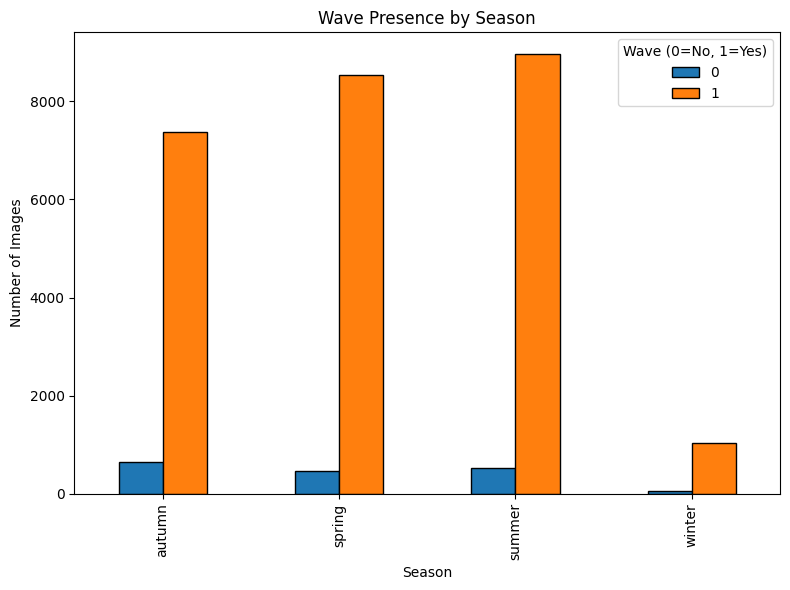

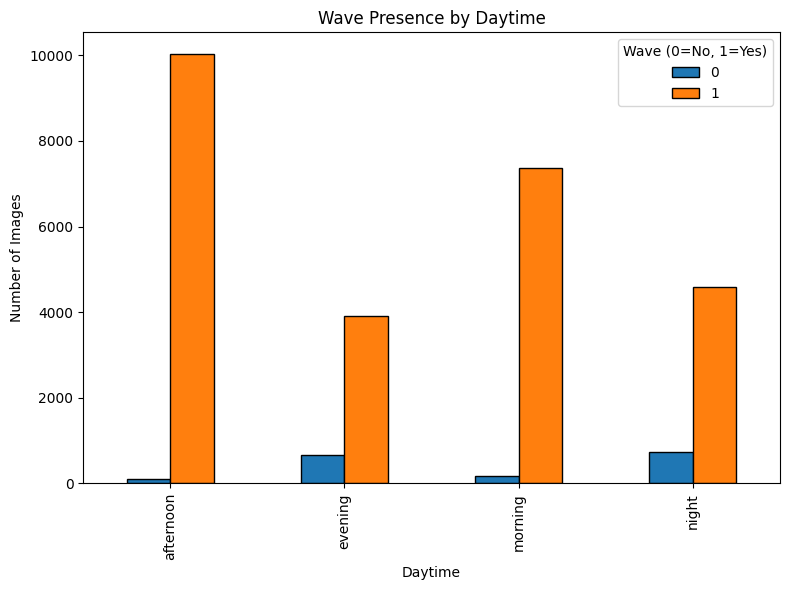

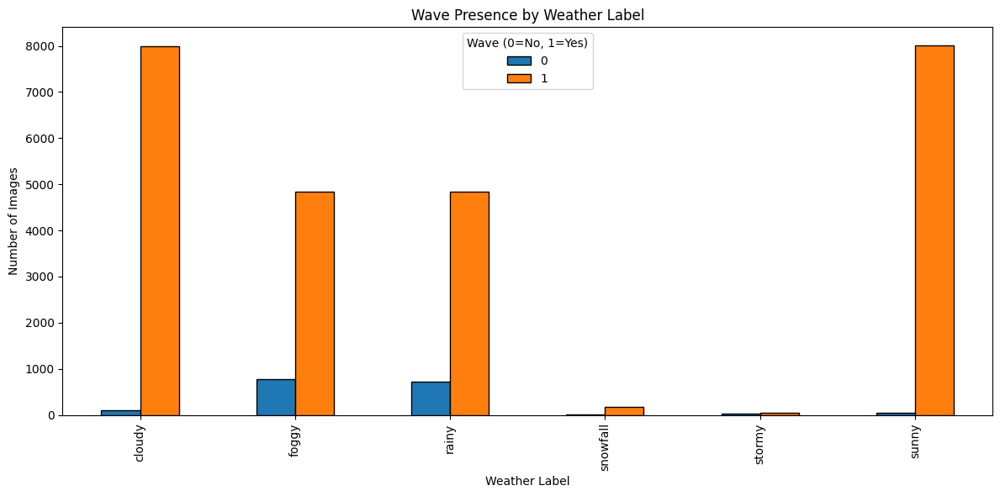

In [85]:
# Create a binary 'wave' column: 1 if wave_count > 0 else 0
wave_df['wave'] = (wave_df['wave_count'] > 0).astype(int)

# --- By Season ---
season_counts = wave_df.groupby(['season', 'wave']).size().unstack(fill_value=0)
season_counts.plot(kind='bar', figsize=(8,6), edgecolor='black')
plt.title('Wave Presence by Season')
plt.xlabel('Season')
plt.ylabel('Number of Images')
plt.legend(title='Wave (0=No, 1=Yes)')
plt.tight_layout()
plt.show()

# --- By Daytime ---
daytime_counts = wave_df.groupby(['daytime', 'wave']).size().unstack(fill_value=0)
daytime_counts.plot(kind='bar', figsize=(8,6), edgecolor='black')
plt.title('Wave Presence by Daytime')
plt.xlabel('Daytime')
plt.ylabel('Number of Images')
plt.legend(title='Wave (0=No, 1=Yes)')
plt.tight_layout()
plt.show()

# --- By Weather Label ---
weather_counts = wave_df.groupby(['weather_label', 'wave']).size().unstack(fill_value=0)
weather_counts.plot(kind='bar', figsize=(12,6), edgecolor='black')
plt.title('Wave Presence by Weather Label')
plt.xlabel('Weather Label')
plt.ylabel('Number of Images')
plt.legend(title='Wave (0=No, 1=Yes)')
plt.tight_layout()
plt.show()